In [3]:
import numpy as np
import pandas as pd
import random
from sklearn.model_selection import train_test_split, KFold
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, f1_score, recall_score, precision_score, confusion_matrix
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import StandardScaler
from time import time
import matplotlib.pyplot as plt
import matplotlib as pl

In [4]:
data = pd.read_csv('data_eak_resampled.csv')
data

,TH,SEX,BB,Systole,Diastole,HB,Ureum,Creatinin,CKD/Not
0,42,1,57.0,110,83,6.5,207,8.90,1
1,39,0,46.0,117,75,10.2,60,2.20,0
2,58,0,41.0,152,87,8.9,66,4.80,1
3,53,1,60.0,160,90,9.2,68,6.08,1
4,60,1,61.0,117,59,9.9,43,3.33,0
...,...,...,...,...,...,...,...,...,...
281,39,0,85.0,146,87,10.2,73,5.53,0
282,66,0,45.0,171,98,9.0,16,2.20,0
283,20,1,51.0,196,123,8.6,47,5.44,0
284,68,1,55.0,145,80,13.5,96,2.32,0


In [5]:
X = data.drop(['CKD/Not'], axis=1)
y = data['CKD/Not']
X

,TH,SEX,BB,Systole,Diastole,HB,Ureum,Creatinin
0,42,1,57.0,110,83,6.5,207,8.90
1,39,0,46.0,117,75,10.2,60,2.20
2,58,0,41.0,152,87,8.9,66,4.80
3,53,1,60.0,160,90,9.2,68,6.08
4,60,1,61.0,117,59,9.9,43,3.33
...,...,...,...,...,...,...,...,...
281,39,0,85.0,146,87,10.2,73,5.53
282,66,0,45.0,171,98,9.0,16,2.20
283,20,1,51.0,196,123,8.6,47,5.44
284,68,1,55.0,145,80,13.5,96,2.32


In [6]:
#Standarisasi
X_scaled = StandardScaler().fit_transform(X)
X_scaled

array([[-0.8139753 ,  1.04287643, -0.27264294, ..., -1.67279115,
         2.2185693 ,  0.96867165],
       [-1.02959457, -0.95888638, -1.11811825, ...,  0.64719259,
        -0.66494665, -1.16257726],
       [ 0.33599413, -0.95888638, -1.5024252 , ..., -0.16793683,
        -0.54725212, -0.33552545],
       ...,
       [-2.39518326,  1.04287643, -0.73381129, ..., -0.35604362,
        -0.91995146, -0.13194346],
       [ 1.05472502,  1.04287643, -0.42636572, ...,  2.71636728,
         0.04122052, -1.12440564],
       [ 0.76723266, -0.95888638,  1.49516906, ...,  0.39638354,
        -0.66494665, -1.33753053]])

In [7]:
n_iterations = 50
n_particles = 100
n_splits = 10

In [8]:
# Parameters PSO
c1 = 1
c2 = 0.9
wmax = 1
wmin = 0.4
w = wmax

In [9]:
def eval_velocity(velocity, max_velocity, min_velocity):
    return np.clip(velocity, min_velocity, max_velocity)

def eval_position(position, max_position, min_position):
    return np.clip(position, min_position, max_position)

def fitness_function(position, X_train, X_test, y_train, y_test):
    gamma = position[0]
    c = position[1]

    svclassifier = SVC(kernel='rbf', gamma=gamma, C=c)
    svclassifier.fit(X_train, y_train)

    y_test_pred = svclassifier.predict(X_test)

    accuracy = accuracy_score(y_test, y_test_pred)
    return accuracy

def plot(position_vector):
    x = []
    y = []
    for i in range(0, len(position_vector)):
        x.append(position_vector[i][0])
        y.append(position_vector[i][1])
    colors = (0, 0, 0)
    plt.scatter(x, y, c=colors, alpha=0.3)
    plt.xlabel('gamma')
    plt.ylabel('C')
    plt.axis([-1, 11, -1, 11])
    plt.gca().set_aspect('equal', adjustable='box')
    plt.show()

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.



Iteration 1 - Fold 1:



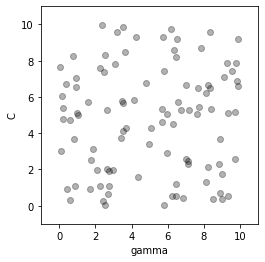

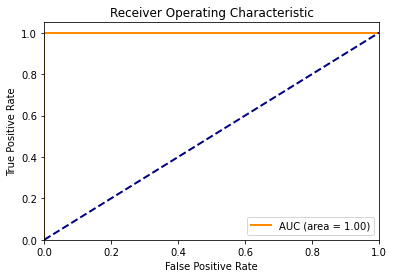

Accuracy for particle (in iteration 1, in fold 1) - 1 is 1.0000 At (gamma, c): [0.20799207 4.81005786]
Accuracy for particle (in iteration 1, in fold 1) - 2 is 0.8966 At (gamma, c): [7.10947753 2.45131238]
Accuracy for particle (in iteration 1, in fold 1) - 3 is 0.8966 At (gamma, c): [5.65354767 4.60608383]
Accuracy for particle (in iteration 1, in fold 1) - 4 is 0.9310 At (gamma, c): [1.85794103 3.12087035]
Accuracy for particle (in iteration 1, in fold 1) - 5 is 0.8966 At (gamma, c): [2.45887914 7.36285359]
Accuracy for particle (in iteration 1, in fold 1) - 6 is 0.8966 At (gamma, c): [8.36228028 5.32719414]
Accuracy for particle (in iteration 1, in fold 1) - 7 is 0.8966 At (gamma, c): [3.06827205 7.80310169]
Accuracy for particle (in iteration 1, in fold 1) - 8 is 0.8966 At (gamma, c): [7.02510271 6.66032653]
Accuracy for particle (in iteration 1, in fold 1) - 9 is 0.8966 At (gamma, c): [4.27058418 9.29229995]
Accuracy for particle (in iteration 1, in fold 1) - 10 is 0.8966 At (gamm

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 1, in fold 1) - 96 is 0.8966 At (gamma, c): [8.84377037 2.30198945]
Accuracy for particle (in iteration 1, in fold 1) - 97 is 0.8966 At (gamma, c): [7.58625435 5.0686726 ]
Accuracy for particle (in iteration 1, in fold 1) - 98 is 0.8966 At (gamma, c): [2.54859326 8.30280481]
Accuracy for particle (in iteration 1, in fold 1) - 99 is 0.8966 At (gamma, c): [5.66308349 5.33908436]
Accuracy for particle (in iteration 1, in fold 1) - 100 is 0.8966 At (gamma, c): [5.74021966 9.3157581 ]
The best position in iteration 1, fold 1 is [1.00000000e-03 8.16316323e+00], with Accuracy: 1.0000
Accuracy Score: 1.0000
F1 Score: 1.0000
Recall Score: 1.0000
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 0 12]]
Confusion Matrix (Train):
[[126   0]
 [  1 130]]

Iteration 2 - Fold 1:



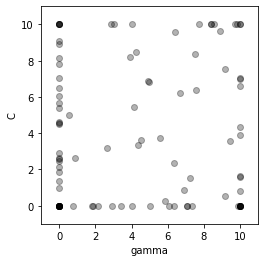

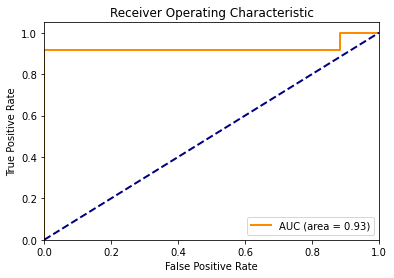

Accuracy for particle (in iteration 2, in fold 1) - 1 is 0.9655 At (gamma, c): [1.00000000e-03 8.16316323e+00]
Accuracy for particle (in iteration 2, in fold 1) - 2 is 0.4138 At (gamma, c): [4.05208788e+00 1.00000000e-03]
Accuracy for particle (in iteration 2, in fold 1) - 3 is 0.9655 At (gamma, c): [1.00000000e-03 6.05488586e+00]
Accuracy for particle (in iteration 2, in fold 1) - 4 is 0.8966 At (gamma, c): [ 8.40497444 10.        ]
Accuracy for particle (in iteration 2, in fold 1) - 5 is 0.8966 At (gamma, c): [7.24260072 1.53056132]
Accuracy for particle (in iteration 2, in fold 1) - 6 is 0.8966 At (gamma, c): [4.49688101 3.63446914]
Accuracy for particle (in iteration 2, in fold 1) - 7 is 0.8966 At (gamma, c): [6.893522   0.84708095]
Accuracy for particle (in iteration 2, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 2, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 2, in fold 1) - 10 is 0.4138 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 2, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 2, in fold 1) - 99 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 2, in fold 1) - 100 is 0.8966 At (gamma, c): [10.          1.57485385]
The best position in iteration 2, fold 1 is [1.00000000e-03 9.84752651e+00], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9565
Recall Score: 0.9167
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 1 11]]
Confusion Matrix (Train):
[[119   7]
 [ 25 106]]

Iteration 3 - Fold 1:



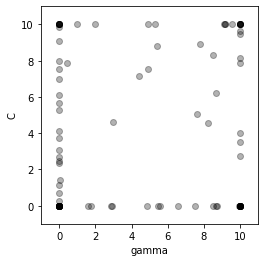

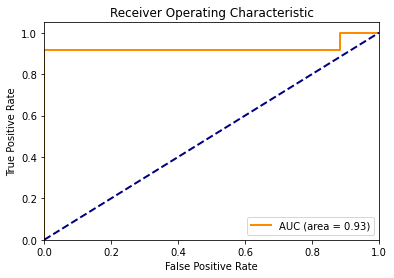

Accuracy for particle (in iteration 3, in fold 1) - 1 is 0.9655 At (gamma, c): [1.00000000e-03 9.84752651e+00]
Accuracy for particle (in iteration 3, in fold 1) - 2 is 0.4138 At (gamma, c): [2.86623265e+00 1.00000000e-03]
Accuracy for particle (in iteration 3, in fold 1) - 3 is 0.9655 At (gamma, c): [1.00000000e-03 7.53759751e+00]
Accuracy for particle (in iteration 3, in fold 1) - 4 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 3, in fold 1) - 5 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 3, in fold 1) - 6 is 0.9655 At (gamma, c): [0.04965651 1.43390138]
Accuracy for particle (in iteration 3, in fold 1) - 7 is 0.4138 At (gamma, c): [8.69191192e+00 1.00000000e-03]
Accuracy for particle (in iteration 3, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 3, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 3, in fold 1) - 10 is 0.4138 At (gamma, c): [

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 3, in fold 1) - 92 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 3, in fold 1) - 93 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 3, in fold 1) - 94 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 3, in fold 1) - 95 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 3, in fold 1) - 96 is 0.9655 At (gamma, c): [1.00000000e-03 9.11374347e+00]
Accuracy for particle (in iteration 3, in fold 1) - 97 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 3, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 3, in fold 1) - 99 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 3, in fold 1) - 100 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 3, fold 1 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9565
Recall

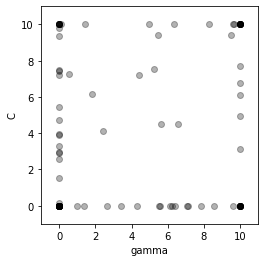

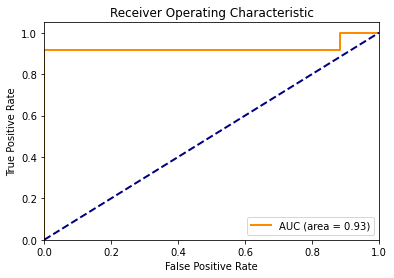

Accuracy for particle (in iteration 4, in fold 1) - 1 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 4, in fold 1) - 2 is 0.4138 At (gamma, c): [3.40898893e+00 1.00000000e-03]
Accuracy for particle (in iteration 4, in fold 1) - 3 is 0.9655 At (gamma, c): [1.00000000e-03 7.19648885e+00]
Accuracy for particle (in iteration 4, in fold 1) - 4 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 4, in fold 1) - 5 is 0.4138 At (gamma, c): [9.6189572e+00 1.0000000e-03]
Accuracy for particle (in iteration 4, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 4, in fold 1) - 7 is 0.4138 At (gamma, c): [6.37499514e+00 1.00000000e-03]
Accuracy for particle (in iteration 4, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 4, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 4, in fold 1) - 10 is 0.4138 At (gamma, c): [0.001 0.001]

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 4, in fold 1) - 93 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 4, in fold 1) - 94 is 0.4138 At (gamma, c): [7.0399966e+00 1.0000000e-03]
Accuracy for particle (in iteration 4, in fold 1) - 95 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 4, in fold 1) - 96 is 0.9655 At (gamma, c): [1.00000000e-03 9.80590306e+00]
Accuracy for particle (in iteration 4, in fold 1) - 97 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 4, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 4, in fold 1) - 99 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 4, in fold 1) - 100 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 4, fold 1 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9565
Recall Score: 0.9167
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 1 11

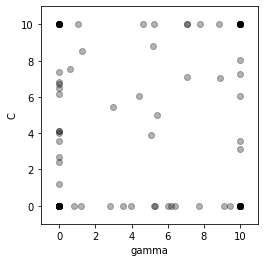

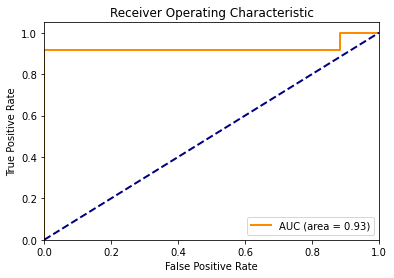

Accuracy for particle (in iteration 5, in fold 1) - 1 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 5, in fold 1) - 2 is 0.4138 At (gamma, c): [3.95462882e+00 1.00000000e-03]
Accuracy for particle (in iteration 5, in fold 1) - 3 is 0.9655 At (gamma, c): [1.00000000e-03 6.72953048e+00]
Accuracy for particle (in iteration 5, in fold 1) - 4 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 5, in fold 1) - 5 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 5, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 5, in fold 1) - 7 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 5, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 5, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 5, in fold 1) - 10 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in ite

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 5, in fold 1) - 96 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 5, in fold 1) - 97 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 5, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 5, in fold 1) - 99 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 5, in fold 1) - 100 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 5, fold 1 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9565
Recall Score: 0.9167
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 1 11]]
Confusion Matrix (Train):
[[119   7]
 [ 24 107]]

Iteration 6 - Fold 1:



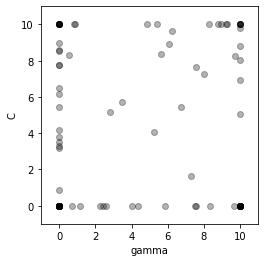

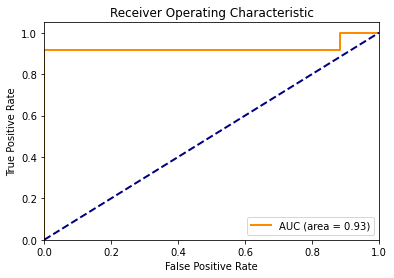

Accuracy for particle (in iteration 6, in fold 1) - 1 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 6, in fold 1) - 2 is 0.4138 At (gamma, c): [2.244442e+00 1.000000e-03]
Accuracy for particle (in iteration 6, in fold 1) - 3 is 0.9655 At (gamma, c): [1.00000000e-03 8.96447059e+00]
Accuracy for particle (in iteration 6, in fold 1) - 4 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 6, in fold 1) - 5 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 6, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 6, in fold 1) - 7 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 6, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 6, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 6, in fold 1) - 10 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iterati

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 6, in fold 1) - 99 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 6, in fold 1) - 100 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 6, fold 1 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9565
Recall Score: 0.9167
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 1 11]]
Confusion Matrix (Train):
[[119   7]
 [ 24 107]]

Iteration 7 - Fold 1:



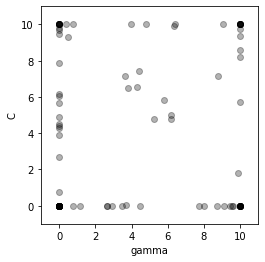

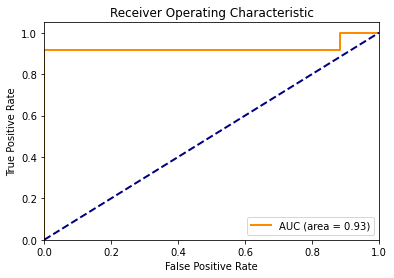

Accuracy for particle (in iteration 7, in fold 1) - 1 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 7, in fold 1) - 2 is 0.4138 At (gamma, c): [2.66407489e+00 1.00000000e-03]
Accuracy for particle (in iteration 7, in fold 1) - 3 is 0.9655 At (gamma, c): [1.0000000e-03 9.8105224e+00]
Accuracy for particle (in iteration 7, in fold 1) - 4 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 7, in fold 1) - 5 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 7, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 7, in fold 1) - 7 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 7, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 7, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 7, in fold 1) - 10 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in itera

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 7, in fold 1) - 97 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 7, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 7, in fold 1) - 99 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 7, in fold 1) - 100 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 7, fold 1 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9565
Recall Score: 0.9167
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 1 11]]
Confusion Matrix (Train):
[[119   7]
 [ 24 107]]

Iteration 8 - Fold 1:



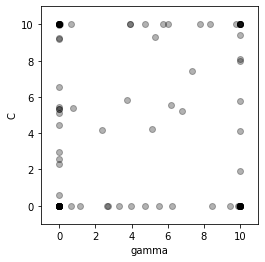

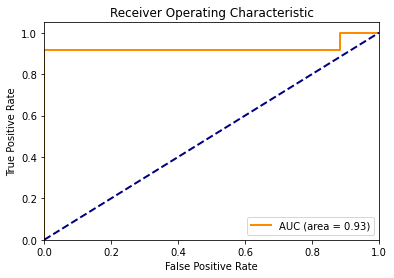

Accuracy for particle (in iteration 8, in fold 1) - 1 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 8, in fold 1) - 2 is 0.4138 At (gamma, c): [2.66678073e+00 1.00000000e-03]
Accuracy for particle (in iteration 8, in fold 1) - 3 is 0.9655 At (gamma, c): [1.00000000e-03 6.52297191e+00]
Accuracy for particle (in iteration 8, in fold 1) - 4 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 8, in fold 1) - 5 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 8, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 8, in fold 1) - 7 is 0.4138 At (gamma, c): [6.22382644e+00 1.00000000e-03]
Accuracy for particle (in iteration 8, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 8, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 8, in fold 1) - 10 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for 

Accuracy for particle (in iteration 8, in fold 1) - 100 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 8, fold 1 is [1.00000000e-03 8.21707185e+00], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9565
Recall Score: 0.9167
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 1 11]]
Confusion Matrix (Train):
[[119   7]
 [ 24 107]]

Iteration 9 - Fold 1:



*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


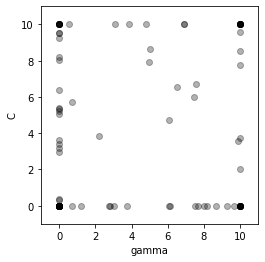

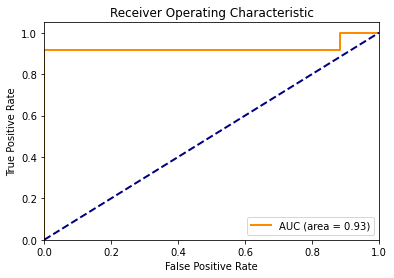

Accuracy for particle (in iteration 9, in fold 1) - 1 is 0.9655 At (gamma, c): [1.00000000e-03 8.21707185e+00]
Accuracy for particle (in iteration 9, in fold 1) - 2 is 0.4138 At (gamma, c): [2.81609321e+00 1.00000000e-03]
Accuracy for particle (in iteration 9, in fold 1) - 3 is 0.9655 At (gamma, c): [1.00000000e-03 9.53697604e+00]
Accuracy for particle (in iteration 9, in fold 1) - 4 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 9, in fold 1) - 5 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 9, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 9, in fold 1) - 7 is 0.4138 At (gamma, c): [7.67682667e+00 1.00000000e-03]
Accuracy for particle (in iteration 9, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 9, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 9, in fold 1) - 10 is 0.4138 At (gamma, c): [0.001 0.00

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 9, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 9, in fold 1) - 99 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 9, in fold 1) - 100 is 0.4138 At (gamma, c): [9.26309977e+00 1.00000000e-03]
The best position in iteration 9, fold 1 is [1.00000000e-03 9.90026473e+00], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9565
Recall Score: 0.9167
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 1 11]]
Confusion Matrix (Train):
[[119   7]
 [ 25 106]]

Iteration 10 - Fold 1:



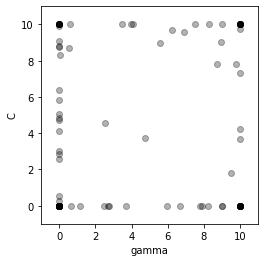

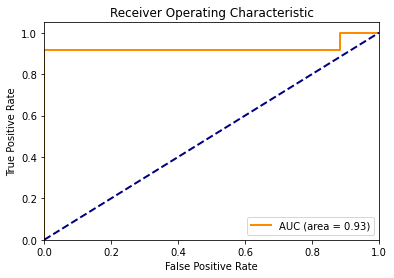

Accuracy for particle (in iteration 10, in fold 1) - 1 is 0.9655 At (gamma, c): [1.00000000e-03 9.90026473e+00]
Accuracy for particle (in iteration 10, in fold 1) - 2 is 0.4138 At (gamma, c): [2.70062629e+00 1.00000000e-03]
Accuracy for particle (in iteration 10, in fold 1) - 3 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 10, in fold 1) - 4 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 10, in fold 1) - 5 is 0.4138 At (gamma, c): [8.23027178e+00 1.00000000e-03]
Accuracy for particle (in iteration 10, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 10, in fold 1) - 7 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 10, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 10, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 10, in fold 1) - 10 is 0.4138 At (gamma, c): [0.001 0.001]
Acc

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 10, in fold 1) - 100 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 10, fold 1 is [1.00000000e-03 9.01562943e+00], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9565
Recall Score: 0.9167
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 1 11]]
Confusion Matrix (Train):
[[119   7]
 [ 24 107]]

Iteration 11 - Fold 1:



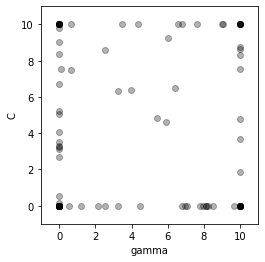

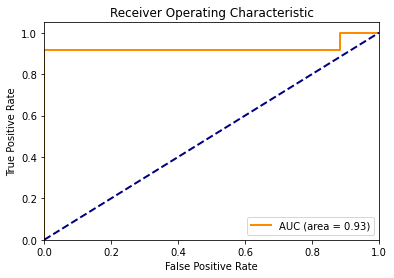

Accuracy for particle (in iteration 11, in fold 1) - 1 is 0.9655 At (gamma, c): [1.00000000e-03 9.01562943e+00]
Accuracy for particle (in iteration 11, in fold 1) - 2 is 0.4138 At (gamma, c): [2.13748457e+00 1.00000000e-03]
Accuracy for particle (in iteration 11, in fold 1) - 3 is 0.9655 At (gamma, c): [1.00000000e-03 8.37774226e+00]
Accuracy for particle (in iteration 11, in fold 1) - 4 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 11, in fold 1) - 5 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 11, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 11, in fold 1) - 7 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 11, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 11, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 11, in fold 1) - 10 is 0.4138 At (gamma, c): [0.001 0.001]
Acc

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 11, in fold 1) - 97 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 11, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 11, in fold 1) - 99 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 11, in fold 1) - 100 is 0.4138 At (gamma, c): [9.65051658e+00 1.00000000e-03]
The best position in iteration 11, fold 1 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9565
Recall Score: 0.9167
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 1 11]]
Confusion Matrix (Train):
[[119   7]
 [ 24 107]]

Iteration 12 - Fold 1:



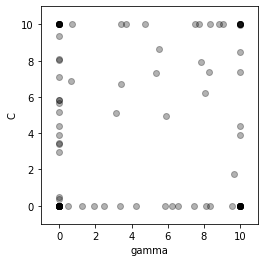

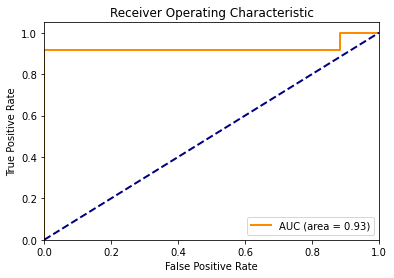

Accuracy for particle (in iteration 12, in fold 1) - 1 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 12, in fold 1) - 2 is 0.4138 At (gamma, c): [1.94946599e+00 1.00000000e-03]
Accuracy for particle (in iteration 12, in fold 1) - 3 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 12, in fold 1) - 4 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 12, in fold 1) - 5 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 12, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 12, in fold 1) - 7 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 12, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 12, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 12, in fold 1) - 10 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 12, in fold 1) - 99 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 12, in fold 1) - 100 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 12, fold 1 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9565
Recall Score: 0.9167
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 1 11]]
Confusion Matrix (Train):
[[119   7]
 [ 24 107]]

Iteration 13 - Fold 1:



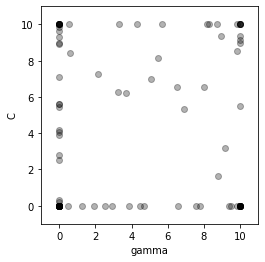

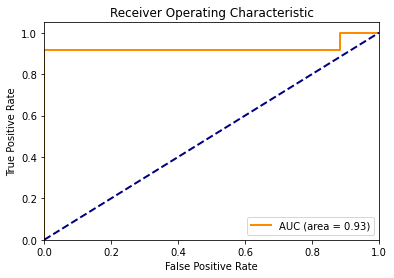

Accuracy for particle (in iteration 13, in fold 1) - 1 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 13, in fold 1) - 2 is 0.4138 At (gamma, c): [1.94072591e+00 1.00000000e-03]
Accuracy for particle (in iteration 13, in fold 1) - 3 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 13, in fold 1) - 4 is 0.8966 At (gamma, c): [ 9.84268023 10.        ]
Accuracy for particle (in iteration 13, in fold 1) - 5 is 0.4138 At (gamma, c): [9.79492496e+00 1.00000000e-03]
Accuracy for particle (in iteration 13, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 13, in fold 1) - 7 is 0.4138 At (gamma, c): [7.57131528e+00 1.00000000e-03]
Accuracy for particle (in iteration 13, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 13, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 13, in fold 1) - 10 is 0.4138 At (gamma, c): [

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 13, in fold 1) - 92 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 13, in fold 1) - 93 is 0.9655 At (gamma, c): [1.00000000e-03 9.29775009e+00]
Accuracy for particle (in iteration 13, in fold 1) - 94 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 13, in fold 1) - 95 is 0.8966 At (gamma, c): [ 8.71810076 10.        ]
Accuracy for particle (in iteration 13, in fold 1) - 96 is 0.9655 At (gamma, c): [1.0000000e-03 9.8501496e+00]
Accuracy for particle (in iteration 13, in fold 1) - 97 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 13, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 13, in fold 1) - 99 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 13, in fold 1) - 100 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 13, fold 1 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accura

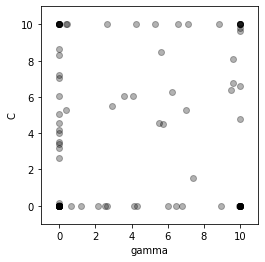

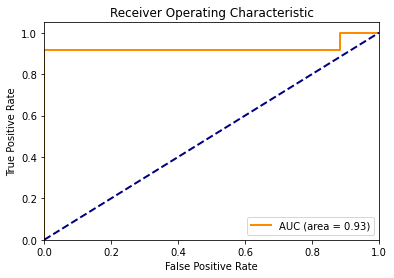

Accuracy for particle (in iteration 14, in fold 1) - 1 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 14, in fold 1) - 2 is 0.4138 At (gamma, c): [2.54960613e+00 1.00000000e-03]
Accuracy for particle (in iteration 14, in fold 1) - 3 is 0.9655 At (gamma, c): [1.00000000e-03 7.06504141e+00]
Accuracy for particle (in iteration 14, in fold 1) - 4 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 14, in fold 1) - 5 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 14, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 14, in fold 1) - 7 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 14, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 14, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 14, in fold 1) - 10 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for partic

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 14, in fold 1) - 92 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 14, in fold 1) - 93 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 14, in fold 1) - 94 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 14, in fold 1) - 95 is 0.8966 At (gamma, c): [ 8.8229577 10.       ]
Accuracy for particle (in iteration 14, in fold 1) - 96 is 0.9655 At (gamma, c): [1.00000000e-03 8.28962448e+00]
Accuracy for particle (in iteration 14, in fold 1) - 97 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 14, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 14, in fold 1) - 99 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 14, in fold 1) - 100 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 14, fold 1 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.9655

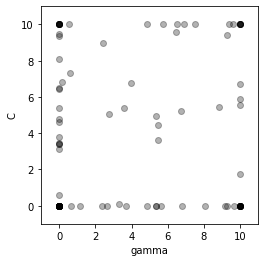

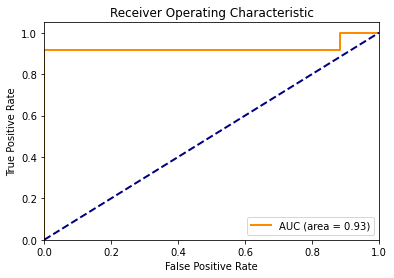

Accuracy for particle (in iteration 15, in fold 1) - 1 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 15, in fold 1) - 2 is 0.4138 At (gamma, c): [2.3633715e+00 1.0000000e-03]
Accuracy for particle (in iteration 15, in fold 1) - 3 is 0.9655 At (gamma, c): [1.0000000e-03 9.3451398e+00]
Accuracy for particle (in iteration 15, in fold 1) - 4 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 15, in fold 1) - 5 is 0.4138 At (gamma, c): [9.16821082e+00 1.00000000e-03]
Accuracy for particle (in iteration 15, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 15, in fold 1) - 7 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 15, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 15, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 15, in fold 1) - 10 is 0.4138 At (gamma, c): [0.001 0.001]
Accurac

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 15, in fold 1) - 97 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 15, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 15, in fold 1) - 99 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 15, in fold 1) - 100 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 15, fold 1 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9565
Recall Score: 0.9167
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 1 11]]
Confusion Matrix (Train):
[[119   7]
 [ 24 107]]

Iteration 16 - Fold 1:



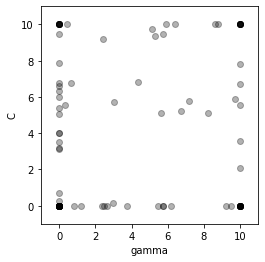

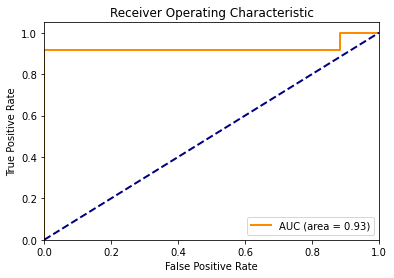

Accuracy for particle (in iteration 16, in fold 1) - 1 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 16, in fold 1) - 2 is 0.4138 At (gamma, c): [2.50281248e+00 1.00000000e-03]
Accuracy for particle (in iteration 16, in fold 1) - 3 is 0.9655 At (gamma, c): [1.0000000e-03 6.6173467e+00]
Accuracy for particle (in iteration 16, in fold 1) - 4 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 16, in fold 1) - 5 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 16, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 16, in fold 1) - 7 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 16, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 16, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 16, in fold 1) - 10 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 16, in fold 1) - 96 is 0.9655 At (gamma, c): [1.00000000e-03 6.78809543e+00]
Accuracy for particle (in iteration 16, in fold 1) - 97 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 16, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 16, in fold 1) - 99 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 16, in fold 1) - 100 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 16, fold 1 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9565
Recall Score: 0.9167
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 1 11]]
Confusion Matrix (Train):
[[119   7]
 [ 24 107]]

Iteration 17 - Fold 1:



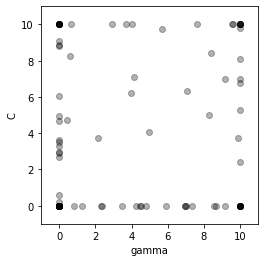

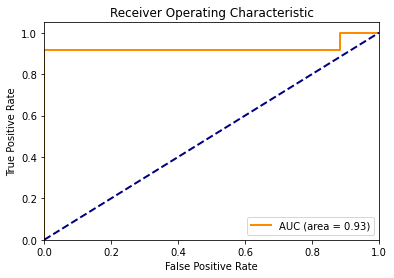

Accuracy for particle (in iteration 17, in fold 1) - 1 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 17, in fold 1) - 2 is 0.4138 At (gamma, c): [2.3341876e+00 1.0000000e-03]
Accuracy for particle (in iteration 17, in fold 1) - 3 is 0.9655 At (gamma, c): [1.00000000e-03 8.87132211e+00]
Accuracy for particle (in iteration 17, in fold 1) - 4 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 17, in fold 1) - 5 is 0.4138 At (gamma, c): [7.35461519e+00 1.00000000e-03]
Accuracy for particle (in iteration 17, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 17, in fold 1) - 7 is 0.4138 At (gamma, c): [8.53350696e+00 1.00000000e-03]
Accuracy for particle (in iteration 17, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 17, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 17, in fold 1) - 10 is 0.4138 At (gamma, c): [0.

Accuracy for particle (in iteration 17, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 17, in fold 1) - 99 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 17, in fold 1) - 100 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 17, fold 1 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9565
Recall Score: 0.9167
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 1 11]]
Confusion Matrix (Train):
[[119   7]
 [ 24 107]]

Iteration 18 - Fold 1:



*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


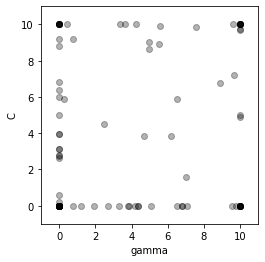

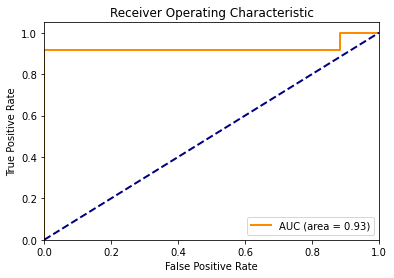

Accuracy for particle (in iteration 18, in fold 1) - 1 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 18, in fold 1) - 2 is 0.4138 At (gamma, c): [1.90215066e+00 1.00000000e-03]
Accuracy for particle (in iteration 18, in fold 1) - 3 is 0.9655 At (gamma, c): [1.00000000e-03 5.97449539e+00]
Accuracy for particle (in iteration 18, in fold 1) - 4 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 18, in fold 1) - 5 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 18, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 18, in fold 1) - 7 is 0.4138 At (gamma, c): [7.08523792e+00 1.00000000e-03]
Accuracy for particle (in iteration 18, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 18, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 18, in fold 1) - 10 is 0.4138 At (gamma, c): [0.001 0.001]
Acc

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 18, in fold 1) - 96 is 0.9655 At (gamma, c): [1.00000000e-03 8.80919394e+00]
Accuracy for particle (in iteration 18, in fold 1) - 97 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 18, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 18, in fold 1) - 99 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 18, in fold 1) - 100 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 18, fold 1 is [1.00000000e-03 6.97414361e+00], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9565
Recall Score: 0.9167
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 1 11]]
Confusion Matrix (Train):
[[119   7]
 [ 24 107]]

Iteration 19 - Fold 1:



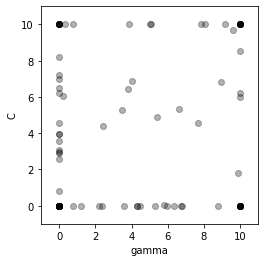

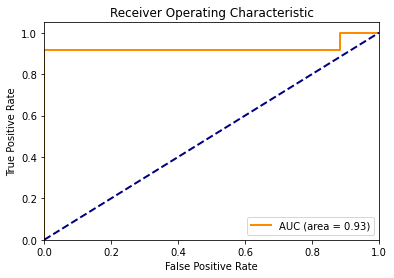

Accuracy for particle (in iteration 19, in fold 1) - 1 is 0.9655 At (gamma, c): [1.00000000e-03 6.97414361e+00]
Accuracy for particle (in iteration 19, in fold 1) - 2 is 0.4138 At (gamma, c): [2.22056705e+00 1.00000000e-03]
Accuracy for particle (in iteration 19, in fold 1) - 3 is 0.9655 At (gamma, c): [1.0000000e-03 6.2431217e+00]
Accuracy for particle (in iteration 19, in fold 1) - 4 is 0.8966 At (gamma, c): [ 9.16881999 10.        ]
Accuracy for particle (in iteration 19, in fold 1) - 5 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 19, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 19, in fold 1) - 7 is 0.4138 At (gamma, c): [6.72320706e+00 1.00000000e-03]
Accuracy for particle (in iteration 19, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 19, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 19, in fold 1) - 10 is 0.4138 At

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 19, in fold 1) - 97 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 19, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 19, in fold 1) - 99 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 19, in fold 1) - 100 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 19, fold 1 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9565
Recall Score: 0.9167
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 1 11]]
Confusion Matrix (Train):
[[119   7]
 [ 25 106]]

Iteration 20 - Fold 1:



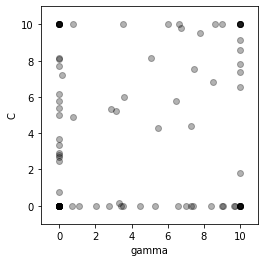

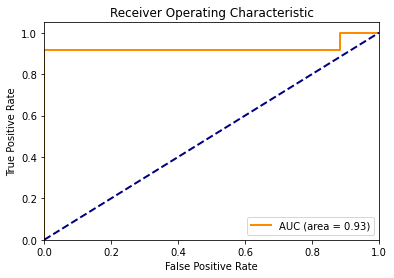

Accuracy for particle (in iteration 20, in fold 1) - 1 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 20, in fold 1) - 2 is 0.4138 At (gamma, c): [2.74686736e+00 1.00000000e-03]
Accuracy for particle (in iteration 20, in fold 1) - 3 is 0.9310 At (gamma, c): [1.00000000e-03 5.37384564e+00]
Accuracy for particle (in iteration 20, in fold 1) - 4 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 20, in fold 1) - 5 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 20, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 20, in fold 1) - 7 is 0.4138 At (gamma, c): [7.28727643e+00 1.00000000e-03]
Accuracy for particle (in iteration 20, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 20, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 20, in fold 1) - 10 is 0.4138 At (gamma, c): [0.001 0.001]
Acc

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 20, in fold 1) - 96 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 20, in fold 1) - 97 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 20, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 20, in fold 1) - 99 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 20, in fold 1) - 100 is 0.4138 At (gamma, c): [9.64922002e+00 1.00000000e-03]
The best position in iteration 20, fold 1 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9565
Recall Score: 0.9167
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 1 11]]
Confusion Matrix (Train):
[[119   7]
 [ 24 107]]

Iteration 21 - Fold 1:



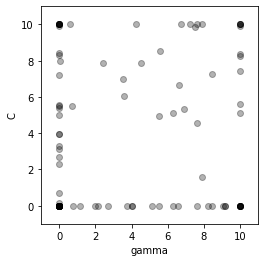

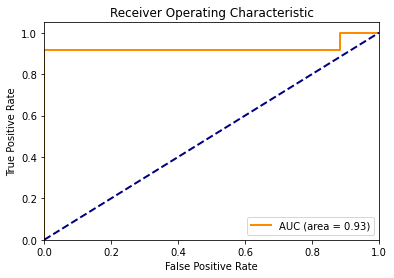

Accuracy for particle (in iteration 21, in fold 1) - 1 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 21, in fold 1) - 2 is 0.4138 At (gamma, c): [2.15969646e+00 1.00000000e-03]
Accuracy for particle (in iteration 21, in fold 1) - 3 is 0.9655 At (gamma, c): [1.00000000e-03 7.20088098e+00]
Accuracy for particle (in iteration 21, in fold 1) - 4 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 21, in fold 1) - 5 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 21, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 21, in fold 1) - 7 is 0.4138 At (gamma, c): [5.14696812e+00 1.00000000e-03]
Accuracy for particle (in iteration 21, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 21, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 21, in fold 1) - 10 is 0.4138 At (gamma, c): [0.001 0.001]
Acc

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 21, in fold 1) - 95 is 0.8966 At (gamma, c): [7.50082711 9.88594203]
Accuracy for particle (in iteration 21, in fold 1) - 96 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 21, in fold 1) - 97 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 21, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 21, in fold 1) - 99 is 0.4138 At (gamma, c): [9.14652197e+00 1.00000000e-03]
Accuracy for particle (in iteration 21, in fold 1) - 100 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 21, fold 1 is [1.0000000e-03 7.1637781e+00], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9565
Recall Score: 0.9167
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 1 11]]
Confusion Matrix (Train):
[[119   7]
 [ 24 107]]

Iteration 22 - Fold 1:



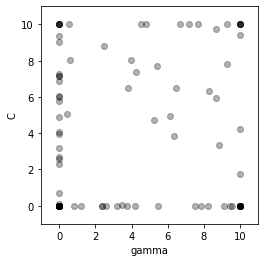

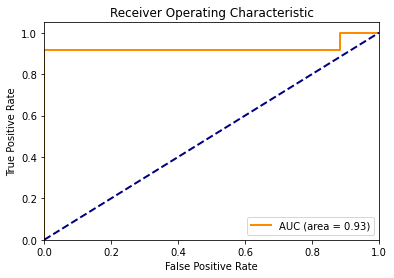

Accuracy for particle (in iteration 22, in fold 1) - 1 is 0.9655 At (gamma, c): [1.0000000e-03 7.1637781e+00]
Accuracy for particle (in iteration 22, in fold 1) - 2 is 0.4138 At (gamma, c): [2.5911069e+00 1.0000000e-03]
Accuracy for particle (in iteration 22, in fold 1) - 3 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 22, in fold 1) - 4 is 0.8966 At (gamma, c): [8.66197791 9.76867263]
Accuracy for particle (in iteration 22, in fold 1) - 5 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 22, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 22, in fold 1) - 7 is 0.4138 At (gamma, c): [7.83830241e+00 1.00000000e-03]
Accuracy for particle (in iteration 22, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 22, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 22, in fold 1) - 10 is 0.4138 At (gamma, c): [0.001 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 22, in fold 1) - 94 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 22, in fold 1) - 95 is 0.8966 At (gamma, c): [ 9.25462752 10.        ]
Accuracy for particle (in iteration 22, in fold 1) - 96 is 0.9655 At (gamma, c): [1.00000000e-03 6.87869022e+00]
Accuracy for particle (in iteration 22, in fold 1) - 97 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 22, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 22, in fold 1) - 99 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 22, in fold 1) - 100 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 22, fold 1 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9565
Recall Score: 0.9167
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 1 11]]
Confusion Matrix (Train):
[[119   7]
 [ 25 106]]

Iteration 23 - Fold 1:



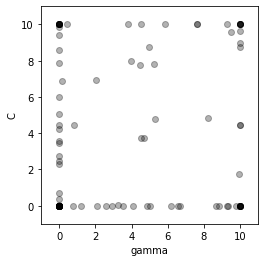

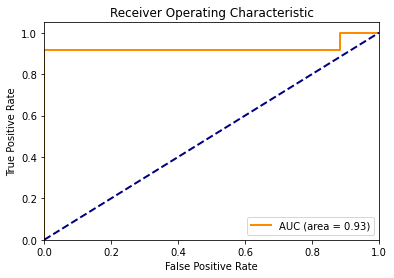

Accuracy for particle (in iteration 23, in fold 1) - 1 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 23, in fold 1) - 2 is 0.4138 At (gamma, c): [2.91492384e+00 1.00000000e-03]
Accuracy for particle (in iteration 23, in fold 1) - 3 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 23, in fold 1) - 4 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 23, in fold 1) - 5 is 0.4138 At (gamma, c): [6.53744599e+00 1.00000000e-03]
Accuracy for particle (in iteration 23, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 23, in fold 1) - 7 is 0.4138 At (gamma, c): [8.63854253e+00 1.00000000e-03]
Accuracy for particle (in iteration 23, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 23, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 23, in fold 1) - 10 is 0.4138 At (gamma, c): [0.001 0.001]
Acc

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 23, in fold 1) - 95 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 23, in fold 1) - 96 is 0.9655 At (gamma, c): [1.00000000e-03 7.89153892e+00]
Accuracy for particle (in iteration 23, in fold 1) - 97 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 23, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 23, in fold 1) - 99 is 0.4138 At (gamma, c): [8.82535107e+00 1.00000000e-03]
Accuracy for particle (in iteration 23, in fold 1) - 100 is 0.4138 At (gamma, c): [9.29313428e+00 1.00000000e-03]
The best position in iteration 23, fold 1 is [1.00000000e-03 9.07013202e+00], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9565
Recall Score: 0.9167
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 1 11]]
Confusion Matrix (Train):
[[119   7]
 [ 24 107]]

Iteration 24 - Fold 1:



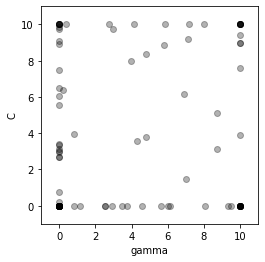

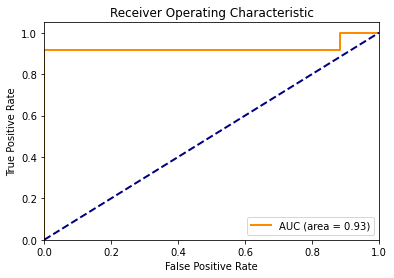

Accuracy for particle (in iteration 24, in fold 1) - 1 is 0.9655 At (gamma, c): [1.00000000e-03 9.07013202e+00]
Accuracy for particle (in iteration 24, in fold 1) - 2 is 0.4138 At (gamma, c): [2.53255031e+00 1.00000000e-03]
Accuracy for particle (in iteration 24, in fold 1) - 3 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 24, in fold 1) - 4 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 24, in fold 1) - 5 is 0.4138 At (gamma, c): [8.03646018e+00 1.00000000e-03]
Accuracy for particle (in iteration 24, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 24, in fold 1) - 7 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 24, in fold 1) - 8 is 0.4138 At (gamma, c): [9.49850929e+00 1.00000000e-03]
Accuracy for particle (in iteration 24, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 24, in fold 1) - 10 is 0.4138 At (gamma, c): [

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 24, in fold 1) - 91 is 0.8966 At (gamma, c): [ 7.18668916 10.        ]
Accuracy for particle (in iteration 24, in fold 1) - 92 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 24, in fold 1) - 93 is 0.9655 At (gamma, c): [1.00000000e-03 9.85973934e+00]
Accuracy for particle (in iteration 24, in fold 1) - 94 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 24, in fold 1) - 95 is 0.8966 At (gamma, c): [7.08941508 9.22153628]
Accuracy for particle (in iteration 24, in fold 1) - 96 is 0.9655 At (gamma, c): [1.00000000e-03 8.90224485e+00]
Accuracy for particle (in iteration 24, in fold 1) - 97 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 24, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 24, in fold 1) - 99 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 24, in fold 1) - 100 is 0.4138 At (gamma, c):

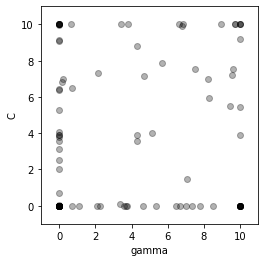

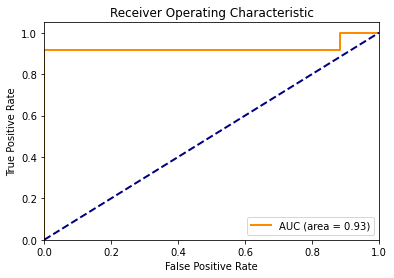

Accuracy for particle (in iteration 25, in fold 1) - 1 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 25, in fold 1) - 2 is 0.4138 At (gamma, c): [2.11127448e+00 1.00000000e-03]
Accuracy for particle (in iteration 25, in fold 1) - 3 is 0.9655 At (gamma, c): [1.0000000e-03 9.1116564e+00]
Accuracy for particle (in iteration 25, in fold 1) - 4 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 25, in fold 1) - 5 is 0.4138 At (gamma, c): [7.35613199e+00 1.00000000e-03]
Accuracy for particle (in iteration 25, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 25, in fold 1) - 7 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 25, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 25, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 25, in fold 1) - 10 is 0.4138 At (gamma, c): [0.001 0.001]
Accur

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 25, in fold 1) - 92 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 25, in fold 1) - 93 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 25, in fold 1) - 94 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 25, in fold 1) - 95 is 0.8966 At (gamma, c): [ 9.72167357 10.        ]
Accuracy for particle (in iteration 25, in fold 1) - 96 is 0.9655 At (gamma, c): [1.00000000e-03 9.14837591e+00]
Accuracy for particle (in iteration 25, in fold 1) - 97 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 25, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 25, in fold 1) - 99 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 25, in fold 1) - 100 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 25, fold 1 is [1.00000000e-03 8.22979192e+00], with Accuracy: 1.0000
Accu

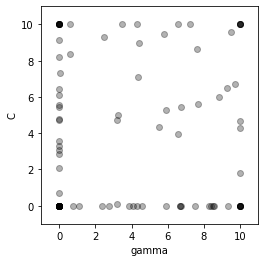

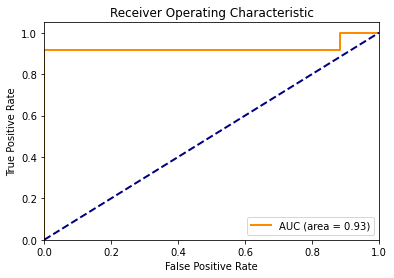

Accuracy for particle (in iteration 26, in fold 1) - 1 is 0.9655 At (gamma, c): [1.00000000e-03 8.22979192e+00]
Accuracy for particle (in iteration 26, in fold 1) - 2 is 0.4138 At (gamma, c): [2.36133781e+00 1.00000000e-03]
Accuracy for particle (in iteration 26, in fold 1) - 3 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 26, in fold 1) - 4 is 0.8966 At (gamma, c): [7.63520237 8.67308705]
Accuracy for particle (in iteration 26, in fold 1) - 5 is 0.4138 At (gamma, c): [6.66659631e+00 1.00000000e-03]
Accuracy for particle (in iteration 26, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 26, in fold 1) - 7 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 26, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 26, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 26, in fold 1) - 10 is 0.4138 At (gamma, c): [0.

Accuracy for particle (in iteration 26, in fold 1) - 94 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 26, in fold 1) - 95 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 26, in fold 1) - 96 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 26, in fold 1) - 97 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 26, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 26, in fold 1) - 99 is 0.4138 At (gamma, c): [8.2874852e+00 1.0000000e-03]
Accuracy for particle (in iteration 26, in fold 1) - 100 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 26, fold 1 is [1.0000000e-03 9.4510297e+00], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9565
Recall Score: 0.9167
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 1 11]]
Confusion Matrix (Train):
[[119   7]
 [ 25 106]]

Iteration 27 - Fold 1:



*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


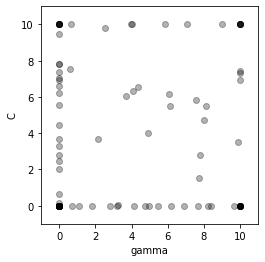

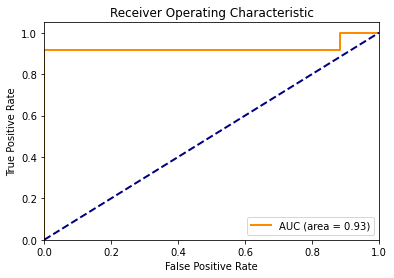

Accuracy for particle (in iteration 27, in fold 1) - 1 is 0.9655 At (gamma, c): [1.0000000e-03 9.4510297e+00]
Accuracy for particle (in iteration 27, in fold 1) - 2 is 0.4138 At (gamma, c): [1.84262897e+00 1.00000000e-03]
Accuracy for particle (in iteration 27, in fold 1) - 3 is 0.9655 At (gamma, c): [1.00000000e-03 7.38670672e+00]
Accuracy for particle (in iteration 27, in fold 1) - 4 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 27, in fold 1) - 5 is 0.4138 At (gamma, c): [7.69297826e+00 1.00000000e-03]
Accuracy for particle (in iteration 27, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 27, in fold 1) - 7 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 27, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 27, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 27, in fold 1) - 10 is 0.4138 At (gamma, c): [0.

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 27, in fold 1) - 96 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 27, in fold 1) - 97 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 27, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 27, in fold 1) - 99 is 0.4138 At (gamma, c): [9.66858029e+00 1.00000000e-03]
Accuracy for particle (in iteration 27, in fold 1) - 100 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 27, fold 1 is [1.00000000e-03 9.63292738e+00], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9565
Recall Score: 0.9167
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 1 11]]
Confusion Matrix (Train):
[[119   7]
 [ 24 107]]

Iteration 28 - Fold 1:



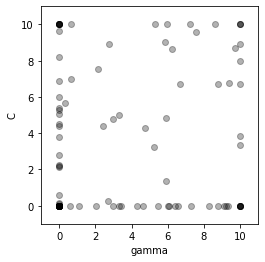

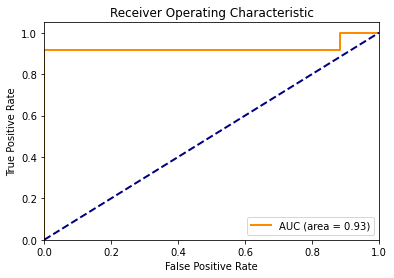

Accuracy for particle (in iteration 28, in fold 1) - 1 is 0.9655 At (gamma, c): [1.00000000e-03 9.63292738e+00]
Accuracy for particle (in iteration 28, in fold 1) - 2 is 0.4138 At (gamma, c): [2.04582077e+00 1.00000000e-03]
Accuracy for particle (in iteration 28, in fold 1) - 3 is 0.9310 At (gamma, c): [1.00000000e-03 5.07482182e+00]
Accuracy for particle (in iteration 28, in fold 1) - 4 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 28, in fold 1) - 5 is 0.4138 At (gamma, c): [6.03581968e+00 1.00000000e-03]
Accuracy for particle (in iteration 28, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 28, in fold 1) - 7 is 0.4138 At (gamma, c): [6.39367979e+00 1.00000000e-03]
Accuracy for particle (in iteration 28, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 28, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 28, in fold 1) - 10 is 0.4138 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 28, in fold 1) - 96 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 28, in fold 1) - 97 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 28, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 28, in fold 1) - 99 is 0.4138 At (gamma, c): [8.79570095e+00 1.00000000e-03]
Accuracy for particle (in iteration 28, in fold 1) - 100 is 0.4138 At (gamma, c): [8.27717171e+00 1.00000000e-03]
The best position in iteration 28, fold 1 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9565
Recall Score: 0.9167
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 1 11]]
Confusion Matrix (Train):
[[119   7]
 [ 23 108]]

Iteration 29 - Fold 1:



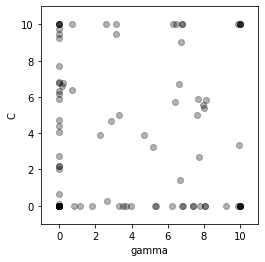

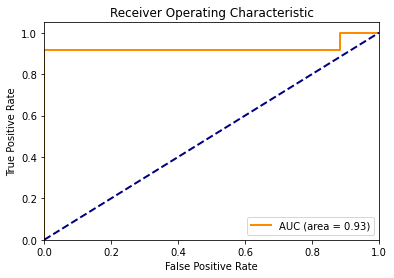

Accuracy for particle (in iteration 29, in fold 1) - 1 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 29, in fold 1) - 2 is 0.4138 At (gamma, c): [1.8102963e+00 1.0000000e-03]
Accuracy for particle (in iteration 29, in fold 1) - 3 is 0.9655 At (gamma, c): [1.00000000e-03 7.71231897e+00]
Accuracy for particle (in iteration 29, in fold 1) - 4 is 0.8966 At (gamma, c): [ 9.88053849 10.        ]
Accuracy for particle (in iteration 29, in fold 1) - 5 is 0.4138 At (gamma, c): [6.84868314e+00 1.00000000e-03]
Accuracy for particle (in iteration 29, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 29, in fold 1) - 7 is 0.4138 At (gamma, c): [5.30761987e+00 1.00000000e-03]
Accuracy for particle (in iteration 29, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 29, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 29, in fold 1) - 10 is 0.4138 At

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 29, in fold 1) - 93 is 0.9655 At (gamma, c): [1.0000000e-03 9.7540452e+00]
Accuracy for particle (in iteration 29, in fold 1) - 94 is 0.4138 At (gamma, c): [6.758866e+00 1.000000e-03]
Accuracy for particle (in iteration 29, in fold 1) - 95 is 0.8966 At (gamma, c): [6.73170693 9.0269334 ]
Accuracy for particle (in iteration 29, in fold 1) - 96 is 0.9655 At (gamma, c): [1.00000000e-03 9.26767711e+00]
Accuracy for particle (in iteration 29, in fold 1) - 97 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 29, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 29, in fold 1) - 99 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 29, in fold 1) - 100 is 0.4138 At (gamma, c): [9.2148086e+00 1.0000000e-03]
The best position in iteration 29, fold 1 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9565
Recall Score: 0.9167
Precision Score:

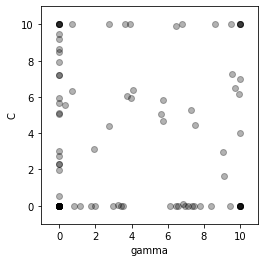

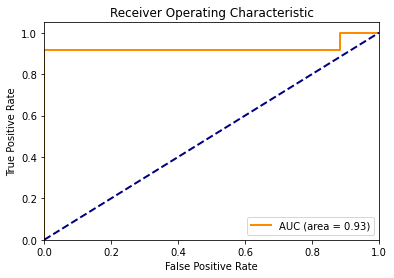

Accuracy for particle (in iteration 30, in fold 1) - 1 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 30, in fold 1) - 2 is 0.4138 At (gamma, c): [1.74423924e+00 1.00000000e-03]
Accuracy for particle (in iteration 30, in fold 1) - 3 is 0.9655 At (gamma, c): [1.00000000e-03 8.49656236e+00]
Accuracy for particle (in iteration 30, in fold 1) - 4 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 30, in fold 1) - 5 is 0.4138 At (gamma, c): [6.12267453e+00 1.00000000e-03]
Accuracy for particle (in iteration 30, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 30, in fold 1) - 7 is 0.4138 At (gamma, c): [7.33202881e+00 1.00000000e-03]
Accuracy for particle (in iteration 30, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 30, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 30, in fold 1) - 10 is 0.4138 At (gamma, c): [

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 30, in fold 1) - 93 is 0.9655 At (gamma, c): [1.00000000e-03 8.62004638e+00]
Accuracy for particle (in iteration 30, in fold 1) - 94 is 0.4138 At (gamma, c): [7.76884492e+00 1.00000000e-03]
Accuracy for particle (in iteration 30, in fold 1) - 95 is 0.8966 At (gamma, c): [ 8.58803104 10.        ]
Accuracy for particle (in iteration 30, in fold 1) - 96 is 0.9655 At (gamma, c): [1.00000000e-03 7.93901538e+00]
Accuracy for particle (in iteration 30, in fold 1) - 97 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 30, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 30, in fold 1) - 99 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 30, in fold 1) - 100 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 30, fold 1 is [1.00000000e-03 8.66793539e+00], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9565
Recall Score: 0.9167
Precis

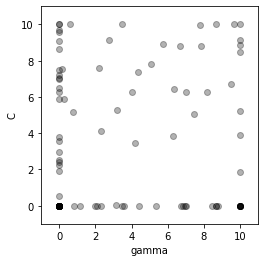

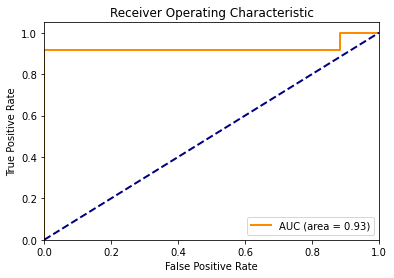

Accuracy for particle (in iteration 31, in fold 1) - 1 is 0.9655 At (gamma, c): [1.00000000e-03 8.66793539e+00]
Accuracy for particle (in iteration 31, in fold 1) - 2 is 0.4138 At (gamma, c): [1.98080437e+00 1.00000000e-03]
Accuracy for particle (in iteration 31, in fold 1) - 3 is 0.9310 At (gamma, c): [1.00000000e-03 5.90942572e+00]
Accuracy for particle (in iteration 31, in fold 1) - 4 is 0.8966 At (gamma, c): [7.85396356 8.8058357 ]
Accuracy for particle (in iteration 31, in fold 1) - 5 is 0.4138 At (gamma, c): [8.65934406e+00 1.00000000e-03]
Accuracy for particle (in iteration 31, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 31, in fold 1) - 7 is 0.4138 At (gamma, c): [6.96874932e+00 1.00000000e-03]
Accuracy for particle (in iteration 31, in fold 1) - 8 is 0.4138 At (gamma, c): [8.77308853e+00 1.00000000e-03]
Accuracy for particle (in iteration 31, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 31, in fold 1) - 95 is 0.8966 At (gamma, c): [6.67566006 8.79260614]
Accuracy for particle (in iteration 31, in fold 1) - 96 is 0.9655 At (gamma, c): [1.00000000e-03 7.19637168e+00]
Accuracy for particle (in iteration 31, in fold 1) - 97 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 31, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 31, in fold 1) - 99 is 0.4138 At (gamma, c): [8.42343275e+00 1.00000000e-03]
Accuracy for particle (in iteration 31, in fold 1) - 100 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 31, fold 1 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9565
Recall Score: 0.9167
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 1 11]]
Confusion Matrix (Train):
[[119   7]
 [ 24 107]]

Iteration 32 - Fold 1:



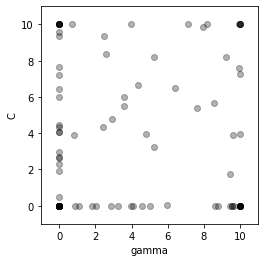

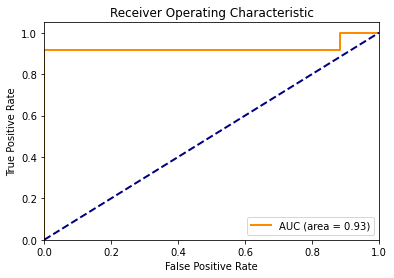

Accuracy for particle (in iteration 32, in fold 1) - 1 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 32, in fold 1) - 2 is 0.4138 At (gamma, c): [2.05800559e+00 1.00000000e-03]
Accuracy for particle (in iteration 32, in fold 1) - 3 is 0.9310 At (gamma, c): [1.00000000e-03 4.33425088e+00]
Accuracy for particle (in iteration 32, in fold 1) - 4 is 0.8966 At (gamma, c): [ 9.92890351 10.        ]
Accuracy for particle (in iteration 32, in fold 1) - 5 is 0.4138 At (gamma, c): [9.55314516e+00 1.00000000e-03]
Accuracy for particle (in iteration 32, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 32, in fold 1) - 7 is 0.4138 At (gamma, c): [8.58367405e+00 1.00000000e-03]
Accuracy for particle (in iteration 32, in fold 1) - 8 is 0.4138 At (gamma, c): [8.77766936e+00 1.00000000e-03]
Accuracy for particle (in iteration 32, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 32, in fold 1)

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 32, in fold 1) - 96 is 0.9655 At (gamma, c): [1.00000000e-03 9.37727501e+00]
Accuracy for particle (in iteration 32, in fold 1) - 97 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 32, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 32, in fold 1) - 99 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 32, in fold 1) - 100 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 32, fold 1 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9565
Recall Score: 0.9167
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 1 11]]
Confusion Matrix (Train):
[[119   7]
 [ 24 107]]

Iteration 33 - Fold 1:



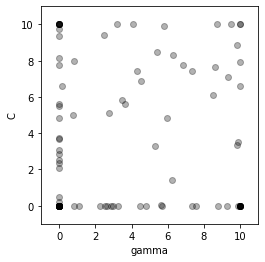

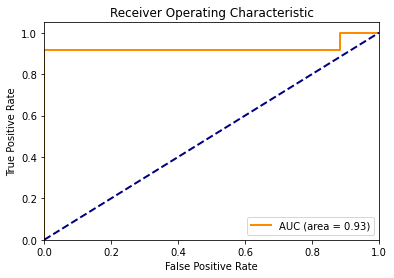

Accuracy for particle (in iteration 33, in fold 1) - 1 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 33, in fold 1) - 2 is 0.4138 At (gamma, c): [2.55048321e+00 1.00000000e-03]
Accuracy for particle (in iteration 33, in fold 1) - 3 is 0.9310 At (gamma, c): [1.00000000e-03 4.86475252e+00]
Accuracy for particle (in iteration 33, in fold 1) - 4 is 0.8966 At (gamma, c): [6.84544671 7.77229135]
Accuracy for particle (in iteration 33, in fold 1) - 5 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 33, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 33, in fold 1) - 7 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 33, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 33, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 33, in fold 1) - 10 is 0.4138 At (gamma, c): [0.001 0.001]
Accur

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 33, in fold 1) - 96 is 0.9655 At (gamma, c): [1.00000000e-03 9.76864619e+00]
Accuracy for particle (in iteration 33, in fold 1) - 97 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 33, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 33, in fold 1) - 99 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 33, in fold 1) - 100 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 33, fold 1 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9565
Recall Score: 0.9167
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 1 11]]
Confusion Matrix (Train):
[[119   7]
 [ 24 107]]

Iteration 34 - Fold 1:



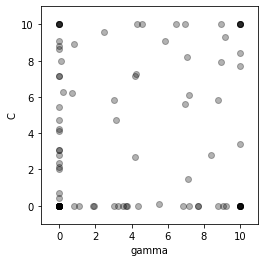

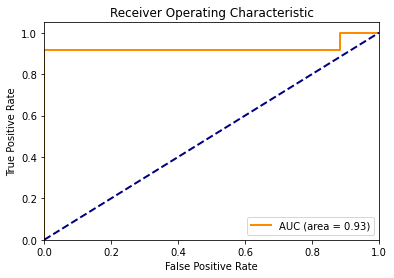

Accuracy for particle (in iteration 34, in fold 1) - 1 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 34, in fold 1) - 2 is 0.4138 At (gamma, c): [1.92824988e+00 1.00000000e-03]
Accuracy for particle (in iteration 34, in fold 1) - 3 is 0.9655 At (gamma, c): [1.00000000e-03 7.13505157e+00]
Accuracy for particle (in iteration 34, in fold 1) - 4 is 0.8966 At (gamma, c): [7.05507151 8.18918642]
Accuracy for particle (in iteration 34, in fold 1) - 5 is 0.4138 At (gamma, c): [8.79231359e+00 1.00000000e-03]
Accuracy for particle (in iteration 34, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 34, in fold 1) - 7 is 0.4138 At (gamma, c): [9.19403334e+00 1.00000000e-03]
Accuracy for particle (in iteration 34, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 34, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 34, in fold 1) - 10 is 0.4138 At

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 34, in fold 1) - 93 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 34, in fold 1) - 94 is 0.4138 At (gamma, c): [6.82682628e+00 1.00000000e-03]
Accuracy for particle (in iteration 34, in fold 1) - 95 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 34, in fold 1) - 96 is 0.9310 At (gamma, c): [1.00000000e-03 5.45317364e+00]
Accuracy for particle (in iteration 34, in fold 1) - 97 is 0.4138 At (gamma, c): [9.04876823e+00 1.00000000e-03]
Accuracy for particle (in iteration 34, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 34, in fold 1) - 99 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 34, in fold 1) - 100 is 0.4138 At (gamma, c): [7.15249253e+00 1.00000000e-03]
The best position in iteration 34, fold 1 is [1.00000000e-03 6.02862218e+00], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9565
Recall Score: 0.9167
Precis

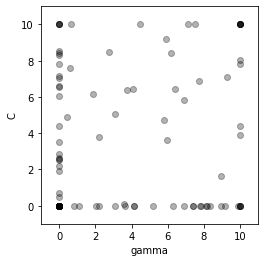

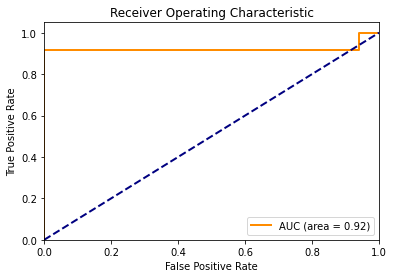

Accuracy for particle (in iteration 35, in fold 1) - 1 is 0.9655 At (gamma, c): [1.00000000e-03 6.02862218e+00]
Accuracy for particle (in iteration 35, in fold 1) - 2 is 0.4138 At (gamma, c): [2.03865532e+00 1.00000000e-03]
Accuracy for particle (in iteration 35, in fold 1) - 3 is 0.9655 At (gamma, c): [1.00000000e-03 6.55343502e+00]
Accuracy for particle (in iteration 35, in fold 1) - 4 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 35, in fold 1) - 5 is 0.4138 At (gamma, c): [9.14018992e+00 1.00000000e-03]
Accuracy for particle (in iteration 35, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 35, in fold 1) - 7 is 0.4138 At (gamma, c): [8.33543729e+00 1.00000000e-03]
Accuracy for particle (in iteration 35, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 35, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 35, in fold 1) - 10 is 0.4138 

Accuracy for particle (in iteration 35, in fold 1) - 95 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 35, in fold 1) - 96 is 0.9655 At (gamma, c): [1.00000000e-03 7.05480461e+00]
Accuracy for particle (in iteration 35, in fold 1) - 97 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 35, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 35, in fold 1) - 99 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 35, in fold 1) - 100 is 0.4138 At (gamma, c): [7.40003851e+00 1.00000000e-03]
The best position in iteration 35, fold 1 is [1.00000000e-03 5.94061126e+00], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9565
Recall Score: 0.9167
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 1 11]]
Confusion Matrix (Train):
[[119   7]
 [ 28 103]]

Iteration 36 - Fold 1:



*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


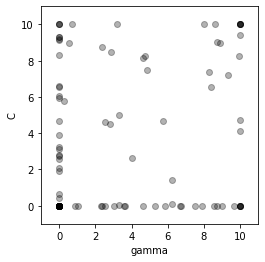

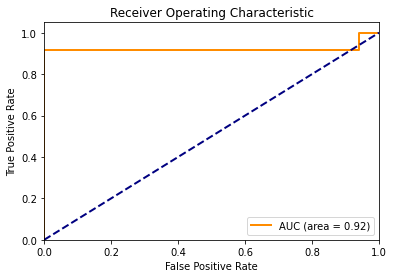

Accuracy for particle (in iteration 36, in fold 1) - 1 is 0.9310 At (gamma, c): [1.00000000e-03 5.94061126e+00]
Accuracy for particle (in iteration 36, in fold 1) - 2 is 0.4138 At (gamma, c): [2.29500535e+00 1.00000000e-03]
Accuracy for particle (in iteration 36, in fold 1) - 3 is 0.9655 At (gamma, c): [1.00000000e-03 8.30095542e+00]
Accuracy for particle (in iteration 36, in fold 1) - 4 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 36, in fold 1) - 5 is 0.4138 At (gamma, c): [8.72548132e+00 1.00000000e-03]
Accuracy for particle (in iteration 36, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 36, in fold 1) - 7 is 0.4138 At (gamma, c): [7.89230702e+00 1.00000000e-03]
Accuracy for particle (in iteration 36, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 36, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 36, in fold 1) - 10 is 0.4138 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 36, in fold 1) - 96 is 0.9655 At (gamma, c): [1.00000000e-03 6.58314058e+00]
Accuracy for particle (in iteration 36, in fold 1) - 97 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 36, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 36, in fold 1) - 99 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 36, in fold 1) - 100 is 0.4138 At (gamma, c): [7.48330446e+00 1.00000000e-03]
The best position in iteration 36, fold 1 is [1.0000000e-03 5.7672773e+00], with Accuracy: 1.0000
Accuracy Score: 0.9310
F1 Score: 0.9091
Recall Score: 0.8333
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 2 10]]
Confusion Matrix (Train):
[[119   7]
 [ 28 103]]

Iteration 37 - Fold 1:



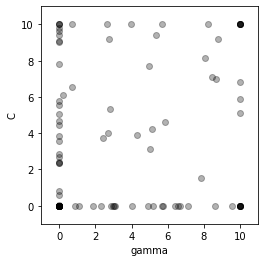

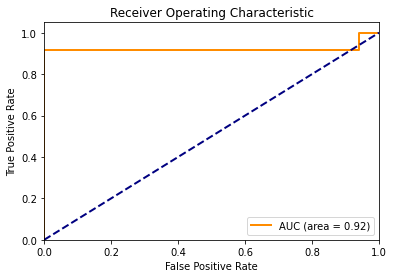

Accuracy for particle (in iteration 37, in fold 1) - 1 is 0.9310 At (gamma, c): [1.0000000e-03 5.7672773e+00]
Accuracy for particle (in iteration 37, in fold 1) - 2 is 0.4138 At (gamma, c): [2.2981368e+00 1.0000000e-03]
Accuracy for particle (in iteration 37, in fold 1) - 3 is 0.9310 At (gamma, c): [1.00000000e-03 5.56293848e+00]
Accuracy for particle (in iteration 37, in fold 1) - 4 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 37, in fold 1) - 5 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 37, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 37, in fold 1) - 7 is 0.4138 At (gamma, c): [6.69468313e+00 1.00000000e-03]
Accuracy for particle (in iteration 37, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 37, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 37, in fold 1) - 10 is 0.4138 At (gamma, c): [0.00

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 37, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 37, in fold 1) - 99 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 37, in fold 1) - 100 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 37, fold 1 is [1.00000000e-03 5.78766038e+00], with Accuracy: 1.0000
Accuracy Score: 0.9310
F1 Score: 0.9091
Recall Score: 0.8333
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 2 10]]
Confusion Matrix (Train):
[[119   7]
 [ 30 101]]

Iteration 38 - Fold 1:



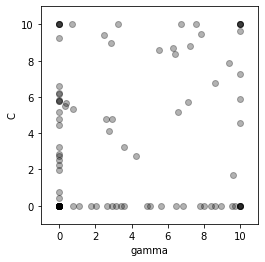

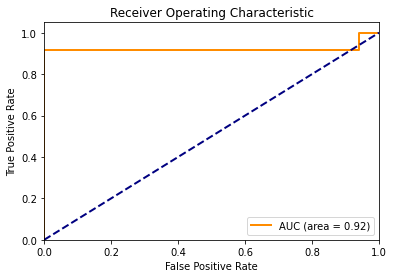

Accuracy for particle (in iteration 38, in fold 1) - 1 is 0.9310 At (gamma, c): [1.00000000e-03 5.78766038e+00]
Accuracy for particle (in iteration 38, in fold 1) - 2 is 0.4138 At (gamma, c): [1.76371887e+00 1.00000000e-03]
Accuracy for particle (in iteration 38, in fold 1) - 3 is 0.9655 At (gamma, c): [1.00000000e-03 6.21481502e+00]
Accuracy for particle (in iteration 38, in fold 1) - 4 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 38, in fold 1) - 5 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 38, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 38, in fold 1) - 7 is 0.4138 At (gamma, c): [8.01865218e+00 1.00000000e-03]
Accuracy for particle (in iteration 38, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 38, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 38, in fold 1) - 10 is 0.4138 At (gamma, c): [

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 38, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 38, in fold 1) - 99 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 38, in fold 1) - 100 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 38, fold 1 is [1.00000000e-03 7.92078261e+00], with Accuracy: 1.0000
Accuracy Score: 0.9310
F1 Score: 0.9091
Recall Score: 0.8333
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 2 10]]
Confusion Matrix (Train):
[[119   7]
 [ 30 101]]

Iteration 39 - Fold 1:



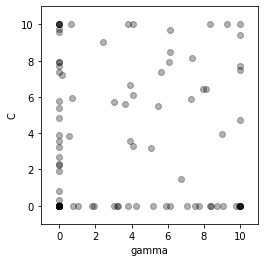

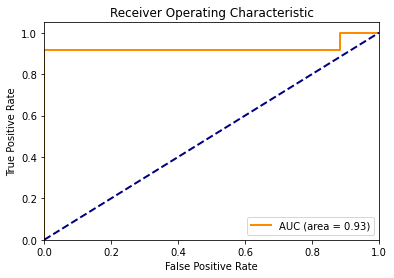

Accuracy for particle (in iteration 39, in fold 1) - 1 is 0.9655 At (gamma, c): [1.00000000e-03 7.92078261e+00]
Accuracy for particle (in iteration 39, in fold 1) - 2 is 0.4138 At (gamma, c): [1.94132557e+00 1.00000000e-03]
Accuracy for particle (in iteration 39, in fold 1) - 3 is 0.9655 At (gamma, c): [1.00000000e-03 7.91561676e+00]
Accuracy for particle (in iteration 39, in fold 1) - 4 is 0.8966 At (gamma, c): [7.32356868 8.13782075]
Accuracy for particle (in iteration 39, in fold 1) - 5 is 0.4138 At (gamma, c): [5.88296123e+00 1.00000000e-03]
Accuracy for particle (in iteration 39, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 39, in fold 1) - 7 is 0.4138 At (gamma, c): [7.51490526e+00 1.00000000e-03]
Accuracy for particle (in iteration 39, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 39, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 39, in fold 1) -

Accuracy for particle (in iteration 39, in fold 1) - 80 is 0.8966 At (gamma, c): [3.89641366 6.65350813]
Accuracy for particle (in iteration 39, in fold 1) - 81 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 39, in fold 1) - 82 is 0.9310 At (gamma, c): [1.00000000e-03 4.83498652e+00]
Accuracy for particle (in iteration 39, in fold 1) - 83 is 0.4138 At (gamma, c): [1.06437448e+00 1.00000000e-03]
Accuracy for particle (in iteration 39, in fold 1) - 84 is 0.4138 At (gamma, c): [6.11161288e+00 1.00000000e-03]
Accuracy for particle (in iteration 39, in fold 1) - 85 is 0.8966 At (gamma, c): [8.0872532  6.41224501]
Accuracy for particle (in iteration 39, in fold 1) - 86 is 0.8966 At (gamma, c): [ 4.0597522 10.       ]
Accuracy for particle (in iteration 39, in fold 1) - 87 is 0.8966 At (gamma, c): [10.          7.47181854]
Accuracy for particle (in iteration 39, in fold 1) - 88 is 0.8966 At (gamma, c): [6.72674786 1.4483805 ]
Accuracy for particle (in iteration 39,

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 39, in fold 1) - 99 is 0.4138 At (gamma, c): [9.07239535e+00 1.00000000e-03]
Accuracy for particle (in iteration 39, in fold 1) - 100 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 39, fold 1 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9565
Recall Score: 0.9167
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 1 11]]
Confusion Matrix (Train):
[[119   7]
 [ 25 106]]

Iteration 40 - Fold 1:



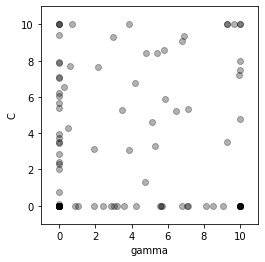

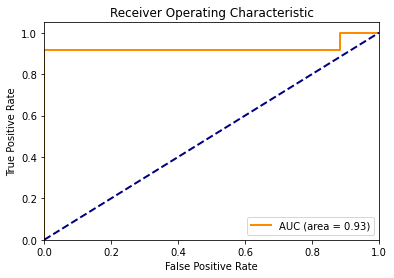

Accuracy for particle (in iteration 40, in fold 1) - 1 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 40, in fold 1) - 2 is 0.4138 At (gamma, c): [2.40255486e+00 1.00000000e-03]
Accuracy for particle (in iteration 40, in fold 1) - 3 is 0.9655 At (gamma, c): [1.0000000e-03 7.8752343e+00]
Accuracy for particle (in iteration 40, in fold 1) - 4 is 0.8966 At (gamma, c): [ 9.29112686 10.        ]
Accuracy for particle (in iteration 40, in fold 1) - 5 is 0.4138 At (gamma, c): [5.68577568e+00 1.00000000e-03]
Accuracy for particle (in iteration 40, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 40, in fold 1) - 7 is 0.4138 At (gamma, c): [8.12248125e+00 1.00000000e-03]
Accuracy for particle (in iteration 40, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 40, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 40, in fold 1) - 10 is 0.4138 At

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 40, in fold 1) - 97 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 40, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 40, in fold 1) - 99 is 0.4138 At (gamma, c): [6.80364835e+00 1.00000000e-03]
Accuracy for particle (in iteration 40, in fold 1) - 100 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 40, fold 1 is [1.00000000e-03 6.47302956e+00], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9565
Recall Score: 0.9167
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 1 11]]
Confusion Matrix (Train):
[[119   7]
 [ 24 107]]

Iteration 41 - Fold 1:



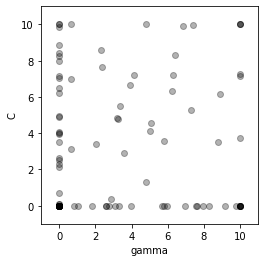

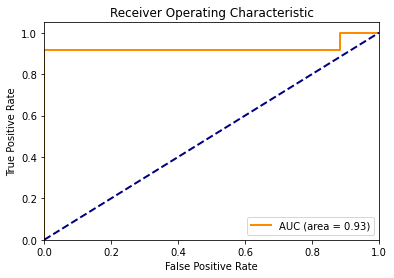

Accuracy for particle (in iteration 41, in fold 1) - 1 is 0.9655 At (gamma, c): [1.00000000e-03 6.47302956e+00]
Accuracy for particle (in iteration 41, in fold 1) - 2 is 0.4138 At (gamma, c): [2.61318068e+00 1.00000000e-03]
Accuracy for particle (in iteration 41, in fold 1) - 3 is 0.9655 At (gamma, c): [1.00000000e-03 9.85079033e+00]
Accuracy for particle (in iteration 41, in fold 1) - 4 is 0.8966 At (gamma, c): [6.30827329 7.20274685]
Accuracy for particle (in iteration 41, in fold 1) - 5 is 0.4138 At (gamma, c): [7.5371678e+00 1.0000000e-03]
Accuracy for particle (in iteration 41, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 41, in fold 1) - 7 is 0.4138 At (gamma, c): [6.96148662e+00 1.00000000e-03]
Accuracy for particle (in iteration 41, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 41, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 41, in fold 1) - 1

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 41, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 41, in fold 1) - 99 is 0.4138 At (gamma, c): [9.18386989e+00 1.00000000e-03]
Accuracy for particle (in iteration 41, in fold 1) - 100 is 0.4138 At (gamma, c): [9.76684859e+00 1.00000000e-03]
The best position in iteration 41, fold 1 is [1.00000000e-03 7.88611875e+00], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9565
Recall Score: 0.9167
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 1 11]]
Confusion Matrix (Train):
[[119   7]
 [ 25 106]]

Iteration 42 - Fold 1:



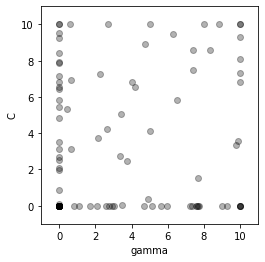

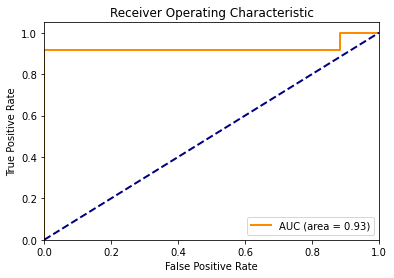

Accuracy for particle (in iteration 42, in fold 1) - 1 is 0.9655 At (gamma, c): [1.00000000e-03 7.88611875e+00]
Accuracy for particle (in iteration 42, in fold 1) - 2 is 0.4138 At (gamma, c): [2.73943866e+00 1.00000000e-03]
Accuracy for particle (in iteration 42, in fold 1) - 3 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 42, in fold 1) - 4 is 0.8966 At (gamma, c): [7.38203379 8.56627519]
Accuracy for particle (in iteration 42, in fold 1) - 5 is 0.4138 At (gamma, c): [7.71176788e+00 1.00000000e-03]
Accuracy for particle (in iteration 42, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 42, in fold 1) - 7 is 0.4138 At (gamma, c): [9.28453053e+00 1.00000000e-03]
Accuracy for particle (in iteration 42, in fold 1) - 8 is 0.4138 At (gamma, c): [7.68634629e+00 1.00000000e-03]
Accuracy for particle (in iteration 42, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 42, in fold 1) -

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 42, in fold 1) - 95 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 42, in fold 1) - 96 is 0.9655 At (gamma, c): [1.00000000e-03 9.53030027e+00]
Accuracy for particle (in iteration 42, in fold 1) - 97 is 0.4138 At (gamma, c): [8.98451931e+00 1.00000000e-03]
Accuracy for particle (in iteration 42, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 42, in fold 1) - 99 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 42, in fold 1) - 100 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 42, fold 1 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9565
Recall Score: 0.9167
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 1 11]]
Confusion Matrix (Train):
[[119   7]
 [ 25 106]]

Iteration 43 - Fold 1:



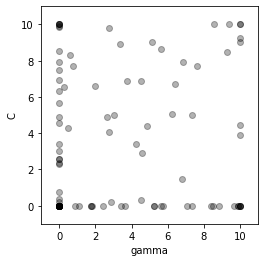

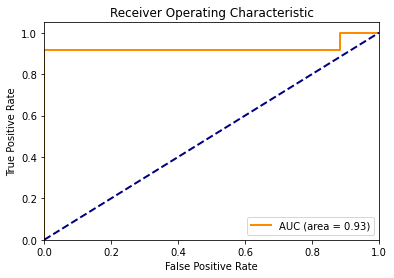

Accuracy for particle (in iteration 43, in fold 1) - 1 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 43, in fold 1) - 2 is 0.4138 At (gamma, c): [1.78131118e+00 1.00000000e-03]
Accuracy for particle (in iteration 43, in fold 1) - 3 is 0.9655 At (gamma, c): [1.00000000e-03 9.84281187e+00]
Accuracy for particle (in iteration 43, in fold 1) - 4 is 0.8966 At (gamma, c): [6.81742185 7.9385986 ]
Accuracy for particle (in iteration 43, in fold 1) - 5 is 0.4138 At (gamma, c): [7.04694654e+00 1.00000000e-03]
Accuracy for particle (in iteration 43, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 43, in fold 1) - 7 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 43, in fold 1) - 8 is 0.4138 At (gamma, c): [9.88461674e+00 1.00000000e-03]
Accuracy for particle (in iteration 43, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 43, in fold 1) - 10 is 0.4138 At

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 43, in fold 1) - 94 is 0.4138 At (gamma, c): [9.63363334e+00 1.00000000e-03]
Accuracy for particle (in iteration 43, in fold 1) - 95 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 43, in fold 1) - 96 is 0.9655 At (gamma, c): [1.00000000e-03 6.92008308e+00]
Accuracy for particle (in iteration 43, in fold 1) - 97 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 43, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 43, in fold 1) - 99 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 43, in fold 1) - 100 is 0.4138 At (gamma, c): [8.49545188e+00 1.00000000e-03]
The best position in iteration 43, fold 1 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9565
Recall Score: 0.9167
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 1 11]]
Confusion Matrix (Train):
[[119   7]
 [ 24 107]]

Iteration 44 - Fo

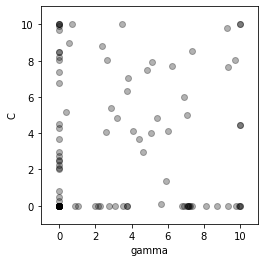

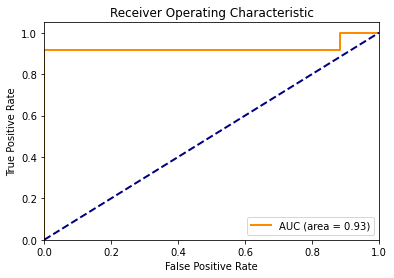

Accuracy for particle (in iteration 44, in fold 1) - 1 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 44, in fold 1) - 2 is 0.4138 At (gamma, c): [2.13899498e+00 1.00000000e-03]
Accuracy for particle (in iteration 44, in fold 1) - 3 is 0.9310 At (gamma, c): [1.00000000e-03 4.48713577e+00]
Accuracy for particle (in iteration 44, in fold 1) - 4 is 0.8966 At (gamma, c): [7.31930783 8.55139278]
Accuracy for particle (in iteration 44, in fold 1) - 5 is 0.4138 At (gamma, c): [6.87631675e+00 1.00000000e-03]
Accuracy for particle (in iteration 44, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 44, in fold 1) - 7 is 0.4138 At (gamma, c): [7.14847283e+00 1.00000000e-03]
Accuracy for particle (in iteration 44, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 44, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 44, in fold 1) - 10 is 0.4138 At

Accuracy for particle (in iteration 44, in fold 1) - 81 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 44, in fold 1) - 82 is 0.9655 At (gamma, c): [1.00000000e-03 8.01455702e+00]
Accuracy for particle (in iteration 44, in fold 1) - 83 is 0.4138 At (gamma, c): [1.05453682e+00 1.00000000e-03]
Accuracy for particle (in iteration 44, in fold 1) - 84 is 0.4138 At (gamma, c): [3.7673725e+00 1.0000000e-03]
Accuracy for particle (in iteration 44, in fold 1) - 85 is 0.8966 At (gamma, c): [6.00788663 4.11027531]
Accuracy for particle (in iteration 44, in fold 1) - 86 is 0.8966 At (gamma, c): [2.64193778 8.06563925]
Accuracy for particle (in iteration 44, in fold 1) - 87 is 0.8966 At (gamma, c): [9.69074583 8.05897984]
Accuracy for particle (in iteration 44, in fold 1) - 88 is 0.8966 At (gamma, c): [5.88764513 1.38244623]
Accuracy for particle (in iteration 44, in fold 1) - 89 is 0.9310 At (gamma, c): [1.00000000e-03 2.44062799e+00]
Accuracy for particle (in iteration

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


The best position in iteration 44, fold 1 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9565
Recall Score: 0.9167
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 1 11]]
Confusion Matrix (Train):
[[119   7]
 [ 24 107]]

Iteration 45 - Fold 1:



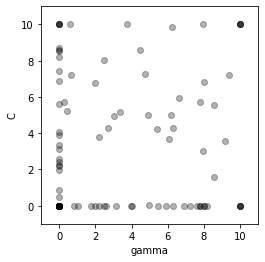

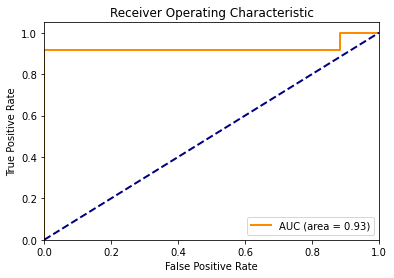

Accuracy for particle (in iteration 45, in fold 1) - 1 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 45, in fold 1) - 2 is 0.4138 At (gamma, c): [1.99869807e+00 1.00000000e-03]
Accuracy for particle (in iteration 45, in fold 1) - 3 is 0.9310 At (gamma, c): [1.00000000e-03 5.61161574e+00]
Accuracy for particle (in iteration 45, in fold 1) - 4 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 45, in fold 1) - 5 is 0.4138 At (gamma, c): [4.95682867 0.0644775 ]
Accuracy for particle (in iteration 45, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 45, in fold 1) - 7 is 0.4138 At (gamma, c): [7.21444182e+00 1.00000000e-03]
Accuracy for particle (in iteration 45, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 45, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 45, in fold 1) - 10 is 0.4138 At (gamma, c): [0.001 0.

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 45, in fold 1) - 90 is 0.4138 At (gamma, c): [5.47071336e+00 1.00000000e-03]
Accuracy for particle (in iteration 45, in fold 1) - 91 is 0.8966 At (gamma, c): [3.36946044 5.14768783]
Accuracy for particle (in iteration 45, in fold 1) - 92 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 45, in fold 1) - 93 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 45, in fold 1) - 94 is 0.4138 At (gamma, c): [6.31133358e+00 1.00000000e-03]
Accuracy for particle (in iteration 45, in fold 1) - 95 is 0.8966 At (gamma, c): [ 7.93959352 10.        ]
Accuracy for particle (in iteration 45, in fold 1) - 96 is 0.9655 At (gamma, c): [1.00000000e-03 8.20906079e+00]
Accuracy for particle (in iteration 45, in fold 1) - 97 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 45, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 45, in fold 1) - 99 is 0.4138

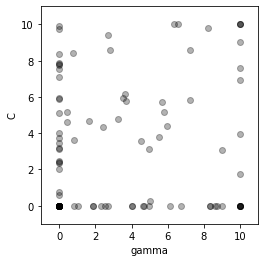

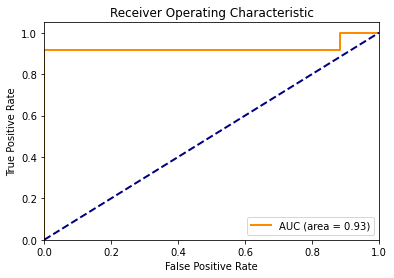

Accuracy for particle (in iteration 46, in fold 1) - 1 is 0.9655 At (gamma, c): [1.0000000e-03 9.7443664e+00]
Accuracy for particle (in iteration 46, in fold 1) - 2 is 0.4138 At (gamma, c): [2.30252839e+00 1.00000000e-03]
Accuracy for particle (in iteration 46, in fold 1) - 3 is 0.9655 At (gamma, c): [1.00000000e-03 7.55268221e+00]
Accuracy for particle (in iteration 46, in fold 1) - 4 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 46, in fold 1) - 5 is 0.4138 At (gamma, c): [4.98517025e+00 1.00000000e-03]
Accuracy for particle (in iteration 46, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 46, in fold 1) - 7 is 0.4138 At (gamma, c): [6.70161641e+00 1.00000000e-03]
Accuracy for particle (in iteration 46, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 46, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 46, in fold 1) - 10 is 0.4138 At

Accuracy for particle (in iteration 46, in fold 1) - 89 is 0.9310 At (gamma, c): [1.00000000e-03 2.36066842e+00]
Accuracy for particle (in iteration 46, in fold 1) - 90 is 0.4138 At (gamma, c): [4.68476057e+00 1.00000000e-03]
Accuracy for particle (in iteration 46, in fold 1) - 91 is 0.8966 At (gamma, c): [3.71897303 5.75950185]
Accuracy for particle (in iteration 46, in fold 1) - 92 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 46, in fold 1) - 93 is 0.9310 At (gamma, c): [1.0000000e-03 5.9479479e+00]
Accuracy for particle (in iteration 46, in fold 1) - 94 is 0.4138 At (gamma, c): [8.31592552e+00 1.00000000e-03]
Accuracy for particle (in iteration 46, in fold 1) - 95 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 46, in fold 1) - 96 is 0.9655 At (gamma, c): [1.00000000e-03 7.77856292e+00]
Accuracy for particle (in iteration 46, in fold 1) - 97 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 46, in fold 1

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


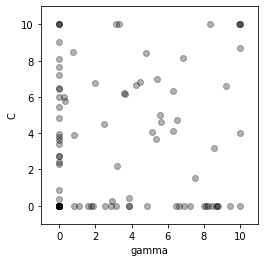

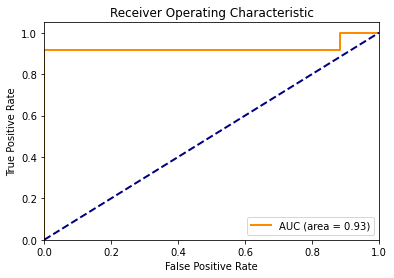

Accuracy for particle (in iteration 47, in fold 1) - 1 is 0.9655 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 47, in fold 1) - 2 is 0.4138 At (gamma, c): [1.59919888e+00 1.00000000e-03]
Accuracy for particle (in iteration 47, in fold 1) - 3 is 0.9655 At (gamma, c): [1.0000000e-03 6.4353913e+00]
Accuracy for particle (in iteration 47, in fold 1) - 4 is 0.8966 At (gamma, c): [ 9.90866822 10.        ]
Accuracy for particle (in iteration 47, in fold 1) - 5 is 0.4138 At (gamma, c): [6.42765682e+00 1.00000000e-03]
Accuracy for particle (in iteration 47, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 47, in fold 1) - 7 is 0.4138 At (gamma, c): [3.83763693e+00 1.00000000e-03]
Accuracy for particle (in iteration 47, in fold 1) - 8 is 0.4138 At (gamma, c): [8.70706471e+00 1.00000000e-03]
Accuracy for particle (in iteration 47, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 47, in fold 1) -

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 47, in fold 1) - 96 is 0.9655 At (gamma, c): [1.00000000e-03 9.03171847e+00]
Accuracy for particle (in iteration 47, in fold 1) - 97 is 0.4138 At (gamma, c): [6.6443356e+00 1.0000000e-03]
Accuracy for particle (in iteration 47, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 47, in fold 1) - 99 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 47, in fold 1) - 100 is 0.4138 At (gamma, c): [8.0874125e+00 1.0000000e-03]
The best position in iteration 47, fold 1 is [1.00000000e-03 4.96836569e+00], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9565
Recall Score: 0.9167
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 1 11]]
Confusion Matrix (Train):
[[119   7]
 [ 24 107]]

Iteration 48 - Fold 1:



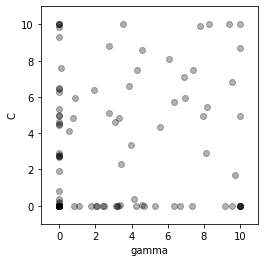

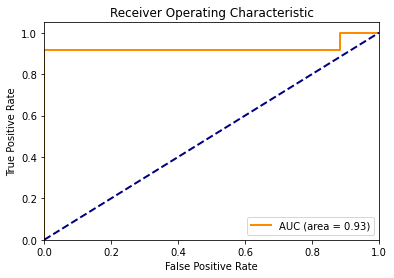

Accuracy for particle (in iteration 48, in fold 1) - 1 is 0.9310 At (gamma, c): [1.00000000e-03 4.96836569e+00]
Accuracy for particle (in iteration 48, in fold 1) - 2 is 0.4138 At (gamma, c): [1.77244676e+00 1.00000000e-03]
Accuracy for particle (in iteration 48, in fold 1) - 3 is 0.9655 At (gamma, c): [1.00000000e-03 6.27746958e+00]
Accuracy for particle (in iteration 48, in fold 1) - 4 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 48, in fold 1) - 5 is 0.4138 At (gamma, c): [7.32651382e+00 1.00000000e-03]
Accuracy for particle (in iteration 48, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001      0.14108877]
Accuracy for particle (in iteration 48, in fold 1) - 7 is 0.4138 At (gamma, c): [4.26985338e+00 1.00000000e-03]
Accuracy for particle (in iteration 48, in fold 1) - 8 is 0.4138 At (gamma, c): [6.69050768e+00 1.00000000e-03]
Accuracy for particle (in iteration 48, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 48, 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 48, in fold 1) - 96 is 0.9310 At (gamma, c): [1.00000000e-03 4.47940538e+00]
Accuracy for particle (in iteration 48, in fold 1) - 97 is 0.4138 At (gamma, c): [9.13496814e+00 1.00000000e-03]
Accuracy for particle (in iteration 48, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 48, in fold 1) - 99 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 48, in fold 1) - 100 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 48, fold 1 is [1.0000000e-03 5.8599723e+00], with Accuracy: 1.0000
Accuracy Score: 0.9310
F1 Score: 0.9091
Recall Score: 0.8333
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 2 10]]
Confusion Matrix (Train):
[[119   7]
 [ 29 102]]

Iteration 49 - Fold 1:



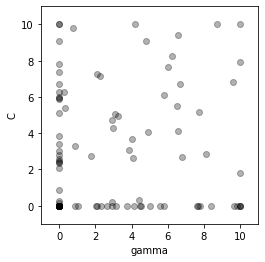

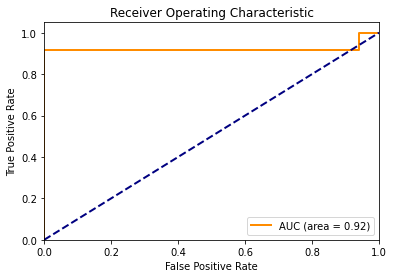

Accuracy for particle (in iteration 49, in fold 1) - 1 is 0.9310 At (gamma, c): [1.0000000e-03 5.8599723e+00]
Accuracy for particle (in iteration 49, in fold 1) - 2 is 0.4138 At (gamma, c): [2.02848017e+00 1.00000000e-03]
Accuracy for particle (in iteration 49, in fold 1) - 3 is 0.9655 At (gamma, c): [1.00000000e-03 6.01887821e+00]
Accuracy for particle (in iteration 49, in fold 1) - 4 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 49, in fold 1) - 5 is 0.4138 At (gamma, c): [9.64587683e+00 1.00000000e-03]
Accuracy for particle (in iteration 49, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001      0.14444724]
Accuracy for particle (in iteration 49, in fold 1) - 7 is 0.4138 At (gamma, c): [5.58503819e+00 1.00000000e-03]
Accuracy for particle (in iteration 49, in fold 1) - 8 is 0.4138 At (gamma, c): [7.66421206e+00 1.00000000e-03]
Accuracy for particle (in iteration 49, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 49, in

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 49, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 49, in fold 1) - 99 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 49, in fold 1) - 100 is 0.4138 At (gamma, c): [9.84679921e+00 1.00000000e-03]
The best position in iteration 49, fold 1 is [1.00000000e-03 7.64199977e+00], with Accuracy: 1.0000
Accuracy Score: 0.9310
F1 Score: 0.9091
Recall Score: 0.8333
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 2 10]]
Confusion Matrix (Train):
[[119   7]
 [ 28 103]]

Iteration 50 - Fold 1:



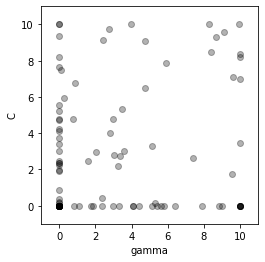

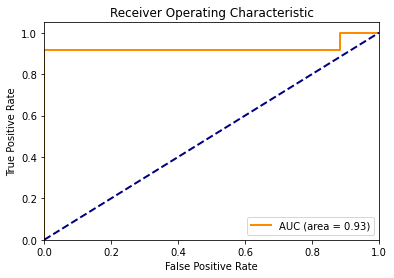

Accuracy for particle (in iteration 50, in fold 1) - 1 is 0.9655 At (gamma, c): [1.00000000e-03 7.64199977e+00]
Accuracy for particle (in iteration 50, in fold 1) - 2 is 0.4138 At (gamma, c): [1.76926543e+00 1.00000000e-03]
Accuracy for particle (in iteration 50, in fold 1) - 3 is 0.9310 At (gamma, c): [1.00000000e-03 4.23377654e+00]
Accuracy for particle (in iteration 50, in fold 1) - 4 is 0.8966 At (gamma, c): [8.6571443  9.28216877]
Accuracy for particle (in iteration 50, in fold 1) - 5 is 0.4138 At (gamma, c): [5.27680883 0.13767671]
Accuracy for particle (in iteration 50, in fold 1) - 6 is 0.4138 At (gamma, c): [0.001      0.16913636]
Accuracy for particle (in iteration 50, in fold 1) - 7 is 0.4138 At (gamma, c): [5.60976258e+00 1.00000000e-03]
Accuracy for particle (in iteration 50, in fold 1) - 8 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 50, in fold 1) - 9 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 50, in fold 1)

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 50, in fold 1) - 98 is 0.4138 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 50, in fold 1) - 99 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 50, in fold 1) - 100 is 0.4138 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 50, fold 1 is [1.00000000e-03 5.75067467e+00], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9565
Recall Score: 0.9167
Precision Score: 1.0000
Confusion Matrix (Test):
[[17  0]
 [ 1 11]]
Confusion Matrix (Train):
[[119   7]
 [ 25 106]]


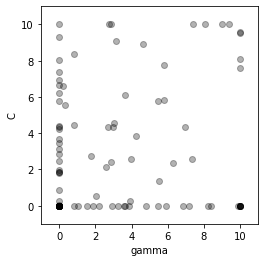

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.



Iteration 1 - Fold 2:



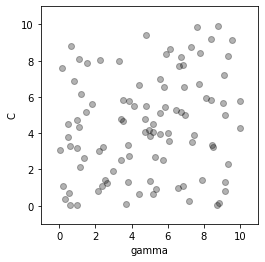

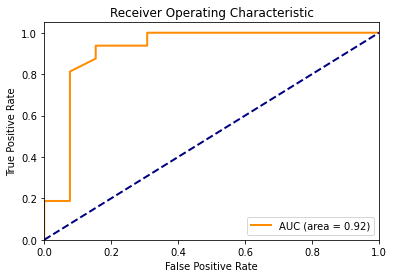

Accuracy for particle (in iteration 1, in fold 2) - 1 is 0.7586 At (gamma, c): [8.46102092 3.32198342]
Accuracy for particle (in iteration 1, in fold 2) - 2 is 0.7586 At (gamma, c): [5.75483196 2.53738684]
Accuracy for particle (in iteration 1, in fold 2) - 3 is 0.7586 At (gamma, c): [3.86629123 2.71764842]
Accuracy for particle (in iteration 1, in fold 2) - 4 is 0.9655 At (gamma, c): [0.51920602 3.78595119]
Accuracy for particle (in iteration 1, in fold 2) - 5 is 0.8966 At (gamma, c): [1.11260398 8.11581211]
Accuracy for particle (in iteration 1, in fold 2) - 6 is 0.7931 At (gamma, c): [2.13898037 0.80645629]
Accuracy for particle (in iteration 1, in fold 2) - 7 is 0.7586 At (gamma, c): [8.36310102 5.84059266]
Accuracy for particle (in iteration 1, in fold 2) - 8 is 0.7586 At (gamma, c): [9.06451731 5.67297609]
Accuracy for particle (in iteration 1, in fold 2) - 9 is 0.7586 At (gamma, c): [9.5286493  9.11972868]
Accuracy for particle (in iteration 1, in fold 2) - 10 is 0.7586 At (gamm

Accuracy for particle (in iteration 1, in fold 2) - 84 is 0.7586 At (gamma, c): [8.12521948 5.93689153]
Accuracy for particle (in iteration 1, in fold 2) - 85 is 0.9655 At (gamma, c): [0.54547733 0.67768473]
Accuracy for particle (in iteration 1, in fold 2) - 86 is 0.7586 At (gamma, c): [3.4314083  4.79845929]
Accuracy for particle (in iteration 1, in fold 2) - 87 is 0.7586 At (gamma, c): [3.55519625 5.81742865]
Accuracy for particle (in iteration 1, in fold 2) - 88 is 0.8276 At (gamma, c): [1.36432203 2.61791846]
Accuracy for particle (in iteration 1, in fold 2) - 89 is 0.4483 At (gamma, c): [0.9836594  0.02923549]
Accuracy for particle (in iteration 1, in fold 2) - 90 is 0.7586 At (gamma, c): [6.47950815 5.25417631]
Accuracy for particle (in iteration 1, in fold 2) - 91 is 0.7586 At (gamma, c): [7.91025225 1.43083812]
Accuracy for particle (in iteration 1, in fold 2) - 92 is 0.7586 At (gamma, c): [3.78761284 3.36975397]
Accuracy for particle (in iteration 1, in fold 2) - 93 is 0.7586

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


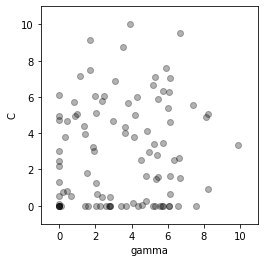

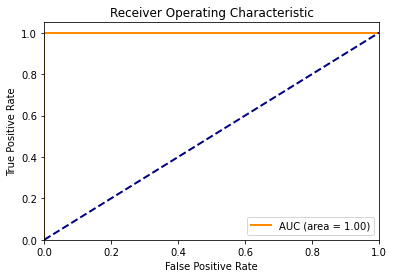

Accuracy for particle (in iteration 2, in fold 2) - 1 is 0.7586 At (gamma, c): [6.01314769 5.41113742]
Accuracy for particle (in iteration 2, in fold 2) - 2 is 0.7586 At (gamma, c): [5.7472289  6.32915314]
Accuracy for particle (in iteration 2, in fold 2) - 3 is 0.4483 At (gamma, c): [5.18607903e+00 1.00000000e-03]
Accuracy for particle (in iteration 2, in fold 2) - 4 is 0.7931 At (gamma, c): [2.39276918 5.7811402 ]
Accuracy for particle (in iteration 2, in fold 2) - 5 is 0.9655 At (gamma, c): [0.42465198 4.6744807 ]
Accuracy for particle (in iteration 2, in fold 2) - 6 is 0.7586 At (gamma, c): [3.62943501 4.00101489]
Accuracy for particle (in iteration 2, in fold 2) - 7 is 0.4483 At (gamma, c): [7.54063552e+00 1.00000000e-03]
Accuracy for particle (in iteration 2, in fold 2) - 8 is 0.7586 At (gamma, c): [5.72513123 3.4681914 ]
Accuracy for particle (in iteration 2, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 2, in fold 2) - 10 is 0.4483 At

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 2, in fold 2) - 98 is 0.4483 At (gamma, c): [6.04181389e+00 1.00000000e-03]
Accuracy for particle (in iteration 2, in fold 2) - 99 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 2, in fold 2) - 100 is 0.7586 At (gamma, c): [4.51625919 2.54782819]
The best position in iteration 2, fold 2 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8621
F1 Score: 0.8571
Recall Score: 0.7500
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 4 12]]
Confusion Matrix (Train):
[[124   6]
 [ 32  95]]

Iteration 3 - Fold 2:



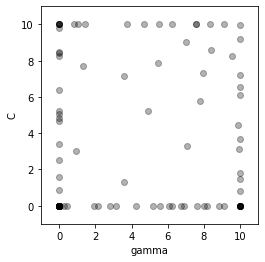

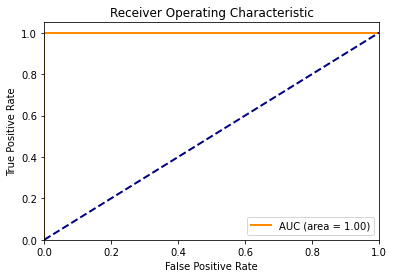

Accuracy for particle (in iteration 3, in fold 2) - 1 is 0.7586 At (gamma, c): [ 7.58419146 10.        ]
Accuracy for particle (in iteration 3, in fold 2) - 2 is 0.7586 At (gamma, c): [ 4.67874691 10.        ]
Accuracy for particle (in iteration 3, in fold 2) - 3 is 0.4483 At (gamma, c): [8.19002819e+00 1.00000000e-03]
Accuracy for particle (in iteration 3, in fold 2) - 4 is 0.7586 At (gamma, c): [5.44529433 7.85820529]
Accuracy for particle (in iteration 3, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 3, in fold 2) - 6 is 0.7586 At (gamma, c): [6.98738757 9.02322662]
Accuracy for particle (in iteration 3, in fold 2) - 7 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 3, in fold 2) - 8 is 0.4483 At (gamma, c): [0.41080819 0.001     ]
Accuracy for particle (in iteration 3, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 3, in fold 2) - 10 is 0.4483 At (gamma, c): [1.e+01 1

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 3, in fold 2) - 95 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 3, in fold 2) - 96 is 0.7586 At (gamma, c): [10.          0.83154859]
Accuracy for particle (in iteration 3, in fold 2) - 97 is 0.7586 At (gamma, c): [4.91616226 5.22943818]
Accuracy for particle (in iteration 3, in fold 2) - 98 is 0.4483 At (gamma, c): [6.25423912e+00 1.00000000e-03]
Accuracy for particle (in iteration 3, in fold 2) - 99 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 3, in fold 2) - 100 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 3, fold 2 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8966
F1 Score: 0.8966
Recall Score: 0.8125
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 3 13]]
Confusion Matrix (Train):
[[124   6]
 [ 20 107]]

Iteration 4 - Fold 2:



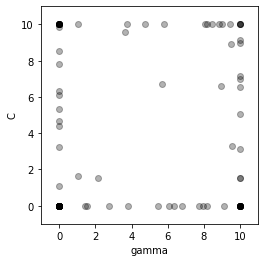

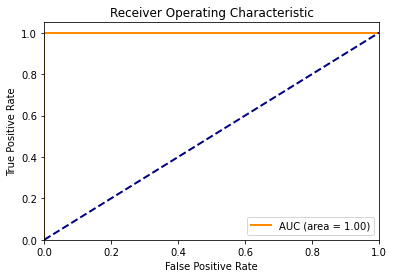

Accuracy for particle (in iteration 4, in fold 2) - 1 is 0.7586 At (gamma, c): [ 8.82505125 10.        ]
Accuracy for particle (in iteration 4, in fold 2) - 2 is 0.7586 At (gamma, c): [ 4.75332799 10.        ]
Accuracy for particle (in iteration 4, in fold 2) - 3 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 4, in fold 2) - 4 is 0.7586 At (gamma, c): [ 8.44849341 10.        ]
Accuracy for particle (in iteration 4, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 4, in fold 2) - 6 is 0.7586 At (gamma, c): [ 9.00183074 10.        ]
Accuracy for particle (in iteration 4, in fold 2) - 7 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 4, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 4, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 4, in fold 2) - 10 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for pa

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 4, in fold 2) - 98 is 0.4483 At (gamma, c): [5.48650776e+00 1.00000000e-03]
Accuracy for particle (in iteration 4, in fold 2) - 99 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 4, in fold 2) - 100 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 4, fold 2 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8966
F1 Score: 0.8966
Recall Score: 0.8125
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 3 13]]
Confusion Matrix (Train):
[[124   6]
 [ 20 107]]

Iteration 5 - Fold 2:



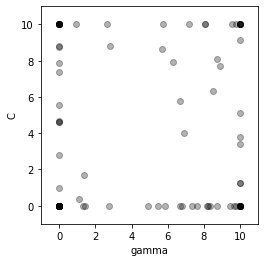

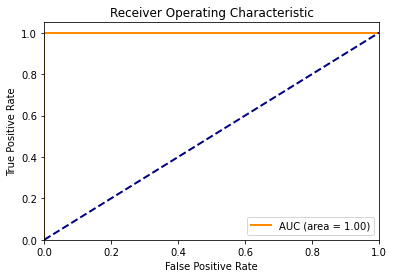

Accuracy for particle (in iteration 5, in fold 2) - 1 is 0.7586 At (gamma, c): [ 8.06241143 10.        ]
Accuracy for particle (in iteration 5, in fold 2) - 2 is 0.7586 At (gamma, c): [ 2.61904203 10.        ]
Accuracy for particle (in iteration 5, in fold 2) - 3 is 0.4483 At (gamma, c): [9.78413729e+00 1.00000000e-03]
Accuracy for particle (in iteration 5, in fold 2) - 4 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 5, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 5, in fold 2) - 6 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 5, in fold 2) - 7 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 5, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 5, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 5, in fold 2) - 10 is 0.4483 At (gamma, c): [8.70010894e+00 1.00000000e-03]
Accuracy for pa

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 5, in fold 2) - 95 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 5, in fold 2) - 96 is 0.4483 At (gamma, c): [9.45983085e+00 1.00000000e-03]
Accuracy for particle (in iteration 5, in fold 2) - 97 is 0.7586 At (gamma, c): [6.28597792 7.92953783]
Accuracy for particle (in iteration 5, in fold 2) - 98 is 0.4483 At (gamma, c): [8.13995468e+00 1.00000000e-03]
Accuracy for particle (in iteration 5, in fold 2) - 99 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 5, in fold 2) - 100 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 5, fold 2 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8966
F1 Score: 0.8966
Recall Score: 0.8125
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 3 13]]
Confusion Matrix (Train):
[[124   6]
 [ 20 107]]

Iteration 6 - Fold 2:



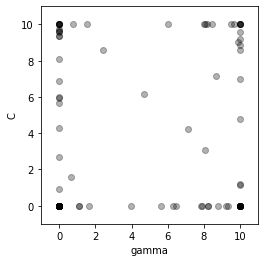

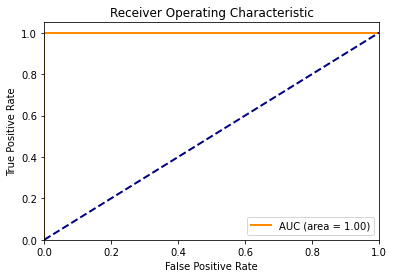

Accuracy for particle (in iteration 6, in fold 2) - 1 is 0.7586 At (gamma, c): [ 8.43975093 10.        ]
Accuracy for particle (in iteration 6, in fold 2) - 2 is 0.8276 At (gamma, c): [ 1.53386482 10.        ]
Accuracy for particle (in iteration 6, in fold 2) - 3 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 6, in fold 2) - 4 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 6, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 6, in fold 2) - 6 is 0.7586 At (gamma, c): [ 9.66076686 10.        ]
Accuracy for particle (in iteration 6, in fold 2) - 7 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 6, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 6, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 6, in fold 2) - 10 is 0.4483 At (gamma, c): [8.75429546e+00 1.00000000e-03]
Accuracy for pa

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 6, in fold 2) - 93 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 6, in fold 2) - 94 is 0.7586 At (gamma, c): [ 8.13685167 10.        ]
Accuracy for particle (in iteration 6, in fold 2) - 95 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 6, in fold 2) - 96 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 6, in fold 2) - 97 is 0.7586 At (gamma, c): [4.67883167 6.16156438]
Accuracy for particle (in iteration 6, in fold 2) - 98 is 0.4483 At (gamma, c): [9.18704059e+00 1.00000000e-03]
Accuracy for particle (in iteration 6, in fold 2) - 99 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 6, in fold 2) - 100 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 6, fold 2 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8966
F1 Score: 0.8966
Recall Score: 0.8125
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]

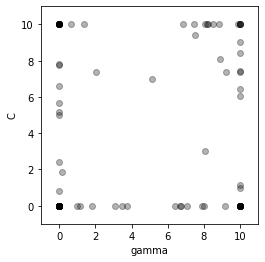

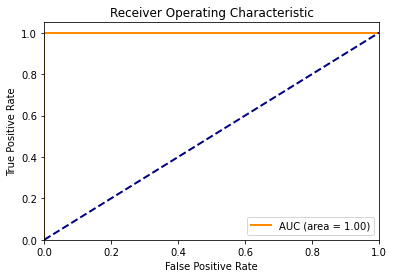

Accuracy for particle (in iteration 7, in fold 2) - 1 is 0.7586 At (gamma, c): [ 8.04223541 10.        ]
Accuracy for particle (in iteration 7, in fold 2) - 2 is 0.8276 At (gamma, c): [ 1.36903366 10.        ]
Accuracy for particle (in iteration 7, in fold 2) - 3 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 7, in fold 2) - 4 is 0.7586 At (gamma, c): [ 9.89107836 10.        ]
Accuracy for particle (in iteration 7, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 7, in fold 2) - 6 is 0.7586 At (gamma, c): [7.51585835 9.44094993]
Accuracy for particle (in iteration 7, in fold 2) - 7 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 7, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 7, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 7, in fold 2) - 10 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for part

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 7, in fold 2) - 99 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 7, in fold 2) - 100 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 7, fold 2 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8966
F1 Score: 0.8966
Recall Score: 0.8125
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 3 13]]
Confusion Matrix (Train):
[[124   6]
 [ 20 107]]

Iteration 8 - Fold 2:



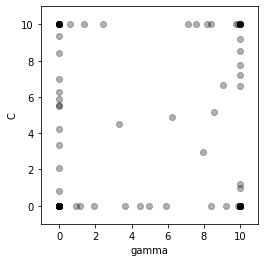

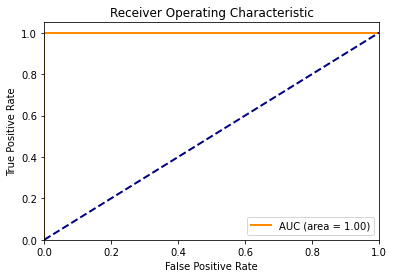

Accuracy for particle (in iteration 8, in fold 2) - 1 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 8, in fold 2) - 2 is 0.8276 At (gamma, c): [ 1.35773037 10.        ]
Accuracy for particle (in iteration 8, in fold 2) - 3 is 0.4483 At (gamma, c): [9.98471582e+00 1.00000000e-03]
Accuracy for particle (in iteration 8, in fold 2) - 4 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 8, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 8, in fold 2) - 6 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 8, in fold 2) - 7 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 8, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 8, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 8, in fold 2) - 10 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 8, in fold 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 8, in fold 2) - 100 is 0.4483 At (gamma, c): [9.88248711e+00 1.00000000e-03]
The best position in iteration 8, fold 2 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8966
F1 Score: 0.8966
Recall Score: 0.8125
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 3 13]]
Confusion Matrix (Train):
[[124   6]
 [ 20 107]]

Iteration 9 - Fold 2:



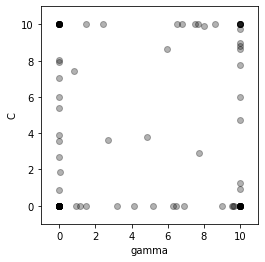

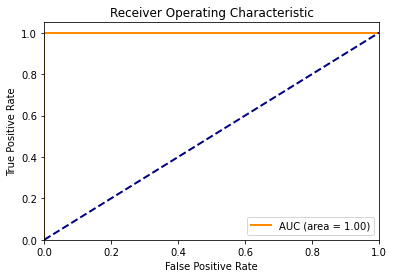

Accuracy for particle (in iteration 9, in fold 2) - 1 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 9, in fold 2) - 2 is 0.8276 At (gamma, c): [ 1.47596581 10.        ]
Accuracy for particle (in iteration 9, in fold 2) - 3 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 9, in fold 2) - 4 is 0.7586 At (gamma, c): [8.01334879 9.9354337 ]
Accuracy for particle (in iteration 9, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 9, in fold 2) - 6 is 0.7586 At (gamma, c): [ 8.59224268 10.        ]
Accuracy for particle (in iteration 9, in fold 2) - 7 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 9, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 9, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 9, in fold 2) - 10 is 0.4483 At (gamma, c): [8.98560491e+00 1.00000000e-03]
Accuracy for part

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 9, in fold 2) - 100 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 9, fold 2 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8966
F1 Score: 0.8966
Recall Score: 0.8125
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 3 13]]
Confusion Matrix (Train):
[[124   6]
 [ 20 107]]

Iteration 10 - Fold 2:



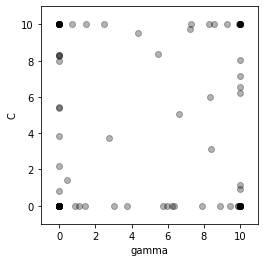

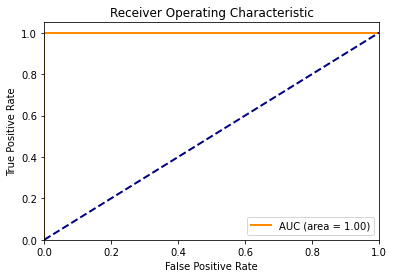

Accuracy for particle (in iteration 10, in fold 2) - 1 is 0.7586 At (gamma, c): [ 9.95499181 10.        ]
Accuracy for particle (in iteration 10, in fold 2) - 2 is 0.8276 At (gamma, c): [ 1.48864764 10.        ]
Accuracy for particle (in iteration 10, in fold 2) - 3 is 0.4483 At (gamma, c): [9.90048052e+00 1.00000000e-03]
Accuracy for particle (in iteration 10, in fold 2) - 4 is 0.7586 At (gamma, c): [7.20589982 9.72323836]
Accuracy for particle (in iteration 10, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 10, in fold 2) - 6 is 0.7586 At (gamma, c): [ 9.29522533 10.        ]
Accuracy for particle (in iteration 10, in fold 2) - 7 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 10, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 10, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 10, in fold 2) - 10 is 0.4483 At (gamma, c): [1.e+01

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


The best position in iteration 10, fold 2 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8966
F1 Score: 0.8966
Recall Score: 0.8125
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 3 13]]
Confusion Matrix (Train):
[[124   6]
 [ 20 107]]

Iteration 11 - Fold 2:



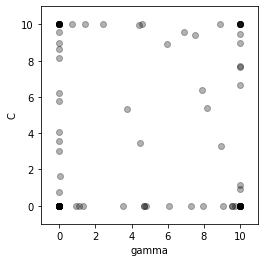

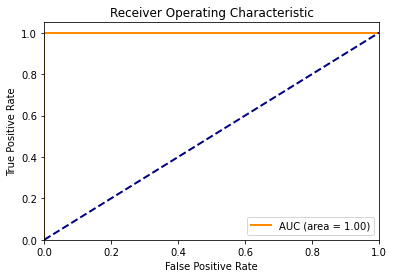

Accuracy for particle (in iteration 11, in fold 2) - 1 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 11, in fold 2) - 2 is 0.8276 At (gamma, c): [ 1.40676807 10.        ]
Accuracy for particle (in iteration 11, in fold 2) - 3 is 0.4483 At (gamma, c): [9.52874578e+00 1.00000000e-03]
Accuracy for particle (in iteration 11, in fold 2) - 4 is 0.7586 At (gamma, c): [6.88047027 9.55961374]
Accuracy for particle (in iteration 11, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 11, in fold 2) - 6 is 0.7586 At (gamma, c): [7.52146693 9.43251041]
Accuracy for particle (in iteration 11, in fold 2) - 7 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 11, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 11, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 11, in fold 2) - 10 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy 

Accuracy for particle (in iteration 11, in fold 2) - 82 is 0.7931 At (gamma, c): [ 2.39942065 10.        ]
Accuracy for particle (in iteration 11, in fold 2) - 83 is 0.4483 At (gamma, c): [4.8202277e+00 1.0000000e-03]
Accuracy for particle (in iteration 11, in fold 2) - 84 is 0.8966 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 11, in fold 2) - 85 is 0.4483 At (gamma, c): [4.67023785e+00 1.00000000e-03]
Accuracy for particle (in iteration 11, in fold 2) - 86 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 11, in fold 2) - 87 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 11, in fold 2) - 88 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 11, in fold 2) - 89 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 11, in fold 2) - 90 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 11, in fold 2) - 91 is 0.4483 At (gamma, c): [1.32908549e+00 1.0000

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


The best position in iteration 11, fold 2 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8966
F1 Score: 0.8966
Recall Score: 0.8125
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 3 13]]
Confusion Matrix (Train):
[[124   6]
 [ 20 107]]

Iteration 12 - Fold 2:



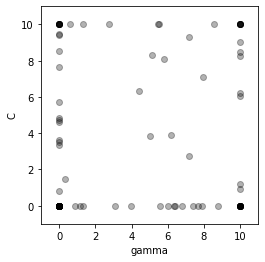

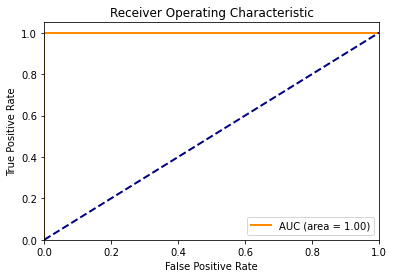

Accuracy for particle (in iteration 12, in fold 2) - 1 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 12, in fold 2) - 2 is 0.8276 At (gamma, c): [ 1.30286208 10.        ]
Accuracy for particle (in iteration 12, in fold 2) - 3 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 12, in fold 2) - 4 is 0.7586 At (gamma, c): [5.79882076 8.0832182 ]
Accuracy for particle (in iteration 12, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 12, in fold 2) - 6 is 0.7586 At (gamma, c): [7.18900912 9.31615609]
Accuracy for particle (in iteration 12, in fold 2) - 7 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 12, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 12, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 12, in fold 2) - 10 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in

Accuracy for particle (in iteration 12, in fold 2) - 83 is 0.4483 At (gamma, c): [6.76108264e+00 1.00000000e-03]
Accuracy for particle (in iteration 12, in fold 2) - 84 is 0.8966 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 12, in fold 2) - 85 is 0.4483 At (gamma, c): [6.36478998e+00 1.00000000e-03]
Accuracy for particle (in iteration 12, in fold 2) - 86 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 12, in fold 2) - 87 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 12, in fold 2) - 88 is 0.7586 At (gamma, c): [7.9343639  7.10278462]
Accuracy for particle (in iteration 12, in fold 2) - 89 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 12, in fold 2) - 90 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 12, in fold 2) - 91 is 0.4483 At (gamma, c): [1.2939779e+00 1.0000000e-03]
Accuracy for particle (in iteration 12, in fold 2) - 92 is 0.7586 At (gamma, c): [1

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


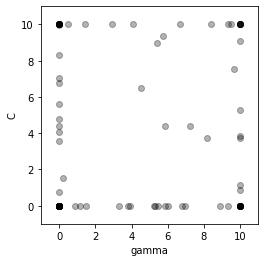

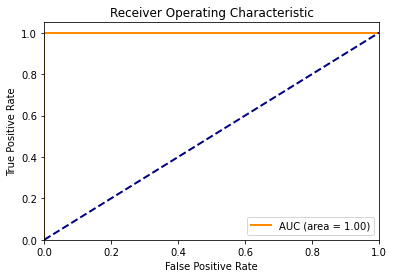

Accuracy for particle (in iteration 13, in fold 2) - 1 is 0.7586 At (gamma, c): [ 8.36753609 10.        ]
Accuracy for particle (in iteration 13, in fold 2) - 2 is 0.8276 At (gamma, c): [ 1.4170641 10.       ]
Accuracy for particle (in iteration 13, in fold 2) - 3 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 13, in fold 2) - 4 is 0.7586 At (gamma, c): [ 9.30896076 10.        ]
Accuracy for particle (in iteration 13, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 13, in fold 2) - 6 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 13, in fold 2) - 7 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 13, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 13, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 13, in fold 2) - 10 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (

Accuracy for particle (in iteration 13, in fold 2) - 83 is 0.4483 At (gamma, c): [5.29818689e+00 1.00000000e-03]
Accuracy for particle (in iteration 13, in fold 2) - 84 is 0.8966 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 13, in fold 2) - 85 is 0.4483 At (gamma, c): [5.46967455e+00 1.00000000e-03]
Accuracy for particle (in iteration 13, in fold 2) - 86 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 13, in fold 2) - 87 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 13, in fold 2) - 88 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 13, in fold 2) - 89 is 0.4483 At (gamma, c): [6.81162742e+00 1.00000000e-03]
Accuracy for particle (in iteration 13, in fold 2) - 90 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 13, in fold 2) - 91 is 0.4483 At (gamma, c): [1.49206335e+00 1.00000000e-03]
Accuracy for particle (in iteration 13, in fold 2) - 92 is 0.7586 At (gamma, c)

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


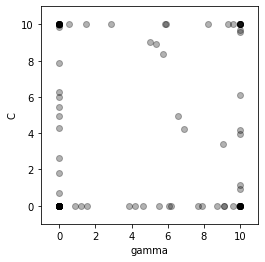

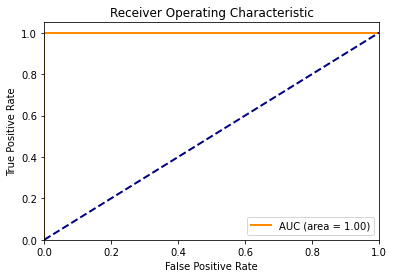

Accuracy for particle (in iteration 14, in fold 2) - 1 is 0.7586 At (gamma, c): [ 9.31122261 10.        ]
Accuracy for particle (in iteration 14, in fold 2) - 2 is 0.8276 At (gamma, c): [ 1.46656941 10.        ]
Accuracy for particle (in iteration 14, in fold 2) - 3 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 14, in fold 2) - 4 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 14, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 14, in fold 2) - 6 is 0.7586 At (gamma, c): [ 9.57959847 10.        ]
Accuracy for particle (in iteration 14, in fold 2) - 7 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 14, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 14, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 14, in fold 2) - 10 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 14, in fold 2) - 97 is 0.7586 At (gamma, c): [5.72082033 8.36099578]
Accuracy for particle (in iteration 14, in fold 2) - 98 is 0.4483 At (gamma, c): [7.89572114e+00 1.00000000e-03]
Accuracy for particle (in iteration 14, in fold 2) - 99 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 14, in fold 2) - 100 is 0.4483 At (gamma, c): [9.92659741e+00 1.00000000e-03]
The best position in iteration 14, fold 2 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8966
F1 Score: 0.8966
Recall Score: 0.8125
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 3 13]]
Confusion Matrix (Train):
[[124   6]
 [ 20 107]]

Iteration 15 - Fold 2:



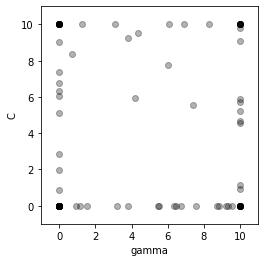

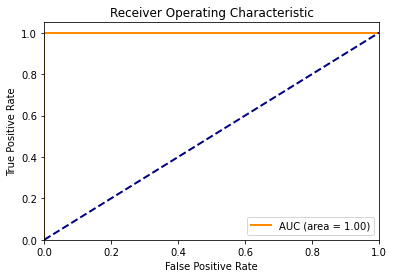

Accuracy for particle (in iteration 15, in fold 2) - 1 is 0.7586 At (gamma, c): [ 8.2696858 10.       ]
Accuracy for particle (in iteration 15, in fold 2) - 2 is 0.8621 At (gamma, c): [ 1.23973522 10.        ]
Accuracy for particle (in iteration 15, in fold 2) - 3 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 15, in fold 2) - 4 is 0.7586 At (gamma, c): [5.98718864 7.76014627]
Accuracy for particle (in iteration 15, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 15, in fold 2) - 6 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 15, in fold 2) - 7 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 15, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 15, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 15, in fold 2) - 10 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 15, in fold 2) - 97 is 0.7586 At (gamma, c): [4.1681869  5.94054141]
Accuracy for particle (in iteration 15, in fold 2) - 98 is 0.4483 At (gamma, c): [9.34463768e+00 1.00000000e-03]
Accuracy for particle (in iteration 15, in fold 2) - 99 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 15, in fold 2) - 100 is 0.4483 At (gamma, c): [9.19061924e+00 1.00000000e-03]
The best position in iteration 15, fold 2 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8966
F1 Score: 0.8966
Recall Score: 0.8125
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 3 13]]
Confusion Matrix (Train):
[[124   6]
 [ 20 107]]

Iteration 16 - Fold 2:



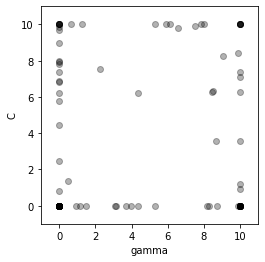

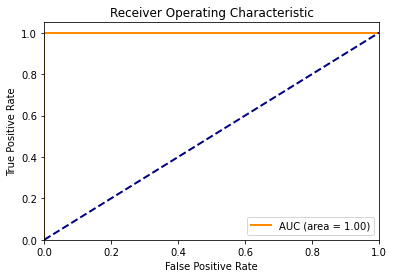

Accuracy for particle (in iteration 16, in fold 2) - 1 is 0.7586 At (gamma, c): [6.54361701 9.77974485]
Accuracy for particle (in iteration 16, in fold 2) - 2 is 0.8621 At (gamma, c): [ 1.25992871 10.        ]
Accuracy for particle (in iteration 16, in fold 2) - 3 is 0.4483 At (gamma, c): [8.15760476e+00 1.00000000e-03]
Accuracy for particle (in iteration 16, in fold 2) - 4 is 0.7586 At (gamma, c): [ 7.81852915 10.        ]
Accuracy for particle (in iteration 16, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 16, in fold 2) - 6 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 16, in fold 2) - 7 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 16, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 16, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 16, in fold 2) - 10 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accurac

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 16, in fold 2) - 96 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 16, in fold 2) - 97 is 0.7586 At (gamma, c): [4.35962182 6.23937889]
Accuracy for particle (in iteration 16, in fold 2) - 98 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 16, in fold 2) - 99 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 16, in fold 2) - 100 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 16, fold 2 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8966
F1 Score: 0.8966
Recall Score: 0.8125
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 3 13]]
Confusion Matrix (Train):
[[124   6]
 [ 20 107]]

Iteration 17 - Fold 2:



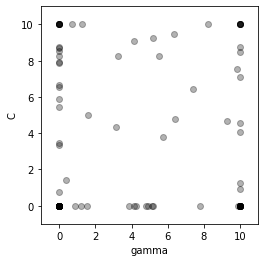

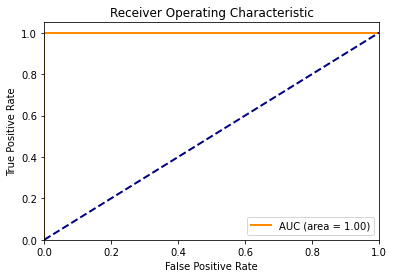

Accuracy for particle (in iteration 17, in fold 2) - 1 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 17, in fold 2) - 2 is 0.8621 At (gamma, c): [ 1.27571125 10.        ]
Accuracy for particle (in iteration 17, in fold 2) - 3 is 0.4483 At (gamma, c): [7.75658791e+00 1.00000000e-03]
Accuracy for particle (in iteration 17, in fold 2) - 4 is 0.7586 At (gamma, c): [ 8.19725861 10.        ]
Accuracy for particle (in iteration 17, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 17, in fold 2) - 6 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 17, in fold 2) - 7 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 17, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 17, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 17, in fold 2) - 10 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 17, in fold 2) - 98 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 17, in fold 2) - 99 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 17, in fold 2) - 100 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 17, fold 2 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8966
F1 Score: 0.8966
Recall Score: 0.8125
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 3 13]]
Confusion Matrix (Train):
[[124   6]
 [ 20 107]]

Iteration 18 - Fold 2:



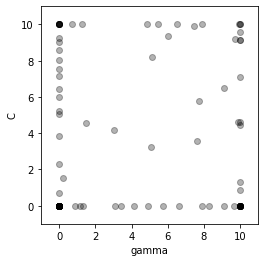

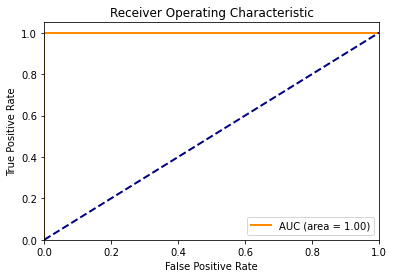

Accuracy for particle (in iteration 18, in fold 2) - 1 is 0.7586 At (gamma, c): [ 7.88479285 10.        ]
Accuracy for particle (in iteration 18, in fold 2) - 2 is 0.8621 At (gamma, c): [ 1.28360093 10.        ]
Accuracy for particle (in iteration 18, in fold 2) - 3 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 18, in fold 2) - 4 is 0.7586 At (gamma, c): [7.46876187 9.90325311]
Accuracy for particle (in iteration 18, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 18, in fold 2) - 6 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 18, in fold 2) - 7 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 18, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 18, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 18, in fold 2) - 10 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 18, in fold 2) - 97 is 0.7586 At (gamma, c): [3.02526305 4.15870019]
Accuracy for particle (in iteration 18, in fold 2) - 98 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 18, in fold 2) - 99 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 18, in fold 2) - 100 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 18, fold 2 is [1.00000000e-03 9.45531788e+00], with Accuracy: 1.0000
Accuracy Score: 0.8966
F1 Score: 0.8966
Recall Score: 0.8125
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 3 13]]
Confusion Matrix (Train):
[[124   6]
 [ 20 107]]

Iteration 19 - Fold 2:



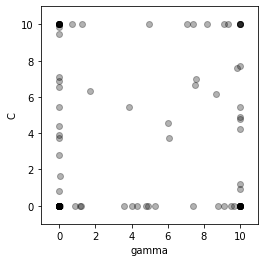

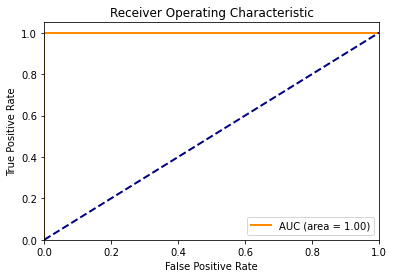

Accuracy for particle (in iteration 19, in fold 2) - 1 is 0.7586 At (gamma, c): [ 9.30820124 10.        ]
Accuracy for particle (in iteration 19, in fold 2) - 2 is 0.8621 At (gamma, c): [ 1.24178187 10.        ]
Accuracy for particle (in iteration 19, in fold 2) - 3 is 0.4483 At (gamma, c): [9.66960237e+00 1.00000000e-03]
Accuracy for particle (in iteration 19, in fold 2) - 4 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 19, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 19, in fold 2) - 6 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 19, in fold 2) - 7 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 19, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 19, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 19, in fold 2) - 10 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle

Accuracy for particle (in iteration 19, in fold 2) - 82 is 0.8276 At (gamma, c): [1.73182342 6.33134306]
Accuracy for particle (in iteration 19, in fold 2) - 83 is 0.4483 At (gamma, c): [5.27942064e+00 1.00000000e-03]
Accuracy for particle (in iteration 19, in fold 2) - 84 is 0.8966 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 19, in fold 2) - 85 is 0.4483 At (gamma, c): [9.12251654e+00 1.00000000e-03]
Accuracy for particle (in iteration 19, in fold 2) - 86 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 19, in fold 2) - 87 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 19, in fold 2) - 88 is 0.7586 At (gamma, c): [7.51815953 6.67806387]
Accuracy for particle (in iteration 19, in fold 2) - 89 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 19, in fold 2) - 90 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 19, in fold 2) - 91 is 0.4483 At (gamma, c): [1.23339

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


The best position in iteration 19, fold 2 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8966
F1 Score: 0.8966
Recall Score: 0.8125
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 3 13]]
Confusion Matrix (Train):
[[124   6]
 [ 26 101]]

Iteration 20 - Fold 2:



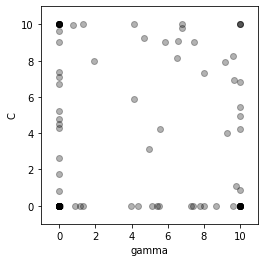

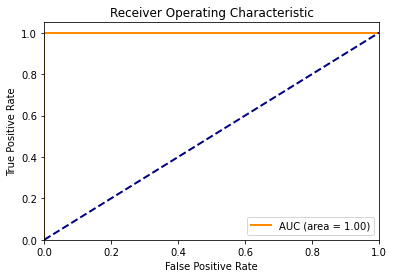

Accuracy for particle (in iteration 20, in fold 2) - 1 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 20, in fold 2) - 2 is 0.8276 At (gamma, c): [ 1.30851897 10.        ]
Accuracy for particle (in iteration 20, in fold 2) - 3 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 20, in fold 2) - 4 is 0.7586 At (gamma, c): [6.49464681 8.14333171]
Accuracy for particle (in iteration 20, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 20, in fold 2) - 6 is 0.7586 At (gamma, c): [7.45905137 9.02754394]
Accuracy for particle (in iteration 20, in fold 2) - 7 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 20, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 20, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 20, in fold 2) - 10 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 20, in fold 2) - 99 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 20, in fold 2) - 100 is 0.4483 At (gamma, c): [9.96052221e+00 1.00000000e-03]
The best position in iteration 20, fold 2 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8966
F1 Score: 0.8966
Recall Score: 0.8125
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 3 13]]
Confusion Matrix (Train):
[[124   6]
 [ 20 107]]

Iteration 21 - Fold 2:



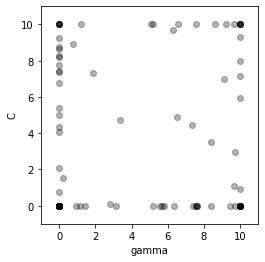

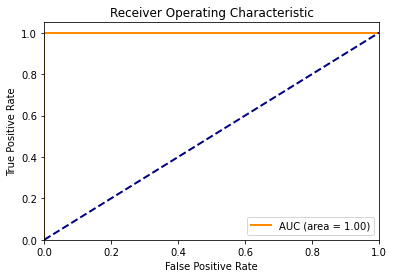

Accuracy for particle (in iteration 21, in fold 2) - 1 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 21, in fold 2) - 2 is 0.8621 At (gamma, c): [ 1.19803181 10.        ]
Accuracy for particle (in iteration 21, in fold 2) - 3 is 0.4483 At (gamma, c): [7.5439157e+00 1.0000000e-03]
Accuracy for particle (in iteration 21, in fold 2) - 4 is 0.7586 At (gamma, c): [ 8.60082646 10.        ]
Accuracy for particle (in iteration 21, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 21, in fold 2) - 6 is 0.7586 At (gamma, c): [ 9.67946947 10.        ]
Accuracy for particle (in iteration 21, in fold 2) - 7 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 21, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 21, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 21, in fold 2) - 10 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accurac

Accuracy for particle (in iteration 21, in fold 2) - 83 is 0.4483 At (gamma, c): [5.78184793e+00 1.00000000e-03]
Accuracy for particle (in iteration 21, in fold 2) - 84 is 0.8966 At (gamma, c): [1.00000000e-03 9.26606429e+00]
Accuracy for particle (in iteration 21, in fold 2) - 85 is 0.4483 At (gamma, c): [9.46067704e+00 1.00000000e-03]
Accuracy for particle (in iteration 21, in fold 2) - 86 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 21, in fold 2) - 87 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 21, in fold 2) - 88 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 21, in fold 2) - 89 is 0.4483 At (gamma, c): [7.39990759e+00 1.00000000e-03]
Accuracy for particle (in iteration 21, in fold 2) - 90 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 21, in fold 2) - 91 is 0.4483 At (gamma, c): [1.45404997e+00 1.00000000e-03]
Accuracy for particle (in iteration 21, in fold 2) - 92 is 0.75

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


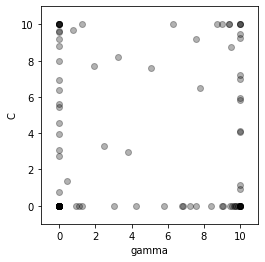

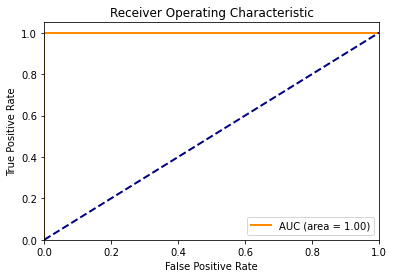

Accuracy for particle (in iteration 22, in fold 2) - 1 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 22, in fold 2) - 2 is 0.8621 At (gamma, c): [ 1.28098262 10.        ]
Accuracy for particle (in iteration 22, in fold 2) - 3 is 0.4483 At (gamma, c): [9.74991683e+00 1.00000000e-03]
Accuracy for particle (in iteration 22, in fold 2) - 4 is 0.7586 At (gamma, c): [ 9.36824237 10.        ]
Accuracy for particle (in iteration 22, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 22, in fold 2) - 6 is 0.7586 At (gamma, c): [7.56830677 9.17456329]
Accuracy for particle (in iteration 22, in fold 2) - 7 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 22, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 22, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 22, in fold 2) - 10 is 0.4483 At (gamma, c): [9.01509523e+00 1.00000

Accuracy for particle (in iteration 22, in fold 2) - 80 is 0.7586 At (gamma, c): [ 8.69128982 10.        ]
Accuracy for particle (in iteration 22, in fold 2) - 81 is 0.4483 At (gamma, c): [9.89267e+00 1.00000e-03]
Accuracy for particle (in iteration 22, in fold 2) - 82 is 0.8276 At (gamma, c): [1.91341476 7.70509493]
Accuracy for particle (in iteration 22, in fold 2) - 83 is 0.4483 At (gamma, c): [6.84395973e+00 1.00000000e-03]
Accuracy for particle (in iteration 22, in fold 2) - 84 is 0.8966 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 22, in fold 2) - 85 is 0.4483 At (gamma, c): [9.41116185e+00 1.00000000e-03]
Accuracy for particle (in iteration 22, in fold 2) - 86 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 22, in fold 2) - 87 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 22, in fold 2) - 88 is 0.7586 At (gamma, c): [9.49718221 8.77747458]
Accuracy for particle (in iteration 22, in fold 2) - 89 is 0.4483 A

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 22, in fold 2) - 100 is 0.4483 At (gamma, c): [9.72546098e+00 1.00000000e-03]
The best position in iteration 22, fold 2 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8966
F1 Score: 0.8966
Recall Score: 0.8125
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 3 13]]
Confusion Matrix (Train):
[[124   6]
 [ 28  99]]

Iteration 23 - Fold 2:



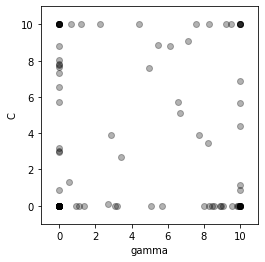

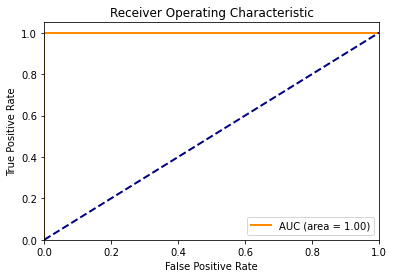

Accuracy for particle (in iteration 23, in fold 2) - 1 is 0.7586 At (gamma, c): [6.11267518 8.79320904]
Accuracy for particle (in iteration 23, in fold 2) - 2 is 0.8621 At (gamma, c): [ 1.1948095 10.       ]
Accuracy for particle (in iteration 23, in fold 2) - 3 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 23, in fold 2) - 4 is 0.7586 At (gamma, c): [ 9.23404785 10.        ]
Accuracy for particle (in iteration 23, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 23, in fold 2) - 6 is 0.7586 At (gamma, c): [7.10747008 9.07177294]
Accuracy for particle (in iteration 23, in fold 2) - 7 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 23, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 23, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 23, in fold 2) - 10 is 0.4483 At (gamma, c): [9.0196929e+00 1.0000000e-0

Accuracy for particle (in iteration 23, in fold 2) - 83 is 0.4483 At (gamma, c): [8.53197173e+00 1.00000000e-03]
Accuracy for particle (in iteration 23, in fold 2) - 84 is 0.8966 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 23, in fold 2) - 85 is 0.4483 At (gamma, c): [8.9386431e+00 1.0000000e-03]
Accuracy for particle (in iteration 23, in fold 2) - 86 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 23, in fold 2) - 87 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 23, in fold 2) - 88 is 0.7586 At (gamma, c): [6.54966334 5.74021276]
Accuracy for particle (in iteration 23, in fold 2) - 89 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 23, in fold 2) - 90 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 23, in fold 2) - 91 is 0.4483 At (gamma, c): [1.36114081e+00 1.00000000e-03]
Accuracy for particle (in iteration 23, in fold 2) - 92 is 0.7586 At (gamma, c): [1

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


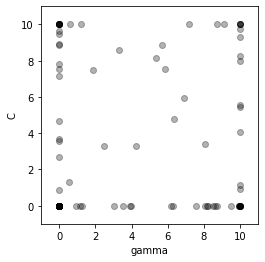

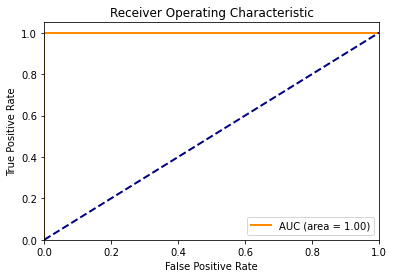

Accuracy for particle (in iteration 24, in fold 2) - 1 is 0.7586 At (gamma, c): [ 9.10046299 10.        ]
Accuracy for particle (in iteration 24, in fold 2) - 2 is 0.8621 At (gamma, c): [ 1.21396181 10.        ]
Accuracy for particle (in iteration 24, in fold 2) - 3 is 0.4483 At (gamma, c): [8.47898608e+00 1.00000000e-03]
Accuracy for particle (in iteration 24, in fold 2) - 4 is 0.7586 At (gamma, c): [5.8523162  7.55342317]
Accuracy for particle (in iteration 24, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 24, in fold 2) - 6 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 24, in fold 2) - 7 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 24, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 24, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 24, in fold 2) - 10 is 0.4483 At (gamma, c): [9.92726829e+00 1.00000

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 24, in fold 2) - 98 is 0.4483 At (gamma, c): [8.57943988e+00 1.00000000e-03]
Accuracy for particle (in iteration 24, in fold 2) - 99 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 24, in fold 2) - 100 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 24, fold 2 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8966
F1 Score: 0.8966
Recall Score: 0.8125
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 3 13]]
Confusion Matrix (Train):
[[124   6]
 [ 20 107]]

Iteration 25 - Fold 2:



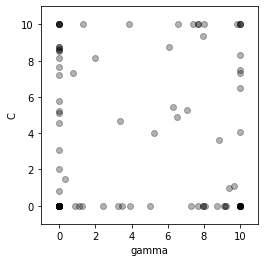

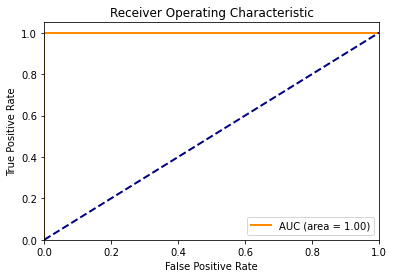

Accuracy for particle (in iteration 25, in fold 2) - 1 is 0.7586 At (gamma, c): [6.0439261  8.76860257]
Accuracy for particle (in iteration 25, in fold 2) - 2 is 0.8276 At (gamma, c): [ 1.29320667 10.        ]
Accuracy for particle (in iteration 25, in fold 2) - 3 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 25, in fold 2) - 4 is 0.7586 At (gamma, c): [ 8.00460586 10.        ]
Accuracy for particle (in iteration 25, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 25, in fold 2) - 6 is 0.7586 At (gamma, c): [7.91686921 9.36713369]
Accuracy for particle (in iteration 25, in fold 2) - 7 is 0.4483 At (gamma, c): [9.10025102e+00 1.00000000e-03]
Accuracy for particle (in iteration 25, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 25, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 25, in fold 2) - 10 is 0.4483 At (gamma, c): [1.e+01 1

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 25, in fold 2) - 96 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 25, in fold 2) - 97 is 0.7586 At (gamma, c): [3.35824583 4.67811307]
Accuracy for particle (in iteration 25, in fold 2) - 98 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 25, in fold 2) - 99 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 25, in fold 2) - 100 is 0.4483 At (gamma, c): [9.22433311e+00 1.00000000e-03]
The best position in iteration 25, fold 2 is [1.00000000e-03 8.65653082e+00], with Accuracy: 1.0000
Accuracy Score: 0.8966
F1 Score: 0.8966
Recall Score: 0.8125
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 3 13]]
Confusion Matrix (Train):
[[124   6]
 [ 20 107]]

Iteration 26 - Fold 2:



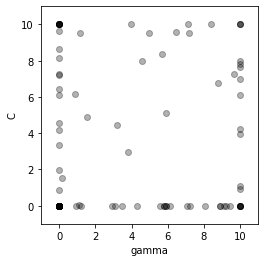

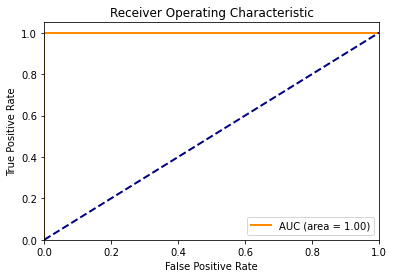

Accuracy for particle (in iteration 26, in fold 2) - 1 is 0.7586 At (gamma, c): [ 7.13813027 10.        ]
Accuracy for particle (in iteration 26, in fold 2) - 2 is 0.8966 At (gamma, c): [1.16314905 9.5532962 ]
Accuracy for particle (in iteration 26, in fold 2) - 3 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 26, in fold 2) - 4 is 0.7586 At (gamma, c): [7.17138836 9.54113018]
Accuracy for particle (in iteration 26, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 26, in fold 2) - 6 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 26, in fold 2) - 7 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 26, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 26, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 26, in fold 2) - 10 is 0.4483 At (gamma, c): [9.08841194e+00 1.00000000e-03]
Accuracy 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 26, in fold 2) - 97 is 0.7586 At (gamma, c): [3.22273553 4.46676024]
Accuracy for particle (in iteration 26, in fold 2) - 98 is 0.4483 At (gamma, c): [5.88857606e+00 1.00000000e-03]
Accuracy for particle (in iteration 26, in fold 2) - 99 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 26, in fold 2) - 100 is 0.4483 At (gamma, c): [9.19489332e+00 1.00000000e-03]
The best position in iteration 26, fold 2 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8966
F1 Score: 0.8966
Recall Score: 0.8125
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 3 13]]
Confusion Matrix (Train):
[[124   6]
 [ 28  99]]

Iteration 27 - Fold 2:



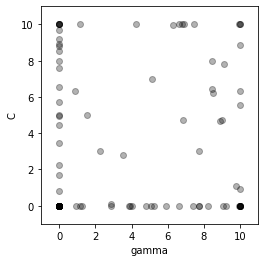

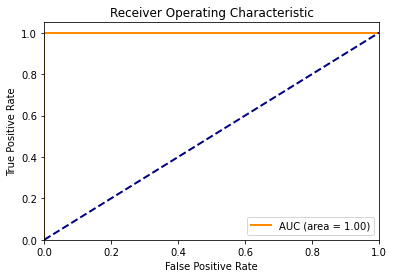

Accuracy for particle (in iteration 27, in fold 2) - 1 is 0.7586 At (gamma, c): [ 7.4249164 10.       ]
Accuracy for particle (in iteration 27, in fold 2) - 2 is 0.8966 At (gamma, c): [ 1.179769 10.      ]
Accuracy for particle (in iteration 27, in fold 2) - 3 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 27, in fold 2) - 4 is 0.7586 At (gamma, c): [5.10466492 6.97856931]
Accuracy for particle (in iteration 27, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 27, in fold 2) - 6 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 27, in fold 2) - 7 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 27, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 27, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 27, in fold 2) - 10 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in ite

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 27, in fold 2) - 97 is 0.7931 At (gamma, c): [2.28398474 3.00260775]
Accuracy for particle (in iteration 27, in fold 2) - 98 is 0.4483 At (gamma, c): [5.24762294e+00 1.00000000e-03]
Accuracy for particle (in iteration 27, in fold 2) - 99 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 27, in fold 2) - 100 is 0.4483 At (gamma, c): [9.02770636e+00 1.00000000e-03]
The best position in iteration 27, fold 2 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8966
F1 Score: 0.8966
Recall Score: 0.8125
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 3 13]]
Confusion Matrix (Train):
[[124   6]
 [ 20 107]]

Iteration 28 - Fold 2:



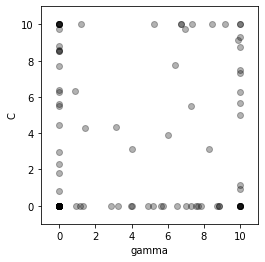

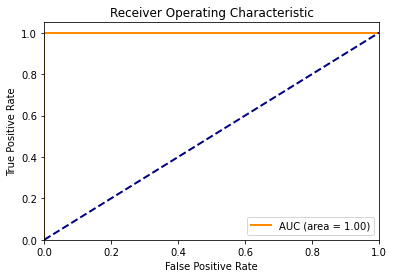

Accuracy for particle (in iteration 28, in fold 2) - 1 is 0.7586 At (gamma, c): [ 7.34147294 10.        ]
Accuracy for particle (in iteration 28, in fold 2) - 2 is 0.8621 At (gamma, c): [ 1.21458311 10.        ]
Accuracy for particle (in iteration 28, in fold 2) - 3 is 0.4483 At (gamma, c): [8.73514847e+00 1.00000000e-03]
Accuracy for particle (in iteration 28, in fold 2) - 4 is 0.7586 At (gamma, c): [6.96903128 9.76822051]
Accuracy for particle (in iteration 28, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 28, in fold 2) - 6 is 0.7586 At (gamma, c): [6.3817677  7.76109534]
Accuracy for particle (in iteration 28, in fold 2) - 7 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 28, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 28, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 28, in fold 2) - 10 is 0.4483 At (gamma, c): [1.e+01 1

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 28, in fold 2) - 94 is 0.7586 At (gamma, c): [ 8.45278153 10.        ]
Accuracy for particle (in iteration 28, in fold 2) - 95 is 0.4483 At (gamma, c): [9.96578859e+00 1.00000000e-03]
Accuracy for particle (in iteration 28, in fold 2) - 96 is 0.4483 At (gamma, c): [7.30684941e+00 1.00000000e-03]
Accuracy for particle (in iteration 28, in fold 2) - 97 is 0.7586 At (gamma, c): [3.1450735 4.3456323]
Accuracy for particle (in iteration 28, in fold 2) - 98 is 0.4483 At (gamma, c): [7.57066016e+00 1.00000000e-03]
Accuracy for particle (in iteration 28, in fold 2) - 99 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 28, in fold 2) - 100 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 28, fold 2 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8966
F1 Score: 0.8966
Recall Score: 0.8125
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 3 13]]
Confusion Matrix (Train):
[[124   6]
 [ 20 10

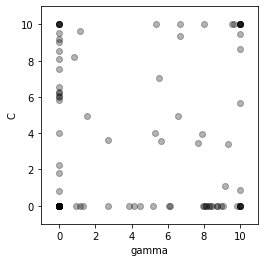

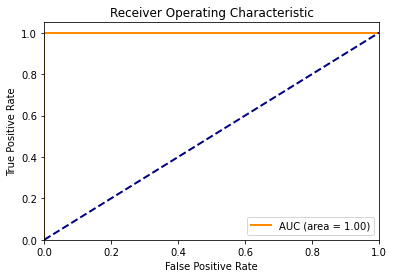

Accuracy for particle (in iteration 29, in fold 2) - 1 is 0.7586 At (gamma, c): [ 9.66434288 10.        ]
Accuracy for particle (in iteration 29, in fold 2) - 2 is 0.8966 At (gamma, c): [1.15132759 9.61611267]
Accuracy for particle (in iteration 29, in fold 2) - 3 is 0.4483 At (gamma, c): [7.97173878e+00 1.00000000e-03]
Accuracy for particle (in iteration 29, in fold 2) - 4 is 0.7586 At (gamma, c): [ 7.9970217 10.       ]
Accuracy for particle (in iteration 29, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 29, in fold 2) - 6 is 0.7586 At (gamma, c): [5.51308217 7.05125255]
Accuracy for particle (in iteration 29, in fold 2) - 7 is 0.4483 At (gamma, c): [9.82959046e+00 1.00000000e-03]
Accuracy for particle (in iteration 29, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 29, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 29, in fold 2) - 10 is 0.4483 At (gamma,

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 29, in fold 2) - 97 is 0.7586 At (gamma, c): [2.67775819 3.61676908]
Accuracy for particle (in iteration 29, in fold 2) - 98 is 0.4483 At (gamma, c): [8.6947656e+00 1.0000000e-03]
Accuracy for particle (in iteration 29, in fold 2) - 99 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 29, in fold 2) - 100 is 0.4483 At (gamma, c): [8.10043479e+00 1.00000000e-03]
The best position in iteration 29, fold 2 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8966
F1 Score: 0.8966
Recall Score: 0.8125
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 3 13]]
Confusion Matrix (Train):
[[124   6]
 [ 20 107]]

Iteration 30 - Fold 2:



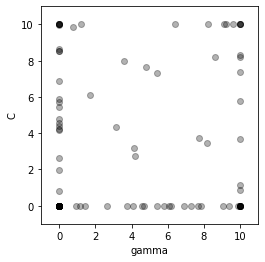

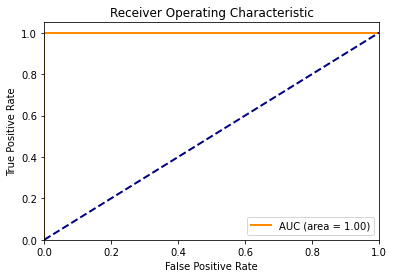

Accuracy for particle (in iteration 30, in fold 2) - 1 is 0.7586 At (gamma, c): [ 9.09792155 10.        ]
Accuracy for particle (in iteration 30, in fold 2) - 2 is 0.8621 At (gamma, c): [ 1.1885874 10.       ]
Accuracy for particle (in iteration 30, in fold 2) - 3 is 0.4483 At (gamma, c): [6.91938033e+00 1.00000000e-03]
Accuracy for particle (in iteration 30, in fold 2) - 4 is 0.7586 At (gamma, c): [ 9.62082591 10.        ]
Accuracy for particle (in iteration 30, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 30, in fold 2) - 6 is 0.7586 At (gamma, c): [ 9.19629312 10.        ]
Accuracy for particle (in iteration 30, in fold 2) - 7 is 0.4483 At (gamma, c): [9.03232284e+00 1.00000000e-03]
Accuracy for particle (in iteration 30, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 30, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 30, in fold 2) - 10 is 0.4483 At (ga

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 30, in fold 2) - 96 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 30, in fold 2) - 97 is 0.7586 At (gamma, c): [3.14704302 4.34870413]
Accuracy for particle (in iteration 30, in fold 2) - 98 is 0.4483 At (gamma, c): [7.65992566e+00 1.00000000e-03]
Accuracy for particle (in iteration 30, in fold 2) - 99 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 30, in fold 2) - 100 is 0.4483 At (gamma, c): [9.87364502e+00 1.00000000e-03]
The best position in iteration 30, fold 2 is [1.00000000e-03 8.50315383e+00], with Accuracy: 1.0000
Accuracy Score: 0.8966
F1 Score: 0.8966
Recall Score: 0.8125
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 3 13]]
Confusion Matrix (Train):
[[124   6]
 [ 20 107]]

Iteration 31 - Fold 2:



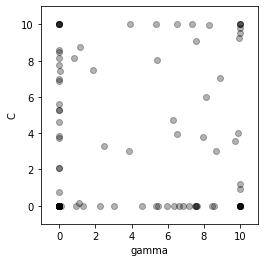

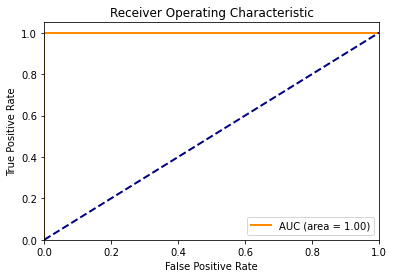

Accuracy for particle (in iteration 31, in fold 2) - 1 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 31, in fold 2) - 2 is 0.8966 At (gamma, c): [1.1286103  8.78198406]
Accuracy for particle (in iteration 31, in fold 2) - 3 is 0.4483 At (gamma, c): [7.53984861e+00 1.00000000e-03]
Accuracy for particle (in iteration 31, in fold 2) - 4 is 0.7586 At (gamma, c): [7.55750335 9.09548712]
Accuracy for particle (in iteration 31, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 31, in fold 2) - 6 is 0.7586 At (gamma, c): [8.2898372  9.95333007]
Accuracy for particle (in iteration 31, in fold 2) - 7 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 31, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 31, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 31, in fold 2) - 10 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy fo

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 31, in fold 2) - 97 is 0.7931 At (gamma, c): [2.45972576 3.27670785]
Accuracy for particle (in iteration 31, in fold 2) - 98 is 0.4483 At (gamma, c): [6.36671821e+00 1.00000000e-03]
Accuracy for particle (in iteration 31, in fold 2) - 99 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 31, in fold 2) - 100 is 0.4483 At (gamma, c): [8.52583193e+00 1.00000000e-03]
The best position in iteration 31, fold 2 is [1.00000000e-03 9.75166528e+00], with Accuracy: 1.0000
Accuracy Score: 0.8966
F1 Score: 0.8966
Recall Score: 0.8125
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 3 13]]
Confusion Matrix (Train):
[[124   6]
 [ 28  99]]

Iteration 32 - Fold 2:



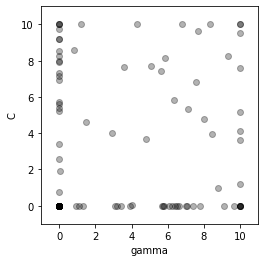

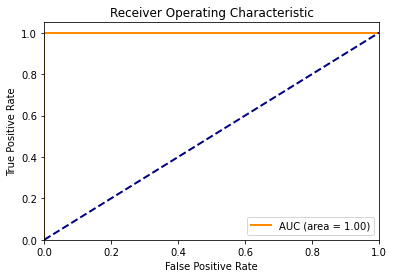

Accuracy for particle (in iteration 32, in fold 2) - 1 is 0.7586 At (gamma, c): [5.85134058 8.15095648]
Accuracy for particle (in iteration 32, in fold 2) - 2 is 0.8621 At (gamma, c): [ 1.19778924 10.        ]
Accuracy for particle (in iteration 32, in fold 2) - 3 is 0.4483 At (gamma, c): [6.07076674e+00 1.00000000e-03]
Accuracy for particle (in iteration 32, in fold 2) - 4 is 0.7586 At (gamma, c): [5.6328371  7.41155277]
Accuracy for particle (in iteration 32, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 32, in fold 2) - 6 is 0.7586 At (gamma, c): [7.64109576 9.6193041 ]
Accuracy for particle (in iteration 32, in fold 2) - 7 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 32, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 32, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 32, in fold 2) - 10 is 0.4483 At (gamma, c): [6.98058144

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 32, in fold 2) - 97 is 0.7586 At (gamma, c): [2.94542131 4.0342384 ]
Accuracy for particle (in iteration 32, in fold 2) - 98 is 0.4483 At (gamma, c): [5.79456165e+00 1.00000000e-03]
Accuracy for particle (in iteration 32, in fold 2) - 99 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 32, in fold 2) - 100 is 0.4483 At (gamma, c): [9.66570976e+00 1.00000000e-03]
The best position in iteration 32, fold 2 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9677
Recall Score: 0.9375
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 1 15]]
Confusion Matrix (Train):
[[129   1]
 [ 12 115]]

Iteration 33 - Fold 2:



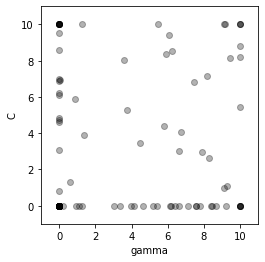

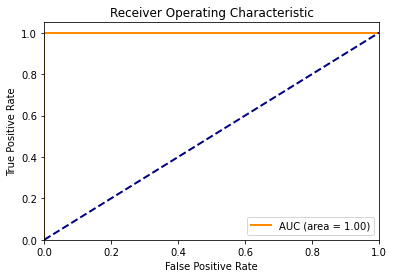

Accuracy for particle (in iteration 33, in fold 2) - 1 is 0.7586 At (gamma, c): [ 9.08888299 10.        ]
Accuracy for particle (in iteration 33, in fold 2) - 2 is 0.8621 At (gamma, c): [ 1.25686358 10.        ]
Accuracy for particle (in iteration 33, in fold 2) - 3 is 0.4483 At (gamma, c): [8.43101645e+00 1.00000000e-03]
Accuracy for particle (in iteration 33, in fold 2) - 4 is 0.7586 At (gamma, c): [6.25701745 8.54317154]
Accuracy for particle (in iteration 33, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 33, in fold 2) - 6 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 33, in fold 2) - 7 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 33, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 33, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 33, in fold 2) - 10 is 0.4483 At (gamma, c): [6.14057032e+00 1.00000

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 33, in fold 2) - 97 is 0.7586 At (gamma, c): [3.75475757 5.29654553]
Accuracy for particle (in iteration 33, in fold 2) - 98 is 0.4483 At (gamma, c): [7.54022234e+00 1.00000000e-03]
Accuracy for particle (in iteration 33, in fold 2) - 99 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 33, in fold 2) - 100 is 0.4483 At (gamma, c): [9.19362704e+00 1.00000000e-03]
The best position in iteration 33, fold 2 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 1.0000
F1 Score: 1.0000
Recall Score: 1.0000
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 0 16]]
Confusion Matrix (Train):
[[129   1]
 [  2 125]]

Iteration 34 - Fold 2:



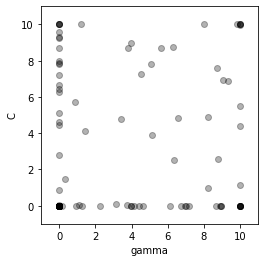

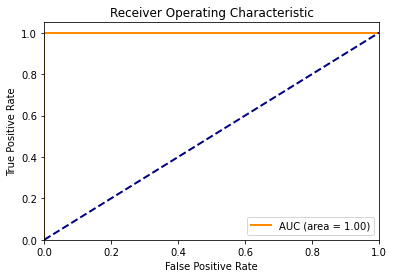

Accuracy for particle (in iteration 34, in fold 2) - 1 is 0.7586 At (gamma, c): [6.31509617 8.75544227]
Accuracy for particle (in iteration 34, in fold 2) - 2 is 0.8621 At (gamma, c): [ 1.19277133 10.        ]
Accuracy for particle (in iteration 34, in fold 2) - 3 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 34, in fold 2) - 4 is 0.7586 At (gamma, c): [ 8.02164891 10.        ]
Accuracy for particle (in iteration 34, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 34, in fold 2) - 6 is 0.7586 At (gamma, c): [ 9.84085323 10.        ]
Accuracy for particle (in iteration 34, in fold 2) - 7 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 34, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 34, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 34, in fold 2) - 10 is 0.4483 At (gamma, c): [6.12088696e+00 1.00000

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 34, in fold 2) - 89 is 0.4483 At (gamma, c): [7.19384092e+00 1.00000000e-03]
Accuracy for particle (in iteration 34, in fold 2) - 90 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 34, in fold 2) - 91 is 0.4483 At (gamma, c): [1.27275148e+00 1.00000000e-03]
Accuracy for particle (in iteration 34, in fold 2) - 92 is 0.7586 At (gamma, c): [10.          1.16108124]
Accuracy for particle (in iteration 34, in fold 2) - 93 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 34, in fold 2) - 94 is 0.7586 At (gamma, c): [5.64979165 8.71483012]
Accuracy for particle (in iteration 34, in fold 2) - 95 is 0.4483 At (gamma, c): [6.74381628e+00 1.00000000e-03]
Accuracy for particle (in iteration 34, in fold 2) - 96 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 34, in fold 2) - 97 is 0.7586 At (gamma, c): [3.41104439 4.76046229]
Accuracy for particle (in iteration 34, in fold 2) - 98 i

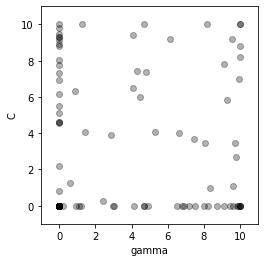

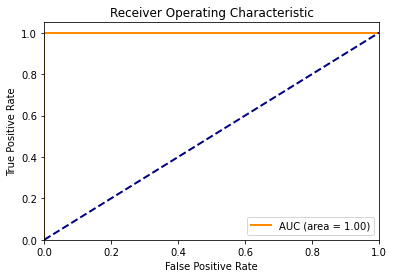

Accuracy for particle (in iteration 35, in fold 2) - 1 is 0.7586 At (gamma, c): [6.13794184 9.17701042]
Accuracy for particle (in iteration 35, in fold 2) - 2 is 0.8621 At (gamma, c): [ 1.27482915 10.        ]
Accuracy for particle (in iteration 35, in fold 2) - 3 is 0.4483 At (gamma, c): [6.88745879e+00 1.00000000e-03]
Accuracy for particle (in iteration 35, in fold 2) - 4 is 0.7586 At (gamma, c): [4.46752933 5.97323299]
Accuracy for particle (in iteration 35, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 35, in fold 2) - 6 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 35, in fold 2) - 7 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 35, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 35, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 35, in fold 2) - 10 is 0.4483 At (gamma, c): [9.57334827e+00 1.0000000

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 35, in fold 2) - 98 is 0.4483 At (gamma, c): [6.53152908e+00 1.00000000e-03]
Accuracy for particle (in iteration 35, in fold 2) - 99 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 35, in fold 2) - 100 is 0.4483 At (gamma, c): [9.81296124e+00 1.00000000e-03]
The best position in iteration 35, fold 2 is [1.00000000e-03 7.95624204e+00], with Accuracy: 1.0000
Accuracy Score: 0.8966
F1 Score: 0.8966
Recall Score: 0.8125
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 3 13]]
Confusion Matrix (Train):
[[124   6]
 [ 28  99]]

Iteration 36 - Fold 2:



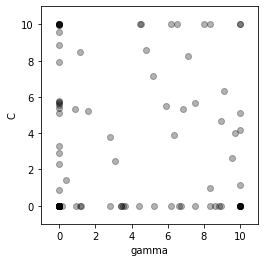

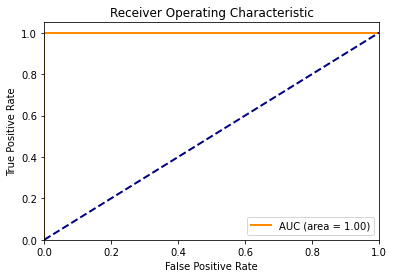

Accuracy for particle (in iteration 36, in fold 2) - 1 is 0.7586 At (gamma, c): [ 8.34637387 10.        ]
Accuracy for particle (in iteration 36, in fold 2) - 2 is 0.8966 At (gamma, c): [1.14278455 8.45740211]
Accuracy for particle (in iteration 36, in fold 2) - 3 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 36, in fold 2) - 4 is 0.7586 At (gamma, c): [5.19117258 7.13306501]
Accuracy for particle (in iteration 36, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 36, in fold 2) - 6 is 0.7586 At (gamma, c): [7.09163108 8.28179379]
Accuracy for particle (in iteration 36, in fold 2) - 7 is 0.4483 At (gamma, c): [8.81068368e+00 1.00000000e-03]
Accuracy for particle (in iteration 36, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 36, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 36, in fold 2) - 10 is 0.4483 At (gamma, c): [1.e+01 1.e

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 36, in fold 2) - 98 is 0.4483 At (gamma, c): [6.20300531e+00 1.00000000e-03]
Accuracy for particle (in iteration 36, in fold 2) - 99 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 36, in fold 2) - 100 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 36, fold 2 is [1.00000000e-03 9.43734067e+00], with Accuracy: 1.0000
Accuracy Score: 0.8966
F1 Score: 0.8966
Recall Score: 0.8125
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 3 13]]
Confusion Matrix (Train):
[[124   6]
 [ 21 106]]

Iteration 37 - Fold 2:



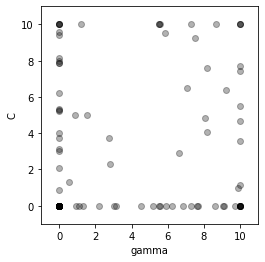

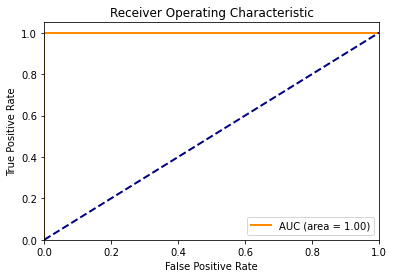

Accuracy for particle (in iteration 37, in fold 2) - 1 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 37, in fold 2) - 2 is 0.8621 At (gamma, c): [ 1.18661923 10.        ]
Accuracy for particle (in iteration 37, in fold 2) - 3 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 37, in fold 2) - 4 is 0.7586 At (gamma, c): [ 7.29358576 10.        ]
Accuracy for particle (in iteration 37, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 37, in fold 2) - 6 is 0.7586 At (gamma, c): [7.47570065 9.26840391]
Accuracy for particle (in iteration 37, in fold 2) - 7 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 37, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 37, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 37, in fold 2) - 10 is 0.4483 At (gamma, c): [9.69545761e+00 1.00000000e-03]
Accurac

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 37, in fold 2) - 96 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 37, in fold 2) - 97 is 0.7586 At (gamma, c): [2.76561305 3.75379471]
Accuracy for particle (in iteration 37, in fold 2) - 98 is 0.4483 At (gamma, c): [7.28926817e+00 1.00000000e-03]
Accuracy for particle (in iteration 37, in fold 2) - 99 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 37, in fold 2) - 100 is 0.4483 At (gamma, c): [7.61204103e+00 1.00000000e-03]
The best position in iteration 37, fold 2 is [0.04529094 6.55035212], with Accuracy: 1.0000
Accuracy Score: 0.8966
F1 Score: 0.8966
Recall Score: 0.8125
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 3 13]]
Confusion Matrix (Train):
[[124   6]
 [ 20 107]]

Iteration 38 - Fold 2:



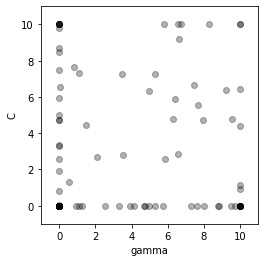

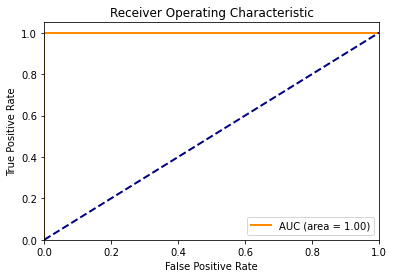

Accuracy for particle (in iteration 38, in fold 2) - 1 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 38, in fold 2) - 2 is 0.8966 At (gamma, c): [1.10172035 7.30039518]
Accuracy for particle (in iteration 38, in fold 2) - 3 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 38, in fold 2) - 4 is 0.7586 At (gamma, c): [6.62563761 9.17242316]
Accuracy for particle (in iteration 38, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 38, in fold 2) - 6 is 0.7586 At (gamma, c): [4.96412321 6.31731763]
Accuracy for particle (in iteration 38, in fold 2) - 7 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 38, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 38, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 38, in fold 2) - 10 is 0.4483 At (gamma, c): [8.00539221e+00 1.00000000e-03]
Accuracy fo

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 38, in fold 2) - 97 is 0.7931 At (gamma, c): [2.08056965 2.68534493]
Accuracy for particle (in iteration 38, in fold 2) - 98 is 0.4483 At (gamma, c): [7.58840143e+00 1.00000000e-03]
Accuracy for particle (in iteration 38, in fold 2) - 99 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 38, in fold 2) - 100 is 0.4483 At (gamma, c): [7.30274702e+00 1.00000000e-03]
The best position in iteration 38, fold 2 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8966
F1 Score: 0.8966
Recall Score: 0.8125
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 3 13]]
Confusion Matrix (Train):
[[124   6]
 [ 20 107]]

Iteration 39 - Fold 2:



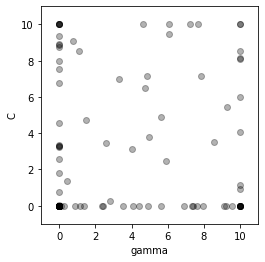

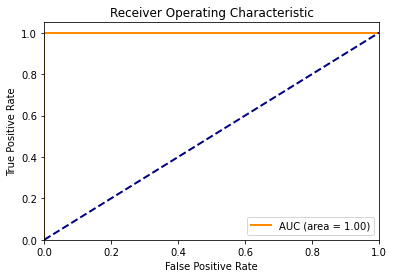

Accuracy for particle (in iteration 39, in fold 2) - 1 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 39, in fold 2) - 2 is 0.8966 At (gamma, c): [1.11710261 8.51190308]
Accuracy for particle (in iteration 39, in fold 2) - 3 is 0.4483 At (gamma, c): [9.52510565e+00 1.00000000e-03]
Accuracy for particle (in iteration 39, in fold 2) - 4 is 0.7586 At (gamma, c): [4.73239394 6.49159149]
Accuracy for particle (in iteration 39, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 39, in fold 2) - 6 is 0.7586 At (gamma, c): [ 7.68228175 10.        ]
Accuracy for particle (in iteration 39, in fold 2) - 7 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 39, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 39, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 39, in fold 2) - 10 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 39, in fold 2) - 92 is 0.7586 At (gamma, c): [10.          1.13657445]
Accuracy for particle (in iteration 39, in fold 2) - 93 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 39, in fold 2) - 94 is 0.7586 At (gamma, c): [6.07129785 9.45105825]
Accuracy for particle (in iteration 39, in fold 2) - 95 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 39, in fold 2) - 96 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 39, in fold 2) - 97 is 0.7586 At (gamma, c): [2.59106606 3.48155693]
Accuracy for particle (in iteration 39, in fold 2) - 98 is 0.4483 At (gamma, c): [7.96252185e+00 1.00000000e-03]
Accuracy for particle (in iteration 39, in fold 2) - 99 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 39, in fold 2) - 100 is 0.4483 At (gamma, c): [9.11543724e+00 1.00000000e-03]
The best position in iteration 39, fold 2 is [1.00000000e-03 8.69374632e

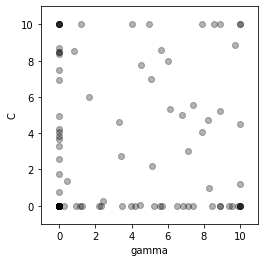

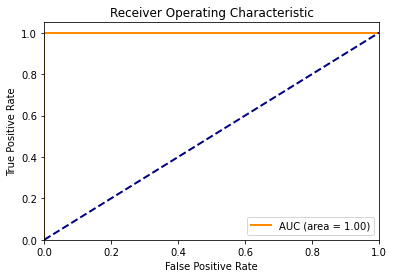

Accuracy for particle (in iteration 40, in fold 2) - 1 is 0.7586 At (gamma, c): [6.02379876 7.9848209 ]
Accuracy for particle (in iteration 40, in fold 2) - 2 is 0.8621 At (gamma, c): [ 1.18968201 10.        ]
Accuracy for particle (in iteration 40, in fold 2) - 3 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 40, in fold 2) - 4 is 0.7586 At (gamma, c): [5.05436997 6.98878942]
Accuracy for particle (in iteration 40, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 40, in fold 2) - 6 is 0.7586 At (gamma, c): [ 8.9056193 10.       ]
Accuracy for particle (in iteration 40, in fold 2) - 7 is 0.4483 At (gamma, c): [9.35354676e+00 1.00000000e-03]
Accuracy for particle (in iteration 40, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 40, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 40, in fold 2) - 10 is 0.4483 At (gamma, c): [5.69449957

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 40, in fold 2) - 96 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 40, in fold 2) - 97 is 0.7586 At (gamma, c): [3.31809399 4.61548924]
Accuracy for particle (in iteration 40, in fold 2) - 98 is 0.4483 At (gamma, c): [5.55571729e+00 1.00000000e-03]
Accuracy for particle (in iteration 40, in fold 2) - 99 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 40, in fold 2) - 100 is 0.4483 At (gamma, c): [6.83697881e+00 1.00000000e-03]
The best position in iteration 40, fold 2 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8966
F1 Score: 0.8966
Recall Score: 0.8125
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 3 13]]
Confusion Matrix (Train):
[[124   6]
 [ 20 107]]

Iteration 41 - Fold 2:



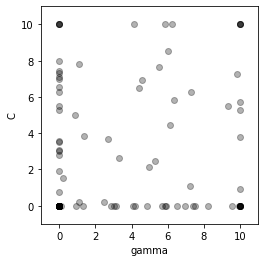

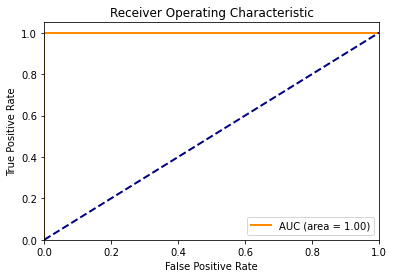

Accuracy for particle (in iteration 41, in fold 2) - 1 is 0.7586 At (gamma, c): [4.38553223 6.50511936]
Accuracy for particle (in iteration 41, in fold 2) - 2 is 0.8966 At (gamma, c): [1.1153579  7.84190479]
Accuracy for particle (in iteration 41, in fold 2) - 3 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 41, in fold 2) - 4 is 0.7586 At (gamma, c): [5.50935525 7.6702618 ]
Accuracy for particle (in iteration 41, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 41, in fold 2) - 6 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 41, in fold 2) - 7 is 0.4483 At (gamma, c): [8.1966458e+00 1.0000000e-03]
Accuracy for particle (in iteration 41, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 41, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 41, in fold 2) - 10 is 0.4483 At (gamma, c): [5.86884904e+00 1.00000000e-0

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 41, in fold 2) - 98 is 0.4483 At (gamma, c): [5.68006659e+00 1.00000000e-03]
Accuracy for particle (in iteration 41, in fold 2) - 99 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 41, in fold 2) - 100 is 0.4483 At (gamma, c): [7.4136355e+00 1.0000000e-03]
The best position in iteration 41, fold 2 is [0.10900903 6.2886692 ], with Accuracy: 1.0000
Accuracy Score: 0.8966
F1 Score: 0.8966
Recall Score: 0.8125
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 3 13]]
Confusion Matrix (Train):
[[124   6]
 [ 20 107]]

Iteration 42 - Fold 2:



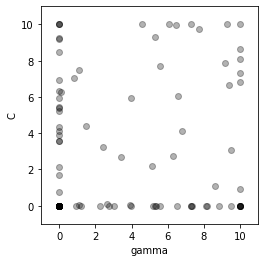

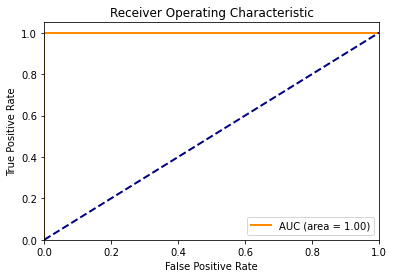

Accuracy for particle (in iteration 42, in fold 2) - 1 is 0.7586 At (gamma, c): [6.43116169 9.95009879]
Accuracy for particle (in iteration 42, in fold 2) - 2 is 0.8966 At (gamma, c): [1.10237941 7.51326312]
Accuracy for particle (in iteration 42, in fold 2) - 3 is 0.4483 At (gamma, c): [7.31959562e+00 1.00000000e-03]
Accuracy for particle (in iteration 42, in fold 2) - 4 is 0.7586 At (gamma, c): [5.54404474 7.72599552]
Accuracy for particle (in iteration 42, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 42, in fold 2) - 6 is 0.7586 At (gamma, c): [ 9.27253963 10.        ]
Accuracy for particle (in iteration 42, in fold 2) - 7 is 0.4483 At (gamma, c): [8.09457646e+00 1.00000000e-03]
Accuracy for particle (in iteration 42, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 42, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 42, in fold 2) - 10 is 0.4483 At (gamma,

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 42, in fold 2) - 96 is 0.4483 At (gamma, c): [8.17273165e+00 1.00000000e-03]
Accuracy for particle (in iteration 42, in fold 2) - 97 is 0.7931 At (gamma, c): [2.4224288  3.21853646]
Accuracy for particle (in iteration 42, in fold 2) - 98 is 0.4483 At (gamma, c): [5.20600196e+00 1.00000000e-03]
Accuracy for particle (in iteration 42, in fold 2) - 99 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 42, in fold 2) - 100 is 0.4483 At (gamma, c): [6.51543925e+00 1.00000000e-03]
The best position in iteration 42, fold 2 is [0.05834526 6.22404223], with Accuracy: 1.0000
Accuracy Score: 0.8966
F1 Score: 0.8966
Recall Score: 0.8125
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 3 13]]
Confusion Matrix (Train):
[[124   6]
 [ 28  99]]

Iteration 43 - Fold 2:



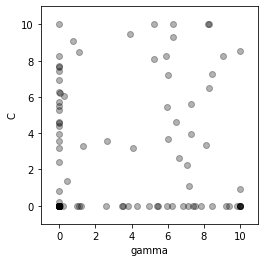

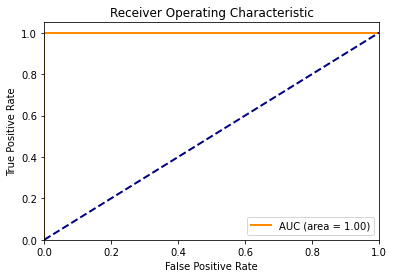

Accuracy for particle (in iteration 43, in fold 2) - 1 is 0.7586 At (gamma, c): [ 8.21518599 10.        ]
Accuracy for particle (in iteration 43, in fold 2) - 2 is 0.8966 At (gamma, c): [1.11582673 8.48143193]
Accuracy for particle (in iteration 43, in fold 2) - 3 is 0.4483 At (gamma, c): [7.38668869e+00 1.00000000e-03]
Accuracy for particle (in iteration 43, in fold 2) - 4 is 0.7586 At (gamma, c): [5.8869259  8.23566401]
Accuracy for particle (in iteration 43, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 43, in fold 2) - 6 is 0.7586 At (gamma, c): [5.99264769 7.20369525]
Accuracy for particle (in iteration 43, in fold 2) - 7 is 0.4483 At (gamma, c): [9.83192878e+00 1.00000000e-03]
Accuracy for particle (in iteration 43, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 43, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 43, in fold 2) - 10 is 0.4483 At (gamma,

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 43, in fold 2) - 95 is 0.4483 At (gamma, c): [7.08866907e+00 1.00000000e-03]
Accuracy for particle (in iteration 43, in fold 2) - 96 is 0.4483 At (gamma, c): [9.39725314e+00 1.00000000e-03]
Accuracy for particle (in iteration 43, in fold 2) - 97 is 0.7586 At (gamma, c): [2.63831016 3.55524271]
Accuracy for particle (in iteration 43, in fold 2) - 98 is 0.4483 At (gamma, c): [5.46962443e+00 1.00000000e-03]
Accuracy for particle (in iteration 43, in fold 2) - 99 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 43, in fold 2) - 100 is 0.4483 At (gamma, c): [7.48836121e+00 1.00000000e-03]
The best position in iteration 43, fold 2 is [1.0000000e-03 6.9075951e+00], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9677
Recall Score: 0.9375
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 1 15]]
Confusion Matrix (Train):
[[130   0]
 [  1 126]]

Iteration 44 - Fold 2:



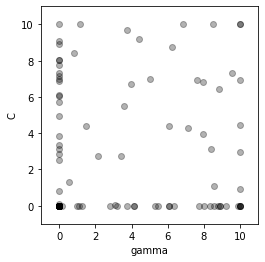

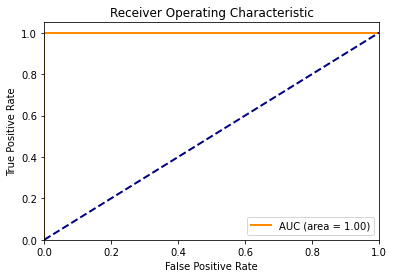

Accuracy for particle (in iteration 44, in fold 2) - 1 is 0.7586 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 44, in fold 2) - 2 is 0.8966 At (gamma, c): [ 1.15180334 10.        ]
Accuracy for particle (in iteration 44, in fold 2) - 3 is 0.4483 At (gamma, c): [9.86024444e+00 1.00000000e-03]
Accuracy for particle (in iteration 44, in fold 2) - 4 is 0.7586 At (gamma, c): [5.03049864 6.96875825]
Accuracy for particle (in iteration 44, in fold 2) - 5 is 0.4483 At (gamma, c): [0.01914146 0.001     ]
Accuracy for particle (in iteration 44, in fold 2) - 6 is 0.7586 At (gamma, c): [ 8.49565209 10.        ]
Accuracy for particle (in iteration 44, in fold 2) - 7 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 44, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 44, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 44, in fold 2) - 10 is 0.4483 At (gamma, c): [6.09358173e+

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 44, in fold 2) - 90 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 44, in fold 2) - 91 is 0.4483 At (gamma, c): [1.27289859e+00 1.00000000e-03]
Accuracy for particle (in iteration 44, in fold 2) - 92 is 0.7586 At (gamma, c): [8.53541137 1.07548235]
Accuracy for particle (in iteration 44, in fold 2) - 93 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 44, in fold 2) - 94 is 0.7586 At (gamma, c): [3.58559054 5.51201296]
Accuracy for particle (in iteration 44, in fold 2) - 95 is 0.4483 At (gamma, c): [8.89876824e+00 1.00000000e-03]
Accuracy for particle (in iteration 44, in fold 2) - 96 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 44, in fold 2) - 97 is 0.7931 At (gamma, c): [2.13375923 2.76830375]
Accuracy for particle (in iteration 44, in fold 2) - 98 is 0.4483 At (gamma, c): [6.35378359e+00 1.00000000e-03]
Accuracy for particle (in iteration 44, in fold 2) - 99 is 

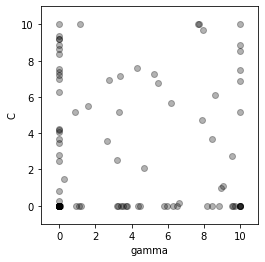

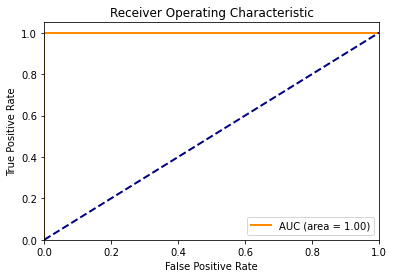

Accuracy for particle (in iteration 45, in fold 2) - 1 is 0.7586 At (gamma, c): [7.94259522 9.69199627]
Accuracy for particle (in iteration 45, in fold 2) - 2 is 0.8966 At (gamma, c): [ 1.15513757 10.        ]
Accuracy for particle (in iteration 45, in fold 2) - 3 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 45, in fold 2) - 4 is 0.7586 At (gamma, c): [5.24909224 7.29297992]
Accuracy for particle (in iteration 45, in fold 2) - 5 is 0.4483 At (gamma, c): [0.07480763 0.001     ]
Accuracy for particle (in iteration 45, in fold 2) - 6 is 0.7586 At (gamma, c): [5.44335409 6.76250249]
Accuracy for particle (in iteration 45, in fold 2) - 7 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 45, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 45, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 45, in fold 2) - 10 is 0.4483 At (gamma, c): [8.41539835e+00 1

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 45, in fold 2) - 94 is 0.7586 At (gamma, c): [3.33019815 5.19570648]
Accuracy for particle (in iteration 45, in fold 2) - 95 is 0.4483 At (gamma, c): [8.84325853e+00 1.00000000e-03]
Accuracy for particle (in iteration 45, in fold 2) - 96 is 0.4483 At (gamma, c): [6.59121139 0.13445035]
Accuracy for particle (in iteration 45, in fold 2) - 97 is 0.7586 At (gamma, c): [2.66260804 3.59313966]
Accuracy for particle (in iteration 45, in fold 2) - 98 is 0.4483 At (gamma, c): [4.44264588e+00 1.00000000e-03]
Accuracy for particle (in iteration 45, in fold 2) - 99 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 45, in fold 2) - 100 is 0.4483 At (gamma, c): [6.51715309e+00 1.00000000e-03]
The best position in iteration 45, fold 2 is [1.000000e-03 8.419276e+00], with Accuracy: 1.0000
Accuracy Score: 0.9310
F1 Score: 0.9333
Recall Score: 0.8750
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 2 14]]
Confusion Matrix (Train):

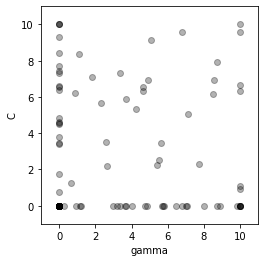

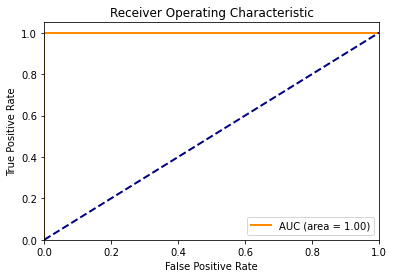

Accuracy for particle (in iteration 46, in fold 2) - 1 is 0.7586 At (gamma, c): [4.90806635 6.95627979]
Accuracy for particle (in iteration 46, in fold 2) - 2 is 0.8966 At (gamma, c): [1.11873524 8.37875969]
Accuracy for particle (in iteration 46, in fold 2) - 3 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 46, in fold 2) - 4 is 0.7586 At (gamma, c): [4.61103454 6.34825133]
Accuracy for particle (in iteration 46, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 46, in fold 2) - 6 is 0.7586 At (gamma, c): [4.22239536 5.33890944]
Accuracy for particle (in iteration 46, in fold 2) - 7 is 0.4483 At (gamma, c): [9.84368555e+00 1.00000000e-03]
Accuracy for particle (in iteration 46, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 46, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 46, in fold 2) - 10 is 0.4483 At (gamma, c): [8.68928103e+

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 46, in fold 2) - 96 is 0.4483 At (gamma, c): [7.05952116e+00 1.00000000e-03]
Accuracy for particle (in iteration 46, in fold 2) - 97 is 0.7586 At (gamma, c): [2.61015877 3.5113355 ]
Accuracy for particle (in iteration 46, in fold 2) - 98 is 0.4483 At (gamma, c): [5.78909557e+00 1.00000000e-03]
Accuracy for particle (in iteration 46, in fold 2) - 99 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 46, in fold 2) - 100 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 46, fold 2 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8966
F1 Score: 0.8966
Recall Score: 0.8125
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 3 13]]
Confusion Matrix (Train):
[[124   6]
 [ 28  99]]

Iteration 47 - Fold 2:



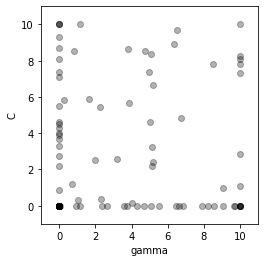

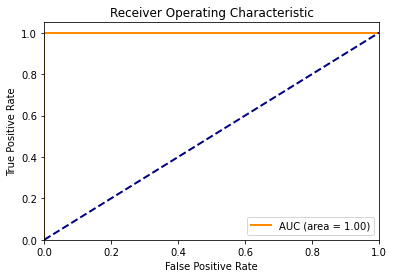

Accuracy for particle (in iteration 47, in fold 2) - 1 is 0.7586 At (gamma, c): [4.96102126 7.39625326]
Accuracy for particle (in iteration 47, in fold 2) - 2 is 0.8966 At (gamma, c): [ 1.16474873 10.        ]
Accuracy for particle (in iteration 47, in fold 2) - 3 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 47, in fold 2) - 4 is 0.7586 At (gamma, c): [6.34665238 8.91895144]
Accuracy for particle (in iteration 47, in fold 2) - 5 is 0.4483 At (gamma, c): [0.05064224 0.001     ]
Accuracy for particle (in iteration 47, in fold 2) - 6 is 0.7586 At (gamma, c): [5.19373006 6.6733261 ]
Accuracy for particle (in iteration 47, in fold 2) - 7 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 47, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 47, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 47, in fold 2) - 10 is 0.4483 At (gamma, c): [5.09278249e+00 1

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 47, in fold 2) - 97 is 0.8276 At (gamma, c): [1.96685759 2.50799029]
Accuracy for particle (in iteration 47, in fold 2) - 98 is 0.4483 At (gamma, c): [6.47616689e+00 1.00000000e-03]
Accuracy for particle (in iteration 47, in fold 2) - 99 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 47, in fold 2) - 100 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 47, fold 2 is [0.23180063 5.55303242], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9677
Recall Score: 0.9375
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 1 15]]
Confusion Matrix (Train):
[[130   0]
 [  1 126]]

Iteration 48 - Fold 2:



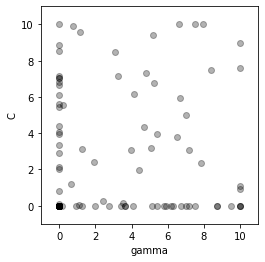

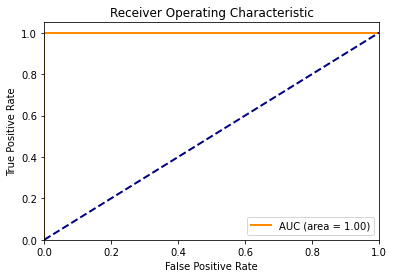

Accuracy for particle (in iteration 48, in fold 2) - 1 is 0.7586 At (gamma, c): [4.1244037  6.17523253]
Accuracy for particle (in iteration 48, in fold 2) - 2 is 0.8966 At (gamma, c): [1.1446565  9.58994291]
Accuracy for particle (in iteration 48, in fold 2) - 3 is 0.4483 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 48, in fold 2) - 4 is 0.7586 At (gamma, c): [ 7.5190608 10.       ]
Accuracy for particle (in iteration 48, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 48, in fold 2) - 6 is 0.7586 At (gamma, c): [5.24513861 6.75264983]
Accuracy for particle (in iteration 48, in fold 2) - 7 is 0.4483 At (gamma, c): [8.70115844e+00 1.00000000e-03]
Accuracy for particle (in iteration 48, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 48, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 48, in fold 2) - 10 is 0.4483 At (gamma, c): [6.98663412e+

Accuracy for particle (in iteration 48, in fold 2) - 80 is 0.7586 At (gamma, c): [5.1785574  9.42425874]
Accuracy for particle (in iteration 48, in fold 2) - 81 is 0.4483 At (gamma, c): [8.73686299e+00 1.00000000e-03]
Accuracy for particle (in iteration 48, in fold 2) - 82 is 0.8276 At (gamma, c): [1.29260888 3.15212647]
Accuracy for particle (in iteration 48, in fold 2) - 83 is 0.4483 At (gamma, c): [4.08856016e+00 1.00000000e-03]
Accuracy for particle (in iteration 48, in fold 2) - 84 is 0.8966 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 48, in fold 2) - 85 is 0.4483 At (gamma, c): [3.62380947e+00 1.00000000e-03]
Accuracy for particle (in iteration 48, in fold 2) - 86 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 48, in fold 2) - 87 is 0.7586 At (gamma, c): [6.66542483 5.93793449]
Accuracy for particle (in iteration 48, in fold 2) - 88 is 0.7586 At (gamma, c): [8.35855341 7.50690352]
Accuracy for particle (in iteration 48, in fold 2

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 48, in fold 2) - 98 is 0.4483 At (gamma, c): [5.10228148e+00 1.00000000e-03]
Accuracy for particle (in iteration 48, in fold 2) - 99 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 48, in fold 2) - 100 is 0.4483 At (gamma, c): [9.50231272e+00 1.00000000e-03]
The best position in iteration 48, fold 2 is [0.26044189 5.07423222], with Accuracy: 1.0000
Accuracy Score: 0.8966
F1 Score: 0.8966
Recall Score: 0.8125
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 3 13]]
Confusion Matrix (Train):
[[124   6]
 [ 28  99]]

Iteration 49 - Fold 2:



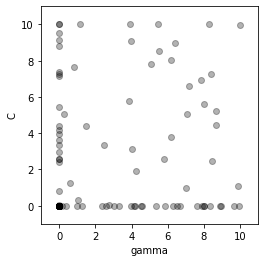

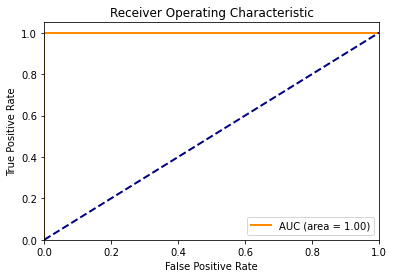

Accuracy for particle (in iteration 49, in fold 2) - 1 is 0.7586 At (gamma, c): [3.8560456  5.75895219]
Accuracy for particle (in iteration 49, in fold 2) - 2 is 0.8966 At (gamma, c): [ 1.15673285 10.        ]
Accuracy for particle (in iteration 49, in fold 2) - 3 is 0.4483 At (gamma, c): [7.98875177e+00 1.00000000e-03]
Accuracy for particle (in iteration 49, in fold 2) - 4 is 0.7586 At (gamma, c): [ 8.24991172 10.        ]
Accuracy for particle (in iteration 49, in fold 2) - 5 is 0.4483 At (gamma, c): [0.15915043 0.001     ]
Accuracy for particle (in iteration 49, in fold 2) - 6 is 0.7586 At (gamma, c): [6.18332779 8.02782558]
Accuracy for particle (in iteration 49, in fold 2) - 7 is 0.4483 At (gamma, c): [9.92828642e+00 1.00000000e-03]
Accuracy for particle (in iteration 49, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 49, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 49, in fold 2) - 10 is 0.448

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 49, in fold 2) - 96 is 0.4483 At (gamma, c): [8.90670125e+00 1.00000000e-03]
Accuracy for particle (in iteration 49, in fold 2) - 97 is 0.7931 At (gamma, c): [2.50675292 3.35005526]
Accuracy for particle (in iteration 49, in fold 2) - 98 is 0.4483 At (gamma, c): [4.15247993e+00 1.00000000e-03]
Accuracy for particle (in iteration 49, in fold 2) - 99 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 49, in fold 2) - 100 is 0.4483 At (gamma, c): [7.8634584e+00 1.0000000e-03]
The best position in iteration 49, fold 2 is [1.00000000e-03 7.88987181e+00], with Accuracy: 1.0000
Accuracy Score: 0.8966
F1 Score: 0.8966
Recall Score: 0.8125
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 3 13]]
Confusion Matrix (Train):
[[124   6]
 [ 25 102]]

Iteration 50 - Fold 2:



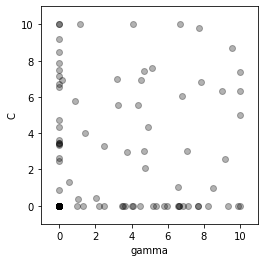

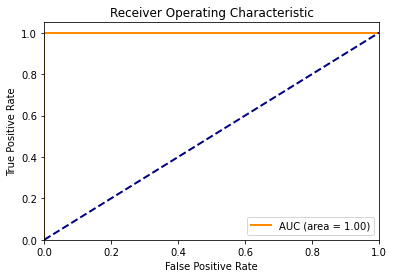

Accuracy for particle (in iteration 50, in fold 2) - 1 is 0.7586 At (gamma, c): [4.54487831 6.91146564]
Accuracy for particle (in iteration 50, in fold 2) - 2 is 0.8966 At (gamma, c): [ 1.17510007 10.        ]
Accuracy for particle (in iteration 50, in fold 2) - 3 is 0.4483 At (gamma, c): [8.22339945e+00 1.00000000e-03]
Accuracy for particle (in iteration 50, in fold 2) - 4 is 0.7586 At (gamma, c): [7.74941899 9.82866383]
Accuracy for particle (in iteration 50, in fold 2) - 5 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 50, in fold 2) - 6 is 0.7586 At (gamma, c): [4.34024181 5.53081703]
Accuracy for particle (in iteration 50, in fold 2) - 7 is 0.4483 At (gamma, c): [7.66899218e+00 1.00000000e-03]
Accuracy for particle (in iteration 50, in fold 2) - 8 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 50, in fold 2) - 9 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 50, in fold 2) - 10 is 0.4483 At (gamma,

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 50, in fold 2) - 96 is 0.4483 At (gamma, c): [9.30393589e+00 1.00000000e-03]
Accuracy for particle (in iteration 50, in fold 2) - 97 is 0.7931 At (gamma, c): [2.48726645 3.31966256]
Accuracy for particle (in iteration 50, in fold 2) - 98 is 0.4483 At (gamma, c): [4.02342369e+00 1.00000000e-03]
Accuracy for particle (in iteration 50, in fold 2) - 99 is 0.4483 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 50, in fold 2) - 100 is 0.4483 At (gamma, c): [7.09015655e+00 1.00000000e-03]
The best position in iteration 50, fold 2 is [0.11222881 6.23555089], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9677
Recall Score: 0.9375
Precision Score: 1.0000
Confusion Matrix (Test):
[[13  0]
 [ 1 15]]
Confusion Matrix (Train):
[[130   0]
 [  1 126]]


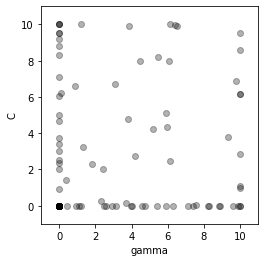

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.



Iteration 1 - Fold 3:



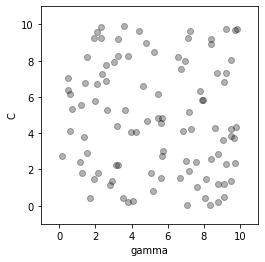

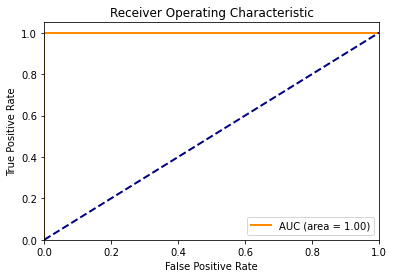

Accuracy for particle (in iteration 1, in fold 3) - 1 is 0.9310 At (gamma, c): [3.58669287 9.92221795]
Accuracy for particle (in iteration 1, in fold 3) - 2 is 0.6207 At (gamma, c): [3.54769397 0.43874714]
Accuracy for particle (in iteration 1, in fold 3) - 3 is 0.9310 At (gamma, c): [4.26029648 4.0683886 ]
Accuracy for particle (in iteration 1, in fold 3) - 4 is 1.0000 At (gamma, c): [0.51848264 7.069395  ]
Accuracy for particle (in iteration 1, in fold 3) - 5 is 0.6207 At (gamma, c): [1.72999485 0.40538315]
Accuracy for particle (in iteration 1, in fold 3) - 6 is 0.8966 At (gamma, c): [5.15919772 0.83672801]
Accuracy for particle (in iteration 1, in fold 3) - 7 is 0.8966 At (gamma, c): [8.76019171 1.19563646]
Accuracy for particle (in iteration 1, in fold 3) - 8 is 0.9655 At (gamma, c): [1.13838283 2.41617152]
Accuracy for particle (in iteration 1, in fold 3) - 9 is 1.0000 At (gamma, c): [0.6171329  4.12261301]
Accuracy for particle (in iteration 1, in fold 3) - 10 is 0.8966 At (gamm

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 1, in fold 3) - 96 is 0.8966 At (gamma, c): [8.40948417 8.90101798]
Accuracy for particle (in iteration 1, in fold 3) - 97 is 0.9310 At (gamma, c): [5.05664555 1.8290501 ]
Accuracy for particle (in iteration 1, in fold 3) - 98 is 0.8966 At (gamma, c): [9.20162942 9.72657284]
Accuracy for particle (in iteration 1, in fold 3) - 99 is 0.8966 At (gamma, c): [9.09165945 1.17890714]
Accuracy for particle (in iteration 1, in fold 3) - 100 is 0.8966 At (gamma, c): [9.51500125 4.24711352]
The best position in iteration 1, fold 3 is [1.000000e-03 5.507262e+00], with Accuracy: 1.0000
Accuracy Score: 0.9310
F1 Score: 0.9333
Recall Score: 1.0000
Precision Score: 0.8750
Confusion Matrix (Test):
[[13  2]
 [ 0 14]]
Confusion Matrix (Train):
[[128   0]
 [  0 129]]

Iteration 2 - Fold 3:



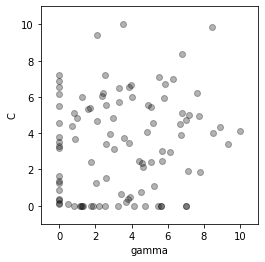

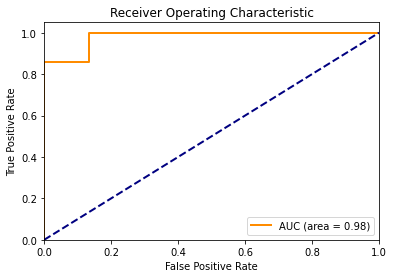

Accuracy for particle (in iteration 2, in fold 3) - 1 is 0.9310 At (gamma, c): [5.22711859 1.09343245]
Accuracy for particle (in iteration 2, in fold 3) - 2 is 0.8276 At (gamma, c): [0.48505125 0.11544533]
Accuracy for particle (in iteration 2, in fold 3) - 3 is 0.9310 At (gamma, c): [4.82581812 4.08471538]
Accuracy for particle (in iteration 2, in fold 3) - 4 is 0.8276 At (gamma, c): [1.000000e-03 5.507262e+00]
Accuracy for particle (in iteration 2, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001     0.2875155]
Accuracy for particle (in iteration 2, in fold 3) - 6 is 0.8966 At (gamma, c): [7.70762657 4.94209484]
Accuracy for particle (in iteration 2, in fold 3) - 7 is 0.9310 At (gamma, c): [4.43454835 2.47576943]
Accuracy for particle (in iteration 2, in fold 3) - 8 is 0.7586 At (gamma, c): [1.00000000e-03 1.36914221e+00]
Accuracy for particle (in iteration 2, in fold 3) - 9 is 0.7586 At (gamma, c): [1.00000000e-03 3.20684518e+00]
Accuracy for particle (in iteration 2, in fold 3) - 10 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 2, in fold 3) - 98 is 0.9310 At (gamma, c): [5.05676725 5.46505135]
Accuracy for particle (in iteration 2, in fold 3) - 99 is 0.9310 At (gamma, c): [4.61097038 2.15449228]
Accuracy for particle (in iteration 2, in fold 3) - 100 is 0.8966 At (gamma, c): [10.          4.13124039]
The best position in iteration 2, fold 3 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8276
F1 Score: 0.7826
Recall Score: 0.6429
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 5  9]]
Confusion Matrix (Train):
[[122   6]
 [ 32  97]]

Iteration 3 - Fold 3:



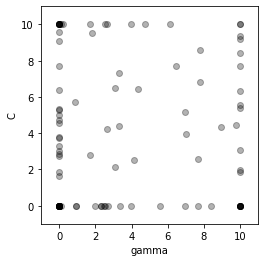

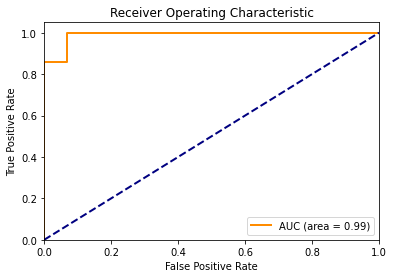

Accuracy for particle (in iteration 3, in fold 3) - 1 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 3, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 3, in fold 3) - 3 is 0.8966 At (gamma, c): [6.92574331 5.16104283]
Accuracy for particle (in iteration 3, in fold 3) - 4 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 3, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 3, in fold 3) - 6 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 3, in fold 3) - 7 is 0.8276 At (gamma, c): [1.00000000e-03 5.35896908e+00]
Accuracy for particle (in iteration 3, in fold 3) - 8 is 0.7931 At (gamma, c): [1.00000000e-03 1.62269943e+00]
Accuracy for particle (in iteration 3, in fold 3) - 9 is 0.7586 At (gamma, c): [1.00000000e-03 2.85914941e+00]
Accuracy for particle (in iteration 3, in fold 3) - 10 is 0.7586 At (gamma, c): [1.00000000e-03 1.8

Accuracy for particle (in iteration 3, in fold 3) - 81 is 0.4828 At (gamma, c): [0.90948536 0.001     ]
Accuracy for particle (in iteration 3, in fold 3) - 82 is 0.8966 At (gamma, c): [10.          9.19329838]
Accuracy for particle (in iteration 3, in fold 3) - 83 is 0.7931 At (gamma, c): [1.00000000e-03 3.80871214e+00]
Accuracy for particle (in iteration 3, in fold 3) - 84 is 0.8966 At (gamma, c): [ 6.11841337 10.        ]
Accuracy for particle (in iteration 3, in fold 3) - 85 is 1.0000 At (gamma, c): [0.90145762 5.73935559]
Accuracy for particle (in iteration 3, in fold 3) - 86 is 0.8966 At (gamma, c): [10.          5.55988227]
Accuracy for particle (in iteration 3, in fold 3) - 87 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 3, in fold 3) - 88 is 0.7931 At (gamma, c): [1.00000000e-03 4.54481632e+00]
Accuracy for particle (in iteration 3, in fold 3) - 89 is 0.4828 At (gamma, c): [2.29051987e+00 1.00000000e-03]
Accuracy for particle (in iteration 3, in 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


The best position in iteration 3, fold 3 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8621
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 4 10]]
Confusion Matrix (Train):
[[122   6]
 [ 23 106]]

Iteration 4 - Fold 3:



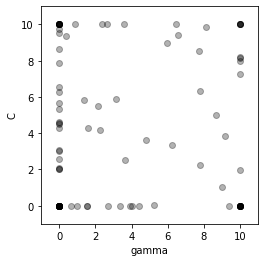

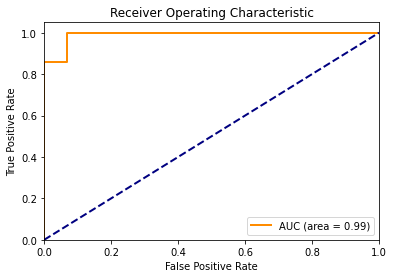

Accuracy for particle (in iteration 4, in fold 3) - 1 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 4, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 4, in fold 3) - 3 is 0.8966 At (gamma, c): [10.          8.16652576]
Accuracy for particle (in iteration 4, in fold 3) - 4 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 4, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 4, in fold 3) - 6 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 4, in fold 3) - 7 is 0.8276 At (gamma, c): [1.00000000e-03 6.26428096e+00]
Accuracy for particle (in iteration 4, in fold 3) - 8 is 0.7931 At (gamma, c): [1.00000000e-03 2.00152741e+00]
Accuracy for particle (in iteration 4, in fold 3) - 9 is 0.7931 At (gamma, c): [1.00000000e-03 2.03799701e+00]
Accuracy for particle (in iteration 4, in fold 3) - 10 is 0.7931 At (gamma, c): [1.00000000e-03 2

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 4, in fold 3) - 99 is 0.9310 At (gamma, c): [2.16271251 5.51189459]
Accuracy for particle (in iteration 4, in fold 3) - 100 is 0.8966 At (gamma, c): [9.0061955  1.00919984]
The best position in iteration 4, fold 3 is [1.00000000e-03 9.04428289e+00], with Accuracy: 1.0000
Accuracy Score: 0.8621
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 4 10]]
Confusion Matrix (Train):
[[122   6]
 [ 23 106]]

Iteration 5 - Fold 3:



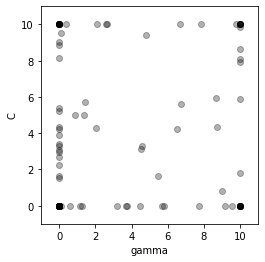

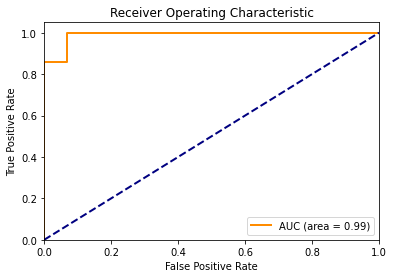

Accuracy for particle (in iteration 5, in fold 3) - 1 is 0.4828 At (gamma, c): [9.55173406e+00 1.00000000e-03]
Accuracy for particle (in iteration 5, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 5, in fold 3) - 3 is 0.8966 At (gamma, c): [10.          9.88498876]
Accuracy for particle (in iteration 5, in fold 3) - 4 is 0.8621 At (gamma, c): [1.00000000e-03 9.04428289e+00]
Accuracy for particle (in iteration 5, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 5, in fold 3) - 6 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 5, in fold 3) - 7 is 0.8276 At (gamma, c): [1.00000000e-03 5.20066715e+00]
Accuracy for particle (in iteration 5, in fold 3) - 8 is 0.7586 At (gamma, c): [1.00000000e-03 1.53568405e+00]
Accuracy for particle (in iteration 5, in fold 3) - 9 is 0.7931 At (gamma, c): [1.00000000e-03 2.23513098e+00]
Accuracy for particle (in iteration 5, in fold 3) - 10 is 0.7931 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 5, in fold 3) - 97 is 0.9310 At (gamma, c): [1.35892916 4.97918002]
Accuracy for particle (in iteration 5, in fold 3) - 98 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 5, in fold 3) - 99 is 0.9310 At (gamma, c): [1.40481838 5.6975546 ]
Accuracy for particle (in iteration 5, in fold 3) - 100 is 0.8966 At (gamma, c): [8.96600726 0.7832361 ]
The best position in iteration 5, fold 3 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8621
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 4 10]]
Confusion Matrix (Train):
[[122   6]
 [ 27 102]]

Iteration 6 - Fold 3:



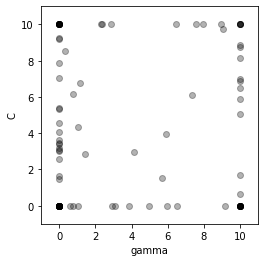

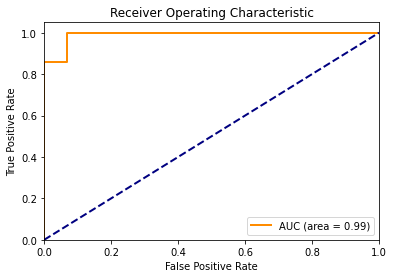

Accuracy for particle (in iteration 6, in fold 3) - 1 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 6, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 6, in fold 3) - 3 is 0.8966 At (gamma, c): [10.          8.76644562]
Accuracy for particle (in iteration 6, in fold 3) - 4 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 6, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 6, in fold 3) - 6 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 6, in fold 3) - 7 is 0.8276 At (gamma, c): [1.00000000e-03 5.31973015e+00]
Accuracy for particle (in iteration 6, in fold 3) - 8 is 0.7586 At (gamma, c): [1.00000000e-03 1.47733238e+00]
Accuracy for particle (in iteration 6, in fold 3) - 9 is 0.7586 At (gamma, c): [1.00000000e-03 2.58678118e+00]
Accuracy for particle (in iteration 6, in fold 3) - 10 is 0.7931 At (gamma, c): [1.00000000e-03 1

Accuracy for particle (in iteration 6, in fold 3) - 99 is 0.9655 At (gamma, c): [1.13015243 6.74701538]
Accuracy for particle (in iteration 6, in fold 3) - 100 is 0.8966 At (gamma, c): [10.          0.64310719]
The best position in iteration 6, fold 3 is [1.00000000e-03 9.24751247e+00], with Accuracy: 1.0000
Accuracy Score: 0.8621
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 4 10]]
Confusion Matrix (Train):
[[122   6]
 [ 23 106]]

Iteration 7 - Fold 3:



*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


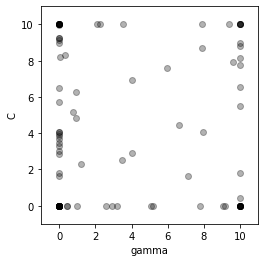

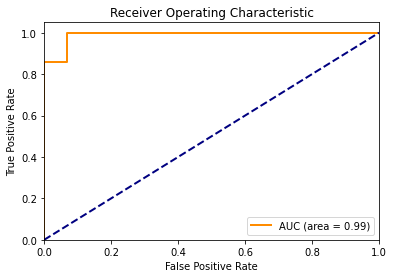

Accuracy for particle (in iteration 7, in fold 3) - 1 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 7, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 7, in fold 3) - 3 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 7, in fold 3) - 4 is 0.8621 At (gamma, c): [1.00000000e-03 9.24751247e+00]
Accuracy for particle (in iteration 7, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 7, in fold 3) - 6 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 7, in fold 3) - 7 is 0.8276 At (gamma, c): [1.00000000e-03 6.49645531e+00]
Accuracy for particle (in iteration 7, in fold 3) - 8 is 0.7586 At (gamma, c): [1.00000000e-03 1.79588224e+00]
Accuracy for particle (in iteration 7, in fold 3) - 9 is 0.7931 At (gamma, c): [1.00000000e-03 2.84359271e+00]
Accuracy for particle (in iteration 7, in fold 3) - 10 is 0.7931 At (gamma, c): [1.00000000e-03 1

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 7, in fold 3) - 96 is 0.8966 At (gamma, c): [10.          7.74402509]
Accuracy for particle (in iteration 7, in fold 3) - 97 is 1.0000 At (gamma, c): [0.92985704 4.81363156]
Accuracy for particle (in iteration 7, in fold 3) - 98 is 0.8966 At (gamma, c): [7.90849739 8.72909283]
Accuracy for particle (in iteration 7, in fold 3) - 99 is 1.0000 At (gamma, c): [0.91693098 6.29616509]
Accuracy for particle (in iteration 7, in fold 3) - 100 is 0.5862 At (gamma, c): [10.          0.44695094]
The best position in iteration 7, fold 3 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8621
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 4 10]]
Confusion Matrix (Train):
[[122   6]
 [ 27 102]]

Iteration 8 - Fold 3:



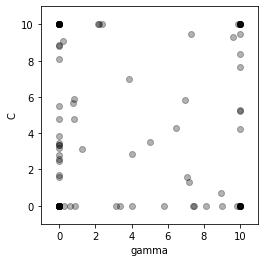

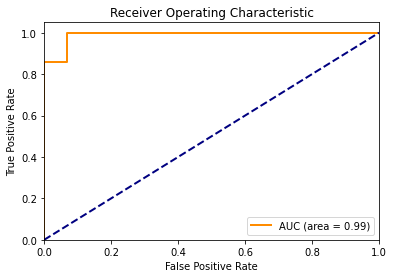

Accuracy for particle (in iteration 8, in fold 3) - 1 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 8, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 8, in fold 3) - 3 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 8, in fold 3) - 4 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 8, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 8, in fold 3) - 6 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 8, in fold 3) - 7 is 0.8621 At (gamma, c): [1.00000000e-03 8.83454247e+00]
Accuracy for particle (in iteration 8, in fold 3) - 8 is 0.7931 At (gamma, c): [1.00000000e-03 1.69242203e+00]
Accuracy for particle (in iteration 8, in fold 3) - 9 is 0.7586 At (gamma, c): [1.00000000e-03 3.32659997e+00]
Accuracy for particle (in iteration 8, in fold 3) - 10 is 0.7931 At (gamma, c): [1.00000000e-03 1.55803204e+00]
A

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 8, in fold 3) - 97 is 1.0000 At (gamma, c): [0.84585789 4.76019058]
Accuracy for particle (in iteration 8, in fold 3) - 98 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 8, in fold 3) - 99 is 1.0000 At (gamma, c): [0.81686402 5.88026419]
Accuracy for particle (in iteration 8, in fold 3) - 100 is 0.8966 At (gamma, c): [8.95027317 0.71167245]
The best position in iteration 8, fold 3 is [1.00000000e-03 9.36296109e+00], with Accuracy: 1.0000
Accuracy Score: 0.8621
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 4 10]]
Confusion Matrix (Train):
[[122   6]
 [ 23 106]]

Iteration 9 - Fold 3:



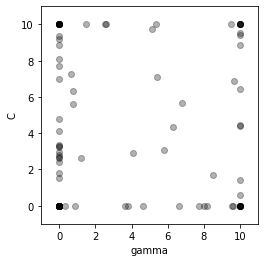

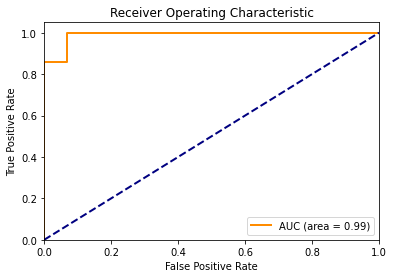

Accuracy for particle (in iteration 9, in fold 3) - 1 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 9, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 9, in fold 3) - 3 is 0.8966 At (gamma, c): [10.          9.50870301]
Accuracy for particle (in iteration 9, in fold 3) - 4 is 0.8621 At (gamma, c): [1.00000000e-03 9.36296109e+00]
Accuracy for particle (in iteration 9, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 9, in fold 3) - 6 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 9, in fold 3) - 7 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 9, in fold 3) - 8 is 0.7586 At (gamma, c): [1.00000000e-03 1.82656723e+00]
Accuracy for particle (in iteration 9, in fold 3) - 9 is 0.7586 At (gamma, c): [1.00000000e-03 2.97203254e+00]
Accuracy for particle (in iteration 9, in fold 3) - 10 is 0.7586 At (gamma, c): [1.00000000e-03 1

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 9, in fold 3) - 95 is 0.8621 At (gamma, c): [1.00000000e-03 6.97767973e+00]
Accuracy for particle (in iteration 9, in fold 3) - 96 is 0.8966 At (gamma, c): [10.          8.88856158]
Accuracy for particle (in iteration 9, in fold 3) - 97 is 1.0000 At (gamma, c): [0.75729245 5.63269241]
Accuracy for particle (in iteration 9, in fold 3) - 98 is 0.8966 At (gamma, c): [ 9.47437066 10.        ]
Accuracy for particle (in iteration 9, in fold 3) - 99 is 1.0000 At (gamma, c): [0.74799528 6.31831313]
Accuracy for particle (in iteration 9, in fold 3) - 100 is 0.8966 At (gamma, c): [10.          0.57648759]
The best position in iteration 9, fold 3 is [1.00000000e-03 8.65341086e+00], with Accuracy: 1.0000
Accuracy Score: 0.8621
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 4 10]]
Confusion Matrix (Train):
[[122   6]
 [ 27 102]]

Iteration 10 - Fold 3:



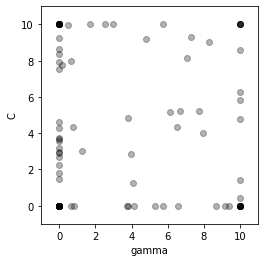

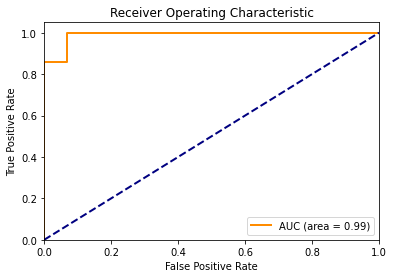

Accuracy for particle (in iteration 10, in fold 3) - 1 is 0.4828 At (gamma, c): [9.40244576e+00 1.00000000e-03]
Accuracy for particle (in iteration 10, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 10, in fold 3) - 3 is 0.8966 At (gamma, c): [6.68324282 5.21135469]
Accuracy for particle (in iteration 10, in fold 3) - 4 is 0.8621 At (gamma, c): [1.00000000e-03 8.65341086e+00]
Accuracy for particle (in iteration 10, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 10, in fold 3) - 6 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 10, in fold 3) - 7 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 10, in fold 3) - 8 is 0.7931 At (gamma, c): [1.0000000e-03 1.4697974e+00]
Accuracy for particle (in iteration 10, in fold 3) - 9 is 0.7586 At (gamma, c): [1.00000000e-03 2.68079989e+00]
Accuracy for particle (in iteration 10, in fold 3) - 10 is 0.7586 At (gamma,

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 10, in fold 3) - 92 is 0.8966 At (gamma, c): [6.4979145 4.3341365]
Accuracy for particle (in iteration 10, in fold 3) - 93 is 0.4828 At (gamma, c): [5.74958969e+00 1.00000000e-03]
Accuracy for particle (in iteration 10, in fold 3) - 94 is 0.4828 At (gamma, c): [6.57073332e+00 1.00000000e-03]
Accuracy for particle (in iteration 10, in fold 3) - 95 is 0.8621 At (gamma, c): [1.00000000e-03 9.23020824e+00]
Accuracy for particle (in iteration 10, in fold 3) - 96 is 0.8966 At (gamma, c): [10.          8.60926273]
Accuracy for particle (in iteration 10, in fold 3) - 97 is 1.0000 At (gamma, c): [0.78922499 4.32387662]
Accuracy for particle (in iteration 10, in fold 3) - 98 is 0.8966 At (gamma, c): [8.26430735 9.05552364]
Accuracy for particle (in iteration 10, in fold 3) - 99 is 1.0000 At (gamma, c): [0.64126572 7.97499659]
Accuracy for particle (in iteration 10, in fold 3) - 100 is 0.5862 At (gamma, c): [10.          0.43260709]
The best position in iterati

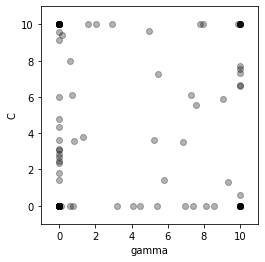

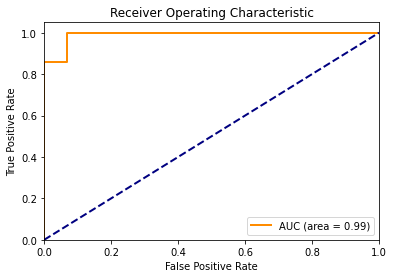

Accuracy for particle (in iteration 11, in fold 3) - 1 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 11, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 11, in fold 3) - 3 is 0.8966 At (gamma, c): [7.5527099 5.574314 ]
Accuracy for particle (in iteration 11, in fold 3) - 4 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 11, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 11, in fold 3) - 6 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 11, in fold 3) - 7 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 11, in fold 3) - 8 is 0.7586 At (gamma, c): [1.00000000e-03 1.41050333e+00]
Accuracy for particle (in iteration 11, in fold 3) - 9 is 0.7586 At (gamma, c): [1.00000000e-03 2.36977529e+00]
Accuracy for particle (in iteration 11, in fold 3) - 10 is 0.7586 At (gamma, c): [1.00000000e-03 1.79130008e

Accuracy for particle (in iteration 11, in fold 3) - 82 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 11, in fold 3) - 83 is 0.7586 At (gamma, c): [1.00000000e-03 3.11241396e+00]
Accuracy for particle (in iteration 11, in fold 3) - 84 is 0.8966 At (gamma, c): [ 7.96487954 10.        ]
Accuracy for particle (in iteration 11, in fold 3) - 85 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 11, in fold 3) - 86 is 0.8966 At (gamma, c): [10.          7.33814922]
Accuracy for particle (in iteration 11, in fold 3) - 87 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 11, in fold 3) - 88 is 0.8276 At (gamma, c): [1.00000000e-03 6.00520446e+00]
Accuracy for particle (in iteration 11, in fold 3) - 89 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 11, in fold 3) - 90 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 11, in fold 3) - 91 is 0.4828 At (gamma, c): [0.0

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


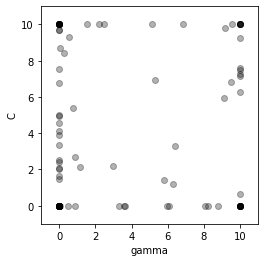

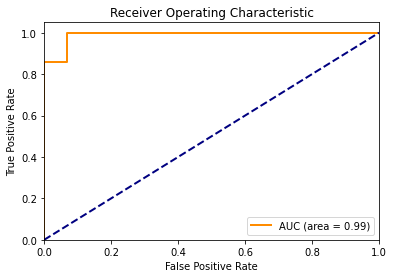

Accuracy for particle (in iteration 12, in fold 3) - 1 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 12, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 12, in fold 3) - 3 is 0.8966 At (gamma, c): [9.51141553 6.84335265]
Accuracy for particle (in iteration 12, in fold 3) - 4 is 0.8621 At (gamma, c): [1.0000000e-03 7.5348489e+00]
Accuracy for particle (in iteration 12, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 12, in fold 3) - 6 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 12, in fold 3) - 7 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 12, in fold 3) - 8 is 0.7931 At (gamma, c): [1.00000000e-03 1.64227545e+00]
Accuracy for particle (in iteration 12, in fold 3) - 9 is 0.7931 At (gamma, c): [1.00000000e-03 2.02464129e+00]
Accuracy for particle (in iteration 12, in fold 3) - 10 is 0.7931 At (gamma, c): [1.00000000

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


The best position in iteration 12, fold 3 is [1.00000000e-03 9.03961535e+00], with Accuracy: 1.0000
Accuracy Score: 0.8621
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 4 10]]
Confusion Matrix (Train):
[[122   6]
 [ 27 102]]

Iteration 13 - Fold 3:



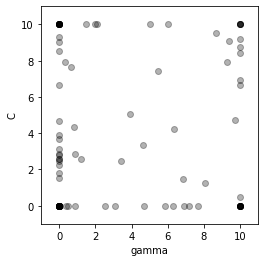

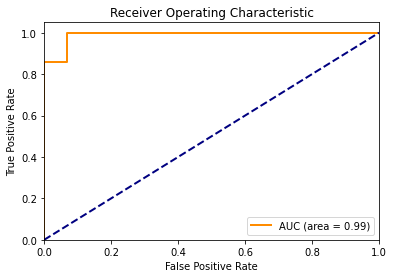

Accuracy for particle (in iteration 13, in fold 3) - 1 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 13, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 13, in fold 3) - 3 is 0.8966 At (gamma, c): [10.          8.77840832]
Accuracy for particle (in iteration 13, in fold 3) - 4 is 0.8621 At (gamma, c): [1.00000000e-03 9.03961535e+00]
Accuracy for particle (in iteration 13, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 13, in fold 3) - 6 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 13, in fold 3) - 7 is 0.8621 At (gamma, c): [1.00000000e-03 9.28292433e+00]
Accuracy for particle (in iteration 13, in fold 3) - 8 is 0.7586 At (gamma, c): [1.00000000e-03 1.80935287e+00]
Accuracy for particle (in iteration 13, in fold 3) - 9 is 0.7931 At (gamma, c): [1.00000000e-03 2.24027537e+00]
Accuracy for particle (in iteration 13, in fold 3) - 10 is 0.7586 At (ga

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 13, in fold 3) - 94 is 0.4828 At (gamma, c): [5.86483706e+00 1.00000000e-03]
Accuracy for particle (in iteration 13, in fold 3) - 95 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 13, in fold 3) - 96 is 0.8966 At (gamma, c): [10.          6.65307963]
Accuracy for particle (in iteration 13, in fold 3) - 97 is 1.0000 At (gamma, c): [0.8520054  2.87598399]
Accuracy for particle (in iteration 13, in fold 3) - 98 is 0.8966 At (gamma, c): [8.6684274  9.51726873]
Accuracy for particle (in iteration 13, in fold 3) - 99 is 1.0000 At (gamma, c): [0.80722046 4.31995961]
Accuracy for particle (in iteration 13, in fold 3) - 100 is 0.5862 At (gamma, c): [10.          0.50588128]
The best position in iteration 13, fold 3 is [1.00000000e-03 8.43470188e+00], with Accuracy: 1.0000
Accuracy Score: 0.8621
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 4 10]]
Confusion Matrix (Train):
[[122

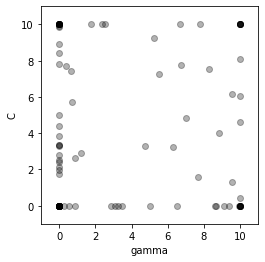

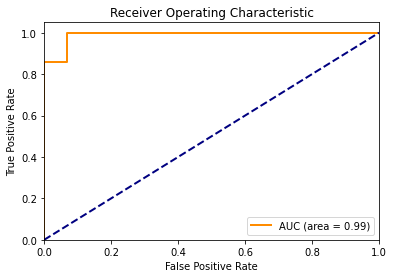

Accuracy for particle (in iteration 14, in fold 3) - 1 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 14, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 14, in fold 3) - 3 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 14, in fold 3) - 4 is 0.8621 At (gamma, c): [1.00000000e-03 8.43470188e+00]
Accuracy for particle (in iteration 14, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 14, in fold 3) - 6 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 14, in fold 3) - 7 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 14, in fold 3) - 8 is 0.7931 At (gamma, c): [1.00000000e-03 1.94649495e+00]
Accuracy for particle (in iteration 14, in fold 3) - 9 is 0.7586 At (gamma, c): [1.00000000e-03 2.11621257e+00]
Accuracy for particle (in iteration 14, in fold 3) - 10 is 0.7931 At (gamma, c): [1.00000000e-03 1.72900

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 14, in fold 3) - 93 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 14, in fold 3) - 94 is 0.4828 At (gamma, c): [4.99899331e+00 1.00000000e-03]
Accuracy for particle (in iteration 14, in fold 3) - 95 is 0.8621 At (gamma, c): [1.00000000e-03 8.89859984e+00]
Accuracy for particle (in iteration 14, in fold 3) - 96 is 0.8966 At (gamma, c): [8.8127996  4.02932679]
Accuracy for particle (in iteration 14, in fold 3) - 97 is 1.0000 At (gamma, c): [0.87080712 2.62989973]
Accuracy for particle (in iteration 14, in fold 3) - 98 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 14, in fold 3) - 99 is 1.0000 At (gamma, c): [0.72366724 5.71418242]
Accuracy for particle (in iteration 14, in fold 3) - 100 is 0.5862 At (gamma, c): [10.          0.41387444]
The best position in iteration 14, fold 3 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8621
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1

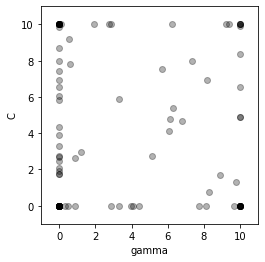

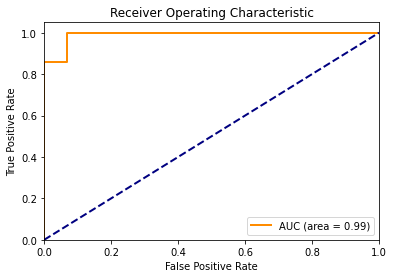

Accuracy for particle (in iteration 15, in fold 3) - 1 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 15, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 15, in fold 3) - 3 is 0.8966 At (gamma, c): [6.09914041 4.79480838]
Accuracy for particle (in iteration 15, in fold 3) - 4 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 15, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 15, in fold 3) - 6 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 15, in fold 3) - 7 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 15, in fold 3) - 8 is 0.7931 At (gamma, c): [1.00000000e-03 1.74577468e+00]
Accuracy for particle (in iteration 15, in fold 3) - 9 is 0.7586 At (gamma, c): [1.00000000e-03 2.46654237e+00]
Accuracy for particle (in iteration 15, in fold 3) - 10 is 0.7931 At (gamma, c): [1.00000000e-03 1.7528769

Accuracy for particle (in iteration 15, in fold 3) - 100 is 0.8966 At (gamma, c): [8.27718953 0.73073383]
The best position in iteration 15, fold 3 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8621
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 4 10]]
Confusion Matrix (Train):
[[122   6]
 [ 23 106]]

Iteration 16 - Fold 3:



*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


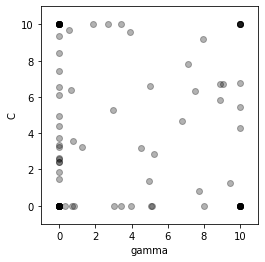

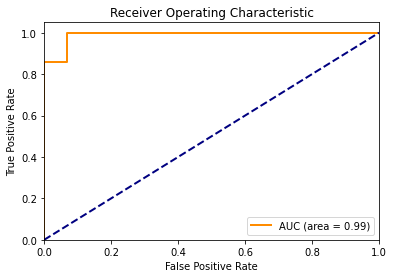

Accuracy for particle (in iteration 16, in fold 3) - 1 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 16, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 16, in fold 3) - 3 is 0.8966 At (gamma, c): [9.07056665 6.7308888 ]
Accuracy for particle (in iteration 16, in fold 3) - 4 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 16, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 16, in fold 3) - 6 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 16, in fold 3) - 7 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 16, in fold 3) - 8 is 0.7586 At (gamma, c): [1.00000000e-03 1.46012079e+00]
Accuracy for particle (in iteration 16, in fold 3) - 9 is 0.7586 At (gamma, c): [1.00000000e-03 2.40461075e+00]
Accuracy for particle (in iteration 16, in fold 3) - 10 is 0.7586 At (gamma, c): [1.00000000e-03 1.8770820

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 16, in fold 3) - 96 is 0.8966 At (gamma, c): [10.          4.26433427]
Accuracy for particle (in iteration 16, in fold 3) - 97 is 1.0000 At (gamma, c): [0.79506218 3.58260592]
Accuracy for particle (in iteration 16, in fold 3) - 98 is 0.8966 At (gamma, c): [7.10566783 7.84577015]
Accuracy for particle (in iteration 16, in fold 3) - 99 is 1.0000 At (gamma, c): [0.68281883 6.37805809]
Accuracy for particle (in iteration 16, in fold 3) - 100 is 0.8966 At (gamma, c): [7.73347709 0.78410989]
The best position in iteration 16, fold 3 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8621
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 4 10]]
Confusion Matrix (Train):
[[122   6]
 [ 23 106]]

Iteration 17 - Fold 3:



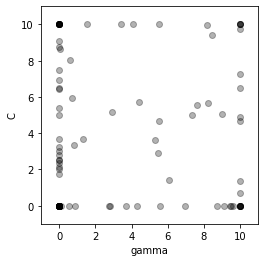

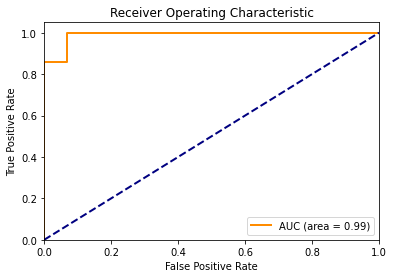

Accuracy for particle (in iteration 17, in fold 3) - 1 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 17, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 17, in fold 3) - 3 is 0.8966 At (gamma, c): [7.61298122 5.55736576]
Accuracy for particle (in iteration 17, in fold 3) - 4 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 17, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 17, in fold 3) - 6 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 17, in fold 3) - 7 is 0.8276 At (gamma, c): [1.00000000e-03 6.41956021e+00]
Accuracy for particle (in iteration 17, in fold 3) - 8 is 0.7586 At (gamma, c): [1.00000000e-03 1.76117685e+00]
Accuracy for particle (in iteration 17, in fold 3) - 9 is 0.7931 At (gamma, c): [1.00000000e-03 2.02439904e+00]
Accuracy for particle (in iteration 17, in fold 3) - 10 is 0.7931 At (gamma, c): [1.000000

Accuracy for particle (in iteration 17, in fold 3) - 87 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 17, in fold 3) - 88 is 0.7586 At (gamma, c): [1.00000000e-03 3.25893366e+00]
Accuracy for particle (in iteration 17, in fold 3) - 89 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 17, in fold 3) - 90 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 17, in fold 3) - 91 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 17, in fold 3) - 92 is 0.8966 At (gamma, c): [10.          6.48515719]
Accuracy for particle (in iteration 17, in fold 3) - 93 is 0.4828 At (gamma, c): [6.94201971e+00 1.00000000e-03]
Accuracy for particle (in iteration 17, in fold 3) - 94 is 0.4828 At (gamma, c): [3.70462617e+00 1.00000000e-03]
Accuracy for particle (in iteration 17, in fold 3) - 95 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 17, in fold 3) - 96 is 0.8966 At (gamma

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


The best position in iteration 17, fold 3 is [1.00000000e-03 8.63258786e+00], with Accuracy: 1.0000
Accuracy Score: 0.8621
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 4 10]]
Confusion Matrix (Train):
[[122   6]
 [ 23 106]]

Iteration 18 - Fold 3:



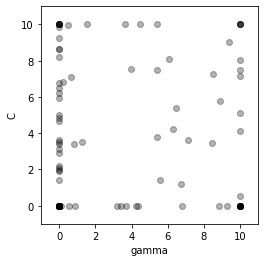

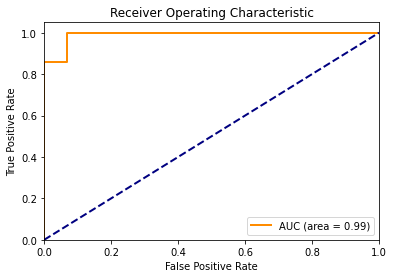

Accuracy for particle (in iteration 18, in fold 3) - 1 is 0.4828 At (gamma, c): [8.8429485e+00 1.0000000e-03]
Accuracy for particle (in iteration 18, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 18, in fold 3) - 3 is 0.8966 At (gamma, c): [10.          7.14666028]
Accuracy for particle (in iteration 18, in fold 3) - 4 is 0.8621 At (gamma, c): [1.00000000e-03 8.63258786e+00]
Accuracy for particle (in iteration 18, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 18, in fold 3) - 6 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 18, in fold 3) - 7 is 0.8276 At (gamma, c): [1.00000000e-03 5.96515628e+00]
Accuracy for particle (in iteration 18, in fold 3) - 8 is 0.7586 At (gamma, c): [1.00000000e-03 1.89934303e+00]
Accuracy for particle (in iteration 18, in fold 3) - 9 is 0.7931 At (gamma, c): [1.00000000e-03 2.18416211e+00]
Accuracy for particle (in iteration 18, in fold 3) - 10 is

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 18, in fold 3) - 93 is 0.4828 At (gamma, c): [9.26462668e+00 1.00000000e-03]
Accuracy for particle (in iteration 18, in fold 3) - 94 is 0.4828 At (gamma, c): [4.24678738e+00 1.00000000e-03]
Accuracy for particle (in iteration 18, in fold 3) - 95 is 0.8621 At (gamma, c): [1.00000000e-03 6.75596001e+00]
Accuracy for particle (in iteration 18, in fold 3) - 96 is 0.8966 At (gamma, c): [8.42871322 3.43984226]
Accuracy for particle (in iteration 18, in fold 3) - 97 is 1.0000 At (gamma, c): [0.80770167 3.42306327]
Accuracy for particle (in iteration 18, in fold 3) - 98 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 18, in fold 3) - 99 is 1.0000 At (gamma, c): [0.64034614 7.08263202]
Accuracy for particle (in iteration 18, in fold 3) - 100 is 0.8966 At (gamma, c): [10.          0.55749163]
The best position in iteration 18, fold 3 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8621
F1 Score: 0.8333
Recall Score: 0.7143
Pr

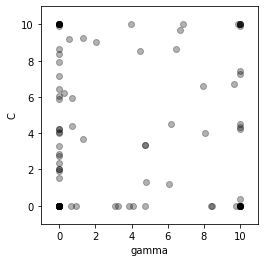

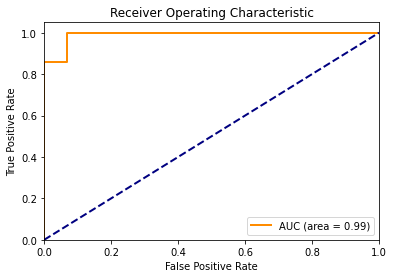

Accuracy for particle (in iteration 19, in fold 3) - 1 is 0.4828 At (gamma, c): [8.44425124e+00 1.00000000e-03]
Accuracy for particle (in iteration 19, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 19, in fold 3) - 3 is 0.8966 At (gamma, c): [6.15356372 4.48784075]
Accuracy for particle (in iteration 19, in fold 3) - 4 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 19, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 19, in fold 3) - 6 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 19, in fold 3) - 7 is 0.8621 At (gamma, c): [1.00000000e-03 7.13038063e+00]
Accuracy for particle (in iteration 19, in fold 3) - 8 is 0.7931 At (gamma, c): [1.00000000e-03 2.02121683e+00]
Accuracy for particle (in iteration 19, in fold 3) - 9 is 0.7931 At (gamma, c): [1.00000000e-03 2.01768375e+00]
Accuracy for particle (in iteration 19, in fold 3) - 10 is 0.7586 At (gamm

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 19, in fold 3) - 94 is 0.4828 At (gamma, c): [3.27344343e+00 1.00000000e-03]
Accuracy for particle (in iteration 19, in fold 3) - 95 is 0.8276 At (gamma, c): [1.00000000e-03 6.45742068e+00]
Accuracy for particle (in iteration 19, in fold 3) - 96 is 0.8966 At (gamma, c): [10.          4.23384331]
Accuracy for particle (in iteration 19, in fold 3) - 97 is 1.0000 At (gamma, c): [0.72900664 4.4146239 ]
Accuracy for particle (in iteration 19, in fold 3) - 98 is 0.8966 At (gamma, c): [ 9.87434643 10.        ]
Accuracy for particle (in iteration 19, in fold 3) - 99 is 1.0000 At (gamma, c): [0.70819479 5.93206347]
Accuracy for particle (in iteration 19, in fold 3) - 100 is 0.5862 At (gamma, c): [10.          0.38044703]
The best position in iteration 19, fold 3 is [1.00000000e-03 8.26227105e+00], with Accuracy: 1.0000
Accuracy Score: 0.8621
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 4 10]]
Confusion Mat

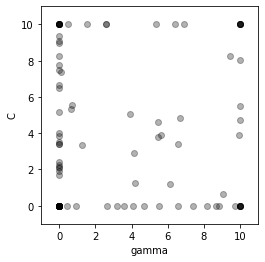

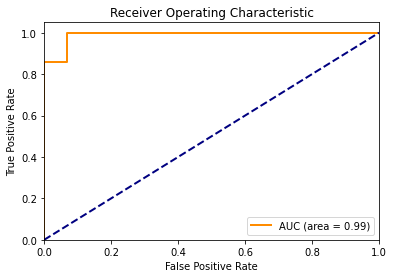

Accuracy for particle (in iteration 20, in fold 3) - 1 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 20, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 20, in fold 3) - 3 is 0.8966 At (gamma, c): [6.64663909 4.81320101]
Accuracy for particle (in iteration 20, in fold 3) - 4 is 0.8621 At (gamma, c): [1.00000000e-03 8.26227105e+00]
Accuracy for particle (in iteration 20, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 20, in fold 3) - 6 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 20, in fold 3) - 7 is 0.8621 At (gamma, c): [1.0000000e-03 7.7441241e+00]
Accuracy for particle (in iteration 20, in fold 3) - 8 is 0.7586 At (gamma, c): [1.00000000e-03 2.12841134e+00]
Accuracy for particle (in iteration 20, in fold 3) - 9 is 0.7931 At (gamma, c): [1.00000000e-03 1.92846768e+00]
Accuracy for particle (in iteration 20, in fold 3) - 10 is 0.7931 At (gamma,

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 20, in fold 3) - 94 is 0.4828 At (gamma, c): [4.06923474e+00 1.00000000e-03]
Accuracy for particle (in iteration 20, in fold 3) - 95 is 0.8621 At (gamma, c): [1.00000000e-03 6.68033911e+00]
Accuracy for particle (in iteration 20, in fold 3) - 96 is 0.8966 At (gamma, c): [9.924788   3.87924903]
Accuracy for particle (in iteration 20, in fold 3) - 97 is 1.0000 At (gamma, c): [0.6546293  5.35178267]
Accuracy for particle (in iteration 20, in fold 3) - 98 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 20, in fold 3) - 99 is 1.0000 At (gamma, c): [0.72929976 5.57361055]
Accuracy for particle (in iteration 20, in fold 3) - 100 is 0.8966 At (gamma, c): [9.0434698  0.65760133]
The best position in iteration 20, fold 3 is [1.00000000e-03 8.66354499e+00], with Accuracy: 1.0000
Accuracy Score: 0.8621
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 4 10]]
Confusion Matrix (Train):
[[122  

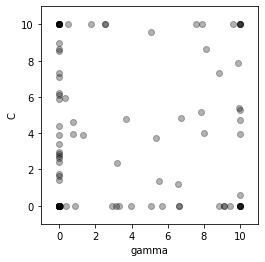

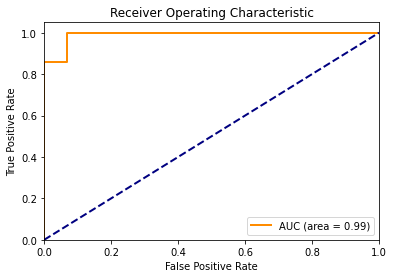

Accuracy for particle (in iteration 21, in fold 3) - 1 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 21, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 21, in fold 3) - 3 is 0.8966 At (gamma, c): [6.72382137 4.86252822]
Accuracy for particle (in iteration 21, in fold 3) - 4 is 0.8621 At (gamma, c): [1.00000000e-03 8.66354499e+00]
Accuracy for particle (in iteration 21, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 21, in fold 3) - 6 is 0.8966 At (gamma, c): [ 9.61923654 10.        ]
Accuracy for particle (in iteration 21, in fold 3) - 7 is 0.8621 At (gamma, c): [1.00000000e-03 8.97143871e+00]
Accuracy for particle (in iteration 21, in fold 3) - 8 is 0.7931 At (gamma, c): [1.00000000e-03 1.64819812e+00]
Accuracy for particle (in iteration 21, in fold 3) - 9 is 0.7931 At (gamma, c): [1.00000000e-03 1.74061961e+00]
Accuracy for particle (in iteration 21, in fold 3) - 10 is

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 21, in fold 3) - 96 is 0.8966 At (gamma, c): [10.          3.94189167]
Accuracy for particle (in iteration 21, in fold 3) - 97 is 1.0000 At (gamma, c): [0.76759853 3.92831562]
Accuracy for particle (in iteration 21, in fold 3) - 98 is 0.8966 At (gamma, c): [8.0853928  8.65027586]
Accuracy for particle (in iteration 21, in fold 3) - 99 is 1.0000 At (gamma, c): [0.78497641 4.63199097]
Accuracy for particle (in iteration 21, in fold 3) - 100 is 0.8966 At (gamma, c): [10.          0.58605847]
The best position in iteration 21, fold 3 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8621
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 4 10]]
Confusion Matrix (Train):
[[122   6]
 [ 27 102]]

Iteration 22 - Fold 3:



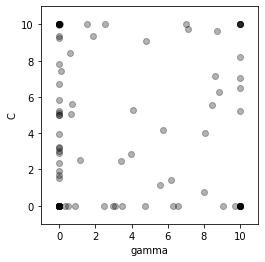

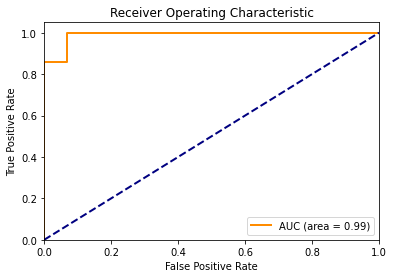

Accuracy for particle (in iteration 22, in fold 3) - 1 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 22, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 22, in fold 3) - 3 is 0.8966 At (gamma, c): [5.71717713 4.18224121]
Accuracy for particle (in iteration 22, in fold 3) - 4 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 22, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 22, in fold 3) - 6 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 22, in fold 3) - 7 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 22, in fold 3) - 8 is 0.7931 At (gamma, c): [1.0000000e-03 1.7106076e+00]
Accuracy for particle (in iteration 22, in fold 3) - 9 is 0.7931 At (gamma, c): [1.00000000e-03 1.93077455e+00]
Accuracy for particle (in iteration 22, in fold 3) - 10 is 0.7586 At (gamma, c): [1.00000000e-03 1.50848819e

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 22, in fold 3) - 100 is 0.8966 At (gamma, c): [8.00709399 0.75742925]
The best position in iteration 22, fold 3 is [1.00000000e-03 7.55608848e+00], with Accuracy: 1.0000
Accuracy Score: 0.8621
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 4 10]]
Confusion Matrix (Train):
[[122   6]
 [ 23 106]]

Iteration 23 - Fold 3:



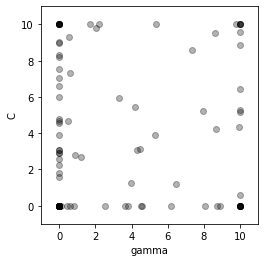

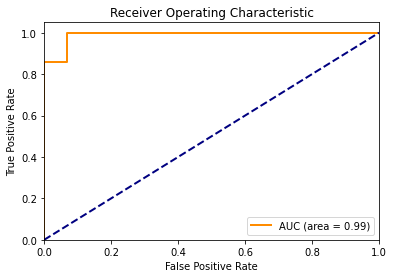

Accuracy for particle (in iteration 23, in fold 3) - 1 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 23, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 23, in fold 3) - 3 is 0.9310 At (gamma, c): [5.30149308 3.90159064]
Accuracy for particle (in iteration 23, in fold 3) - 4 is 0.8621 At (gamma, c): [1.00000000e-03 7.55608848e+00]
Accuracy for particle (in iteration 23, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 23, in fold 3) - 6 is 0.8966 At (gamma, c): [8.62379964 9.52531458]
Accuracy for particle (in iteration 23, in fold 3) - 7 is 0.8621 At (gamma, c): [1.00000000e-03 8.19413673e+00]
Accuracy for particle (in iteration 23, in fold 3) - 8 is 0.7586 At (gamma, c): [1.00000000e-03 1.78309749e+00]
Accuracy for particle (in iteration 23, in fold 3) - 9 is 0.7931 At (gamma, c): [1.00000000e-03 2.22289157e+00]
Accuracy for particle (in iteration 23, in fold 3) - 10 is 0

Accuracy for particle (in iteration 23, in fold 3) - 81 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 23, in fold 3) - 82 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 23, in fold 3) - 83 is 0.7931 At (gamma, c): [1.0000000e-03 4.5569676e+00]
Accuracy for particle (in iteration 23, in fold 3) - 84 is 0.8966 At (gamma, c): [ 9.76935999 10.        ]
Accuracy for particle (in iteration 23, in fold 3) - 85 is 1.0000 At (gamma, c): [0.49480183 4.68834707]
Accuracy for particle (in iteration 23, in fold 3) - 86 is 0.8966 At (gamma, c): [10.          6.45826838]
Accuracy for particle (in iteration 23, in fold 3) - 87 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 23, in fold 3) - 88 is 0.7586 At (gamma, c): [1.00000000e-03 2.89748908e+00]
Accuracy for particle (in iteration 23, in fold 3) - 89 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 23, in fold 3) - 90 is 0.4828 At (gamma, c)

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


The best position in iteration 23, fold 3 is [1.00000000e-03 7.54169876e+00], with Accuracy: 1.0000
Accuracy Score: 0.8621
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 4 10]]
Confusion Matrix (Train):
[[122   6]
 [ 27 102]]

Iteration 24 - Fold 3:



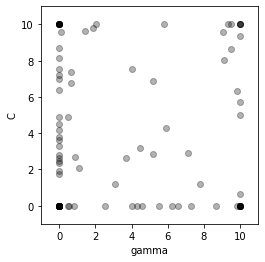

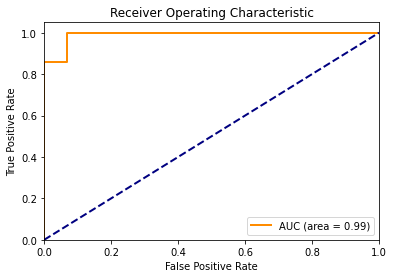

Accuracy for particle (in iteration 24, in fold 3) - 1 is 0.4828 At (gamma, c): [9.83586936e+00 1.00000000e-03]
Accuracy for particle (in iteration 24, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 24, in fold 3) - 3 is 0.8966 At (gamma, c): [5.910191   4.31215181]
Accuracy for particle (in iteration 24, in fold 3) - 4 is 0.8621 At (gamma, c): [1.00000000e-03 7.54169876e+00]
Accuracy for particle (in iteration 24, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 24, in fold 3) - 6 is 0.8966 At (gamma, c): [ 9.47823331 10.        ]
Accuracy for particle (in iteration 24, in fold 3) - 7 is 0.8276 At (gamma, c): [1.00000000e-03 6.37889637e+00]
Accuracy for particle (in iteration 24, in fold 3) - 8 is 0.7931 At (gamma, c): [1.00000000e-03 1.93684145e+00]
Accuracy for particle (in iteration 24, in fold 3) - 9 is 0.7586 At (gamma, c): [1.00000000e-03 2.44855497e+00]
Accuracy for particle (in iteration 24, in

Accuracy for particle (in iteration 24, in fold 3) - 100 is 0.8966 At (gamma, c): [10.          0.63175235]
The best position in iteration 24, fold 3 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8621
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 4 10]]
Confusion Matrix (Train):
[[122   6]
 [ 27 102]]

Iteration 25 - Fold 3:



*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


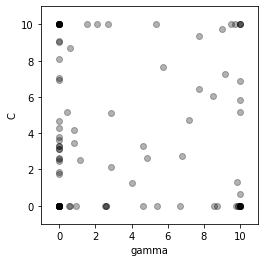

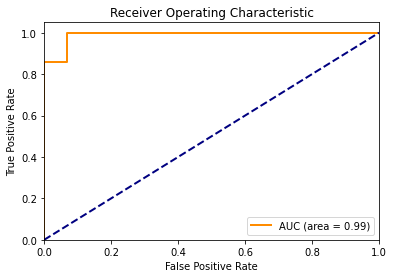

Accuracy for particle (in iteration 25, in fold 3) - 1 is 0.4828 At (gamma, c): [9.87477873e+00 1.00000000e-03]
Accuracy for particle (in iteration 25, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 25, in fold 3) - 3 is 0.8966 At (gamma, c): [8.49437466 6.05529277]
Accuracy for particle (in iteration 25, in fold 3) - 4 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 25, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 25, in fold 3) - 6 is 0.8966 At (gamma, c): [ 9.72786871 10.        ]
Accuracy for particle (in iteration 25, in fold 3) - 7 is 0.7931 At (gamma, c): [1.00000000e-03 4.31162535e+00]
Accuracy for particle (in iteration 25, in fold 3) - 8 is 0.7586 At (gamma, c): [1.00000000e-03 1.88385538e+00]
Accuracy for particle (in iteration 25, in fold 3) - 9 is 0.7586 At (gamma, c): [1.00000000e-03 2.64253203e+00]
Accuracy for particle (in iteration 25, in fold 3) - 10 is

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 25, in fold 3) - 92 is 0.8966 At (gamma, c): [7.18339873 4.75200401]
Accuracy for particle (in iteration 25, in fold 3) - 93 is 0.4828 At (gamma, c): [8.5309283e+00 1.0000000e-03]
Accuracy for particle (in iteration 25, in fold 3) - 94 is 0.4828 At (gamma, c): [6.67022093e+00 1.00000000e-03]
Accuracy for particle (in iteration 25, in fold 3) - 95 is 0.8621 At (gamma, c): [1.00000000e-03 9.04809065e+00]
Accuracy for particle (in iteration 25, in fold 3) - 96 is 0.8966 At (gamma, c): [6.78005718 2.72728162]
Accuracy for particle (in iteration 25, in fold 3) - 97 is 1.0000 At (gamma, c): [0.80700315 3.43178598]
Accuracy for particle (in iteration 25, in fold 3) - 98 is 0.8966 At (gamma, c): [8.97501838 9.76187219]
Accuracy for particle (in iteration 25, in fold 3) - 99 is 1.0000 At (gamma, c): [0.81027599 4.20407599]
Accuracy for particle (in iteration 25, in fold 3) - 100 is 0.8966 At (gamma, c): [10.          0.67077007]
The best position in iteration

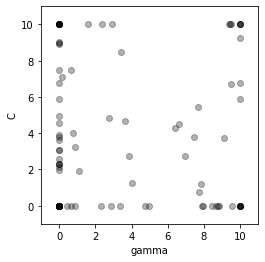

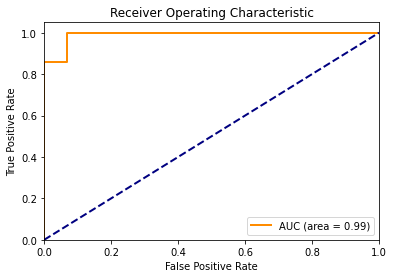

Accuracy for particle (in iteration 26, in fold 3) - 1 is 0.4828 At (gamma, c): [8.44335007e+00 1.00000000e-03]
Accuracy for particle (in iteration 26, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 26, in fold 3) - 3 is 0.8966 At (gamma, c): [9.4827539  6.72199323]
Accuracy for particle (in iteration 26, in fold 3) - 4 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 26, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 26, in fold 3) - 6 is 0.8966 At (gamma, c): [ 9.41628411 10.        ]
Accuracy for particle (in iteration 26, in fold 3) - 7 is 0.7931 At (gamma, c): [1.00000000e-03 3.87317682e+00]
Accuracy for particle (in iteration 26, in fold 3) - 8 is 0.7931 At (gamma, c): [1.00000000e-03 2.15787058e+00]
Accuracy for particle (in iteration 26, in fold 3) - 9 is 0.7586 At (gamma, c): [1.00000000e-03 2.29334956e+00]
Accuracy for particle (in iteration 26, in fold 3) - 10 is

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 26, in fold 3) - 97 is 1.0000 At (gamma, c): [0.75921062 4.03397771]
Accuracy for particle (in iteration 26, in fold 3) - 98 is 0.8966 At (gamma, c): [ 9.49415169 10.        ]
Accuracy for particle (in iteration 26, in fold 3) - 99 is 1.0000 At (gamma, c): [0.86734177 3.24030529]
Accuracy for particle (in iteration 26, in fold 3) - 100 is 0.8966 At (gamma, c): [7.69801012 0.78134817]
The best position in iteration 26, fold 3 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8621
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 4 10]]
Confusion Matrix (Train):
[[122   6]
 [ 23 106]]

Iteration 27 - Fold 3:



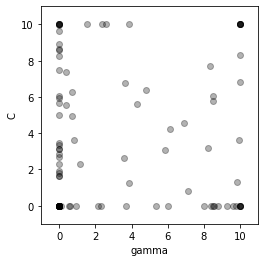

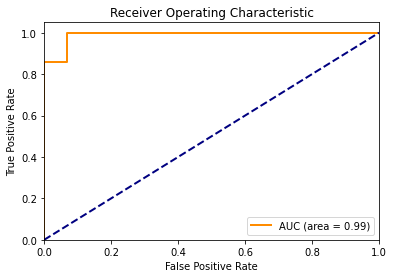

Accuracy for particle (in iteration 27, in fold 3) - 1 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 27, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 27, in fold 3) - 3 is 0.8966 At (gamma, c): [8.49971009 6.05888322]
Accuracy for particle (in iteration 27, in fold 3) - 4 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 27, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 27, in fold 3) - 6 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 27, in fold 3) - 7 is 0.8276 At (gamma, c): [1.00000000e-03 6.06320256e+00]
Accuracy for particle (in iteration 27, in fold 3) - 8 is 0.7931 At (gamma, c): [1.00000000e-03 1.62831794e+00]
Accuracy for particle (in iteration 27, in fold 3) - 9 is 0.7586 At (gamma, c): [1.0000000e-03 2.2742793e+00]
Accuracy for particle (in iteration 27, in fold 3) - 10 is 0.7931 At (gamma, c): [1.00000000

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 27, in fold 3) - 95 is 0.8276 At (gamma, c): [1.00000000e-03 5.95878135e+00]
Accuracy for particle (in iteration 27, in fold 3) - 96 is 0.8966 At (gamma, c): [9.91631317 3.64317197]
Accuracy for particle (in iteration 27, in fold 3) - 97 is 1.0000 At (gamma, c): [0.68641424 4.95122132]
Accuracy for particle (in iteration 27, in fold 3) - 98 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 27, in fold 3) - 99 is 1.0000 At (gamma, c): [0.84455122 3.62518141]
Accuracy for particle (in iteration 27, in fold 3) - 100 is 0.8966 At (gamma, c): [7.10824756 0.80663023]
The best position in iteration 27, fold 3 is [1.0000000e-03 9.6872338e+00], with Accuracy: 1.0000
Accuracy Score: 0.8621
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 4 10]]
Confusion Matrix (Train):
[[122   6]
 [ 23 106]]

Iteration 28 - Fold 3:



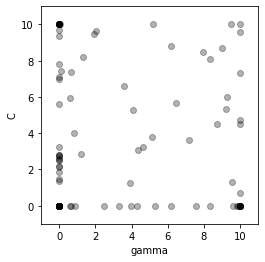

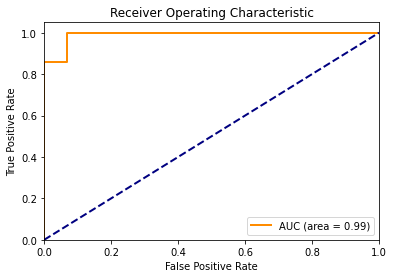

Accuracy for particle (in iteration 28, in fold 3) - 1 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 28, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 28, in fold 3) - 3 is 0.9310 At (gamma, c): [5.15597428 3.80338497]
Accuracy for particle (in iteration 28, in fold 3) - 4 is 0.8621 At (gamma, c): [1.0000000e-03 9.6872338e+00]
Accuracy for particle (in iteration 28, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 28, in fold 3) - 6 is 0.8966 At (gamma, c): [ 9.48122139 10.        ]
Accuracy for particle (in iteration 28, in fold 3) - 7 is 0.8621 At (gamma, c): [1.00000000e-03 7.07554289e+00]
Accuracy for particle (in iteration 28, in fold 3) - 8 is 0.7586 At (gamma, c): [1.00000000e-03 1.36073762e+00]
Accuracy for particle (in iteration 28, in fold 3) - 9 is 0.7586 At (gamma, c): [1.00000000e-03 2.11808598e+00]
Accuracy for particle (in iteration 28, in fold 3) - 10 is 0

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 28, in fold 3) - 96 is 0.8966 At (gamma, c): [10.          4.74816211]
Accuracy for particle (in iteration 28, in fold 3) - 97 is 1.0000 At (gamma, c): [0.60982742 5.9162251 ]
Accuracy for particle (in iteration 28, in fold 3) - 98 is 0.8966 At (gamma, c): [7.95781887 8.46217874]
Accuracy for particle (in iteration 28, in fold 3) - 99 is 1.0000 At (gamma, c): [0.82319602 3.98582116]
Accuracy for particle (in iteration 28, in fold 3) - 100 is 0.8966 At (gamma, c): [10.          0.70892603]
The best position in iteration 28, fold 3 is [1.00000000e-03 7.69320162e+00], with Accuracy: 1.0000
Accuracy Score: 0.8621
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 4 10]]
Confusion Matrix (Train):
[[122   6]
 [ 24 105]]

Iteration 29 - Fold 3:



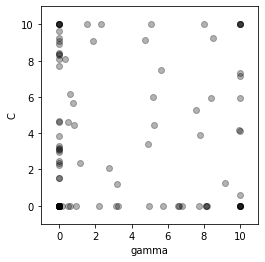

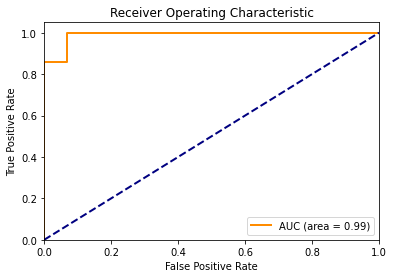

Accuracy for particle (in iteration 29, in fold 3) - 1 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 29, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 29, in fold 3) - 3 is 0.8966 At (gamma, c): [8.35877609 5.96381335]
Accuracy for particle (in iteration 29, in fold 3) - 4 is 0.8621 At (gamma, c): [1.00000000e-03 7.69320162e+00]
Accuracy for particle (in iteration 29, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 29, in fold 3) - 6 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 29, in fold 3) - 7 is 0.7931 At (gamma, c): [1.00000000e-03 4.61176957e+00]
Accuracy for particle (in iteration 29, in fold 3) - 8 is 0.7586 At (gamma, c): [1.00000000e-03 1.51448172e+00]
Accuracy for particle (in iteration 29, in fold 3) - 9 is 0.7931 At (gamma, c): [1.00000000e-03 2.48974321e+00]
Accuracy for particle (in iteration 29, in fold 3) - 10 is 0.7586 At (gamm

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 29, in fold 3) - 93 is 0.4828 At (gamma, c): [6.6186372e+00 1.0000000e-03]
Accuracy for particle (in iteration 29, in fold 3) - 94 is 0.4828 At (gamma, c): [6.76193287e+00 1.00000000e-03]
Accuracy for particle (in iteration 29, in fold 3) - 95 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 29, in fold 3) - 96 is 0.8966 At (gamma, c): [9.91086722 4.17163962]
Accuracy for particle (in iteration 29, in fold 3) - 97 is 1.0000 At (gamma, c): [0.59090938 6.15459464]
Accuracy for particle (in iteration 29, in fold 3) - 98 is 0.8966 At (gamma, c): [8.47954114 9.23711375]
Accuracy for particle (in iteration 29, in fold 3) - 99 is 1.0000 At (gamma, c): [0.79697277 4.42867216]
Accuracy for particle (in iteration 29, in fold 3) - 100 is 0.8966 At (gamma, c): [10.          0.58200044]
The best position in iteration 29, fold 3 is [1.00000000e-03 6.17300027e+00], with Accuracy: 1.0000
Accuracy Score: 0.8621
F1 Score: 0.8333
Recall Scor

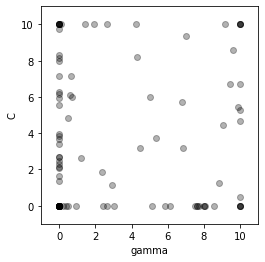

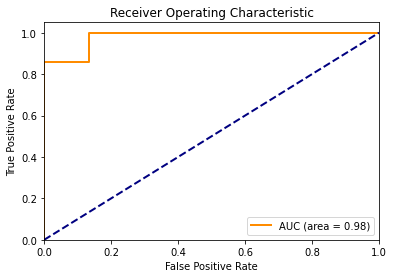

Accuracy for particle (in iteration 30, in fold 3) - 1 is 0.4828 At (gamma, c): [8.53113925e+00 1.00000000e-03]
Accuracy for particle (in iteration 30, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 30, in fold 3) - 3 is 0.8966 At (gamma, c): [9.44105651 6.69385819]
Accuracy for particle (in iteration 30, in fold 3) - 4 is 0.8276 At (gamma, c): [1.00000000e-03 6.17300027e+00]
Accuracy for particle (in iteration 30, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 30, in fold 3) - 6 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 30, in fold 3) - 7 is 0.8276 At (gamma, c): [1.00000000e-03 5.92948028e+00]
Accuracy for particle (in iteration 30, in fold 3) - 8 is 0.7931 At (gamma, c): [1.00000000e-03 1.62298341e+00]
Accuracy for particle (in iteration 30, in fold 3) - 9 is 0.7586 At (gamma, c): [1.0000000e-03 2.1244782e+00]
Accuracy for particle (in iteration 30, in fold 3) - 10 is 0

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 30, in fold 3) - 92 is 0.9310 At (gamma, c): [5.34875026 3.75303719]
Accuracy for particle (in iteration 30, in fold 3) - 93 is 0.4828 At (gamma, c): [5.13774488e+00 1.00000000e-03]
Accuracy for particle (in iteration 30, in fold 3) - 94 is 0.4828 At (gamma, c): [7.6042951e+00 1.0000000e-03]
Accuracy for particle (in iteration 30, in fold 3) - 95 is 0.8276 At (gamma, c): [1.00000000e-03 5.56738435e+00]
Accuracy for particle (in iteration 30, in fold 3) - 96 is 0.8966 At (gamma, c): [10.          5.30014994]
Accuracy for particle (in iteration 30, in fold 3) - 97 is 1.0000 At (gamma, c): [0.59550074 6.09674275]
Accuracy for particle (in iteration 30, in fold 3) - 98 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 30, in fold 3) - 99 is 1.0000 At (gamma, c): [0.70392708 6.00000379]
Accuracy for particle (in iteration 30, in fold 3) - 100 is 0.5862 At (gamma, c): [10.          0.48191514]
The best position in iteration 30, fold 3 

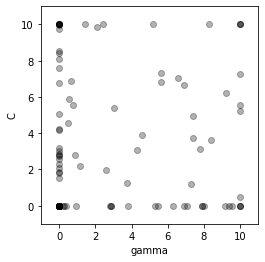

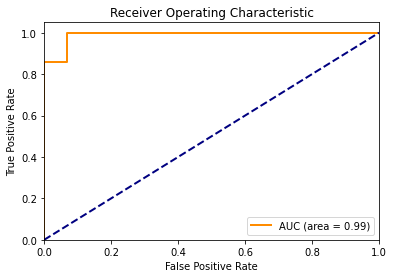

Accuracy for particle (in iteration 31, in fold 3) - 1 is 0.4828 At (gamma, c): [6.88499009e+00 1.00000000e-03]
Accuracy for particle (in iteration 31, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 31, in fold 3) - 3 is 0.8966 At (gamma, c): [10.          7.26878348]
Accuracy for particle (in iteration 31, in fold 3) - 4 is 0.8621 At (gamma, c): [1.00000000e-03 8.52150556e+00]
Accuracy for particle (in iteration 31, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 31, in fold 3) - 6 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 31, in fold 3) - 7 is 0.7931 At (gamma, c): [1.00000000e-03 4.16139914e+00]
Accuracy for particle (in iteration 31, in fold 3) - 8 is 0.7586 At (gamma, c): [1.00000000e-03 1.80758991e+00]
Accuracy for particle (in iteration 31, in fold 3) - 9 is 0.7586 At (gamma, c): [1.0000000e-03 1.8760138e+00]
Accuracy for particle (in iteration 31, in fold 3) - 10 is

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 31, in fold 3) - 97 is 1.0000 At (gamma, c): [0.8553914  2.82208686]
Accuracy for particle (in iteration 31, in fold 3) - 98 is 0.8966 At (gamma, c): [6.56350387 7.04192524]
Accuracy for particle (in iteration 31, in fold 3) - 99 is 1.0000 At (gamma, c): [0.65087391 6.89595195]
Accuracy for particle (in iteration 31, in fold 3) - 100 is 0.5862 At (gamma, c): [10.          0.50292659]
The best position in iteration 31, fold 3 is [1.00000000e-03 9.11547566e+00], with Accuracy: 1.0000
Accuracy Score: 0.8621
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 4 10]]
Confusion Matrix (Train):
[[122   6]
 [ 27 102]]

Iteration 32 - Fold 3:



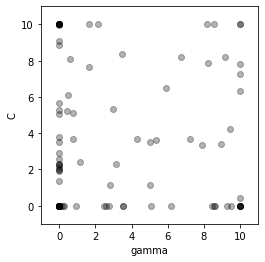

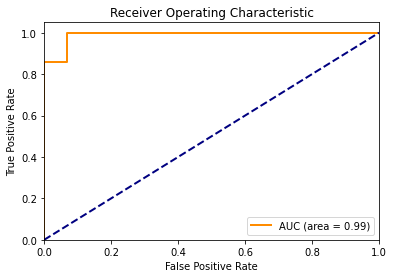

Accuracy for particle (in iteration 32, in fold 3) - 1 is 0.4828 At (gamma, c): [9.26118858e+00 1.00000000e-03]
Accuracy for particle (in iteration 32, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 32, in fold 3) - 3 is 0.8966 At (gamma, c): [10.          7.81530083]
Accuracy for particle (in iteration 32, in fold 3) - 4 is 0.8621 At (gamma, c): [1.00000000e-03 9.11547566e+00]
Accuracy for particle (in iteration 32, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 32, in fold 3) - 6 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 32, in fold 3) - 7 is 0.8276 At (gamma, c): [1.00000000e-03 5.25765255e+00]
Accuracy for particle (in iteration 32, in fold 3) - 8 is 0.7931 At (gamma, c): [1.00000000e-03 1.93388418e+00]
Accuracy for particle (in iteration 32, in fold 3) - 9 is 0.7931 At (gamma, c): [1.00000000e-03 1.96294801e+00]
Accuracy for particle (in iteration 32, in fold 3) - 10 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 32, in fold 3) - 92 is 0.9310 At (gamma, c): [5.32904834 3.64194512]
Accuracy for particle (in iteration 32, in fold 3) - 93 is 0.4828 At (gamma, c): [6.15450634e+00 1.00000000e-03]
Accuracy for particle (in iteration 32, in fold 3) - 94 is 0.4828 At (gamma, c): [3.53492306e+00 1.00000000e-03]
Accuracy for particle (in iteration 32, in fold 3) - 95 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 32, in fold 3) - 96 is 0.8966 At (gamma, c): [9.40963767 4.21553709]
Accuracy for particle (in iteration 32, in fold 3) - 97 is 1.0000 At (gamma, c): [0.78616684 3.69432519]
Accuracy for particle (in iteration 32, in fold 3) - 98 is 0.8966 At (gamma, c): [5.92346167 6.5014763 ]
Accuracy for particle (in iteration 32, in fold 3) - 99 is 1.0000 At (gamma, c): [0.58095024 8.07680481]
Accuracy for particle (in iteration 32, in fold 3) - 100 is 0.5862 At (gamma, c): [10.          0.40707718]
The best position in iteration 32, fold 3 is

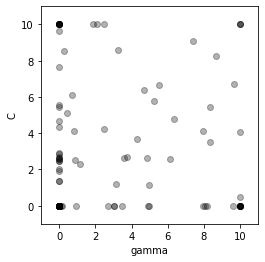

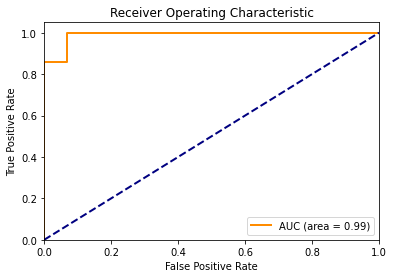

Accuracy for particle (in iteration 33, in fold 3) - 1 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 33, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 33, in fold 3) - 3 is 0.8966 At (gamma, c): [6.3289573  4.78754288]
Accuracy for particle (in iteration 33, in fold 3) - 4 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 33, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 33, in fold 3) - 6 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 33, in fold 3) - 7 is 0.7931 At (gamma, c): [1.00000000e-03 4.36718234e+00]
Accuracy for particle (in iteration 33, in fold 3) - 8 is 0.7586 At (gamma, c): [1.00000000e-03 1.34983298e+00]
Accuracy for particle (in iteration 33, in fold 3) - 9 is 0.7931 At (gamma, c): [1.000000e-03 2.047208e+00]
Accuracy for particle (in iteration 33, in fold 3) - 10 is 0.7586 At (gamma, c): [1.00000000e-

Accuracy for particle (in iteration 33, in fold 3) - 95 is 0.8276 At (gamma, c): [1.00000000e-03 5.55985529e+00]
Accuracy for particle (in iteration 33, in fold 3) - 96 is 0.8966 At (gamma, c): [6.12475576 2.59999993]
Accuracy for particle (in iteration 33, in fold 3) - 97 is 1.0000 At (gamma, c): [0.87835463 2.53274714]
Accuracy for particle (in iteration 33, in fold 3) - 98 is 0.9310 At (gamma, c): [5.26260859 5.80184383]
Accuracy for particle (in iteration 33, in fold 3) - 99 is 1.0000 At (gamma, c): [0.81366953 4.14670106]
Accuracy for particle (in iteration 33, in fold 3) - 100 is 0.5862 At (gamma, c): [10.          0.50077734]
The best position in iteration 33, fold 3 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8621
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 4 10]]
Confusion Matrix (Train):
[[122   6]
 [ 23 106]]

Iteration 34 - Fold 3:



*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


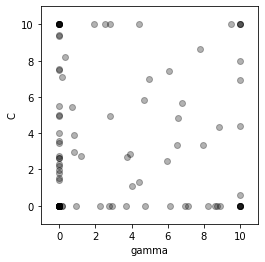

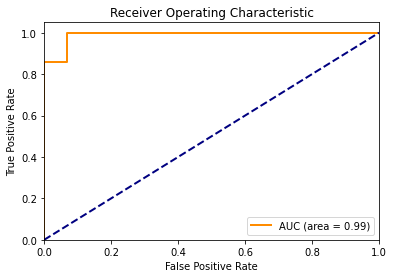

Accuracy for particle (in iteration 34, in fold 3) - 1 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 34, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 34, in fold 3) - 3 is 0.8966 At (gamma, c): [6.55419807 4.84118365]
Accuracy for particle (in iteration 34, in fold 3) - 4 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 34, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 34, in fold 3) - 6 is 0.8966 At (gamma, c): [ 9.47116679 10.        ]
Accuracy for particle (in iteration 34, in fold 3) - 7 is 0.8276 At (gamma, c): [1.00000000e-03 5.49615094e+00]
Accuracy for particle (in iteration 34, in fold 3) - 8 is 0.7586 At (gamma, c): [1.00000000e-03 1.50161799e+00]
Accuracy for particle (in iteration 34, in fold 3) - 9 is 0.7586 At (gamma, c): [1.00000000e-03 1.80121924e+00]
Accuracy for particle (in iteration 34, in fold 3) - 10 is 0.7586 At (gamm

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 34, in fold 3) - 94 is 0.4828 At (gamma, c): [6.10053592e+00 1.00000000e-03]
Accuracy for particle (in iteration 34, in fold 3) - 95 is 0.8621 At (gamma, c): [1.00000000e-03 7.56483834e+00]
Accuracy for particle (in iteration 34, in fold 3) - 96 is 0.8966 At (gamma, c): [5.95934208 2.48274819]
Accuracy for particle (in iteration 34, in fold 3) - 97 is 1.0000 At (gamma, c): [0.84530471 2.9491804 ]
Accuracy for particle (in iteration 34, in fold 3) - 98 is 0.8966 At (gamma, c): [7.78028658 8.64396011]
Accuracy for particle (in iteration 34, in fold 3) - 99 is 1.0000 At (gamma, c): [0.73578963 5.46191665]
Accuracy for particle (in iteration 34, in fold 3) - 100 is 0.8966 At (gamma, c): [10.         0.5795815]
The best position in iteration 34, fold 3 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8621
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 4 10]]
Confusion Matrix (Train):
[[122   6

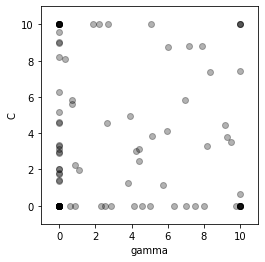

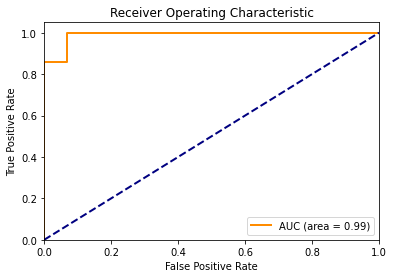

Accuracy for particle (in iteration 35, in fold 3) - 1 is 0.4828 At (gamma, c): [7.02598483e+00 1.00000000e-03]
Accuracy for particle (in iteration 35, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 35, in fold 3) - 3 is 0.9310 At (gamma, c): [5.14892882 3.8201841 ]
Accuracy for particle (in iteration 35, in fold 3) - 4 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 35, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 35, in fold 3) - 6 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 35, in fold 3) - 7 is 0.8276 At (gamma, c): [1.00000000e-03 6.29188917e+00]
Accuracy for particle (in iteration 35, in fold 3) - 8 is 0.7586 At (gamma, c): [1.00000000e-03 1.40186387e+00]
Accuracy for particle (in iteration 35, in fold 3) - 9 is 0.7586 At (gamma, c): [1.00000000e-03 1.76291414e+00]
Accuracy for particle (in iteration 35, in fold 3) - 10 is 0.7586 At (gamm

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 35, in fold 3) - 95 is 0.8621 At (gamma, c): [1.00000000e-03 9.03673576e+00]
Accuracy for particle (in iteration 35, in fold 3) - 96 is 0.8966 At (gamma, c): [9.50857971 3.53266616]
Accuracy for particle (in iteration 35, in fold 3) - 97 is 1.0000 At (gamma, c): [0.89995371 2.26059604]
Accuracy for particle (in iteration 35, in fold 3) - 98 is 0.8966 At (gamma, c): [7.91219525 8.79546592]
Accuracy for particle (in iteration 35, in fold 3) - 99 is 1.0000 At (gamma, c): [0.72665633 5.61615756]
Accuracy for particle (in iteration 35, in fold 3) - 100 is 0.8966 At (gamma, c): [10.          0.64023368]
The best position in iteration 35, fold 3 is [1.00000000e-03 7.39990033e+00], with Accuracy: 1.0000
Accuracy Score: 0.8621
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 4 10]]
Confusion Matrix (Train):
[[122   6]
 [ 23 106]]

Iteration 36 - Fold 3:



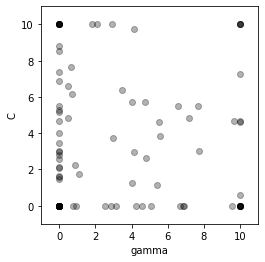

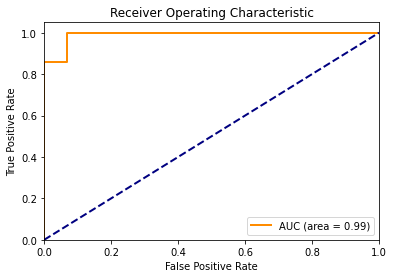

Accuracy for particle (in iteration 36, in fold 3) - 1 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 36, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 36, in fold 3) - 3 is 0.8966 At (gamma, c): [7.68158168 5.52703453]
Accuracy for particle (in iteration 36, in fold 3) - 4 is 0.8621 At (gamma, c): [1.00000000e-03 7.39990033e+00]
Accuracy for particle (in iteration 36, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 36, in fold 3) - 6 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 36, in fold 3) - 7 is 0.7931 At (gamma, c): [1.00000000e-03 4.70028559e+00]
Accuracy for particle (in iteration 36, in fold 3) - 8 is 0.7931 At (gamma, c): [1.00000000e-03 1.63877988e+00]
Accuracy for particle (in iteration 36, in fold 3) - 9 is 0.7931 At (gamma, c): [1.00000000e-03 1.58423342e+00]
Accuracy for particle (in iteration 36, in fold 3) - 10 is 0.7586 At (gamm

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 36, in fold 3) - 94 is 0.4828 At (gamma, c): [4.24437141e+00 1.00000000e-03]
Accuracy for particle (in iteration 36, in fold 3) - 95 is 0.8621 At (gamma, c): [1.00000000e-03 8.53098838e+00]
Accuracy for particle (in iteration 36, in fold 3) - 96 is 0.8966 At (gamma, c): [10.          4.67984941]
Accuracy for particle (in iteration 36, in fold 3) - 97 is 1.0000 At (gamma, c): [0.90297203 2.22256472]
Accuracy for particle (in iteration 36, in fold 3) - 98 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 36, in fold 3) - 99 is 1.0000 At (gamma, c): [0.69503467 6.15017586]
Accuracy for particle (in iteration 36, in fold 3) - 100 is 0.8966 At (gamma, c): [10.          0.60899477]
The best position in iteration 36, fold 3 is [1.00000000e-03 8.66522026e+00], with Accuracy: 1.0000
Accuracy Score: 0.8621
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 4 10]]
Confusion Matrix (Train):
[[1

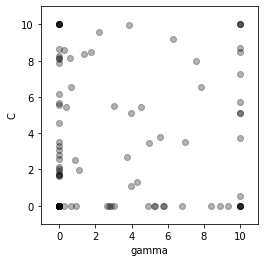

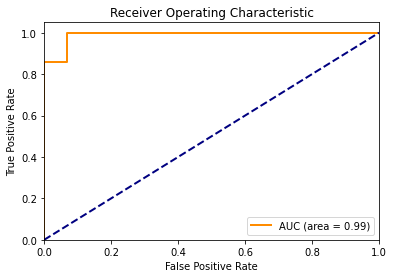

Accuracy for particle (in iteration 37, in fold 3) - 1 is 0.4828 At (gamma, c): [8.90423652e+00 1.00000000e-03]
Accuracy for particle (in iteration 37, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 37, in fold 3) - 3 is 0.8966 At (gamma, c): [10.          7.25504329]
Accuracy for particle (in iteration 37, in fold 3) - 4 is 0.8621 At (gamma, c): [1.00000000e-03 8.66522026e+00]
Accuracy for particle (in iteration 37, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 37, in fold 3) - 6 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 37, in fold 3) - 7 is 0.8276 At (gamma, c): [1.00000000e-03 5.66188711e+00]
Accuracy for particle (in iteration 37, in fold 3) - 8 is 0.7586 At (gamma, c): [1.00000000e-03 1.77179399e+00]
Accuracy for particle (in iteration 37, in fold 3) - 9 is 0.7931 At (gamma, c): [1.00000000e-03 1.69229073e+00]
Accuracy for particle (in iteration 37, in fold 3) - 10 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 37, in fold 3) - 96 is 0.8966 At (gamma, c): [10.         5.0965228]
Accuracy for particle (in iteration 37, in fold 3) - 97 is 1.0000 At (gamma, c): [0.87869606 2.52844515]
Accuracy for particle (in iteration 37, in fold 3) - 98 is 0.8966 At (gamma, c): [7.57184851 7.99839287]
Accuracy for particle (in iteration 37, in fold 3) - 99 is 1.0000 At (gamma, c): [0.67121476 6.55244033]
Accuracy for particle (in iteration 37, in fold 3) - 100 is 0.8966 At (gamma, c): [10.         0.5327731]
The best position in iteration 37, fold 3 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8621
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 4 10]]
Confusion Matrix (Train):
[[122   6]
 [ 27 102]]

Iteration 38 - Fold 3:



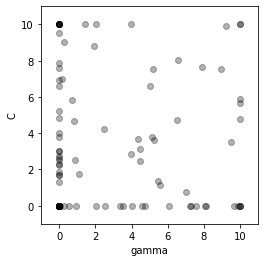

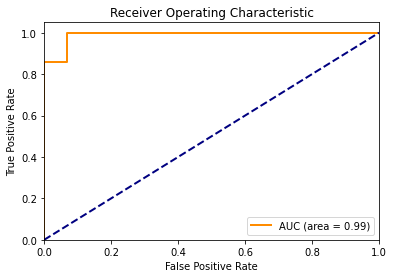

Accuracy for particle (in iteration 38, in fold 3) - 1 is 0.4828 At (gamma, c): [9.6513041e+00 1.0000000e-03]
Accuracy for particle (in iteration 38, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 38, in fold 3) - 3 is 0.9310 At (gamma, c): [5.10332526 3.79626756]
Accuracy for particle (in iteration 38, in fold 3) - 4 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 38, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 38, in fold 3) - 6 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 38, in fold 3) - 7 is 0.7931 At (gamma, c): [1.00000000e-03 4.85147753e+00]
Accuracy for particle (in iteration 38, in fold 3) - 8 is 0.7586 At (gamma, c): [1.00000000e-03 1.85949655e+00]
Accuracy for particle (in iteration 38, in fold 3) - 9 is 0.7931 At (gamma, c): [1.00000000e-03 1.69444345e+00]
Accuracy for particle (in iteration 38, in fold 3) - 10 is 0.7586 At (gamma,

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 38, in fold 3) - 92 is 0.9310 At (gamma, c): [4.47308901 3.10913336]
Accuracy for particle (in iteration 38, in fold 3) - 93 is 0.4828 At (gamma, c): [4.03878218e+00 1.00000000e-03]
Accuracy for particle (in iteration 38, in fold 3) - 94 is 0.4828 At (gamma, c): [3.34834291e+00 1.00000000e-03]
Accuracy for particle (in iteration 38, in fold 3) - 95 is 0.8276 At (gamma, c): [1.0000000e-03 5.2063374e+00]
Accuracy for particle (in iteration 38, in fold 3) - 96 is 0.8966 At (gamma, c): [10.          4.78344639]
Accuracy for particle (in iteration 38, in fold 3) - 97 is 1.0000 At (gamma, c): [0.87939011 2.51969999]
Accuracy for particle (in iteration 38, in fold 3) - 98 is 0.8966 At (gamma, c): [9.19560919 9.93384801]
Accuracy for particle (in iteration 38, in fold 3) - 99 is 1.0000 At (gamma, c): [0.7147134  5.81784659]
Accuracy for particle (in iteration 38, in fold 3) - 100 is 0.8966 At (gamma, c): [7.00730903 0.77240363]
The best position in iteration

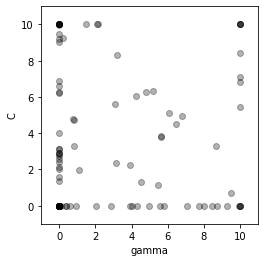

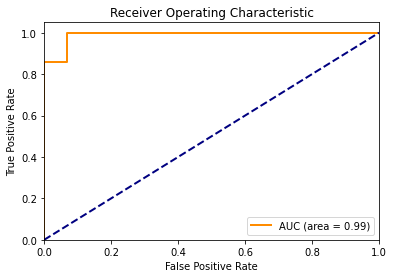

Accuracy for particle (in iteration 39, in fold 3) - 1 is 0.4828 At (gamma, c): [8.70406335e+00 1.00000000e-03]
Accuracy for particle (in iteration 39, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 39, in fold 3) - 3 is 0.8966 At (gamma, c): [6.79767488 4.93250164]
Accuracy for particle (in iteration 39, in fold 3) - 4 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 39, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 39, in fold 3) - 6 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 39, in fold 3) - 7 is 0.8276 At (gamma, c): [1.00000000e-03 6.26512061e+00]
Accuracy for particle (in iteration 39, in fold 3) - 8 is 0.7931 At (gamma, c): [1.00000000e-03 1.60279759e+00]
Accuracy for particle (in iteration 39, in fold 3) - 9 is 0.7931 At (gamma, c): [1.00000000e-03 2.04233735e+00]
Accuracy for particle (in iteration 39, in fold 3) - 10 is 0.7586 At (gamm

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 39, in fold 3) - 92 is 0.9310 At (gamma, c): [5.619802   3.80276179]
Accuracy for particle (in iteration 39, in fold 3) - 93 is 0.4828 At (gamma, c): [4.98993677e+00 1.00000000e-03]
Accuracy for particle (in iteration 39, in fold 3) - 94 is 0.4828 At (gamma, c): [4.00668402e+00 1.00000000e-03]
Accuracy for particle (in iteration 39, in fold 3) - 95 is 0.8276 At (gamma, c): [1.00000000e-03 6.60362526e+00]
Accuracy for particle (in iteration 39, in fold 3) - 96 is 0.8966 At (gamma, c): [10.          5.46890265]
Accuracy for particle (in iteration 39, in fold 3) - 97 is 1.0000 At (gamma, c): [0.816787   3.30850711]
Accuracy for particle (in iteration 39, in fold 3) - 98 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 39, in fold 3) - 99 is 1.0000 At (gamma, c): [0.77671931 4.77070671]
Accuracy for particle (in iteration 39, in fold 3) - 100 is 0.8966 At (gamma, c): [9.4822267  0.70458948]
The best position in iteration 39, fold 3 

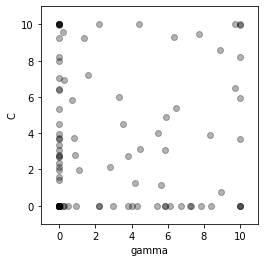

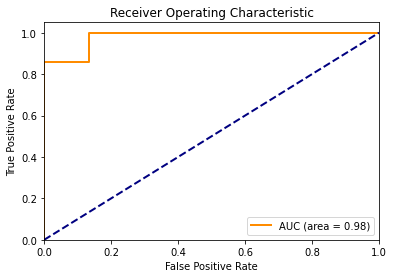

Accuracy for particle (in iteration 40, in fold 3) - 1 is 0.4828 At (gamma, c): [7.27279147e+00 1.00000000e-03]
Accuracy for particle (in iteration 40, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 40, in fold 3) - 3 is 0.9310 At (gamma, c): [5.47411572 4.02499366]
Accuracy for particle (in iteration 40, in fold 3) - 4 is 0.8276 At (gamma, c): [1.00000000e-03 5.31404315e+00]
Accuracy for particle (in iteration 40, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 40, in fold 3) - 6 is 0.8966 At (gamma, c): [ 9.72667109 10.        ]
Accuracy for particle (in iteration 40, in fold 3) - 7 is 0.8276 At (gamma, c): [1.00000000e-03 6.38605834e+00]
Accuracy for particle (in iteration 40, in fold 3) - 8 is 0.7931 At (gamma, c): [1.00000000e-03 1.58641381e+00]
Accuracy for particle (in iteration 40, in fold 3) - 9 is 0.7931 At (gamma, c): [1.00000000e-03 1.98899855e+00]
Accuracy for particle (in iteration 40, in

Accuracy for particle (in iteration 40, in fold 3) - 83 is 0.7931 At (gamma, c): [1.00000000e-03 2.69414665e+00]
Accuracy for particle (in iteration 40, in fold 3) - 84 is 0.8966 At (gamma, c): [6.3207794  9.30176381]
Accuracy for particle (in iteration 40, in fold 3) - 85 is 1.0000 At (gamma, c): [0.24680375 6.92067849]
Accuracy for particle (in iteration 40, in fold 3) - 86 is 0.8966 At (gamma, c): [10.          8.20573055]
Accuracy for particle (in iteration 40, in fold 3) - 87 is 0.8621 At (gamma, c): [1.00000000e-03 9.97508462e+00]
Accuracy for particle (in iteration 40, in fold 3) - 88 is 0.7931 At (gamma, c): [1.00000000e-03 3.93558174e+00]
Accuracy for particle (in iteration 40, in fold 3) - 89 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 40, in fold 3) - 90 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 40, in fold 3) - 91 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 40, in fold 3) - 92 is 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 40, in fold 3) - 99 is 1.0000 At (gamma, c): [0.83939426 3.71226829]
Accuracy for particle (in iteration 40, in fold 3) - 100 is 0.8966 At (gamma, c): [8.92760945 0.73723045]
The best position in iteration 40, fold 3 is [1.00000000e-03 5.21064219e+00], with Accuracy: 1.0000
Accuracy Score: 0.8276
F1 Score: 0.7826
Recall Score: 0.6429
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 5  9]]
Confusion Matrix (Train):
[[122   6]
 [ 32  97]]

Iteration 41 - Fold 3:



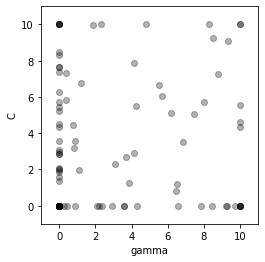

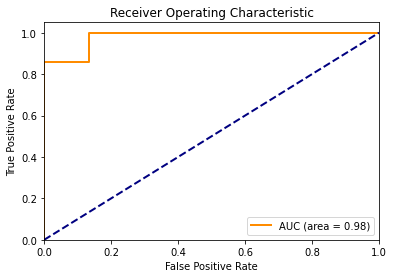

Accuracy for particle (in iteration 41, in fold 3) - 1 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 41, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 41, in fold 3) - 3 is 0.8966 At (gamma, c): [7.9760859  5.71261034]
Accuracy for particle (in iteration 41, in fold 3) - 4 is 0.8276 At (gamma, c): [1.00000000e-03 5.21064219e+00]
Accuracy for particle (in iteration 41, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 41, in fold 3) - 6 is 0.8966 At (gamma, c): [8.50062005 9.23294105]
Accuracy for particle (in iteration 41, in fold 3) - 7 is 0.8621 At (gamma, c): [1.0000000e-03 7.3938294e+00]
Accuracy for particle (in iteration 41, in fold 3) - 8 is 0.7931 At (gamma, c): [1.00000000e-03 1.59217628e+00]
Accuracy for particle (in iteration 41, in fold 3) - 9 is 0.7931 At (gamma, c): [1.00000000e-03 2.08999499e+00]
Accuracy for particle (in iteration 41, in fold 3) - 10 is 0.7

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 41, in fold 3) - 92 is 0.9310 At (gamma, c): [4.12667703 2.89560795]
Accuracy for particle (in iteration 41, in fold 3) - 93 is 0.4828 At (gamma, c): [4.2942742e+00 1.0000000e-03]
Accuracy for particle (in iteration 41, in fold 3) - 94 is 0.4828 At (gamma, c): [3.60150745e+00 1.00000000e-03]
Accuracy for particle (in iteration 41, in fold 3) - 95 is 0.8276 At (gamma, c): [1.00000000e-03 5.70282492e+00]
Accuracy for particle (in iteration 41, in fold 3) - 96 is 0.8966 At (gamma, c): [10.          4.32115894]
Accuracy for particle (in iteration 41, in fold 3) - 97 is 1.0000 At (gamma, c): [0.82849357 3.1610029 ]
Accuracy for particle (in iteration 41, in fold 3) - 98 is 0.9310 At (gamma, c): [5.66532765 6.05728733]
Accuracy for particle (in iteration 41, in fold 3) - 99 is 1.0000 At (gamma, c): [0.79585806 4.44749648]
Accuracy for particle (in iteration 41, in fold 3) - 100 is 0.8966 At (gamma, c): [6.42561155 0.82670727]
The best position in iteration

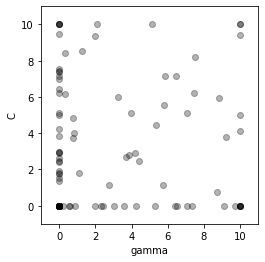

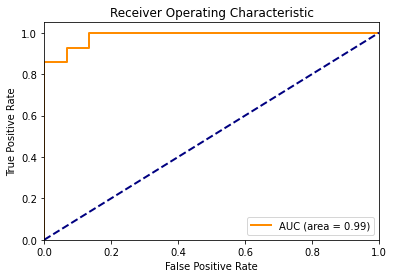

Accuracy for particle (in iteration 42, in fold 3) - 1 is 0.4828 At (gamma, c): [6.38283403e+00 1.00000000e-03]
Accuracy for particle (in iteration 42, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 42, in fold 3) - 3 is 0.8966 At (gamma, c): [7.05992596 5.09123221]
Accuracy for particle (in iteration 42, in fold 3) - 4 is 0.8276 At (gamma, c): [1.00000000e-03 6.43405744e+00]
Accuracy for particle (in iteration 42, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001      0.00307464]
Accuracy for particle (in iteration 42, in fold 3) - 6 is 0.8966 At (gamma, c): [6.46395086 7.17761114]
Accuracy for particle (in iteration 42, in fold 3) - 7 is 0.7931 At (gamma, c): [1.00000000e-03 4.23036206e+00]
Accuracy for particle (in iteration 42, in fold 3) - 8 is 0.7586 At (gamma, c): [1.00000000e-03 1.51255038e+00]
Accuracy for particle (in iteration 42, in fold 3) - 9 is 0.7931 At (gamma, c): [1.00000000e-03 1.93880703e+00]
Accuracy for particle (in iteratio

Accuracy for particle (in iteration 42, in fold 3) - 93 is 0.4828 At (gamma, c): [5.26927274e+00 1.00000000e-03]
Accuracy for particle (in iteration 42, in fold 3) - 94 is 0.4828 At (gamma, c): [3.58180857e+00 1.00000000e-03]
Accuracy for particle (in iteration 42, in fold 3) - 95 is 0.8276 At (gamma, c): [1.00000000e-03 5.08954676e+00]
Accuracy for particle (in iteration 42, in fold 3) - 96 is 0.8966 At (gamma, c): [9.20433678 3.77497408]
Accuracy for particle (in iteration 42, in fold 3) - 97 is 1.0000 At (gamma, c): [0.78336244 3.7296608 ]
Accuracy for particle (in iteration 42, in fold 3) - 98 is 0.8966 At (gamma, c): [7.5056611  8.18432241]
Accuracy for particle (in iteration 42, in fold 3) - 99 is 1.0000 At (gamma, c): [0.77308394 4.83209993]
Accuracy for particle (in iteration 42, in fold 3) - 100 is 0.8966 At (gamma, c): [8.72710893 0.75504204]
The best position in iteration 42, fold 3 is [1.00000000e-03 9.39183621e+00], with Accuracy: 1.0000
Accuracy Score: 0.8276
F1 Score: 0.

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


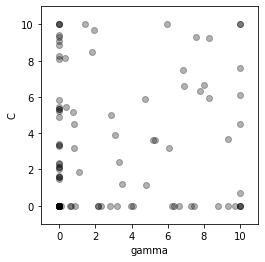

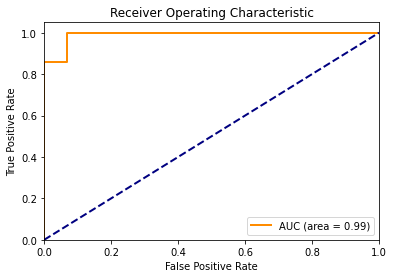

Accuracy for particle (in iteration 43, in fold 3) - 1 is 0.4828 At (gamma, c): [9.71796886e+00 1.00000000e-03]
Accuracy for particle (in iteration 43, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 43, in fold 3) - 3 is 0.8966 At (gamma, c): [8.29953749 5.9267038 ]
Accuracy for particle (in iteration 43, in fold 3) - 4 is 0.8621 At (gamma, c): [1.00000000e-03 9.39183621e+00]
Accuracy for particle (in iteration 43, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 43, in fold 3) - 6 is 0.8966 At (gamma, c): [8.27287961 9.25007878]
Accuracy for particle (in iteration 43, in fold 3) - 7 is 0.7586 At (gamma, c): [1.00000000e-03 3.32546545e+00]
Accuracy for particle (in iteration 43, in fold 3) - 8 is 0.7931 At (gamma, c): [1.00000000e-03 1.59437197e+00]
Accuracy for particle (in iteration 43, in fold 3) - 9 is 0.7931 At (gamma, c): [1.00000000e-03 1.55927883e+00]
Accuracy for particle (in iteration 43, in f

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 43, in fold 3) - 96 is 0.8966 At (gamma, c): [9.327202   3.67400274]
Accuracy for particle (in iteration 43, in fold 3) - 97 is 1.0000 At (gamma, c): [0.82866934 3.15878807]
Accuracy for particle (in iteration 43, in fold 3) - 98 is 0.8966 At (gamma, c): [6.82031894 7.49724993]
Accuracy for particle (in iteration 43, in fold 3) - 99 is 1.0000 At (gamma, c): [0.75355755 5.16185652]
Accuracy for particle (in iteration 43, in fold 3) - 100 is 0.8966 At (gamma, c): [10.          0.68548198]
The best position in iteration 43, fold 3 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8621
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 4 10]]
Confusion Matrix (Train):
[[122   6]
 [ 27 102]]

Iteration 44 - Fold 3:



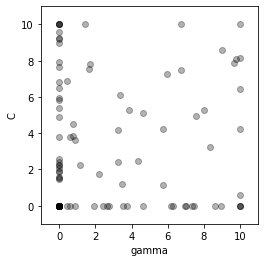

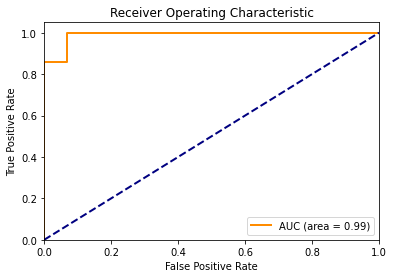

Accuracy for particle (in iteration 44, in fold 3) - 1 is 0.4828 At (gamma, c): [6.29580056e+00 1.00000000e-03]
Accuracy for particle (in iteration 44, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 44, in fold 3) - 3 is 0.8966 At (gamma, c): [5.74947109 4.20464947]
Accuracy for particle (in iteration 44, in fold 3) - 4 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 44, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 44, in fold 3) - 6 is 0.8966 At (gamma, c): [6.72350448 7.5026331 ]
Accuracy for particle (in iteration 44, in fold 3) - 7 is 0.7931 At (gamma, c): [1.00000000e-03 4.87273194e+00]
Accuracy for particle (in iteration 44, in fold 3) - 8 is 0.7931 At (gamma, c): [1.0000000e-03 1.5615855e+00]
Accuracy for particle (in iteration 44, in fold 3) - 9 is 0.7586 At (gamma, c): [1.00000000e-03 1.52266123e+00]
Accuracy for particle (in iteration 44, in fold 3) - 10 is 0.7

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 44, in fold 3) - 95 is 0.8621 At (gamma, c): [1.00000000e-03 7.65588907e+00]
Accuracy for particle (in iteration 44, in fold 3) - 96 is 0.8966 At (gamma, c): [8.31351077 3.2659261 ]
Accuracy for particle (in iteration 44, in fold 3) - 97 is 1.0000 At (gamma, c): [0.77575934 3.8254609 ]
Accuracy for particle (in iteration 44, in fold 3) - 98 is 0.9310 At (gamma, c): [4.64651286 5.10454843]
Accuracy for particle (in iteration 44, in fold 3) - 99 is 1.0000 At (gamma, c): [0.79272131 4.50046901]
Accuracy for particle (in iteration 44, in fold 3) - 100 is 0.8966 At (gamma, c): [10.          0.61650185]
The best position in iteration 44, fold 3 is [1.00000000e-03 7.09911398e+00], with Accuracy: 1.0000
Accuracy Score: 0.8621
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 4 10]]
Confusion Matrix (Train):
[[122   6]
 [ 23 106]]

Iteration 45 - Fold 3:



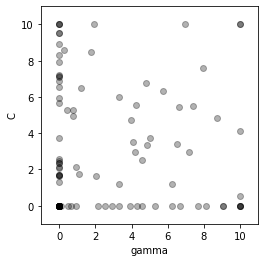

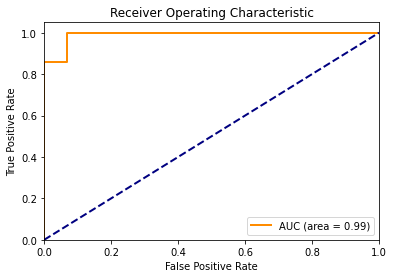

Accuracy for particle (in iteration 45, in fold 3) - 1 is 0.4828 At (gamma, c): [8.12718437e+00 1.00000000e-03]
Accuracy for particle (in iteration 45, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 45, in fold 3) - 3 is 0.9310 At (gamma, c): [5.01685251 3.70987112]
Accuracy for particle (in iteration 45, in fold 3) - 4 is 0.8621 At (gamma, c): [1.00000000e-03 7.09911398e+00]
Accuracy for particle (in iteration 45, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 45, in fold 3) - 6 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 45, in fold 3) - 7 is 0.7586 At (gamma, c): [1.00000000e-03 3.74984341e+00]
Accuracy for particle (in iteration 45, in fold 3) - 8 is 0.7931 At (gamma, c): [1.00000000e-03 1.67803099e+00]
Accuracy for particle (in iteration 45, in fold 3) - 9 is 0.7931 At (gamma, c): [1.00000000e-03 1.64746192e+00]
Accuracy for particle (in iteration 45, in fold 3) - 10 is

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 45, in fold 3) - 96 is 0.8966 At (gamma, c): [10.         4.1281914]
Accuracy for particle (in iteration 45, in fold 3) - 97 is 1.0000 At (gamma, c): [0.91036101 2.12946268]
Accuracy for particle (in iteration 45, in fold 3) - 98 is 0.8966 At (gamma, c): [5.73115439 6.33261821]
Accuracy for particle (in iteration 45, in fold 3) - 99 is 1.0000 At (gamma, c): [0.74587904 5.29152921]
Accuracy for particle (in iteration 45, in fold 3) - 100 is 0.8966 At (gamma, c): [10.          0.55081242]
The best position in iteration 45, fold 3 is [1.00000000e-03 5.61581665e+00], with Accuracy: 1.0000
Accuracy Score: 0.8621
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 4 10]]
Confusion Matrix (Train):
[[122   6]
 [ 27 102]]

Iteration 46 - Fold 3:



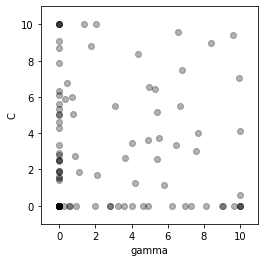

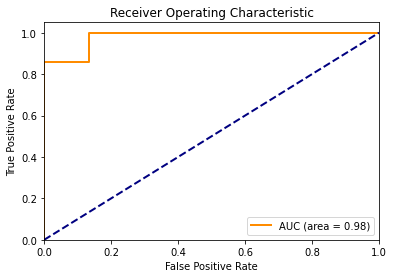

Accuracy for particle (in iteration 46, in fold 3) - 1 is 0.4828 At (gamma, c): [7.29326366e+00 1.00000000e-03]
Accuracy for particle (in iteration 46, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 46, in fold 3) - 3 is 0.9310 At (gamma, c): [4.8841012  3.62012736]
Accuracy for particle (in iteration 46, in fold 3) - 4 is 0.8276 At (gamma, c): [1.00000000e-03 5.61581665e+00]
Accuracy for particle (in iteration 46, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 46, in fold 3) - 6 is 0.8966 At (gamma, c): [8.3787772  8.95289987]
Accuracy for particle (in iteration 46, in fold 3) - 7 is 0.7586 At (gamma, c): [1.00000000e-03 3.32939012e+00]
Accuracy for particle (in iteration 46, in fold 3) - 8 is 0.7931 At (gamma, c): [1.00000000e-03 1.59072431e+00]
Accuracy for particle (in iteration 46, in fold 3) - 9 is 0.7586 At (gamma, c): [1.00000000e-03 1.52273313e+00]
Accuracy for particle (in iteration 46, in f

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 46, in fold 3) - 96 is 0.8966 At (gamma, c): [10.          4.14519177]
Accuracy for particle (in iteration 46, in fold 3) - 97 is 1.0000 At (gamma, c): [0.86162271 2.74357143]
Accuracy for particle (in iteration 46, in fold 3) - 98 is 0.8966 At (gamma, c): [6.76674601 7.50274351]
Accuracy for particle (in iteration 46, in fold 3) - 99 is 1.0000 At (gamma, c): [0.75932548 5.06444919]
Accuracy for particle (in iteration 46, in fold 3) - 100 is 0.8966 At (gamma, c): [10.          0.58951659]
The best position in iteration 46, fold 3 is [1.00000000e-03 8.13913091e+00], with Accuracy: 1.0000
Accuracy Score: 0.8276
F1 Score: 0.7826
Recall Score: 0.6429
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 5  9]]
Confusion Matrix (Train):
[[122   6]
 [ 32  97]]

Iteration 47 - Fold 3:



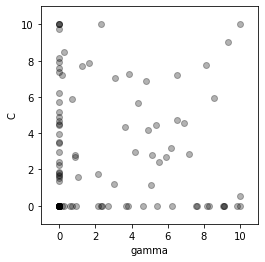

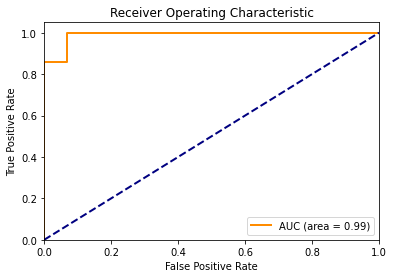

Accuracy for particle (in iteration 47, in fold 3) - 1 is 0.4828 At (gamma, c): [5.39696608e+00 1.00000000e-03]
Accuracy for particle (in iteration 47, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 47, in fold 3) - 3 is 0.8966 At (gamma, c): [6.52785615 4.7288918 ]
Accuracy for particle (in iteration 47, in fold 3) - 4 is 0.8621 At (gamma, c): [1.00000000e-03 8.13913091e+00]
Accuracy for particle (in iteration 47, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 47, in fold 3) - 6 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 47, in fold 3) - 7 is 0.7931 At (gamma, c): [1.00000000e-03 4.43136297e+00]
Accuracy for particle (in iteration 47, in fold 3) - 8 is 0.7931 At (gamma, c): [1.00000000e-03 1.67653366e+00]
Accuracy for particle (in iteration 47, in fold 3) - 9 is 0.7586 At (gamma, c): [1.00000000e-03 1.50427854e+00]
Accuracy for particle (in iteration 47, in fold 3) - 10 is

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 47, in fold 3) - 92 is 0.8966 At (gamma, c): [6.89766409 4.57545426]
Accuracy for particle (in iteration 47, in fold 3) - 93 is 0.4828 At (gamma, c): [7.53911553e+00 1.00000000e-03]
Accuracy for particle (in iteration 47, in fold 3) - 94 is 0.4828 At (gamma, c): [2.31714063e+00 1.00000000e-03]
Accuracy for particle (in iteration 47, in fold 3) - 95 is 0.8276 At (gamma, c): [1.00000000e-03 4.91743356e+00]
Accuracy for particle (in iteration 47, in fold 3) - 96 is 0.9310 At (gamma, c): [5.49612097 2.40730832]
Accuracy for particle (in iteration 47, in fold 3) - 97 is 1.0000 At (gamma, c): [0.86552837 2.69435962]
Accuracy for particle (in iteration 47, in fold 3) - 98 is 0.8966 At (gamma, c): [6.50285318 7.20665457]
Accuracy for particle (in iteration 47, in fold 3) - 99 is 1.0000 At (gamma, c): [0.89338706 2.8004519 ]
Accuracy for particle (in iteration 47, in fold 3) - 100 is 0.8966 At (gamma, c): [10.          0.53158162]
The best position in iterati

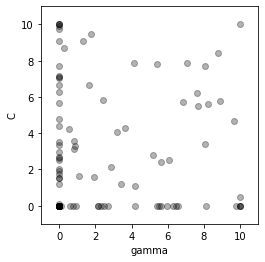

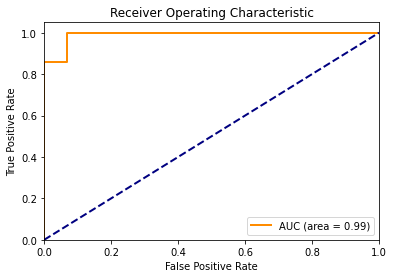

Accuracy for particle (in iteration 48, in fold 3) - 1 is 0.4828 At (gamma, c): [5.49659567e+00 1.00000000e-03]
Accuracy for particle (in iteration 48, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 48, in fold 3) - 3 is 0.8966 At (gamma, c): [7.66609337 5.49666118]
Accuracy for particle (in iteration 48, in fold 3) - 4 is 0.8621 At (gamma, c): [1.00000000e-03 7.73099453e+00]
Accuracy for particle (in iteration 48, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001      0.10218293]
Accuracy for particle (in iteration 48, in fold 3) - 6 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 48, in fold 3) - 7 is 0.7931 At (gamma, c): [1.00000000e-03 4.41756204e+00]
Accuracy for particle (in iteration 48, in fold 3) - 8 is 0.7586 At (gamma, c): [1.00000000e-03 1.50785364e+00]
Accuracy for particle (in iteration 48, in fold 3) - 9 is 0.7586 At (gamma, c): [1.00000000e-03 1.54045778e+00]
Accuracy for particle (in iteration 48, in fold 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 48, in fold 3) - 94 is 0.4828 At (gamma, c): [2.30181955e+00 1.00000000e-03]
Accuracy for particle (in iteration 48, in fold 3) - 95 is 0.8276 At (gamma, c): [1.00000000e-03 6.65465803e+00]
Accuracy for particle (in iteration 48, in fold 3) - 96 is 0.9310 At (gamma, c): [5.61770884 2.39492541]
Accuracy for particle (in iteration 48, in fold 3) - 97 is 1.0000 At (gamma, c): [0.83287828 3.10575499]
Accuracy for particle (in iteration 48, in fold 3) - 98 is 0.8966 At (gamma, c): [7.08564345 7.86473127]
Accuracy for particle (in iteration 48, in fold 3) - 99 is 1.0000 At (gamma, c): [0.84807985 3.5655883 ]
Accuracy for particle (in iteration 48, in fold 3) - 100 is 0.5862 At (gamma, c): [10.          0.46137031]
The best position in iteration 48, fold 3 is [1.00000000e-03 5.55202612e+00], with Accuracy: 1.0000
Accuracy Score: 0.8621
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 4 10]]
Confusion Matrix 

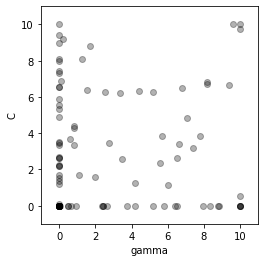

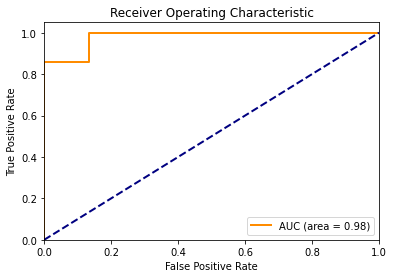

Accuracy for particle (in iteration 49, in fold 3) - 1 is 0.4828 At (gamma, c): [7.96399354e+00 1.00000000e-03]
Accuracy for particle (in iteration 49, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001      0.10811685]
Accuracy for particle (in iteration 49, in fold 3) - 3 is 0.8966 At (gamma, c): [9.40142053 6.66720939]
Accuracy for particle (in iteration 49, in fold 3) - 4 is 0.8276 At (gamma, c): [1.00000000e-03 5.55202612e+00]
Accuracy for particle (in iteration 49, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 49, in fold 3) - 6 is 0.8966 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 49, in fold 3) - 7 is 0.7586 At (gamma, c): [1.00000000e-03 3.34954506e+00]
Accuracy for particle (in iteration 49, in fold 3) - 8 is 0.7586 At (gamma, c): [1.00000000e-03 1.37431624e+00]
Accuracy for particle (in iteration 49, in fold 3) - 9 is 0.7586 At (gamma, c): [1.00000000e-03 1.52869181e+00]
Accuracy for particle (in iteration 49, in fold 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 49, in fold 3) - 94 is 0.4828 At (gamma, c): [2.41240284e+00 1.00000000e-03]
Accuracy for particle (in iteration 49, in fold 3) - 95 is 0.8276 At (gamma, c): [1.00000000e-03 6.52672828e+00]
Accuracy for particle (in iteration 49, in fold 3) - 96 is 0.9310 At (gamma, c): [5.54851322 2.35679588]
Accuracy for particle (in iteration 49, in fold 3) - 97 is 1.0000 At (gamma, c): [0.815156   3.32905791]
Accuracy for particle (in iteration 49, in fold 3) - 98 is 0.8966 At (gamma, c): [ 9.57299512 10.        ]
Accuracy for particle (in iteration 49, in fold 3) - 99 is 1.0000 At (gamma, c): [0.79835441 4.4053388 ]
Accuracy for particle (in iteration 49, in fold 3) - 100 is 0.5862 At (gamma, c): [10.         0.5227552]
The best position in iteration 49, fold 3 is [1.00000000e-03 7.11378166e+00], with Accuracy: 1.0000
Accuracy Score: 0.8276
F1 Score: 0.7826
Recall Score: 0.6429
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 5  9]]
Confusion Matrix 

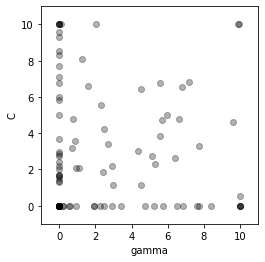

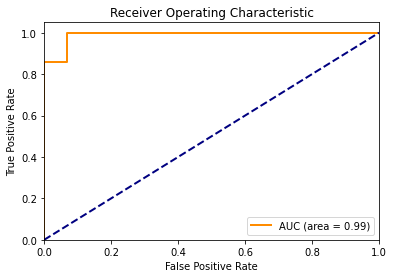

Accuracy for particle (in iteration 50, in fold 3) - 1 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 50, in fold 3) - 2 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 50, in fold 3) - 3 is 0.8966 At (gamma, c): [6.62738648 4.79595311]
Accuracy for particle (in iteration 50, in fold 3) - 4 is 0.8621 At (gamma, c): [1.00000000e-03 7.11378166e+00]
Accuracy for particle (in iteration 50, in fold 3) - 5 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 50, in fold 3) - 6 is 0.8966 At (gamma, c): [ 9.86988346 10.        ]
Accuracy for particle (in iteration 50, in fold 3) - 7 is 0.7931 At (gamma, c): [1.00000000e-03 2.83557321e+00]
Accuracy for particle (in iteration 50, in fold 3) - 8 is 0.7586 At (gamma, c): [1.00000000e-03 1.36713191e+00]
Accuracy for particle (in iteration 50, in fold 3) - 9 is 0.7586 At (gamma, c): [1.00000000e-03 1.54391151e+00]
Accuracy for particle (in iteration 50, in fold 3) - 10 is

Accuracy for particle (in iteration 50, in fold 3) - 88 is 0.7931 At (gamma, c): [1.0000000e-03 2.7230653e+00]
Accuracy for particle (in iteration 50, in fold 3) - 89 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 50, in fold 3) - 90 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 50, in fold 3) - 91 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 50, in fold 3) - 92 is 0.9310 At (gamma, c): [4.37018288 3.04317034]
Accuracy for particle (in iteration 50, in fold 3) - 93 is 0.4828 At (gamma, c): [4.74982568e+00 1.00000000e-03]
Accuracy for particle (in iteration 50, in fold 3) - 94 is 0.4828 At (gamma, c): [2.94463271e+00 1.00000000e-03]
Accuracy for particle (in iteration 50, in fold 3) - 95 is 0.8621 At (gamma, c): [1.0000000e-03 7.7344931e+00]
Accuracy for particle (in iteration 50, in fold 3) - 96 is 0.9310 At (gamma, c): [5.32047814 2.28277241]
Accuracy for particle (in iteration 50, in fold 3) - 97 i

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


The best position in iteration 50, fold 3 is [1.00000000e-03 8.35852757e+00], with Accuracy: 1.0000
Accuracy Score: 0.8621
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 4 10]]
Confusion Matrix (Train):
[[122   6]
 [ 27 102]]


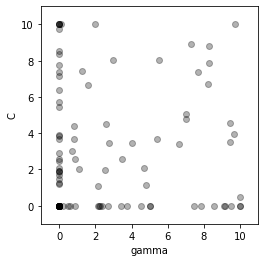

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.



Iteration 1 - Fold 4:



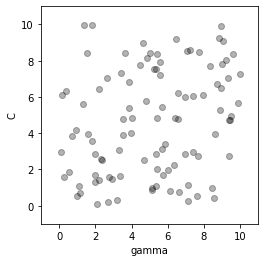

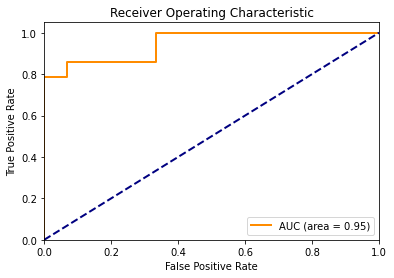

Accuracy for particle (in iteration 1, in fold 4) - 1 is 0.8276 At (gamma, c): [9.50604264 4.95881278]
Accuracy for particle (in iteration 1, in fold 4) - 2 is 0.8276 At (gamma, c): [9.39870271 4.70932298]
Accuracy for particle (in iteration 1, in fold 4) - 3 is 0.8276 At (gamma, c): [7.41425284 2.9356978 ]
Accuracy for particle (in iteration 1, in fold 4) - 4 is 0.8276 At (gamma, c): [7.2279384  8.61481036]
Accuracy for particle (in iteration 1, in fold 4) - 5 is 0.8276 At (gamma, c): [7.03809092 8.55336605]
Accuracy for particle (in iteration 1, in fold 4) - 6 is 0.8276 At (gamma, c): [1.11067435 1.08857841]
Accuracy for particle (in iteration 1, in fold 4) - 7 is 0.8276 At (gamma, c): [6.56956888 4.79897295]
Accuracy for particle (in iteration 1, in fold 4) - 8 is 0.8276 At (gamma, c): [7.09450605 1.14452466]
Accuracy for particle (in iteration 1, in fold 4) - 9 is 0.7931 At (gamma, c): [3.38051321 1.64618308]
Accuracy for particle (in iteration 1, in fold 4) - 10 is 0.7931 At (gamm

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 1, in fold 4) - 91 is 0.7931 At (gamma, c): [5.73321797 1.69826191]
Accuracy for particle (in iteration 1, in fold 4) - 92 is 0.8276 At (gamma, c): [1.132307   0.69081079]
Accuracy for particle (in iteration 1, in fold 4) - 93 is 0.7931 At (gamma, c): [2.00861616 2.86349235]
Accuracy for particle (in iteration 1, in fold 4) - 94 is 0.8276 At (gamma, c): [8.32842206 7.71144018]
Accuracy for particle (in iteration 1, in fold 4) - 95 is 0.7931 At (gamma, c): [0.38179221 6.31706113]
Accuracy for particle (in iteration 1, in fold 4) - 96 is 0.8276 At (gamma, c): [9.99050519 7.2443225 ]
Accuracy for particle (in iteration 1, in fold 4) - 97 is 0.7931 At (gamma, c): [2.0045709  1.29792511]
Accuracy for particle (in iteration 1, in fold 4) - 98 is 0.7931 At (gamma, c): [3.8822951  6.81619287]
Accuracy for particle (in iteration 1, in fold 4) - 99 is 0.8276 At (gamma, c): [8.87288312 5.30328326]
Accuracy for particle (in iteration 1, in fold 4) - 100 is 0.793

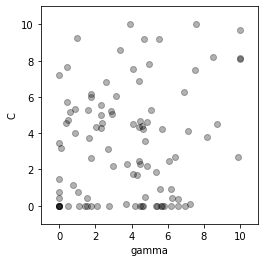

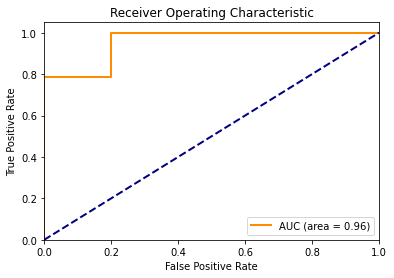

Accuracy for particle (in iteration 2, in fold 4) - 1 is 0.4828 At (gamma, c): [2.73341376e+00 1.00000000e-03]
Accuracy for particle (in iteration 2, in fold 4) - 2 is 0.8276 At (gamma, c): [10.          8.08130337]
Accuracy for particle (in iteration 2, in fold 4) - 3 is 0.4828 At (gamma, c): [7.21621702 0.10030121]
Accuracy for particle (in iteration 2, in fold 4) - 4 is 0.8276 At (gamma, c): [7.49976269 7.51520749]
Accuracy for particle (in iteration 2, in fold 4) - 5 is 0.7931 At (gamma, c): [4.7263666  3.57643968]
Accuracy for particle (in iteration 2, in fold 4) - 6 is 0.7931 At (gamma, c): [2.33486213 5.02458306]
Accuracy for particle (in iteration 2, in fold 4) - 7 is 0.4828 At (gamma, c): [5.64956459e+00 1.00000000e-03]
Accuracy for particle (in iteration 2, in fold 4) - 8 is 0.4828 At (gamma, c): [4.57882184e+00 1.00000000e-03]
Accuracy for particle (in iteration 2, in fold 4) - 9 is 0.4828 At (gamma, c): [6.1544776e+00 1.0000000e-03]
Accuracy for particle (in iteration 2, in

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 2, in fold 4) - 93 is 0.8276 At (gamma, c): [0.88150709 5.35526605]
Accuracy for particle (in iteration 2, in fold 4) - 94 is 0.7931 At (gamma, c): [6.2377523  0.44506739]
Accuracy for particle (in iteration 2, in fold 4) - 95 is 0.7931 At (gamma, c): [4.06898874 1.73231879]
Accuracy for particle (in iteration 2, in fold 4) - 96 is 0.7931 At (gamma, c): [1.55079064 0.44917925]
Accuracy for particle (in iteration 2, in fold 4) - 97 is 0.7931 At (gamma, c): [4.05786111 4.52416192]
Accuracy for particle (in iteration 2, in fold 4) - 98 is 0.8276 At (gamma, c): [6.39485232 2.67640632]
Accuracy for particle (in iteration 2, in fold 4) - 99 is 0.4828 At (gamma, c): [1.5227488e+00 1.0000000e-03]
Accuracy for particle (in iteration 2, in fold 4) - 100 is 0.7931 At (gamma, c): [0.39666445 4.57979496]
The best position in iteration 2, fold 4 is [ 0.49685326 10.        ], with Accuracy: 0.8966
Accuracy Score: 0.7931
F1 Score: 0.7857
Recall Score: 0.7857
Precisi

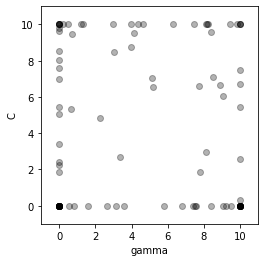

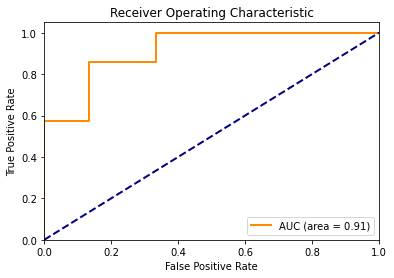

Accuracy for particle (in iteration 3, in fold 4) - 1 is 0.4828 At (gamma, c): [3.12935167e+00 1.00000000e-03]
Accuracy for particle (in iteration 3, in fold 4) - 2 is 0.8276 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 3, in fold 4) - 3 is 0.4828 At (gamma, c): [7.57204917e+00 1.00000000e-03]
Accuracy for particle (in iteration 3, in fold 4) - 4 is 0.8276 At (gamma, c): [9.05187623 6.02833508]
Accuracy for particle (in iteration 3, in fold 4) - 5 is 0.8276 At (gamma, c): [8.12451566 2.9404325 ]
Accuracy for particle (in iteration 3, in fold 4) - 6 is 0.7931 At (gamma, c): [ 4.6109644 10.       ]
Accuracy for particle (in iteration 3, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 3, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 3, in fold 4) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 3, in fold 4) - 10 is 0.4828 At (gamma, c): [7.37748764e+00 1

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 3, in fold 4) - 98 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 3, in fold 4) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 3, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 7.60543521e+00]
The best position in iteration 3, fold 4 is [ 0.60961401 10.        ], with Accuracy: 0.8966
Accuracy Score: 0.8276
F1 Score: 0.8148
Recall Score: 0.7857
Precision Score: 0.8462
Confusion Matrix (Test):
[[13  2]
 [ 3 11]]
Confusion Matrix (Train):
[[123   5]
 [ 31  98]]

Iteration 4 - Fold 4:



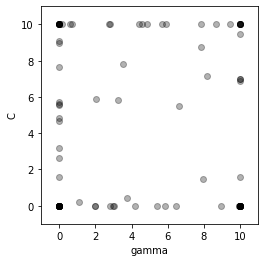

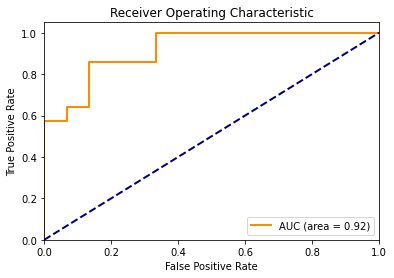

Accuracy for particle (in iteration 4, in fold 4) - 1 is 0.4828 At (gamma, c): [3.0310126e+00 1.0000000e-03]
Accuracy for particle (in iteration 4, in fold 4) - 2 is 0.8276 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 4, in fold 4) - 3 is 0.4828 At (gamma, c): [2.80867343e+00 1.00000000e-03]
Accuracy for particle (in iteration 4, in fold 4) - 4 is 0.7931 At (gamma, c): [3.7427801  0.41927978]
Accuracy for particle (in iteration 4, in fold 4) - 5 is 0.8276 At (gamma, c): [7.95937585 1.49513867]
Accuracy for particle (in iteration 4, in fold 4) - 6 is 0.7931 At (gamma, c): [ 5.70359735 10.        ]
Accuracy for particle (in iteration 4, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 4, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 4, in fold 4) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 4, in fold 4) - 10 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
A

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 4, in fold 4) - 92 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 4, in fold 4) - 93 is 0.8276 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 4, in fold 4) - 94 is 0.4828 At (gamma, c): [6.43990118e+00 1.00000000e-03]
Accuracy for particle (in iteration 4, in fold 4) - 95 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 4, in fold 4) - 96 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 4, in fold 4) - 97 is 0.8276 At (gamma, c): [ 9.96247337 10.        ]
Accuracy for particle (in iteration 4, in fold 4) - 98 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 4, in fold 4) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 4, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 9.06968875e+00]
The best position in iteration 4, fold 4 is [ 0.62127877 10.        ], with Accuracy: 0.8966
Accu

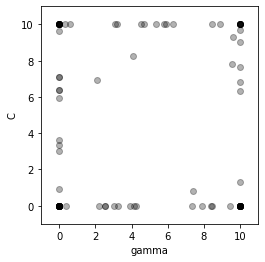

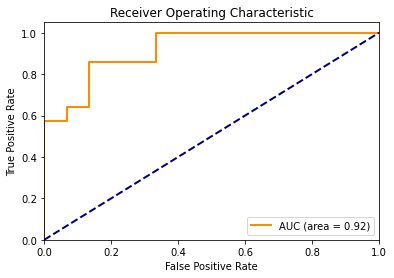

Accuracy for particle (in iteration 5, in fold 4) - 1 is 0.4828 At (gamma, c): [3.05595105e+00 1.00000000e-03]
Accuracy for particle (in iteration 5, in fold 4) - 2 is 0.8276 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 5, in fold 4) - 3 is 0.4828 At (gamma, c): [2.54597792e+00 1.00000000e-03]
Accuracy for particle (in iteration 5, in fold 4) - 4 is 0.4828 At (gamma, c): [4.16177689e+00 1.00000000e-03]
Accuracy for particle (in iteration 5, in fold 4) - 5 is 0.8276 At (gamma, c): [7.41040446 0.80781155]
Accuracy for particle (in iteration 5, in fold 4) - 6 is 0.7931 At (gamma, c): [ 5.88272129 10.        ]
Accuracy for particle (in iteration 5, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 5, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 5, in fold 4) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 5, in fold 4) - 10 is 0.4828 At (gamma, c): [1.e+01

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 5, in fold 4) - 94 is 0.4828 At (gamma, c): [7.34337511e+00 1.00000000e-03]
Accuracy for particle (in iteration 5, in fold 4) - 95 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 5, in fold 4) - 96 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 5, in fold 4) - 97 is 0.8276 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 5, in fold 4) - 98 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 5, in fold 4) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 5, in fold 4) - 100 is 0.8276 At (gamma, c): [1.e-03 1.e+01]
The best position in iteration 5, fold 4 is [ 0.58541008 10.        ], with Accuracy: 0.8966
Accuracy Score: 0.8276
F1 Score: 0.8148
Recall Score: 0.7857
Precision Score: 0.8462
Confusion Matrix (Test):
[[13  2]
 [ 3 11]]
Confusion Matrix (Train):
[[123   5]
 [ 31  98]]

Iteration 6 - Fold 4:



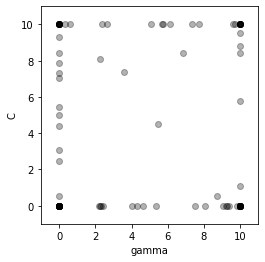

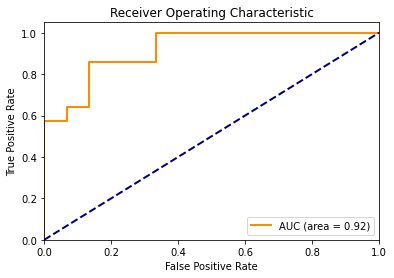

Accuracy for particle (in iteration 6, in fold 4) - 1 is 0.4828 At (gamma, c): [2.40756099e+00 1.00000000e-03]
Accuracy for particle (in iteration 6, in fold 4) - 2 is 0.8276 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 6, in fold 4) - 3 is 0.4828 At (gamma, c): [2.20000104e+00 1.00000000e-03]
Accuracy for particle (in iteration 6, in fold 4) - 4 is 0.4828 At (gamma, c): [4.32772937e+00 1.00000000e-03]
Accuracy for particle (in iteration 6, in fold 4) - 5 is 0.7931 At (gamma, c): [8.69409941 0.52090124]
Accuracy for particle (in iteration 6, in fold 4) - 6 is 0.8276 At (gamma, c): [ 7.33764929 10.        ]
Accuracy for particle (in iteration 6, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 6, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 6, in fold 4) - 9 is 0.4828 At (gamma, c): [9.79627922e+00 1.00000000e-03]
Accuracy for particle (in iteration 6, in fold 4) - 10 is 0.4828 At (ga

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 6, in fold 4) - 93 is 0.8276 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 6, in fold 4) - 94 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 6, in fold 4) - 95 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 6, in fold 4) - 96 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 6, in fold 4) - 97 is 0.8276 At (gamma, c): [ 9.62546337 10.        ]
Accuracy for particle (in iteration 6, in fold 4) - 98 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 6, in fold 4) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 6, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 7.30654679e+00]
The best position in iteration 6, fold 4 is [ 0.80521486 10.        ], with Accuracy: 0.8966
Accuracy Score: 0.8276
F1 Score: 0.8148
Recall Score: 0.7857
Precision Score: 0.8462
Confusion Matrix (Test):
[[13  

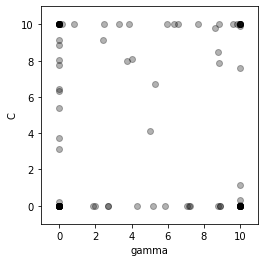

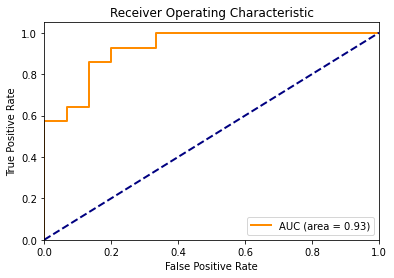

Accuracy for particle (in iteration 7, in fold 4) - 1 is 0.4828 At (gamma, c): [2.70786822e+00 1.00000000e-03]
Accuracy for particle (in iteration 7, in fold 4) - 2 is 0.8276 At (gamma, c): [ 9.79391477 10.        ]
Accuracy for particle (in iteration 7, in fold 4) - 3 is 0.4828 At (gamma, c): [2.72234916e+00 1.00000000e-03]
Accuracy for particle (in iteration 7, in fold 4) - 4 is 0.4828 At (gamma, c): [5.86962926e+00 1.00000000e-03]
Accuracy for particle (in iteration 7, in fold 4) - 5 is 0.5862 At (gamma, c): [9.95952296 0.31995291]
Accuracy for particle (in iteration 7, in fold 4) - 6 is 0.8276 At (gamma, c): [ 6.55358531 10.        ]
Accuracy for particle (in iteration 7, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 7, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 7, in fold 4) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 7, in fold 4) - 10 is 0.4828 At (ga

Accuracy for particle (in iteration 7, in fold 4) - 93 is 0.8276 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 7, in fold 4) - 94 is 0.4828 At (gamma, c): [7.23693921e+00 1.00000000e-03]
Accuracy for particle (in iteration 7, in fold 4) - 95 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 7, in fold 4) - 96 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 7, in fold 4) - 97 is 0.8276 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 7, in fold 4) - 98 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 7, in fold 4) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 7, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 9.15799635e+00]
The best position in iteration 7, fold 4 is [ 0.8188844 10.       ], with Accuracy: 0.8966
Accuracy Score: 0.8276
F1 Score: 0.8148
Recall Score: 0.7857
Precision Score: 0.8462
Confusion Matrix (Test):
[[13  2]

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


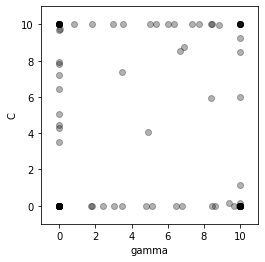

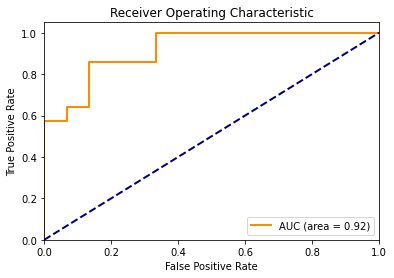

Accuracy for particle (in iteration 8, in fold 4) - 1 is 0.4828 At (gamma, c): [3.03313437e+00 1.00000000e-03]
Accuracy for particle (in iteration 8, in fold 4) - 2 is 0.8276 At (gamma, c): [ 8.36283607 10.        ]
Accuracy for particle (in iteration 8, in fold 4) - 3 is 0.4828 At (gamma, c): [2.43402656e+00 1.00000000e-03]
Accuracy for particle (in iteration 8, in fold 4) - 4 is 0.4828 At (gamma, c): [5.15052803e+00 1.00000000e-03]
Accuracy for particle (in iteration 8, in fold 4) - 5 is 0.5517 At (gamma, c): [10.          0.15670992]
Accuracy for particle (in iteration 8, in fold 4) - 6 is 0.8276 At (gamma, c): [ 7.31306479 10.        ]
Accuracy for particle (in iteration 8, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 8, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 8, in fold 4) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 8, in fold 4) - 10 is 0.4828 At (

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 8, in fold 4) - 89 is 0.8276 At (gamma, c): [1.00000000e-03 3.51236486e+00]
Accuracy for particle (in iteration 8, in fold 4) - 90 is 0.8276 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 8, in fold 4) - 91 is 0.5517 At (gamma, c): [9.35873703 0.17509617]
Accuracy for particle (in iteration 8, in fold 4) - 92 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 8, in fold 4) - 93 is 0.8276 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 8, in fold 4) - 94 is 0.4828 At (gamma, c): [6.46613991e+00 1.00000000e-03]
Accuracy for particle (in iteration 8, in fold 4) - 95 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 8, in fold 4) - 96 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 8, in fold 4) - 97 is 0.8276 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 8, in fold 4) - 98 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy

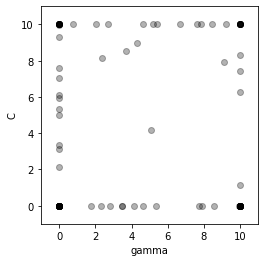

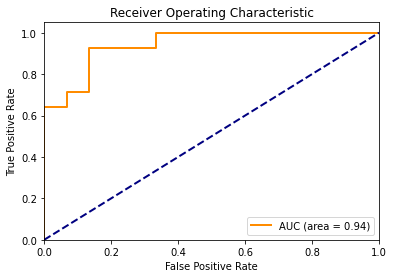

Accuracy for particle (in iteration 9, in fold 4) - 1 is 0.4828 At (gamma, c): [3.48616686e+00 1.00000000e-03]
Accuracy for particle (in iteration 9, in fold 4) - 2 is 0.8276 At (gamma, c): [ 9.23894966 10.        ]
Accuracy for particle (in iteration 9, in fold 4) - 3 is 0.4828 At (gamma, c): [2.81797463e+00 1.00000000e-03]
Accuracy for particle (in iteration 9, in fold 4) - 4 is 0.4828 At (gamma, c): [5.366044e+00 1.000000e-03]
Accuracy for particle (in iteration 9, in fold 4) - 5 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 9, in fold 4) - 6 is 0.8276 At (gamma, c): [ 9.9746897 10.       ]
Accuracy for particle (in iteration 9, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 9, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 9, in fold 4) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 9, in fold 4) - 10 is 0.4828 At (gamma, c): [1.e+

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 9, in fold 4) - 93 is 0.8276 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 9, in fold 4) - 94 is 0.4828 At (gamma, c): [8.57567436e+00 1.00000000e-03]
Accuracy for particle (in iteration 9, in fold 4) - 95 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 9, in fold 4) - 96 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 9, in fold 4) - 97 is 0.8276 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 9, in fold 4) - 98 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 9, in fold 4) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 9, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 5.95259853e+00]
The best position in iteration 9, fold 4 is [ 0.25428942 10.        ], with Accuracy: 0.9310
Accuracy Score: 0.8276
F1 Score: 0.8148
Recall Score: 0.7857
Precision Score: 0.8462
Confusion Matrix (Test):
[[13  

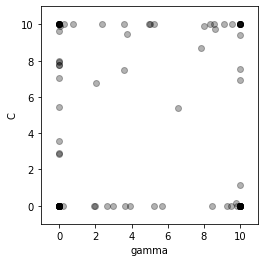

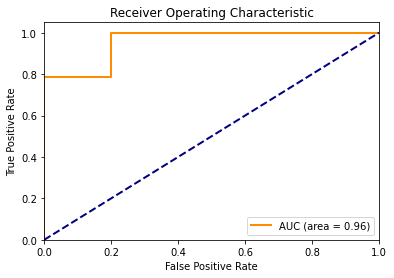

Accuracy for particle (in iteration 10, in fold 4) - 1 is 0.4828 At (gamma, c): [3.90181584e+00 1.00000000e-03]
Accuracy for particle (in iteration 10, in fold 4) - 2 is 0.8276 At (gamma, c): [ 9.52113733 10.        ]
Accuracy for particle (in iteration 10, in fold 4) - 3 is 0.4828 At (gamma, c): [2.62589603e+00 1.00000000e-03]
Accuracy for particle (in iteration 10, in fold 4) - 4 is 0.4828 At (gamma, c): [5.67488483e+00 1.00000000e-03]
Accuracy for particle (in iteration 10, in fold 4) - 5 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 10, in fold 4) - 6 is 0.8276 At (gamma, c): [ 8.56969042 10.        ]
Accuracy for particle (in iteration 10, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 10, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 10, in fold 4) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 10, in fold 4) - 10 is 0.4828 At (

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 10, in fold 4) - 97 is 0.8276 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 10, in fold 4) - 98 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 10, in fold 4) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 10, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 7.95201649e+00]
The best position in iteration 10, fold 4 is [ 0.28561412 10.        ], with Accuracy: 0.9310
Accuracy Score: 0.8276
F1 Score: 0.8276
Recall Score: 0.8571
Precision Score: 0.8000
Confusion Matrix (Test):
[[12  3]
 [ 2 12]]
Confusion Matrix (Train):
[[128   0]
 [  0 129]]

Iteration 11 - Fold 4:



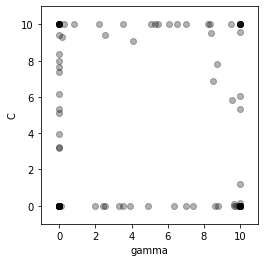

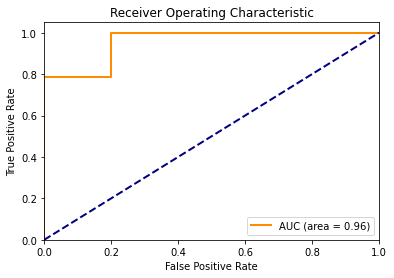

Accuracy for particle (in iteration 11, in fold 4) - 1 is 0.4828 At (gamma, c): [4.90053479e+00 1.00000000e-03]
Accuracy for particle (in iteration 11, in fold 4) - 2 is 0.8276 At (gamma, c): [ 8.24091922 10.        ]
Accuracy for particle (in iteration 11, in fold 4) - 3 is 0.4828 At (gamma, c): [2.54723517e+00 1.00000000e-03]
Accuracy for particle (in iteration 11, in fold 4) - 4 is 0.4828 At (gamma, c): [3.30079068e+00 1.00000000e-03]
Accuracy for particle (in iteration 11, in fold 4) - 5 is 0.4828 At (gamma, c): [9.64916821 0.09246601]
Accuracy for particle (in iteration 11, in fold 4) - 6 is 0.8276 At (gamma, c): [ 7.0073643 10.       ]
Accuracy for particle (in iteration 11, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 11, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 11, in fold 4) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 11, in fold 4) - 10 is 0.482

Accuracy for particle (in iteration 11, in fold 4) - 88 is 0.8276 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 11, in fold 4) - 89 is 0.8276 At (gamma, c): [1.00000000e-03 3.15734802e+00]
Accuracy for particle (in iteration 11, in fold 4) - 90 is 0.8276 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 11, in fold 4) - 91 is 0.5172 At (gamma, c): [10.          0.13845744]
Accuracy for particle (in iteration 11, in fold 4) - 92 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 11, in fold 4) - 93 is 0.8276 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 11, in fold 4) - 94 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 11, in fold 4) - 95 is 0.4828 At (gamma, c): [9.94572059e+00 1.00000000e-03]
Accuracy for particle (in iteration 11, in fold 4) - 96 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 11, in fold 4) - 97 is 0.8276 At (gamma, c): [10. 1

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


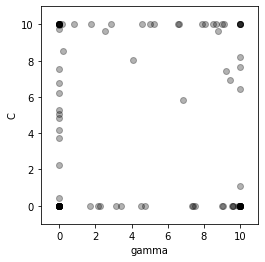

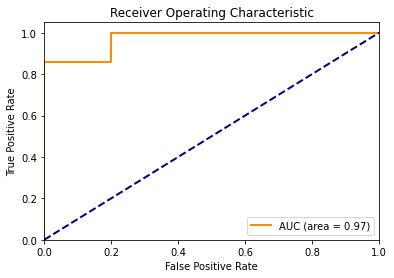

Accuracy for particle (in iteration 12, in fold 4) - 1 is 0.4828 At (gamma, c): [3.1500215e+00 1.0000000e-03]
Accuracy for particle (in iteration 12, in fold 4) - 2 is 0.8276 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 12, in fold 4) - 3 is 0.4828 At (gamma, c): [2.15564959e+00 1.00000000e-03]
Accuracy for particle (in iteration 12, in fold 4) - 4 is 0.4828 At (gamma, c): [3.40450568e+00 1.00000000e-03]
Accuracy for particle (in iteration 12, in fold 4) - 5 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 12, in fold 4) - 6 is 0.8276 At (gamma, c): [ 7.86267944 10.        ]
Accuracy for particle (in iteration 12, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 12, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 12, in fold 4) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 12, in fold 4) - 10 is 0.4828 At (gamma, c): [1.e+01

Accuracy for particle (in iteration 12, in fold 4) - 85 is 0.4828 At (gamma, c): [7.41612387e+00 1.00000000e-03]
Accuracy for particle (in iteration 12, in fold 4) - 86 is 0.8276 At (gamma, c): [ 6.60005062 10.        ]
Accuracy for particle (in iteration 12, in fold 4) - 87 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 12, in fold 4) - 88 is 0.8276 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 12, in fold 4) - 89 is 0.7931 At (gamma, c): [1.00000000e-03 2.26764864e+00]
Accuracy for particle (in iteration 12, in fold 4) - 90 is 0.8276 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 12, in fold 4) - 91 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 12, in fold 4) - 92 is 0.4828 At (gamma, c): [9.61739121e+00 1.00000000e-03]
Accuracy for particle (in iteration 12, in fold 4) - 93 is 0.8276 At (gamma, c): [1.00000000e-03 9.75481939e+00]
Accuracy for particle (in iteration 12, in fold 4) - 94

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


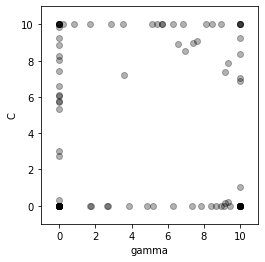

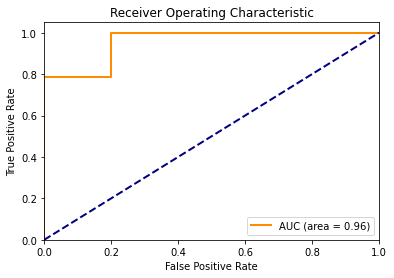

Accuracy for particle (in iteration 13, in fold 4) - 1 is 0.4828 At (gamma, c): [2.6394538e+00 1.0000000e-03]
Accuracy for particle (in iteration 13, in fold 4) - 2 is 0.8276 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 13, in fold 4) - 3 is 0.4828 At (gamma, c): [2.70005472e+00 1.00000000e-03]
Accuracy for particle (in iteration 13, in fold 4) - 4 is 0.4828 At (gamma, c): [3.84183007e+00 1.00000000e-03]
Accuracy for particle (in iteration 13, in fold 4) - 5 is 0.5172 At (gamma, c): [9.14569558 0.14262468]
Accuracy for particle (in iteration 13, in fold 4) - 6 is 0.7931 At (gamma, c): [ 5.68677244 10.        ]
Accuracy for particle (in iteration 13, in fold 4) - 7 is 0.4828 At (gamma, c): [9.44118211e+00 1.00000000e-03]
Accuracy for particle (in iteration 13, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 13, in fold 4) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 13, in fold 4) - 10 is 0.482

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 13, in fold 4) - 94 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 13, in fold 4) - 95 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 13, in fold 4) - 96 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 13, in fold 4) - 97 is 0.8276 At (gamma, c): [6.57576195 8.92237755]
Accuracy for particle (in iteration 13, in fold 4) - 98 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 13, in fold 4) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 13, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 6.04909165e+00]
The best position in iteration 13, fold 4 is [1.e-03 1.e+01], with Accuracy: 0.9310
Accuracy Score: 0.8276
F1 Score: 0.8276
Recall Score: 0.8571
Precision Score: 0.8000
Confusion Matrix (Test):
[[12  3]
 [ 2 12]]
Confusion Matrix (Train):
[[128   0]
 [  0 129]]

Iteration 14 - Fold 4:



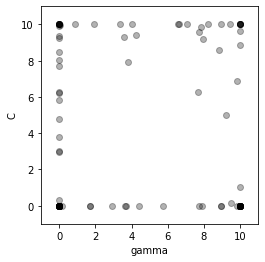

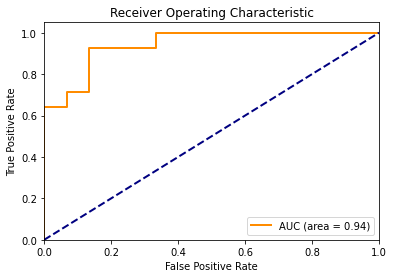

Accuracy for particle (in iteration 14, in fold 4) - 1 is 0.4828 At (gamma, c): [3.6215762e+00 1.0000000e-03]
Accuracy for particle (in iteration 14, in fold 4) - 2 is 0.8276 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 14, in fold 4) - 3 is 0.4828 At (gamma, c): [2.90617112e+00 1.00000000e-03]
Accuracy for particle (in iteration 14, in fold 4) - 4 is 0.4828 At (gamma, c): [3.66892817e+00 1.00000000e-03]
Accuracy for particle (in iteration 14, in fold 4) - 5 is 0.5172 At (gamma, c): [9.49146668 0.14084024]
Accuracy for particle (in iteration 14, in fold 4) - 6 is 0.8276 At (gamma, c): [ 8.21778206 10.        ]
Accuracy for particle (in iteration 14, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 14, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 14, in fold 4) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 14, in fold 4) - 10 is 0.4828 At (gamma, c):

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 14, in fold 4) - 97 is 0.8276 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 14, in fold 4) - 98 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 14, in fold 4) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 14, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 7.73229816e+00]
The best position in iteration 14, fold 4 is [ 0.09582718 10.        ], with Accuracy: 0.9310
Accuracy Score: 0.8276
F1 Score: 0.8148
Recall Score: 0.7857
Precision Score: 0.8462
Confusion Matrix (Test):
[[13  2]
 [ 3 11]]
Confusion Matrix (Train):
[[123   5]
 [ 22 107]]

Iteration 15 - Fold 4:



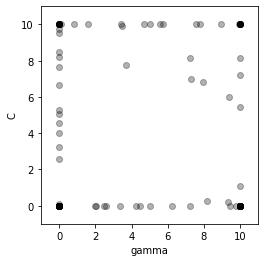

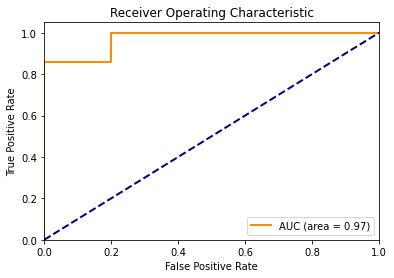

Accuracy for particle (in iteration 15, in fold 4) - 1 is 0.4828 At (gamma, c): [2.48084142e+00 1.00000000e-03]
Accuracy for particle (in iteration 15, in fold 4) - 2 is 0.8276 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 15, in fold 4) - 3 is 0.4828 At (gamma, c): [2.59605478e+00 1.00000000e-03]
Accuracy for particle (in iteration 15, in fold 4) - 4 is 0.4828 At (gamma, c): [3.33739464e+00 1.00000000e-03]
Accuracy for particle (in iteration 15, in fold 4) - 5 is 0.5862 At (gamma, c): [8.17794039 0.28102045]
Accuracy for particle (in iteration 15, in fold 4) - 6 is 0.7931 At (gamma, c): [ 5.75947996 10.        ]
Accuracy for particle (in iteration 15, in fold 4) - 7 is 0.4828 At (gamma, c): [9.76949201e+00 1.00000000e-03]
Accuracy for particle (in iteration 15, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 15, in fold 4) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 15, in fold 4) - 10 is 0.4

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 15, in fold 4) - 91 is 0.5517 At (gamma, c): [9.30943517 0.19263091]
Accuracy for particle (in iteration 15, in fold 4) - 92 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 15, in fold 4) - 93 is 0.8276 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 15, in fold 4) - 94 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 15, in fold 4) - 95 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 15, in fold 4) - 96 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 15, in fold 4) - 97 is 0.8276 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 15, in fold 4) - 98 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 15, in fold 4) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 15, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 4.56986282e+00]
The best positi

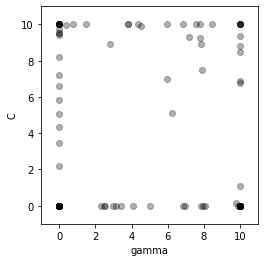

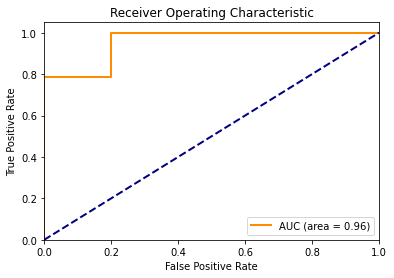

Accuracy for particle (in iteration 16, in fold 4) - 1 is 0.4828 At (gamma, c): [3.16424551e+00 1.00000000e-03]
Accuracy for particle (in iteration 16, in fold 4) - 2 is 0.8276 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 16, in fold 4) - 3 is 0.4828 At (gamma, c): [2.55465945e+00 1.00000000e-03]
Accuracy for particle (in iteration 16, in fold 4) - 4 is 0.4828 At (gamma, c): [2.95879438e+00 1.00000000e-03]
Accuracy for particle (in iteration 16, in fold 4) - 5 is 0.5172 At (gamma, c): [9.74795161 0.15041265]
Accuracy for particle (in iteration 16, in fold 4) - 6 is 0.8276 At (gamma, c): [ 6.85701299 10.        ]
Accuracy for particle (in iteration 16, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 16, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 16, in fold 4) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 16, in fold 4) - 10 is 0.4828 At (gamma, c

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 16, in fold 4) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 16, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 4.36197808e+00]
The best position in iteration 16, fold 4 is [ 0.42815298 10.        ], with Accuracy: 0.9310
Accuracy Score: 0.8276
F1 Score: 0.8276
Recall Score: 0.8571
Precision Score: 0.8000
Confusion Matrix (Test):
[[12  3]
 [ 2 12]]
Confusion Matrix (Train):
[[128   0]
 [  0 129]]

Iteration 17 - Fold 4:



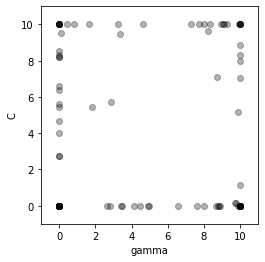

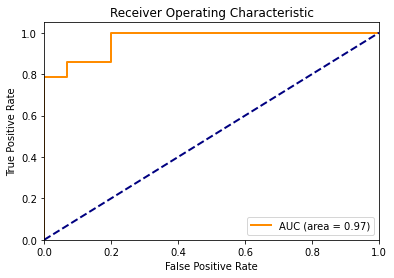

Accuracy for particle (in iteration 17, in fold 4) - 1 is 0.4828 At (gamma, c): [3.48623344e+00 1.00000000e-03]
Accuracy for particle (in iteration 17, in fold 4) - 2 is 0.8276 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 17, in fold 4) - 3 is 0.4828 At (gamma, c): [3.41376027e+00 1.00000000e-03]
Accuracy for particle (in iteration 17, in fold 4) - 4 is 0.4828 At (gamma, c): [4.13827073e+00 1.00000000e-03]
Accuracy for particle (in iteration 17, in fold 4) - 5 is 0.5517 At (gamma, c): [9.75017454 0.15659081]
Accuracy for particle (in iteration 17, in fold 4) - 6 is 0.8276 At (gamma, c): [ 7.25400093 10.        ]
Accuracy for particle (in iteration 17, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 17, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 17, in fold 4) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 17, in fold 4) - 10 is 0.4828 At (gamma, c

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 17, in fold 4) - 94 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 17, in fold 4) - 95 is 0.4828 At (gamma, c): [8.81994294e+00 1.00000000e-03]
Accuracy for particle (in iteration 17, in fold 4) - 96 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 17, in fold 4) - 97 is 0.8276 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 17, in fold 4) - 98 is 0.4828 At (gamma, c): [8.63642431e+00 1.00000000e-03]
Accuracy for particle (in iteration 17, in fold 4) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 17, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 6.61920396e+00]
The best position in iteration 17, fold 4 is [0.50013088 9.08466995], with Accuracy: 0.9310
Accuracy Score: 0.8276
F1 Score: 0.8276
Recall Score: 0.8571
Precision Score: 0.8000
Confusion Matrix (Test):
[[12  3]
 [ 2 12]]
Confusion Matrix (Train):
[[128   0]
 [  0 129]]

Iteration 1

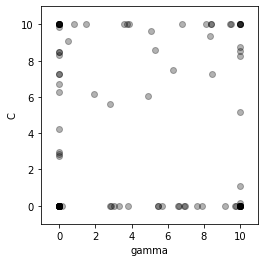

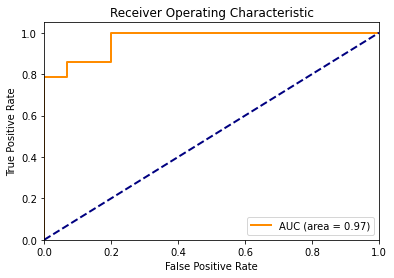

Accuracy for particle (in iteration 18, in fold 4) - 1 is 0.4828 At (gamma, c): [3.03688987e+00 1.00000000e-03]
Accuracy for particle (in iteration 18, in fold 4) - 2 is 0.8276 At (gamma, c): [ 8.08291472 10.        ]
Accuracy for particle (in iteration 18, in fold 4) - 3 is 0.4828 At (gamma, c): [3.81769806e+00 1.00000000e-03]
Accuracy for particle (in iteration 18, in fold 4) - 4 is 0.4828 At (gamma, c): [5.69872537e+00 1.00000000e-03]
Accuracy for particle (in iteration 18, in fold 4) - 5 is 0.4828 At (gamma, c): [10.          0.12930545]
Accuracy for particle (in iteration 18, in fold 4) - 6 is 0.8276 At (gamma, c): [ 8.36261128 10.        ]
Accuracy for particle (in iteration 18, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 18, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 18, in fold 4) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 18, in fold 4) - 10 is 0

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 18, in fold 4) - 97 is 0.8276 At (gamma, c): [ 8.38320298 10.        ]
Accuracy for particle (in iteration 18, in fold 4) - 98 is 0.4828 At (gamma, c): [7.86211128e+00 1.00000000e-03]
Accuracy for particle (in iteration 18, in fold 4) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 18, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 8.46369956e+00]
The best position in iteration 18, fold 4 is [ 0.42423979 10.        ], with Accuracy: 0.9310
Accuracy Score: 0.8966
F1 Score: 0.8889
Recall Score: 0.8571
Precision Score: 0.9231
Confusion Matrix (Test):
[[14  1]
 [ 2 12]]
Confusion Matrix (Train):
[[128   0]
 [  0 129]]

Iteration 19 - Fold 4:



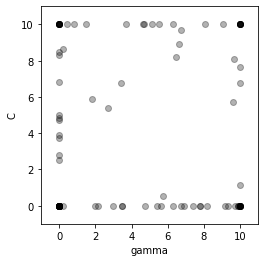

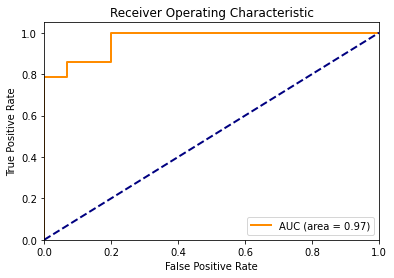

Accuracy for particle (in iteration 19, in fold 4) - 1 is 0.4828 At (gamma, c): [2.97978162e+00 1.00000000e-03]
Accuracy for particle (in iteration 19, in fold 4) - 2 is 0.8276 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 19, in fold 4) - 3 is 0.4828 At (gamma, c): [3.4718365e+00 1.0000000e-03]
Accuracy for particle (in iteration 19, in fold 4) - 4 is 0.4828 At (gamma, c): [6.72129194e+00 1.00000000e-03]
Accuracy for particle (in iteration 19, in fold 4) - 5 is 0.7931 At (gamma, c): [5.73697983 0.51195012]
Accuracy for particle (in iteration 19, in fold 4) - 6 is 0.8276 At (gamma, c): [ 6.28696826 10.        ]
Accuracy for particle (in iteration 19, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 19, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 19, in fold 4) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 19, in fold 4) - 10 is 0.4828 At (gamma, c):

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 19, in fold 4) - 98 is 0.4828 At (gamma, c): [9.71005983e+00 1.00000000e-03]
Accuracy for particle (in iteration 19, in fold 4) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 19, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 6.80081394e+00]
The best position in iteration 19, fold 4 is [ 0.31988165 10.        ], with Accuracy: 0.9310
Accuracy Score: 0.8276
F1 Score: 0.8276
Recall Score: 0.8571
Precision Score: 0.8000
Confusion Matrix (Test):
[[12  3]
 [ 2 12]]
Confusion Matrix (Train):
[[128   0]
 [  0 129]]

Iteration 20 - Fold 4:



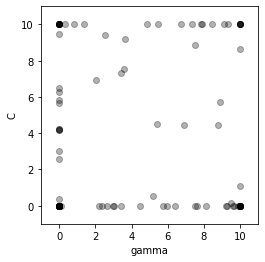

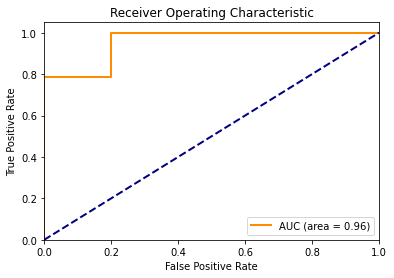

Accuracy for particle (in iteration 20, in fold 4) - 1 is 0.4828 At (gamma, c): [3.02996214e+00 1.00000000e-03]
Accuracy for particle (in iteration 20, in fold 4) - 2 is 0.8276 At (gamma, c): [ 9.11112263 10.        ]
Accuracy for particle (in iteration 20, in fold 4) - 3 is 0.4828 At (gamma, c): [2.66384761e+00 1.00000000e-03]
Accuracy for particle (in iteration 20, in fold 4) - 4 is 0.4828 At (gamma, c): [3.39970524e+00 1.00000000e-03]
Accuracy for particle (in iteration 20, in fold 4) - 5 is 0.8276 At (gamma, c): [5.20519628 0.56034642]
Accuracy for particle (in iteration 20, in fold 4) - 6 is 0.8276 At (gamma, c): [ 7.35260877 10.        ]
Accuracy for particle (in iteration 20, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 20, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 20, in fold 4) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 20, in fold 4) - 10 is 0.4

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 20, in fold 4) - 98 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 20, in fold 4) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 20, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 4.24155574e+00]
The best position in iteration 20, fold 4 is [ 0.39614161 10.        ], with Accuracy: 0.9310
Accuracy Score: 0.8276
F1 Score: 0.8276
Recall Score: 0.8571
Precision Score: 0.8000
Confusion Matrix (Test):
[[12  3]
 [ 2 12]]
Confusion Matrix (Train):
[[128   0]
 [  0 129]]

Iteration 21 - Fold 4:



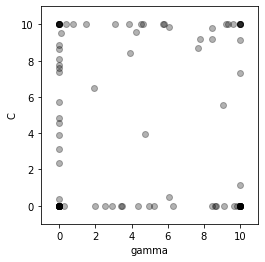

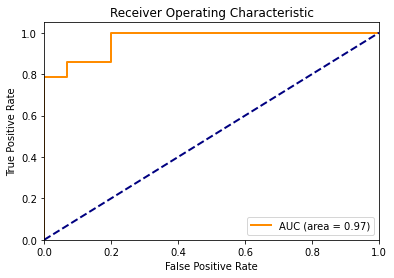

Accuracy for particle (in iteration 21, in fold 4) - 1 is 0.4828 At (gamma, c): [2.9032571e+00 1.0000000e-03]
Accuracy for particle (in iteration 21, in fold 4) - 2 is 0.8276 At (gamma, c): [ 9.22855642 10.        ]
Accuracy for particle (in iteration 21, in fold 4) - 3 is 0.4828 At (gamma, c): [3.41800017e+00 1.00000000e-03]
Accuracy for particle (in iteration 21, in fold 4) - 4 is 0.4828 At (gamma, c): [4.37313218e+00 1.00000000e-03]
Accuracy for particle (in iteration 21, in fold 4) - 5 is 0.7931 At (gamma, c): [6.06962989 0.4859466 ]
Accuracy for particle (in iteration 21, in fold 4) - 6 is 0.7931 At (gamma, c): [ 4.6382688 10.       ]
Accuracy for particle (in iteration 21, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 21, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 21, in fold 4) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 21, in fold 4) - 10 is 0.4828 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 21, in fold 4) - 93 is 0.8276 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 21, in fold 4) - 94 is 0.4828 At (gamma, c): [9.79232669e+00 1.00000000e-03]
Accuracy for particle (in iteration 21, in fold 4) - 95 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 21, in fold 4) - 96 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 21, in fold 4) - 97 is 0.8276 At (gamma, c): [ 9.31431886 10.        ]
Accuracy for particle (in iteration 21, in fold 4) - 98 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 21, in fold 4) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 21, in fold 4) - 100 is 0.8276 At (gamma, c): [1.000000e-03 3.923802e+00]
The best position in iteration 21, fold 4 is [0.46804211 9.47408134], with Accuracy: 0.9310
Accuracy Score: 0.8276
F1 Score: 0.8276
Recall Score: 0.8571
Precision Score: 0.8000
Confusion Ma

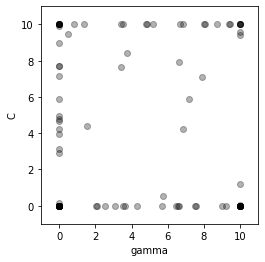

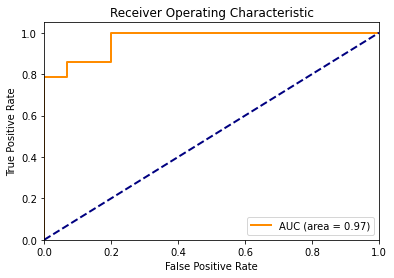

Accuracy for particle (in iteration 22, in fold 4) - 1 is 0.4828 At (gamma, c): [3.11221811e+00 1.00000000e-03]
Accuracy for particle (in iteration 22, in fold 4) - 2 is 0.8276 At (gamma, c): [ 8.01860227 10.        ]
Accuracy for particle (in iteration 22, in fold 4) - 3 is 0.4828 At (gamma, c): [2.53170545e+00 1.00000000e-03]
Accuracy for particle (in iteration 22, in fold 4) - 4 is 0.4828 At (gamma, c): [5.68748561e+00 1.00000000e-03]
Accuracy for particle (in iteration 22, in fold 4) - 5 is 0.7931 At (gamma, c): [5.74980964 0.51388159]
Accuracy for particle (in iteration 22, in fold 4) - 6 is 0.8276 At (gamma, c): [ 6.84599506 10.        ]
Accuracy for particle (in iteration 22, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 22, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 22, in fold 4) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 22, in fold 4) - 10 is 0.4

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 22, in fold 4) - 96 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 22, in fold 4) - 97 is 0.8276 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 22, in fold 4) - 98 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 22, in fold 4) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 22, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 4.95494399e+00]
The best position in iteration 22, fold 4 is [ 0.21699769 10.        ], with Accuracy: 0.9310
Accuracy Score: 0.8966
F1 Score: 0.8889
Recall Score: 0.8571
Precision Score: 0.9231
Confusion Matrix (Test):
[[14  1]
 [ 2 12]]
Confusion Matrix (Train):
[[128   0]
 [  0 129]]

Iteration 23 - Fold 4:



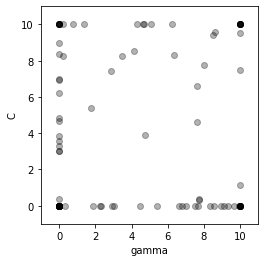

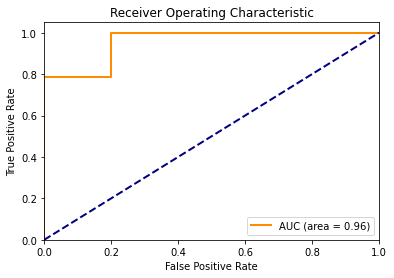

Accuracy for particle (in iteration 23, in fold 4) - 1 is 0.4828 At (gamma, c): [2.29916795e+00 1.00000000e-03]
Accuracy for particle (in iteration 23, in fold 4) - 2 is 0.8276 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 23, in fold 4) - 3 is 0.4828 At (gamma, c): [3.03440982e+00 1.00000000e-03]
Accuracy for particle (in iteration 23, in fold 4) - 4 is 0.4828 At (gamma, c): [6.99046235e+00 1.00000000e-03]
Accuracy for particle (in iteration 23, in fold 4) - 5 is 0.7931 At (gamma, c): [7.74943083 0.34086651]
Accuracy for particle (in iteration 23, in fold 4) - 6 is 0.7931 At (gamma, c): [ 4.70948935 10.        ]
Accuracy for particle (in iteration 23, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 23, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 23, in fold 4) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 23, in fold 4) - 10 is 0.4828 At (gamma, c

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 23, in fold 4) - 94 is 0.4828 At (gamma, c): [6.77599305e+00 1.00000000e-03]
Accuracy for particle (in iteration 23, in fold 4) - 95 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 23, in fold 4) - 96 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 23, in fold 4) - 97 is 0.8276 At (gamma, c): [6.36132694 8.30578174]
Accuracy for particle (in iteration 23, in fold 4) - 98 is 0.4828 At (gamma, c): [8.34316097e+00 1.00000000e-03]
Accuracy for particle (in iteration 23, in fold 4) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 23, in fold 4) - 100 is 0.8276 At (gamma, c): [1.0000000e-03 6.9810798e+00]
The best position in iteration 23, fold 4 is [ 0.35269676 10.        ], with Accuracy: 0.9310
Accuracy Score: 0.8276
F1 Score: 0.8276
Recall Score: 0.8571
Precision Score: 0.8000
Confusion Matrix (Test):
[[12  3]
 [ 2 12]]
Confusion Matrix (Train):
[[128   0]
 [  0 129]

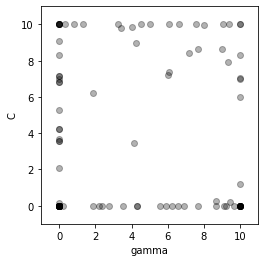

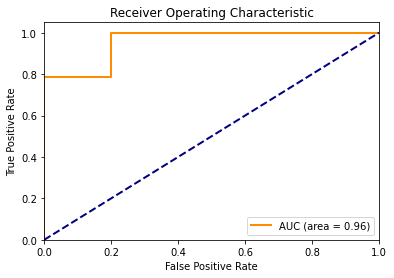

Accuracy for particle (in iteration 24, in fold 4) - 1 is 0.4828 At (gamma, c): [2.2228769e+00 1.0000000e-03]
Accuracy for particle (in iteration 24, in fold 4) - 2 is 0.8276 At (gamma, c): [8.01142115 9.95555496]
Accuracy for particle (in iteration 24, in fold 4) - 3 is 0.4828 At (gamma, c): [3.50238083e+00 1.00000000e-03]
Accuracy for particle (in iteration 24, in fold 4) - 4 is 0.4828 At (gamma, c): [4.30960696e+00 1.00000000e-03]
Accuracy for particle (in iteration 24, in fold 4) - 5 is 0.5517 At (gamma, c): [9.40954581 0.1972248 ]
Accuracy for particle (in iteration 24, in fold 4) - 6 is 0.7931 At (gamma, c): [3.99952974 9.84392701]
Accuracy for particle (in iteration 24, in fold 4) - 7 is 0.4828 At (gamma, c): [9.12298694e+00 1.00000000e-03]
Accuracy for particle (in iteration 24, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 24, in fold 4) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 24, in fold 4) -

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 24, in fold 4) - 91 is 0.5862 At (gamma, c): [8.63821923 0.28255559]
Accuracy for particle (in iteration 24, in fold 4) - 92 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 24, in fold 4) - 93 is 0.8276 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 24, in fold 4) - 94 is 0.4828 At (gamma, c): [5.89157431e+00 1.00000000e-03]
Accuracy for particle (in iteration 24, in fold 4) - 95 is 0.4828 At (gamma, c): [9.67494938e+00 1.00000000e-03]
Accuracy for particle (in iteration 24, in fold 4) - 96 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 24, in fold 4) - 97 is 0.8276 At (gamma, c): [ 9.39953541 10.        ]
Accuracy for particle (in iteration 24, in fold 4) - 98 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 24, in fold 4) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 24, in fold 4) - 100 is 0.8276 At (gamma, c):

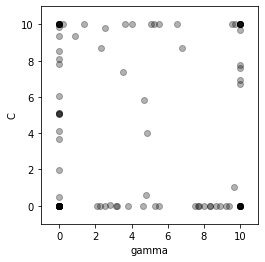

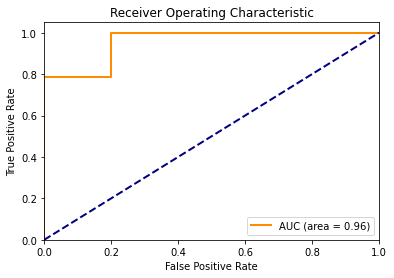

Accuracy for particle (in iteration 25, in fold 4) - 1 is 0.4828 At (gamma, c): [2.51931564e+00 1.00000000e-03]
Accuracy for particle (in iteration 25, in fold 4) - 2 is 0.8276 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 25, in fold 4) - 3 is 0.4828 At (gamma, c): [3.15465752e+00 1.00000000e-03]
Accuracy for particle (in iteration 25, in fold 4) - 4 is 0.4828 At (gamma, c): [2.79924486 0.05961442]
Accuracy for particle (in iteration 25, in fold 4) - 5 is 0.8276 At (gamma, c): [4.80087372 0.59613492]
Accuracy for particle (in iteration 25, in fold 4) - 6 is 0.7931 At (gamma, c): [ 4.04573976 10.        ]
Accuracy for particle (in iteration 25, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 25, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 25, in fold 4) - 9 is 0.4828 At (gamma, c): [8.33629268e+00 1.00000000e-03]
Accuracy for particle (in iteration 25, in fold 4) - 10 is 0.4828 At (

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 25, in fold 4) - 96 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 25, in fold 4) - 97 is 0.8276 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 25, in fold 4) - 98 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 25, in fold 4) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 25, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 5.07542768e+00]
The best position in iteration 25, fold 4 is [ 0.14825628 10.        ], with Accuracy: 0.9310
Accuracy Score: 0.8276
F1 Score: 0.8276
Recall Score: 0.8571
Precision Score: 0.8000
Confusion Matrix (Test):
[[12  3]
 [ 2 12]]
Confusion Matrix (Train):
[[128   0]
 [  0 129]]

Iteration 26 - Fold 4:



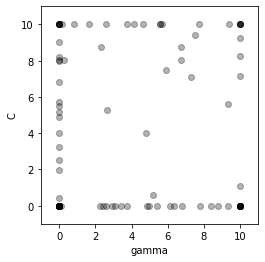

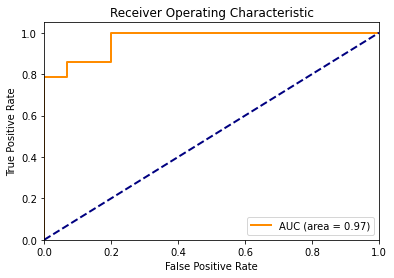

Accuracy for particle (in iteration 26, in fold 4) - 1 is 0.4828 At (gamma, c): [2.25274717e+00 1.00000000e-03]
Accuracy for particle (in iteration 26, in fold 4) - 2 is 0.8276 At (gamma, c): [7.52162365 9.40337884]
Accuracy for particle (in iteration 26, in fold 4) - 3 is 0.4828 At (gamma, c): [3.07617767e+00 1.00000000e-03]
Accuracy for particle (in iteration 26, in fold 4) - 4 is 0.4828 At (gamma, c): [2.93268034e+00 1.00000000e-03]
Accuracy for particle (in iteration 26, in fold 4) - 5 is 0.8276 At (gamma, c): [5.17702693 0.56359094]
Accuracy for particle (in iteration 26, in fold 4) - 6 is 0.7931 At (gamma, c): [ 4.63186113 10.        ]
Accuracy for particle (in iteration 26, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 26, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 26, in fold 4) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 26, in fold 4) - 10 is 0.482

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 26, in fold 4) - 98 is 0.4828 At (gamma, c): [7.77480535e+00 1.00000000e-03]
Accuracy for particle (in iteration 26, in fold 4) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 26, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 6.83900653e+00]
The best position in iteration 26, fold 4 is [1.e-03 1.e+01], with Accuracy: 0.9310
Accuracy Score: 0.8276
F1 Score: 0.8276
Recall Score: 0.8571
Precision Score: 0.8000
Confusion Matrix (Test):
[[12  3]
 [ 2 12]]
Confusion Matrix (Train):
[[128   0]
 [  0 129]]

Iteration 27 - Fold 4:



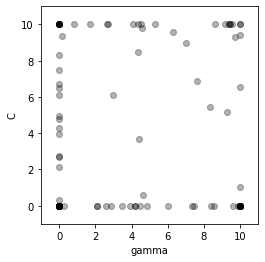

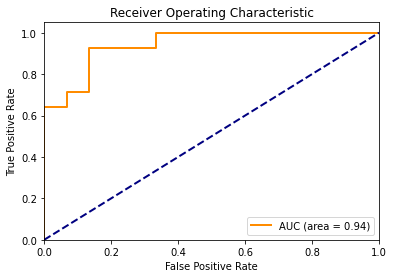

Accuracy for particle (in iteration 27, in fold 4) - 1 is 0.4828 At (gamma, c): [2.11748472e+00 1.00000000e-03]
Accuracy for particle (in iteration 27, in fold 4) - 2 is 0.8276 At (gamma, c): [ 9.37342828 10.        ]
Accuracy for particle (in iteration 27, in fold 4) - 3 is 0.4828 At (gamma, c): [2.0746451e+00 1.0000000e-03]
Accuracy for particle (in iteration 27, in fold 4) - 4 is 0.4828 At (gamma, c): [3.49183635e+00 1.00000000e-03]
Accuracy for particle (in iteration 27, in fold 4) - 5 is 0.8276 At (gamma, c): [4.64522898 0.60961511]
Accuracy for particle (in iteration 27, in fold 4) - 6 is 0.7931 At (gamma, c): [ 4.09272086 10.        ]
Accuracy for particle (in iteration 27, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 27, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 27, in fold 4) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 27, in fold 4) - 10 is 0.482

Accuracy for particle (in iteration 27, in fold 4) - 80 is 0.4828 At (gamma, c): [2.59186112e+00 1.00000000e-03]
Accuracy for particle (in iteration 27, in fold 4) - 81 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 27, in fold 4) - 82 is 0.4828 At (gamma, c): [0.29751032 0.001     ]
Accuracy for particle (in iteration 27, in fold 4) - 83 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 27, in fold 4) - 84 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 27, in fold 4) - 85 is 0.4828 At (gamma, c): [8.40456676e+00 1.00000000e-03]
Accuracy for particle (in iteration 27, in fold 4) - 86 is 0.8276 At (gamma, c): [6.29961992 9.5797343 ]
Accuracy for particle (in iteration 27, in fold 4) - 87 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 27, in fold 4) - 88 is 0.8276 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 27, in fold 4) - 89 is 0.8276 At (gamma, c): [1.0

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 27, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 4.30765106e+00]
The best position in iteration 27, fold 4 is [1.e-03 1.e+01], with Accuracy: 0.9310
Accuracy Score: 0.8276
F1 Score: 0.8148
Recall Score: 0.7857
Precision Score: 0.8462
Confusion Matrix (Test):
[[13  2]
 [ 3 11]]
Confusion Matrix (Train):
[[123   5]
 [ 22 107]]

Iteration 28 - Fold 4:



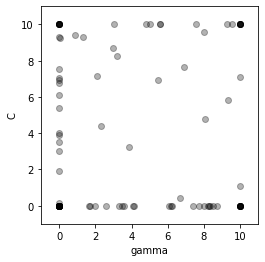

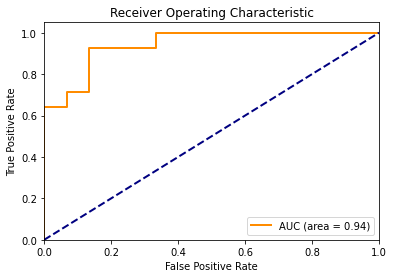

Accuracy for particle (in iteration 28, in fold 4) - 1 is 0.4828 At (gamma, c): [2.58712925e+00 1.00000000e-03]
Accuracy for particle (in iteration 28, in fold 4) - 2 is 0.8276 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 28, in fold 4) - 3 is 0.4828 At (gamma, c): [1.99026364e+00 1.00000000e-03]
Accuracy for particle (in iteration 28, in fold 4) - 4 is 0.4828 At (gamma, c): [3.49987435e+00 1.00000000e-03]
Accuracy for particle (in iteration 28, in fold 4) - 5 is 0.7931 At (gamma, c): [6.65556618 0.43564509]
Accuracy for particle (in iteration 28, in fold 4) - 6 is 0.7931 At (gamma, c): [ 5.57855935 10.        ]
Accuracy for particle (in iteration 28, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 28, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 28, in fold 4) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 28, in fold 4) - 10 is 0.4828 At (gamma, c

Accuracy for particle (in iteration 28, in fold 4) - 81 is 0.4828 At (gamma, c): [6.07066104e+00 1.00000000e-03]
Accuracy for particle (in iteration 28, in fold 4) - 82 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 28, in fold 4) - 83 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 28, in fold 4) - 84 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 28, in fold 4) - 85 is 0.4828 At (gamma, c): [8.20513884e+00 1.00000000e-03]
Accuracy for particle (in iteration 28, in fold 4) - 86 is 0.8276 At (gamma, c): [ 9.52985378 10.        ]
Accuracy for particle (in iteration 28, in fold 4) - 87 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 28, in fold 4) - 88 is 0.9310 At (gamma, c): [0.0293678 9.2410638]
Accuracy for particle (in iteration 28, in fold 4) - 89 is 0.7931 At (gamma, c): [1.00000000e-03 1.88849309e+00]
Accuracy for particle (in iteration 28, in fold 4) - 90 is 0.8276 At (g

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 28, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 6.08983534e+00]
The best position in iteration 28, fold 4 is [1.e-03 1.e+01], with Accuracy: 0.9310
Accuracy Score: 0.8276
F1 Score: 0.8148
Recall Score: 0.7857
Precision Score: 0.8462
Confusion Matrix (Test):
[[13  2]
 [ 3 11]]
Confusion Matrix (Train):
[[123   5]
 [ 22 107]]

Iteration 29 - Fold 4:



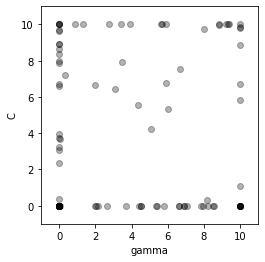

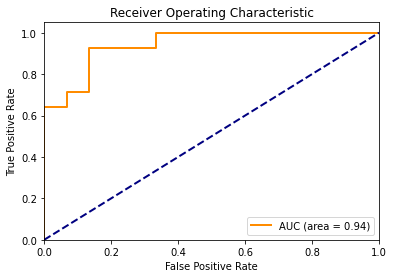

Accuracy for particle (in iteration 29, in fold 4) - 1 is 0.4828 At (gamma, c): [2.66130686e+00 1.00000000e-03]
Accuracy for particle (in iteration 29, in fold 4) - 2 is 0.8276 At (gamma, c): [ 9.39303396 10.        ]
Accuracy for particle (in iteration 29, in fold 4) - 3 is 0.4828 At (gamma, c): [2.130439e+00 1.000000e-03]
Accuracy for particle (in iteration 29, in fold 4) - 4 is 0.4828 At (gamma, c): [4.54718417e+00 1.00000000e-03]
Accuracy for particle (in iteration 29, in fold 4) - 5 is 0.5862 At (gamma, c): [8.16113713 0.30535643]
Accuracy for particle (in iteration 29, in fold 4) - 6 is 0.7931 At (gamma, c): [ 5.59893059 10.        ]
Accuracy for particle (in iteration 29, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 29, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 29, in fold 4) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 29, in fold 4) - 10 is 0.4828 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 29, in fold 4) - 94 is 0.4828 At (gamma, c): [5.32234032e+00 1.00000000e-03]
Accuracy for particle (in iteration 29, in fold 4) - 95 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 29, in fold 4) - 96 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 29, in fold 4) - 97 is 0.8276 At (gamma, c): [8.00639426 9.76663755]
Accuracy for particle (in iteration 29, in fold 4) - 98 is 0.4828 At (gamma, c): [8.23113436e+00 1.00000000e-03]
Accuracy for particle (in iteration 29, in fold 4) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 29, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 7.87804778e+00]
The best position in iteration 29, fold 4 is [1.e-03 1.e+01], with Accuracy: 0.9310
Accuracy Score: 0.8276
F1 Score: 0.8148
Recall Score: 0.7857
Precision Score: 0.8462
Confusion Matrix (Test):
[[13  2]
 [ 3 11]]
Confusion Matrix (Train):
[[123   5]
 [ 22 107]]

Itera

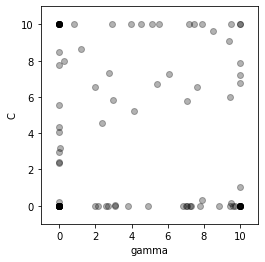

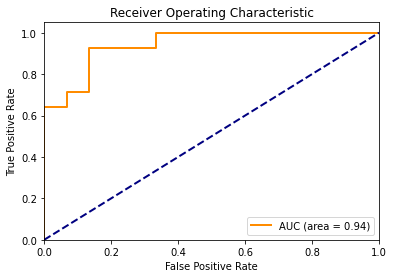

Accuracy for particle (in iteration 30, in fold 4) - 1 is 0.4828 At (gamma, c): [2.60262919e+00 1.00000000e-03]
Accuracy for particle (in iteration 30, in fold 4) - 2 is 0.8276 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 30, in fold 4) - 3 is 0.4828 At (gamma, c): [2.67805164e+00 1.00000000e-03]
Accuracy for particle (in iteration 30, in fold 4) - 4 is 0.4828 At (gamma, c): [3.09925222 0.02088662]
Accuracy for particle (in iteration 30, in fold 4) - 5 is 0.7931 At (gamma, c): [7.88877893 0.32892599]
Accuracy for particle (in iteration 30, in fold 4) - 6 is 0.7931 At (gamma, c): [ 5.10841997 10.        ]
Accuracy for particle (in iteration 30, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 30, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 30, in fold 4) - 9 is 0.4828 At (gamma, c): [7.80503582e+00 1.00000000e-03]
Accuracy for particle (in iteration 30, in fold 4) - 10 is 0.4828 At (

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 30, in fold 4) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 30, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 7.74982211e+00]
The best position in iteration 30, fold 4 is [ 0.02077441 10.        ], with Accuracy: 0.9310
Accuracy Score: 0.8276
F1 Score: 0.8148
Recall Score: 0.7857
Precision Score: 0.8462
Confusion Matrix (Test):
[[13  2]
 [ 3 11]]
Confusion Matrix (Train):
[[123   5]
 [ 22 107]]

Iteration 31 - Fold 4:



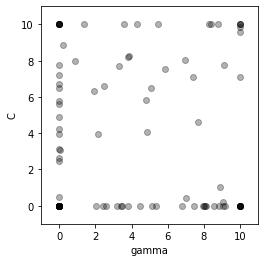

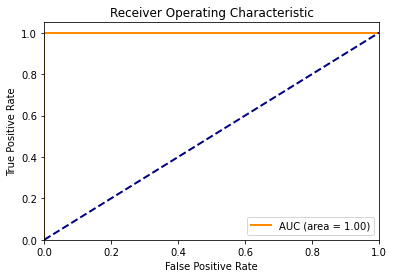

Accuracy for particle (in iteration 31, in fold 4) - 1 is 0.4828 At (gamma, c): [2.56509586e+00 1.00000000e-03]
Accuracy for particle (in iteration 31, in fold 4) - 2 is 0.8276 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 31, in fold 4) - 3 is 0.4828 At (gamma, c): [3.18227824e+00 1.00000000e-03]
Accuracy for particle (in iteration 31, in fold 4) - 4 is 0.4828 At (gamma, c): [3.44260378e+00 1.00000000e-03]
Accuracy for particle (in iteration 31, in fold 4) - 5 is 0.7931 At (gamma, c): [7.02479746 0.40369328]
Accuracy for particle (in iteration 31, in fold 4) - 6 is 0.7931 At (gamma, c): [ 4.29854095 10.        ]
Accuracy for particle (in iteration 31, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 31, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 31, in fold 4) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 31, in fold 4) - 10 is 0.4828 At (gamma, c

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 31, in fold 4) - 95 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 31, in fold 4) - 96 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 31, in fold 4) - 97 is 0.8276 At (gamma, c): [ 8.40301042 10.        ]
Accuracy for particle (in iteration 31, in fold 4) - 98 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 31, in fold 4) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 31, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 4.25435191e+00]
The best position in iteration 31, fold 4 is [1.e-03 1.e+01], with Accuracy: 0.9655
Accuracy Score: 0.9655
F1 Score: 0.9630
Recall Score: 0.9286
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 1 13]]
Confusion Matrix (Train):
[[127   1]
 [  4 125]]

Iteration 32 - Fold 4:



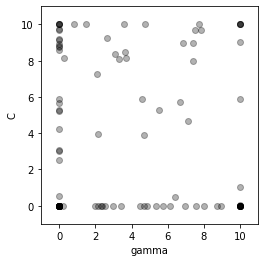

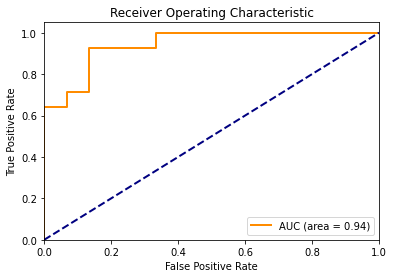

Accuracy for particle (in iteration 32, in fold 4) - 1 is 0.4828 At (gamma, c): [2.54991515e+00 1.00000000e-03]
Accuracy for particle (in iteration 32, in fold 4) - 2 is 0.8276 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 32, in fold 4) - 3 is 0.4828 At (gamma, c): [2.15951427e+00 1.00000000e-03]
Accuracy for particle (in iteration 32, in fold 4) - 4 is 0.4828 At (gamma, c): [3.4239682e+00 1.0000000e-03]
Accuracy for particle (in iteration 32, in fold 4) - 5 is 0.7931 At (gamma, c): [6.39868875 0.45787547]
Accuracy for particle (in iteration 32, in fold 4) - 6 is 0.7931 At (gamma, c): [ 4.74772902 10.        ]
Accuracy for particle (in iteration 32, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 32, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 32, in fold 4) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 32, in fold 4) - 10 is 0.4828 At (gamma, c):

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 32, in fold 4) - 96 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 32, in fold 4) - 97 is 0.8276 At (gamma, c): [6.82912025 8.99526433]
Accuracy for particle (in iteration 32, in fold 4) - 98 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 32, in fold 4) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 32, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 5.88835647e+00]
The best position in iteration 32, fold 4 is [1.e-03 1.e+01], with Accuracy: 0.9655
Accuracy Score: 0.8276
F1 Score: 0.8148
Recall Score: 0.7857
Precision Score: 0.8462
Confusion Matrix (Test):
[[13  2]
 [ 3 11]]
Confusion Matrix (Train):
[[123   5]
 [ 22 107]]

Iteration 33 - Fold 4:



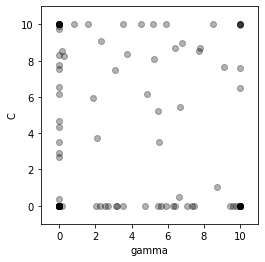

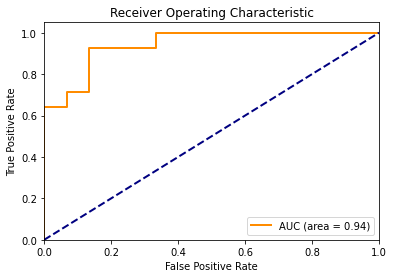

Accuracy for particle (in iteration 33, in fold 4) - 1 is 0.4828 At (gamma, c): [2.55756081e+00 1.00000000e-03]
Accuracy for particle (in iteration 33, in fold 4) - 2 is 0.8276 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 33, in fold 4) - 3 is 0.4828 At (gamma, c): [2.02133135e+00 1.00000000e-03]
Accuracy for particle (in iteration 33, in fold 4) - 4 is 0.4828 At (gamma, c): [3.15750327e+00 1.00000000e-03]
Accuracy for particle (in iteration 33, in fold 4) - 5 is 0.7931 At (gamma, c): [6.63976766 0.45226731]
Accuracy for particle (in iteration 33, in fold 4) - 6 is 0.7931 At (gamma, c): [ 5.91805118 10.        ]
Accuracy for particle (in iteration 33, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 33, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 33, in fold 4) - 9 is 0.4828 At (gamma, c): [9.77000835e+00 1.00000000e-03]
Accuracy for particle (in iteration 33, in fold 4) - 10 is 0.4

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 33, in fold 4) - 92 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 33, in fold 4) - 93 is 0.8276 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 33, in fold 4) - 94 is 0.4828 At (gamma, c): [6.38877305e+00 1.00000000e-03]
Accuracy for particle (in iteration 33, in fold 4) - 95 is 0.4828 At (gamma, c): [9.42485631e+00 1.00000000e-03]
Accuracy for particle (in iteration 33, in fold 4) - 96 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 33, in fold 4) - 97 is 0.8276 At (gamma, c): [6.3744317  8.72479929]
Accuracy for particle (in iteration 33, in fold 4) - 98 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 33, in fold 4) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 33, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 7.54655147e+00]
The best position in iteration 33, fold 4 is [0.43524748 8.39976653], with

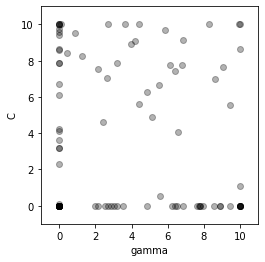

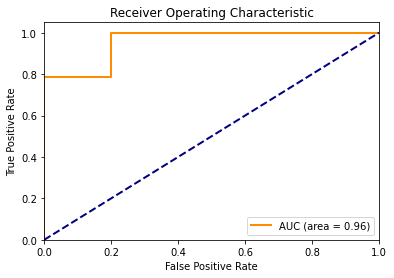

Accuracy for particle (in iteration 34, in fold 4) - 1 is 0.4828 At (gamma, c): [2.13062928e+00 1.00000000e-03]
Accuracy for particle (in iteration 34, in fold 4) - 2 is 0.8276 At (gamma, c): [6.14191253 7.77415322]
Accuracy for particle (in iteration 34, in fold 4) - 3 is 0.4828 At (gamma, c): [2.54161835e+00 1.00000000e-03]
Accuracy for particle (in iteration 34, in fold 4) - 4 is 0.4828 At (gamma, c): [3.19456006e+00 1.00000000e-03]
Accuracy for particle (in iteration 34, in fold 4) - 5 is 0.8276 At (gamma, c): [5.54979911 0.56028075]
Accuracy for particle (in iteration 34, in fold 4) - 6 is 0.7931 At (gamma, c): [3.98365116 8.93179345]
Accuracy for particle (in iteration 34, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 34, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 34, in fold 4) - 9 is 0.4828 At (gamma, c): [8.5646945e+00 1.0000000e-03]
Accuracy for particle (in iteration 34, in fold 4) -

Accuracy for particle (in iteration 34, in fold 4) - 80 is 0.4828 At (gamma, c): [1.98684213e+00 1.00000000e-03]
Accuracy for particle (in iteration 34, in fold 4) - 81 is 0.4828 At (gamma, c): [6.3924562e+00 1.0000000e-03]
Accuracy for particle (in iteration 34, in fold 4) - 82 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 34, in fold 4) - 83 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 34, in fold 4) - 84 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 34, in fold 4) - 85 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 34, in fold 4) - 86 is 0.7931 At (gamma, c): [5.85721728 9.70660232]
Accuracy for particle (in iteration 34, in fold 4) - 87 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 34, in fold 4) - 88 is 0.8276 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 34, in fold 4) - 89 is 0.7931 At (gamma, c): [1.00000000e-03 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 34, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 7.85113803e+00]
The best position in iteration 34, fold 4 is [0.50737265 8.66384377], with Accuracy: 0.9655
Accuracy Score: 0.7931
F1 Score: 0.7857
Recall Score: 0.7857
Precision Score: 0.7857
Confusion Matrix (Test):
[[12  3]
 [ 3 11]]
Confusion Matrix (Train):
[[128   0]
 [  0 129]]

Iteration 35 - Fold 4:



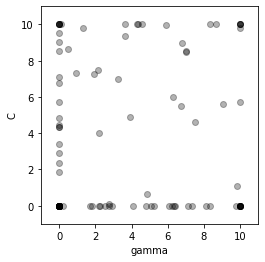

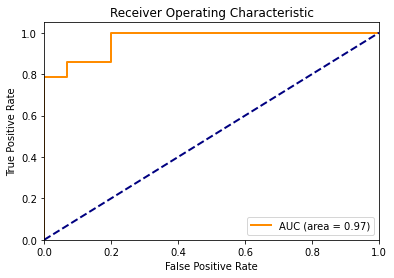

Accuracy for particle (in iteration 35, in fold 4) - 1 is 0.4828 At (gamma, c): [2.19762901e+00 1.00000000e-03]
Accuracy for particle (in iteration 35, in fold 4) - 2 is 0.8276 At (gamma, c): [ 8.32405759 10.        ]
Accuracy for particle (in iteration 35, in fold 4) - 3 is 0.4828 At (gamma, c): [2.55453373e+00 1.00000000e-03]
Accuracy for particle (in iteration 35, in fold 4) - 4 is 0.4828 At (gamma, c): [2.75844608 0.08490581]
Accuracy for particle (in iteration 35, in fold 4) - 5 is 0.8276 At (gamma, c): [4.82950645 0.62834206]
Accuracy for particle (in iteration 35, in fold 4) - 6 is 0.7931 At (gamma, c): [ 4.58947202 10.        ]
Accuracy for particle (in iteration 35, in fold 4) - 7 is 0.4828 At (gamma, c): [8.08182217e+00 1.00000000e-03]
Accuracy for particle (in iteration 35, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 35, in fold 4) - 9 is 0.4828 At (gamma, c): [8.31834198e+00 1.00000000e-03]
Accuracy for particle (in iteration 35

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 35, in fold 4) - 98 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 35, in fold 4) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 35, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 4.43271138e+00]
The best position in iteration 35, fold 4 is [0.50894714 9.21622779], with Accuracy: 0.9655
Accuracy Score: 0.8966
F1 Score: 0.8889
Recall Score: 0.8571
Precision Score: 0.9231
Confusion Matrix (Test):
[[14  1]
 [ 2 12]]
Confusion Matrix (Train):
[[128   0]
 [  0 129]]

Iteration 36 - Fold 4:



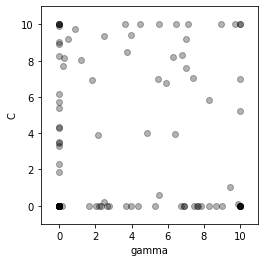

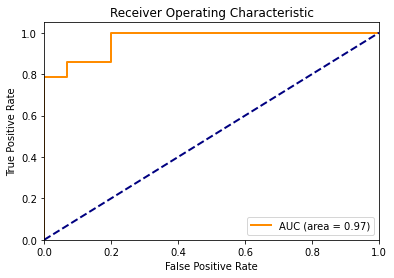

Accuracy for particle (in iteration 36, in fold 4) - 1 is 0.4828 At (gamma, c): [2.05778249e+00 1.00000000e-03]
Accuracy for particle (in iteration 36, in fold 4) - 2 is 0.8276 At (gamma, c): [ 8.94237082 10.        ]
Accuracy for particle (in iteration 36, in fold 4) - 3 is 0.4828 At (gamma, c): [2.62297894e+00 1.00000000e-03]
Accuracy for particle (in iteration 36, in fold 4) - 4 is 0.5862 At (gamma, c): [2.46131233 0.1987549 ]
Accuracy for particle (in iteration 36, in fold 4) - 5 is 0.8276 At (gamma, c): [5.49699608 0.57177035]
Accuracy for particle (in iteration 36, in fold 4) - 6 is 0.8276 At (gamma, c): [ 6.43858115 10.        ]
Accuracy for particle (in iteration 36, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 36, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 36, in fold 4) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 36, in fold 4) - 10 is 0.4828 At (

Accuracy for particle (in iteration 36, in fold 4) - 80 is 0.4828 At (gamma, c): [2.18702034e+00 1.00000000e-03]
Accuracy for particle (in iteration 36, in fold 4) - 81 is 0.4828 At (gamma, c): [8.99029634e+00 1.00000000e-03]
Accuracy for particle (in iteration 36, in fold 4) - 82 is 0.4828 At (gamma, c): [0.17914086 0.001     ]
Accuracy for particle (in iteration 36, in fold 4) - 83 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 36, in fold 4) - 84 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 36, in fold 4) - 85 is 0.4828 At (gamma, c): [8.64024107e+00 1.00000000e-03]
Accuracy for particle (in iteration 36, in fold 4) - 86 is 0.8276 At (gamma, c): [ 7.12820244 10.        ]
Accuracy for particle (in iteration 36, in fold 4) - 87 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 36, in fold 4) - 88 is 0.8276 At (gamma, c): [0.22735318 7.70685494]
Accuracy for particle (in iteration 36, in fold 4) - 89 is 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 36, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 5.36693837e+00]
The best position in iteration 36, fold 4 is [0.58931216 8.03148467], with Accuracy: 0.9655
Accuracy Score: 0.8966
F1 Score: 0.8889
Recall Score: 0.8571
Precision Score: 0.9231
Confusion Matrix (Test):
[[14  1]
 [ 2 12]]
Confusion Matrix (Train):
[[128   0]
 [  0 129]]

Iteration 37 - Fold 4:



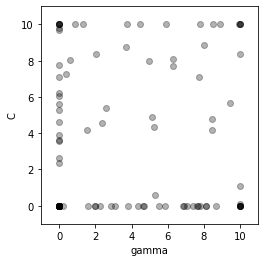

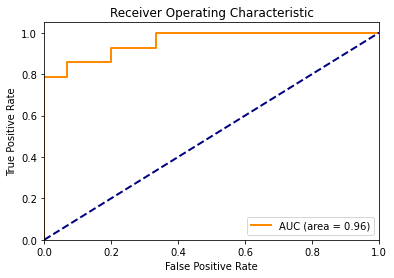

Accuracy for particle (in iteration 37, in fold 4) - 1 is 0.4828 At (gamma, c): [1.9984454e+00 1.0000000e-03]
Accuracy for particle (in iteration 37, in fold 4) - 2 is 0.8276 At (gamma, c): [ 9.91215814 10.        ]
Accuracy for particle (in iteration 37, in fold 4) - 3 is 0.4828 At (gamma, c): [3.06405132e+00 1.00000000e-03]
Accuracy for particle (in iteration 37, in fold 4) - 4 is 0.4828 At (gamma, c): [2.85640418e+00 1.00000000e-03]
Accuracy for particle (in iteration 37, in fold 4) - 5 is 0.8276 At (gamma, c): [5.26672598 0.59258135]
Accuracy for particle (in iteration 37, in fold 4) - 6 is 0.8276 At (gamma, c): [ 7.75855293 10.        ]
Accuracy for particle (in iteration 37, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 37, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 37, in fold 4) - 9 is 0.4828 At (gamma, c): [8.67734527e+00 1.00000000e-03]
Accuracy for particle (in iteration 37, in fold 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 37, in fold 4) - 95 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 37, in fold 4) - 96 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 37, in fold 4) - 97 is 0.8276 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 37, in fold 4) - 98 is 0.4828 At (gamma, c): [8.12972112e+00 1.00000000e-03]
Accuracy for particle (in iteration 37, in fold 4) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 37, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 5.29708943e+00]
The best position in iteration 37, fold 4 is [0.50390321 9.73301058], with Accuracy: 0.9655
Accuracy Score: 0.8621
F1 Score: 0.8462
Recall Score: 0.7857
Precision Score: 0.9167
Confusion Matrix (Test):
[[14  1]
 [ 3 11]]
Confusion Matrix (Train):
[[128   0]
 [  0 129]]

Iteration 38 - Fold 4:



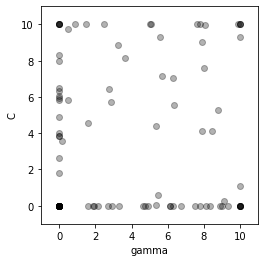

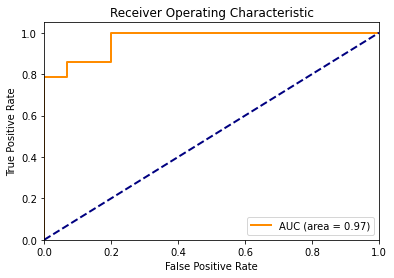

Accuracy for particle (in iteration 38, in fold 4) - 1 is 0.4828 At (gamma, c): [1.88310074e+00 1.00000000e-03]
Accuracy for particle (in iteration 38, in fold 4) - 2 is 0.8276 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 38, in fold 4) - 3 is 0.4828 At (gamma, c): [2.13314508e+00 1.00000000e-03]
Accuracy for particle (in iteration 38, in fold 4) - 4 is 0.4828 At (gamma, c): [2.9026362e+00 1.0000000e-03]
Accuracy for particle (in iteration 38, in fold 4) - 5 is 0.8276 At (gamma, c): [5.46605326 0.57567014]
Accuracy for particle (in iteration 38, in fold 4) - 6 is 0.8276 At (gamma, c): [ 7.63860593 10.        ]
Accuracy for particle (in iteration 38, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 38, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 38, in fold 4) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 38, in fold 4) - 10 is 0.4828 At (gamma, c):

Accuracy for particle (in iteration 38, in fold 4) - 81 is 0.4828 At (gamma, c): [5.35575893 0.04377052]
Accuracy for particle (in iteration 38, in fold 4) - 82 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 38, in fold 4) - 83 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 38, in fold 4) - 84 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 38, in fold 4) - 85 is 0.4828 At (gamma, c): [8.13227954e+00 1.00000000e-03]
Accuracy for particle (in iteration 38, in fold 4) - 86 is 0.7931 At (gamma, c): [5.54585682 9.29259374]
Accuracy for particle (in iteration 38, in fold 4) - 87 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 38, in fold 4) - 88 is 0.8276 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 38, in fold 4) - 89 is 0.8276 At (gamma, c): [1.00000000e-03 1.79972702e+00]
Accuracy for particle (in iteration 38, in fold 4) - 90 is 0.8276 At (gamma, c): [1.e-0

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


The best position in iteration 38, fold 4 is [ 0.32733954 10.        ], with Accuracy: 0.9655
Accuracy Score: 0.8966
F1 Score: 0.8889
Recall Score: 0.8571
Precision Score: 0.9231
Confusion Matrix (Test):
[[14  1]
 [ 2 12]]
Confusion Matrix (Train):
[[128   0]
 [  0 129]]

Iteration 39 - Fold 4:



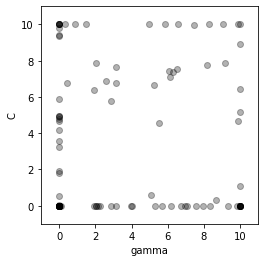

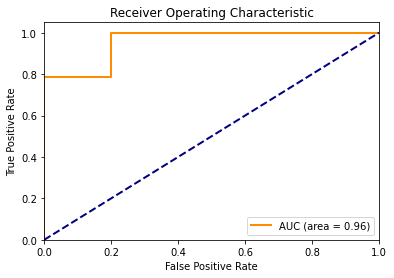

Accuracy for particle (in iteration 39, in fold 4) - 1 is 0.4828 At (gamma, c): [2.15310406e+00 1.00000000e-03]
Accuracy for particle (in iteration 39, in fold 4) - 2 is 0.8276 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 39, in fold 4) - 3 is 0.4828 At (gamma, c): [2.26055402e+00 1.00000000e-03]
Accuracy for particle (in iteration 39, in fold 4) - 4 is 0.4828 At (gamma, c): [2.87503702e+00 1.00000000e-03]
Accuracy for particle (in iteration 39, in fold 4) - 5 is 0.8276 At (gamma, c): [5.07067321 0.61010297]
Accuracy for particle (in iteration 39, in fold 4) - 6 is 0.8276 At (gamma, c): [ 6.58055089 10.        ]
Accuracy for particle (in iteration 39, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 39, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 39, in fold 4) - 9 is 0.4828 At (gamma, c): [6.72584448e+00 1.00000000e-03]
Accuracy for particle (in iteration 39, in fold 4) - 10 is 0.4

Accuracy for particle (in iteration 39, in fold 4) - 79 is 0.7931 At (gamma, c): [5.26311993 6.68719858]
Accuracy for particle (in iteration 39, in fold 4) - 80 is 0.4828 At (gamma, c): [2.03234575e+00 1.00000000e-03]
Accuracy for particle (in iteration 39, in fold 4) - 81 is 0.4828 At (gamma, c): [6.97350423e+00 1.00000000e-03]
Accuracy for particle (in iteration 39, in fold 4) - 82 is 0.4828 At (gamma, c): [0.11268412 0.001     ]
Accuracy for particle (in iteration 39, in fold 4) - 83 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 39, in fold 4) - 84 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 39, in fold 4) - 85 is 0.4828 At (gamma, c): [8.33170344e+00 1.00000000e-03]
Accuracy for particle (in iteration 39, in fold 4) - 86 is 0.8276 At (gamma, c): [ 8.28011149 10.        ]
Accuracy for particle (in iteration 39, in fold 4) - 87 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 39, in fold 4) - 88 is 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 39, in fold 4) - 98 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 39, in fold 4) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 39, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 3.56873122e+00]
The best position in iteration 39, fold 4 is [ 0.34751947 10.        ], with Accuracy: 0.9655
Accuracy Score: 0.8276
F1 Score: 0.8276
Recall Score: 0.8571
Precision Score: 0.8000
Confusion Matrix (Test):
[[12  3]
 [ 2 12]]
Confusion Matrix (Train):
[[128   0]
 [  0 129]]

Iteration 40 - Fold 4:



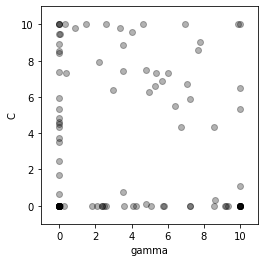

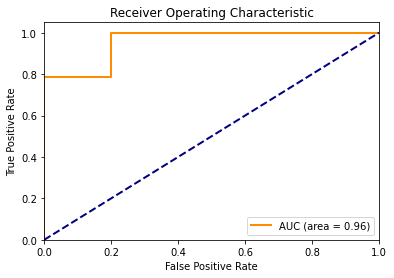

Accuracy for particle (in iteration 40, in fold 4) - 1 is 0.4828 At (gamma, c): [2.37344464e+00 1.00000000e-03]
Accuracy for particle (in iteration 40, in fold 4) - 2 is 0.8276 At (gamma, c): [ 9.84954693 10.        ]
Accuracy for particle (in iteration 40, in fold 4) - 3 is 0.4828 At (gamma, c): [2.08006544e+00 1.00000000e-03]
Accuracy for particle (in iteration 40, in fold 4) - 4 is 0.4828 At (gamma, c): [3.57451095e+00 1.00000000e-03]
Accuracy for particle (in iteration 40, in fold 4) - 5 is 0.7931 At (gamma, c): [3.51917383 0.74451258]
Accuracy for particle (in iteration 40, in fold 4) - 6 is 0.8276 At (gamma, c): [ 6.92308122 10.        ]
Accuracy for particle (in iteration 40, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 40, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 40, in fold 4) - 9 is 0.4828 At (gamma, c): [7.23782834e+00 1.00000000e-03]
Accuracy for particle (in iteration 40, in fol

Accuracy for particle (in iteration 40, in fold 4) - 80 is 0.4828 At (gamma, c): [2.34344722e+00 1.00000000e-03]
Accuracy for particle (in iteration 40, in fold 4) - 81 is 0.4828 At (gamma, c): [4.77806631 0.07954186]
Accuracy for particle (in iteration 40, in fold 4) - 82 is 0.4828 At (gamma, c): [0.25473152 0.001     ]
Accuracy for particle (in iteration 40, in fold 4) - 83 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 40, in fold 4) - 84 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 40, in fold 4) - 85 is 0.4828 At (gamma, c): [9.23081251e+00 1.00000000e-03]
Accuracy for particle (in iteration 40, in fold 4) - 86 is 0.7931 At (gamma, c): [4.7953744  7.47813284]
Accuracy for particle (in iteration 40, in fold 4) - 87 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 40, in fold 4) - 88 is 0.9310 At (gamma, c): [0.04066489 9.46927785]
Accuracy for particle (in iteration 40, in fold 4) - 89 is 0.7931 At 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 40, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 4.84191539e+00]
The best position in iteration 40, fold 4 is [0.46368924 9.29770989], with Accuracy: 0.9655
Accuracy Score: 0.8276
F1 Score: 0.8276
Recall Score: 0.8571
Precision Score: 0.8000
Confusion Matrix (Test):
[[12  3]
 [ 2 12]]
Confusion Matrix (Train):
[[128   0]
 [  0 129]]

Iteration 41 - Fold 4:



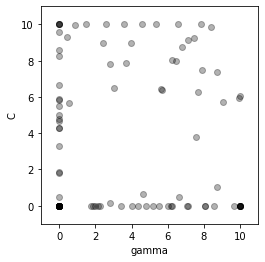

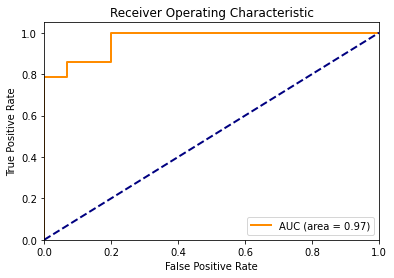

Accuracy for particle (in iteration 41, in fold 4) - 1 is 0.4828 At (gamma, c): [1.88944463e+00 1.00000000e-03]
Accuracy for particle (in iteration 41, in fold 4) - 2 is 0.8276 At (gamma, c): [8.40965651 9.88763881]
Accuracy for particle (in iteration 41, in fold 4) - 3 is 0.4828 At (gamma, c): [1.74391279e+00 1.00000000e-03]
Accuracy for particle (in iteration 41, in fold 4) - 4 is 0.5172 At (gamma, c): [2.8020607  0.12539572]
Accuracy for particle (in iteration 41, in fold 4) - 5 is 0.7931 At (gamma, c): [4.63068403 0.6483313 ]
Accuracy for particle (in iteration 41, in fold 4) - 6 is 0.7931 At (gamma, c): [ 5.34609327 10.        ]
Accuracy for particle (in iteration 41, in fold 4) - 7 is 0.4828 At (gamma, c): [8.5511158e+00 1.0000000e-03]
Accuracy for particle (in iteration 41, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 41, in fold 4) - 9 is 0.4828 At (gamma, c): [8.05673088e+00 1.00000000e-03]
Accuracy for particle (in iteration 41, in

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 41, in fold 4) - 97 is 0.8276 At (gamma, c): [ 7.8557177 10.       ]
Accuracy for particle (in iteration 41, in fold 4) - 98 is 0.4828 At (gamma, c): [7.12640278e+00 1.00000000e-03]
Accuracy for particle (in iteration 41, in fold 4) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 41, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 3.30132799e+00]
The best position in iteration 41, fold 4 is [0.46315311 9.85886468], with Accuracy: 0.9655
Accuracy Score: 0.8966
F1 Score: 0.8889
Recall Score: 0.8571
Precision Score: 0.9231
Confusion Matrix (Test):
[[14  1]
 [ 2 12]]
Confusion Matrix (Train):
[[128   0]
 [  0 129]]

Iteration 42 - Fold 4:



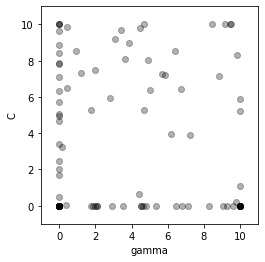

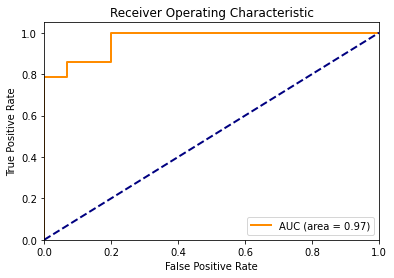

Accuracy for particle (in iteration 42, in fold 4) - 1 is 0.4828 At (gamma, c): [1.99889091e+00 1.00000000e-03]
Accuracy for particle (in iteration 42, in fold 4) - 2 is 0.7931 At (gamma, c): [5.66109098 7.26524097]
Accuracy for particle (in iteration 42, in fold 4) - 3 is 0.4828 At (gamma, c): [2.08743239e+00 1.00000000e-03]
Accuracy for particle (in iteration 42, in fold 4) - 4 is 0.4828 At (gamma, c): [3.549005e+00 1.000000e-03]
Accuracy for particle (in iteration 42, in fold 4) - 5 is 0.7931 At (gamma, c): [4.40919025 0.66750529]
Accuracy for particle (in iteration 42, in fold 4) - 6 is 0.7931 At (gamma, c): [3.6181905  8.11410001]
Accuracy for particle (in iteration 42, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 42, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 42, in fold 4) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 42, in fold 4) - 10 is 0.4828 At (

Accuracy for particle (in iteration 42, in fold 4) - 79 is 0.7931 At (gamma, c): [5.01326051 6.3678264 ]
Accuracy for particle (in iteration 42, in fold 4) - 80 is 0.4828 At (gamma, c): [2.09954948e+00 1.00000000e-03]
Accuracy for particle (in iteration 42, in fold 4) - 81 is 0.4828 At (gamma, c): [6.7884469e+00 1.0000000e-03]
Accuracy for particle (in iteration 42, in fold 4) - 82 is 0.4828 At (gamma, c): [0.37250629 0.03216822]
Accuracy for particle (in iteration 42, in fold 4) - 83 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 42, in fold 4) - 84 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 42, in fold 4) - 85 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 42, in fold 4) - 86 is 0.7931 At (gamma, c): [4.9301254  8.01683388]
Accuracy for particle (in iteration 42, in fold 4) - 87 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 42, in fold 4) - 88 is 0.8276 At (gamma, c)

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 42, in fold 4) - 98 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 42, in fold 4) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 42, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 3.39455999e+00]
The best position in iteration 42, fold 4 is [0.67579298 6.40595848], with Accuracy: 0.9655
Accuracy Score: 0.8966
F1 Score: 0.8889
Recall Score: 0.8571
Precision Score: 0.9231
Confusion Matrix (Test):
[[14  1]
 [ 2 12]]
Confusion Matrix (Train):
[[128   0]
 [  0 129]]

Iteration 43 - Fold 4:



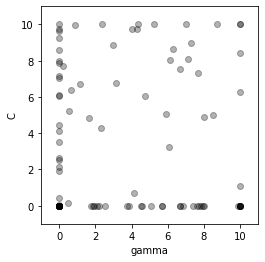

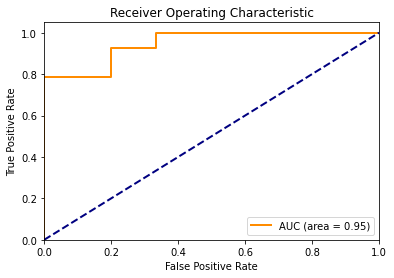

Accuracy for particle (in iteration 43, in fold 4) - 1 is 0.4828 At (gamma, c): [1.89781882e+00 1.00000000e-03]
Accuracy for particle (in iteration 43, in fold 4) - 2 is 0.8276 At (gamma, c): [6.11747641 8.03351897]
Accuracy for particle (in iteration 43, in fold 4) - 3 is 0.4828 At (gamma, c): [1.9445548e+00 1.0000000e-03]
Accuracy for particle (in iteration 43, in fold 4) - 4 is 0.4828 At (gamma, c): [3.76238593e+00 1.00000000e-03]
Accuracy for particle (in iteration 43, in fold 4) - 5 is 0.7931 At (gamma, c): [4.12173709 0.6923835 ]
Accuracy for particle (in iteration 43, in fold 4) - 6 is 0.7931 At (gamma, c): [ 5.24370559 10.        ]
Accuracy for particle (in iteration 43, in fold 4) - 7 is 0.4828 At (gamma, c): [9.86125954e+00 1.00000000e-03]
Accuracy for particle (in iteration 43, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 43, in fold 4) - 9 is 0.4828 At (gamma, c): [6.83324476e+00 1.00000000e-03]
Accuracy for particle (in iteratio

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 43, in fold 4) - 92 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 43, in fold 4) - 93 is 0.8276 At (gamma, c): [1.00000000e-03 9.24198097e+00]
Accuracy for particle (in iteration 43, in fold 4) - 94 is 0.4828 At (gamma, c): [5.65409716e+00 1.00000000e-03]
Accuracy for particle (in iteration 43, in fold 4) - 95 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 43, in fold 4) - 96 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 43, in fold 4) - 97 is 0.8276 At (gamma, c): [6.29690324 8.6193154 ]
Accuracy for particle (in iteration 43, in fold 4) - 98 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 43, in fold 4) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 43, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 4.10769621e+00]
The best position in iteration 43, fold 4 is [0.54215409 9.001557  ], with

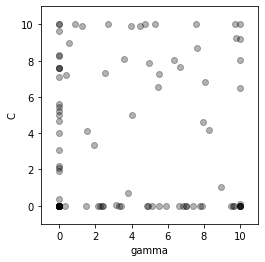

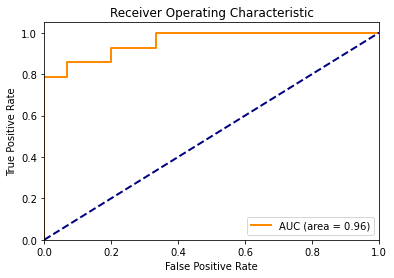

Accuracy for particle (in iteration 44, in fold 4) - 1 is 0.4828 At (gamma, c): [2.24359606e+00 1.00000000e-03]
Accuracy for particle (in iteration 44, in fold 4) - 2 is 0.7931 At (gamma, c): [5.53528336 7.28367725]
Accuracy for particle (in iteration 44, in fold 4) - 3 is 0.4828 At (gamma, c): [2.13818949e+00 1.00000000e-03]
Accuracy for particle (in iteration 44, in fold 4) - 4 is 0.4828 At (gamma, c): [3.16201415 0.03228502]
Accuracy for particle (in iteration 44, in fold 4) - 5 is 0.7931 At (gamma, c): [3.79804815 0.7203958 ]
Accuracy for particle (in iteration 44, in fold 4) - 6 is 0.7931 At (gamma, c): [4.48584663 9.92114367]
Accuracy for particle (in iteration 44, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 44, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 44, in fold 4) - 9 is 0.4828 At (gamma, c): [7.01968508e+00 1.00000000e-03]
Accuracy for particle (in iteration 44, in fold 4) - 10 is

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 44, in fold 4) - 95 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 44, in fold 4) - 96 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 44, in fold 4) - 97 is 0.8276 At (gamma, c): [ 7.57838933 10.        ]
Accuracy for particle (in iteration 44, in fold 4) - 98 is 0.4828 At (gamma, c): [6.82195821e+00 1.00000000e-03]
Accuracy for particle (in iteration 44, in fold 4) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 44, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 4.67848824e+00]
The best position in iteration 44, fold 4 is [0.64728732 7.04976456], with Accuracy: 0.9655
Accuracy Score: 0.8966
F1 Score: 0.8889
Recall Score: 0.8571
Precision Score: 0.9231
Confusion Matrix (Test):
[[14  1]
 [ 2 12]]
Confusion Matrix (Train):
[[128   0]
 [  0 129]]

Iteration 45 - Fold 4:



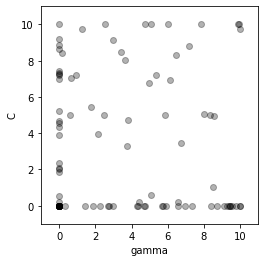

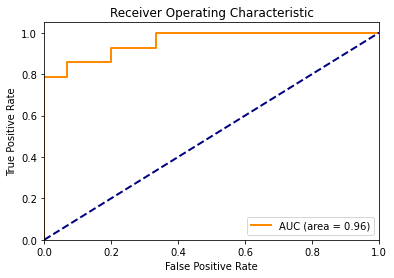

Accuracy for particle (in iteration 45, in fold 4) - 1 is 0.4828 At (gamma, c): [2.67955806e+00 1.00000000e-03]
Accuracy for particle (in iteration 45, in fold 4) - 2 is 0.8276 At (gamma, c): [ 7.85748261 10.        ]
Accuracy for particle (in iteration 45, in fold 4) - 3 is 0.4828 At (gamma, c): [2.25323669e+00 1.00000000e-03]
Accuracy for particle (in iteration 45, in fold 4) - 4 is 0.4828 At (gamma, c): [3.00151509 0.0083146 ]
Accuracy for particle (in iteration 45, in fold 4) - 5 is 0.8276 At (gamma, c): [5.09908489 0.60780699]
Accuracy for particle (in iteration 45, in fold 4) - 6 is 0.7931 At (gamma, c): [ 4.74584046 10.        ]
Accuracy for particle (in iteration 45, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 45, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 45, in fold 4) - 9 is 0.4828 At (gamma, c): [9.09465575e+00 1.00000000e-03]
Accuracy for particle (in iteration 45, in fold 4) - 1

Accuracy for particle (in iteration 45, in fold 4) - 79 is 0.7931 At (gamma, c): [3.78848492 4.73468747]
Accuracy for particle (in iteration 45, in fold 4) - 80 is 0.4828 At (gamma, c): [1.89826137e+00 1.00000000e-03]
Accuracy for particle (in iteration 45, in fold 4) - 81 is 0.5517 At (gamma, c): [4.3995723  0.17785645]
Accuracy for particle (in iteration 45, in fold 4) - 82 is 0.4828 At (gamma, c): [0.34431279 0.001     ]
Accuracy for particle (in iteration 45, in fold 4) - 83 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 45, in fold 4) - 84 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 45, in fold 4) - 85 is 0.4828 At (gamma, c): [5.69457924e+00 1.00000000e-03]
Accuracy for particle (in iteration 45, in fold 4) - 86 is 0.7931 At (gamma, c): [ 6.02446162 10.        ]
Accuracy for particle (in iteration 45, in fold 4) - 87 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 45, in fold 4) - 88 is 0.8276 A

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 45, in fold 4) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 45, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 4.55561579e+00]
The best position in iteration 45, fold 4 is [ 0.48735695 10.        ], with Accuracy: 0.9655
Accuracy Score: 0.8621
F1 Score: 0.8462
Recall Score: 0.7857
Precision Score: 0.9167
Confusion Matrix (Test):
[[14  1]
 [ 3 11]]
Confusion Matrix (Train):
[[128   0]
 [  0 129]]

Iteration 46 - Fold 4:



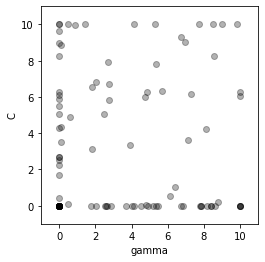

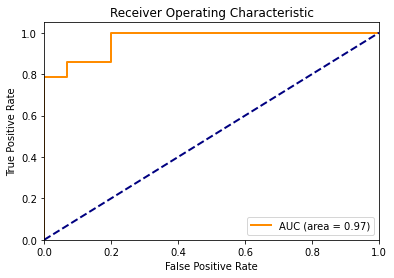

Accuracy for particle (in iteration 46, in fold 4) - 1 is 0.4828 At (gamma, c): [2.5813292e+00 1.0000000e-03]
Accuracy for particle (in iteration 46, in fold 4) - 2 is 0.8276 At (gamma, c): [6.93425466 9.03513501]
Accuracy for particle (in iteration 46, in fold 4) - 3 is 0.4828 At (gamma, c): [2.62480081e+00 1.00000000e-03]
Accuracy for particle (in iteration 46, in fold 4) - 4 is 0.4828 At (gamma, c): [3.67380412e+00 1.00000000e-03]
Accuracy for particle (in iteration 46, in fold 4) - 5 is 0.8276 At (gamma, c): [6.11263813 0.52009636]
Accuracy for particle (in iteration 46, in fold 4) - 6 is 0.7931 At (gamma, c): [ 5.30620088 10.        ]
Accuracy for particle (in iteration 46, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 46, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 46, in fold 4) - 9 is 0.4828 At (gamma, c): [6.85587751e+00 1.00000000e-03]
Accuracy for particle (in iteration 46, in fold 4)

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 46, in fold 4) - 94 is 0.4828 At (gamma, c): [8.19072956e+00 1.00000000e-03]
Accuracy for particle (in iteration 46, in fold 4) - 95 is 0.4828 At (gamma, c): [7.83953364e+00 1.00000000e-03]
Accuracy for particle (in iteration 46, in fold 4) - 96 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 46, in fold 4) - 97 is 0.8276 At (gamma, c): [6.70633593 9.28349185]
Accuracy for particle (in iteration 46, in fold 4) - 98 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 46, in fold 4) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 46, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 5.05798221e+00]
The best position in iteration 46, fold 4 is [0.60798593 7.77891006], with Accuracy: 0.9655
Accuracy Score: 0.8966
F1 Score: 0.8889
Recall Score: 0.8571
Precision Score: 0.9231
Confusion Matrix (Test):
[[14  1]
 [ 2 12]]
Confusion Matrix (Train):
[[128   0]
 [  0 129]

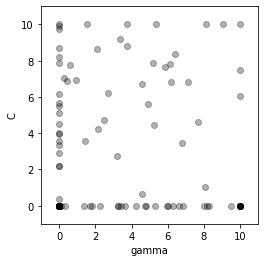

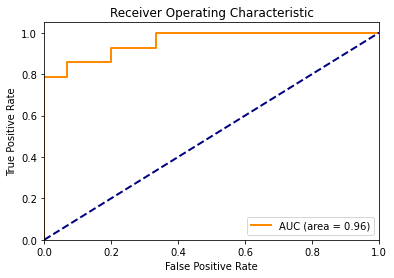

Accuracy for particle (in iteration 47, in fold 4) - 1 is 0.4828 At (gamma, c): [1.73127396e+00 1.00000000e-03]
Accuracy for particle (in iteration 47, in fold 4) - 2 is 0.7931 At (gamma, c): [5.84184748 7.66692261]
Accuracy for particle (in iteration 47, in fold 4) - 3 is 0.4828 At (gamma, c): [2.25121668e+00 1.00000000e-03]
Accuracy for particle (in iteration 47, in fold 4) - 4 is 0.4828 At (gamma, c): [3.26022773e+00 1.00000000e-03]
Accuracy for particle (in iteration 47, in fold 4) - 5 is 0.7931 At (gamma, c): [4.57541119 0.65312479]
Accuracy for particle (in iteration 47, in fold 4) - 6 is 0.7931 At (gamma, c): [ 5.34849435 10.        ]
Accuracy for particle (in iteration 47, in fold 4) - 7 is 0.4828 At (gamma, c): [7.98714312e+00 1.00000000e-03]
Accuracy for particle (in iteration 47, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 47, in fold 4) - 9 is 0.4828 At (gamma, c): [6.61655826e+00 1.00000000e-03]
Accuracy for particle (in iterat

Accuracy for particle (in iteration 47, in fold 4) - 79 is 0.8276 At (gamma, c): [6.10706865 7.83053128]
Accuracy for particle (in iteration 47, in fold 4) - 80 is 0.4828 At (gamma, c): [1.3876302e+00 1.0000000e-03]
Accuracy for particle (in iteration 47, in fold 4) - 81 is 0.4828 At (gamma, c): [4.81905818e+00 2.89793596e-03]
Accuracy for particle (in iteration 47, in fold 4) - 82 is 0.4828 At (gamma, c): [0.31240513 0.001     ]
Accuracy for particle (in iteration 47, in fold 4) - 83 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 47, in fold 4) - 84 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 47, in fold 4) - 85 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 47, in fold 4) - 86 is 0.7931 At (gamma, c): [5.178744   7.85934768]
Accuracy for particle (in iteration 47, in fold 4) - 87 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 47, in fold 4) - 88 is 0.8276 At (gamma, c)

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 47, in fold 4) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 47, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 6.15050085e+00]
The best position in iteration 47, fold 4 is [0.5108327  9.65710302], with Accuracy: 0.9655
Accuracy Score: 0.8621
F1 Score: 0.8462
Recall Score: 0.7857
Precision Score: 0.9167
Confusion Matrix (Test):
[[14  1]
 [ 3 11]]
Confusion Matrix (Train):
[[128   0]
 [  0 129]]

Iteration 48 - Fold 4:



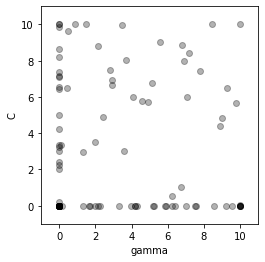

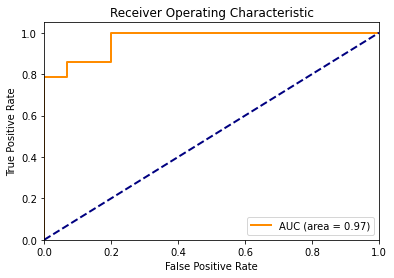

Accuracy for particle (in iteration 48, in fold 4) - 1 is 0.4828 At (gamma, c): [1.98611234e+00 1.00000000e-03]
Accuracy for particle (in iteration 48, in fold 4) - 2 is 0.7931 At (gamma, c): [5.14357822 6.7442383 ]
Accuracy for particle (in iteration 48, in fold 4) - 3 is 0.4828 At (gamma, c): [1.70373939e+00 1.00000000e-03]
Accuracy for particle (in iteration 48, in fold 4) - 4 is 0.4828 At (gamma, c): [3.29894228e+00 1.00000000e-03]
Accuracy for particle (in iteration 48, in fold 4) - 5 is 0.7931 At (gamma, c): [6.20772863 0.51186759]
Accuracy for particle (in iteration 48, in fold 4) - 6 is 0.7931 At (gamma, c): [3.70073591 8.05585929]
Accuracy for particle (in iteration 48, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 48, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 48, in fold 4) - 9 is 0.4828 At (gamma, c): [5.22382888e+00 1.00000000e-03]
Accuracy for particle (in iteration 48, in fold 4)

Accuracy for particle (in iteration 48, in fold 4) - 79 is 0.7931 At (gamma, c): [4.57151991 5.78028249]
Accuracy for particle (in iteration 48, in fold 4) - 80 is 0.4828 At (gamma, c): [1.34200384e+00 1.00000000e-03]
Accuracy for particle (in iteration 48, in fold 4) - 81 is 0.4828 At (gamma, c): [6.20523081e+00 1.00000000e-03]
Accuracy for particle (in iteration 48, in fold 4) - 82 is 0.4828 At (gamma, c): [0.14308954 0.001     ]
Accuracy for particle (in iteration 48, in fold 4) - 83 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 48, in fold 4) - 84 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 48, in fold 4) - 85 is 0.4828 At (gamma, c): [7.01815214e+00 1.00000000e-03]
Accuracy for particle (in iteration 48, in fold 4) - 86 is 0.7931 At (gamma, c): [5.57249581 9.00961768]
Accuracy for particle (in iteration 48, in fold 4) - 87 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 48, in fold 4) - 88 is 0.

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 48, in fold 4) - 98 is 0.4828 At (gamma, c): [6.39198542e+00 1.00000000e-03]
Accuracy for particle (in iteration 48, in fold 4) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 48, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 6.41565905e+00]
The best position in iteration 48, fold 4 is [0.69642036 6.12500934], with Accuracy: 0.9655
Accuracy Score: 0.8966
F1 Score: 0.8889
Recall Score: 0.8571
Precision Score: 0.9231
Confusion Matrix (Test):
[[14  1]
 [ 2 12]]
Confusion Matrix (Train):
[[128   0]
 [  0 129]]

Iteration 49 - Fold 4:



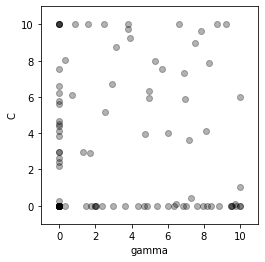

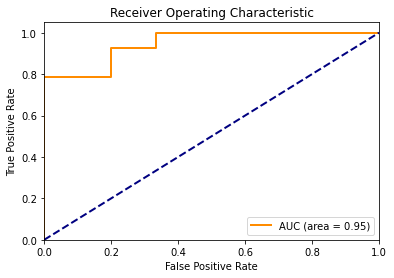

Accuracy for particle (in iteration 49, in fold 4) - 1 is 0.4828 At (gamma, c): [1.98491484e+00 1.00000000e-03]
Accuracy for particle (in iteration 49, in fold 4) - 2 is 0.7931 At (gamma, c): [5.70639726 7.53199561]
Accuracy for particle (in iteration 49, in fold 4) - 3 is 0.4828 At (gamma, c): [1.95563384e+00 1.00000000e-03]
Accuracy for particle (in iteration 49, in fold 4) - 4 is 0.4828 At (gamma, c): [3.66555981e+00 1.00000000e-03]
Accuracy for particle (in iteration 49, in fold 4) - 5 is 0.7931 At (gamma, c): [7.30236322 0.41714031]
Accuracy for particle (in iteration 49, in fold 4) - 6 is 0.7931 At (gamma, c): [3.91664357 9.26649661]
Accuracy for particle (in iteration 49, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 49, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 49, in fold 4) - 9 is 0.4828 At (gamma, c): [7.94171153e+00 1.00000000e-03]
Accuracy for particle (in iteration 49, in fold 4)

Accuracy for particle (in iteration 49, in fold 4) - 80 is 0.4828 At (gamma, c): [1.47088084e+00 1.00000000e-03]
Accuracy for particle (in iteration 49, in fold 4) - 81 is 0.4828 At (gamma, c): [7.0289165e+00 1.0000000e-03]
Accuracy for particle (in iteration 49, in fold 4) - 82 is 0.4828 At (gamma, c): [0.34947392 0.00716534]
Accuracy for particle (in iteration 49, in fold 4) - 83 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 49, in fold 4) - 84 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 49, in fold 4) - 85 is 0.4828 At (gamma, c): [9.47376072e+00 1.00000000e-03]
Accuracy for particle (in iteration 49, in fold 4) - 86 is 0.8276 At (gamma, c): [ 6.60784945 10.        ]
Accuracy for particle (in iteration 49, in fold 4) - 87 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 49, in fold 4) - 88 is 0.8276 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 49, in fold 4) - 89 is 0.7931 At 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 49, in fold 4) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 49, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 4.67978806e+00]
The best position in iteration 49, fold 4 is [0.76245044 4.86405464], with Accuracy: 0.9655
Accuracy Score: 0.8621
F1 Score: 0.8462
Recall Score: 0.7857
Precision Score: 0.9167
Confusion Matrix (Test):
[[14  1]
 [ 3 11]]
Confusion Matrix (Train):
[[128   0]
 [  0 129]]

Iteration 50 - Fold 4:



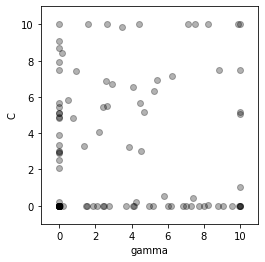

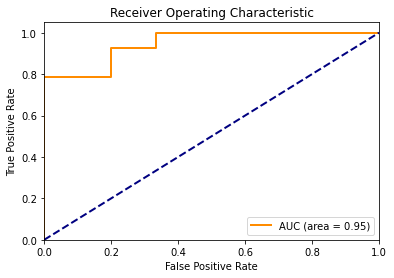

Accuracy for particle (in iteration 50, in fold 4) - 1 is 0.4828 At (gamma, c): [1.8737279e+00 1.0000000e-03]
Accuracy for particle (in iteration 50, in fold 4) - 2 is 0.8276 At (gamma, c): [ 7.48808771 10.        ]
Accuracy for particle (in iteration 50, in fold 4) - 3 is 0.4828 At (gamma, c): [2.11057092e+00 1.00000000e-03]
Accuracy for particle (in iteration 50, in fold 4) - 4 is 0.4828 At (gamma, c): [3.68723928e+00 1.00000000e-03]
Accuracy for particle (in iteration 50, in fold 4) - 5 is 0.7931 At (gamma, c): [7.39786187 0.40887608]
Accuracy for particle (in iteration 50, in fold 4) - 6 is 0.7931 At (gamma, c): [ 4.39037878 10.        ]
Accuracy for particle (in iteration 50, in fold 4) - 7 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 50, in fold 4) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 50, in fold 4) - 9 is 0.4828 At (gamma, c): [9.54198423e+00 1.00000000e-03]
Accuracy for particle (in iteration 50, in fold 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 50, in fold 4) - 94 is 0.4828 At (gamma, c): [4.98748078e+00 1.00000000e-03]
Accuracy for particle (in iteration 50, in fold 4) - 95 is 0.4828 At (gamma, c): [8.24470717 0.01043071]
Accuracy for particle (in iteration 50, in fold 4) - 96 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 50, in fold 4) - 97 is 0.7931 At (gamma, c): [4.44804416 5.66718631]
Accuracy for particle (in iteration 50, in fold 4) - 98 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 50, in fold 4) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 50, in fold 4) - 100 is 0.8276 At (gamma, c): [1.00000000e-03 5.42935327e+00]
The best position in iteration 50, fold 4 is [0.66342721 6.76583355], with Accuracy: 0.9655
Accuracy Score: 0.8621
F1 Score: 0.8462
Recall Score: 0.7857
Precision Score: 0.9167
Confusion Matrix (Test):
[[14  1]
 [ 3 11]]
Confusion Matrix (Train):
[[128   0]
 [  0 129]]


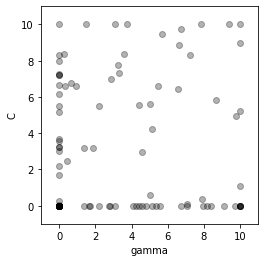

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.



Iteration 1 - Fold 5:



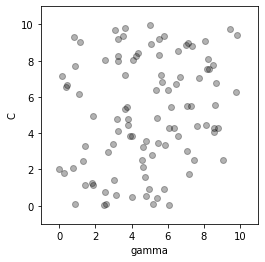

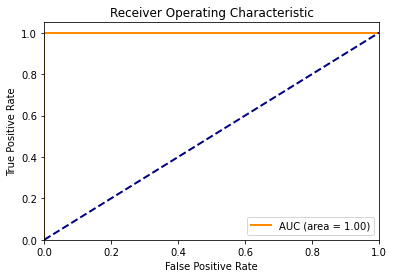

Accuracy for particle (in iteration 1, in fold 5) - 1 is 0.4828 At (gamma, c): [6.09085746 0.02471198]
Accuracy for particle (in iteration 1, in fold 5) - 2 is 0.9310 At (gamma, c): [6.02562202 6.40620196]
Accuracy for particle (in iteration 1, in fold 5) - 3 is 0.9655 At (gamma, c): [0.2905137 1.8092578]
Accuracy for particle (in iteration 1, in fold 5) - 4 is 0.9655 At (gamma, c): [0.13428649 7.136087  ]
Accuracy for particle (in iteration 1, in fold 5) - 5 is 1.0000 At (gamma, c): [0.77507207 2.08183062]
Accuracy for particle (in iteration 1, in fold 5) - 6 is 0.9310 At (gamma, c): [5.3282195  6.39392179]
Accuracy for particle (in iteration 1, in fold 5) - 7 is 0.9310 At (gamma, c): [3.23553268 8.27148981]
Accuracy for particle (in iteration 1, in fold 5) - 8 is 0.9655 At (gamma, c): [0.01830044 2.03313579]
Accuracy for particle (in iteration 1, in fold 5) - 9 is 0.9310 At (gamma, c): [3.63878111 9.78981345]
Accuracy for particle (in iteration 1, in fold 5) - 10 is 0.9310 At (gamma,

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 1, in fold 5) - 98 is 0.9310 At (gamma, c): [9.82444757 9.44519763]
Accuracy for particle (in iteration 1, in fold 5) - 99 is 0.9310 At (gamma, c): [4.61716704 3.25327889]
Accuracy for particle (in iteration 1, in fold 5) - 100 is 0.6552 At (gamma, c): [5.392532   0.43210873]
The best position in iteration 1, fold 5 is [3.68830628e+00 1.00000000e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0000
Confusion Matrix (Test):
[[14  0]
 [15  0]]
Confusion Matrix (Train):
[[129   0]
 [128   0]]

Iteration 2 - Fold 5:



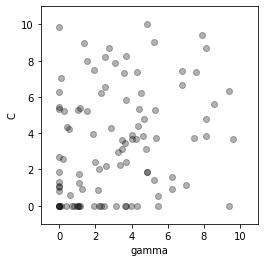

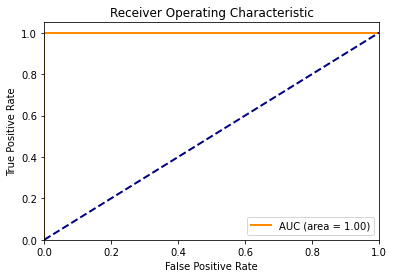

Accuracy for particle (in iteration 2, in fold 5) - 1 is 0.9310 At (gamma, c): [2.15738825 0.85277464]
Accuracy for particle (in iteration 2, in fold 5) - 2 is 0.9310 At (gamma, c): [9.38946685 6.32363548]
Accuracy for particle (in iteration 2, in fold 5) - 3 is 0.8621 At (gamma, c): [1.00000000e-03 1.10306979e+00]
Accuracy for particle (in iteration 2, in fold 5) - 4 is 0.9655 At (gamma, c): [1.56479201 8.00591215]
Accuracy for particle (in iteration 2, in fold 5) - 5 is 0.4828 At (gamma, c): [3.68830628e+00 1.00000000e-03]
Accuracy for particle (in iteration 2, in fold 5) - 6 is 0.9310 At (gamma, c): [6.22281407 0.93713547]
Accuracy for particle (in iteration 2, in fold 5) - 7 is 0.8621 At (gamma, c): [1.00000000e-03 5.32940726e+00]
Accuracy for particle (in iteration 2, in fold 5) - 8 is 0.8621 At (gamma, c): [1.00000000e-03 5.46286728e+00]
Accuracy for particle (in iteration 2, in fold 5) - 9 is 0.9310 At (gamma, c): [5.30802021 5.30389008]
Accuracy for particle (in iteration 2, in

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 2, in fold 5) - 96 is 0.9655 At (gamma, c): [1.95773377 2.4307988 ]
Accuracy for particle (in iteration 2, in fold 5) - 97 is 0.9655 At (gamma, c): [0.61748231 0.5691187 ]
Accuracy for particle (in iteration 2, in fold 5) - 98 is 0.9310 At (gamma, c): [4.77107891 3.13069098]
Accuracy for particle (in iteration 2, in fold 5) - 99 is 0.9655 At (gamma, c): [2.18251737 2.04252977]
Accuracy for particle (in iteration 2, in fold 5) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 2, fold 5 is [8.77819016e+00 1.00000000e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0000
Confusion Matrix (Test):
[[14  0]
 [15  0]]
Confusion Matrix (Train):
[[129   0]
 [128   0]]

Iteration 3 - Fold 5:



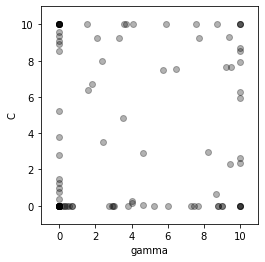

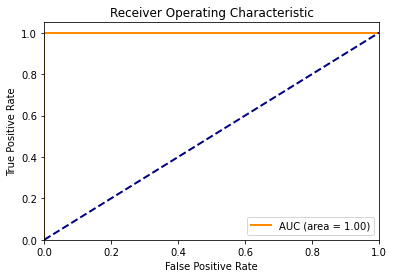

Accuracy for particle (in iteration 3, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 2.82361031e+00]
Accuracy for particle (in iteration 3, in fold 5) - 2 is 0.9310 At (gamma, c): [10.          6.29647906]
Accuracy for particle (in iteration 3, in fold 5) - 3 is 0.8276 At (gamma, c): [0.001      0.77511693]
Accuracy for particle (in iteration 3, in fold 5) - 4 is 0.9310 At (gamma, c): [ 4.07843226 10.        ]
Accuracy for particle (in iteration 3, in fold 5) - 5 is 0.4828 At (gamma, c): [8.77819016e+00 1.00000000e-03]
Accuracy for particle (in iteration 3, in fold 5) - 6 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 3, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 3, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 3, in fold 5) - 9 is 0.4828 At (gamma, c): [8.76661786e+00 1.00000000e-03]
Accuracy for particle (in iteration 3, in fold 5) - 10 is 0.8621 At (ga

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 3, in fold 5) - 90 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 3, in fold 5) - 91 is 0.9310 At (gamma, c): [ 3.67976809 10.        ]
Accuracy for particle (in iteration 3, in fold 5) - 92 is 0.9655 At (gamma, c): [ 1.52413187 10.        ]
Accuracy for particle (in iteration 3, in fold 5) - 93 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 3, in fold 5) - 94 is 0.4828 At (gamma, c): [7.65405428e+00 1.00000000e-03]
Accuracy for particle (in iteration 3, in fold 5) - 95 is 0.8621 At (gamma, c): [1.00000000e-03 9.56969258e+00]
Accuracy for particle (in iteration 3, in fold 5) - 96 is 0.9310 At (gamma, c): [2.42354363 3.49059953]
Accuracy for particle (in iteration 3, in fold 5) - 97 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 3, in fold 5) - 98 is 0.4828 At (gamma, c): [3.78640576e+00 1.00000000e-03]
Accuracy for particle (in iteration 3, in fold 5) - 99 is 0.5862 A

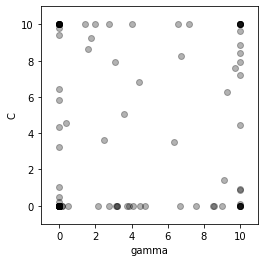

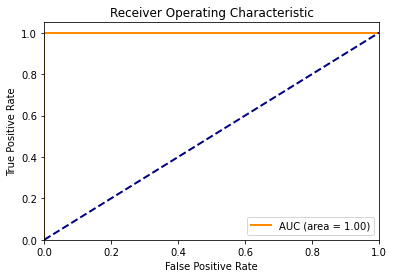

Accuracy for particle (in iteration 4, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 3.23654877e+00]
Accuracy for particle (in iteration 4, in fold 5) - 2 is 0.9310 At (gamma, c): [10.         7.1901208]
Accuracy for particle (in iteration 4, in fold 5) - 3 is 0.6552 At (gamma, c): [0.001      0.47844557]
Accuracy for particle (in iteration 4, in fold 5) - 4 is 0.9310 At (gamma, c): [ 6.55876609 10.        ]
Accuracy for particle (in iteration 4, in fold 5) - 5 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 4, in fold 5) - 6 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 4, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 4, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 4, in fold 5) - 9 is 0.4828 At (gamma, c): [8.56169042e+00 1.00000000e-03]
Accuracy for particle (in iteration 4, in fold 5) - 10 is 0.8621 At (gamma, c): [1.e-03 1

Accuracy for particle (in iteration 4, in fold 5) - 96 is 0.9310 At (gamma, c): [2.47110076 3.62323939]
Accuracy for particle (in iteration 4, in fold 5) - 97 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 4, in fold 5) - 98 is 0.4828 At (gamma, c): [3.19496268e+00 1.00000000e-03]
Accuracy for particle (in iteration 4, in fold 5) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 4, in fold 5) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 4, fold 5 is [1.e+01 1.e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0000
Confusion Matrix (Test):
[[14  0]
 [15  0]]
Confusion Matrix (Train):
[[129   0]
 [128   0]]

Iteration 5 - Fold 5:



C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


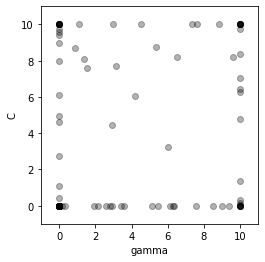

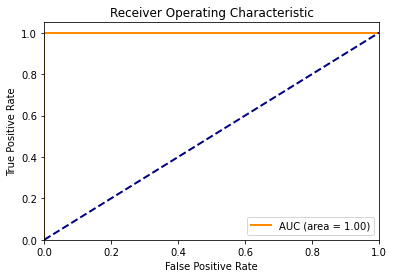

Accuracy for particle (in iteration 5, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 4.95005321e+00]
Accuracy for particle (in iteration 5, in fold 5) - 2 is 0.9310 At (gamma, c): [10.          6.41688429]
Accuracy for particle (in iteration 5, in fold 5) - 3 is 0.6207 At (gamma, c): [0.001      0.39898682]
Accuracy for particle (in iteration 5, in fold 5) - 4 is 0.9310 At (gamma, c): [ 7.58520068 10.        ]
Accuracy for particle (in iteration 5, in fold 5) - 5 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 5, in fold 5) - 6 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 5, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 5, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 5, in fold 5) - 9 is 0.4828 At (gamma, c): [9.39847608e+00 1.00000000e-03]
Accuracy for particle (in iteration 5, in fold 5) - 10 is 0.8621 At (gamma, c): [1.e-03

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 5, in fold 5) - 95 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 5, in fold 5) - 96 is 0.9310 At (gamma, c): [2.92359305 4.43868041]
Accuracy for particle (in iteration 5, in fold 5) - 97 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 5, in fold 5) - 98 is 0.4828 At (gamma, c): [1.92196909e+00 1.00000000e-03]
Accuracy for particle (in iteration 5, in fold 5) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 5, in fold 5) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 5, fold 5 is [1.e+01 1.e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0000
Confusion Matrix (Test):
[[14  0]
 [15  0]]
Confusion Matrix (Train):
[[129   0]
 [128   0]]

Iteration 6 - Fold 5:



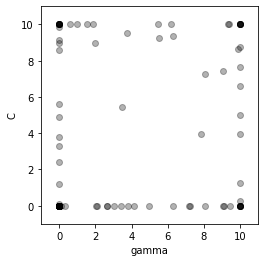

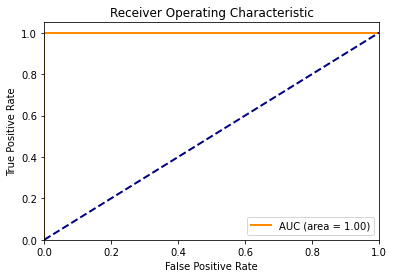

Accuracy for particle (in iteration 6, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 3.79493032e+00]
Accuracy for particle (in iteration 6, in fold 5) - 2 is 0.9310 At (gamma, c): [10.          3.96170895]
Accuracy for particle (in iteration 6, in fold 5) - 3 is 0.4828 At (gamma, c): [0.001      0.10896543]
Accuracy for particle (in iteration 6, in fold 5) - 4 is 0.9310 At (gamma, c): [ 6.18641226 10.        ]
Accuracy for particle (in iteration 6, in fold 5) - 5 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 6, in fold 5) - 6 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 6, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 6, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 6, in fold 5) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 6, in fold 5) - 10 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accurac

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 6, in fold 5) - 95 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 6, in fold 5) - 96 is 0.9310 At (gamma, c): [3.48706884 5.44915855]
Accuracy for particle (in iteration 6, in fold 5) - 97 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 6, in fold 5) - 98 is 0.4828 At (gamma, c): [2.04084708e+00 1.00000000e-03]
Accuracy for particle (in iteration 6, in fold 5) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 6, in fold 5) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 6, fold 5 is [1.e+01 1.e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0000
Confusion Matrix (Test):
[[14  0]
 [15  0]]
Confusion Matrix (Train):
[[129   0]
 [128   0]]

Iteration 7 - Fold 5:



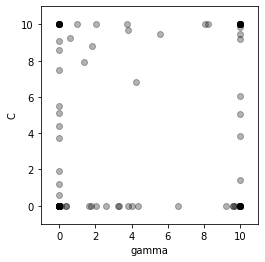

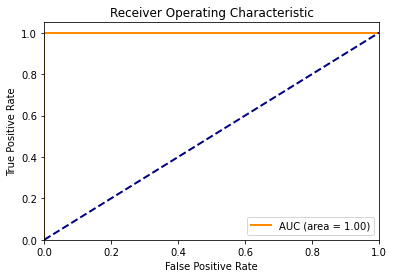

Accuracy for particle (in iteration 7, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 5.48349603e+00]
Accuracy for particle (in iteration 7, in fold 5) - 2 is 0.9310 At (gamma, c): [10.          3.84967765]
Accuracy for particle (in iteration 7, in fold 5) - 3 is 0.7241 At (gamma, c): [0.001      0.58200122]
Accuracy for particle (in iteration 7, in fold 5) - 4 is 0.9310 At (gamma, c): [ 8.22336101 10.        ]
Accuracy for particle (in iteration 7, in fold 5) - 5 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 7, in fold 5) - 6 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 7, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 7, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 7, in fold 5) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 7, in fold 5) - 10 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accurac

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 7, in fold 5) - 98 is 0.4828 At (gamma, c): [2.0381373e+00 1.0000000e-03]
Accuracy for particle (in iteration 7, in fold 5) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 7, in fold 5) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 7, fold 5 is [1.e+01 1.e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0000
Confusion Matrix (Test):
[[14  0]
 [15  0]]
Confusion Matrix (Train):
[[129   0]
 [128   0]]

Iteration 8 - Fold 5:



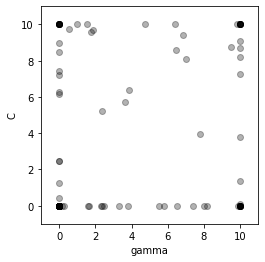

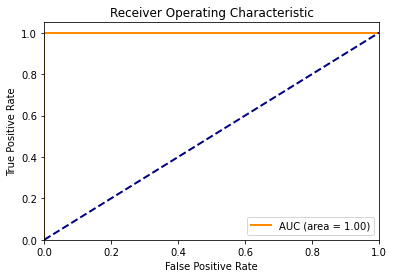

Accuracy for particle (in iteration 8, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 7.23408189e+00]
Accuracy for particle (in iteration 8, in fold 5) - 2 is 0.9310 At (gamma, c): [10.          3.79660856]
Accuracy for particle (in iteration 8, in fold 5) - 3 is 0.6207 At (gamma, c): [0.001      0.42597605]
Accuracy for particle (in iteration 8, in fold 5) - 4 is 0.9310 At (gamma, c): [ 9.80387792 10.        ]
Accuracy for particle (in iteration 8, in fold 5) - 5 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 8, in fold 5) - 6 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 8, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 8, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 8, in fold 5) - 9 is 0.4828 At (gamma, c): [8.18149719e+00 1.00000000e-03]
Accuracy for particle (in iteration 8, in fold 5) - 10 is 0.8621 At (gamma, c): [1.e-03

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 8, in fold 5) - 93 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 8, in fold 5) - 94 is 0.4828 At (gamma, c): [9.86753784e+00 1.00000000e-03]
Accuracy for particle (in iteration 8, in fold 5) - 95 is 0.8621 At (gamma, c): [1.00000000e-03 8.47095349e+00]
Accuracy for particle (in iteration 8, in fold 5) - 96 is 0.9310 At (gamma, c): [3.652004   5.74660024]
Accuracy for particle (in iteration 8, in fold 5) - 97 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 8, in fold 5) - 98 is 0.4828 At (gamma, c): [2.50443484e+00 1.00000000e-03]
Accuracy for particle (in iteration 8, in fold 5) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 8, in fold 5) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 8, fold 5 is [8.98930537e+00 1.00000000e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0000

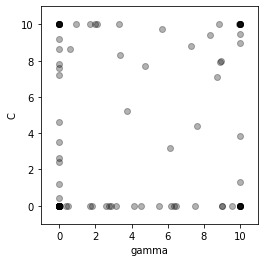

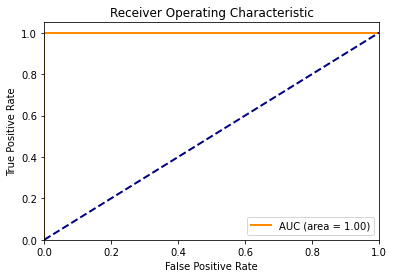

Accuracy for particle (in iteration 9, in fold 5) - 1 is 0.8621 At (gamma, c): [1.0000000e-03 3.4963202e+00]
Accuracy for particle (in iteration 9, in fold 5) - 2 is 0.9310 At (gamma, c): [10.          3.82329896]
Accuracy for particle (in iteration 9, in fold 5) - 3 is 0.6207 At (gamma, c): [0.001      0.42749699]
Accuracy for particle (in iteration 9, in fold 5) - 4 is 0.9310 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 9, in fold 5) - 5 is 0.4828 At (gamma, c): [8.98930537e+00 1.00000000e-03]
Accuracy for particle (in iteration 9, in fold 5) - 6 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 9, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 9, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 9, in fold 5) - 9 is 0.4828 At (gamma, c): [6.34826875e+00 1.00000000e-03]
Accuracy for particle (in iteration 9, in fold 5) - 10 is 0.8621 At (gamma, c): [1.000000

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 9, in fold 5) - 93 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 9, in fold 5) - 94 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 9, in fold 5) - 95 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 9, in fold 5) - 96 is 0.9310 At (gamma, c): [4.75667873 7.7243491 ]
Accuracy for particle (in iteration 9, in fold 5) - 97 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 9, in fold 5) - 98 is 0.4828 At (gamma, c): [2.76587412e+00 1.00000000e-03]
Accuracy for particle (in iteration 9, in fold 5) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 9, in fold 5) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 9, fold 5 is [8.17412373e+00 1.00000000e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0000
Confusion Matrix (Test):
[[14  

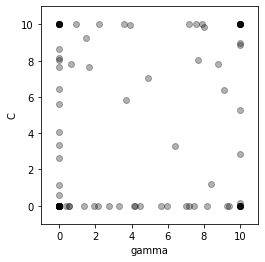

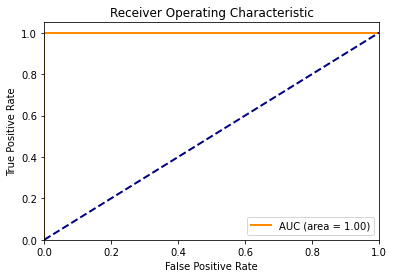

Accuracy for particle (in iteration 10, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 4.04565981e+00]
Accuracy for particle (in iteration 10, in fold 5) - 2 is 0.9310 At (gamma, c): [10.          2.84255783]
Accuracy for particle (in iteration 10, in fold 5) - 3 is 0.7241 At (gamma, c): [0.001      0.57422077]
Accuracy for particle (in iteration 10, in fold 5) - 4 is 0.9310 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 10, in fold 5) - 5 is 0.4828 At (gamma, c): [8.17412373e+00 1.00000000e-03]
Accuracy for particle (in iteration 10, in fold 5) - 6 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 10, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 10, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 10, in fold 5) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 10, in fold 5) - 10 is 0.8621 At (gamma, c): [1.00000000e-

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 10, in fold 5) - 97 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 10, in fold 5) - 98 is 0.4828 At (gamma, c): [3.29745188e+00 1.00000000e-03]
Accuracy for particle (in iteration 10, in fold 5) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 10, in fold 5) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 10, fold 5 is [8.8402399e+00 1.0000000e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0000
Confusion Matrix (Test):
[[14  0]
 [15  0]]
Confusion Matrix (Train):
[[129   0]
 [128   0]]

Iteration 11 - Fold 5:



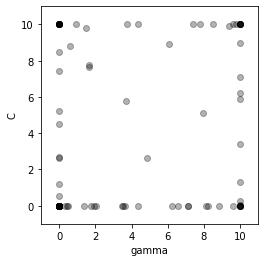

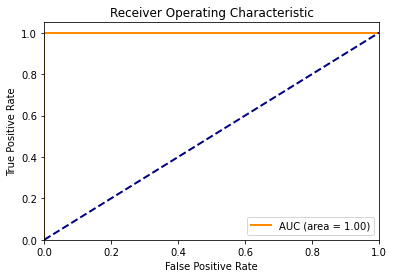

Accuracy for particle (in iteration 11, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 4.50953223e+00]
Accuracy for particle (in iteration 11, in fold 5) - 2 is 0.9310 At (gamma, c): [10.         3.3897335]
Accuracy for particle (in iteration 11, in fold 5) - 3 is 0.6552 At (gamma, c): [0.001      0.51197852]
Accuracy for particle (in iteration 11, in fold 5) - 4 is 0.9310 At (gamma, c): [ 9.58470134 10.        ]
Accuracy for particle (in iteration 11, in fold 5) - 5 is 0.4828 At (gamma, c): [8.8402399e+00 1.0000000e-03]
Accuracy for particle (in iteration 11, in fold 5) - 6 is 0.4828 At (gamma, c): [9.57998125e+00 1.00000000e-03]
Accuracy for particle (in iteration 11, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 11, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 11, in fold 5) - 9 is 0.4828 At (gamma, c): [8.21801823e+00 1.00000000e-03]
Accuracy for particle (in iteration 11, in fold 5)

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 11, in fold 5) - 95 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 11, in fold 5) - 96 is 0.9310 At (gamma, c): [3.6768801  5.79216867]
Accuracy for particle (in iteration 11, in fold 5) - 97 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 11, in fold 5) - 98 is 0.4828 At (gamma, c): [3.53075332e+00 1.00000000e-03]
Accuracy for particle (in iteration 11, in fold 5) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 11, in fold 5) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 11, fold 5 is [8.76513909e+00 1.00000000e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0000
Confusion Matrix (Test):
[[14  0]
 [15  0]]
Confusion Matrix (Train):
[[129   0]
 [128   0]]

Iteration 12 - Fold 5:



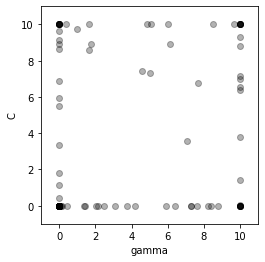

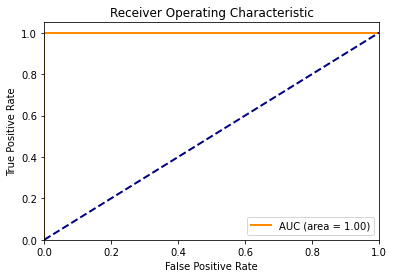

Accuracy for particle (in iteration 12, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 5.92559789e+00]
Accuracy for particle (in iteration 12, in fold 5) - 2 is 0.9310 At (gamma, c): [10.         3.7971383]
Accuracy for particle (in iteration 12, in fold 5) - 3 is 0.6207 At (gamma, c): [0.001      0.43967368]
Accuracy for particle (in iteration 12, in fold 5) - 4 is 0.9310 At (gamma, c): [ 6.00506039 10.        ]
Accuracy for particle (in iteration 12, in fold 5) - 5 is 0.4828 At (gamma, c): [8.76513909e+00 1.00000000e-03]
Accuracy for particle (in iteration 12, in fold 5) - 6 is 0.4828 At (gamma, c): [7.30235218e+00 1.00000000e-03]
Accuracy for particle (in iteration 12, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 12, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 12, in fold 5) - 9 is 0.4828 At (gamma, c): [8.40313976e+00 1.00000000e-03]
Accuracy for particle (in iteration 12, in fold 

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 12, in fold 5) - 95 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 12, in fold 5) - 96 is 0.9310 At (gamma, c): [4.59565465 7.43709881]
Accuracy for particle (in iteration 12, in fold 5) - 97 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 12, in fold 5) - 98 is 0.4828 At (gamma, c): [2.45611422e+00 1.00000000e-03]
Accuracy for particle (in iteration 12, in fold 5) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 12, in fold 5) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 12, fold 5 is [1.e+01 1.e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0000
Confusion Matrix (Test):
[[14  0]
 [15  0]]
Confusion Matrix (Train):
[[129   0]
 [128   0]]

Iteration 13 - Fold 5:



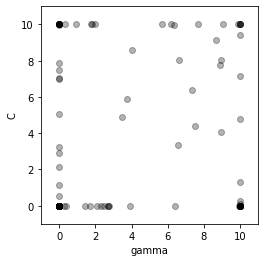

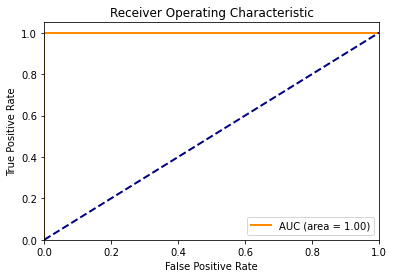

Accuracy for particle (in iteration 13, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 3.23360753e+00]
Accuracy for particle (in iteration 13, in fold 5) - 2 is 0.9310 At (gamma, c): [10.          4.80333617]
Accuracy for particle (in iteration 13, in fold 5) - 3 is 0.6552 At (gamma, c): [0.001    0.541609]
Accuracy for particle (in iteration 13, in fold 5) - 4 is 0.9310 At (gamma, c): [4.00654567 8.57364625]
Accuracy for particle (in iteration 13, in fold 5) - 5 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 13, in fold 5) - 6 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 13, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 13, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 13, in fold 5) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 13, in fold 5) - 10 is 0.8621 At (gamma, c): [1.00000000e-03 7.4

Accuracy for particle (in iteration 13, in fold 5) - 95 is 0.8621 At (gamma, c): [1.0000000e-03 9.9607484e+00]
Accuracy for particle (in iteration 13, in fold 5) - 96 is 0.9310 At (gamma, c): [3.72494848 5.8784142 ]
Accuracy for particle (in iteration 13, in fold 5) - 97 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 13, in fold 5) - 98 is 0.4828 At (gamma, c): [2.10543817e+00 1.00000000e-03]
Accuracy for particle (in iteration 13, in fold 5) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 13, in fold 5) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 13, fold 5 is [8.60017848e+00 1.00000000e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0000
Confusion Matrix (Test):
[[14  0]
 [15  0]]
Confusion Matrix (Train):
[[129   0]
 [128   0]]

Iteration 14 - Fold 5:



C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


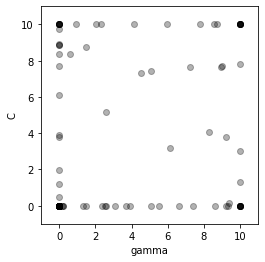

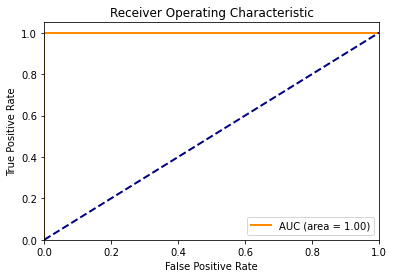

Accuracy for particle (in iteration 14, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 3.87582542e+00]
Accuracy for particle (in iteration 14, in fold 5) - 2 is 0.9310 At (gamma, c): [10.          3.02801484]
Accuracy for particle (in iteration 14, in fold 5) - 3 is 0.6552 At (gamma, c): [0.001      0.49173825]
Accuracy for particle (in iteration 14, in fold 5) - 4 is 0.9310 At (gamma, c): [ 5.98003017 10.        ]
Accuracy for particle (in iteration 14, in fold 5) - 5 is 0.4828 At (gamma, c): [8.60017848e+00 1.00000000e-03]
Accuracy for particle (in iteration 14, in fold 5) - 6 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 14, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 14, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 14, in fold 5) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 14, in fold 5) - 10 is 0.8621 At (gamma, c

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 14, in fold 5) - 89 is 0.4828 At (gamma, c): [9.18598258e+00 1.00000000e-03]
Accuracy for particle (in iteration 14, in fold 5) - 90 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 14, in fold 5) - 91 is 0.9310 At (gamma, c): [ 4.11129518 10.        ]
Accuracy for particle (in iteration 14, in fold 5) - 92 is 1.0000 At (gamma, c): [ 0.95073287 10.        ]
Accuracy for particle (in iteration 14, in fold 5) - 93 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 14, in fold 5) - 94 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 14, in fold 5) - 95 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 14, in fold 5) - 96 is 0.9310 At (gamma, c): [4.52102428 7.3036655 ]
Accuracy for particle (in iteration 14, in fold 5) - 97 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 14, in fold 5) - 98 is 0.4828 At (gamma, c): [2.52068

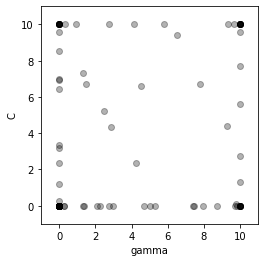

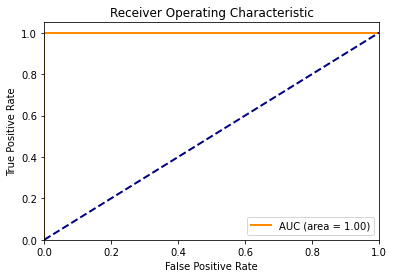

Accuracy for particle (in iteration 15, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 3.36186228e+00]
Accuracy for particle (in iteration 15, in fold 5) - 2 is 0.9310 At (gamma, c): [10.          2.76630828]
Accuracy for particle (in iteration 15, in fold 5) - 3 is 0.4828 At (gamma, c): [0.001     0.2576852]
Accuracy for particle (in iteration 15, in fold 5) - 4 is 0.9310 At (gamma, c): [ 5.76798448 10.        ]
Accuracy for particle (in iteration 15, in fold 5) - 5 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 15, in fold 5) - 6 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 15, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 15, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 15, in fold 5) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 15, in fold 5) - 10 is 0.8621 At (gamma, c): [1.00000000e-03

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 15, in fold 5) - 95 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 15, in fold 5) - 96 is 0.9310 At (gamma, c): [2.87839472 4.36291469]
Accuracy for particle (in iteration 15, in fold 5) - 97 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 15, in fold 5) - 98 is 0.4828 At (gamma, c): [2.27636539e+00 1.00000000e-03]
Accuracy for particle (in iteration 15, in fold 5) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 15, in fold 5) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 15, fold 5 is [7.9135812e+00 1.0000000e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0000
Confusion Matrix (Test):
[[14  0]
 [15  0]]
Confusion Matrix (Train):
[[129   0]
 [128   0]]

Iteration 16 - Fold 5:



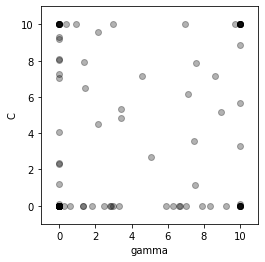

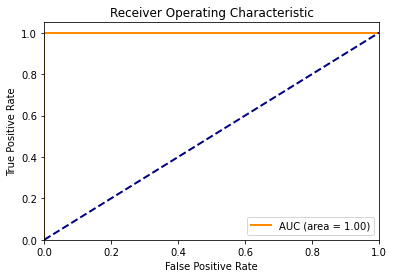

Accuracy for particle (in iteration 16, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 4.04707915e+00]
Accuracy for particle (in iteration 16, in fold 5) - 2 is 0.9310 At (gamma, c): [10.          3.30345147]
Accuracy for particle (in iteration 16, in fold 5) - 3 is 0.4828 At (gamma, c): [0.001      0.08825308]
Accuracy for particle (in iteration 16, in fold 5) - 4 is 0.9310 At (gamma, c): [ 6.95100037 10.        ]
Accuracy for particle (in iteration 16, in fold 5) - 5 is 0.4828 At (gamma, c): [7.9135812e+00 1.0000000e-03]
Accuracy for particle (in iteration 16, in fold 5) - 6 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 16, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 16, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 16, in fold 5) - 9 is 0.4828 At (gamma, c): [7.00291215e+00 1.00000000e-03]
Accuracy for particle (in iteration 16, in fold 5) - 10 is 0.862

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 16, in fold 5) - 88 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 16, in fold 5) - 89 is 0.4828 At (gamma, c): [9.20246642e+00 1.00000000e-03]
Accuracy for particle (in iteration 16, in fold 5) - 90 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 16, in fold 5) - 91 is 0.9310 At (gamma, c): [ 2.98868005 10.        ]
Accuracy for particle (in iteration 16, in fold 5) - 92 is 1.0000 At (gamma, c): [ 0.94398608 10.        ]
Accuracy for particle (in iteration 16, in fold 5) - 93 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 16, in fold 5) - 94 is 0.4828 At (gamma, c): [6.69262089e+00 1.00000000e-03]
Accuracy for particle (in iteration 16, in fold 5) - 95 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 16, in fold 5) - 96 is 0.9310 At (gamma, c): [3.41212729 5.31847943]
Accuracy for particle (in iteration 16, in fold 5) - 97 is 0.4828 At (gam

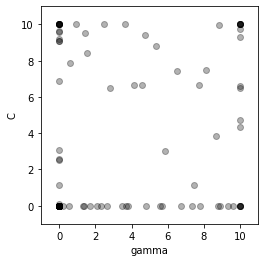

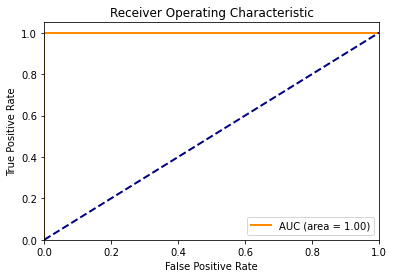

Accuracy for particle (in iteration 17, in fold 5) - 1 is 0.8621 At (gamma, c): [1.0000000e-03 3.0777359e+00]
Accuracy for particle (in iteration 17, in fold 5) - 2 is 0.9310 At (gamma, c): [10.          4.33213444]
Accuracy for particle (in iteration 17, in fold 5) - 3 is 0.4828 At (gamma, c): [0.001      0.07499889]
Accuracy for particle (in iteration 17, in fold 5) - 4 is 0.9310 At (gamma, c): [4.76183087 9.39394802]
Accuracy for particle (in iteration 17, in fold 5) - 5 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 17, in fold 5) - 6 is 0.4828 At (gamma, c): [7.35782436e+00 1.00000000e-03]
Accuracy for particle (in iteration 17, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 17, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 17, in fold 5) - 9 is 0.4828 At (gamma, c): [8.76614474e+00 1.00000000e-03]
Accuracy for particle (in iteration 17, in fold 5) - 10 is 0.8621 

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 17, in fold 5) - 97 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 17, in fold 5) - 98 is 0.4828 At (gamma, c): [1.72037137e+00 1.00000000e-03]
Accuracy for particle (in iteration 17, in fold 5) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 17, in fold 5) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 17, fold 5 is [1.e+01 1.e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0000
Confusion Matrix (Test):
[[14  0]
 [15  0]]
Confusion Matrix (Train):
[[129   0]
 [128   0]]

Iteration 18 - Fold 5:



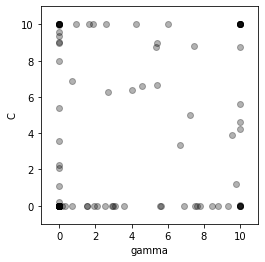

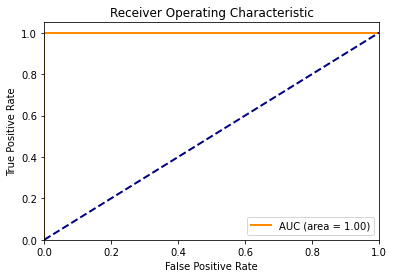

Accuracy for particle (in iteration 18, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 3.58857005e+00]
Accuracy for particle (in iteration 18, in fold 5) - 2 is 0.9310 At (gamma, c): [10.          4.20706855]
Accuracy for particle (in iteration 18, in fold 5) - 3 is 0.4828 At (gamma, c): [0.001      0.22848092]
Accuracy for particle (in iteration 18, in fold 5) - 4 is 0.9310 At (gamma, c): [ 6.02509498 10.        ]
Accuracy for particle (in iteration 18, in fold 5) - 5 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 18, in fold 5) - 6 is 0.4828 At (gamma, c): [7.76257213e+00 1.00000000e-03]
Accuracy for particle (in iteration 18, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 18, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 18, in fold 5) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 18, in fold 5) - 10 is 0.8621 At (gamma, c

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 18, in fold 5) - 98 is 0.4828 At (gamma, c): [2.10781322e+00 1.00000000e-03]
Accuracy for particle (in iteration 18, in fold 5) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 18, in fold 5) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 18, fold 5 is [1.e+01 1.e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0000
Confusion Matrix (Test):
[[14  0]
 [15  0]]
Confusion Matrix (Train):
[[129   0]
 [128   0]]

Iteration 19 - Fold 5:



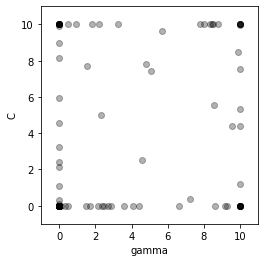

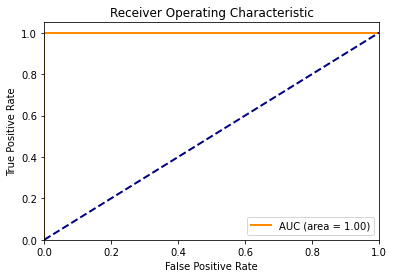

Accuracy for particle (in iteration 19, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 3.23605573e+00]
Accuracy for particle (in iteration 19, in fold 5) - 2 is 0.9310 At (gamma, c): [10.          4.38532681]
Accuracy for particle (in iteration 19, in fold 5) - 3 is 0.4828 At (gamma, c): [0.001      0.31324134]
Accuracy for particle (in iteration 19, in fold 5) - 4 is 0.9310 At (gamma, c): [ 7.75555773 10.        ]
Accuracy for particle (in iteration 19, in fold 5) - 5 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 19, in fold 5) - 6 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 19, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 19, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 19, in fold 5) - 9 is 0.4828 At (gamma, c): [9.13773617e+00 1.00000000e-03]
Accuracy for particle (in iteration 19, in fold 5) - 10 is 0.8621 At (gamma, c

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 19, in fold 5) - 92 is 1.0000 At (gamma, c): [ 0.94194581 10.        ]
Accuracy for particle (in iteration 19, in fold 5) - 93 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 19, in fold 5) - 94 is 0.4828 At (gamma, c): [9.29322597e+00 1.00000000e-03]
Accuracy for particle (in iteration 19, in fold 5) - 95 is 0.8621 At (gamma, c): [1.000000e-03 8.159641e+00]
Accuracy for particle (in iteration 19, in fold 5) - 96 is 0.9310 At (gamma, c): [4.80075556 7.80459102]
Accuracy for particle (in iteration 19, in fold 5) - 97 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 19, in fold 5) - 98 is 0.4828 At (gamma, c): [2.49640905e+00 1.00000000e-03]
Accuracy for particle (in iteration 19, in fold 5) - 99 is 0.4828 At (gamma, c): [0.001     0.0816571]
Accuracy for particle (in iteration 19, in fold 5) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 19, fold 5 is [1.e+01 1.e-03], wi

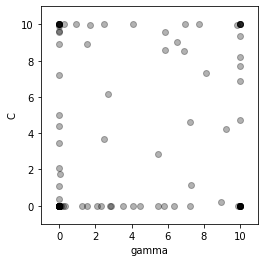

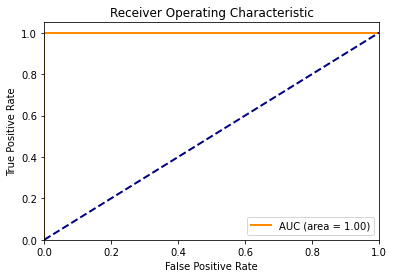

Accuracy for particle (in iteration 20, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 3.47815633e+00]
Accuracy for particle (in iteration 20, in fold 5) - 2 is 0.9310 At (gamma, c): [10.          4.71062823]
Accuracy for particle (in iteration 20, in fold 5) - 3 is 0.4828 At (gamma, c): [0.001      0.35825243]
Accuracy for particle (in iteration 20, in fold 5) - 4 is 0.9310 At (gamma, c): [ 7.70691706 10.        ]
Accuracy for particle (in iteration 20, in fold 5) - 5 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 20, in fold 5) - 6 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 20, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 20, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 20, in fold 5) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 20, in fold 5) - 10 is 0.8621 At (gamma, c): [1.e-03 1.e+0

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 20, in fold 5) - 96 is 0.9310 At (gamma, c): [2.483731   3.65636493]
Accuracy for particle (in iteration 20, in fold 5) - 97 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 20, in fold 5) - 98 is 0.4828 At (gamma, c): [2.84594143e+00 1.00000000e-03]
Accuracy for particle (in iteration 20, in fold 5) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 20, in fold 5) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 20, fold 5 is [8.33467078e+00 1.00000000e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0000
Confusion Matrix (Test):
[[14  0]
 [15  0]]
Confusion Matrix (Train):
[[129   0]
 [128   0]]

Iteration 21 - Fold 5:



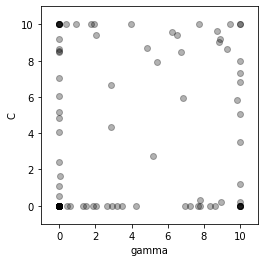

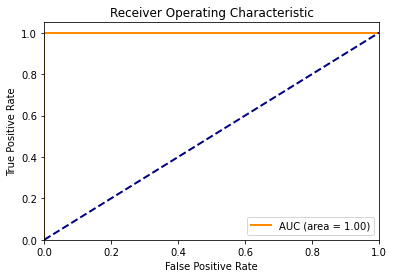

Accuracy for particle (in iteration 21, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 4.06509579e+00]
Accuracy for particle (in iteration 21, in fold 5) - 2 is 0.9310 At (gamma, c): [10.          3.50997912]
Accuracy for particle (in iteration 21, in fold 5) - 3 is 0.6552 At (gamma, c): [0.001      0.54376833]
Accuracy for particle (in iteration 21, in fold 5) - 4 is 0.9310 At (gamma, c): [ 7.71328296 10.        ]
Accuracy for particle (in iteration 21, in fold 5) - 5 is 0.4828 At (gamma, c): [8.33467078e+00 1.00000000e-03]
Accuracy for particle (in iteration 21, in fold 5) - 6 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 21, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 21, in fold 5) - 8 is 0.8621 At (gamma, c): [1.00000000e-03 9.19978728e+00]
Accuracy for particle (in iteration 21, in fold 5) - 9 is 0.4828 At (gamma, c): [8.61006628e+00 1.00000000e-03]
Accuracy for particle (in iteration 21, in fol

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 21, in fold 5) - 98 is 0.4828 At (gamma, c): [2.92268747e+00 1.00000000e-03]
Accuracy for particle (in iteration 21, in fold 5) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 21, in fold 5) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 21, fold 5 is [8.64496551e+00 1.00000000e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0000
Confusion Matrix (Test):
[[14  0]
 [15  0]]
Confusion Matrix (Train):
[[129   0]
 [128   0]]

Iteration 22 - Fold 5:



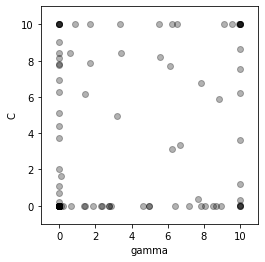

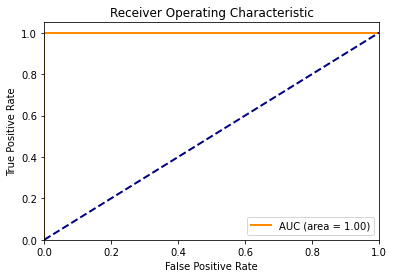

Accuracy for particle (in iteration 22, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 3.71980688e+00]
Accuracy for particle (in iteration 22, in fold 5) - 2 is 0.9310 At (gamma, c): [10.          3.60160916]
Accuracy for particle (in iteration 22, in fold 5) - 3 is 0.7931 At (gamma, c): [0.001      0.68640678]
Accuracy for particle (in iteration 22, in fold 5) - 4 is 0.9310 At (gamma, c): [ 6.49779692 10.        ]
Accuracy for particle (in iteration 22, in fold 5) - 5 is 0.4828 At (gamma, c): [8.64496551e+00 1.00000000e-03]
Accuracy for particle (in iteration 22, in fold 5) - 6 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 22, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 22, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 22, in fold 5) - 9 is 0.4828 At (gamma, c): [8.517289e+00 1.000000e-03]
Accuracy for particle (in iteration 22, in fold 5) - 10 is 0.8621 

Accuracy for particle (in iteration 22, in fold 5) - 94 is 0.4828 At (gamma, c): [8.03266043e+00 1.00000000e-03]
Accuracy for particle (in iteration 22, in fold 5) - 95 is 0.8621 At (gamma, c): [1.00000000e-03 7.78908774e+00]
Accuracy for particle (in iteration 22, in fold 5) - 96 is 0.9310 At (gamma, c): [3.2058275  4.94915601]
Accuracy for particle (in iteration 22, in fold 5) - 97 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 22, in fold 5) - 98 is 0.4828 At (gamma, c): [2.30524183e+00 1.00000000e-03]
Accuracy for particle (in iteration 22, in fold 5) - 99 is 0.4828 At (gamma, c): [0.001      0.21699177]
Accuracy for particle (in iteration 22, in fold 5) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 22, fold 5 is [1.e+01 1.e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0000
Confusion Matrix (Test):
[[14  0]
 [15  0]]
Confusion Matrix (Train):
[[129   0]
 [128   0]

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


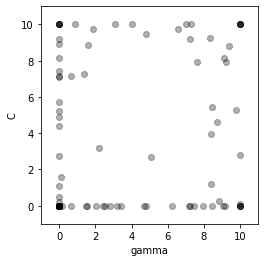

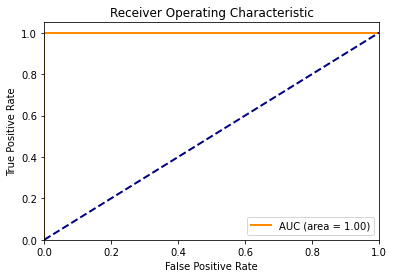

Accuracy for particle (in iteration 23, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 4.87955568e+00]
Accuracy for particle (in iteration 23, in fold 5) - 2 is 0.9310 At (gamma, c): [10.          2.79140388]
Accuracy for particle (in iteration 23, in fold 5) - 3 is 0.6552 At (gamma, c): [0.001      0.50625744]
Accuracy for particle (in iteration 23, in fold 5) - 4 is 0.9310 At (gamma, c): [4.81939501 9.46188684]
Accuracy for particle (in iteration 23, in fold 5) - 5 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 23, in fold 5) - 6 is 0.4828 At (gamma, c): [9.13744786e+00 1.00000000e-03]
Accuracy for particle (in iteration 23, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 23, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 23, in fold 5) - 9 is 0.4828 At (gamma, c): [7.43401199e+00 1.00000000e-03]
Accuracy for particle (in iteration 23, in fold 5) - 10 is 0.862

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 23, in fold 5) - 97 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 23, in fold 5) - 98 is 0.4828 At (gamma, c): [2.44232732e+00 1.00000000e-03]
Accuracy for particle (in iteration 23, in fold 5) - 99 is 0.4828 At (gamma, c): [0.001      0.21633367]
Accuracy for particle (in iteration 23, in fold 5) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 23, fold 5 is [1.e+01 1.e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0000
Confusion Matrix (Test):
[[14  0]
 [15  0]]
Confusion Matrix (Train):
[[129   0]
 [128   0]]

Iteration 24 - Fold 5:



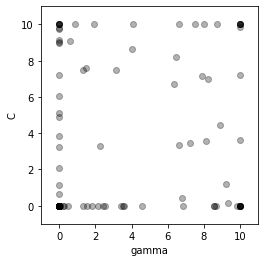

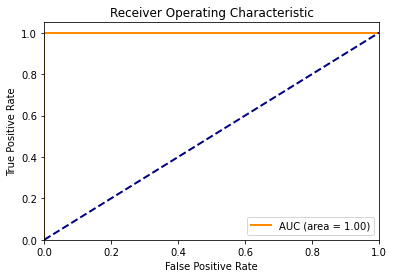

Accuracy for particle (in iteration 24, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 4.89055831e+00]
Accuracy for particle (in iteration 24, in fold 5) - 2 is 0.9310 At (gamma, c): [10.          3.60548028]
Accuracy for particle (in iteration 24, in fold 5) - 3 is 0.7586 At (gamma, c): [0.001      0.61782268]
Accuracy for particle (in iteration 24, in fold 5) - 4 is 0.9310 At (gamma, c): [4.01385343 8.65884509]
Accuracy for particle (in iteration 24, in fold 5) - 5 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 24, in fold 5) - 6 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 24, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 24, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 24, in fold 5) - 9 is 0.4828 At (gamma, c): [8.52651582e+00 1.00000000e-03]
Accuracy for particle (in iteration 24, in fold 5) - 10 is 0.8621 At (gamma, c):

Accuracy for particle (in iteration 24, in fold 5) - 90 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 24, in fold 5) - 91 is 0.9310 At (gamma, c): [ 4.09829537 10.        ]
Accuracy for particle (in iteration 24, in fold 5) - 92 is 1.0000 At (gamma, c): [ 0.90425239 10.        ]
Accuracy for particle (in iteration 24, in fold 5) - 93 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 24, in fold 5) - 94 is 0.4828 At (gamma, c): [8.57458964e+00 1.00000000e-03]
Accuracy for particle (in iteration 24, in fold 5) - 95 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 24, in fold 5) - 96 is 0.9655 At (gamma, c): [2.26978525 3.27333316]
Accuracy for particle (in iteration 24, in fold 5) - 97 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 24, in fold 5) - 98 is 0.4828 At (gamma, c): [2.54181717e+00 1.00000000e-03]
Accuracy for particle (in iteration 24, in fold 5) - 99 is 0.4828 At (gam

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


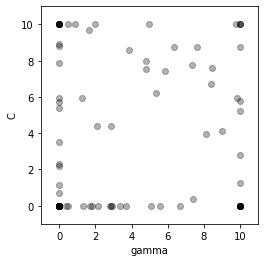

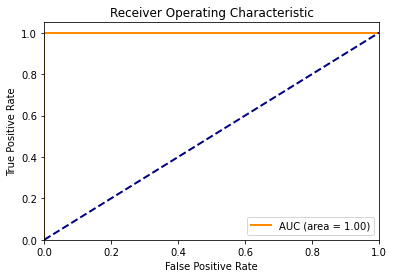

Accuracy for particle (in iteration 25, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 3.51571601e+00]
Accuracy for particle (in iteration 25, in fold 5) - 2 is 0.9310 At (gamma, c): [10.          2.77720729]
Accuracy for particle (in iteration 25, in fold 5) - 3 is 0.7931 At (gamma, c): [0.001      0.67543223]
Accuracy for particle (in iteration 25, in fold 5) - 4 is 0.9310 At (gamma, c): [3.8688264  8.59529782]
Accuracy for particle (in iteration 25, in fold 5) - 5 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 25, in fold 5) - 6 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 25, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 25, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 25, in fold 5) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 25, in fold 5) - 10 is 0.8621 At (gamma, c): [1.e-03 1.e+01]

Accuracy for particle (in iteration 25, in fold 5) - 85 is 0.9655 At (gamma, c): [ 2.00655766 10.        ]
Accuracy for particle (in iteration 25, in fold 5) - 86 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 25, in fold 5) - 87 is 0.9310 At (gamma, c): [10.          5.75212732]
Accuracy for particle (in iteration 25, in fold 5) - 88 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 25, in fold 5) - 89 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 25, in fold 5) - 90 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 25, in fold 5) - 91 is 0.9310 At (gamma, c): [ 4.97101941 10.        ]
Accuracy for particle (in iteration 25, in fold 5) - 92 is 1.0000 At (gamma, c): [ 0.88774167 10.        ]
Accuracy for particle (in iteration 25, in fold 5) - 93 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 25, in fold 5) - 94 is 0.4828 At (gamma, c): [1.e+01 1.e-03

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


The best position in iteration 25, fold 5 is [9.36231967e+00 1.00000000e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0000
Confusion Matrix (Test):
[[14  0]
 [15  0]]
Confusion Matrix (Train):
[[129   0]
 [128   0]]

Iteration 26 - Fold 5:



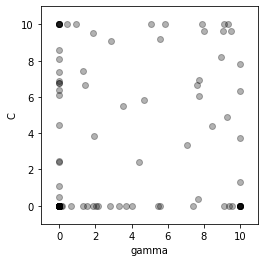

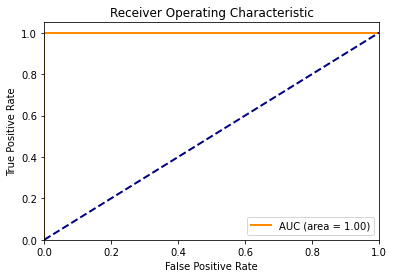

Accuracy for particle (in iteration 26, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 4.44684037e+00]
Accuracy for particle (in iteration 26, in fold 5) - 2 is 0.9310 At (gamma, c): [10.         3.7091856]
Accuracy for particle (in iteration 26, in fold 5) - 3 is 0.6552 At (gamma, c): [0.001      0.46941429]
Accuracy for particle (in iteration 26, in fold 5) - 4 is 0.9310 At (gamma, c): [ 5.09033644 10.        ]
Accuracy for particle (in iteration 26, in fold 5) - 5 is 0.4828 At (gamma, c): [9.36231967e+00 1.00000000e-03]
Accuracy for particle (in iteration 26, in fold 5) - 6 is 0.4828 At (gamma, c): [9.99767211e+00 1.00000000e-03]
Accuracy for particle (in iteration 26, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 26, in fold 5) - 8 is 0.8621 At (gamma, c): [1.00000000e-03 8.57869705e+00]
Accuracy for particle (in iteration 26, in fold 5) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 26, in fold 

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 26, in fold 5) - 98 is 0.4828 At (gamma, c): [2.04685908e+00 1.00000000e-03]
Accuracy for particle (in iteration 26, in fold 5) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 26, in fold 5) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 26, fold 5 is [7.81815273e+00 1.00000000e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0000
Confusion Matrix (Test):
[[14  0]
 [15  0]]
Confusion Matrix (Train):
[[129   0]
 [128   0]]

Iteration 27 - Fold 5:



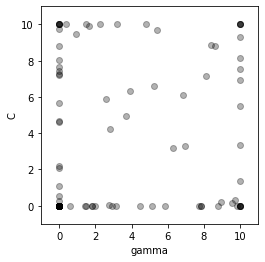

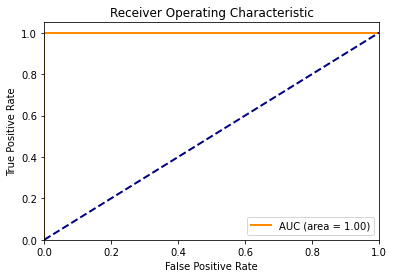

Accuracy for particle (in iteration 27, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 4.69473538e+00]
Accuracy for particle (in iteration 27, in fold 5) - 2 is 0.9310 At (gamma, c): [10.          3.33786723]
Accuracy for particle (in iteration 27, in fold 5) - 3 is 0.6552 At (gamma, c): [0.001      0.50860338]
Accuracy for particle (in iteration 27, in fold 5) - 4 is 0.9310 At (gamma, c): [ 4.78249625 10.        ]
Accuracy for particle (in iteration 27, in fold 5) - 5 is 0.4828 At (gamma, c): [7.81815273e+00 1.00000000e-03]
Accuracy for particle (in iteration 27, in fold 5) - 6 is 0.4828 At (gamma, c): [7.71054843e+00 1.00000000e-03]
Accuracy for particle (in iteration 27, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 27, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 27, in fold 5) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 27, in fold 5) - 10 is 0.8

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 27, in fold 5) - 98 is 0.4828 At (gamma, c): [2.00502329e+00 1.00000000e-03]
Accuracy for particle (in iteration 27, in fold 5) - 99 is 0.4828 At (gamma, c): [0.001      0.24483205]
Accuracy for particle (in iteration 27, in fold 5) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 27, fold 5 is [9.49383966e+00 1.00000000e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0000
Confusion Matrix (Test):
[[14  0]
 [15  0]]
Confusion Matrix (Train):
[[129   0]
 [128   0]]

Iteration 28 - Fold 5:



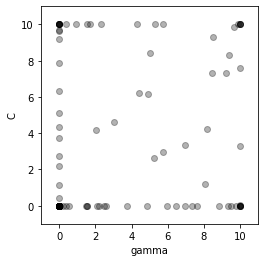

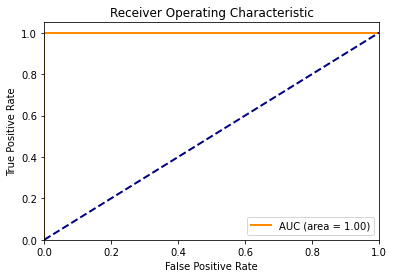

Accuracy for particle (in iteration 28, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 3.71288269e+00]
Accuracy for particle (in iteration 28, in fold 5) - 2 is 0.9310 At (gamma, c): [10.          3.30678452]
Accuracy for particle (in iteration 28, in fold 5) - 3 is 0.6552 At (gamma, c): [0.001      0.44523636]
Accuracy for particle (in iteration 28, in fold 5) - 4 is 0.9310 At (gamma, c): [ 5.27184435 10.        ]
Accuracy for particle (in iteration 28, in fold 5) - 5 is 0.4828 At (gamma, c): [9.49383966e+00 1.00000000e-03]
Accuracy for particle (in iteration 28, in fold 5) - 6 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 28, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 28, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 28, in fold 5) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 28, in fold 5) - 10 is 0.8621 At (gamma, c

Accuracy for particle (in iteration 28, in fold 5) - 91 is 0.9310 At (gamma, c): [ 4.32134884 10.        ]
Accuracy for particle (in iteration 28, in fold 5) - 92 is 1.0000 At (gamma, c): [ 0.94692986 10.        ]
Accuracy for particle (in iteration 28, in fold 5) - 93 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 28, in fold 5) - 94 is 0.4828 At (gamma, c): [7.31221514e+00 1.00000000e-03]
Accuracy for particle (in iteration 28, in fold 5) - 95 is 0.8621 At (gamma, c): [1.00000000e-03 9.68174791e+00]
Accuracy for particle (in iteration 28, in fold 5) - 96 is 0.9310 At (gamma, c): [3.02137801 4.61893139]
Accuracy for particle (in iteration 28, in fold 5) - 97 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 28, in fold 5) - 98 is 0.4828 At (gamma, c): [2.22523627e+00 1.00000000e-03]
Accuracy for particle (in iteration 28, in fold 5) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 28, in fold 5) - 100 

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


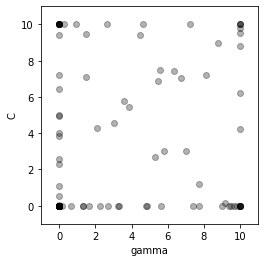

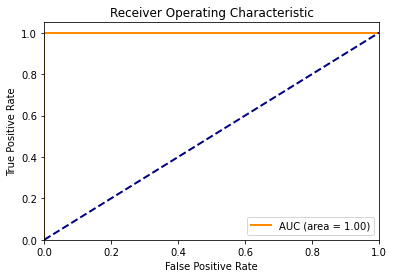

Accuracy for particle (in iteration 29, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 4.97059731e+00]
Accuracy for particle (in iteration 29, in fold 5) - 2 is 0.9310 At (gamma, c): [10.          4.20449584]
Accuracy for particle (in iteration 29, in fold 5) - 3 is 0.6552 At (gamma, c): [0.001      0.51608405]
Accuracy for particle (in iteration 29, in fold 5) - 4 is 0.9310 At (gamma, c): [4.47341927 9.42691313]
Accuracy for particle (in iteration 29, in fold 5) - 5 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 29, in fold 5) - 6 is 0.4828 At (gamma, c): [7.4105303e+00 1.0000000e-03]
Accuracy for particle (in iteration 29, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 29, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 29, in fold 5) - 9 is 0.4828 At (gamma, c): [9.49456052e+00 1.00000000e-03]
Accuracy for particle (in iteration 29, in fold 5) - 10 is 0.8621 

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 29, in fold 5) - 93 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 29, in fold 5) - 94 is 0.4828 At (gamma, c): [9.37624164e+00 1.00000000e-03]
Accuracy for particle (in iteration 29, in fold 5) - 95 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 29, in fold 5) - 96 is 0.9310 At (gamma, c): [3.00392534 4.58768537]
Accuracy for particle (in iteration 29, in fold 5) - 97 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 29, in fold 5) - 98 is 0.4828 At (gamma, c): [2.27051985e+00 1.00000000e-03]
Accuracy for particle (in iteration 29, in fold 5) - 99 is 0.4828 At (gamma, c): [0.001      0.02982264]
Accuracy for particle (in iteration 29, in fold 5) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 29, fold 5 is [1.e+01 1.e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0000
Confusion Ma

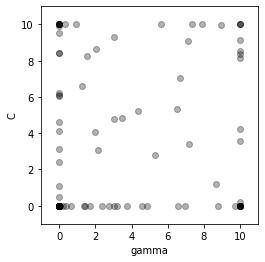

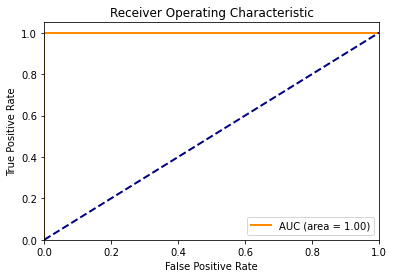

Accuracy for particle (in iteration 30, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 6.12913576e+00]
Accuracy for particle (in iteration 30, in fold 5) - 2 is 0.9310 At (gamma, c): [10.          3.54354586]
Accuracy for particle (in iteration 30, in fold 5) - 3 is 0.6552 At (gamma, c): [0.001      0.45873318]
Accuracy for particle (in iteration 30, in fold 5) - 4 is 0.9310 At (gamma, c): [ 5.60476187 10.        ]
Accuracy for particle (in iteration 30, in fold 5) - 5 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 30, in fold 5) - 6 is 0.4828 At (gamma, c): [8.75423585e+00 1.00000000e-03]
Accuracy for particle (in iteration 30, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 30, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 30, in fold 5) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 30, in fold 5) - 10 is 0.8621 At (gamma, c

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 30, in fold 5) - 96 is 0.9655 At (gamma, c): [2.15305587 3.0643492 ]
Accuracy for particle (in iteration 30, in fold 5) - 97 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 30, in fold 5) - 98 is 0.4828 At (gamma, c): [2.3943926e+00 1.0000000e-03]
Accuracy for particle (in iteration 30, in fold 5) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 30, in fold 5) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 30, fold 5 is [1.e+01 1.e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0000
Confusion Matrix (Test):
[[14  0]
 [15  0]]
Confusion Matrix (Train):
[[129   0]
 [128   0]]

Iteration 31 - Fold 5:



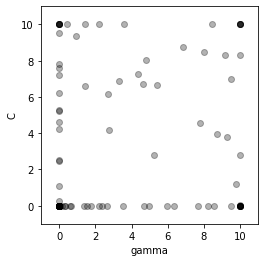

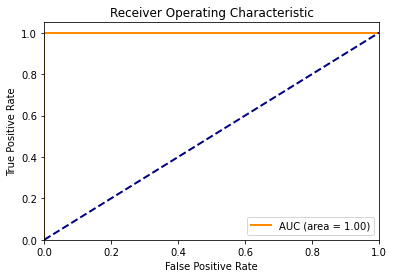

Accuracy for particle (in iteration 31, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 5.24010695e+00]
Accuracy for particle (in iteration 31, in fold 5) - 2 is 0.9310 At (gamma, c): [10.          2.77624559]
Accuracy for particle (in iteration 31, in fold 5) - 3 is 0.4828 At (gamma, c): [0.001      0.28364809]
Accuracy for particle (in iteration 31, in fold 5) - 4 is 0.9310 At (gamma, c): [3.32058642 6.8847804 ]
Accuracy for particle (in iteration 31, in fold 5) - 5 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 31, in fold 5) - 6 is 0.4828 At (gamma, c): [7.67487274e+00 1.00000000e-03]
Accuracy for particle (in iteration 31, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 31, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 31, in fold 5) - 9 is 0.4828 At (gamma, c): [8.54899323e+00 1.00000000e-03]
Accuracy for particle (in iteration 31, in fold 5) - 10 is 0.862

Accuracy for particle (in iteration 31, in fold 5) - 97 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 31, in fold 5) - 98 is 0.4828 At (gamma, c): [2.19486378e+00 1.00000000e-03]
Accuracy for particle (in iteration 31, in fold 5) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 31, in fold 5) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 31, fold 5 is [7.96435919e+00 1.00000000e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0000
Confusion Matrix (Test):
[[14  0]
 [15  0]]
Confusion Matrix (Train):
[[129   0]
 [128   0]]

Iteration 32 - Fold 5:



C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


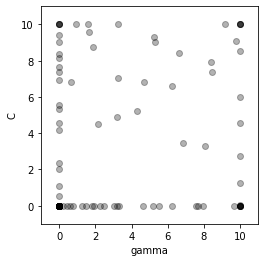

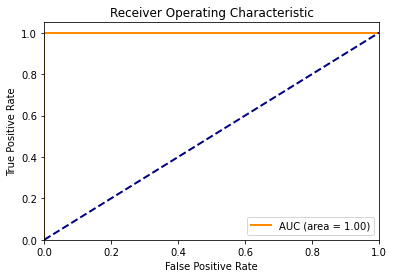

Accuracy for particle (in iteration 32, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 5.56568609e+00]
Accuracy for particle (in iteration 32, in fold 5) - 2 is 0.9310 At (gamma, c): [10.          2.72932348]
Accuracy for particle (in iteration 32, in fold 5) - 3 is 0.6897 At (gamma, c): [0.001     0.5590808]
Accuracy for particle (in iteration 32, in fold 5) - 4 is 0.9310 At (gamma, c): [3.27931314 7.05985031]
Accuracy for particle (in iteration 32, in fold 5) - 5 is 0.4828 At (gamma, c): [7.96435919e+00 1.00000000e-03]
Accuracy for particle (in iteration 32, in fold 5) - 6 is 0.4828 At (gamma, c): [6.24034958e+00 1.00000000e-03]
Accuracy for particle (in iteration 32, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 32, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 32, in fold 5) - 9 is 0.4828 At (gamma, c): [7.64518016e+00 1.00000000e-03]
Accuracy for particle (in iteration 32, in fold 5)

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 32, in fold 5) - 94 is 0.4828 At (gamma, c): [9.63096949e+00 1.00000000e-03]
Accuracy for particle (in iteration 32, in fold 5) - 95 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 32, in fold 5) - 96 is 0.9310 At (gamma, c): [3.1742593  4.89263918]
Accuracy for particle (in iteration 32, in fold 5) - 97 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 32, in fold 5) - 98 is 0.4828 At (gamma, c): [2.24432331e+00 1.00000000e-03]
Accuracy for particle (in iteration 32, in fold 5) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 32, in fold 5) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 32, fold 5 is [7.28526715e+00 1.00000000e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0000
Confusion Matrix (Test):
[[14  0]
 [15  0]]
Confusion Matrix (Train):
[[129   0]
 [128   0]]

Iterati

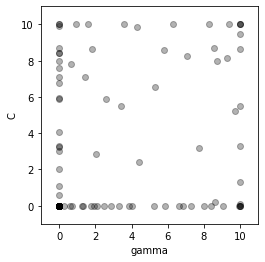

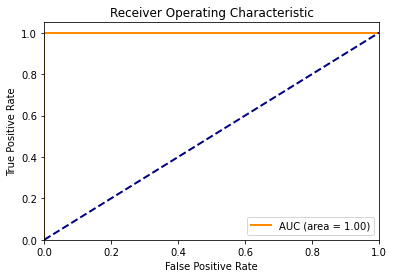

Accuracy for particle (in iteration 33, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 3.29296545e+00]
Accuracy for particle (in iteration 33, in fold 5) - 2 is 0.9310 At (gamma, c): [10.         3.2774871]
Accuracy for particle (in iteration 33, in fold 5) - 3 is 0.7241 At (gamma, c): [0.001      0.57491513]
Accuracy for particle (in iteration 33, in fold 5) - 4 is 0.9310 At (gamma, c): [4.31970291 9.88390394]
Accuracy for particle (in iteration 33, in fold 5) - 5 is 0.4828 At (gamma, c): [7.28526715e+00 1.00000000e-03]
Accuracy for particle (in iteration 33, in fold 5) - 6 is 0.4828 At (gamma, c): [7.99099504e+00 1.00000000e-03]
Accuracy for particle (in iteration 33, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 33, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 33, in fold 5) - 9 is 0.4828 At (gamma, c): [8.40156004e+00 1.00000000e-03]
Accuracy for particle (in iteration 33, in fold 5)

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 33, in fold 5) - 93 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 33, in fold 5) - 94 is 0.4828 At (gamma, c): [9.91542081e+00 1.00000000e-03]
Accuracy for particle (in iteration 33, in fold 5) - 95 is 0.8621 At (gamma, c): [1.00000000e-03 9.92659671e+00]
Accuracy for particle (in iteration 33, in fold 5) - 96 is 0.9655 At (gamma, c): [2.03169817 2.84707902]
Accuracy for particle (in iteration 33, in fold 5) - 97 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 33, in fold 5) - 98 is 0.4828 At (gamma, c): [1.77189173e+00 1.00000000e-03]
Accuracy for particle (in iteration 33, in fold 5) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 33, in fold 5) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 33, fold 5 is [7.73088614e+00 1.00000000e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Scor

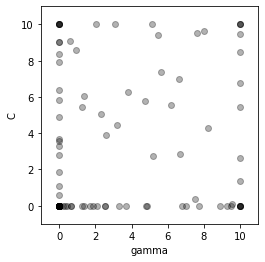

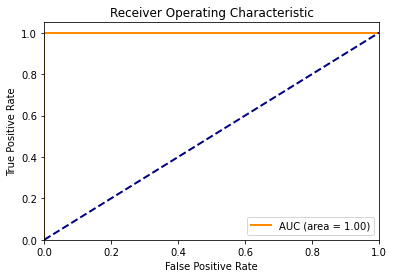

Accuracy for particle (in iteration 34, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 3.27210497e+00]
Accuracy for particle (in iteration 34, in fold 5) - 2 is 0.9310 At (gamma, c): [10.          2.63602005]
Accuracy for particle (in iteration 34, in fold 5) - 3 is 0.7586 At (gamma, c): [0.001      0.61178504]
Accuracy for particle (in iteration 34, in fold 5) - 4 is 0.9310 At (gamma, c): [ 5.15272609 10.        ]
Accuracy for particle (in iteration 34, in fold 5) - 5 is 0.4828 At (gamma, c): [7.73088614e+00 1.00000000e-03]
Accuracy for particle (in iteration 34, in fold 5) - 6 is 0.4828 At (gamma, c): [6.78169754e+00 1.00000000e-03]
Accuracy for particle (in iteration 34, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 34, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 34, in fold 5) - 9 is 0.4828 At (gamma, c): [8.88648348e+00 1.00000000e-03]
Accuracy for particle (in iteration 34, in fol

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 34, in fold 5) - 93 is 0.4828 At (gamma, c): [0.04935282 0.001     ]
Accuracy for particle (in iteration 34, in fold 5) - 94 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 34, in fold 5) - 95 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 34, in fold 5) - 96 is 0.9310 At (gamma, c): [2.61076765 3.88380382]
Accuracy for particle (in iteration 34, in fold 5) - 97 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 34, in fold 5) - 98 is 0.4828 At (gamma, c): [1.72118738e+00 1.00000000e-03]
Accuracy for particle (in iteration 34, in fold 5) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 34, in fold 5) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 34, fold 5 is [9.73531964e+00 1.00000000e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0000
Confusion Ma

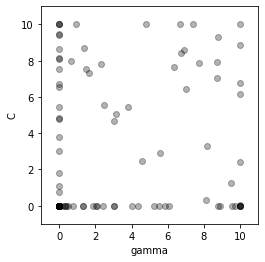

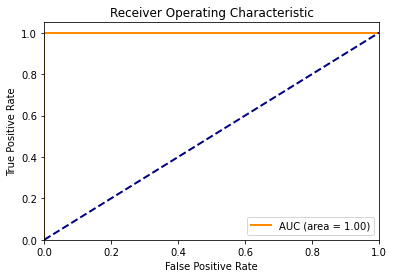

Accuracy for particle (in iteration 35, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 3.79290225e+00]
Accuracy for particle (in iteration 35, in fold 5) - 2 is 0.9310 At (gamma, c): [9.96042704 2.40811122]
Accuracy for particle (in iteration 35, in fold 5) - 3 is 0.7931 At (gamma, c): [0.001      0.74469099]
Accuracy for particle (in iteration 35, in fold 5) - 4 is 0.9310 At (gamma, c): [ 4.78670864 10.        ]
Accuracy for particle (in iteration 35, in fold 5) - 5 is 0.4828 At (gamma, c): [9.73531964e+00 1.00000000e-03]
Accuracy for particle (in iteration 35, in fold 5) - 6 is 0.4828 At (gamma, c): [5.84597053e+00 1.00000000e-03]
Accuracy for particle (in iteration 35, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 35, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 35, in fold 5) - 9 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 35, in fold 5) - 10 is 0.862

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 35, in fold 5) - 96 is 0.9310 At (gamma, c): [3.05798994 4.68447879]
Accuracy for particle (in iteration 35, in fold 5) - 97 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 35, in fold 5) - 98 is 0.4828 At (gamma, c): [2.03272609e+00 1.00000000e-03]
Accuracy for particle (in iteration 35, in fold 5) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 35, in fold 5) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 35, fold 5 is [6.02758234e+00 1.00000000e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0000
Confusion Matrix (Test):
[[14  0]
 [15  0]]
Confusion Matrix (Train):
[[129   0]
 [128   0]]

Iteration 36 - Fold 5:



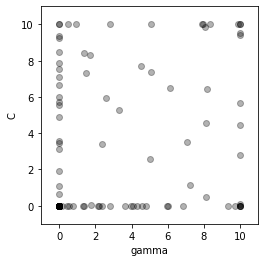

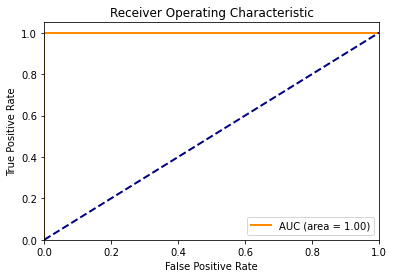

Accuracy for particle (in iteration 36, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 3.45085952e+00]
Accuracy for particle (in iteration 36, in fold 5) - 2 is 0.9310 At (gamma, c): [10.          2.78831183]
Accuracy for particle (in iteration 36, in fold 5) - 3 is 0.7586 At (gamma, c): [0.001      0.63816312]
Accuracy for particle (in iteration 36, in fold 5) - 4 is 0.9310 At (gamma, c): [ 5.05212972 10.        ]
Accuracy for particle (in iteration 36, in fold 5) - 5 is 0.4828 At (gamma, c): [6.02758234e+00 1.00000000e-03]
Accuracy for particle (in iteration 36, in fold 5) - 6 is 0.4828 At (gamma, c): [9.30809625e+00 1.00000000e-03]
Accuracy for particle (in iteration 36, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 36, in fold 5) - 8 is 0.8621 At (gamma, c): [1.00000000e-03 7.89320284e+00]
Accuracy for particle (in iteration 36, in fold 5) - 9 is 0.4828 At (gamma, c): [5.96994407e+00 1.00000000e-03]
Accuracy for particle (in iter

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 36, in fold 5) - 90 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 36, in fold 5) - 91 is 0.9310 At (gamma, c): [ 2.82275918 10.        ]
Accuracy for particle (in iteration 36, in fold 5) - 92 is 1.0000 At (gamma, c): [ 0.95787474 10.        ]
Accuracy for particle (in iteration 36, in fold 5) - 93 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 36, in fold 5) - 94 is 0.4828 At (gamma, c): [4.78487946e+00 1.00000000e-03]
Accuracy for particle (in iteration 36, in fold 5) - 95 is 0.8621 At (gamma, c): [1.0000000e-03 5.7218095e+00]
Accuracy for particle (in iteration 36, in fold 5) - 96 is 0.9655 At (gamma, c): [2.3472847  3.41208269]
Accuracy for particle (in iteration 36, in fold 5) - 97 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 36, in fold 5) - 98 is 0.4828 At (gamma, c): [2.34784723e+00 1.00000000e-03]
Accuracy for particle (in iteration 36, in fold 5) - 99 is 

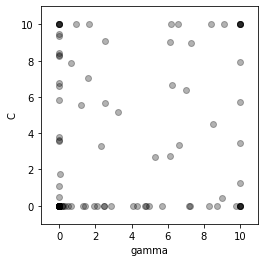

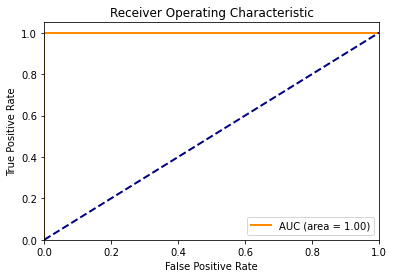

Accuracy for particle (in iteration 37, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 3.61735897e+00]
Accuracy for particle (in iteration 37, in fold 5) - 2 is 0.9310 At (gamma, c): [10.         3.4420732]
Accuracy for particle (in iteration 37, in fold 5) - 3 is 0.6552 At (gamma, c): [0.001      0.46673191]
Accuracy for particle (in iteration 37, in fold 5) - 4 is 0.9310 At (gamma, c): [ 6.16668915 10.        ]
Accuracy for particle (in iteration 37, in fold 5) - 5 is 0.4828 At (gamma, c): [8.26833912e+00 1.00000000e-03]
Accuracy for particle (in iteration 37, in fold 5) - 6 is 0.4828 At (gamma, c): [7.17558172e+00 1.00000000e-03]
Accuracy for particle (in iteration 37, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 37, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 37, in fold 5) - 9 is 0.4828 At (gamma, c): [8.73554237e+00 1.00000000e-03]
Accuracy for particle (in iteration 37, in fold 

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 37, in fold 5) - 98 is 0.4828 At (gamma, c): [2.11352601e+00 1.00000000e-03]
Accuracy for particle (in iteration 37, in fold 5) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 37, in fold 5) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 37, fold 5 is [9.59622614e+00 1.00000000e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0000
Confusion Matrix (Test):
[[14  0]
 [15  0]]
Confusion Matrix (Train):
[[129   0]
 [128   0]]

Iteration 38 - Fold 5:



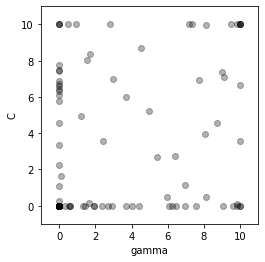

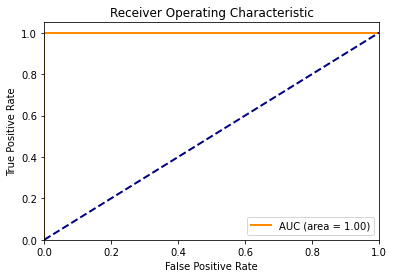

Accuracy for particle (in iteration 38, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 4.54869981e+00]
Accuracy for particle (in iteration 38, in fold 5) - 2 is 0.9310 At (gamma, c): [10.          3.56834079]
Accuracy for particle (in iteration 38, in fold 5) - 3 is 0.4828 At (gamma, c): [0.001      0.27927162]
Accuracy for particle (in iteration 38, in fold 5) - 4 is 0.9310 At (gamma, c): [4.54423718 8.69222486]
Accuracy for particle (in iteration 38, in fold 5) - 5 is 0.4828 At (gamma, c): [9.59622614e+00 1.00000000e-03]
Accuracy for particle (in iteration 38, in fold 5) - 6 is 0.4828 At (gamma, c): [9.84140185e+00 1.00000000e-03]
Accuracy for particle (in iteration 38, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 38, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 38, in fold 5) - 9 is 0.4828 At (gamma, c): [7.53226266e+00 1.00000000e-03]
Accuracy for particle (in iteration 38, in fold 

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 38, in fold 5) - 95 is 0.8621 At (gamma, c): [1.00000000e-03 6.35520027e+00]
Accuracy for particle (in iteration 38, in fold 5) - 96 is 0.9310 At (gamma, c): [2.42248071 3.54670826]
Accuracy for particle (in iteration 38, in fold 5) - 97 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 38, in fold 5) - 98 is 0.4828 At (gamma, c): [1.91792701e+00 1.00000000e-03]
Accuracy for particle (in iteration 38, in fold 5) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 38, in fold 5) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 38, fold 5 is [8.76758166e+00 1.00000000e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0000
Confusion Matrix (Test):
[[14  0]
 [15  0]]
Confusion Matrix (Train):
[[129   0]
 [128   0]]

Iteration 39 - Fold 5:



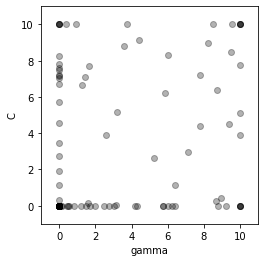

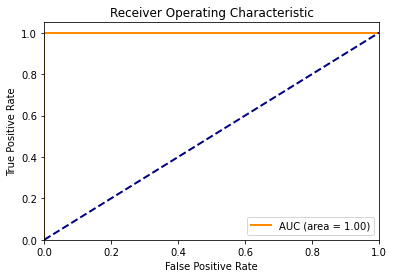

Accuracy for particle (in iteration 39, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 4.55363225e+00]
Accuracy for particle (in iteration 39, in fold 5) - 2 is 0.9310 At (gamma, c): [10.          3.89196631]
Accuracy for particle (in iteration 39, in fold 5) - 3 is 0.4828 At (gamma, c): [0.001      0.33401588]
Accuracy for particle (in iteration 39, in fold 5) - 4 is 0.9310 At (gamma, c): [4.3879685  9.16919682]
Accuracy for particle (in iteration 39, in fold 5) - 5 is 0.4828 At (gamma, c): [8.76758166e+00 1.00000000e-03]
Accuracy for particle (in iteration 39, in fold 5) - 6 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 39, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 39, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 39, in fold 5) - 9 is 0.4828 At (gamma, c): [5.72407342e+00 1.00000000e-03]
Accuracy for particle (in iteration 39, in fold 5) - 10 is 0.862

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 39, in fold 5) - 97 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 39, in fold 5) - 98 is 0.4828 At (gamma, c): [1.71843959e+00 1.00000000e-03]
Accuracy for particle (in iteration 39, in fold 5) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 39, in fold 5) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 39, fold 5 is [9.72554294e+00 1.00000000e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0000
Confusion Matrix (Test):
[[14  0]
 [15  0]]
Confusion Matrix (Train):
[[129   0]
 [128   0]]

Iteration 40 - Fold 5:



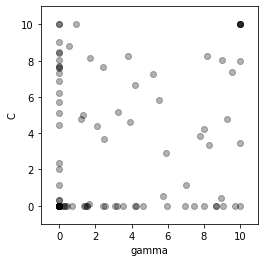

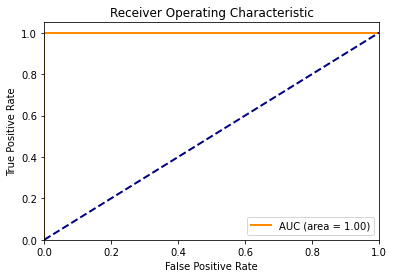

Accuracy for particle (in iteration 40, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 5.12444206e+00]
Accuracy for particle (in iteration 40, in fold 5) - 2 is 0.9310 At (gamma, c): [10.          3.43970318]
Accuracy for particle (in iteration 40, in fold 5) - 3 is 0.4828 At (gamma, c): [0.001      0.31148205]
Accuracy for particle (in iteration 40, in fold 5) - 4 is 0.9310 At (gamma, c): [3.82611721 8.24407882]
Accuracy for particle (in iteration 40, in fold 5) - 5 is 0.4828 At (gamma, c): [9.72554294e+00 1.00000000e-03]
Accuracy for particle (in iteration 40, in fold 5) - 6 is 0.4828 At (gamma, c): [5.93694318e+00 1.00000000e-03]
Accuracy for particle (in iteration 40, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 40, in fold 5) - 8 is 0.8621 At (gamma, c): [1.00000000e-03 6.88021637e+00]
Accuracy for particle (in iteration 40, in fold 5) - 9 is 0.4828 At (gamma, c): [4.22169839e+00 1.00000000e-03]
Accuracy for particle (in iterat

Accuracy for particle (in iteration 40, in fold 5) - 97 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 40, in fold 5) - 98 is 0.4828 At (gamma, c): [1.51940929e+00 1.00000000e-03]
Accuracy for particle (in iteration 40, in fold 5) - 99 is 0.4828 At (gamma, c): [0.001      0.29594509]
Accuracy for particle (in iteration 40, in fold 5) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 40, fold 5 is [7.7924039e+00 1.0000000e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0000
Confusion Matrix (Test):
[[14  0]
 [15  0]]
Confusion Matrix (Train):
[[129   0]
 [128   0]]

Iteration 41 - Fold 5:



C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


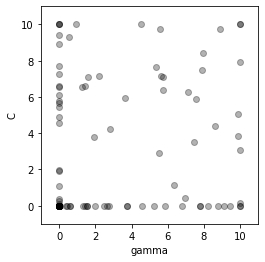

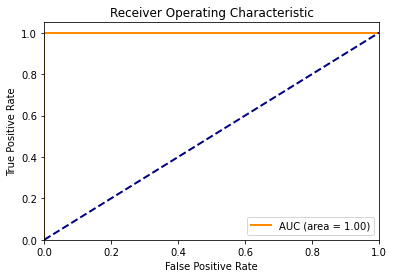

Accuracy for particle (in iteration 41, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 4.88384573e+00]
Accuracy for particle (in iteration 41, in fold 5) - 2 is 0.9310 At (gamma, c): [10.          3.07106505]
Accuracy for particle (in iteration 41, in fold 5) - 3 is 0.4828 At (gamma, c): [0.001      0.28076036]
Accuracy for particle (in iteration 41, in fold 5) - 4 is 0.9310 At (gamma, c): [ 4.50416888 10.        ]
Accuracy for particle (in iteration 41, in fold 5) - 5 is 0.4828 At (gamma, c): [7.7924039e+00 1.0000000e-03]
Accuracy for particle (in iteration 41, in fold 5) - 6 is 0.4828 At (gamma, c): [9.08958823e+00 1.00000000e-03]
Accuracy for particle (in iteration 41, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 41, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 41, in fold 5) - 9 is 0.4828 At (gamma, c): [6.76613762e+00 1.00000000e-03]
Accuracy for particle (in iteration 41, in fold 

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 41, in fold 5) - 94 is 0.4828 At (gamma, c): [4.56569762e+00 1.00000000e-03]
Accuracy for particle (in iteration 41, in fold 5) - 95 is 0.8621 At (gamma, c): [1.00000000e-03 6.58100634e+00]
Accuracy for particle (in iteration 41, in fold 5) - 96 is 0.9310 At (gamma, c): [2.79762383 4.21833782]
Accuracy for particle (in iteration 41, in fold 5) - 97 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 41, in fold 5) - 98 is 0.4828 At (gamma, c): [1.41557225e+00 1.00000000e-03]
Accuracy for particle (in iteration 41, in fold 5) - 99 is 0.4828 At (gamma, c): [0.001      0.36148411]
Accuracy for particle (in iteration 41, in fold 5) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 41, fold 5 is [1.e+01 1.e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0000
Confusion Matrix (Test):
[[14  0]
 [15  0]]
Confusion Matrix (Train):
[[129   0]
 [128   0]

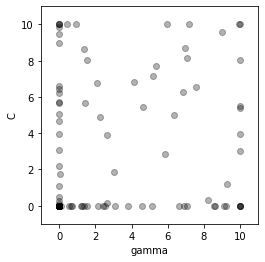

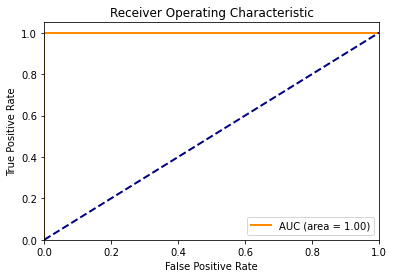

Accuracy for particle (in iteration 42, in fold 5) - 1 is 0.8621 At (gamma, c): [1.0000000e-03 3.0616819e+00]
Accuracy for particle (in iteration 42, in fold 5) - 2 is 0.9310 At (gamma, c): [10.          3.02108429]
Accuracy for particle (in iteration 42, in fold 5) - 3 is 0.6552 At (gamma, c): [0.001      0.46763805]
Accuracy for particle (in iteration 42, in fold 5) - 4 is 0.9310 At (gamma, c): [ 5.94164452 10.        ]
Accuracy for particle (in iteration 42, in fold 5) - 5 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 42, in fold 5) - 6 is 0.4828 At (gamma, c): [8.62385354e+00 1.00000000e-03]
Accuracy for particle (in iteration 42, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 42, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 42, in fold 5) - 9 is 0.4828 At (gamma, c): [9.09084264e+00 1.00000000e-03]
Accuracy for particle (in iteration 42, in fold 5) - 10 is 0.862

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 42, in fold 5) - 95 is 0.8621 At (gamma, c): [1.00000000e-03 6.19238041e+00]
Accuracy for particle (in iteration 42, in fold 5) - 96 is 0.9310 At (gamma, c): [2.62715393 3.91314064]
Accuracy for particle (in iteration 42, in fold 5) - 97 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 42, in fold 5) - 98 is 0.4828 At (gamma, c): [1.36610016e+00 1.00000000e-03]
Accuracy for particle (in iteration 42, in fold 5) - 99 is 0.4828 At (gamma, c): [0.001      0.24586807]
Accuracy for particle (in iteration 42, in fold 5) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 42, fold 5 is [7.5648377e+00 1.0000000e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0000
Confusion Matrix (Test):
[[14  0]
 [15  0]]
Confusion Matrix (Train):
[[129   0]
 [128   0]]

Iteration 43 - Fold 5:



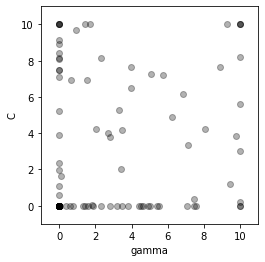

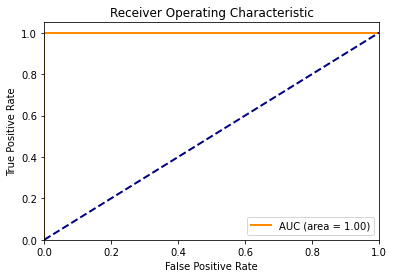

Accuracy for particle (in iteration 43, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 2.32811087e+00]
Accuracy for particle (in iteration 43, in fold 5) - 2 is 0.9310 At (gamma, c): [10.          3.00403137]
Accuracy for particle (in iteration 43, in fold 5) - 3 is 0.6897 At (gamma, c): [0.001      0.56672965]
Accuracy for particle (in iteration 43, in fold 5) - 4 is 0.9310 At (gamma, c): [3.96355628 7.64501152]
Accuracy for particle (in iteration 43, in fold 5) - 5 is 0.4828 At (gamma, c): [7.5648377e+00 1.0000000e-03]
Accuracy for particle (in iteration 43, in fold 5) - 6 is 0.4828 At (gamma, c): [5.39428677e+00 1.00000000e-03]
Accuracy for particle (in iteration 43, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 43, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 43, in fold 5) - 9 is 0.4828 At (gamma, c): [4.42511523e+00 1.00000000e-03]
Accuracy for particle (in iteration 43, in fold 5)

Accuracy for particle (in iteration 43, in fold 5) - 88 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 43, in fold 5) - 89 is 0.4828 At (gamma, c): [7.45933431e+00 1.00000000e-03]
Accuracy for particle (in iteration 43, in fold 5) - 90 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 43, in fold 5) - 91 is 0.9655 At (gamma, c): [2.32741379 8.14236984]
Accuracy for particle (in iteration 43, in fold 5) - 92 is 1.0000 At (gamma, c): [0.94522317 9.6695872 ]
Accuracy for particle (in iteration 43, in fold 5) - 93 is 0.4828 At (gamma, c): [0.04034086 0.001     ]
Accuracy for particle (in iteration 43, in fold 5) - 94 is 0.4828 At (gamma, c): [3.78313562e+00 1.00000000e-03]
Accuracy for particle (in iteration 43, in fold 5) - 95 is 0.8621 At (gamma, c): [1.00000000e-03 8.14150964e+00]
Accuracy for particle (in iteration 43, in fold 5) - 96 is 0.9310 At (gamma, c): [2.68753246 4.02123806]
Accuracy for particle (in iteration 43, in fold 5) 

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


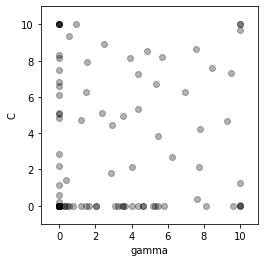

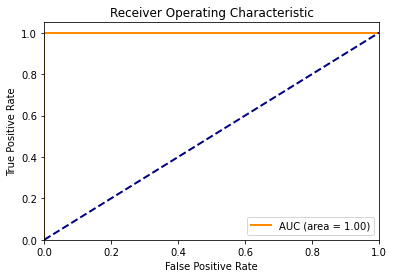

Accuracy for particle (in iteration 44, in fold 5) - 1 is 0.8621 At (gamma, c): [1.0000000e-03 2.8569874e+00]
Accuracy for particle (in iteration 44, in fold 5) - 2 is 0.9310 At (gamma, c): [7.70840291 2.11129121]
Accuracy for particle (in iteration 44, in fold 5) - 3 is 0.7241 At (gamma, c): [0.001      0.59551927]
Accuracy for particle (in iteration 44, in fold 5) - 4 is 0.9310 At (gamma, c): [3.91634698 8.16838481]
Accuracy for particle (in iteration 44, in fold 5) - 5 is 0.4828 At (gamma, c): [5.15926098e+00 1.00000000e-03]
Accuracy for particle (in iteration 44, in fold 5) - 6 is 0.4828 At (gamma, c): [5.77162003e+00 1.00000000e-03]
Accuracy for particle (in iteration 44, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 44, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 44, in fold 5) - 9 is 0.4828 At (gamma, c): [5.27161763e+00 1.00000000e-03]
Accuracy for particle (in iteration 44, in fold 5) -

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 44, in fold 5) - 96 is 0.9310 At (gamma, c): [2.91745883 4.43288189]
Accuracy for particle (in iteration 44, in fold 5) - 97 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 44, in fold 5) - 98 is 0.4828 At (gamma, c): [1.64407208e+00 1.00000000e-03]
Accuracy for particle (in iteration 44, in fold 5) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 44, in fold 5) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 44, fold 5 is [5.2381294e+00 1.0000000e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0000
Confusion Matrix (Test):
[[14  0]
 [15  0]]
Confusion Matrix (Train):
[[129   0]
 [128   0]]

Iteration 45 - Fold 5:



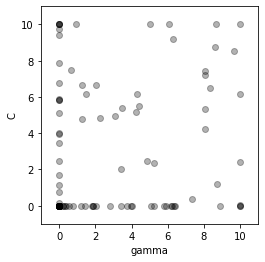

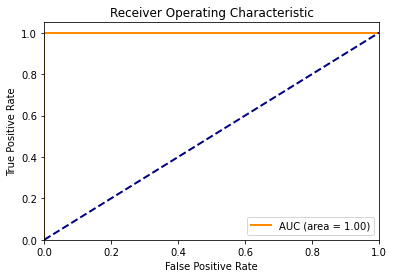

Accuracy for particle (in iteration 45, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 3.43358878e+00]
Accuracy for particle (in iteration 45, in fold 5) - 2 is 0.9310 At (gamma, c): [10.          2.43408772]
Accuracy for particle (in iteration 45, in fold 5) - 3 is 0.7931 At (gamma, c): [0.001      0.76588045]
Accuracy for particle (in iteration 45, in fold 5) - 4 is 0.9310 At (gamma, c): [ 5.00519606 10.        ]
Accuracy for particle (in iteration 45, in fold 5) - 5 is 0.4828 At (gamma, c): [5.2381294e+00 1.0000000e-03]
Accuracy for particle (in iteration 45, in fold 5) - 6 is 0.4828 At (gamma, c): [6.37173034e+00 1.00000000e-03]
Accuracy for particle (in iteration 45, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 45, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 45, in fold 5) - 9 is 0.4828 At (gamma, c): [5.81057409e+00 1.00000000e-03]
Accuracy for particle (in iteration 45, in fold 

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 45, in fold 5) - 91 is 0.9655 At (gamma, c): [2.05080112 6.66317051]
Accuracy for particle (in iteration 45, in fold 5) - 92 is 1.0000 At (gamma, c): [ 0.94270671 10.        ]
Accuracy for particle (in iteration 45, in fold 5) - 93 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 45, in fold 5) - 94 is 0.4828 At (gamma, c): [3.72817772e+00 1.00000000e-03]
Accuracy for particle (in iteration 45, in fold 5) - 95 is 0.8621 At (gamma, c): [1.00000000e-03 7.84944993e+00]
Accuracy for particle (in iteration 45, in fold 5) - 96 is 0.9310 At (gamma, c): [3.4670304  5.41679572]
Accuracy for particle (in iteration 45, in fold 5) - 97 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 45, in fold 5) - 98 is 0.4828 At (gamma, c): [1.87161042e+00 1.00000000e-03]
Accuracy for particle (in iteration 45, in fold 5) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 45, in fold 5) - 100 is

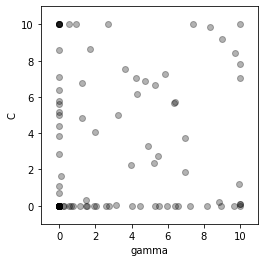

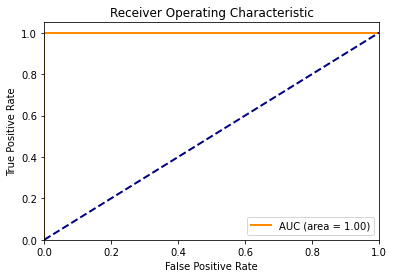

Accuracy for particle (in iteration 46, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 3.84178382e+00]
Accuracy for particle (in iteration 46, in fold 5) - 2 is 0.9310 At (gamma, c): [6.94560703 1.878766  ]
Accuracy for particle (in iteration 46, in fold 5) - 3 is 0.7931 At (gamma, c): [0.001      0.70375999]
Accuracy for particle (in iteration 46, in fold 5) - 4 is 0.9310 At (gamma, c): [3.64815354 7.54365979]
Accuracy for particle (in iteration 46, in fold 5) - 5 is 0.4828 At (gamma, c): [6.39667616e+00 1.00000000e-03]
Accuracy for particle (in iteration 46, in fold 5) - 6 is 0.4828 At (gamma, c): [8.93090951e+00 1.00000000e-03]
Accuracy for particle (in iteration 46, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 46, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 46, in fold 5) - 9 is 0.4828 At (gamma, c): [7.24189056e+00 1.00000000e-03]
Accuracy for particle (in iteration 46, in fold 5)

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 46, in fold 5) - 93 is 0.4828 At (gamma, c): [0.26231114 0.001     ]
Accuracy for particle (in iteration 46, in fold 5) - 94 is 0.4828 At (gamma, c): [5.50269603e+00 1.00000000e-03]
Accuracy for particle (in iteration 46, in fold 5) - 95 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 46, in fold 5) - 96 is 0.9310 At (gamma, c): [3.22920615 4.99101212]
Accuracy for particle (in iteration 46, in fold 5) - 97 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 46, in fold 5) - 98 is 0.4828 At (gamma, c): [1.55618895e+00 1.00000000e-03]
Accuracy for particle (in iteration 46, in fold 5) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 46, in fold 5) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 46, fold 5 is [6.29357061e+00 1.00000000e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0

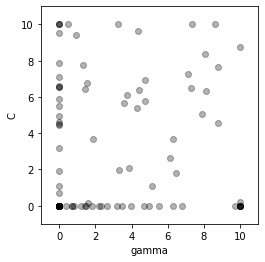

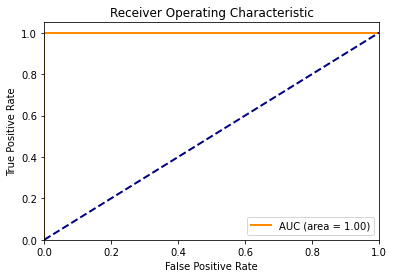

Accuracy for particle (in iteration 47, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 4.61952157e+00]
Accuracy for particle (in iteration 47, in fold 5) - 2 is 0.9310 At (gamma, c): [6.46345717 1.79315226]
Accuracy for particle (in iteration 47, in fold 5) - 3 is 0.7931 At (gamma, c): [0.001      0.68029578]
Accuracy for particle (in iteration 47, in fold 5) - 4 is 0.9310 At (gamma, c): [4.37680266 9.63109871]
Accuracy for particle (in iteration 47, in fold 5) - 5 is 0.4828 At (gamma, c): [6.29357061e+00 1.00000000e-03]
Accuracy for particle (in iteration 47, in fold 5) - 6 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 47, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 47, in fold 5) - 8 is 0.8621 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 47, in fold 5) - 9 is 0.4828 At (gamma, c): [5.49584759e+00 1.00000000e-03]
Accuracy for particle (in iteration 47, in fold 5) - 10 is 0.8621 

Accuracy for particle (in iteration 47, in fold 5) - 79 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 47, in fold 5) - 80 is 0.9310 At (gamma, c): [3.85220801 2.09991714]
Accuracy for particle (in iteration 47, in fold 5) - 81 is 0.9655 At (gamma, c): [1.88086747 3.69530151]
Accuracy for particle (in iteration 47, in fold 5) - 82 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 47, in fold 5) - 83 is 0.9310 At (gamma, c): [7.14041152 7.24209255]
Accuracy for particle (in iteration 47, in fold 5) - 84 is 0.8621 At (gamma, c): [1.00000000e-03 5.90512813e+00]
Accuracy for particle (in iteration 47, in fold 5) - 85 is 0.9655 At (gamma, c): [1.55058138 6.78789747]
Accuracy for particle (in iteration 47, in fold 5) - 86 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 47, in fold 5) - 87 is 0.9310 At (gamma, c): [6.28483369 3.67162488]
Accuracy for particle (in iteration 47, in fold 5) - 88 is 0.4828 At (gamma

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 47, in fold 5) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 47, in fold 5) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 47, fold 5 is [6.48892932e+00 1.00000000e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0000
Confusion Matrix (Test):
[[14  0]
 [15  0]]
Confusion Matrix (Train):
[[129   0]
 [128   0]]

Iteration 48 - Fold 5:



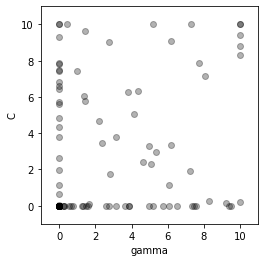

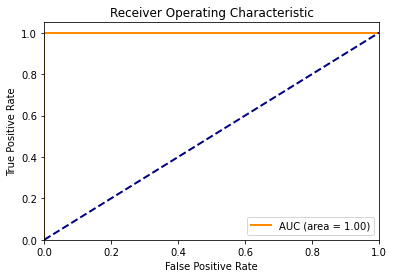

Accuracy for particle (in iteration 48, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 4.85308544e+00]
Accuracy for particle (in iteration 48, in fold 5) - 2 is 0.9310 At (gamma, c): [7.2195568 1.9005921]
Accuracy for particle (in iteration 48, in fold 5) - 3 is 0.7586 At (gamma, c): [0.001      0.64709475]
Accuracy for particle (in iteration 48, in fold 5) - 4 is 0.9310 At (gamma, c): [ 5.15668443 10.        ]
Accuracy for particle (in iteration 48, in fold 5) - 5 is 0.4828 At (gamma, c): [6.48892932e+00 1.00000000e-03]
Accuracy for particle (in iteration 48, in fold 5) - 6 is 0.4828 At (gamma, c): [7.41994328e+00 1.00000000e-03]
Accuracy for particle (in iteration 48, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 48, in fold 5) - 8 is 0.8621 At (gamma, c): [1.00000000e-03 9.30534998e+00]
Accuracy for particle (in iteration 48, in fold 5) - 9 is 0.4828 At (gamma, c): [5.7570674e+00 1.0000000e-03]
Accuracy for particle (in iteration 

Accuracy for particle (in iteration 48, in fold 5) - 82 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 48, in fold 5) - 83 is 0.9310 At (gamma, c): [7.73354815 7.87920647]
Accuracy for particle (in iteration 48, in fold 5) - 84 is 0.8621 At (gamma, c): [1.0000000e-03 3.8112914e+00]
Accuracy for particle (in iteration 48, in fold 5) - 85 is 0.9655 At (gamma, c): [1.4533218  5.76548787]
Accuracy for particle (in iteration 48, in fold 5) - 86 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 48, in fold 5) - 87 is 0.9310 At (gamma, c): [5.35403041 2.93591262]
Accuracy for particle (in iteration 48, in fold 5) - 88 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 48, in fold 5) - 89 is 0.4828 At (gamma, c): [9.37390971e+00 1.00000000e-03]
Accuracy for particle (in iteration 48, in fold 5) - 90 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 48, in fold 5) - 91 is 0.9310 At (gamma, c): 

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


The best position in iteration 48, fold 5 is [6.66891196e+00 1.00000000e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0000
Confusion Matrix (Test):
[[14  0]
 [15  0]]
Confusion Matrix (Train):
[[129   0]
 [128   0]]

Iteration 49 - Fold 5:



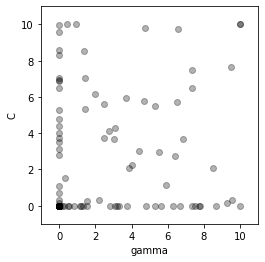

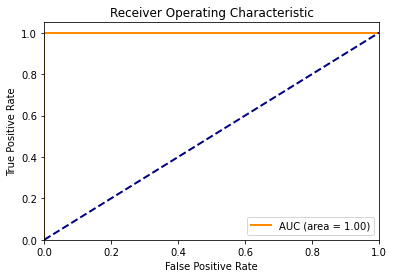

Accuracy for particle (in iteration 49, in fold 5) - 1 is 0.8621 At (gamma, c): [1.0000000e-03 3.5267793e+00]
Accuracy for particle (in iteration 49, in fold 5) - 2 is 0.9310 At (gamma, c): [8.47308054 2.08145381]
Accuracy for particle (in iteration 49, in fold 5) - 3 is 0.7931 At (gamma, c): [0.001      0.67672454]
Accuracy for particle (in iteration 49, in fold 5) - 4 is 0.9310 At (gamma, c): [4.76110118 9.79356873]
Accuracy for particle (in iteration 49, in fold 5) - 5 is 0.4828 At (gamma, c): [6.66891196e+00 1.00000000e-03]
Accuracy for particle (in iteration 49, in fold 5) - 6 is 0.4828 At (gamma, c): [6.30788551e+00 1.00000000e-03]
Accuracy for particle (in iteration 49, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 49, in fold 5) - 8 is 0.8621 At (gamma, c): [1.00000000e-03 6.96202378e+00]
Accuracy for particle (in iteration 49, in fold 5) - 9 is 0.4828 At (gamma, c): [7.35190281e+00 1.00000000e-03]
Accuracy for particle (in iteration 

Accuracy for particle (in iteration 49, in fold 5) - 82 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 49, in fold 5) - 83 is 0.9310 At (gamma, c): [7.35526118 7.50662732]
Accuracy for particle (in iteration 49, in fold 5) - 84 is 0.8621 At (gamma, c): [1.0000000e-03 3.9964818e+00]
Accuracy for particle (in iteration 49, in fold 5) - 85 is 0.9655 At (gamma, c): [1.41291922 5.34076713]
Accuracy for particle (in iteration 49, in fold 5) - 86 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 49, in fold 5) - 87 is 0.9310 At (gamma, c): [5.50002509 2.9527116 ]
Accuracy for particle (in iteration 49, in fold 5) - 88 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 49, in fold 5) - 89 is 0.4828 At (gamma, c): [7.7692788e+00 1.0000000e-03]
Accuracy for particle (in iteration 49, in fold 5) - 90 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 49, in fold 5) - 91 is 0.9655 At (gamma, c): [1

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


The best position in iteration 49, fold 5 is [7.16332328e+00 1.00000000e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0000
Confusion Matrix (Test):
[[14  0]
 [15  0]]
Confusion Matrix (Train):
[[129   0]
 [128   0]]

Iteration 50 - Fold 5:



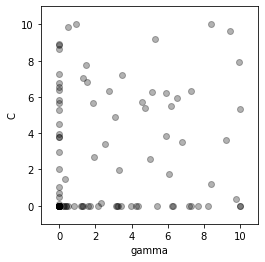

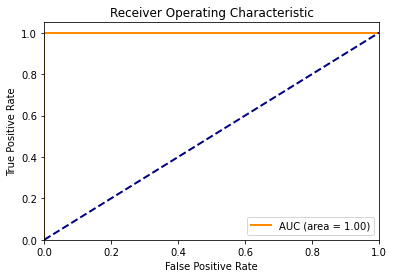

Accuracy for particle (in iteration 50, in fold 5) - 1 is 0.8621 At (gamma, c): [1.00000000e-03 3.80218562e+00]
Accuracy for particle (in iteration 50, in fold 5) - 2 is 0.9310 At (gamma, c): [6.06039415 1.73204005]
Accuracy for particle (in iteration 50, in fold 5) - 3 is 0.7931 At (gamma, c): [0.001      0.72322048]
Accuracy for particle (in iteration 50, in fold 5) - 4 is 0.9310 At (gamma, c): [3.46971968 7.19918693]
Accuracy for particle (in iteration 50, in fold 5) - 5 is 0.4828 At (gamma, c): [7.16332328e+00 1.00000000e-03]
Accuracy for particle (in iteration 50, in fold 5) - 6 is 0.4828 At (gamma, c): [4.36425485e+00 1.00000000e-03]
Accuracy for particle (in iteration 50, in fold 5) - 7 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 50, in fold 5) - 8 is 0.8621 At (gamma, c): [1.00000000e-03 5.67204039e+00]
Accuracy for particle (in iteration 50, in fold 5) - 9 is 0.4828 At (gamma, c): [8.2330035e+00 1.0000000e-03]
Accuracy for particle (in iteration 

C:\Users\NaufalKusuma\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 50, in fold 5) - 97 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 50, in fold 5) - 98 is 0.4828 At (gamma, c): [1.29546223e+00 1.00000000e-03]
Accuracy for particle (in iteration 50, in fold 5) - 99 is 0.6552 At (gamma, c): [0.001      0.49161979]
Accuracy for particle (in iteration 50, in fold 5) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 50, fold 5 is [9.56073409e+00 1.00000000e-03], with Accuracy: 1.0000
Accuracy Score: 0.4828
F1 Score: 0.0000
Recall Score: 0.0000
Precision Score: 0.0000
Confusion Matrix (Test):
[[14  0]
 [15  0]]
Confusion Matrix (Train):
[[129   0]
 [128   0]]


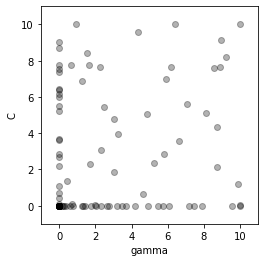

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.



Iteration 1 - Fold 6:



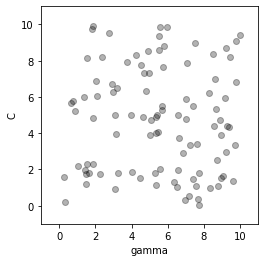

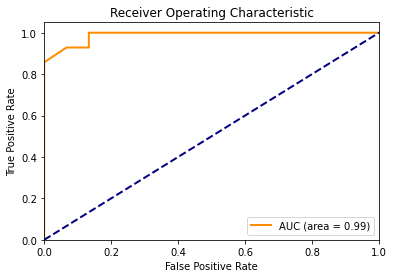

Accuracy for particle (in iteration 1, in fold 6) - 1 is 0.9310 At (gamma, c): [9.4533143  8.18722253]
Accuracy for particle (in iteration 1, in fold 6) - 2 is 0.9310 At (gamma, c): [9.14636121 5.92284184]
Accuracy for particle (in iteration 1, in fold 6) - 3 is 0.8966 At (gamma, c): [0.30657874 0.22848473]
Accuracy for particle (in iteration 1, in fold 6) - 4 is 0.9310 At (gamma, c): [8.9365174  1.54546643]
Accuracy for particle (in iteration 1, in fold 6) - 5 is 0.9310 At (gamma, c): [4.49680298 7.77998917]
Accuracy for particle (in iteration 1, in fold 6) - 6 is 0.9310 At (gamma, c): [9.24888933 4.38089162]
Accuracy for particle (in iteration 1, in fold 6) - 7 is 0.9310 At (gamma, c): [6.48540571 1.051298  ]
Accuracy for particle (in iteration 1, in fold 6) - 8 is 0.9310 At (gamma, c): [9.21191196 8.71923087]
Accuracy for particle (in iteration 1, in fold 6) - 9 is 0.9310 At (gamma, c): [8.2634309  6.21396843]
Accuracy for particle (in iteration 1, in fold 6) - 10 is 0.9310 At (gamm

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 1, in fold 6) - 97 is 0.9310 At (gamma, c): [4.49250401 1.50992225]
Accuracy for particle (in iteration 1, in fold 6) - 98 is 0.9310 At (gamma, c): [1.8962616  2.28015712]
Accuracy for particle (in iteration 1, in fold 6) - 99 is 0.9310 At (gamma, c): [7.60977922 3.39054048]
Accuracy for particle (in iteration 1, in fold 6) - 100 is 0.9310 At (gamma, c): [0.27162636 1.5607558 ]
The best position in iteration 1, fold 6 is [10.          6.15800323], with Accuracy: 0.9310
Accuracy Score: 0.9310
F1 Score: 0.9333
Recall Score: 1.0000
Precision Score: 0.8750
Confusion Matrix (Test):
[[13  2]
 [ 0 14]]
Confusion Matrix (Train):
[[128   0]
 [  0 129]]

Iteration 2 - Fold 6:



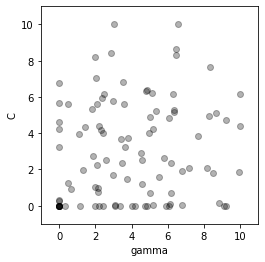

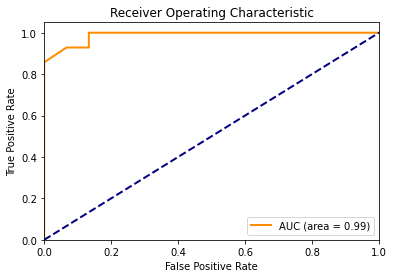

Accuracy for particle (in iteration 2, in fold 6) - 1 is 0.9310 At (gamma, c): [10.          6.15800323]
Accuracy for particle (in iteration 2, in fold 6) - 2 is 0.4828 At (gamma, c): [4.74062394e+00 1.00000000e-03]
Accuracy for particle (in iteration 2, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 2, in fold 6) - 4 is 0.9310 At (gamma, c): [6.06110077 4.85732043]
Accuracy for particle (in iteration 2, in fold 6) - 5 is 0.9310 At (gamma, c): [3.4165173  3.65403066]
Accuracy for particle (in iteration 2, in fold 6) - 6 is 0.9310 At (gamma, c): [5.51228334 1.60456485]
Accuracy for particle (in iteration 2, in fold 6) - 7 is 0.4828 At (gamma, c): [3.07144058 0.01738404]
Accuracy for particle (in iteration 2, in fold 6) - 8 is 0.9310 At (gamma, c): [6.31076184 6.14880152]
Accuracy for particle (in iteration 2, in fold 6) - 9 is 0.9310 At (gamma, c): [2.37056062 5.92778248]
Accuracy for particle (in iteration 2, in fold 6) - 10 is 0.9310 At (gamm

Accuracy for particle (in iteration 2, in fold 6) - 79 is 0.9310 At (gamma, c): [8.33314193 7.66718701]
Accuracy for particle (in iteration 2, in fold 6) - 80 is 0.4828 At (gamma, c): [0.001      0.30339433]
Accuracy for particle (in iteration 2, in fold 6) - 81 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 2, in fold 6) - 82 is 0.9310 At (gamma, c): [1.10809075 3.98285848]
Accuracy for particle (in iteration 2, in fold 6) - 83 is 0.9310 At (gamma, c): [ 3.0303976 10.       ]
Accuracy for particle (in iteration 2, in fold 6) - 84 is 0.9310 At (gamma, c): [6.76461884 1.89276336]
Accuracy for particle (in iteration 2, in fold 6) - 85 is 0.9310 At (gamma, c): [5.17610393 4.2160486 ]
Accuracy for particle (in iteration 2, in fold 6) - 86 is 0.9310 At (gamma, c): [5.12086015 6.23104865]
Accuracy for particle (in iteration 2, in fold 6) - 87 is 0.9310 At (gamma, c): [6.16526424 2.37695433]
Accuracy for particle (in iteration 2, in fold 6) - 88 is 0.9310 At (gamma

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 2, in fold 6) - 98 is 0.9310 At (gamma, c): [2.08661234 2.24336846]
Accuracy for particle (in iteration 2, in fold 6) - 99 is 0.9310 At (gamma, c): [4.59506778 1.19213   ]
Accuracy for particle (in iteration 2, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 2, fold 6 is [10.          1.04317606], with Accuracy: 0.9310
Accuracy Score: 0.9310
F1 Score: 0.9333
Recall Score: 1.0000
Precision Score: 0.8750
Confusion Matrix (Test):
[[13  2]
 [ 0 14]]
Confusion Matrix (Train):
[[128   0]
 [  0 129]]

Iteration 3 - Fold 6:



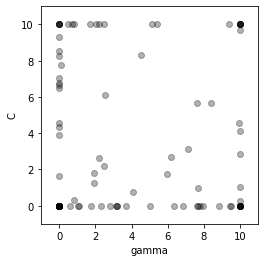

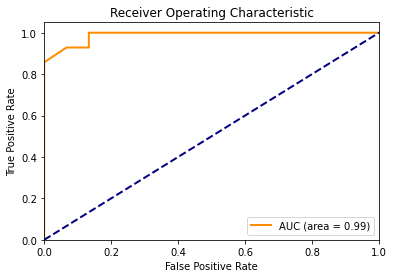

Accuracy for particle (in iteration 3, in fold 6) - 1 is 0.9310 At (gamma, c): [10.          1.04317606]
Accuracy for particle (in iteration 3, in fold 6) - 2 is 0.4828 At (gamma, c): [6.84278501e+00 1.00000000e-03]
Accuracy for particle (in iteration 3, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 3, in fold 6) - 4 is 0.9310 At (gamma, c): [ 0.69735166 10.        ]
Accuracy for particle (in iteration 3, in fold 6) - 5 is 0.4828 At (gamma, c): [1.12059643e+00 1.00000000e-03]
Accuracy for particle (in iteration 3, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 3, in fold 6) - 7 is 0.4828 At (gamma, c): [3.21802849e+00 1.00000000e-03]
Accuracy for particle (in iteration 3, in fold 6) - 8 is 0.9310 At (gamma, c): [2.1938091 2.6092881]
Accuracy for particle (in iteration 3, in fold 6) - 9 is 0.9310 At (gamma, c): [1.00000000e-03 6.67113422e+00]
Accuracy for particle (in iteration 3, in fold 6) - 10 is 0

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 3, in fold 6) - 98 is 0.9310 At (gamma, c): [2.4715615  2.17822133]
Accuracy for particle (in iteration 3, in fold 6) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 3, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 3, fold 6 is [1.e-03 1.e+01], with Accuracy: 0.9655
Accuracy Score: 0.9310
F1 Score: 0.9333
Recall Score: 1.0000
Precision Score: 0.8750
Confusion Matrix (Test):
[[13  2]
 [ 0 14]]
Confusion Matrix (Train):
[[128   0]
 [  0 129]]

Iteration 4 - Fold 6:



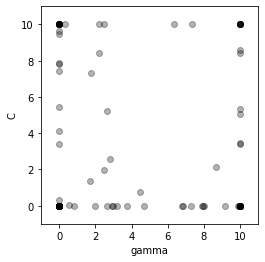

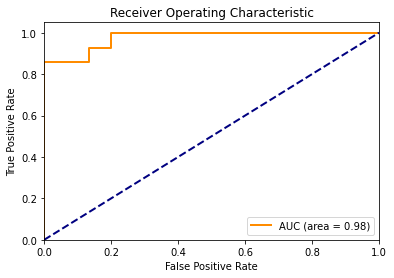

Accuracy for particle (in iteration 4, in fold 6) - 1 is 0.4828 At (gamma, c): [7.27082319e+00 1.00000000e-03]
Accuracy for particle (in iteration 4, in fold 6) - 2 is 0.4828 At (gamma, c): [7.95024367e+00 1.00000000e-03]
Accuracy for particle (in iteration 4, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 4, in fold 6) - 4 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 4, in fold 6) - 5 is 0.4828 At (gamma, c): [0.80618295 0.001     ]
Accuracy for particle (in iteration 4, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 4, in fold 6) - 7 is 0.4828 At (gamma, c): [2.66294212e+00 1.00000000e-03]
Accuracy for particle (in iteration 4, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 4, in fold 6) - 9 is 0.9310 At (gamma, c): [1.00000000e-03 9.48288374e+00]
Accuracy for particle (in iteration 4, in fold 6) - 10 is 0.9310 At (gamma, c):

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 4, in fold 6) - 93 is 0.8966 At (gamma, c): [1.72340026 1.35529767]
Accuracy for particle (in iteration 4, in fold 6) - 94 is 0.4828 At (gamma, c): [9.87191299e+00 1.00000000e-03]
Accuracy for particle (in iteration 4, in fold 6) - 95 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 4, in fold 6) - 96 is 0.9310 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 4, in fold 6) - 97 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 4, in fold 6) - 98 is 0.9310 At (gamma, c): [2.4860971  1.98357131]
Accuracy for particle (in iteration 4, in fold 6) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 4, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 4, fold 6 is [1.e-03 1.e+01], with Accuracy: 0.9655
Accuracy Score: 0.9310
F1 Score: 0.9231
Recall Score: 0.8571
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 2 12]]

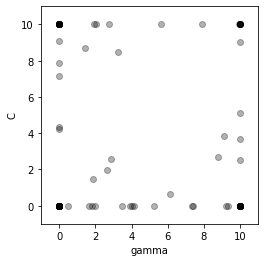

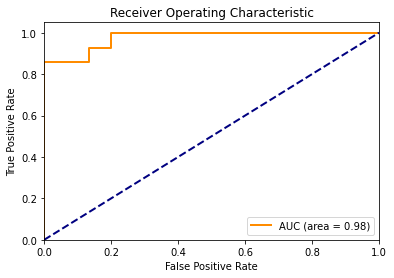

Accuracy for particle (in iteration 5, in fold 6) - 1 is 0.4828 At (gamma, c): [9.30267915e+00 1.00000000e-03]
Accuracy for particle (in iteration 5, in fold 6) - 2 is 0.4828 At (gamma, c): [7.32181439e+00 1.00000000e-03]
Accuracy for particle (in iteration 5, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 5, in fold 6) - 4 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 5, in fold 6) - 5 is 0.4828 At (gamma, c): [0.51824855 0.001     ]
Accuracy for particle (in iteration 5, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 5, in fold 6) - 7 is 0.4828 At (gamma, c): [1.63624173e+00 1.00000000e-03]
Accuracy for particle (in iteration 5, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 5, in fold 6) - 9 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 5, in fold 6) - 10 is 0.9310 At (gamma, c): [1.e-03 1.e+01]

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 5, in fold 6) - 96 is 0.9310 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 5, in fold 6) - 97 is 0.9310 At (gamma, c): [1.00000000e-03 9.08176713e+00]
Accuracy for particle (in iteration 5, in fold 6) - 98 is 0.9310 At (gamma, c): [2.62440532 1.98995334]
Accuracy for particle (in iteration 5, in fold 6) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 5, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 5, fold 6 is [1.00000000e-03 9.23921424e+00], with Accuracy: 0.9655
Accuracy Score: 0.9310
F1 Score: 0.9231
Recall Score: 0.8571
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 2 12]]
Confusion Matrix (Train):
[[121   7]
 [ 23 106]]

Iteration 6 - Fold 6:



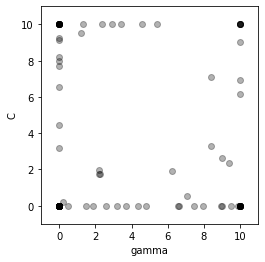

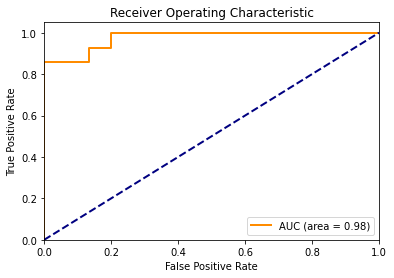

Accuracy for particle (in iteration 6, in fold 6) - 1 is 0.4828 At (gamma, c): [7.97049556e+00 1.00000000e-03]
Accuracy for particle (in iteration 6, in fold 6) - 2 is 0.4828 At (gamma, c): [7.4408966e+00 1.0000000e-03]
Accuracy for particle (in iteration 6, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 6, in fold 6) - 4 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 6, in fold 6) - 5 is 0.4828 At (gamma, c): [0.51931847 0.001     ]
Accuracy for particle (in iteration 6, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 6, in fold 6) - 7 is 0.4828 At (gamma, c): [1.86374672e+00 1.00000000e-03]
Accuracy for particle (in iteration 6, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 6, in fold 6) - 9 is 0.9310 At (gamma, c): [1.00000000e-03 6.55731136e+00]
Accuracy for particle (in iteration 6, in fold 6) - 10 is 0.9310 At (gamma, c): [

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 6, in fold 6) - 94 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 6, in fold 6) - 95 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 6, in fold 6) - 96 is 0.9310 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 6, in fold 6) - 97 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 6, in fold 6) - 98 is 0.9310 At (gamma, c): [2.2845665  1.73942642]
Accuracy for particle (in iteration 6, in fold 6) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 6, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 6, fold 6 is [1.e-03 1.e+01], with Accuracy: 0.9655
Accuracy Score: 0.9310
F1 Score: 0.9231
Recall Score: 0.8571
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 2 12]]
Confusion Matrix (Train):
[[121   7]
 [ 23 106]]

Iteration 7 - Fold 6:



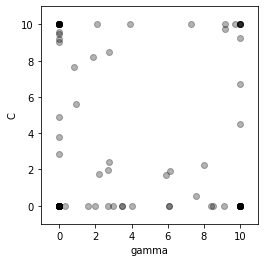

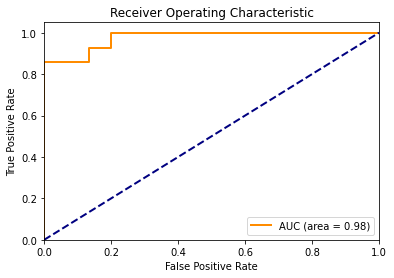

Accuracy for particle (in iteration 7, in fold 6) - 1 is 0.4828 At (gamma, c): [8.36749215e+00 1.00000000e-03]
Accuracy for particle (in iteration 7, in fold 6) - 2 is 0.4828 At (gamma, c): [6.06770848e+00 1.00000000e-03]
Accuracy for particle (in iteration 7, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 7, in fold 6) - 4 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 7, in fold 6) - 5 is 0.4828 At (gamma, c): [0.32961676 0.001     ]
Accuracy for particle (in iteration 7, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 7, in fold 6) - 7 is 0.4828 At (gamma, c): [1.97954681e+00 1.00000000e-03]
Accuracy for particle (in iteration 7, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 7, in fold 6) - 9 is 0.9310 At (gamma, c): [1.00000000e-03 9.47240407e+00]
Accuracy for particle (in iteration 7, in fold 6) - 10 is 0.9310 At (gamma, c):

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 7, in fold 6) - 98 is 0.9310 At (gamma, c): [2.7217116  1.98181471]
Accuracy for particle (in iteration 7, in fold 6) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 7, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 7, fold 6 is [1.e-03 1.e+01], with Accuracy: 0.9655
Accuracy Score: 0.9310
F1 Score: 0.9231
Recall Score: 0.8571
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 2 12]]
Confusion Matrix (Train):
[[121   7]
 [ 23 106]]

Iteration 8 - Fold 6:



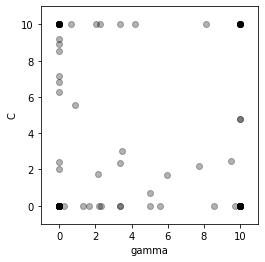

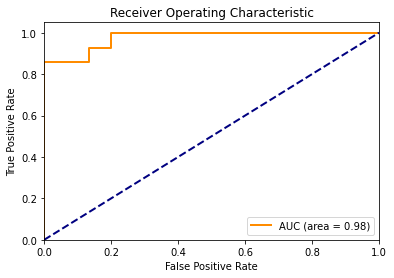

Accuracy for particle (in iteration 8, in fold 6) - 1 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 8, in fold 6) - 2 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 8, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 8, in fold 6) - 4 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 8, in fold 6) - 5 is 0.4828 At (gamma, c): [0.26053026 0.001     ]
Accuracy for particle (in iteration 8, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 8, in fold 6) - 7 is 0.4828 At (gamma, c): [1.67768806e+00 1.00000000e-03]
Accuracy for particle (in iteration 8, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 8, in fold 6) - 9 is 0.9310 At (gamma, c): [1.00000000e-03 8.93373326e+00]
Accuracy for particle (in iteration 8, in fold 6) - 10 is 0.9310 At (gamma, c): [1.00000000e-03 8.56177242e+00]

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 8, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 8, fold 6 is [1.e-03 1.e+01], with Accuracy: 0.9655
Accuracy Score: 0.9310
F1 Score: 0.9231
Recall Score: 0.8571
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 2 12]]
Confusion Matrix (Train):
[[121   7]
 [ 23 106]]

Iteration 9 - Fold 6:



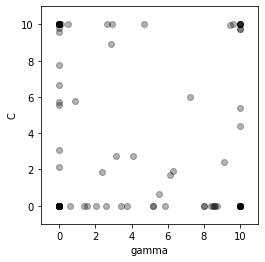

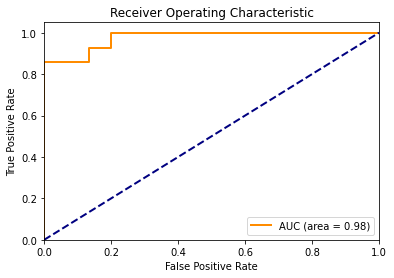

Accuracy for particle (in iteration 9, in fold 6) - 1 is 0.4828 At (gamma, c): [7.98211473e+00 1.00000000e-03]
Accuracy for particle (in iteration 9, in fold 6) - 2 is 0.4828 At (gamma, c): [8.73028908e+00 1.00000000e-03]
Accuracy for particle (in iteration 9, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 9, in fold 6) - 4 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 9, in fold 6) - 5 is 0.4828 At (gamma, c): [0.60400767 0.001     ]
Accuracy for particle (in iteration 9, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 9, in fold 6) - 7 is 0.4828 At (gamma, c): [1.5260438e+00 1.0000000e-03]
Accuracy for particle (in iteration 9, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 9, in fold 6) - 9 is 0.9310 At (gamma, c): [1.00000000e-03 6.65488487e+00]
Accuracy for particle (in iteration 9, in fold 6) - 10 is 0.9310 At (gamma, c): [

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 9, in fold 6) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 9, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 9, fold 6 is [1.e-03 1.e+01], with Accuracy: 0.9655
Accuracy Score: 0.9310
F1 Score: 0.9231
Recall Score: 0.8571
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 2 12]]
Confusion Matrix (Train):
[[121   7]
 [ 23 106]]

Iteration 10 - Fold 6:



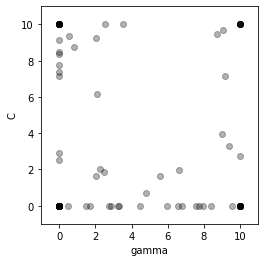

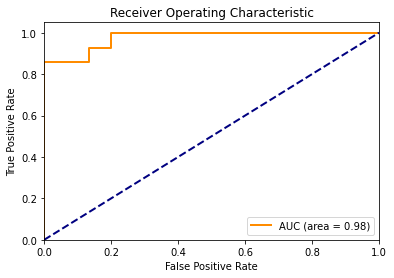

Accuracy for particle (in iteration 10, in fold 6) - 1 is 0.4828 At (gamma, c): [9.56273804e+00 1.00000000e-03]
Accuracy for particle (in iteration 10, in fold 6) - 2 is 0.4828 At (gamma, c): [7.72604606e+00 1.00000000e-03]
Accuracy for particle (in iteration 10, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 10, in fold 6) - 4 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 10, in fold 6) - 5 is 0.4828 At (gamma, c): [0.49208682 0.001     ]
Accuracy for particle (in iteration 10, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 10, in fold 6) - 7 is 0.4828 At (gamma, c): [1.69588987e+00 1.00000000e-03]
Accuracy for particle (in iteration 10, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 10, in fold 6) - 9 is 0.9310 At (gamma, c): [1.00000000e-03 7.78621691e+00]
Accuracy for particle (in iteration 10, in fold 6) - 10 is 0.9310 At (

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 10, in fold 6) - 95 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 10, in fold 6) - 96 is 0.9310 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 10, in fold 6) - 97 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 10, in fold 6) - 98 is 0.9310 At (gamma, c): [2.49230862 1.83883366]
Accuracy for particle (in iteration 10, in fold 6) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 10, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 10, fold 6 is [1.e-03 1.e+01], with Accuracy: 0.9655
Accuracy Score: 0.9310
F1 Score: 0.9231
Recall Score: 0.8571
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 2 12]]
Confusion Matrix (Train):
[[121   7]
 [ 23 106]]

Iteration 11 - Fold 6:



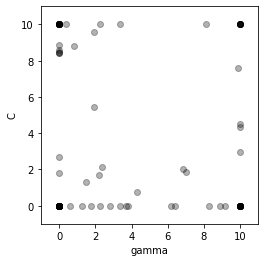

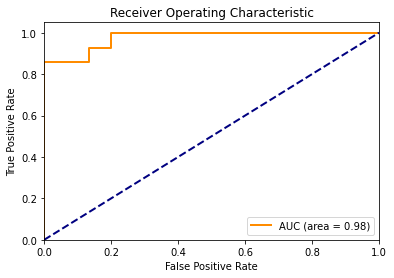

Accuracy for particle (in iteration 11, in fold 6) - 1 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 11, in fold 6) - 2 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 11, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 11, in fold 6) - 4 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 11, in fold 6) - 5 is 0.4828 At (gamma, c): [0.57904868 0.001     ]
Accuracy for particle (in iteration 11, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 11, in fold 6) - 7 is 0.4828 At (gamma, c): [1.7478328e+00 1.0000000e-03]
Accuracy for particle (in iteration 11, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 11, in fold 6) - 9 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 11, in fold 6) - 10 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 11, in fold 6) - 94 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 11, in fold 6) - 95 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 11, in fold 6) - 96 is 0.9310 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 11, in fold 6) - 97 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 11, in fold 6) - 98 is 0.9310 At (gamma, c): [2.21972231 1.68135415]
Accuracy for particle (in iteration 11, in fold 6) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 11, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 11, fold 6 is [1.e-03 1.e+01], with Accuracy: 0.9655
Accuracy Score: 0.9310
F1 Score: 0.9231
Recall Score: 0.8571
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 2 12]]
Confusion Matrix (Train):
[[121   7]
 [ 23 106]]

Iteration 12 - Fold 6:



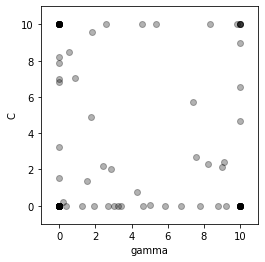

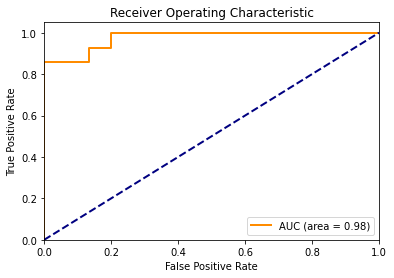

Accuracy for particle (in iteration 12, in fold 6) - 1 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 12, in fold 6) - 2 is 0.4828 At (gamma, c): [8.74644016e+00 1.00000000e-03]
Accuracy for particle (in iteration 12, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 12, in fold 6) - 4 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 12, in fold 6) - 5 is 0.4828 At (gamma, c): [0.37614815 0.001     ]
Accuracy for particle (in iteration 12, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 12, in fold 6) - 7 is 0.4828 At (gamma, c): [1.91864808e+00 1.00000000e-03]
Accuracy for particle (in iteration 12, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 12, in fold 6) - 9 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 12, in fold 6) - 10 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accur

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 12, in fold 6) - 95 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 12, in fold 6) - 96 is 0.9310 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 12, in fold 6) - 97 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 12, in fold 6) - 98 is 0.9310 At (gamma, c): [2.85095839 2.04107731]
Accuracy for particle (in iteration 12, in fold 6) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 12, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 12, fold 6 is [1.e-03 1.e+01], with Accuracy: 0.9655
Accuracy Score: 0.9310
F1 Score: 0.9231
Recall Score: 0.8571
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 2 12]]
Confusion Matrix (Train):
[[121   7]
 [ 23 106]]

Iteration 13 - Fold 6:



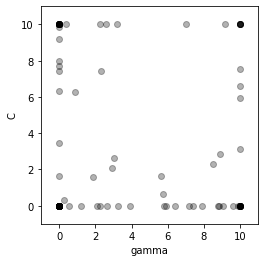

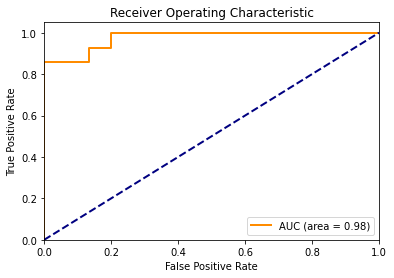

Accuracy for particle (in iteration 13, in fold 6) - 1 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 13, in fold 6) - 2 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 13, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 13, in fold 6) - 4 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 13, in fold 6) - 5 is 0.4828 At (gamma, c): [0.56644739 0.001     ]
Accuracy for particle (in iteration 13, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 13, in fold 6) - 7 is 0.4828 At (gamma, c): [2.09354242e+00 1.00000000e-03]
Accuracy for particle (in iteration 13, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 13, in fold 6) - 9 is 0.9310 At (gamma, c): [1.00000000e-03 9.88496594e+00]
Accuracy for particle (in iteration 13, in fold 6) - 10 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accur

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 13, in fold 6) - 95 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 13, in fold 6) - 96 is 0.9310 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 13, in fold 6) - 97 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 13, in fold 6) - 98 is 0.9310 At (gamma, c): [2.94246684 2.09296158]
Accuracy for particle (in iteration 13, in fold 6) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 13, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 13, fold 6 is [1.e-03 1.e+01], with Accuracy: 0.9655
Accuracy Score: 0.9310
F1 Score: 0.9231
Recall Score: 0.8571
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 2 12]]
Confusion Matrix (Train):
[[121   7]
 [ 23 106]]

Iteration 14 - Fold 6:



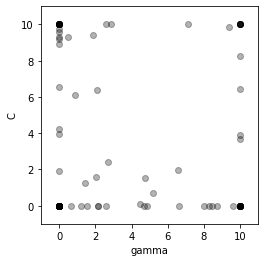

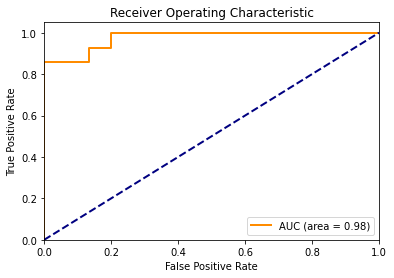

Accuracy for particle (in iteration 14, in fold 6) - 1 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 14, in fold 6) - 2 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 14, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 14, in fold 6) - 4 is 0.9310 At (gamma, c): [1.00000000e-03 9.56689034e+00]
Accuracy for particle (in iteration 14, in fold 6) - 5 is 0.4828 At (gamma, c): [0.65570517 0.001     ]
Accuracy for particle (in iteration 14, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 14, in fold 6) - 7 is 0.4828 At (gamma, c): [1.55449171e+00 1.00000000e-03]
Accuracy for particle (in iteration 14, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 14, in fold 6) - 9 is 0.9310 At (gamma, c): [1.00000000e-03 8.92611734e+00]
Accuracy for particle (in iteration 14, in fold 6) - 10 is 0.9310 At (gamma, c): [1.e-

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 14, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 14, fold 6 is [1.00000000e-03 8.42860111e+00], with Accuracy: 0.9655
Accuracy Score: 0.9310
F1 Score: 0.9231
Recall Score: 0.8571
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 2 12]]
Confusion Matrix (Train):
[[121   7]
 [ 23 106]]

Iteration 15 - Fold 6:



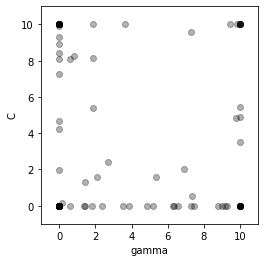

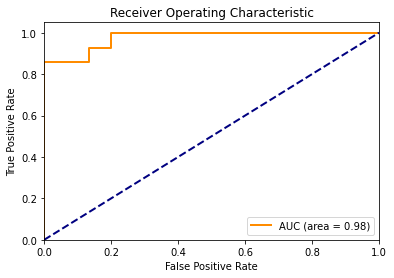

Accuracy for particle (in iteration 15, in fold 6) - 1 is 0.4828 At (gamma, c): [7.47247472e+00 1.00000000e-03]
Accuracy for particle (in iteration 15, in fold 6) - 2 is 0.4828 At (gamma, c): [6.56168422e+00 1.00000000e-03]
Accuracy for particle (in iteration 15, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 15, in fold 6) - 4 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 15, in fold 6) - 5 is 0.4828 At (gamma, c): [0.61882868 0.001     ]
Accuracy for particle (in iteration 15, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 15, in fold 6) - 7 is 0.4828 At (gamma, c): [1.41961958e+00 1.00000000e-03]
Accuracy for particle (in iteration 15, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 15, in fold 6) - 9 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 15, in fold 6) - 10 is 0.9310 At (gamma, c): [1.e-

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 15, in fold 6) - 98 is 0.9310 At (gamma, c): [2.06797461 1.5939976 ]
Accuracy for particle (in iteration 15, in fold 6) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 15, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 15, fold 6 is [1.00000000e-03 9.89931715e+00], with Accuracy: 0.9655
Accuracy Score: 0.9310
F1 Score: 0.9231
Recall Score: 0.8571
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 2 12]]
Confusion Matrix (Train):
[[121   7]
 [ 23 106]]

Iteration 16 - Fold 6:



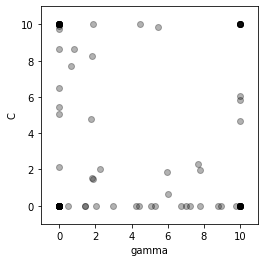

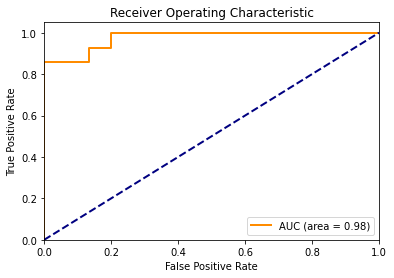

Accuracy for particle (in iteration 16, in fold 6) - 1 is 0.4828 At (gamma, c): [7.02897299e+00 1.00000000e-03]
Accuracy for particle (in iteration 16, in fold 6) - 2 is 0.4828 At (gamma, c): [6.70476336e+00 1.00000000e-03]
Accuracy for particle (in iteration 16, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 16, in fold 6) - 4 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 16, in fold 6) - 5 is 0.4828 At (gamma, c): [0.48119383 0.001     ]
Accuracy for particle (in iteration 16, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 16, in fold 6) - 7 is 0.4828 At (gamma, c): [1.45651163e+00 1.00000000e-03]
Accuracy for particle (in iteration 16, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 16, in fold 6) - 9 is 0.9310 At (gamma, c): [1.00000000e-03 8.66343533e+00]
Accuracy for particle (in iteration 16, in fold 6) - 10 is 0.9310 At (

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 16, in fold 6) - 93 is 0.9310 At (gamma, c): [1.80849066 1.51457386]
Accuracy for particle (in iteration 16, in fold 6) - 94 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 16, in fold 6) - 95 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 16, in fold 6) - 96 is 0.9310 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 16, in fold 6) - 97 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 16, in fold 6) - 98 is 0.9310 At (gamma, c): [1.87330921 1.48300721]
Accuracy for particle (in iteration 16, in fold 6) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 16, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 16, fold 6 is [1.e-03 1.e+01], with Accuracy: 0.9655
Accuracy Score: 0.9310
F1 Score: 0.9231
Recall Score: 0.8571
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 2 12]]
Confus

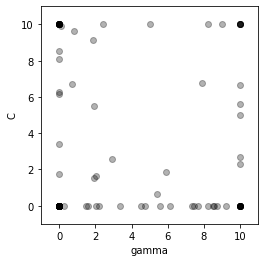

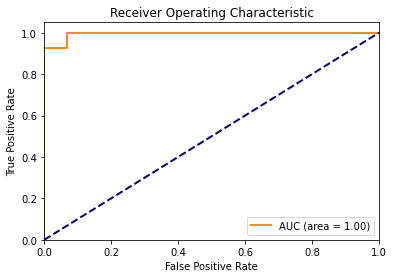

Accuracy for particle (in iteration 17, in fold 6) - 1 is 0.4828 At (gamma, c): [9.18865571e+00 1.00000000e-03]
Accuracy for particle (in iteration 17, in fold 6) - 2 is 0.4828 At (gamma, c): [8.5694238e+00 1.0000000e-03]
Accuracy for particle (in iteration 17, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 17, in fold 6) - 4 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 17, in fold 6) - 5 is 0.4828 At (gamma, c): [0.2459708 0.001    ]
Accuracy for particle (in iteration 17, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 17, in fold 6) - 7 is 0.4828 At (gamma, c): [1.60095006e+00 1.00000000e-03]
Accuracy for particle (in iteration 17, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 17, in fold 6) - 9 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 17, in fold 6) - 10 is 0.9310 At (gamma, c): [1.e-03 1

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 17, in fold 6) - 96 is 0.9310 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 17, in fold 6) - 97 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 17, in fold 6) - 98 is 0.9310 At (gamma, c): [1.9128318  1.50553427]
Accuracy for particle (in iteration 17, in fold 6) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 17, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 17, fold 6 is [1.00000000e-03 7.86193401e+00], with Accuracy: 0.9655
Accuracy Score: 0.9655
F1 Score: 0.9655
Recall Score: 1.0000
Precision Score: 0.9333
Confusion Matrix (Test):
[[14  1]
 [ 0 14]]
Confusion Matrix (Train):
[[127   1]
 [  1 128]]

Iteration 18 - Fold 6:



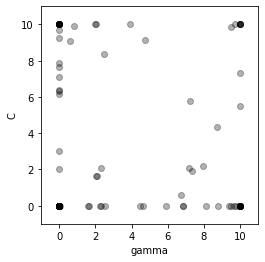

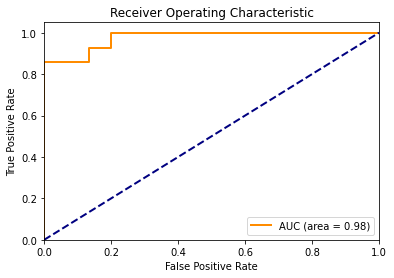

Accuracy for particle (in iteration 18, in fold 6) - 1 is 0.4828 At (gamma, c): [8.77688904e+00 1.00000000e-03]
Accuracy for particle (in iteration 18, in fold 6) - 2 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 18, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 18, in fold 6) - 4 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 18, in fold 6) - 5 is 0.4828 At (gamma, c): [0.01447419 0.001     ]
Accuracy for particle (in iteration 18, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 18, in fold 6) - 7 is 0.4828 At (gamma, c): [1.60601114e+00 1.00000000e-03]
Accuracy for particle (in iteration 18, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 18, in fold 6) - 9 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 18, in fold 6) - 10 is 0.9310 At (gamma, c): [1.00000000e-03 6.314

Accuracy for particle (in iteration 18, in fold 6) - 81 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 18, in fold 6) - 82 is 0.9310 At (gamma, c): [1.00000000e-03 7.67522592e+00]
Accuracy for particle (in iteration 18, in fold 6) - 83 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 18, in fold 6) - 84 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 18, in fold 6) - 85 is 0.9310 At (gamma, c): [0.57715252 9.08487092]
Accuracy for particle (in iteration 18, in fold 6) - 86 is 0.8966 At (gamma, c): [1.00000000e-03 2.01313217e+00]
Accuracy for particle (in iteration 18, in fold 6) - 87 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 18, in fold 6) - 88 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 18, in fold 6) - 89 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 18, in fold 6) - 90 is 0.4828 At (gamma, c): [0.001 0

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 18, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 18, fold 6 is [1.00000000e-03 9.84576951e+00], with Accuracy: 0.9655
Accuracy Score: 0.9310
F1 Score: 0.9231
Recall Score: 0.8571
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 2 12]]
Confusion Matrix (Train):
[[121   7]
 [ 23 106]]

Iteration 19 - Fold 6:



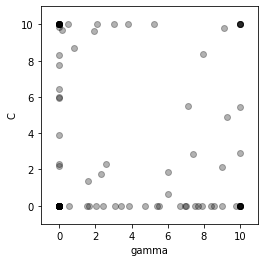

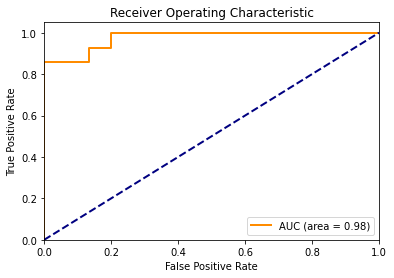

Accuracy for particle (in iteration 19, in fold 6) - 1 is 0.4828 At (gamma, c): [6.67892888e+00 1.00000000e-03]
Accuracy for particle (in iteration 19, in fold 6) - 2 is 0.4828 At (gamma, c): [9.78594791e+00 1.00000000e-03]
Accuracy for particle (in iteration 19, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 19, in fold 6) - 4 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 19, in fold 6) - 5 is 0.4828 At (gamma, c): [0.55815135 0.001     ]
Accuracy for particle (in iteration 19, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 19, in fold 6) - 7 is 0.4828 At (gamma, c): [1.64959175e+00 1.00000000e-03]
Accuracy for particle (in iteration 19, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 19, in fold 6) - 9 is 0.9310 At (gamma, c): [1.00000000e-03 6.01222255e+00]
Accuracy for particle (in iteration 19, in fold 6) - 10 is 0.9310 At (

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 19, in fold 6) - 96 is 0.9310 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 19, in fold 6) - 97 is 0.9310 At (gamma, c): [1.00000000e-03 8.31283216e+00]
Accuracy for particle (in iteration 19, in fold 6) - 98 is 0.9310 At (gamma, c): [2.32960029 1.74311231]
Accuracy for particle (in iteration 19, in fold 6) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 19, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 19, fold 6 is [1.e-03 1.e+01], with Accuracy: 0.9655
Accuracy Score: 0.9310
F1 Score: 0.9231
Recall Score: 0.8571
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 2 12]]
Confusion Matrix (Train):
[[121   7]
 [ 23 106]]

Iteration 20 - Fold 6:



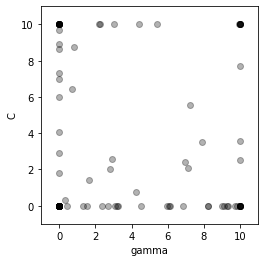

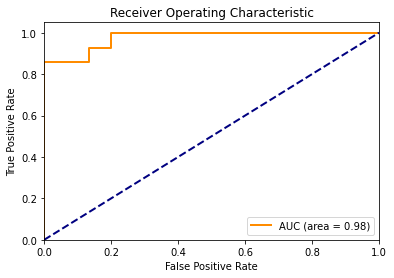

Accuracy for particle (in iteration 20, in fold 6) - 1 is 0.4828 At (gamma, c): [9.24414892e+00 1.00000000e-03]
Accuracy for particle (in iteration 20, in fold 6) - 2 is 0.4828 At (gamma, c): [6.13164008e+00 1.00000000e-03]
Accuracy for particle (in iteration 20, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 20, in fold 6) - 4 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 20, in fold 6) - 5 is 0.4828 At (gamma, c): [0.41638919 0.001     ]
Accuracy for particle (in iteration 20, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 20, in fold 6) - 7 is 0.4828 At (gamma, c): [1.54879674e+00 1.00000000e-03]
Accuracy for particle (in iteration 20, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 20, in fold 6) - 9 is 0.9310 At (gamma, c): [1.00000000e-03 5.97261492e+00]
Accuracy for particle (in iteration 20, in fold 6) - 10 is 0.9310 At (

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 20, in fold 6) - 94 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 20, in fold 6) - 95 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 20, in fold 6) - 96 is 0.9310 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 20, in fold 6) - 97 is 0.9310 At (gamma, c): [1.00000000e-03 9.68349304e+00]
Accuracy for particle (in iteration 20, in fold 6) - 98 is 0.9310 At (gamma, c): [2.81349735 2.01895757]
Accuracy for particle (in iteration 20, in fold 6) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 20, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 20, fold 6 is [1.00000000e-03 7.88756106e+00], with Accuracy: 0.9655
Accuracy Score: 0.9310
F1 Score: 0.9231
Recall Score: 0.8571
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 2 12]]
Confusion Matrix (Train):
[[121   7]
 [ 23 106]]

Iteration 21 - Fold 6:



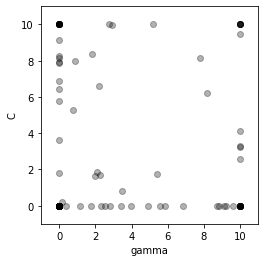

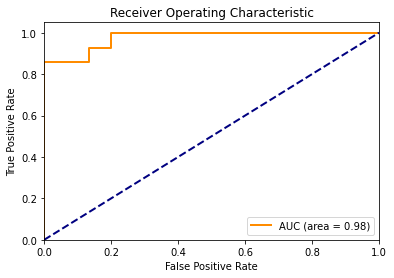

Accuracy for particle (in iteration 21, in fold 6) - 1 is 0.4828 At (gamma, c): [6.85901886e+00 1.00000000e-03]
Accuracy for particle (in iteration 21, in fold 6) - 2 is 0.4828 At (gamma, c): [8.81817266e+00 1.00000000e-03]
Accuracy for particle (in iteration 21, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 21, in fold 6) - 4 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 21, in fold 6) - 5 is 0.4828 At (gamma, c): [0.35937237 0.001     ]
Accuracy for particle (in iteration 21, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 21, in fold 6) - 7 is 0.4828 At (gamma, c): [1.73468519e+00 1.00000000e-03]
Accuracy for particle (in iteration 21, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 21, in fold 6) - 9 is 0.9310 At (gamma, c): [1.00000000e-03 8.26359642e+00]
Accuracy for particle (in iteration 21, in fold 6) - 10 is 0.9310 At (

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 21, in fold 6) - 98 is 0.9310 At (gamma, c): [2.27120697 1.70982509]
Accuracy for particle (in iteration 21, in fold 6) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 21, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 21, fold 6 is [1.00000000e-03 8.11532667e+00], with Accuracy: 0.9655
Accuracy Score: 0.9310
F1 Score: 0.9231
Recall Score: 0.8571
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 2 12]]
Confusion Matrix (Train):
[[121   7]
 [ 23 106]]

Iteration 22 - Fold 6:



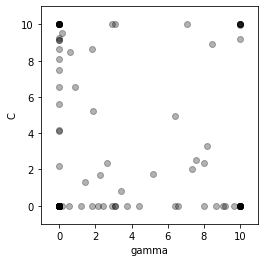

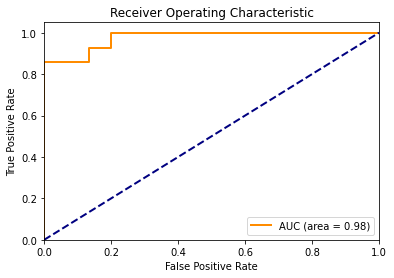

Accuracy for particle (in iteration 22, in fold 6) - 1 is 0.4828 At (gamma, c): [6.39277039e+00 1.00000000e-03]
Accuracy for particle (in iteration 22, in fold 6) - 2 is 0.4828 At (gamma, c): [8.01982402e+00 1.00000000e-03]
Accuracy for particle (in iteration 22, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 22, in fold 6) - 4 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 22, in fold 6) - 5 is 0.4828 At (gamma, c): [0.56773299 0.001     ]
Accuracy for particle (in iteration 22, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 22, in fold 6) - 7 is 0.4828 At (gamma, c): [1.81659616e+00 1.00000000e-03]
Accuracy for particle (in iteration 22, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 22, in fold 6) - 9 is 0.9310 At (gamma, c): [1.00000000e-03 9.28029382e+00]
Accuracy for particle (in iteration 22, in fold 6) - 10 is 0.9310 At (

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 22, in fold 6) - 97 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 22, in fold 6) - 98 is 0.9310 At (gamma, c): [2.27090256 1.70965153]
Accuracy for particle (in iteration 22, in fold 6) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 22, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 22, fold 6 is [1.00000000e-03 9.82432115e+00], with Accuracy: 0.9655
Accuracy Score: 0.9310
F1 Score: 0.9231
Recall Score: 0.8571
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 2 12]]
Confusion Matrix (Train):
[[121   7]
 [ 23 106]]

Iteration 23 - Fold 6:



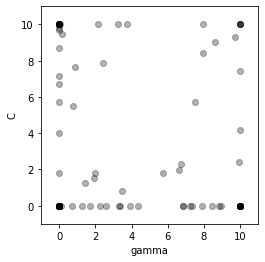

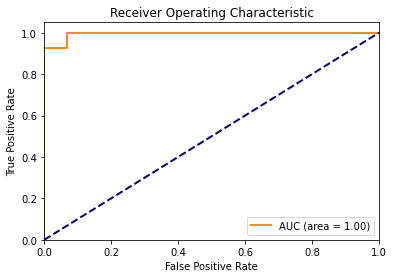

Accuracy for particle (in iteration 23, in fold 6) - 1 is 0.4828 At (gamma, c): [7.86096544e+00 1.00000000e-03]
Accuracy for particle (in iteration 23, in fold 6) - 2 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 23, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 23, in fold 6) - 4 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 23, in fold 6) - 5 is 0.4828 At (gamma, c): [0.68841934 0.001     ]
Accuracy for particle (in iteration 23, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 23, in fold 6) - 7 is 0.4828 At (gamma, c): [1.71083867e+00 1.00000000e-03]
Accuracy for particle (in iteration 23, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 23, in fold 6) - 9 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 23, in fold 6) - 10 is 0.9310 At (gamma, c): [1.00000000e-03 7.163

Accuracy for particle (in iteration 23, in fold 6) - 82 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 23, in fold 6) - 83 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 23, in fold 6) - 84 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 23, in fold 6) - 85 is 0.9310 At (gamma, c): [0.75082135 5.47991751]
Accuracy for particle (in iteration 23, in fold 6) - 86 is 0.8966 At (gamma, c): [1.00000000e-03 1.81605436e+00]
Accuracy for particle (in iteration 23, in fold 6) - 87 is 0.4828 At (gamma, c): [8.91683936e+00 1.00000000e-03]
Accuracy for particle (in iteration 23, in fold 6) - 88 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 23, in fold 6) - 89 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 23, in fold 6) - 90 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 23, in fold 6) - 91 is 0.4828 At (gamma, c): [6.84193

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


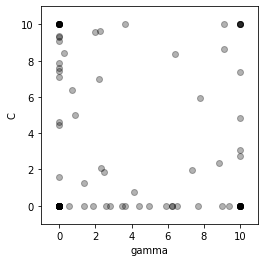

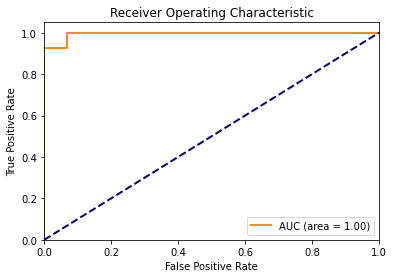

Accuracy for particle (in iteration 24, in fold 6) - 1 is 0.4828 At (gamma, c): [6.24313963e+00 1.00000000e-03]
Accuracy for particle (in iteration 24, in fold 6) - 2 is 0.4828 At (gamma, c): [9.37999474e+00 1.00000000e-03]
Accuracy for particle (in iteration 24, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 24, in fold 6) - 4 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 24, in fold 6) - 5 is 0.4828 At (gamma, c): [0.52633752 0.001     ]
Accuracy for particle (in iteration 24, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 24, in fold 6) - 7 is 0.4828 At (gamma, c): [1.8931193e+00 1.0000000e-03]
Accuracy for particle (in iteration 24, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 24, in fold 6) - 9 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 24, in fold 6) - 10 is 0.9310 At (gamma, c): [1.e-03

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 24, in fold 6) - 95 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 24, in fold 6) - 96 is 0.9310 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 24, in fold 6) - 97 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 24, in fold 6) - 98 is 0.9310 At (gamma, c): [2.50250856 1.8416784 ]
Accuracy for particle (in iteration 24, in fold 6) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 24, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 24, fold 6 is [1.e-03 1.e+01], with Accuracy: 0.9655
Accuracy Score: 0.9310
F1 Score: 0.9286
Recall Score: 0.9286
Precision Score: 0.9286
Confusion Matrix (Test):
[[14  1]
 [ 1 13]]
Confusion Matrix (Train):
[[128   0]
 [  1 128]]

Iteration 25 - Fold 6:



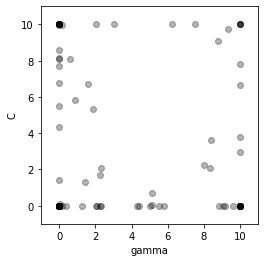

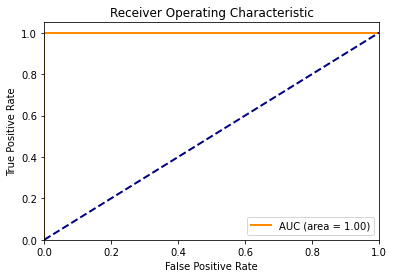

Accuracy for particle (in iteration 25, in fold 6) - 1 is 0.4828 At (gamma, c): [8.8137503e+00 1.0000000e-03]
Accuracy for particle (in iteration 25, in fold 6) - 2 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 25, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 25, in fold 6) - 4 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 25, in fold 6) - 5 is 0.4828 At (gamma, c): [0.38996484 0.001     ]
Accuracy for particle (in iteration 25, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 25, in fold 6) - 7 is 0.4828 At (gamma, c): [2.11973918e+00 1.00000000e-03]
Accuracy for particle (in iteration 25, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 25, in fold 6) - 9 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 25, in fold 6) - 10 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accurac

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 25, in fold 6) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 25, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 25, fold 6 is [1.e-03 1.e+01], with Accuracy: 0.9655
Accuracy Score: 0.9655
F1 Score: 0.9655
Recall Score: 1.0000
Precision Score: 0.9333
Confusion Matrix (Test):
[[14  1]
 [ 0 14]]
Confusion Matrix (Train):
[[127   1]
 [  1 128]]

Iteration 26 - Fold 6:



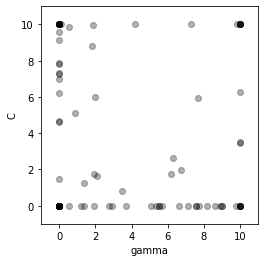

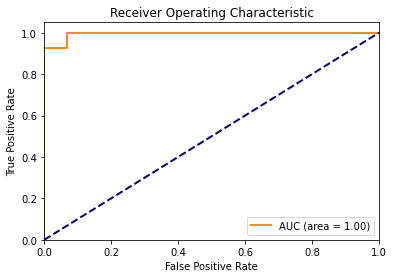

Accuracy for particle (in iteration 26, in fold 6) - 1 is 0.4828 At (gamma, c): [9.742563e+00 1.000000e-03]
Accuracy for particle (in iteration 26, in fold 6) - 2 is 0.4828 At (gamma, c): [7.70274043e+00 1.00000000e-03]
Accuracy for particle (in iteration 26, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 26, in fold 6) - 4 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 26, in fold 6) - 5 is 0.4828 At (gamma, c): [0.54271103 0.001     ]
Accuracy for particle (in iteration 26, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 26, in fold 6) - 7 is 0.4828 At (gamma, c): [1.35361903e+00 1.00000000e-03]
Accuracy for particle (in iteration 26, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 26, in fold 6) - 9 is 0.9310 At (gamma, c): [1.00000000e-03 6.19101624e+00]
Accuracy for particle (in iteration 26, in fold 6) - 10 is 0.9310 At (gamm

Accuracy for particle (in iteration 26, in fold 6) - 81 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 26, in fold 6) - 82 is 0.9310 At (gamma, c): [1.00000000e-03 7.84464746e+00]
Accuracy for particle (in iteration 26, in fold 6) - 83 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 26, in fold 6) - 84 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 26, in fold 6) - 85 is 0.9310 At (gamma, c): [0.54275936 9.86015638]
Accuracy for particle (in iteration 26, in fold 6) - 86 is 0.8966 At (gamma, c): [1.00000000e-03 1.47301055e+00]
Accuracy for particle (in iteration 26, in fold 6) - 87 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 26, in fold 6) - 88 is 0.4828 At (gamma, c): [9.00605677e+00 1.00000000e-03]
Accuracy for particle (in iteration 26, in fold 6) - 89 is 0.4828 At (gamma, c): [9.00916489e+00 1.00000000e-03]
Accuracy for particle (in iteration 26, in fold 6) - 90 i

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 26, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 26, fold 6 is [0.01496596 7.17154016], with Accuracy: 0.9655
Accuracy Score: 0.9655
F1 Score: 0.9655
Recall Score: 1.0000
Precision Score: 0.9333
Confusion Matrix (Test):
[[14  1]
 [ 0 14]]
Confusion Matrix (Train):
[[127   1]
 [  1 128]]

Iteration 27 - Fold 6:



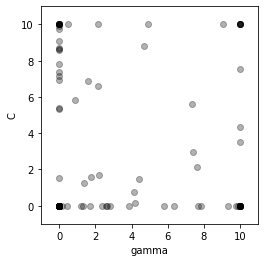

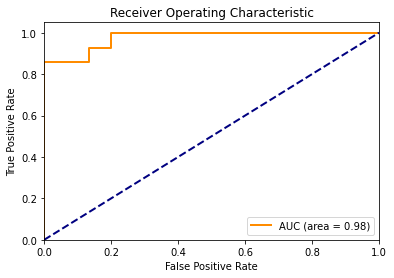

Accuracy for particle (in iteration 27, in fold 6) - 1 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 27, in fold 6) - 2 is 0.4828 At (gamma, c): [5.80669784e+00 1.00000000e-03]
Accuracy for particle (in iteration 27, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 27, in fold 6) - 4 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 27, in fold 6) - 5 is 0.4828 At (gamma, c): [0.44702679 0.001     ]
Accuracy for particle (in iteration 27, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 27, in fold 6) - 7 is 0.4828 At (gamma, c): [1.30083984e+00 1.00000000e-03]
Accuracy for particle (in iteration 27, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 27, in fold 6) - 9 is 0.9310 At (gamma, c): [1.00000000e-03 7.80387394e+00]
Accuracy for particle (in iteration 27, in fold 6) - 10 is 0.9310 At (gamma, c): [1.00

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 27, in fold 6) - 94 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 27, in fold 6) - 95 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 27, in fold 6) - 96 is 0.9310 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 27, in fold 6) - 97 is 0.9310 At (gamma, c): [1.0000000e-03 9.9143175e+00]
Accuracy for particle (in iteration 27, in fold 6) - 98 is 0.9310 At (gamma, c): [2.22496182 1.68346301]
Accuracy for particle (in iteration 27, in fold 6) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 27, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 27, fold 6 is [0.09864992 6.10023105], with Accuracy: 0.9655
Accuracy Score: 0.9310
F1 Score: 0.9231
Recall Score: 0.8571
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 2 12]]
Confusion Matrix (Train):
[[121   7]
 [ 23 106]]

Iteration 28 - Fold 6:



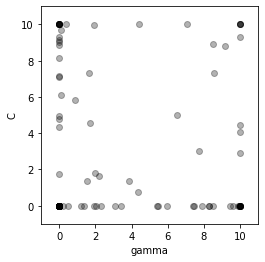

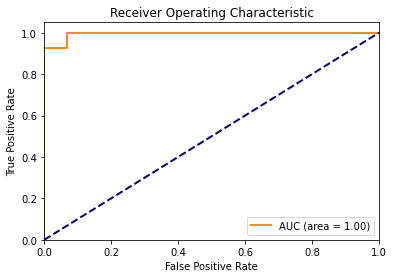

Accuracy for particle (in iteration 28, in fold 6) - 1 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 28, in fold 6) - 2 is 0.4828 At (gamma, c): [8.28987511e+00 1.00000000e-03]
Accuracy for particle (in iteration 28, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 28, in fold 6) - 4 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 28, in fold 6) - 5 is 0.4828 At (gamma, c): [0.46600797 0.001     ]
Accuracy for particle (in iteration 28, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 28, in fold 6) - 7 is 0.4828 At (gamma, c): [1.39231101e+00 1.00000000e-03]
Accuracy for particle (in iteration 28, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 28, in fold 6) - 9 is 0.9310 At (gamma, c): [1.00000000e-03 9.15468952e+00]
Accuracy for particle (in iteration 28, in fold 6) - 10 is 0.9310 At (gamma, c): [1.00

Accuracy for particle (in iteration 28, in fold 6) - 87 is 0.4828 At (gamma, c): [8.48489728e+00 1.00000000e-03]
Accuracy for particle (in iteration 28, in fold 6) - 88 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 28, in fold 6) - 89 is 0.4828 At (gamma, c): [9.87383753e+00 1.00000000e-03]
Accuracy for particle (in iteration 28, in fold 6) - 90 is 0.4828 At (gamma, c): [0.20910869 0.001     ]
Accuracy for particle (in iteration 28, in fold 6) - 91 is 0.4828 At (gamma, c): [5.95774394e+00 1.00000000e-03]
Accuracy for particle (in iteration 28, in fold 6) - 92 is 0.4828 At (gamma, c): [5.43992634e+00 1.00000000e-03]
Accuracy for particle (in iteration 28, in fold 6) - 93 is 0.8966 At (gamma, c): [1.54850905 1.34524483]
Accuracy for particle (in iteration 28, in fold 6) - 94 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 28, in fold 6) - 95 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 28, in fold 6

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


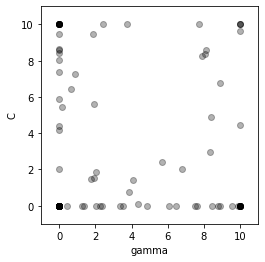

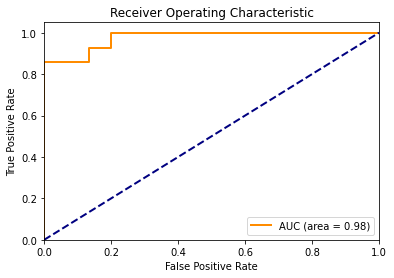

Accuracy for particle (in iteration 29, in fold 6) - 1 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 29, in fold 6) - 2 is 0.4828 At (gamma, c): [6.0540727e+00 1.0000000e-03]
Accuracy for particle (in iteration 29, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 29, in fold 6) - 4 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 29, in fold 6) - 5 is 0.4828 At (gamma, c): [0.43169335 0.001     ]
Accuracy for particle (in iteration 29, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 29, in fold 6) - 7 is 0.4828 At (gamma, c): [1.37799635e+00 1.00000000e-03]
Accuracy for particle (in iteration 29, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 29, in fold 6) - 9 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 29, in fold 6) - 10 is 0.9310 At (gamma, c): [1.00000000e-03 8.60162

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 29, in fold 6) - 93 is 0.8966 At (gamma, c): [1.77270104 1.49127069]
Accuracy for particle (in iteration 29, in fold 6) - 94 is 0.4828 At (gamma, c): [9.56202649e+00 1.00000000e-03]
Accuracy for particle (in iteration 29, in fold 6) - 95 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 29, in fold 6) - 96 is 0.9310 At (gamma, c): [7.88409714 8.2374059 ]
Accuracy for particle (in iteration 29, in fold 6) - 97 is 0.9310 At (gamma, c): [1.00000000e-03 8.40684354e+00]
Accuracy for particle (in iteration 29, in fold 6) - 98 is 0.9310 At (gamma, c): [1.92126891 1.51034301]
Accuracy for particle (in iteration 29, in fold 6) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 29, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 29, fold 6 is [1.00000000e-03 8.10674426e+00], with Accuracy: 0.9655
Accuracy Score: 0.9310
F1 Score: 0.9231
Recall Score: 0.8571
Precision Sc

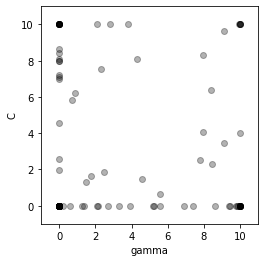

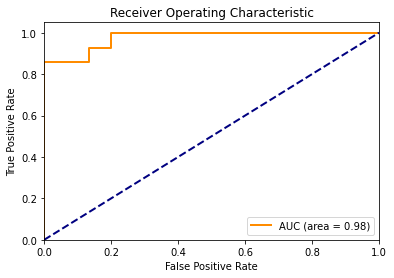

Accuracy for particle (in iteration 30, in fold 6) - 1 is 0.4828 At (gamma, c): [9.81791812e+00 1.00000000e-03]
Accuracy for particle (in iteration 30, in fold 6) - 2 is 0.4828 At (gamma, c): [8.57864804e+00 1.00000000e-03]
Accuracy for particle (in iteration 30, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 30, in fold 6) - 4 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 30, in fold 6) - 5 is 0.4828 At (gamma, c): [0.62890042 0.001     ]
Accuracy for particle (in iteration 30, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 30, in fold 6) - 7 is 0.4828 At (gamma, c): [1.37645851e+00 1.00000000e-03]
Accuracy for particle (in iteration 30, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 30, in fold 6) - 9 is 0.9310 At (gamma, c): [1.00000000e-03 8.00832633e+00]
Accuracy for particle (in iteration 30, in fold 6) - 10 is 0.9310 At (

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 30, in fold 6) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 30, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 30, fold 6 is [1.00000000e-03 9.35399919e+00], with Accuracy: 0.9655
Accuracy Score: 0.9310
F1 Score: 0.9231
Recall Score: 0.8571
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 2 12]]
Confusion Matrix (Train):
[[121   7]
 [ 23 106]]

Iteration 31 - Fold 6:



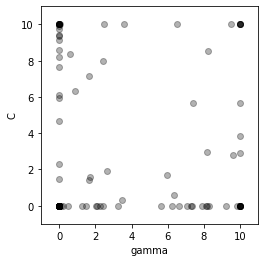

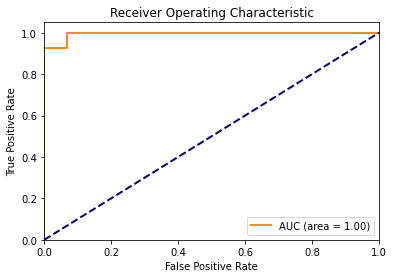

Accuracy for particle (in iteration 31, in fold 6) - 1 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 31, in fold 6) - 2 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 31, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 31, in fold 6) - 4 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 31, in fold 6) - 5 is 0.4828 At (gamma, c): [0.51933824 0.001     ]
Accuracy for particle (in iteration 31, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 31, in fold 6) - 7 is 0.4828 At (gamma, c): [1.50677174e+00 1.00000000e-03]
Accuracy for particle (in iteration 31, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 31, in fold 6) - 9 is 0.9310 At (gamma, c): [1.00000000e-03 9.42913976e+00]
Accuracy for particle (in iteration 31, in fold 6) - 10 is 0.9310 At (gamma, c): [1.00000000e-03 7.668

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 31, in fold 6) - 97 is 0.9310 At (gamma, c): [1.00000000e-03 9.89983818e+00]
Accuracy for particle (in iteration 31, in fold 6) - 98 is 0.9310 At (gamma, c): [2.66061776 1.93180846]
Accuracy for particle (in iteration 31, in fold 6) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 31, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 31, fold 6 is [1.e-03 1.e+01], with Accuracy: 0.9655
Accuracy Score: 0.9655
F1 Score: 0.9655
Recall Score: 1.0000
Precision Score: 0.9333
Confusion Matrix (Test):
[[14  1]
 [ 0 14]]
Confusion Matrix (Train):
[[126   2]
 [  2 127]]

Iteration 32 - Fold 6:



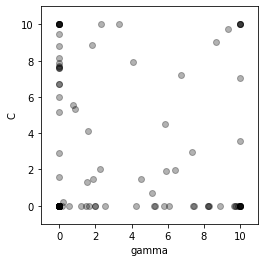

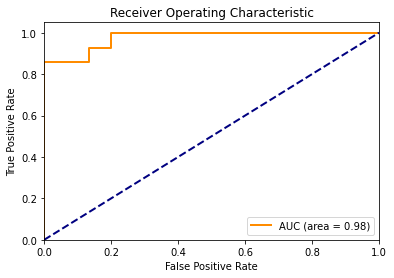

Accuracy for particle (in iteration 32, in fold 6) - 1 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 32, in fold 6) - 2 is 0.4828 At (gamma, c): [8.85488553e+00 1.00000000e-03]
Accuracy for particle (in iteration 32, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 32, in fold 6) - 4 is 0.9310 At (gamma, c): [1.0000000e-03 7.6538139e+00]
Accuracy for particle (in iteration 32, in fold 6) - 5 is 0.4828 At (gamma, c): [0.57199679 0.001     ]
Accuracy for particle (in iteration 32, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 32, in fold 6) - 7 is 0.4828 At (gamma, c): [1.50490082e+00 1.00000000e-03]
Accuracy for particle (in iteration 32, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 32, in fold 6) - 9 is 0.9310 At (gamma, c): [1.00000000e-03 8.80243683e+00]
Accuracy for particle (in iteration 32, in fold 6) - 10 is 0.9310 At (ga

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 32, in fold 6) - 97 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 32, in fold 6) - 98 is 0.9310 At (gamma, c): [1.87151698 1.48198195]
Accuracy for particle (in iteration 32, in fold 6) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 32, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 32, fold 6 is [0.15919663 6.09334927], with Accuracy: 0.9655
Accuracy Score: 0.9310
F1 Score: 0.9231
Recall Score: 0.8571
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 2 12]]
Confusion Matrix (Train):
[[121   7]
 [ 23 106]]

Iteration 33 - Fold 6:



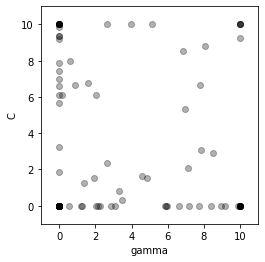

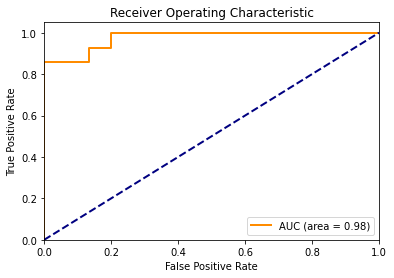

Accuracy for particle (in iteration 33, in fold 6) - 1 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 33, in fold 6) - 2 is 0.4828 At (gamma, c): [8.37062492e+00 1.00000000e-03]
Accuracy for particle (in iteration 33, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 33, in fold 6) - 4 is 0.9310 At (gamma, c): [1.00000000e-03 7.42755433e+00]
Accuracy for particle (in iteration 33, in fold 6) - 5 is 0.4828 At (gamma, c): [0.55950801 0.001     ]
Accuracy for particle (in iteration 33, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 33, in fold 6) - 7 is 0.4828 At (gamma, c): [1.28025412e+00 1.00000000e-03]
Accuracy for particle (in iteration 33, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 33, in fold 6) - 9 is 0.9310 At (gamma, c): [1.00000000e-03 9.18101856e+00]
Accuracy for particle (in iteration 33, in fold 6) - 10 is 0.9310 At (

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 33, in fold 6) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 33, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 33, fold 6 is [0.10411309 6.08656505], with Accuracy: 0.9655
Accuracy Score: 0.9310
F1 Score: 0.9231
Recall Score: 0.8571
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 2 12]]
Confusion Matrix (Train):
[[121   7]
 [ 23 106]]

Iteration 34 - Fold 6:



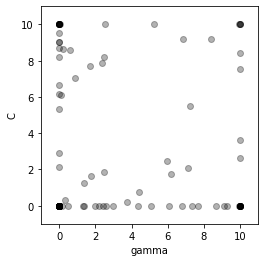

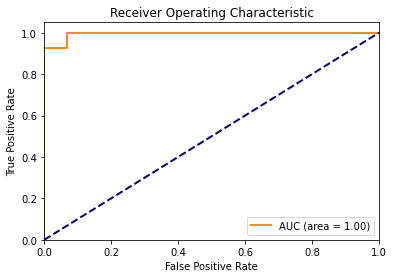

Accuracy for particle (in iteration 34, in fold 6) - 1 is 0.4828 At (gamma, c): [5.08109188e+00 1.00000000e-03]
Accuracy for particle (in iteration 34, in fold 6) - 2 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 34, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 34, in fold 6) - 4 is 0.9310 At (gamma, c): [1.00000000e-03 8.72476017e+00]
Accuracy for particle (in iteration 34, in fold 6) - 5 is 0.4828 At (gamma, c): [0.51412277 0.001     ]
Accuracy for particle (in iteration 34, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 34, in fold 6) - 7 is 0.4828 At (gamma, c): [1.36730312e+00 1.00000000e-03]
Accuracy for particle (in iteration 34, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 34, in fold 6) - 9 is 0.9310 At (gamma, c): [1.00000000e-03 9.53405067e+00]
Accuracy for particle (in iteration 34, in fold 6) - 10 is 0.9310 At (

Accuracy for particle (in iteration 34, in fold 6) - 82 is 0.9310 At (gamma, c): [1.0000000e-03 8.1974649e+00]
Accuracy for particle (in iteration 34, in fold 6) - 83 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 34, in fold 6) - 84 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 34, in fold 6) - 85 is 0.9310 At (gamma, c): [0.60122171 8.59727737]
Accuracy for particle (in iteration 34, in fold 6) - 86 is 0.9310 At (gamma, c): [1.00000000e-03 2.10984448e+00]
Accuracy for particle (in iteration 34, in fold 6) - 87 is 0.4828 At (gamma, c): [9.12729212e+00 1.00000000e-03]
Accuracy for particle (in iteration 34, in fold 6) - 88 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 34, in fold 6) - 89 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 34, in fold 6) - 90 is 0.4828 At (gamma, c): [0.18238393 0.001     ]
Accuracy for particle (in iteration 34, in fold 6) - 91 is 0.4828

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


The best position in iteration 34, fold 6 is [ 0.02420209 10.        ], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9655
Recall Score: 1.0000
Precision Score: 0.9333
Confusion Matrix (Test):
[[14  1]
 [ 0 14]]
Confusion Matrix (Train):
[[126   2]
 [  2 127]]

Iteration 35 - Fold 6:



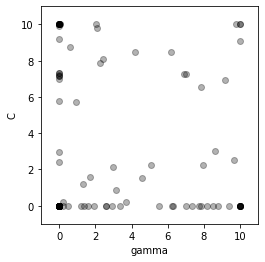

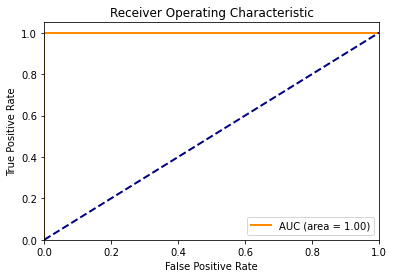

Accuracy for particle (in iteration 35, in fold 6) - 1 is 0.4828 At (gamma, c): [5.52085863e+00 1.00000000e-03]
Accuracy for particle (in iteration 35, in fold 6) - 2 is 0.4828 At (gamma, c): [8.14522804e+00 1.00000000e-03]
Accuracy for particle (in iteration 35, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 35, in fold 6) - 4 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 35, in fold 6) - 5 is 0.4828 At (gamma, c): [0.48967829 0.001     ]
Accuracy for particle (in iteration 35, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 35, in fold 6) - 7 is 0.4828 At (gamma, c): [1.37452514e+00 1.00000000e-03]
Accuracy for particle (in iteration 35, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 35, in fold 6) - 9 is 0.9310 At (gamma, c): [1.00000000e-03 9.22203735e+00]
Accuracy for particle (in iteration 35, in fold 6) - 10 is 0.9310 At (

Accuracy for particle (in iteration 35, in fold 6) - 81 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 35, in fold 6) - 82 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 35, in fold 6) - 83 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 35, in fold 6) - 84 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 35, in fold 6) - 85 is 0.9310 At (gamma, c): [0.60672079 8.75372391]
Accuracy for particle (in iteration 35, in fold 6) - 86 is 0.9310 At (gamma, c): [1.00000000e-03 2.39795314e+00]
Accuracy for particle (in iteration 35, in fold 6) - 87 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 35, in fold 6) - 88 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 35, in fold 6) - 89 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 35, in fold 6) - 90 is 0.4828 At (gamma, c): [0.23548355 0.001     ]


*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 35, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 35, fold 6 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9630
Recall Score: 0.9286
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 1 13]]
Confusion Matrix (Train):
[[127   1]
 [  6 123]]

Iteration 36 - Fold 6:



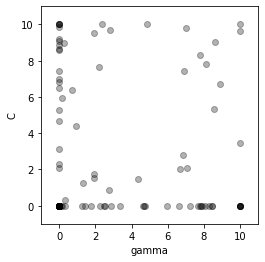

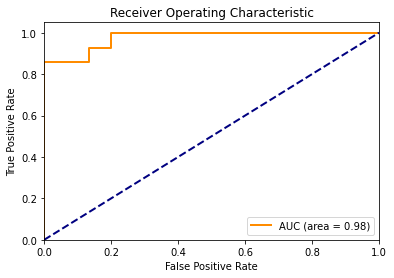

Accuracy for particle (in iteration 36, in fold 6) - 1 is 0.4828 At (gamma, c): [4.67194209e+00 1.00000000e-03]
Accuracy for particle (in iteration 36, in fold 6) - 2 is 0.4828 At (gamma, c): [4.63173681e+00 1.00000000e-03]
Accuracy for particle (in iteration 36, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 36, in fold 6) - 4 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 36, in fold 6) - 5 is 0.4828 At (gamma, c): [0.34984938 0.001     ]
Accuracy for particle (in iteration 36, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 36, in fold 6) - 7 is 0.4828 At (gamma, c): [1.4103363e+00 1.0000000e-03]
Accuracy for particle (in iteration 36, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 36, in fold 6) - 9 is 0.9310 At (gamma, c): [1.00000000e-03 4.65476573e+00]
Accuracy for particle (in iteration 36, in fold 6) - 10 is 0.9310 At (ga

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 36, in fold 6) - 97 is 0.9310 At (gamma, c): [1.00000000e-03 8.86937669e+00]
Accuracy for particle (in iteration 36, in fold 6) - 98 is 0.9310 At (gamma, c): [1.92617024 1.52515245]
Accuracy for particle (in iteration 36, in fold 6) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 36, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 36, fold 6 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.9310
F1 Score: 0.9231
Recall Score: 0.8571
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 2 12]]
Confusion Matrix (Train):
[[121   7]
 [ 23 106]]

Iteration 37 - Fold 6:



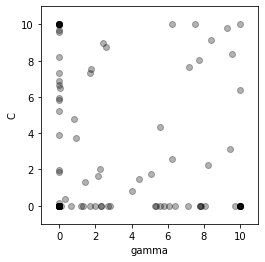

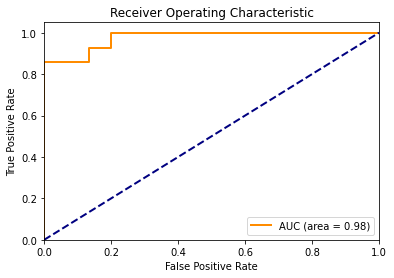

Accuracy for particle (in iteration 37, in fold 6) - 1 is 0.4828 At (gamma, c): [5.31023304e+00 1.00000000e-03]
Accuracy for particle (in iteration 37, in fold 6) - 2 is 0.4828 At (gamma, c): [6.4229076e+00 1.0000000e-03]
Accuracy for particle (in iteration 37, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 37, in fold 6) - 4 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 37, in fold 6) - 5 is 0.4828 At (gamma, c): [0.67027375 0.001     ]
Accuracy for particle (in iteration 37, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 37, in fold 6) - 7 is 0.4828 At (gamma, c): [1.3449694e+00 1.0000000e-03]
Accuracy for particle (in iteration 37, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 37, in fold 6) - 9 is 0.9310 At (gamma, c): [1.00000000e-03 5.95207121e+00]
Accuracy for particle (in iteration 37, in fold 6) - 10 is 0.9310 At (gamm

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 37, in fold 6) - 97 is 0.9310 At (gamma, c): [1.00000000e-03 7.34208061e+00]
Accuracy for particle (in iteration 37, in fold 6) - 98 is 0.9310 At (gamma, c): [2.15054407 1.65397119]
Accuracy for particle (in iteration 37, in fold 6) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 37, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 37, fold 6 is [ 0.02056011 10.        ], with Accuracy: 1.0000
Accuracy Score: 0.9310
F1 Score: 0.9231
Recall Score: 0.8571
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 2 12]]
Confusion Matrix (Train):
[[121   7]
 [ 23 106]]

Iteration 38 - Fold 6:



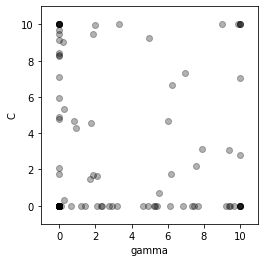

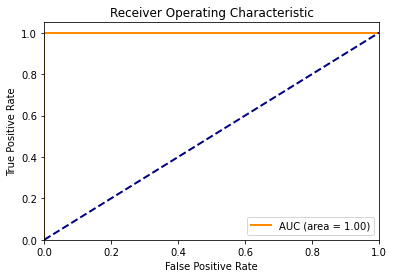

Accuracy for particle (in iteration 38, in fold 6) - 1 is 0.4828 At (gamma, c): [4.89840704e+00 1.00000000e-03]
Accuracy for particle (in iteration 38, in fold 6) - 2 is 0.4828 At (gamma, c): [5.27909028e+00 1.00000000e-03]
Accuracy for particle (in iteration 38, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 38, in fold 6) - 4 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 38, in fold 6) - 5 is 0.4828 At (gamma, c): [0.67331218 0.001     ]
Accuracy for particle (in iteration 38, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 38, in fold 6) - 7 is 0.4828 At (gamma, c): [1.40549694e+00 1.00000000e-03]
Accuracy for particle (in iteration 38, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 38, in fold 6) - 9 is 0.9310 At (gamma, c): [1.00000000e-03 8.32055281e+00]
Accuracy for particle (in iteration 38, in fold 6) - 10 is 0.9310 At (

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 38, in fold 6) - 91 is 0.4828 At (gamma, c): [7.42328434e+00 1.00000000e-03]
Accuracy for particle (in iteration 38, in fold 6) - 92 is 0.4828 At (gamma, c): [2.77729877e+00 1.00000000e-03]
Accuracy for particle (in iteration 38, in fold 6) - 93 is 0.8966 At (gamma, c): [1.69904742 1.45501956]
Accuracy for particle (in iteration 38, in fold 6) - 94 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 38, in fold 6) - 95 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 38, in fold 6) - 96 is 0.9310 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 38, in fold 6) - 97 is 0.9310 At (gamma, c): [1.0000000e-03 8.4253632e+00]
Accuracy for particle (in iteration 38, in fold 6) - 98 is 0.9310 At (gamma, c): [2.07751312 1.61330907]
Accuracy for particle (in iteration 38, in fold 6) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 38, in fold 6) - 100 is 0.4828 At (gamm

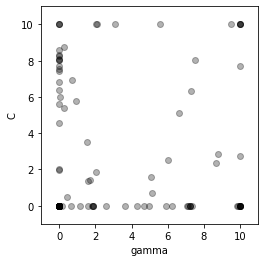

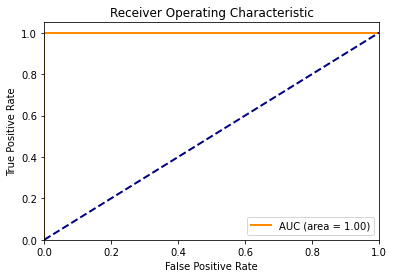

Accuracy for particle (in iteration 39, in fold 6) - 1 is 0.4828 At (gamma, c): [7.23544025e+00 1.00000000e-03]
Accuracy for particle (in iteration 39, in fold 6) - 2 is 0.4828 At (gamma, c): [7.1317899e+00 1.0000000e-03]
Accuracy for particle (in iteration 39, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 39, in fold 6) - 4 is 0.9310 At (gamma, c): [1.00000000e-03 6.80073367e+00]
Accuracy for particle (in iteration 39, in fold 6) - 5 is 0.4828 At (gamma, c): [0.64037911 0.001     ]
Accuracy for particle (in iteration 39, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 39, in fold 6) - 7 is 0.4828 At (gamma, c): [1.57580143e+00 1.00000000e-03]
Accuracy for particle (in iteration 39, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 39, in fold 6) - 9 is 0.9310 At (gamma, c): [1.00000000e-03 5.60833218e+00]
Accuracy for particle (in iteration 39, in fold 6) - 10 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 39, in fold 6) - 93 is 0.8966 At (gamma, c): [1.58641951 1.38181616]
Accuracy for particle (in iteration 39, in fold 6) - 94 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 39, in fold 6) - 95 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 39, in fold 6) - 96 is 0.9310 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 39, in fold 6) - 97 is 0.9310 At (gamma, c): [1.00000000e-03 8.08623268e+00]
Accuracy for particle (in iteration 39, in fold 6) - 98 is 0.8966 At (gamma, c): [1.69322805 1.39501194]
Accuracy for particle (in iteration 39, in fold 6) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 39, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 39, fold 6 is [0.38914917 7.55189592], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9630
Recall Score: 0.9286
Precision Score: 1.0000
Confusion Matrix (Test):
[

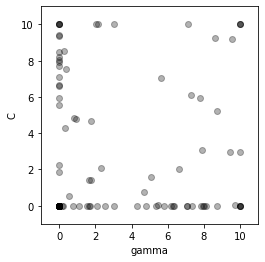

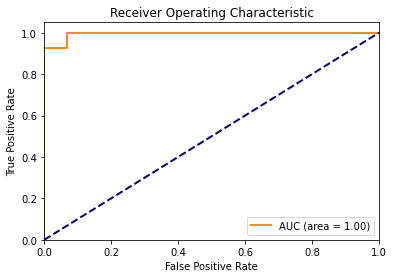

Accuracy for particle (in iteration 40, in fold 6) - 1 is 0.4828 At (gamma, c): [6.18492506e+00 1.00000000e-03]
Accuracy for particle (in iteration 40, in fold 6) - 2 is 0.4828 At (gamma, c): [4.78469696e+00 1.00000000e-03]
Accuracy for particle (in iteration 40, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 40, in fold 6) - 4 is 0.9310 At (gamma, c): [1.00000000e-03 8.23175742e+00]
Accuracy for particle (in iteration 40, in fold 6) - 5 is 0.4828 At (gamma, c): [0.75431845 0.001     ]
Accuracy for particle (in iteration 40, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 40, in fold 6) - 7 is 0.4828 At (gamma, c): [1.72094182e+00 1.00000000e-03]
Accuracy for particle (in iteration 40, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 40, in fold 6) - 9 is 0.9310 At (gamma, c): [1.00000000e-03 6.64561168e+00]
Accuracy for particle (in iteration 40, in fold 6) - 1

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 40, in fold 6) - 97 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 40, in fold 6) - 98 is 0.8966 At (gamma, c): [1.764776   1.43589671]
Accuracy for particle (in iteration 40, in fold 6) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 40, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 40, fold 6 is [0.30026127 8.55351554], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9630
Recall Score: 0.9286
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 1 13]]
Confusion Matrix (Train):
[[128   0]
 [  1 128]]

Iteration 41 - Fold 6:



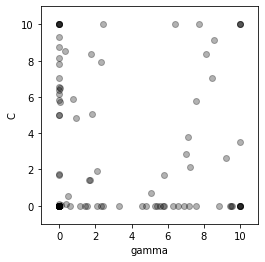

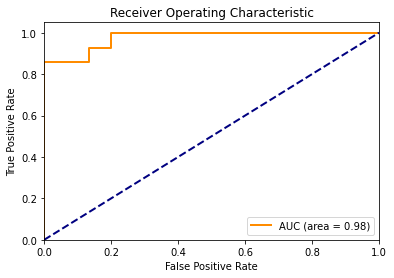

Accuracy for particle (in iteration 41, in fold 6) - 1 is 0.4828 At (gamma, c): [5.42334356e+00 1.00000000e-03]
Accuracy for particle (in iteration 41, in fold 6) - 2 is 0.4828 At (gamma, c): [4.78082197e+00 1.00000000e-03]
Accuracy for particle (in iteration 41, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 41, in fold 6) - 4 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 41, in fold 6) - 5 is 0.4828 At (gamma, c): [0.59977786 0.001     ]
Accuracy for particle (in iteration 41, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 41, in fold 6) - 7 is 0.4828 At (gamma, c): [1.43947707e+00 1.00000000e-03]
Accuracy for particle (in iteration 41, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 41, in fold 6) - 9 is 0.9310 At (gamma, c): [1.0000000e-03 4.9870361e+00]
Accuracy for particle (in iteration 41, in fold 6) - 10 is 0.9310 At (ga

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 41, in fold 6) - 92 is 0.4828 At (gamma, c): [5.26861002e+00 1.00000000e-03]
Accuracy for particle (in iteration 41, in fold 6) - 93 is 0.8966 At (gamma, c): [1.62539525 1.40728893]
Accuracy for particle (in iteration 41, in fold 6) - 94 is 0.4828 At (gamma, c): [5.57937825e+00 1.00000000e-03]
Accuracy for particle (in iteration 41, in fold 6) - 95 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 41, in fold 6) - 96 is 0.9310 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 41, in fold 6) - 97 is 0.9310 At (gamma, c): [1.00000000e-03 8.76124378e+00]
Accuracy for particle (in iteration 41, in fold 6) - 98 is 0.8966 At (gamma, c): [1.73371924 1.4182355 ]
Accuracy for particle (in iteration 41, in fold 6) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 41, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 41, fold 6 is [1.e-03 1.e+01], with Accurac

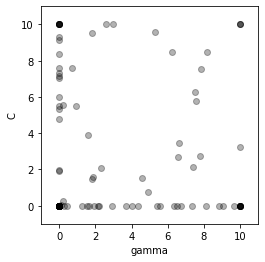

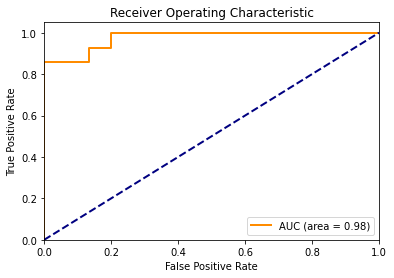

Accuracy for particle (in iteration 42, in fold 6) - 1 is 0.4828 At (gamma, c): [7.32671487e+00 1.00000000e-03]
Accuracy for particle (in iteration 42, in fold 6) - 2 is 0.4828 At (gamma, c): [4.02724336e+00 1.00000000e-03]
Accuracy for particle (in iteration 42, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 42, in fold 6) - 4 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 42, in fold 6) - 5 is 0.4828 At (gamma, c): [0.45935313 0.001     ]
Accuracy for particle (in iteration 42, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 42, in fold 6) - 7 is 0.4828 At (gamma, c): [1.5138478e+00 1.0000000e-03]
Accuracy for particle (in iteration 42, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 42, in fold 6) - 9 is 0.9310 At (gamma, c): [1.0000000e-03 7.0615628e+00]
Accuracy for particle (in iteration 42, in fold 6) - 10 is 0.9310 At (gamm

Accuracy for particle (in iteration 42, in fold 6) - 89 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 42, in fold 6) - 90 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 42, in fold 6) - 91 is 0.4828 At (gamma, c): [5.42331866e+00 1.00000000e-03]
Accuracy for particle (in iteration 42, in fold 6) - 92 is 0.4828 At (gamma, c): [6.34727544e+00 1.00000000e-03]
Accuracy for particle (in iteration 42, in fold 6) - 93 is 0.9310 At (gamma, c): [1.85666399 1.55792452]
Accuracy for particle (in iteration 42, in fold 6) - 94 is 0.4828 At (gamma, c): [5.59680778e+00 1.00000000e-03]
Accuracy for particle (in iteration 42, in fold 6) - 95 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 42, in fold 6) - 96 is 0.9310 At (gamma, c): [8.18254602 8.45574408]
Accuracy for particle (in iteration 42, in fold 6) - 97 is 0.9310 At (gamma, c): [1.00000000e-03 8.37738424e+00]
Accuracy for particle (in iteration 42, in fold 6) 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


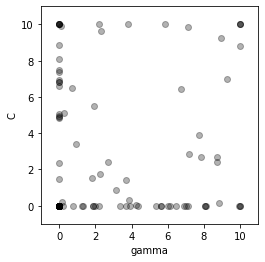

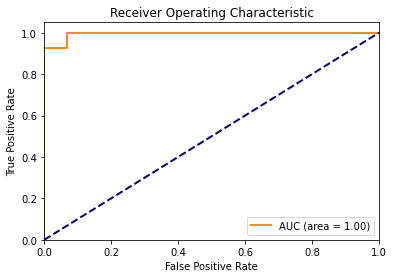

Accuracy for particle (in iteration 43, in fold 6) - 1 is 0.4828 At (gamma, c): [7.11877886e+00 1.00000000e-03]
Accuracy for particle (in iteration 43, in fold 6) - 2 is 0.4828 At (gamma, c): [6.13408758e+00 1.00000000e-03]
Accuracy for particle (in iteration 43, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 43, in fold 6) - 4 is 0.9310 At (gamma, c): [1.00000000e-03 7.38011936e+00]
Accuracy for particle (in iteration 43, in fold 6) - 5 is 0.4828 At (gamma, c): [0.75295353 0.001     ]
Accuracy for particle (in iteration 43, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 43, in fold 6) - 7 is 0.4828 At (gamma, c): [1.26743116e+00 1.00000000e-03]
Accuracy for particle (in iteration 43, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 43, in fold 6) - 9 is 0.9310 At (gamma, c): [1.00000000e-03 8.88725792e+00]
Accuracy for particle (in iteration 43, in fold 6) - 1

Accuracy for particle (in iteration 43, in fold 6) - 88 is 0.4828 At (gamma, c): [8.12066873e+00 1.00000000e-03]
Accuracy for particle (in iteration 43, in fold 6) - 89 is 0.4828 At (gamma, c): [8.06088889e+00 1.00000000e-03]
Accuracy for particle (in iteration 43, in fold 6) - 90 is 0.4828 At (gamma, c): [0.1923121 0.001    ]
Accuracy for particle (in iteration 43, in fold 6) - 91 is 0.4828 At (gamma, c): [4.35486044e+00 1.00000000e-03]
Accuracy for particle (in iteration 43, in fold 6) - 92 is 0.4828 At (gamma, c): [3.90004491e+00 1.00000000e-03]
Accuracy for particle (in iteration 43, in fold 6) - 93 is 0.9310 At (gamma, c): [1.83497892 1.54381697]
Accuracy for particle (in iteration 43, in fold 6) - 94 is 0.4828 At (gamma, c): [5.61144246e+00 1.00000000e-03]
Accuracy for particle (in iteration 43, in fold 6) - 95 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 43, in fold 6) - 96 is 0.9310 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 43, i

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


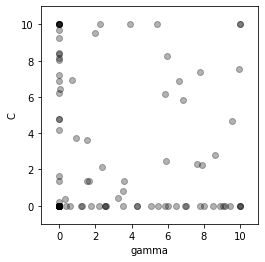

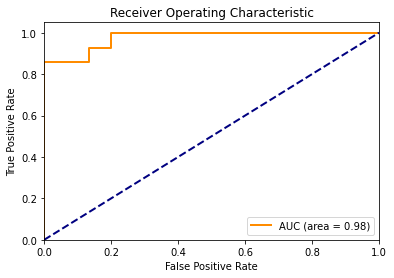

Accuracy for particle (in iteration 44, in fold 6) - 1 is 0.4828 At (gamma, c): [6.44053917e+00 1.00000000e-03]
Accuracy for particle (in iteration 44, in fold 6) - 2 is 0.4828 At (gamma, c): [7.77423134e+00 1.00000000e-03]
Accuracy for particle (in iteration 44, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 44, in fold 6) - 4 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 44, in fold 6) - 5 is 0.4828 At (gamma, c): [0.62579573 0.001     ]
Accuracy for particle (in iteration 44, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 44, in fold 6) - 7 is 0.4828 At (gamma, c): [1.23488957e+00 1.00000000e-03]
Accuracy for particle (in iteration 44, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 44, in fold 6) - 9 is 0.9310 At (gamma, c): [1.0000000e-03 6.8641034e+00]
Accuracy for particle (in iteration 44, in fold 6) - 10 is 0.9310 At (ga

Accuracy for particle (in iteration 44, in fold 6) - 88 is 0.4828 At (gamma, c): [8.48700449e+00 1.00000000e-03]
Accuracy for particle (in iteration 44, in fold 6) - 89 is 0.4828 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 44, in fold 6) - 90 is 0.4828 At (gamma, c): [0.36274201 0.001     ]
Accuracy for particle (in iteration 44, in fold 6) - 91 is 0.4828 At (gamma, c): [5.47849896e+00 1.00000000e-03]
Accuracy for particle (in iteration 44, in fold 6) - 92 is 0.4828 At (gamma, c): [3.51736496e+00 1.00000000e-03]
Accuracy for particle (in iteration 44, in fold 6) - 93 is 0.8966 At (gamma, c): [1.51686312 1.33664089]
Accuracy for particle (in iteration 44, in fold 6) - 94 is 0.4828 At (gamma, c): [7.99184792e+00 1.00000000e-03]
Accuracy for particle (in iteration 44, in fold 6) - 95 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 44, in fold 6) - 96 is 0.9310 At (gamma, c): [6.6366147  6.89748803]
Accuracy for particle (in iteration 44, i

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


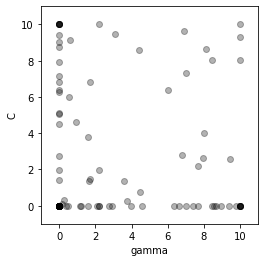

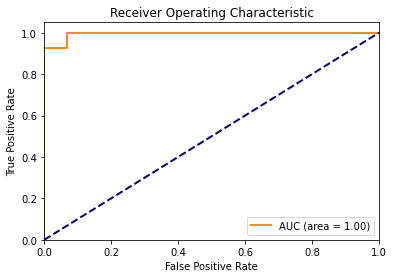

Accuracy for particle (in iteration 45, in fold 6) - 1 is 0.4828 At (gamma, c): [3.99253717e+00 1.00000000e-03]
Accuracy for particle (in iteration 45, in fold 6) - 2 is 0.4828 At (gamma, c): [8.41940088e+00 1.00000000e-03]
Accuracy for particle (in iteration 45, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 45, in fold 6) - 4 is 0.9310 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 45, in fold 6) - 5 is 0.4828 At (gamma, c): [0.51661781 0.001     ]
Accuracy for particle (in iteration 45, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 45, in fold 6) - 7 is 0.4828 At (gamma, c): [1.23179972e+00 1.00000000e-03]
Accuracy for particle (in iteration 45, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 45, in fold 6) - 9 is 0.9310 At (gamma, c): [1.00000000e-03 4.50196599e+00]
Accuracy for particle (in iteration 45, in fold 6) - 10 is 0.9310 At (

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 45, in fold 6) - 98 is 0.8966 At (gamma, c): [1.65825197 1.37523571]
Accuracy for particle (in iteration 45, in fold 6) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 45, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 45, fold 6 is [0.34580756 7.7179664 ], with Accuracy: 1.0000
Accuracy Score: 0.9310
F1 Score: 0.9286
Recall Score: 0.9286
Precision Score: 0.9286
Confusion Matrix (Test):
[[14  1]
 [ 1 13]]
Confusion Matrix (Train):
[[128   0]
 [  0 129]]

Iteration 46 - Fold 6:



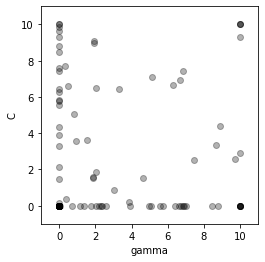

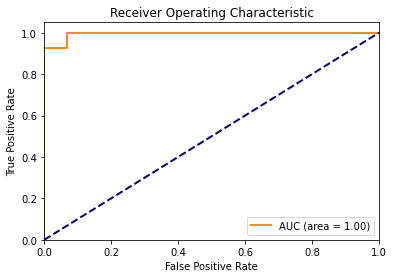

Accuracy for particle (in iteration 46, in fold 6) - 1 is 0.4828 At (gamma, c): [3.90379656e+00 1.00000000e-03]
Accuracy for particle (in iteration 46, in fold 6) - 2 is 0.4828 At (gamma, c): [5.08460526e+00 1.00000000e-03]
Accuracy for particle (in iteration 46, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 46, in fold 6) - 4 is 0.9310 At (gamma, c): [1.00000000e-03 9.33079287e+00]
Accuracy for particle (in iteration 46, in fold 6) - 5 is 0.4828 At (gamma, c): [0.69968179 0.001     ]
Accuracy for particle (in iteration 46, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 46, in fold 6) - 7 is 0.4828 At (gamma, c): [1.39777285e+00 1.00000000e-03]
Accuracy for particle (in iteration 46, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 46, in fold 6) - 9 is 0.9310 At (gamma, c): [1.00000000e-03 3.89057078e+00]
Accuracy for particle (in iteration 46, in fold 6) - 1

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 46, in fold 6) - 93 is 0.9310 At (gamma, c): [1.85243448 1.55521504]
Accuracy for particle (in iteration 46, in fold 6) - 94 is 0.4828 At (gamma, c): [6.60651611e+00 1.00000000e-03]
Accuracy for particle (in iteration 46, in fold 6) - 95 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 46, in fold 6) - 96 is 0.9310 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 46, in fold 6) - 97 is 0.9310 At (gamma, c): [1.00000000e-03 9.86499801e+00]
Accuracy for particle (in iteration 46, in fold 6) - 98 is 0.9310 At (gamma, c): [1.8904799  1.50761728]
Accuracy for particle (in iteration 46, in fold 6) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 46, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 46, fold 6 is [ 0.12916401 10.        ], with Accuracy: 1.0000
Accuracy Score: 0.9310
F1 Score: 0.9286
Recall Score: 0.9286
Precision Score: 0.9286
Confusio

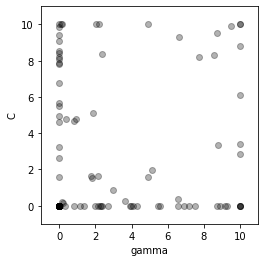

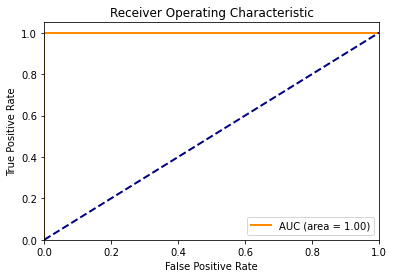

Accuracy for particle (in iteration 47, in fold 6) - 1 is 0.4828 At (gamma, c): [4.06935917e+00 1.00000000e-03]
Accuracy for particle (in iteration 47, in fold 6) - 2 is 0.4828 At (gamma, c): [4.31996153e+00 1.00000000e-03]
Accuracy for particle (in iteration 47, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 47, in fold 6) - 4 is 0.9310 At (gamma, c): [1.0000000e-03 8.4206496e+00]
Accuracy for particle (in iteration 47, in fold 6) - 5 is 0.4828 At (gamma, c): [0.81937405 0.001     ]
Accuracy for particle (in iteration 47, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 47, in fold 6) - 7 is 0.4828 At (gamma, c): [1.39423928e+00 1.00000000e-03]
Accuracy for particle (in iteration 47, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 47, in fold 6) - 9 is 0.9310 At (gamma, c): [1.00000000e-03 5.51619537e+00]
Accuracy for particle (in iteration 47, in fold 6) - 10 

Accuracy for particle (in iteration 47, in fold 6) - 79 is 0.9310 At (gamma, c): [7.7034232 8.2306987]
Accuracy for particle (in iteration 47, in fold 6) - 80 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 47, in fold 6) - 81 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 47, in fold 6) - 82 is 0.9310 At (gamma, c): [1.00000000e-03 8.08603143e+00]
Accuracy for particle (in iteration 47, in fold 6) - 83 is 0.9310 At (gamma, c): [1.00000000e-03 7.88882588e+00]
Accuracy for particle (in iteration 47, in fold 6) - 84 is 0.7241 At (gamma, c): [6.57478202 0.37433188]
Accuracy for particle (in iteration 47, in fold 6) - 85 is 0.9310 At (gamma, c): [0.82430954 4.69674536]
Accuracy for particle (in iteration 47, in fold 6) - 86 is 0.8966 At (gamma, c): [1.00000000e-03 1.57377374e+00]
Accuracy for particle (in iteration 47, in fold 6) - 87 is 0.4828 At (gamma, c): [8.86857784e+00 1.00000000e-03]
Accuracy for particle (in iteration 47, in fo

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 47, in fold 6) - 97 is 0.9310 At (gamma, c): [1.00000000e-03 6.76501562e+00]
Accuracy for particle (in iteration 47, in fold 6) - 98 is 0.9310 At (gamma, c): [2.14672296 1.65368857]
Accuracy for particle (in iteration 47, in fold 6) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 47, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 47, fold 6 is [0.33732407 8.05045004], with Accuracy: 1.0000
Accuracy Score: 0.9655
F1 Score: 0.9655
Recall Score: 1.0000
Precision Score: 0.9333
Confusion Matrix (Test):
[[14  1]
 [ 0 14]]
Confusion Matrix (Train):
[[127   1]
 [  1 128]]

Iteration 48 - Fold 6:



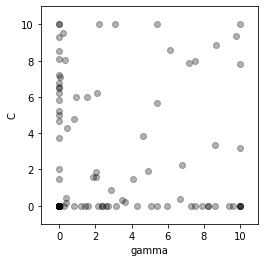

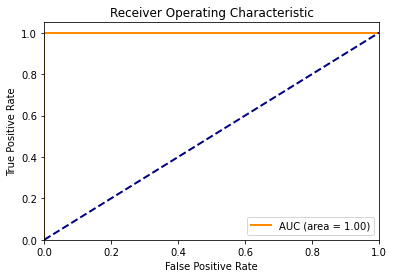

Accuracy for particle (in iteration 48, in fold 6) - 1 is 0.4828 At (gamma, c): [4.32665489e+00 1.00000000e-03]
Accuracy for particle (in iteration 48, in fold 6) - 2 is 0.4828 At (gamma, c): [5.39311151e+00 1.00000000e-03]
Accuracy for particle (in iteration 48, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 48, in fold 6) - 4 is 0.9310 At (gamma, c): [1.00000000e-03 7.19380206e+00]
Accuracy for particle (in iteration 48, in fold 6) - 5 is 0.4828 At (gamma, c): [0.80599073 0.001     ]
Accuracy for particle (in iteration 48, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 48, in fold 6) - 7 is 0.4828 At (gamma, c): [1.41556313e+00 1.00000000e-03]
Accuracy for particle (in iteration 48, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 48, in fold 6) - 9 is 0.9310 At (gamma, c): [1.00000000e-03 6.78386871e+00]
Accuracy for particle (in iteration 48, in fold 6) - 1

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 48, in fold 6) - 95 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 48, in fold 6) - 96 is 0.9310 At (gamma, c): [8.63999447 8.87621835]
Accuracy for particle (in iteration 48, in fold 6) - 97 is 0.9310 At (gamma, c): [1.00000000e-03 5.21032057e+00]
Accuracy for particle (in iteration 48, in fold 6) - 98 is 0.9310 At (gamma, c): [2.01171329 1.57672651]
Accuracy for particle (in iteration 48, in fold 6) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 48, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 48, fold 6 is [ 0.10522713 10.        ], with Accuracy: 1.0000
Accuracy Score: 1.0000
F1 Score: 1.0000
Recall Score: 1.0000
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 0 14]]
Confusion Matrix (Train):
[[128   0]
 [  1 128]]

Iteration 49 - Fold 6:



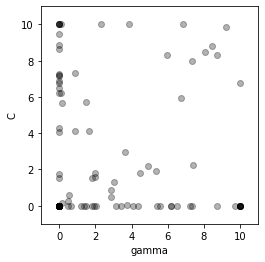

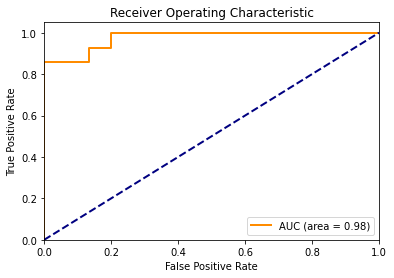

Accuracy for particle (in iteration 49, in fold 6) - 1 is 0.4828 At (gamma, c): [5.37990064e+00 1.00000000e-03]
Accuracy for particle (in iteration 49, in fold 6) - 2 is 0.4828 At (gamma, c): [6.19658628e+00 1.00000000e-03]
Accuracy for particle (in iteration 49, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 49, in fold 6) - 4 is 0.9310 At (gamma, c): [1.00000000e-03 6.76799103e+00]
Accuracy for particle (in iteration 49, in fold 6) - 5 is 0.4828 At (gamma, c): [0.66929654 0.001     ]
Accuracy for particle (in iteration 49, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 49, in fold 6) - 7 is 0.4828 At (gamma, c): [1.36505309e+00 1.00000000e-03]
Accuracy for particle (in iteration 49, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 49, in fold 6) - 9 is 0.9310 At (gamma, c): [1.00000000e-03 7.21290094e+00]
Accuracy for particle (in iteration 49, in fold 6) - 1

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 49, in fold 6) - 93 is 0.9310 At (gamma, c): [1.82372    1.53651907]
Accuracy for particle (in iteration 49, in fold 6) - 94 is 0.4828 At (gamma, c): [7.21455276e+00 1.00000000e-03]
Accuracy for particle (in iteration 49, in fold 6) - 95 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 49, in fold 6) - 96 is 0.9310 At (gamma, c): [8.44452838 8.79067291]
Accuracy for particle (in iteration 49, in fold 6) - 97 is 0.9310 At (gamma, c): [1.00000000e-03 7.24746503e+00]
Accuracy for particle (in iteration 49, in fold 6) - 98 is 0.9310 At (gamma, c): [2.00296401 1.57173905]
Accuracy for particle (in iteration 49, in fold 6) - 99 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 49, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 49, fold 6 is [ 0.04517787 10.        ], with Accuracy: 1.0000
Accuracy Score: 0.9310
F1 Score: 0.9231
Recall Score: 0.8571
Precision Score: 1

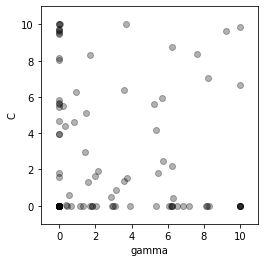

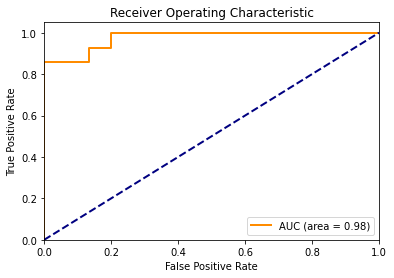

Accuracy for particle (in iteration 50, in fold 6) - 1 is 0.4828 At (gamma, c): [6.50878e+00 1.00000e-03]
Accuracy for particle (in iteration 50, in fold 6) - 2 is 0.4828 At (gamma, c): [8.17631639e+00 1.00000000e-03]
Accuracy for particle (in iteration 50, in fold 6) - 3 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 50, in fold 6) - 4 is 0.9310 At (gamma, c): [1.0000000e-03 8.0135382e+00]
Accuracy for particle (in iteration 50, in fold 6) - 5 is 0.4828 At (gamma, c): [0.64702801 0.001     ]
Accuracy for particle (in iteration 50, in fold 6) - 6 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 50, in fold 6) - 7 is 0.4828 At (gamma, c): [1.32559162e+00 1.00000000e-03]
Accuracy for particle (in iteration 50, in fold 6) - 8 is 0.4828 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 50, in fold 6) - 9 is 0.9310 At (gamma, c): [1.00000000e-03 4.65204371e+00]
Accuracy for particle (in iteration 50, in fold 6) - 10 is 0.9

Accuracy for particle (in iteration 50, in fold 6) - 82 is 0.9310 At (gamma, c): [1.00000000e-03 9.54238562e+00]
Accuracy for particle (in iteration 50, in fold 6) - 83 is 0.9310 At (gamma, c): [1.00000000e-03 9.73479126e+00]
Accuracy for particle (in iteration 50, in fold 6) - 84 is 0.7241 At (gamma, c): [6.30330289 0.40498984]
Accuracy for particle (in iteration 50, in fold 6) - 85 is 0.9310 At (gamma, c): [0.82762552 4.62700473]
Accuracy for particle (in iteration 50, in fold 6) - 86 is 0.8966 At (gamma, c): [1.00000000e-03 1.60512843e+00]
Accuracy for particle (in iteration 50, in fold 6) - 87 is 0.4828 At (gamma, c): [5.36256948e+00 1.00000000e-03]
Accuracy for particle (in iteration 50, in fold 6) - 88 is 0.4828 At (gamma, c): [8.10048156e+00 1.00000000e-03]
Accuracy for particle (in iteration 50, in fold 6) - 89 is 0.4828 At (gamma, c): [7.15923665e+00 1.00000000e-03]
Accuracy for particle (in iteration 50, in fold 6) - 90 is 0.4828 At (gamma, c): [0.45987717 0.001     ]
Accurac

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 50, in fold 6) - 100 is 0.4828 At (gamma, c): [0.001 0.001]
The best position in iteration 50, fold 6 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.9310
F1 Score: 0.9231
Recall Score: 0.8571
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 2 12]]
Confusion Matrix (Train):
[[121   7]
 [ 23 106]]


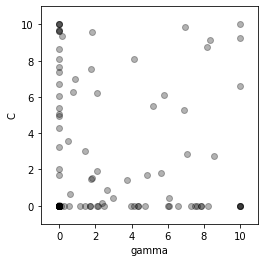

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.



Iteration 1 - Fold 7:



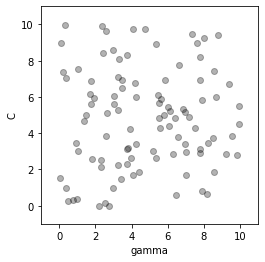

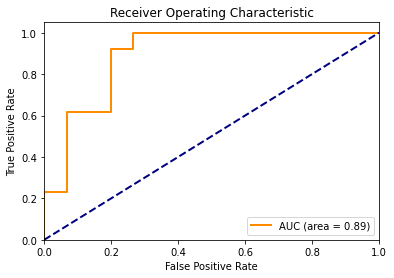

Accuracy for particle (in iteration 1, in fold 7) - 1 is 0.8571 At (gamma, c): [4.08639192 9.74167654]
Accuracy for particle (in iteration 1, in fold 7) - 2 is 0.8571 At (gamma, c): [9.18821346 2.83444064]
Accuracy for particle (in iteration 1, in fold 7) - 3 is 0.8571 At (gamma, c): [5.44692302 6.10692179]
Accuracy for particle (in iteration 1, in fold 7) - 4 is 0.8571 At (gamma, c): [1.47826423 4.98779558]
Accuracy for particle (in iteration 1, in fold 7) - 5 is 0.8929 At (gamma, c): [0.21637609 7.3621494 ]
Accuracy for particle (in iteration 1, in fold 7) - 6 is 0.8571 At (gamma, c): [9.92802056 5.51153502]
Accuracy for particle (in iteration 1, in fold 7) - 7 is 0.8571 At (gamma, c): [6.0631674  4.38690835]
Accuracy for particle (in iteration 1, in fold 7) - 8 is 0.8571 At (gamma, c): [1.9367996  5.94902321]
Accuracy for particle (in iteration 1, in fold 7) - 9 is 0.8571 At (gamma, c): [3.03396542 5.59801931]
Accuracy for particle (in iteration 1, in fold 7) - 10 is 0.8571 At (gamm

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 1, in fold 7) - 97 is 0.8214 At (gamma, c): [1.00052411 0.39270498]
Accuracy for particle (in iteration 1, in fold 7) - 98 is 0.8571 At (gamma, c): [5.51405397 4.86599402]
Accuracy for particle (in iteration 1, in fold 7) - 99 is 0.9286 At (gamma, c): [0.30780412 9.94735164]
Accuracy for particle (in iteration 1, in fold 7) - 100 is 0.8571 At (gamma, c): [6.42329496 4.83990231]
The best position in iteration 1, fold 7 is [1.00000000e-03 3.14546233e+00], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8667
Recall Score: 1.0000
Precision Score: 0.7647
Confusion Matrix (Test):
[[11  4]
 [ 0 13]]
Confusion Matrix (Train):
[[128   0]
 [  0 130]]

Iteration 2 - Fold 7:



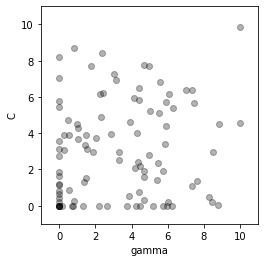

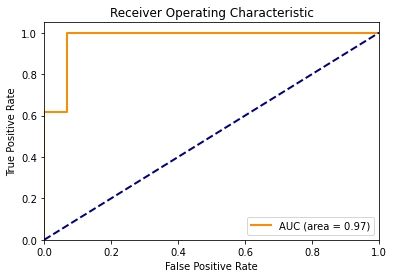

Accuracy for particle (in iteration 2, in fold 7) - 1 is 0.8571 At (gamma, c): [5.8974033  5.72584113]
Accuracy for particle (in iteration 2, in fold 7) - 2 is 0.8929 At (gamma, c): [1.00000000e-03 3.59457297e+00]
Accuracy for particle (in iteration 2, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 2, in fold 7) - 4 is 0.8929 At (gamma, c): [1.00000000e-03 8.19107365e+00]
Accuracy for particle (in iteration 2, in fold 7) - 5 is 0.8571 At (gamma, c): [1.00000000e-03 5.76518472e+00]
Accuracy for particle (in iteration 2, in fold 7) - 6 is 0.4643 At (gamma, c): [1.31130025e+00 1.00000000e-03]
Accuracy for particle (in iteration 2, in fold 7) - 7 is 0.8571 At (gamma, c): [2.24954752 6.14909602]
Accuracy for particle (in iteration 2, in fold 7) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 5.44824922e+00]
Accuracy for particle (in iteration 2, in fold 7) - 9 is 0.4643 At (gamma, c): [3.73055551e+00 1.00000000e-03]
Accuracy for particle (in iteration

Accuracy for particle (in iteration 2, in fold 7) - 91 is 0.4643 At (gamma, c): [0.001      0.43450651]
Accuracy for particle (in iteration 2, in fold 7) - 92 is 0.8571 At (gamma, c): [5.9192953  4.37704662]
Accuracy for particle (in iteration 2, in fold 7) - 93 is 0.8571 At (gamma, c): [5.84823478 3.40345625]
Accuracy for particle (in iteration 2, in fold 7) - 94 is 0.4643 At (gamma, c): [5.18860758e+00 1.00000000e-03]
Accuracy for particle (in iteration 2, in fold 7) - 95 is 0.8571 At (gamma, c): [2.83972961 3.98313872]
Accuracy for particle (in iteration 2, in fold 7) - 96 is 0.8929 At (gamma, c): [0.00569234 0.18959103]
Accuracy for particle (in iteration 2, in fold 7) - 97 is 0.4643 At (gamma, c): [2.67056889e+00 1.00000000e-03]
Accuracy for particle (in iteration 2, in fold 7) - 98 is 0.8571 At (gamma, c): [8.5122483  2.94456868]
Accuracy for particle (in iteration 2, in fold 7) - 99 is 0.8571 At (gamma, c): [1.75103045 7.73081373]
Accuracy for particle (in iteration 2, in fold 7

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


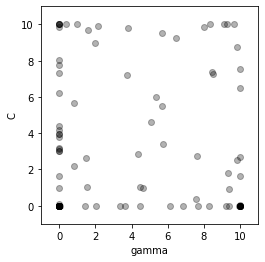

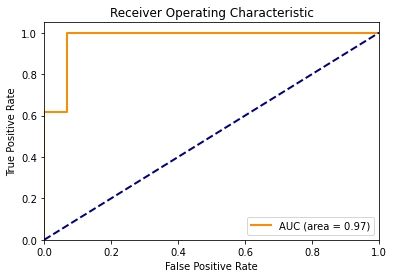

Accuracy for particle (in iteration 3, in fold 7) - 1 is 0.8571 At (gamma, c): [9.83595763 2.51171197]
Accuracy for particle (in iteration 3, in fold 7) - 2 is 0.8929 At (gamma, c): [1.00000000e-03 7.78422091e+00]
Accuracy for particle (in iteration 3, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 3, in fold 7) - 4 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 3, in fold 7) - 5 is 0.8571 At (gamma, c): [1.00000000e-03 6.23671997e+00]
Accuracy for particle (in iteration 3, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 3, in fold 7) - 7 is 0.8571 At (gamma, c): [ 1.01476628 10.        ]
Accuracy for particle (in iteration 3, in fold 7) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 4.39585238e+00]
Accuracy for particle (in iteration 3, in fold 7) - 9 is 0.4643 At (gamma, c): [9.37014668e+00 1.00000000e-03]
Accuracy for particle (in iteration 3, in fold 7) - 10 is 0.8571 At

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 3, in fold 7) - 96 is 0.4643 At (gamma, c): [0.0711076 0.001    ]
Accuracy for particle (in iteration 3, in fold 7) - 97 is 0.4643 At (gamma, c): [6.09696355e+00 1.00000000e-03]
Accuracy for particle (in iteration 3, in fold 7) - 98 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 3, in fold 7) - 99 is 0.8571 At (gamma, c): [4.33855301 2.86707575]
Accuracy for particle (in iteration 3, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 3, fold 7 is [1.00000000e-03 5.46957987e+00], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8333
Recall Score: 0.7692
Precision Score: 0.9091
Confusion Matrix (Test):
[[14  1]
 [ 3 10]]
Confusion Matrix (Train):
[[123   5]
 [ 36  94]]

Iteration 4 - Fold 7:



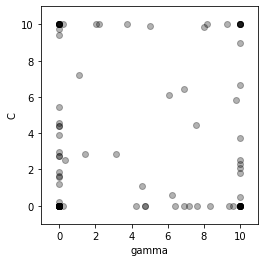

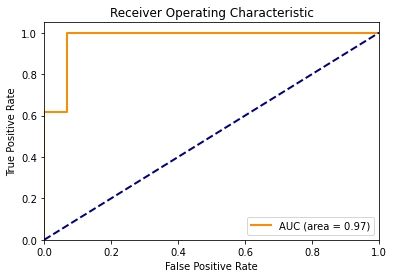

Accuracy for particle (in iteration 4, in fold 7) - 1 is 0.8571 At (gamma, c): [10.          2.52409287]
Accuracy for particle (in iteration 4, in fold 7) - 2 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 4, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 4, in fold 7) - 4 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 4, in fold 7) - 5 is 0.9286 At (gamma, c): [1.00000000e-03 9.44688245e+00]
Accuracy for particle (in iteration 4, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 4, in fold 7) - 7 is 0.8929 At (gamma, c): [ 0.19941009 10.        ]
Accuracy for particle (in iteration 4, in fold 7) - 8 is 0.8571 At (gamma, c): [1.0000000e-03 1.5988331e+00]
Accuracy for particle (in iteration 4, in fold 7) - 9 is 0.4643 At (gamma, c): [9.39955565e+00 1.00000000e-03]
Accuracy for particle (in iteration 4, in fold 7) - 10 is 0.8571 At (gamma, c): [6.

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 4, in fold 7) - 96 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 4, in fold 7) - 97 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 4, in fold 7) - 98 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 4, in fold 7) - 99 is 0.8571 At (gamma, c): [4.60214106 1.07186942]
Accuracy for particle (in iteration 4, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 4, fold 7 is [1.00000000e-03 4.82112679e+00], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8333
Recall Score: 0.7692
Precision Score: 0.9091
Confusion Matrix (Test):
[[14  1]
 [ 3 10]]
Confusion Matrix (Train):
[[122   6]
 [ 31  99]]

Iteration 5 - Fold 7:



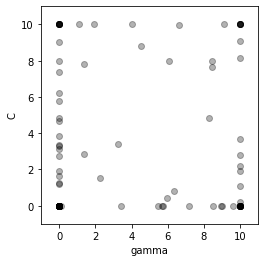

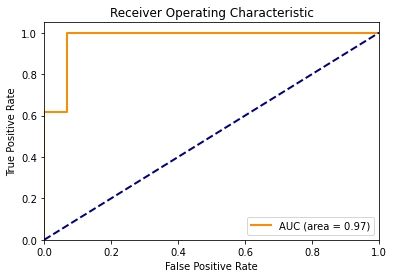

Accuracy for particle (in iteration 5, in fold 7) - 1 is 0.8571 At (gamma, c): [10.          2.18682374]
Accuracy for particle (in iteration 5, in fold 7) - 2 is 0.8929 At (gamma, c): [1.00000000e-03 7.37647623e+00]
Accuracy for particle (in iteration 5, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 5, in fold 7) - 4 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 5, in fold 7) - 5 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 5, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 5, in fold 7) - 7 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 5, in fold 7) - 8 is 0.9286 At (gamma, c): [1.00000000e-03 1.25370979e+00]
Accuracy for particle (in iteration 5, in fold 7) - 9 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 5, in fold 7) - 10 is 0.8571 At (gamma, c): [8.43864547 7.98658586]
Acc

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 5, in fold 7) - 95 is 0.8571 At (gamma, c): [10.          1.10287869]
Accuracy for particle (in iteration 5, in fold 7) - 96 is 0.4643 At (gamma, c): [0.09798357 0.001     ]
Accuracy for particle (in iteration 5, in fold 7) - 97 is 0.4643 At (gamma, c): [8.46781579e+00 1.00000000e-03]
Accuracy for particle (in iteration 5, in fold 7) - 98 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 5, in fold 7) - 99 is 0.8571 At (gamma, c): [6.36142814 0.82203928]
Accuracy for particle (in iteration 5, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 5, fold 7 is [1.00000000e-03 6.07273046e+00], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8333
Recall Score: 0.7692
Precision Score: 0.9091
Confusion Matrix (Test):
[[14  1]
 [ 3 10]]
Confusion Matrix (Train):
[[122   6]
 [ 34  96]]

Iteration 6 - Fold 7:



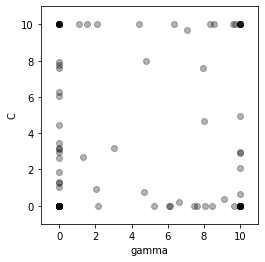

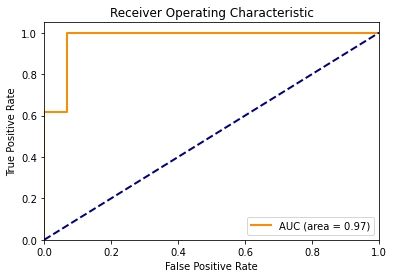

Accuracy for particle (in iteration 6, in fold 7) - 1 is 0.8571 At (gamma, c): [10.          2.88265081]
Accuracy for particle (in iteration 6, in fold 7) - 2 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 6, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 6, in fold 7) - 4 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 6, in fold 7) - 5 is 0.8929 At (gamma, c): [1.00000000e-03 7.61711477e+00]
Accuracy for particle (in iteration 6, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 6, in fold 7) - 7 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 6, in fold 7) - 8 is 0.8929 At (gamma, c): [1.00000000e-03 1.05104471e+00]
Accuracy for particle (in iteration 6, in fold 7) - 9 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 6, in fold 7) - 10 is 0.8571 At (gamma, c): [7.94830366 7.5810835 ]
Acc

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 6, in fold 7) - 97 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 6, in fold 7) - 98 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 6, in fold 7) - 99 is 0.8571 At (gamma, c): [4.67868993 0.75551717]
Accuracy for particle (in iteration 6, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 6, fold 7 is [1.00000000e-03 5.85934853e+00], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8333
Recall Score: 0.7692
Precision Score: 0.9091
Confusion Matrix (Test):
[[14  1]
 [ 3 10]]
Confusion Matrix (Train):
[[122   6]
 [ 30 100]]

Iteration 7 - Fold 7:



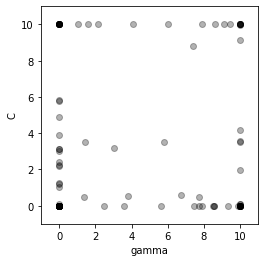

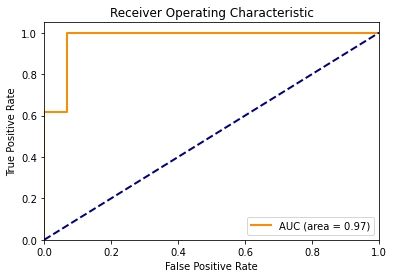

Accuracy for particle (in iteration 7, in fold 7) - 1 is 0.8571 At (gamma, c): [10.          3.54963276]
Accuracy for particle (in iteration 7, in fold 7) - 2 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 7, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 7, in fold 7) - 4 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 7, in fold 7) - 5 is 0.8571 At (gamma, c): [1.00000000e-03 5.79030617e+00]
Accuracy for particle (in iteration 7, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 7, in fold 7) - 7 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 7, in fold 7) - 8 is 0.8929 At (gamma, c): [1.00000000e-03 1.04390222e+00]
Accuracy for particle (in iteration 7, in fold 7) - 9 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 7, in fold 7) - 10 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for part

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 7, in fold 7) - 96 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 7, in fold 7) - 97 is 0.4643 At (gamma, c): [8.53384248e+00 1.00000000e-03]
Accuracy for particle (in iteration 7, in fold 7) - 98 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 7, in fold 7) - 99 is 0.8571 At (gamma, c): [6.73581811 0.59626883]
Accuracy for particle (in iteration 7, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 7, fold 7 is [1.00000000e-03 6.68344021e+00], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8333
Recall Score: 0.7692
Precision Score: 0.9091
Confusion Matrix (Test):
[[14  1]
 [ 3 10]]
Confusion Matrix (Train):
[[122   6]
 [ 30 100]]

Iteration 8 - Fold 7:



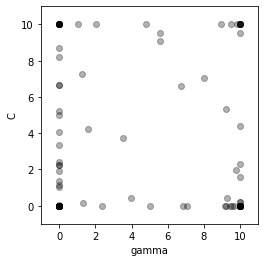

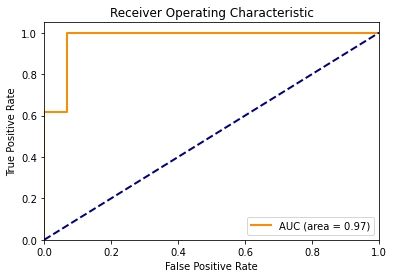

Accuracy for particle (in iteration 8, in fold 7) - 1 is 0.8571 At (gamma, c): [10.          2.32087829]
Accuracy for particle (in iteration 8, in fold 7) - 2 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 8, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 8, in fold 7) - 4 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 8, in fold 7) - 5 is 0.8571 At (gamma, c): [1.00000000e-03 6.67939806e+00]
Accuracy for particle (in iteration 8, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 8, in fold 7) - 7 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 8, in fold 7) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 1.02652317e+00]
Accuracy for particle (in iteration 8, in fold 7) - 9 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 8, in fold 7) - 10 is 0.8571 At (gamma, c): [6.75329327 6.62606097]
Acc

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 8, in fold 7) - 96 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 8, in fold 7) - 97 is 0.4643 At (gamma, c): [9.40580012e+00 1.00000000e-03]
Accuracy for particle (in iteration 8, in fold 7) - 98 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 8, in fold 7) - 99 is 0.7857 At (gamma, c): [9.24922981 0.40857084]
Accuracy for particle (in iteration 8, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 8, fold 7 is [1.00000000e-03 5.94602404e+00], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8333
Recall Score: 0.7692
Precision Score: 0.9091
Confusion Matrix (Test):
[[14  1]
 [ 3 10]]
Confusion Matrix (Train):
[[123   5]
 [ 30 100]]

Iteration 9 - Fold 7:



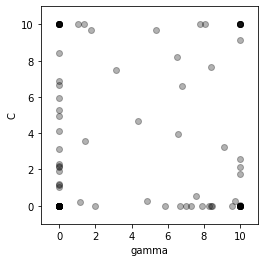

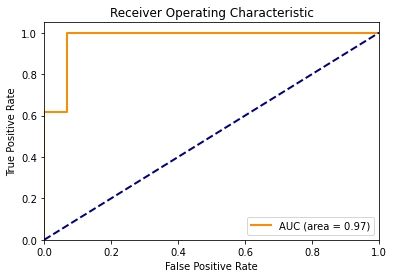

Accuracy for particle (in iteration 9, in fold 7) - 1 is 0.8571 At (gamma, c): [10.          2.16047444]
Accuracy for particle (in iteration 9, in fold 7) - 2 is 0.8929 At (gamma, c): [1.00000000e-03 8.43013124e+00]
Accuracy for particle (in iteration 9, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 9, in fold 7) - 4 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 9, in fold 7) - 5 is 0.8571 At (gamma, c): [1.00000000e-03 6.68306643e+00]
Accuracy for particle (in iteration 9, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 9, in fold 7) - 7 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 9, in fold 7) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 1.02654409e+00]
Accuracy for particle (in iteration 9, in fold 7) - 9 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 9, in fold 7) - 10 is 0.8571 At (gamma, c): [6.78209828

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 9, in fold 7) - 94 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 9, in fold 7) - 95 is 0.4643 At (gamma, c): [10.          0.03588222]
Accuracy for particle (in iteration 9, in fold 7) - 96 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 9, in fold 7) - 97 is 0.4643 At (gamma, c): [8.43807834e+00 1.00000000e-03]
Accuracy for particle (in iteration 9, in fold 7) - 98 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 9, in fold 7) - 99 is 0.8571 At (gamma, c): [7.55818714 0.52292981]
Accuracy for particle (in iteration 9, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 9, fold 7 is [1.00000000e-03 6.68695168e+00], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8333
Recall Score: 0.7692
Precision Score: 0.9091
Confusion Matrix (Test):
[[14  1]
 [ 3 10]]
Confusion Matrix (Train):
[[122   6]
 [ 30 100]]

Iteration 10 - Fold

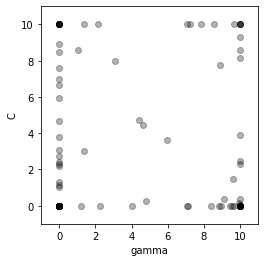

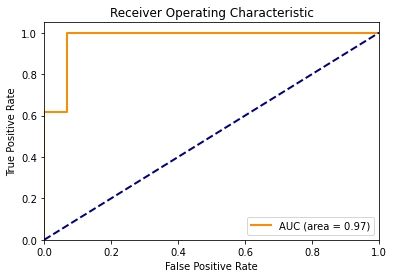

Accuracy for particle (in iteration 10, in fold 7) - 1 is 0.8571 At (gamma, c): [10.          2.44397361]
Accuracy for particle (in iteration 10, in fold 7) - 2 is 0.8929 At (gamma, c): [1.00000000e-03 8.91133858e+00]
Accuracy for particle (in iteration 10, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 10, in fold 7) - 4 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 10, in fold 7) - 5 is 0.8929 At (gamma, c): [1.00000000e-03 7.59943329e+00]
Accuracy for particle (in iteration 10, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 10, in fold 7) - 7 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 10, in fold 7) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 1.03383554e+00]
Accuracy for particle (in iteration 10, in fold 7) - 9 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 10, in fold 7) - 10 is 0.8571 At (gamma, c): [

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 10, in fold 7) - 98 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 10, in fold 7) - 99 is 0.7500 At (gamma, c): [9.96054282 0.34436436]
Accuracy for particle (in iteration 10, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 10, fold 7 is [1.00000000e-03 5.12358655e+00], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8333
Recall Score: 0.7692
Precision Score: 0.9091
Confusion Matrix (Test):
[[14  1]
 [ 3 10]]
Confusion Matrix (Train):
[[123   5]
 [ 30 100]]

Iteration 11 - Fold 7:



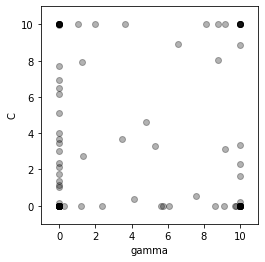

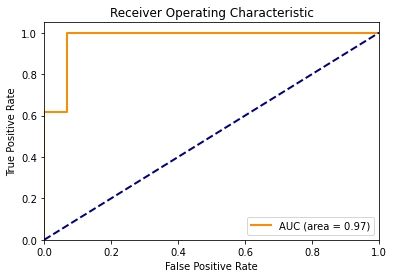

Accuracy for particle (in iteration 11, in fold 7) - 1 is 0.8571 At (gamma, c): [10.          3.32573065]
Accuracy for particle (in iteration 11, in fold 7) - 2 is 0.8929 At (gamma, c): [1.00000000e-03 6.92316696e+00]
Accuracy for particle (in iteration 11, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 11, in fold 7) - 4 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 11, in fold 7) - 5 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 11, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 11, in fold 7) - 7 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 11, in fold 7) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 1.02046932e+00]
Accuracy for particle (in iteration 11, in fold 7) - 9 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 11, in fold 7) - 10 is 0.8571 At (gamma, c): [4.79452502 4.634

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


The best position in iteration 11, fold 7 is [1.0000000e-03 4.8804553e+00], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8333
Recall Score: 0.7692
Precision Score: 0.9091
Confusion Matrix (Test):
[[14  1]
 [ 3 10]]
Confusion Matrix (Train):
[[122   6]
 [ 31  99]]

Iteration 12 - Fold 7:



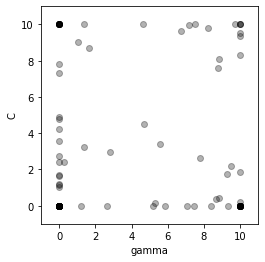

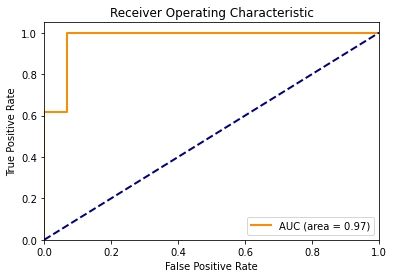

Accuracy for particle (in iteration 12, in fold 7) - 1 is 0.8571 At (gamma, c): [9.51260478 2.17363585]
Accuracy for particle (in iteration 12, in fold 7) - 2 is 0.8929 At (gamma, c): [1.00000000e-03 7.32692473e+00]
Accuracy for particle (in iteration 12, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 12, in fold 7) - 4 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 12, in fold 7) - 5 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 12, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 12, in fold 7) - 7 is 0.9286 At (gamma, c): [1.03187296e-03 1.00000000e+01]
Accuracy for particle (in iteration 12, in fold 7) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 1.02278728e+00]
Accuracy for particle (in iteration 12, in fold 7) - 9 is 0.4643 At (gamma, c): [8.40920817e+00 1.00000000e-03]
Accuracy for particle (in iteration 12, in fold 7) - 10 is 0.8571 At

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 12, in fold 7) - 96 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 12, in fold 7) - 97 is 0.4643 At (gamma, c): [7.45421985e+00 1.00000000e-03]
Accuracy for particle (in iteration 12, in fold 7) - 98 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 12, in fold 7) - 99 is 0.7857 At (gamma, c): [8.79931775 0.42482766]
Accuracy for particle (in iteration 12, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 12, fold 7 is [1.00000000e-03 4.74643282e+00], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8333
Recall Score: 0.7692
Precision Score: 0.9091
Confusion Matrix (Test):
[[14  1]
 [ 3 10]]
Confusion Matrix (Train):
[[122   6]
 [ 33  97]]

Iteration 13 - Fold 7:



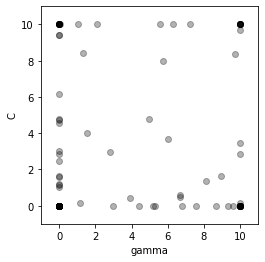

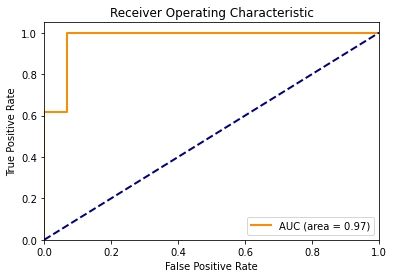

Accuracy for particle (in iteration 13, in fold 7) - 1 is 0.8571 At (gamma, c): [10.          2.86880039]
Accuracy for particle (in iteration 13, in fold 7) - 2 is 0.9286 At (gamma, c): [1.00000000e-03 9.43864927e+00]
Accuracy for particle (in iteration 13, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 13, in fold 7) - 4 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 13, in fold 7) - 5 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 13, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 13, in fold 7) - 7 is 1.0000 At (gamma, c): [ 0.05970646 10.        ]
Accuracy for particle (in iteration 13, in fold 7) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 1.02565622e+00]
Accuracy for particle (in iteration 13, in fold 7) - 9 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 13, in fold 7) - 10 is 0.8571 At (gamma, c): [4.9492

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 13, in fold 7) - 96 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 13, in fold 7) - 97 is 0.4643 At (gamma, c): [7.52967786e+00 1.00000000e-03]
Accuracy for particle (in iteration 13, in fold 7) - 98 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 13, in fold 7) - 99 is 0.8571 At (gamma, c): [6.68941022 0.57950586]
Accuracy for particle (in iteration 13, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 13, fold 7 is [1.00000000e-03 3.46014352e+00], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8333
Recall Score: 0.7692
Precision Score: 0.9091
Confusion Matrix (Test):
[[14  1]
 [ 3 10]]
Confusion Matrix (Train):
[[122   6]
 [ 34  96]]

Iteration 14 - Fold 7:



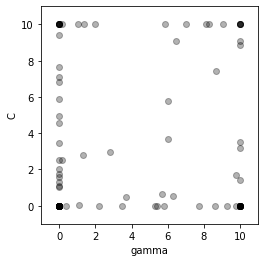

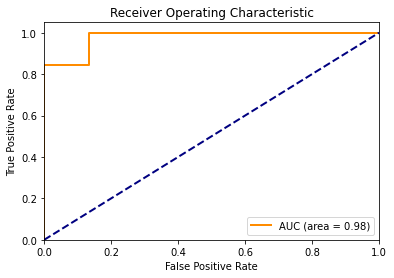

Accuracy for particle (in iteration 14, in fold 7) - 1 is 0.8571 At (gamma, c): [10.          3.16197228]
Accuracy for particle (in iteration 14, in fold 7) - 2 is 0.8929 At (gamma, c): [1.00000000e-03 7.10168521e+00]
Accuracy for particle (in iteration 14, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 14, in fold 7) - 4 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 14, in fold 7) - 5 is 0.9286 At (gamma, c): [1.00000000e-03 9.42957089e+00]
Accuracy for particle (in iteration 14, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 14, in fold 7) - 7 is 0.9286 At (gamma, c): [ 0.15304205 10.        ]
Accuracy for particle (in iteration 14, in fold 7) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 1.03479078e+00]
Accuracy for particle (in iteration 14, in fold 7) - 9 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 14, in fold 7) - 10 is 0.8571 At (ga

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 14, in fold 7) - 97 is 0.4643 At (gamma, c): [9.25400429e+00 1.00000000e-03]
Accuracy for particle (in iteration 14, in fold 7) - 98 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 14, in fold 7) - 99 is 0.8571 At (gamma, c): [5.69753713 0.65234169]
Accuracy for particle (in iteration 14, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 14, fold 7 is [1.00000000e-03 3.18399452e+00], with Accuracy: 1.0000
Accuracy Score: 0.9286
F1 Score: 0.9286
Recall Score: 1.0000
Precision Score: 0.8667
Confusion Matrix (Test):
[[13  2]
 [ 0 13]]
Confusion Matrix (Train):
[[128   0]
 [  1 129]]

Iteration 15 - Fold 7:



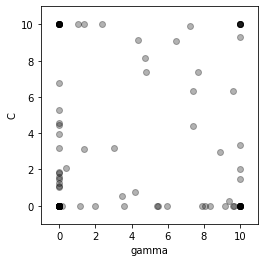

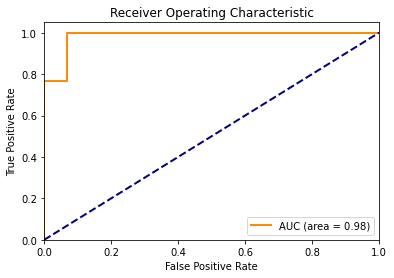

Accuracy for particle (in iteration 15, in fold 7) - 1 is 0.8571 At (gamma, c): [10.          3.34889871]
Accuracy for particle (in iteration 15, in fold 7) - 2 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 15, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 15, in fold 7) - 4 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 15, in fold 7) - 5 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 15, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 15, in fold 7) - 7 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 15, in fold 7) - 8 is 0.8929 At (gamma, c): [1.00000000e-03 1.04237517e+00]
Accuracy for particle (in iteration 15, in fold 7) - 9 is 0.4643 At (gamma, c): [8.04525553e+00 1.00000000e-03]
Accuracy for particle (in iteration 15, in fold 7) - 10 is 0.8571 At (gamma, c): [7.64392692 7.360

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 15, in fold 7) - 94 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 15, in fold 7) - 95 is 0.6071 At (gamma, c): [9.36967294 0.26360992]
Accuracy for particle (in iteration 15, in fold 7) - 96 is 0.4643 At (gamma, c): [0.13860107 0.001     ]
Accuracy for particle (in iteration 15, in fold 7) - 97 is 0.4643 At (gamma, c): [8.30302601e+00 1.00000000e-03]
Accuracy for particle (in iteration 15, in fold 7) - 98 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 15, in fold 7) - 99 is 0.8571 At (gamma, c): [4.20511336 0.76259559]
Accuracy for particle (in iteration 15, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 15, fold 7 is [1.00000000e-03 3.90721377e+00], with Accuracy: 1.0000
Accuracy Score: 0.9286
F1 Score: 0.9231
Recall Score: 0.9231
Precision Score: 0.9231
Confusion Matrix (Test):
[[14  1]
 [ 1 12]]
Confusion Matrix (Train):
[[122   6]
 [ 27 103]]

Ite

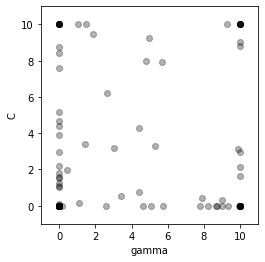

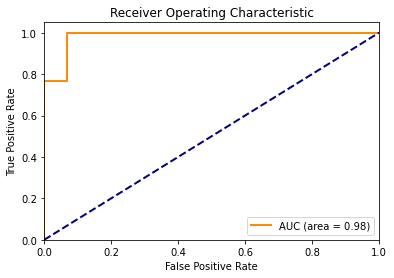

Accuracy for particle (in iteration 16, in fold 7) - 1 is 0.8571 At (gamma, c): [10.          2.97983322]
Accuracy for particle (in iteration 16, in fold 7) - 2 is 0.8929 At (gamma, c): [1.00000000e-03 7.58355827e+00]
Accuracy for particle (in iteration 16, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 16, in fold 7) - 4 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 16, in fold 7) - 5 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 16, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 16, in fold 7) - 7 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 16, in fold 7) - 8 is 0.8929 At (gamma, c): [1.00000000e-03 1.03984033e+00]
Accuracy for particle (in iteration 16, in fold 7) - 9 is 0.4643 At (gamma, c): [7.79479809e+00 1.00000000e-03]
Accuracy for particle (in iteration 16, in fold 7) - 10 is 0.8571 At (gamma, c): [

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 16, in fold 7) - 94 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 16, in fold 7) - 95 is 0.7857 At (gamma, c): [7.86833086 0.39690436]
Accuracy for particle (in iteration 16, in fold 7) - 96 is 0.4643 At (gamma, c): [0.14417172 0.001     ]
Accuracy for particle (in iteration 16, in fold 7) - 97 is 0.4643 At (gamma, c): [8.65223933e+00 1.00000000e-03]
Accuracy for particle (in iteration 16, in fold 7) - 98 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 16, in fold 7) - 99 is 0.8571 At (gamma, c): [4.41035084 0.74736013]
Accuracy for particle (in iteration 16, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 16, fold 7 is [1.00000000e-03 4.28685639e+00], with Accuracy: 1.0000
Accuracy Score: 0.9286
F1 Score: 0.9231
Recall Score: 0.9231
Precision Score: 0.9231
Confusion Matrix (Test):
[[14  1]
 [ 1 12]]
Confusion Matrix (Train):
[[122   6]
 [ 27 103]]

Ite

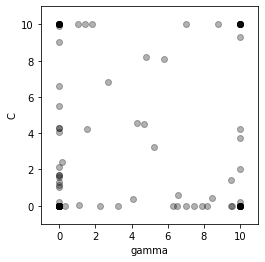

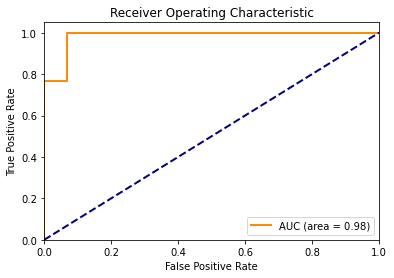

Accuracy for particle (in iteration 17, in fold 7) - 1 is 0.8571 At (gamma, c): [10.          3.75942953]
Accuracy for particle (in iteration 17, in fold 7) - 2 is 0.8929 At (gamma, c): [1.0000000e-03 9.0153054e+00]
Accuracy for particle (in iteration 17, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 17, in fold 7) - 4 is 0.9286 At (gamma, c): [1.00000000e-03 9.93410918e+00]
Accuracy for particle (in iteration 17, in fold 7) - 5 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 17, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 17, in fold 7) - 7 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 17, in fold 7) - 8 is 0.8929 At (gamma, c): [1.00000000e-03 1.03974086e+00]
Accuracy for particle (in iteration 17, in fold 7) - 9 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 17, in fold 7) - 10 is 0.8571 At (gamma, c): [4.

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 17, in fold 7) - 94 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 17, in fold 7) - 95 is 0.5357 At (gamma, c): [10.         0.2092138]
Accuracy for particle (in iteration 17, in fold 7) - 96 is 0.4643 At (gamma, c): [0.33808648 0.001     ]
Accuracy for particle (in iteration 17, in fold 7) - 97 is 0.4643 At (gamma, c): [7.00552494e+00 1.00000000e-03]
Accuracy for particle (in iteration 17, in fold 7) - 98 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 17, in fold 7) - 99 is 0.8571 At (gamma, c): [6.5642663  0.58778976]
Accuracy for particle (in iteration 17, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 17, fold 7 is [1.00000000e-03 4.00243133e+00], with Accuracy: 1.0000
Accuracy Score: 0.9286
F1 Score: 0.9231
Recall Score: 0.9231
Precision Score: 0.9231
Confusion Matrix (Test):
[[14  1]
 [ 1 12]]
Confusion Matrix (Train):
[[122   6]
 [ 27 103]]

Ite

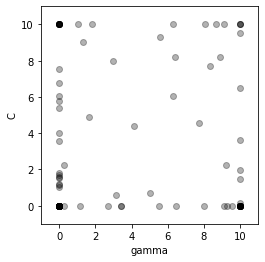

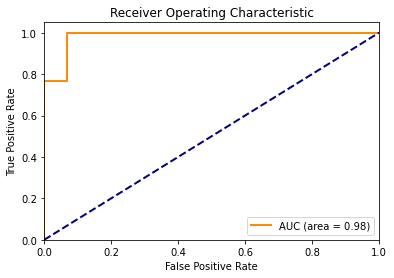

Accuracy for particle (in iteration 18, in fold 7) - 1 is 0.8571 At (gamma, c): [9.23943665 2.25495284]
Accuracy for particle (in iteration 18, in fold 7) - 2 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 18, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 18, in fold 7) - 4 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 18, in fold 7) - 5 is 0.8929 At (gamma, c): [1.00000000e-03 6.74943537e+00]
Accuracy for particle (in iteration 18, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 18, in fold 7) - 7 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 18, in fold 7) - 8 is 0.8929 At (gamma, c): [1.00000000e-03 1.04631546e+00]
Accuracy for particle (in iteration 18, in fold 7) - 9 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 18, in fold 7) - 10 is 0.8571 At (gamma, c): [6.29625124 6.06988

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 18, in fold 7) - 98 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 18, in fold 7) - 99 is 0.8571 At (gamma, c): [5.03190247 0.70130583]
Accuracy for particle (in iteration 18, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 18, fold 7 is [1.00000000e-03 3.92541556e+00], with Accuracy: 1.0000
Accuracy Score: 0.9286
F1 Score: 0.9231
Recall Score: 0.9231
Precision Score: 0.9231
Confusion Matrix (Test):
[[14  1]
 [ 1 12]]
Confusion Matrix (Train):
[[122   6]
 [ 27 103]]

Iteration 19 - Fold 7:



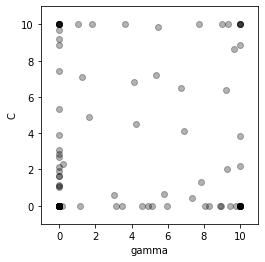

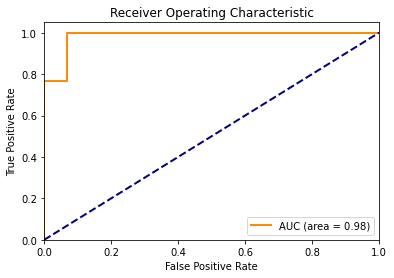

Accuracy for particle (in iteration 19, in fold 7) - 1 is 0.8571 At (gamma, c): [9.2645518 2.0408325]
Accuracy for particle (in iteration 19, in fold 7) - 2 is 0.8929 At (gamma, c): [1.00000000e-03 7.43663773e+00]
Accuracy for particle (in iteration 19, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 19, in fold 7) - 4 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 19, in fold 7) - 5 is 0.9286 At (gamma, c): [1.00000000e-03 9.70674739e+00]
Accuracy for particle (in iteration 19, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 19, in fold 7) - 7 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 19, in fold 7) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 1.01737715e+00]
Accuracy for particle (in iteration 19, in fold 7) - 9 is 0.4643 At (gamma, c): [8.27563809e+00 1.00000000e-03]
Accuracy for particle (in iteration 19, in fold 7) - 10 is 0.8571 At (

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 19, in fold 7) - 95 is 0.7857 At (gamma, c): [7.32146718 0.39728332]
Accuracy for particle (in iteration 19, in fold 7) - 96 is 0.4643 At (gamma, c): [0.16649851 0.001     ]
Accuracy for particle (in iteration 19, in fold 7) - 97 is 0.4643 At (gamma, c): [5.10899536e+00 1.00000000e-03]
Accuracy for particle (in iteration 19, in fold 7) - 98 is 0.4643 At (gamma, c): [8.9236583e+00 1.0000000e-03]
Accuracy for particle (in iteration 19, in fold 7) - 99 is 0.8571 At (gamma, c): [5.81838322 0.64303976]
Accuracy for particle (in iteration 19, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 19, fold 7 is [1.0000000e-03 5.3884117e+00], with Accuracy: 1.0000
Accuracy Score: 0.9286
F1 Score: 0.9231
Recall Score: 0.9231
Precision Score: 0.9231
Confusion Matrix (Test):
[[14  1]
 [ 1 12]]
Confusion Matrix (Train):
[[122   6]
 [ 27 103]]

Iteration 20 - Fold 7:



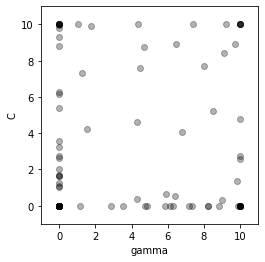

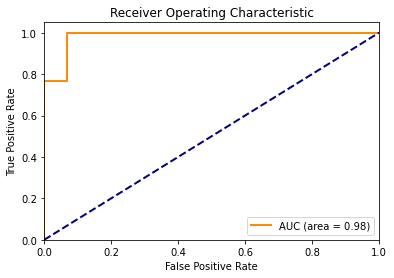

Accuracy for particle (in iteration 20, in fold 7) - 1 is 0.8571 At (gamma, c): [10.          2.73797562]
Accuracy for particle (in iteration 20, in fold 7) - 2 is 0.8571 At (gamma, c): [1.00000000e-03 6.19007011e+00]
Accuracy for particle (in iteration 20, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 20, in fold 7) - 4 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 20, in fold 7) - 5 is 0.8929 At (gamma, c): [1.00000000e-03 8.83837747e+00]
Accuracy for particle (in iteration 20, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 20, in fold 7) - 7 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 20, in fold 7) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 1.02826954e+00]
Accuracy for particle (in iteration 20, in fold 7) - 9 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 20, in fold 7) - 10 is 0.8571 At (gamma, c): [

Accuracy for particle (in iteration 20, in fold 7) - 91 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 20, in fold 7) - 92 is 0.8571 At (gamma, c): [1.00000000e-03 6.25634577e+00]
Accuracy for particle (in iteration 20, in fold 7) - 93 is 0.4643 At (gamma, c): [6.27874295e+00 1.00000000e-03]
Accuracy for particle (in iteration 20, in fold 7) - 94 is 0.4643 At (gamma, c): [9.84974434e+00 1.00000000e-03]
Accuracy for particle (in iteration 20, in fold 7) - 95 is 0.8571 At (gamma, c): [6.37233833 0.51972978]
Accuracy for particle (in iteration 20, in fold 7) - 96 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 20, in fold 7) - 97 is 0.4643 At (gamma, c): [4.73300051e+00 1.00000000e-03]
Accuracy for particle (in iteration 20, in fold 7) - 98 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 20, in fold 7) - 99 is 0.8571 At (gamma, c): [5.8838259  0.63819088]
Accuracy for particle (in iteration 20, in fold 7) 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


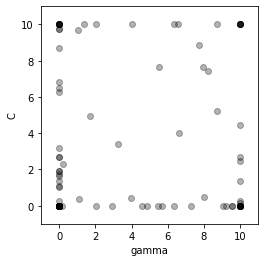

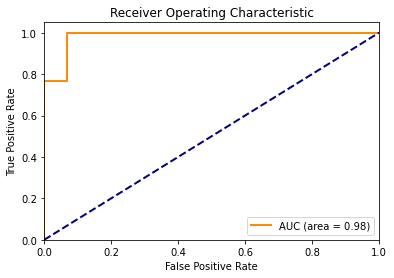

Accuracy for particle (in iteration 21, in fold 7) - 1 is 0.8571 At (gamma, c): [10.          2.49240198]
Accuracy for particle (in iteration 21, in fold 7) - 2 is 0.9286 At (gamma, c): [1.00000000e-03 9.77309256e+00]
Accuracy for particle (in iteration 21, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 21, in fold 7) - 4 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 21, in fold 7) - 5 is 0.9286 At (gamma, c): [1.00000000e-03 9.74413085e+00]
Accuracy for particle (in iteration 21, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 21, in fold 7) - 7 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 21, in fold 7) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 1.02344357e+00]
Accuracy for particle (in iteration 21, in fold 7) - 9 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 21, in fold 7) - 10 is 0.8571 At (gamma, c): [

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 21, in fold 7) - 96 is 0.4643 At (gamma, c): [0.16592179 0.001     ]
Accuracy for particle (in iteration 21, in fold 7) - 97 is 0.4643 At (gamma, c): [7.27678156e+00 1.00000000e-03]
Accuracy for particle (in iteration 21, in fold 7) - 98 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 21, in fold 7) - 99 is 0.7857 At (gamma, c): [7.98986693 0.48216842]
Accuracy for particle (in iteration 21, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 21, fold 7 is [1.0000000e-03 5.9173646e+00], with Accuracy: 1.0000
Accuracy Score: 0.9286
F1 Score: 0.9231
Recall Score: 0.9231
Precision Score: 0.9231
Confusion Matrix (Test):
[[14  1]
 [ 1 12]]
Confusion Matrix (Train):
[[122   6]
 [ 27 103]]

Iteration 22 - Fold 7:



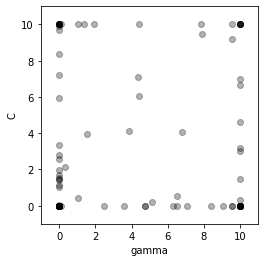

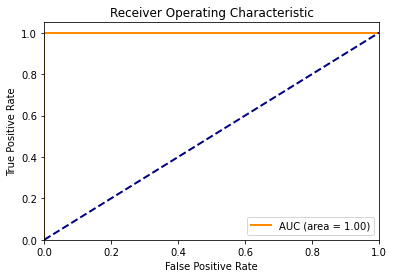

Accuracy for particle (in iteration 22, in fold 7) - 1 is 0.8571 At (gamma, c): [10.          3.18944443]
Accuracy for particle (in iteration 22, in fold 7) - 2 is 0.9286 At (gamma, c): [1.00000000e-03 9.70112529e+00]
Accuracy for particle (in iteration 22, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 22, in fold 7) - 4 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 22, in fold 7) - 5 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 22, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 22, in fold 7) - 7 is 0.9286 At (gamma, c): [ 0.10424828 10.        ]
Accuracy for particle (in iteration 22, in fold 7) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 1.02130855e+00]
Accuracy for particle (in iteration 22, in fold 7) - 9 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 22, in fold 7) - 10 is 0.8571 At (gamma, c): [9.5439

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 22, in fold 7) - 99 is 0.6429 At (gamma, c): [10.          0.33091412]
Accuracy for particle (in iteration 22, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 22, fold 7 is [1.00000000e-03 6.66924926e+00], with Accuracy: 1.0000
Accuracy Score: 0.9286
F1 Score: 0.9286
Recall Score: 1.0000
Precision Score: 0.8667
Confusion Matrix (Test):
[[13  2]
 [ 0 13]]
Confusion Matrix (Train):
[[128   0]
 [  2 128]]

Iteration 23 - Fold 7:



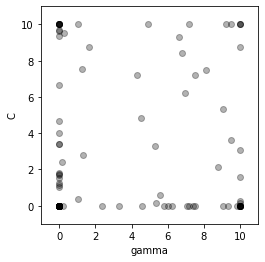

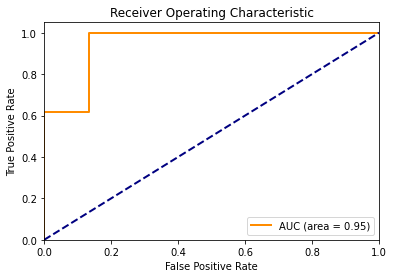

Accuracy for particle (in iteration 23, in fold 7) - 1 is 0.8571 At (gamma, c): [8.76933194 2.11128433]
Accuracy for particle (in iteration 23, in fold 7) - 2 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 23, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 23, in fold 7) - 4 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 23, in fold 7) - 5 is 0.9286 At (gamma, c): [1.00000000e-03 9.69002233e+00]
Accuracy for particle (in iteration 23, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 23, in fold 7) - 7 is 0.8929 At (gamma, c): [0.28010327 9.52291731]
Accuracy for particle (in iteration 23, in fold 7) - 8 is 0.8571 At (gamma, c): [1.0000000e-03 1.0136463e+00]
Accuracy for particle (in iteration 23, in fold 7) - 9 is 0.4643 At (gamma, c): [7.14755141e+00 1.00000000e-03]
Accuracy for particle (in iteration 23, in fold 7) - 10 is 0.8571 At (gamma, c

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 23, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 23, fold 7 is [1.00000000e-03 7.81564692e+00], with Accuracy: 1.0000
Accuracy Score: 0.8929
F1 Score: 0.8889
Recall Score: 0.9231
Precision Score: 0.8571
Confusion Matrix (Test):
[[13  2]
 [ 1 12]]
Confusion Matrix (Train):
[[128   0]
 [  1 129]]

Iteration 24 - Fold 7:



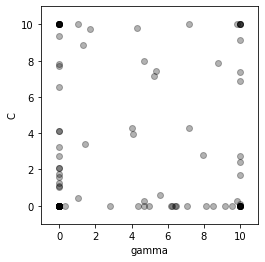

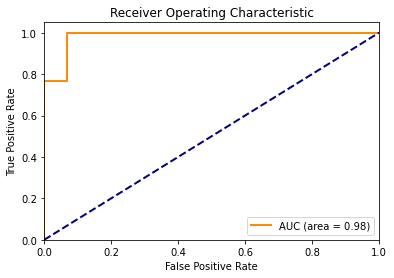

Accuracy for particle (in iteration 24, in fold 7) - 1 is 0.8571 At (gamma, c): [10.          2.72233755]
Accuracy for particle (in iteration 24, in fold 7) - 2 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 24, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 24, in fold 7) - 4 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 24, in fold 7) - 5 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 24, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 24, in fold 7) - 7 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 24, in fold 7) - 8 is 0.8571 At (gamma, c): [1.0000000e-03 1.0166532e+00]
Accuracy for particle (in iteration 24, in fold 7) - 9 is 0.4643 At (gamma, c): [6.46398675e+00 1.00000000e-03]
Accuracy for particle (in iteration 24, in fold 7) - 10 is 0.8571 At (gamma, c): [4.08779311 3.95581

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 24, in fold 7) - 99 is 0.4643 At (gamma, c): [10.          0.11733233]
Accuracy for particle (in iteration 24, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 24, fold 7 is [1.00000000e-03 3.80449805e+00], with Accuracy: 1.0000
Accuracy Score: 0.9286
F1 Score: 0.9231
Recall Score: 0.9231
Precision Score: 0.9231
Confusion Matrix (Test):
[[14  1]
 [ 1 12]]
Confusion Matrix (Train):
[[122   6]
 [ 27 103]]

Iteration 25 - Fold 7:



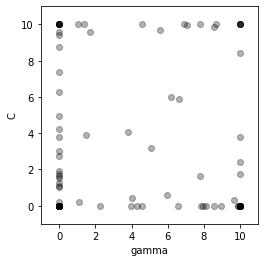

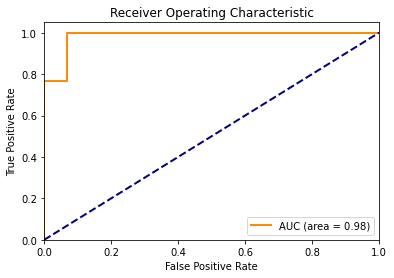

Accuracy for particle (in iteration 25, in fold 7) - 1 is 0.8571 At (gamma, c): [10.          2.43107197]
Accuracy for particle (in iteration 25, in fold 7) - 2 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 25, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 25, in fold 7) - 4 is 0.8929 At (gamma, c): [1.00000000e-03 8.77400009e+00]
Accuracy for particle (in iteration 25, in fold 7) - 5 is 0.9286 At (gamma, c): [1.00000000e-03 9.42518357e+00]
Accuracy for particle (in iteration 25, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 25, in fold 7) - 7 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 25, in fold 7) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 1.01458347e+00]
Accuracy for particle (in iteration 25, in fold 7) - 9 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 25, in fold 7) - 10 is 0.8571 At (gamma, c): [

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 25, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 25, fold 7 is [1.00000000e-03 3.74852674e+00], with Accuracy: 1.0000
Accuracy Score: 0.9286
F1 Score: 0.9231
Recall Score: 0.9231
Precision Score: 0.9231
Confusion Matrix (Test):
[[14  1]
 [ 1 12]]
Confusion Matrix (Train):
[[122   6]
 [ 27 103]]

Iteration 26 - Fold 7:



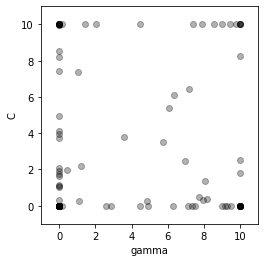

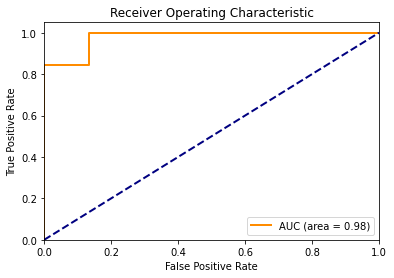

Accuracy for particle (in iteration 26, in fold 7) - 1 is 0.8571 At (gamma, c): [10.          2.52627793]
Accuracy for particle (in iteration 26, in fold 7) - 2 is 0.8929 At (gamma, c): [1.0000000e-03 7.4323658e+00]
Accuracy for particle (in iteration 26, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 26, in fold 7) - 4 is 0.9286 At (gamma, c): [1.00000000e-03 9.98077252e+00]
Accuracy for particle (in iteration 26, in fold 7) - 5 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 26, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 26, in fold 7) - 7 is 0.9286 At (gamma, c): [ 0.13998188 10.        ]
Accuracy for particle (in iteration 26, in fold 7) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 1.02492598e+00]
Accuracy for particle (in iteration 26, in fold 7) - 9 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 26, in fold 7) - 10 is 0.8571 At (gamm

Accuracy for particle (in iteration 26, in fold 7) - 81 is 0.7857 At (gamma, c): [1.08183875 0.2385989 ]
Accuracy for particle (in iteration 26, in fold 7) - 82 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 26, in fold 7) - 83 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 26, in fold 7) - 84 is 0.8571 At (gamma, c): [1.00000000e-03 4.10446486e+00]
Accuracy for particle (in iteration 26, in fold 7) - 85 is 0.6429 At (gamma, c): [4.85528002 0.24742299]
Accuracy for particle (in iteration 26, in fold 7) - 86 is 0.4643 At (gamma, c): [6.2995579e+00 1.0000000e-03]
Accuracy for particle (in iteration 26, in fold 7) - 87 is 0.8929 At (gamma, c): [1.00000000e-03 2.10170618e+00]
Accuracy for particle (in iteration 26, in fold 7) - 88 is 0.8571 At (gamma, c): [ 8.5755252 10.       ]
Accuracy for particle (in iteration 26, in fold 7) - 89 is 0.8571 At (gamma, c): [ 2.01800922 10.        ]
Accuracy for particle (in iteration 26, in fold 7) - 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 26, in fold 7) - 99 is 0.6429 At (gamma, c): [7.95394375 0.31109002]
Accuracy for particle (in iteration 26, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 26, fold 7 is [1.00000000e-03 3.12920866e+00], with Accuracy: 1.0000
Accuracy Score: 0.9286
F1 Score: 0.9286
Recall Score: 1.0000
Precision Score: 0.8667
Confusion Matrix (Test):
[[13  2]
 [ 0 13]]
Confusion Matrix (Train):
[[128   0]
 [  1 129]]

Iteration 27 - Fold 7:



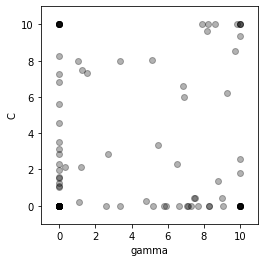

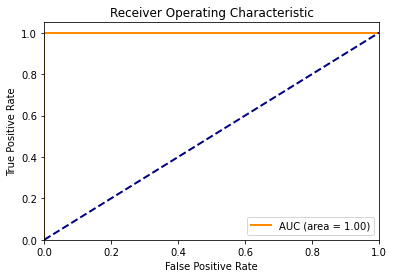

Accuracy for particle (in iteration 27, in fold 7) - 1 is 0.8571 At (gamma, c): [10.          2.55690499]
Accuracy for particle (in iteration 27, in fold 7) - 2 is 0.8929 At (gamma, c): [1.00000000e-03 8.24331303e+00]
Accuracy for particle (in iteration 27, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 27, in fold 7) - 4 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 27, in fold 7) - 5 is 0.8929 At (gamma, c): [1.00000000e-03 7.25759171e+00]
Accuracy for particle (in iteration 27, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 27, in fold 7) - 7 is 1.0000 At (gamma, c): [ 0.01605116 10.        ]
Accuracy for particle (in iteration 27, in fold 7) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 1.02842285e+00]
Accuracy for particle (in iteration 27, in fold 7) - 9 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 27, in fold 7) - 10 is 0.8571 At (ga

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 27, in fold 7) - 99 is 0.7857 At (gamma, c): [7.49866961 0.41141926]
Accuracy for particle (in iteration 27, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 27, fold 7 is [1.00000000e-03 3.49346402e+00], with Accuracy: 1.0000
Accuracy Score: 1.0000
F1 Score: 1.0000
Recall Score: 1.0000
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 0 13]]
Confusion Matrix (Train):
[[128   0]
 [ 11 119]]

Iteration 28 - Fold 7:



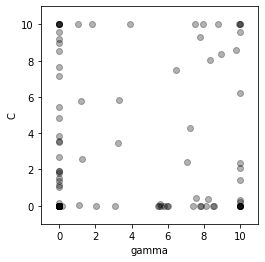

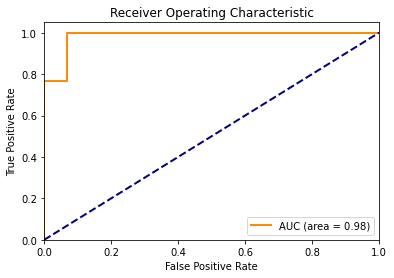

Accuracy for particle (in iteration 28, in fold 7) - 1 is 0.8571 At (gamma, c): [10.          2.34806066]
Accuracy for particle (in iteration 28, in fold 7) - 2 is 0.9286 At (gamma, c): [1.00000000e-03 9.56463754e+00]
Accuracy for particle (in iteration 28, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 28, in fold 7) - 4 is 0.8929 At (gamma, c): [1.000000e-03 8.992674e+00]
Accuracy for particle (in iteration 28, in fold 7) - 5 is 0.8929 At (gamma, c): [1.00000000e-03 7.66245692e+00]
Accuracy for particle (in iteration 28, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 28, in fold 7) - 7 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 28, in fold 7) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 1.02657535e+00]
Accuracy for particle (in iteration 28, in fold 7) - 9 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 28, in fold 7) - 10 is 0.8571 At (

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 28, in fold 7) - 95 is 0.7857 At (gamma, c): [7.57453431 0.4233287 ]
Accuracy for particle (in iteration 28, in fold 7) - 96 is 0.4643 At (gamma, c): [0.14863417 0.001     ]
Accuracy for particle (in iteration 28, in fold 7) - 97 is 0.4643 At (gamma, c): [5.49947332e+00 1.00000000e-03]
Accuracy for particle (in iteration 28, in fold 7) - 98 is 0.4643 At (gamma, c): [8.12861617e+00 1.00000000e-03]
Accuracy for particle (in iteration 28, in fold 7) - 99 is 0.7857 At (gamma, c): [8.23782036 0.38030237]
Accuracy for particle (in iteration 28, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 28, fold 7 is [1.00000000e-03 3.22281569e+00], with Accuracy: 1.0000
Accuracy Score: 0.9286
F1 Score: 0.9231
Recall Score: 0.9231
Precision Score: 0.9231
Confusion Matrix (Test):
[[14  1]
 [ 1 12]]
Confusion Matrix (Train):
[[122   6]
 [ 27 103]]

Iteration 29 - Fold 7:



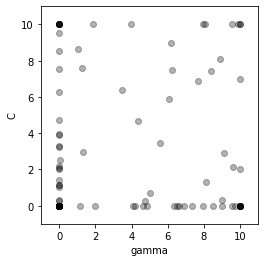

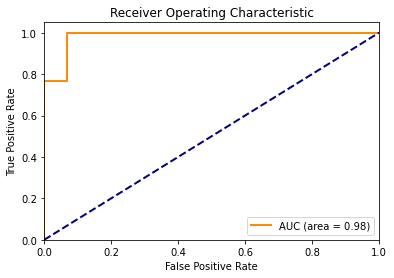

Accuracy for particle (in iteration 29, in fold 7) - 1 is 0.8571 At (gamma, c): [9.601243   2.11717983]
Accuracy for particle (in iteration 29, in fold 7) - 2 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 29, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 29, in fold 7) - 4 is 0.9286 At (gamma, c): [1.00000000e-03 9.55713127e+00]
Accuracy for particle (in iteration 29, in fold 7) - 5 is 0.8929 At (gamma, c): [1.00000000e-03 7.55678649e+00]
Accuracy for particle (in iteration 29, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 29, in fold 7) - 7 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 29, in fold 7) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 1.02955117e+00]
Accuracy for particle (in iteration 29, in fold 7) - 9 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 29, in fold 7) - 10 is 0.8571 At (gamma, c): [6.

Accuracy for particle (in iteration 29, in fold 7) - 95 is 0.6429 At (gamma, c): [9.01016758 0.29740675]
Accuracy for particle (in iteration 29, in fold 7) - 96 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 29, in fold 7) - 97 is 0.4643 At (gamma, c): [6.33218933e+00 1.00000000e-03]
Accuracy for particle (in iteration 29, in fold 7) - 98 is 0.4643 At (gamma, c): [9.71329909e+00 1.00000000e-03]
Accuracy for particle (in iteration 29, in fold 7) - 99 is 0.8571 At (gamma, c): [5.01101042 0.68122019]
Accuracy for particle (in iteration 29, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 29, fold 7 is [1.000000e-03 3.602957e+00], with Accuracy: 1.0000
Accuracy Score: 0.9286
F1 Score: 0.9231
Recall Score: 0.9231
Precision Score: 0.9231
Confusion Matrix (Test):
[[14  1]
 [ 1 12]]
Confusion Matrix (Train):
[[122   6]
 [ 27 103]]

Iteration 30 - Fold 7:



*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


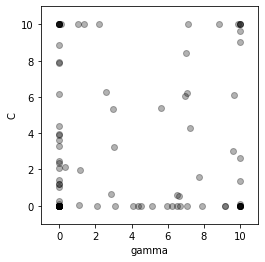

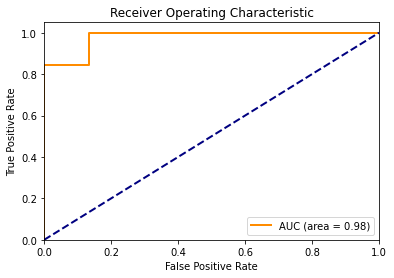

Accuracy for particle (in iteration 30, in fold 7) - 1 is 0.8571 At (gamma, c): [10.         2.6499954]
Accuracy for particle (in iteration 30, in fold 7) - 2 is 0.8929 At (gamma, c): [1.00000000e-03 7.93749464e+00]
Accuracy for particle (in iteration 30, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 30, in fold 7) - 4 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 30, in fold 7) - 5 is 0.8929 At (gamma, c): [1.00000000e-03 8.86246126e+00]
Accuracy for particle (in iteration 30, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 30, in fold 7) - 7 is 0.9286 At (gamma, c): [ 0.11609197 10.        ]
Accuracy for particle (in iteration 30, in fold 7) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 1.02895274e+00]
Accuracy for particle (in iteration 30, in fold 7) - 9 is 0.4643 At (gamma, c): [9.13427783e+00 1.00000000e-03]
Accuracy for particle (in iteration 30, in fold 7) - 10 is

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 30, in fold 7) - 95 is 0.4643 At (gamma, c): [10.          0.07104292]
Accuracy for particle (in iteration 30, in fold 7) - 96 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 30, in fold 7) - 97 is 0.4643 At (gamma, c): [5.93155501e+00 1.00000000e-03]
Accuracy for particle (in iteration 30, in fold 7) - 98 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 30, in fold 7) - 99 is 0.8571 At (gamma, c): [6.50079045 0.57413618]
Accuracy for particle (in iteration 30, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 30, fold 7 is [1.00000000e-03 4.23040729e+00], with Accuracy: 1.0000
Accuracy Score: 0.9286
F1 Score: 0.9286
Recall Score: 1.0000
Precision Score: 0.8667
Confusion Matrix (Test):
[[13  2]
 [ 0 13]]
Confusion Matrix (Train):
[[128   0]
 [  2 128]]

Iteration 31 - Fold 7:



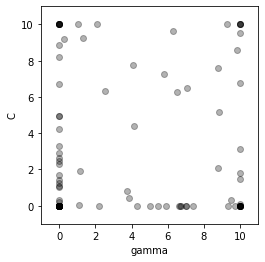

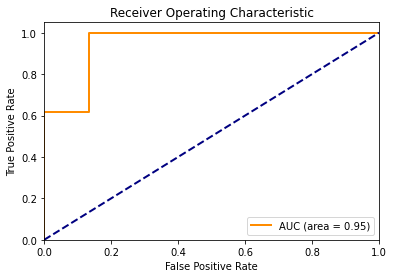

Accuracy for particle (in iteration 31, in fold 7) - 1 is 0.8571 At (gamma, c): [8.74464986 2.06977674]
Accuracy for particle (in iteration 31, in fold 7) - 2 is 0.8929 At (gamma, c): [1.00000000e-03 8.21931041e+00]
Accuracy for particle (in iteration 31, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 31, in fold 7) - 4 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 31, in fold 7) - 5 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 31, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 31, in fold 7) - 7 is 0.8929 At (gamma, c): [0.29954599 9.18529019]
Accuracy for particle (in iteration 31, in fold 7) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 1.02229908e+00]
Accuracy for particle (in iteration 31, in fold 7) - 9 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 31, in fold 7) - 10 is 0.8571 At (gamma, c): [6.52950509

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 31, in fold 7) - 92 is 0.8571 At (gamma, c): [1.00000000e-03 4.95996481e+00]
Accuracy for particle (in iteration 31, in fold 7) - 93 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 31, in fold 7) - 94 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 31, in fold 7) - 95 is 0.4643 At (gamma, c): [10.          0.10161396]
Accuracy for particle (in iteration 31, in fold 7) - 96 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 31, in fold 7) - 97 is 0.4643 At (gamma, c): [6.6276639e+00 1.0000000e-03]
Accuracy for particle (in iteration 31, in fold 7) - 98 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 31, in fold 7) - 99 is 0.8571 At (gamma, c): [3.74043875 0.79471457]
Accuracy for particle (in iteration 31, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 31, fold 7 is [1.00000000e-03 2.97337819e+00], with

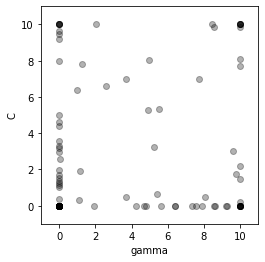

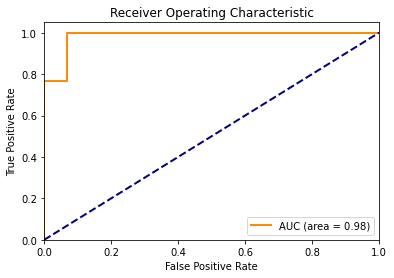

Accuracy for particle (in iteration 32, in fold 7) - 1 is 0.8571 At (gamma, c): [10.          2.19893936]
Accuracy for particle (in iteration 32, in fold 7) - 2 is 0.9286 At (gamma, c): [1.00000000e-03 9.50063605e+00]
Accuracy for particle (in iteration 32, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 32, in fold 7) - 4 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 32, in fold 7) - 5 is 0.8571 At (gamma, c): [1.00000000e-03 4.64532031e+00]
Accuracy for particle (in iteration 32, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 32, in fold 7) - 7 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 32, in fold 7) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 1.01888091e+00]
Accuracy for particle (in iteration 32, in fold 7) - 9 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 32, in fold 7) - 10 is 0.8571 At (gamma, c): [

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 32, in fold 7) - 97 is 0.4643 At (gamma, c): [7.91343695e+00 1.00000000e-03]
Accuracy for particle (in iteration 32, in fold 7) - 98 is 0.4643 At (gamma, c): [9.2543041e+00 1.0000000e-03]
Accuracy for particle (in iteration 32, in fold 7) - 99 is 0.8571 At (gamma, c): [5.43173355 0.66969302]
Accuracy for particle (in iteration 32, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 32, fold 7 is [1.00000000e-03 4.36473278e+00], with Accuracy: 1.0000
Accuracy Score: 0.9286
F1 Score: 0.9231
Recall Score: 0.9231
Precision Score: 0.9231
Confusion Matrix (Test):
[[14  1]
 [ 1 12]]
Confusion Matrix (Train):
[[122   6]
 [ 27 103]]

Iteration 33 - Fold 7:



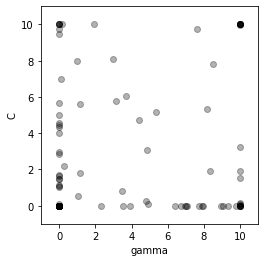

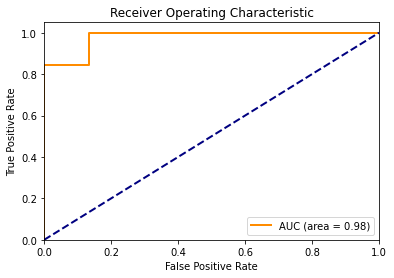

Accuracy for particle (in iteration 33, in fold 7) - 1 is 0.8571 At (gamma, c): [8.35434844 1.90851438]
Accuracy for particle (in iteration 33, in fold 7) - 2 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 33, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 33, in fold 7) - 4 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 33, in fold 7) - 5 is 0.8571 At (gamma, c): [1.00000000e-03 5.01735323e+00]
Accuracy for particle (in iteration 33, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 33, in fold 7) - 7 is 0.9286 At (gamma, c): [ 0.13683805 10.        ]
Accuracy for particle (in iteration 33, in fold 7) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 1.01689781e+00]
Accuracy for particle (in iteration 33, in fold 7) - 9 is 0.4643 At (gamma, c): [7.86813481e+00 1.00000000e-03]
Accuracy for particle (in iteration 33, in fold 7) - 10 is 0.8571 At (gamm

Accuracy for particle (in iteration 33, in fold 7) - 81 is 0.8571 At (gamma, c): [1.05077954 0.53498364]
Accuracy for particle (in iteration 33, in fold 7) - 82 is 0.4643 At (gamma, c): [6.94437808e+00 1.00000000e-03]
Accuracy for particle (in iteration 33, in fold 7) - 83 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 33, in fold 7) - 84 is 0.8571 At (gamma, c): [1.0000000e-03 2.9728884e+00]
Accuracy for particle (in iteration 33, in fold 7) - 85 is 0.6429 At (gamma, c): [4.78448301 0.26124293]
Accuracy for particle (in iteration 33, in fold 7) - 86 is 0.4643 At (gamma, c): [7.72019518e+00 1.00000000e-03]
Accuracy for particle (in iteration 33, in fold 7) - 87 is 0.8929 At (gamma, c): [1.00000000e-03 1.47796937e+00]
Accuracy for particle (in iteration 33, in fold 7) - 88 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 33, in fold 7) - 89 is 0.8571 At (gamma, c): [ 1.91883618 10.        ]
Accuracy for particle (in iteration 33, in fold 7) 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 33, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 33, fold 7 is [1.00000000e-03 3.62229207e+00], with Accuracy: 1.0000
Accuracy Score: 0.9286
F1 Score: 0.9286
Recall Score: 1.0000
Precision Score: 0.8667
Confusion Matrix (Test):
[[13  2]
 [ 0 13]]
Confusion Matrix (Train):
[[128   0]
 [  1 129]]

Iteration 34 - Fold 7:



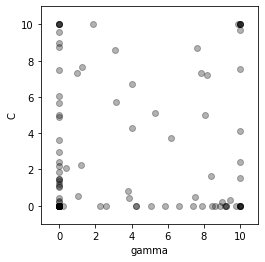

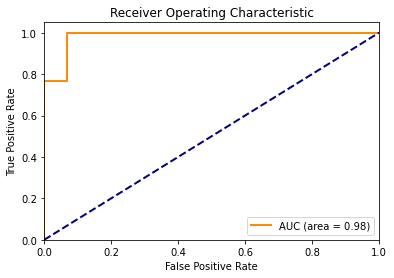

Accuracy for particle (in iteration 34, in fold 7) - 1 is 0.8571 At (gamma, c): [10.          2.41658512]
Accuracy for particle (in iteration 34, in fold 7) - 2 is 0.8571 At (gamma, c): [1.00000000e-03 5.68061383e+00]
Accuracy for particle (in iteration 34, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 34, in fold 7) - 4 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 34, in fold 7) - 5 is 0.8571 At (gamma, c): [1.00000000e-03 6.02876551e+00]
Accuracy for particle (in iteration 34, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 34, in fold 7) - 7 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 34, in fold 7) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 1.02110172e+00]
Accuracy for particle (in iteration 34, in fold 7) - 9 is 0.4643 At (gamma, c): [9.23585157e+00 1.00000000e-03]
Accuracy for particle (in iteration 34, in fold 7) - 10 is 0.8571 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 34, in fold 7) - 97 is 0.4643 At (gamma, c): [6.59682831e+00 1.00000000e-03]
Accuracy for particle (in iteration 34, in fold 7) - 98 is 0.4643 At (gamma, c): [8.41927585e+00 1.00000000e-03]
Accuracy for particle (in iteration 34, in fold 7) - 99 is 0.8571 At (gamma, c): [3.8185393  0.79111787]
Accuracy for particle (in iteration 34, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 34, fold 7 is [1.00000000e-03 4.63246906e+00], with Accuracy: 1.0000
Accuracy Score: 0.9286
F1 Score: 0.9231
Recall Score: 0.9231
Precision Score: 0.9231
Confusion Matrix (Test):
[[14  1]
 [ 1 12]]
Confusion Matrix (Train):
[[122   6]
 [ 27 103]]

Iteration 35 - Fold 7:



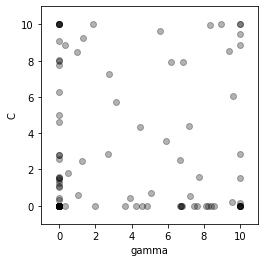

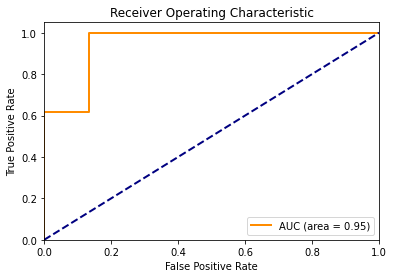

Accuracy for particle (in iteration 35, in fold 7) - 1 is 0.8571 At (gamma, c): [10.         2.8424621]
Accuracy for particle (in iteration 35, in fold 7) - 2 is 0.8929 At (gamma, c): [1.00000000e-03 7.76412069e+00]
Accuracy for particle (in iteration 35, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 35, in fold 7) - 4 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 35, in fold 7) - 5 is 0.8929 At (gamma, c): [1.00000000e-03 8.03617892e+00]
Accuracy for particle (in iteration 35, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 35, in fold 7) - 7 is 0.8929 At (gamma, c): [0.30344406 8.84775473]
Accuracy for particle (in iteration 35, in fold 7) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 1.01370092e+00]
Accuracy for particle (in iteration 35, in fold 7) - 9 is 0.4643 At (gamma, c): [8.40018059e+00 1.00000000e-03]
Accuracy for particle (in iteration 35, in fold 7) - 10 is 0

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 35, in fold 7) - 96 is 0.4643 At (gamma, c): [0.33326123 0.001     ]
Accuracy for particle (in iteration 35, in fold 7) - 97 is 0.4643 At (gamma, c): [8.56004193e+00 1.00000000e-03]
Accuracy for particle (in iteration 35, in fold 7) - 98 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 35, in fold 7) - 99 is 0.8571 At (gamma, c): [5.08185733 0.69754453]
Accuracy for particle (in iteration 35, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 35, fold 7 is [1.00000000e-03 3.10403151e+00], with Accuracy: 1.0000
Accuracy Score: 0.8929
F1 Score: 0.8889
Recall Score: 0.9231
Precision Score: 0.8571
Confusion Matrix (Test):
[[13  2]
 [ 1 12]]
Confusion Matrix (Train):
[[128   0]
 [  1 129]]

Iteration 36 - Fold 7:



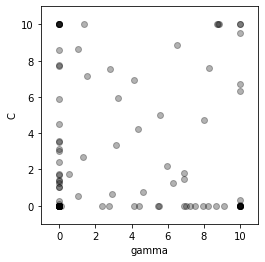

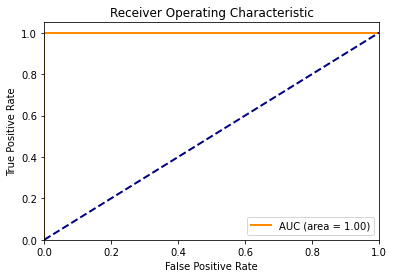

Accuracy for particle (in iteration 36, in fold 7) - 1 is 0.8571 At (gamma, c): [6.91937032 1.78615609]
Accuracy for particle (in iteration 36, in fold 7) - 2 is 0.8929 At (gamma, c): [1.00000000e-03 7.73072658e+00]
Accuracy for particle (in iteration 36, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 36, in fold 7) - 4 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 36, in fold 7) - 5 is 0.8571 At (gamma, c): [1.00000000e-03 4.52163978e+00]
Accuracy for particle (in iteration 36, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 36, in fold 7) - 7 is 1.0000 At (gamma, c): [ 0.01998442 10.        ]
Accuracy for particle (in iteration 36, in fold 7) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 1.01587315e+00]
Accuracy for particle (in iteration 36, in fold 7) - 9 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 36, in fold 7) - 10 is 0.8571 At (gamm

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 36, in fold 7) - 96 is 0.4643 At (gamma, c): [0.11524302 0.001     ]
Accuracy for particle (in iteration 36, in fold 7) - 97 is 0.4643 At (gamma, c): [7.91619557e+00 1.00000000e-03]
Accuracy for particle (in iteration 36, in fold 7) - 98 is 0.4643 At (gamma, c): [8.23550784e+00 1.00000000e-03]
Accuracy for particle (in iteration 36, in fold 7) - 99 is 0.8571 At (gamma, c): [4.65747346 0.72901702]
Accuracy for particle (in iteration 36, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 36, fold 7 is [1.00000000e-03 2.82747045e+00], with Accuracy: 1.0000
Accuracy Score: 1.0000
F1 Score: 1.0000
Recall Score: 1.0000
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 0 13]]
Confusion Matrix (Train):
[[128   0]
 [  8 122]]

Iteration 37 - Fold 7:



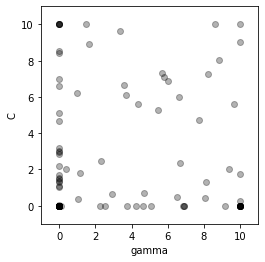

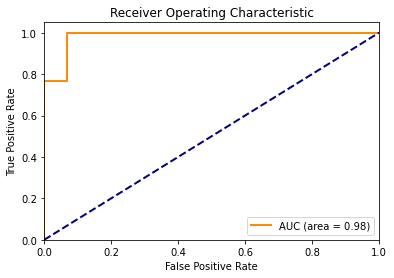

Accuracy for particle (in iteration 37, in fold 7) - 1 is 0.8571 At (gamma, c): [9.39901749 2.05160973]
Accuracy for particle (in iteration 37, in fold 7) - 2 is 0.8571 At (gamma, c): [1.00000000e-03 5.14169888e+00]
Accuracy for particle (in iteration 37, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 37, in fold 7) - 4 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 37, in fold 7) - 5 is 0.8571 At (gamma, c): [1.00000000e-03 4.64876913e+00]
Accuracy for particle (in iteration 37, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 37, in fold 7) - 7 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 37, in fold 7) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 1.01738827e+00]
Accuracy for particle (in iteration 37, in fold 7) - 9 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 37, in fold 7) - 10 is 0.8571 At (gamma, c): [5.

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 37, in fold 7) - 93 is 0.4643 At (gamma, c): [6.88143646e+00 1.00000000e-03]
Accuracy for particle (in iteration 37, in fold 7) - 94 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 37, in fold 7) - 95 is 0.7857 At (gamma, c): [6.50612863 0.47406474]
Accuracy for particle (in iteration 37, in fold 7) - 96 is 0.4643 At (gamma, c): [0.08128232 0.001     ]
Accuracy for particle (in iteration 37, in fold 7) - 97 is 0.4643 At (gamma, c): [4.27190248e+00 1.00000000e-03]
Accuracy for particle (in iteration 37, in fold 7) - 98 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 37, in fold 7) - 99 is 0.8571 At (gamma, c): [4.68756265 0.72680046]
Accuracy for particle (in iteration 37, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 37, fold 7 is [1.00000000e-03 3.18529822e+00], with Accuracy: 1.0000
Accuracy Score: 0.9286
F1 Score: 0.9231
Recall Score: 0.9231
Precisio

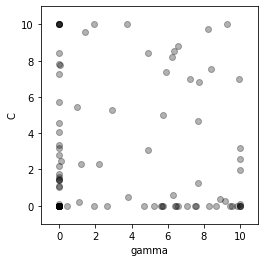

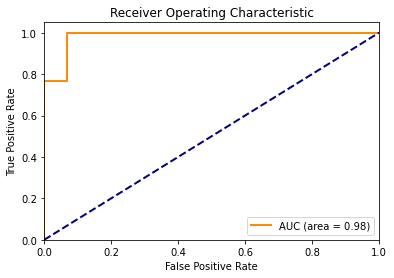

Accuracy for particle (in iteration 38, in fold 7) - 1 is 0.8571 At (gamma, c): [10.          2.56638466]
Accuracy for particle (in iteration 38, in fold 7) - 2 is 0.8929 At (gamma, c): [1.00000000e-03 7.27182198e+00]
Accuracy for particle (in iteration 38, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 38, in fold 7) - 4 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 38, in fold 7) - 5 is 0.8571 At (gamma, c): [1.00000000e-03 4.54049268e+00]
Accuracy for particle (in iteration 38, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 38, in fold 7) - 7 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 38, in fold 7) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 1.01508777e+00]
Accuracy for particle (in iteration 38, in fold 7) - 9 is 0.4643 At (gamma, c): [9.83367067e+00 1.00000000e-03]
Accuracy for particle (in iteration 38, in fold 7) - 10 is 0.8571 

Accuracy for particle (in iteration 38, in fold 7) - 96 is 0.4643 At (gamma, c): [0.43105073 0.001     ]
Accuracy for particle (in iteration 38, in fold 7) - 97 is 0.4643 At (gamma, c): [4.67891677e+00 1.00000000e-03]
Accuracy for particle (in iteration 38, in fold 7) - 98 is 0.4643 At (gamma, c): [7.55176308e+00 1.00000000e-03]
Accuracy for particle (in iteration 38, in fold 7) - 99 is 0.8571 At (gamma, c): [6.27589819 0.60913211]
Accuracy for particle (in iteration 38, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001      0.07918145]
The best position in iteration 38, fold 7 is [1.00000000e-03 2.50708027e+00], with Accuracy: 1.0000
Accuracy Score: 0.9286
F1 Score: 0.9231
Recall Score: 0.9231
Precision Score: 0.9231
Confusion Matrix (Test):
[[14  1]
 [ 1 12]]
Confusion Matrix (Train):
[[122   6]
 [ 27 103]]

Iteration 39 - Fold 7:



*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


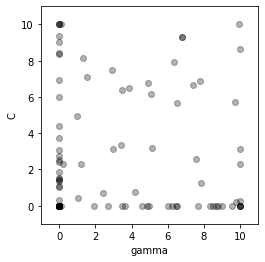

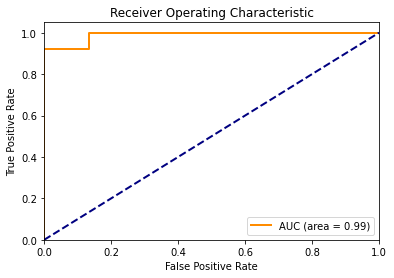

Accuracy for particle (in iteration 39, in fold 7) - 1 is 0.8571 At (gamma, c): [10.          3.10375469]
Accuracy for particle (in iteration 39, in fold 7) - 2 is 0.8929 At (gamma, c): [1.00000000e-03 6.94833956e+00]
Accuracy for particle (in iteration 39, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 39, in fold 7) - 4 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 39, in fold 7) - 5 is 0.8571 At (gamma, c): [1.00000000e-03 4.39274118e+00]
Accuracy for particle (in iteration 39, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 39, in fold 7) - 7 is 0.9286 At (gamma, c): [ 0.1102205 10.       ]
Accuracy for particle (in iteration 39, in fold 7) - 8 is 0.8571 At (gamma, c): [1.0000000e-03 1.0226516e+00]
Accuracy for particle (in iteration 39, in fold 7) - 9 is 0.4643 At (gamma, c): [6.51139175e+00 1.00000000e-03]
Accuracy for particle (in iteration 39, in fold 7) - 10 is 0

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 39, in fold 7) - 97 is 0.4643 At (gamma, c): [4.94283141e+00 1.00000000e-03]
Accuracy for particle (in iteration 39, in fold 7) - 98 is 0.4643 At (gamma, c): [8.48019667e+00 1.00000000e-03]
Accuracy for particle (in iteration 39, in fold 7) - 99 is 0.8571 At (gamma, c): [4.20069448 0.76287879]
Accuracy for particle (in iteration 39, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 39, fold 7 is [1.00000000e-03 3.22033656e+00], with Accuracy: 1.0000
Accuracy Score: 0.9286
F1 Score: 0.9286
Recall Score: 1.0000
Precision Score: 0.8667
Confusion Matrix (Test):
[[13  2]
 [ 0 13]]
Confusion Matrix (Train):
[[128   0]
 [  2 128]]

Iteration 40 - Fold 7:



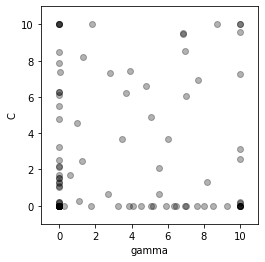

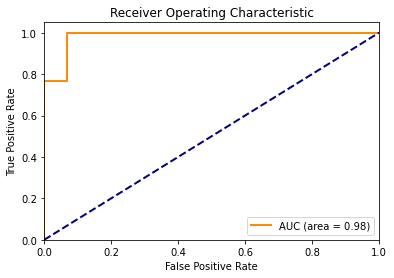

Accuracy for particle (in iteration 40, in fold 7) - 1 is 0.8571 At (gamma, c): [10.          3.13136754]
Accuracy for particle (in iteration 40, in fold 7) - 2 is 0.8571 At (gamma, c): [1.00000000e-03 6.26793419e+00]
Accuracy for particle (in iteration 40, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 40, in fold 7) - 4 is 0.8929 At (gamma, c): [1.00000000e-03 7.85541628e+00]
Accuracy for particle (in iteration 40, in fold 7) - 5 is 0.8571 At (gamma, c): [1.00000000e-03 6.09737343e+00]
Accuracy for particle (in iteration 40, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 40, in fold 7) - 7 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 40, in fold 7) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 1.02503277e+00]
Accuracy for particle (in iteration 40, in fold 7) - 9 is 0.4643 At (gamma, c): [5.20659897e+00 1.00000000e-03]
Accuracy for particle (in iteration 40, in fold 7)

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 40, in fold 7) - 94 is 0.4643 At (gamma, c): [9.98738812e+00 1.00000000e-03]
Accuracy for particle (in iteration 40, in fold 7) - 95 is 0.4643 At (gamma, c): [10.         0.1432555]
Accuracy for particle (in iteration 40, in fold 7) - 96 is 0.4643 At (gamma, c): [0.29849277 0.001     ]
Accuracy for particle (in iteration 40, in fold 7) - 97 is 0.4643 At (gamma, c): [6.43436982e+00 1.00000000e-03]
Accuracy for particle (in iteration 40, in fold 7) - 98 is 0.4643 At (gamma, c): [7.6016948e+00 1.0000000e-03]
Accuracy for particle (in iteration 40, in fold 7) - 99 is 0.8571 At (gamma, c): [5.50109848 0.66654105]
Accuracy for particle (in iteration 40, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 40, fold 7 is [1.00000000e-03 3.51460406e+00], with Accuracy: 1.0000
Accuracy Score: 0.9286
F1 Score: 0.9231
Recall Score: 0.9231
Precision Score: 0.9231
Confusion Matrix (Test):
[[14  1]
 [ 1 12]]
Confusion Matrix (Train

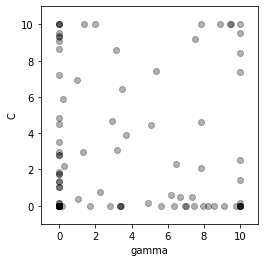

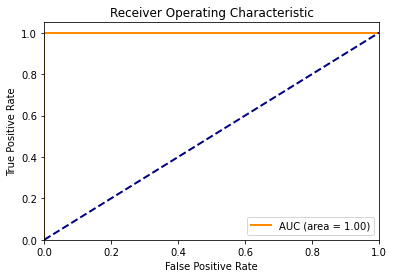

Accuracy for particle (in iteration 41, in fold 7) - 1 is 0.8571 At (gamma, c): [7.84278824 2.09219791]
Accuracy for particle (in iteration 41, in fold 7) - 2 is 0.8929 At (gamma, c): [1.00000000e-03 8.62944685e+00]
Accuracy for particle (in iteration 41, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 41, in fold 7) - 4 is 0.9286 At (gamma, c): [1.00000000e-03 9.51539818e+00]
Accuracy for particle (in iteration 41, in fold 7) - 5 is 0.8929 At (gamma, c): [1.00000000e-03 7.22782453e+00]
Accuracy for particle (in iteration 41, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 41, in fold 7) - 7 is 1.0000 At (gamma, c): [ 0.01603665 10.        ]
Accuracy for particle (in iteration 41, in fold 7) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 1.01878732e+00]
Accuracy for particle (in iteration 41, in fold 7) - 9 is 0.4643 At (gamma, c): [5.59877044e+00 1.00000000e-03]
Accuracy for particle (in iteration 41, in

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 41, in fold 7) - 94 is 0.4643 At (gamma, c): [8.20961083e+00 1.00000000e-03]
Accuracy for particle (in iteration 41, in fold 7) - 95 is 0.7857 At (gamma, c): [6.70130627 0.47867667]
Accuracy for particle (in iteration 41, in fold 7) - 96 is 0.4643 At (gamma, c): [0.16296638 0.001     ]
Accuracy for particle (in iteration 41, in fold 7) - 97 is 0.4643 At (gamma, c): [8.57445402e+00 1.00000000e-03]
Accuracy for particle (in iteration 41, in fold 7) - 98 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 41, in fold 7) - 99 is 0.8571 At (gamma, c): [6.18857441 0.61561121]
Accuracy for particle (in iteration 41, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 41, fold 7 is [1.00000000e-03 2.72025929e+00], with Accuracy: 1.0000
Accuracy Score: 1.0000
F1 Score: 1.0000
Recall Score: 1.0000
Precision Score: 1.0000
Confusion Matrix (Test):
[[15  0]
 [ 0 13]]
Confusion Matrix (Train):
[[128   0]


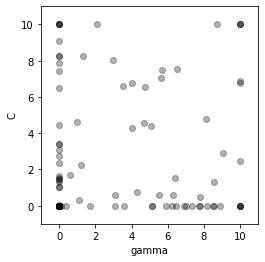

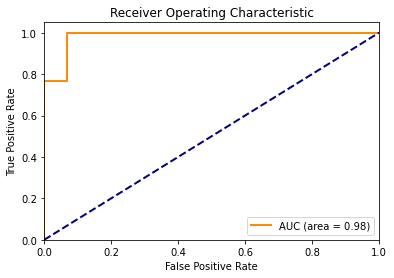

Accuracy for particle (in iteration 42, in fold 7) - 1 is 0.8571 At (gamma, c): [10.          2.46674554]
Accuracy for particle (in iteration 42, in fold 7) - 2 is 0.8929 At (gamma, c): [1.00000000e-03 8.24281393e+00]
Accuracy for particle (in iteration 42, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 42, in fold 7) - 4 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 42, in fold 7) - 5 is 0.8571 At (gamma, c): [1.00000000e-03 6.49039797e+00]
Accuracy for particle (in iteration 42, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 42, in fold 7) - 7 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 42, in fold 7) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 1.02042932e+00]
Accuracy for particle (in iteration 42, in fold 7) - 9 is 0.4643 At (gamma, c): [6.46111244e+00 1.00000000e-03]
Accuracy for particle (in iteration 42, in fold 7) - 10 is 0.8571 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 42, in fold 7) - 93 is 0.4643 At (gamma, c): [7.0015779e+00 1.0000000e-03]
Accuracy for particle (in iteration 42, in fold 7) - 94 is 0.4643 At (gamma, c): [7.31390894e+00 1.00000000e-03]
Accuracy for particle (in iteration 42, in fold 7) - 95 is 0.8571 At (gamma, c): [5.50914064 0.5981155 ]
Accuracy for particle (in iteration 42, in fold 7) - 96 is 0.4643 At (gamma, c): [0.39661071 0.001     ]
Accuracy for particle (in iteration 42, in fold 7) - 97 is 0.4643 At (gamma, c): [8.54372961e+00 1.00000000e-03]
Accuracy for particle (in iteration 42, in fold 7) - 98 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 42, in fold 7) - 99 is 0.8571 At (gamma, c): [4.31095146 0.75471318]
Accuracy for particle (in iteration 42, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 42, fold 7 is [1.00000000e-03 3.17066213e+00], with Accuracy: 1.0000
Accuracy Score: 0.9286
F1 Score: 0.9231
Recall Score: 0

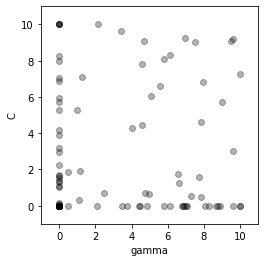

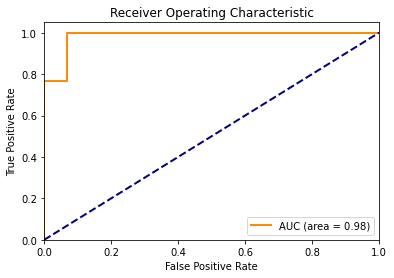

Accuracy for particle (in iteration 43, in fold 7) - 1 is 0.8571 At (gamma, c): [6.57841788 1.72284915]
Accuracy for particle (in iteration 43, in fold 7) - 2 is 0.8571 At (gamma, c): [1.00000000e-03 5.71124305e+00]
Accuracy for particle (in iteration 43, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 43, in fold 7) - 4 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 43, in fold 7) - 5 is 0.8571 At (gamma, c): [1.00000000e-03 5.96719127e+00]
Accuracy for particle (in iteration 43, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 43, in fold 7) - 7 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 43, in fold 7) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 1.01945555e+00]
Accuracy for particle (in iteration 43, in fold 7) - 9 is 0.4643 At (gamma, c): [6.78482203e+00 1.00000000e-03]
Accuracy for particle (in iteration 43, in fold 7) - 10 is 0.8571 At

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 43, in fold 7) - 97 is 0.4643 At (gamma, c): [6.81227231e+00 1.00000000e-03]
Accuracy for particle (in iteration 43, in fold 7) - 98 is 0.4643 At (gamma, c): [8.28544871e+00 1.00000000e-03]
Accuracy for particle (in iteration 43, in fold 7) - 99 is 0.8571 At (gamma, c): [4.75492447 0.72182245]
Accuracy for particle (in iteration 43, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 43, fold 7 is [1.00000000e-03 2.91261183e+00], with Accuracy: 1.0000
Accuracy Score: 0.9286
F1 Score: 0.9231
Recall Score: 0.9231
Precision Score: 0.9231
Confusion Matrix (Test):
[[14  1]
 [ 1 12]]
Confusion Matrix (Train):
[[122   6]
 [ 27 103]]

Iteration 44 - Fold 7:



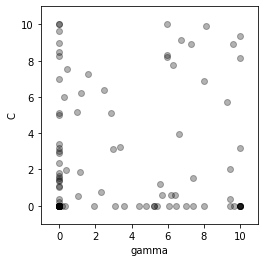

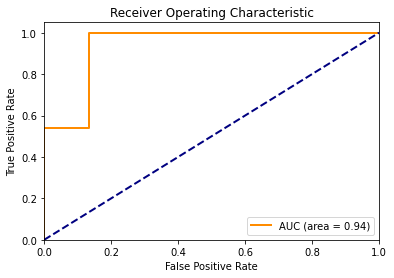

Accuracy for particle (in iteration 44, in fold 7) - 1 is 0.8571 At (gamma, c): [9.41086048 2.0486921 ]
Accuracy for particle (in iteration 44, in fold 7) - 2 is 0.8929 At (gamma, c): [1.00000000e-03 8.45403228e+00]
Accuracy for particle (in iteration 44, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 44, in fold 7) - 4 is 0.8929 At (gamma, c): [1.00000000e-03 6.97464348e+00]
Accuracy for particle (in iteration 44, in fold 7) - 5 is 0.8571 At (gamma, c): [1.00000000e-03 5.13778592e+00]
Accuracy for particle (in iteration 44, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 44, in fold 7) - 7 is 0.9286 At (gamma, c): [0.4149772  7.56725781]
Accuracy for particle (in iteration 44, in fold 7) - 8 is 0.8571 At (gamma, c): [1.0000000e-03 1.0241674e+00]
Accuracy for particle (in iteration 44, in fold 7) - 9 is 0.4643 At (gamma, c): [4.82136401e+00 1.00000000e-03]
Accuracy for particle (in iteration 44, in fol

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 44, in fold 7) - 96 is 0.4643 At (gamma, c): [0.32847503 0.001     ]
Accuracy for particle (in iteration 44, in fold 7) - 97 is 0.4643 At (gamma, c): [7.36746743e+00 1.00000000e-03]
Accuracy for particle (in iteration 44, in fold 7) - 98 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 44, in fold 7) - 99 is 0.8571 At (gamma, c): [6.19386113 0.61522134]
Accuracy for particle (in iteration 44, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 44, fold 7 is [1.00000000e-03 2.72738681e+00], with Accuracy: 1.0000
Accuracy Score: 0.9286
F1 Score: 0.9286
Recall Score: 1.0000
Precision Score: 0.8667
Confusion Matrix (Test):
[[13  2]
 [ 0 13]]
Confusion Matrix (Train):
[[128   0]
 [  0 130]]

Iteration 45 - Fold 7:



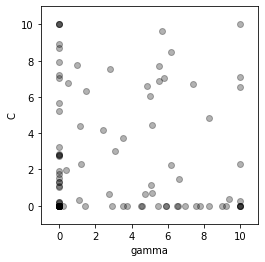

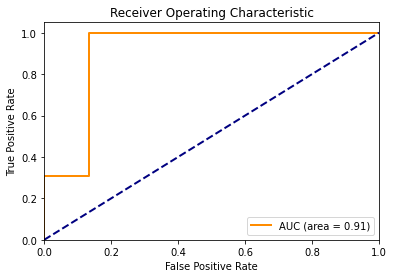

Accuracy for particle (in iteration 45, in fold 7) - 1 is 0.8571 At (gamma, c): [10.          2.31879883]
Accuracy for particle (in iteration 45, in fold 7) - 2 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 45, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 45, in fold 7) - 4 is 0.8929 At (gamma, c): [1.00000000e-03 7.94086935e+00]
Accuracy for particle (in iteration 45, in fold 7) - 5 is 0.8929 At (gamma, c): [1.00000000e-03 7.04129354e+00]
Accuracy for particle (in iteration 45, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 45, in fold 7) - 7 is 0.9286 At (gamma, c): [0.51789828 6.77215802]
Accuracy for particle (in iteration 45, in fold 7) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 1.00974911e+00]
Accuracy for particle (in iteration 45, in fold 7) - 9 is 0.4643 At (gamma, c): [4.56643141e+00 1.00000000e-03]
Accuracy for particle (in iteration 45, in fold 7) - 10 is

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 45, in fold 7) - 96 is 0.4643 At (gamma, c): [0.19088615 0.001     ]
Accuracy for particle (in iteration 45, in fold 7) - 97 is 0.4643 At (gamma, c): [3.73571391e+00 1.00000000e-03]
Accuracy for particle (in iteration 45, in fold 7) - 98 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 45, in fold 7) - 99 is 0.8571 At (gamma, c): [5.1544739  0.69222276]
Accuracy for particle (in iteration 45, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001      0.17814953]
The best position in iteration 45, fold 7 is [1.00000000e-03 3.37902947e+00], with Accuracy: 1.0000
Accuracy Score: 0.9286
F1 Score: 0.9286
Recall Score: 1.0000
Precision Score: 0.8667
Confusion Matrix (Test):
[[13  2]
 [ 0 13]]
Confusion Matrix (Train):
[[128   0]
 [  0 130]]

Iteration 46 - Fold 7:



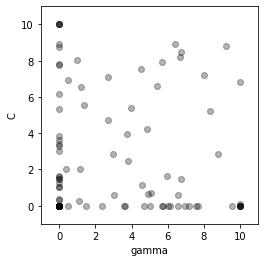

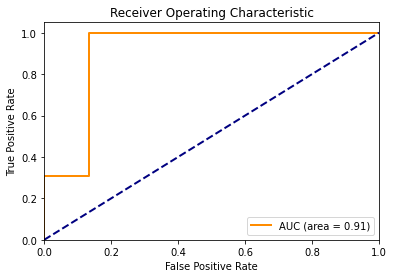

Accuracy for particle (in iteration 46, in fold 7) - 1 is 0.8571 At (gamma, c): [5.96289943 1.61988627]
Accuracy for particle (in iteration 46, in fold 7) - 2 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 46, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 46, in fold 7) - 4 is 0.8929 At (gamma, c): [1.00000000e-03 8.90823846e+00]
Accuracy for particle (in iteration 46, in fold 7) - 5 is 0.8929 At (gamma, c): [1.00000000e-03 7.73653596e+00]
Accuracy for particle (in iteration 46, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 46, in fold 7) - 7 is 0.9286 At (gamma, c): [0.50997776 6.92052755]
Accuracy for particle (in iteration 46, in fold 7) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 1.01682056e+00]
Accuracy for particle (in iteration 46, in fold 7) - 9 is 0.4643 At (gamma, c): [6.54032546e+00 1.00000000e-03]
Accuracy for particle (in iteration 46, in fold 7) - 10 is 0

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 46, in fold 7) - 95 is 0.8571 At (gamma, c): [4.91062584 0.65691076]
Accuracy for particle (in iteration 46, in fold 7) - 96 is 0.4643 At (gamma, c): [0.48630378 0.001     ]
Accuracy for particle (in iteration 46, in fold 7) - 97 is 0.4643 At (gamma, c): [4.68709878e+00 1.00000000e-03]
Accuracy for particle (in iteration 46, in fold 7) - 98 is 0.4643 At (gamma, c): [9.51789967e+00 1.00000000e-03]
Accuracy for particle (in iteration 46, in fold 7) - 99 is 0.8571 At (gamma, c): [5.09289172 0.69678506]
Accuracy for particle (in iteration 46, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 46, fold 7 is [1.00000000e-03 3.12117154e+00], with Accuracy: 1.0000
Accuracy Score: 0.9286
F1 Score: 0.9286
Recall Score: 1.0000
Precision Score: 0.8667
Confusion Matrix (Test):
[[13  2]
 [ 0 13]]
Confusion Matrix (Train):
[[128   0]
 [  0 130]]

Iteration 47 - Fold 7:



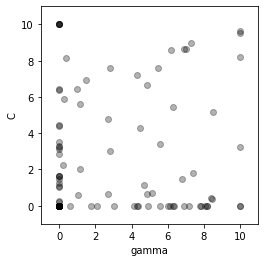

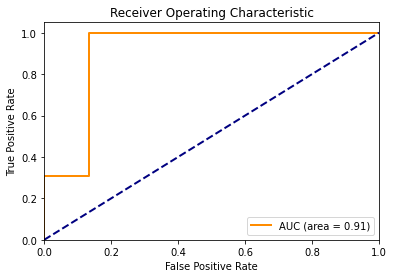

Accuracy for particle (in iteration 47, in fold 7) - 1 is 0.8571 At (gamma, c): [7.39807776 1.77919725]
Accuracy for particle (in iteration 47, in fold 7) - 2 is 0.9286 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 47, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 47, in fold 7) - 4 is 0.8571 At (gamma, c): [1.00000000e-03 6.46617423e+00]
Accuracy for particle (in iteration 47, in fold 7) - 5 is 0.8571 At (gamma, c): [1.00000000e-03 6.37420507e+00]
Accuracy for particle (in iteration 47, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 47, in fold 7) - 7 is 0.9286 At (gamma, c): [0.407786   8.16494521]
Accuracy for particle (in iteration 47, in fold 7) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 1.01555004e+00]
Accuracy for particle (in iteration 47, in fold 7) - 9 is 0.4643 At (gamma, c): [6.90980214e+00 1.00000000e-03]
Accuracy for particle (in iteration 47, in fold 7) - 10 is 0

Accuracy for particle (in iteration 47, in fold 7) - 80 is 0.8571 At (gamma, c): [4.69599894 1.14459001]
Accuracy for particle (in iteration 47, in fold 7) - 81 is 0.8571 At (gamma, c): [1.04650437 0.56651473]
Accuracy for particle (in iteration 47, in fold 7) - 82 is 0.4643 At (gamma, c): [7.19690171e+00 1.00000000e-03]
Accuracy for particle (in iteration 47, in fold 7) - 83 is 0.8571 At (gamma, c): [6.88352959 8.65997026]
Accuracy for particle (in iteration 47, in fold 7) - 84 is 0.8929 At (gamma, c): [1.00000000e-03 3.31638079e+00]
Accuracy for particle (in iteration 47, in fold 7) - 85 is 0.8571 At (gamma, c): [2.70847551 0.66649385]
Accuracy for particle (in iteration 47, in fold 7) - 86 is 0.4643 At (gamma, c): [6.09688579e+00 1.00000000e-03]
Accuracy for particle (in iteration 47, in fold 7) - 87 is 0.8929 At (gamma, c): [1.00000000e-03 1.48853788e+00]
Accuracy for particle (in iteration 47, in fold 7) - 88 is 0.8571 At (gamma, c): [7.02355193 8.65092409]
Accuracy for particle (

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


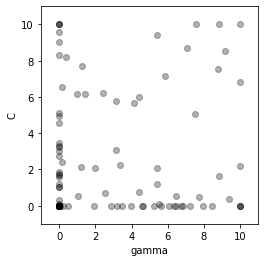

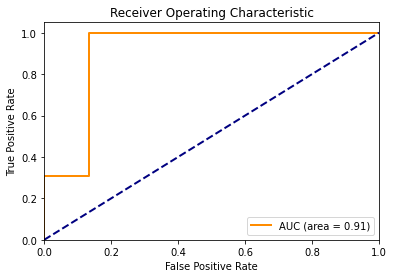

Accuracy for particle (in iteration 48, in fold 7) - 1 is 0.8571 At (gamma, c): [10.          2.18772502]
Accuracy for particle (in iteration 48, in fold 7) - 2 is 0.9286 At (gamma, c): [1.00000000e-03 9.55993114e+00]
Accuracy for particle (in iteration 48, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 48, in fold 7) - 4 is 0.8929 At (gamma, c): [1.00000000e-03 9.03863285e+00]
Accuracy for particle (in iteration 48, in fold 7) - 5 is 0.8571 At (gamma, c): [1.00000000e-03 4.55410405e+00]
Accuracy for particle (in iteration 48, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 48, in fold 7) - 7 is 0.9286 At (gamma, c): [0.40519503 8.19954448]
Accuracy for particle (in iteration 48, in fold 7) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 1.00973006e+00]
Accuracy for particle (in iteration 48, in fold 7) - 9 is 0.4643 At (gamma, c): [7.93924361e+00 1.00000000e-03]
Accuracy for particle (in iteration 48, in

Accuracy for particle (in iteration 48, in fold 7) - 80 is 0.8571 At (gamma, c): [5.40035452 1.17214038]
Accuracy for particle (in iteration 48, in fold 7) - 81 is 0.8571 At (gamma, c): [1.05083779 0.52612107]
Accuracy for particle (in iteration 48, in fold 7) - 82 is 0.4643 At (gamma, c): [6.47558e+00 1.00000e-03]
Accuracy for particle (in iteration 48, in fold 7) - 83 is 0.8571 At (gamma, c): [ 8.81117522 10.        ]
Accuracy for particle (in iteration 48, in fold 7) - 84 is 0.8929 At (gamma, c): [1.00000000e-03 3.25405306e+00]
Accuracy for particle (in iteration 48, in fold 7) - 85 is 0.8571 At (gamma, c): [2.50835542 0.70555866]
Accuracy for particle (in iteration 48, in fold 7) - 86 is 0.4643 At (gamma, c): [3.49640907e+00 1.00000000e-03]
Accuracy for particle (in iteration 48, in fold 7) - 87 is 0.8929 At (gamma, c): [1.00000000e-03 1.67365381e+00]
Accuracy for particle (in iteration 48, in fold 7) - 88 is 0.8571 At (gamma, c): [7.04875646 8.68726015]
Accuracy for particle (in i

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 48, in fold 7) - 98 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 48, in fold 7) - 99 is 0.8571 At (gamma, c): [4.42692308 0.74612229]
Accuracy for particle (in iteration 48, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001      0.09734953]
The best position in iteration 48, fold 7 is [1.00000000e-03 3.23479677e+00], with Accuracy: 1.0000
Accuracy Score: 0.9286
F1 Score: 0.9286
Recall Score: 1.0000
Precision Score: 0.8667
Confusion Matrix (Test):
[[13  2]
 [ 0 13]]
Confusion Matrix (Train):
[[128   0]
 [  0 130]]

Iteration 49 - Fold 7:



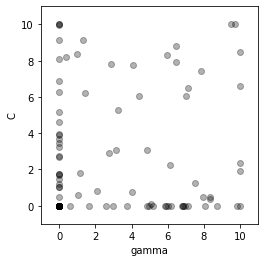

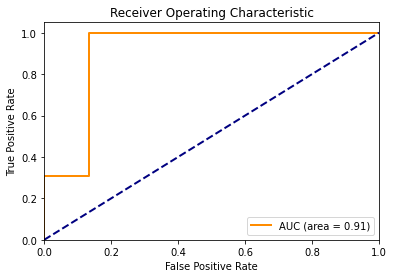

Accuracy for particle (in iteration 49, in fold 7) - 1 is 0.8571 At (gamma, c): [10.          2.33508713]
Accuracy for particle (in iteration 49, in fold 7) - 2 is 0.8929 At (gamma, c): [1.00000000e-03 6.86082243e+00]
Accuracy for particle (in iteration 49, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 49, in fold 7) - 4 is 0.8571 At (gamma, c): [1.00000000e-03 6.25586209e+00]
Accuracy for particle (in iteration 49, in fold 7) - 5 is 0.8571 At (gamma, c): [1.00000000e-03 5.17384882e+00]
Accuracy for particle (in iteration 49, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 49, in fold 7) - 7 is 0.9286 At (gamma, c): [0.40298174 8.22748324]
Accuracy for particle (in iteration 49, in fold 7) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 1.01497827e+00]
Accuracy for particle (in iteration 49, in fold 7) - 9 is 0.4643 At (gamma, c): [9.80630217e+00 1.00000000e-03]
Accuracy for particle (in iteration 49, in

Accuracy for particle (in iteration 49, in fold 7) - 79 is 0.7857 At (gamma, c): [7.96535166 0.47927666]
Accuracy for particle (in iteration 49, in fold 7) - 80 is 0.8571 At (gamma, c): [7.49622312 1.25412867]
Accuracy for particle (in iteration 49, in fold 7) - 81 is 0.8571 At (gamma, c): [1.04140265 0.61406953]
Accuracy for particle (in iteration 49, in fold 7) - 82 is 0.4643 At (gamma, c): [6.16492371e+00 1.00000000e-03]
Accuracy for particle (in iteration 49, in fold 7) - 83 is 0.8571 At (gamma, c): [ 9.71352975 10.        ]
Accuracy for particle (in iteration 49, in fold 7) - 84 is 0.8929 At (gamma, c): [1.00000000e-03 3.45268229e+00]
Accuracy for particle (in iteration 49, in fold 7) - 85 is 0.8571 At (gamma, c): [2.06732626 0.79165058]
Accuracy for particle (in iteration 49, in fold 7) - 86 is 0.4643 At (gamma, c): [4.85495854e+00 1.00000000e-03]
Accuracy for particle (in iteration 49, in fold 7) - 87 is 0.8571 At (gamma, c): [1.00000000e-03 1.71436817e+00]
Accuracy for particle

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 49, in fold 7) - 97 is 0.4643 At (gamma, c): [3.74213456e+00 1.00000000e-03]
Accuracy for particle (in iteration 49, in fold 7) - 98 is 0.4643 At (gamma, c): [8.04406642e+00 1.00000000e-03]
Accuracy for particle (in iteration 49, in fold 7) - 99 is 0.8571 At (gamma, c): [4.01446303 0.7766787 ]
Accuracy for particle (in iteration 49, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001 0.001]
The best position in iteration 49, fold 7 is [1.00000000e-03 2.24246838e+00], with Accuracy: 1.0000
Accuracy Score: 0.9286
F1 Score: 0.9286
Recall Score: 1.0000
Precision Score: 0.8667
Confusion Matrix (Test):
[[13  2]
 [ 0 13]]
Confusion Matrix (Train):
[[128   0]
 [  0 130]]

Iteration 50 - Fold 7:



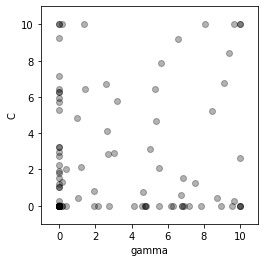

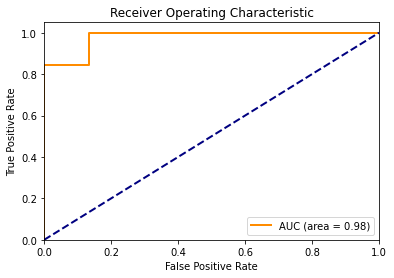

Accuracy for particle (in iteration 50, in fold 7) - 1 is 0.8571 At (gamma, c): [10.          2.60682483]
Accuracy for particle (in iteration 50, in fold 7) - 2 is 0.8929 At (gamma, c): [1.00000000e-03 7.16539088e+00]
Accuracy for particle (in iteration 50, in fold 7) - 3 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 50, in fold 7) - 4 is 0.8571 At (gamma, c): [1.00000000e-03 5.71792215e+00]
Accuracy for particle (in iteration 50, in fold 7) - 5 is 0.8571 At (gamma, c): [1.00000000e-03 6.27741565e+00]
Accuracy for particle (in iteration 50, in fold 7) - 6 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 50, in fold 7) - 7 is 0.9286 At (gamma, c): [ 0.15505903 10.        ]
Accuracy for particle (in iteration 50, in fold 7) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 1.01543846e+00]
Accuracy for particle (in iteration 50, in fold 7) - 9 is 0.4643 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 50, in fold 7) - 10 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 50, in fold 7) - 96 is 0.4643 At (gamma, c): [0.38924378 0.001     ]
Accuracy for particle (in iteration 50, in fold 7) - 97 is 0.4643 At (gamma, c): [4.80664816e+00 1.00000000e-03]
Accuracy for particle (in iteration 50, in fold 7) - 98 is 0.4643 At (gamma, c): [8.940023e+00 1.000000e-03]
Accuracy for particle (in iteration 50, in fold 7) - 99 is 0.8571 At (gamma, c): [4.65158549 0.72947859]
Accuracy for particle (in iteration 50, in fold 7) - 100 is 0.4643 At (gamma, c): [0.001      0.03352817]
The best position in iteration 50, fold 7 is [1.00000000e-03 2.78217471e+00], with Accuracy: 1.0000
Accuracy Score: 0.9286
F1 Score: 0.9286
Recall Score: 1.0000
Precision Score: 0.8667
Confusion Matrix (Test):
[[13  2]
 [ 0 13]]
Confusion Matrix (Train):
[[128   0]
 [  1 129]]


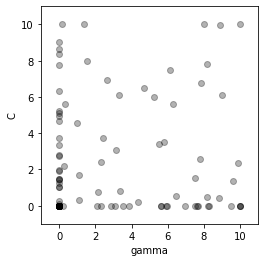

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.



Iteration 1 - Fold 8:



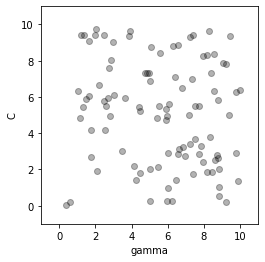

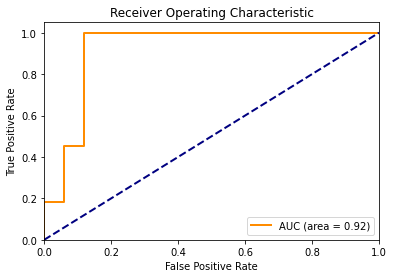

Accuracy for particle (in iteration 1, in fold 8) - 1 is 0.8929 At (gamma, c): [7.23941012 3.38756838]
Accuracy for particle (in iteration 1, in fold 8) - 2 is 0.8929 At (gamma, c): [8.57647769 6.32123215]
Accuracy for particle (in iteration 1, in fold 8) - 3 is 0.8929 At (gamma, c): [2.49143345 9.41139662]
Accuracy for particle (in iteration 1, in fold 8) - 4 is 0.8929 At (gamma, c): [3.62325403 5.91793744]
Accuracy for particle (in iteration 1, in fold 8) - 5 is 0.8929 At (gamma, c): [8.38248638 7.30721305]
Accuracy for particle (in iteration 1, in fold 8) - 6 is 0.8929 At (gamma, c): [3.49784507 2.99663265]
Accuracy for particle (in iteration 1, in fold 8) - 7 is 0.8929 At (gamma, c): [4.11937088 2.1666345 ]
Accuracy for particle (in iteration 1, in fold 8) - 8 is 0.9286 At (gamma, c): [1.65779836 9.06780484]
Accuracy for particle (in iteration 1, in fold 8) - 9 is 0.8929 At (gamma, c): [8.60907947 2.52518847]
Accuracy for particle (in iteration 1, in fold 8) - 10 is 0.9286 At (gamm

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 1, in fold 8) - 94 is 0.8929 At (gamma, c): [4.44835637 1.78995907]
Accuracy for particle (in iteration 1, in fold 8) - 95 is 0.8929 At (gamma, c): [6.75975157 6.46888194]
Accuracy for particle (in iteration 1, in fold 8) - 96 is 0.5000 At (gamma, c): [4.99091621 0.25976203]
Accuracy for particle (in iteration 1, in fold 8) - 97 is 0.8929 At (gamma, c): [5.5051864  5.50187322]
Accuracy for particle (in iteration 1, in fold 8) - 98 is 0.8929 At (gamma, c): [6.28178647 8.82370531]
Accuracy for particle (in iteration 1, in fold 8) - 99 is 0.8929 At (gamma, c): [6.81358509 3.24640688]
Accuracy for particle (in iteration 1, in fold 8) - 100 is 0.9286 At (gamma, c): [2.17980636 6.65492134]
The best position in iteration 1, fold 8 is [3.03298867 6.3029681 ], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

I

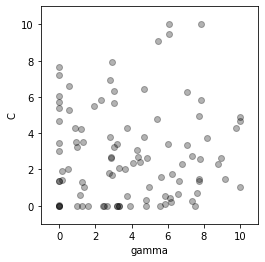

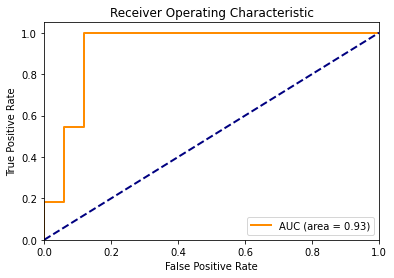

Accuracy for particle (in iteration 2, in fold 8) - 1 is 0.8929 At (gamma, c): [0.13422951 1.90156801]
Accuracy for particle (in iteration 2, in fold 8) - 2 is 0.8929 At (gamma, c): [7.36021527 2.76026351]
Accuracy for particle (in iteration 2, in fold 8) - 3 is 0.8929 At (gamma, c): [3.65688015 1.99837015]
Accuracy for particle (in iteration 2, in fold 8) - 4 is 0.8929 At (gamma, c): [4.29606094 3.07871715]
Accuracy for particle (in iteration 2, in fold 8) - 5 is 0.8929 At (gamma, c): [7.7672081  2.55843834]
Accuracy for particle (in iteration 2, in fold 8) - 6 is 0.3929 At (gamma, c): [3.19492082e+00 1.00000000e-03]
Accuracy for particle (in iteration 2, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 3.46114808e+00]
Accuracy for particle (in iteration 2, in fold 8) - 8 is 0.8929 At (gamma, c): [3.03298867 6.3029681 ]
Accuracy for particle (in iteration 2, in fold 8) - 9 is 0.8929 At (gamma, c): [5.64043055 1.57142455]
Accuracy for particle (in iteration 2, in fold 8) - 10 is

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 2, in fold 8) - 91 is 0.9286 At (gamma, c): [1.14763441 0.5676168 ]
Accuracy for particle (in iteration 2, in fold 8) - 92 is 0.8929 At (gamma, c): [10.          4.88582794]
Accuracy for particle (in iteration 2, in fold 8) - 93 is 0.8929 At (gamma, c): [2.81124684 6.92432563]
Accuracy for particle (in iteration 2, in fold 8) - 94 is 0.5000 At (gamma, c): [7.36334673 0.27232695]
Accuracy for particle (in iteration 2, in fold 8) - 95 is 0.7857 At (gamma, c): [1.00000000e-03 4.68407443e+00]
Accuracy for particle (in iteration 2, in fold 8) - 96 is 0.3929 At (gamma, c): [1.61430759e+00 1.00000000e-03]
Accuracy for particle (in iteration 2, in fold 8) - 97 is 0.9286 At (gamma, c): [1.91896525 5.48889888]
Accuracy for particle (in iteration 2, in fold 8) - 98 is 0.7500 At (gamma, c): [1.00000000e-03 5.41586501e+00]
Accuracy for particle (in iteration 2, in fold 8) - 99 is 0.3929 At (gamma, c): [2.47603189e+00 1.00000000e-03]
Accuracy for particle (in iter

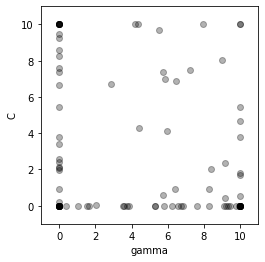

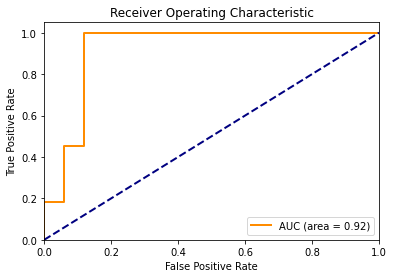

Accuracy for particle (in iteration 3, in fold 8) - 1 is 0.7500 At (gamma, c): [1.0000000e-03 2.1188197e+00]
Accuracy for particle (in iteration 3, in fold 8) - 2 is 0.7143 At (gamma, c): [10.          0.53192651]
Accuracy for particle (in iteration 3, in fold 8) - 3 is 0.8929 At (gamma, c): [8.29076853 0.92877362]
Accuracy for particle (in iteration 3, in fold 8) - 4 is 0.8929 At (gamma, c): [8.37038572 2.0261097 ]
Accuracy for particle (in iteration 3, in fold 8) - 5 is 0.3929 At (gamma, c): [9.33030435e+00 1.00000000e-03]
Accuracy for particle (in iteration 3, in fold 8) - 6 is 0.3929 At (gamma, c): [3.53824369e+00 1.00000000e-03]
Accuracy for particle (in iteration 3, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 5.44696686e+00]
Accuracy for particle (in iteration 3, in fold 8) - 8 is 0.8929 At (gamma, c): [5.82150385 7.00549405]
Accuracy for particle (in iteration 3, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 3, in fold 8) -

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 3, in fold 8) - 96 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 3, in fold 8) - 97 is 0.7500 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 3, in fold 8) - 98 is 0.7500 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 3, in fold 8) - 99 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 3, in fold 8) - 100 is 0.3929 At (gamma, c): [7.60588895e+00 1.00000000e-03]
The best position in iteration 3, fold 8 is [7.36095587 8.22939644], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 4 - Fold 8:



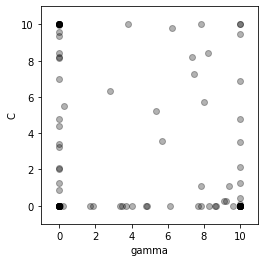

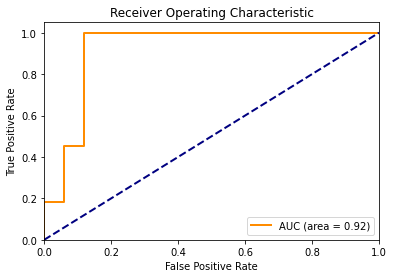

Accuracy for particle (in iteration 4, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 2.04749962e+00]
Accuracy for particle (in iteration 4, in fold 8) - 2 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 4, in fold 8) - 3 is 0.7143 At (gamma, c): [10.         0.4450802]
Accuracy for particle (in iteration 4, in fold 8) - 4 is 0.8929 At (gamma, c): [9.39850424 1.087236  ]
Accuracy for particle (in iteration 4, in fold 8) - 5 is 0.3929 At (gamma, c): [4.84411989e+00 1.00000000e-03]
Accuracy for particle (in iteration 4, in fold 8) - 6 is 0.3929 At (gamma, c): [3.6806586e+00 1.0000000e-03]
Accuracy for particle (in iteration 4, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 8.12399781e+00]
Accuracy for particle (in iteration 4, in fold 8) - 8 is 0.8929 At (gamma, c): [7.36095587 8.22939644]
Accuracy for particle (in iteration 4, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 4, in fold 8) - 10 is 0.8

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 4, in fold 8) - 99 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 4, in fold 8) - 100 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 4, fold 8 is [8.20267324 8.96045432], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 5 - Fold 8:



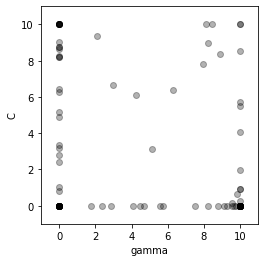

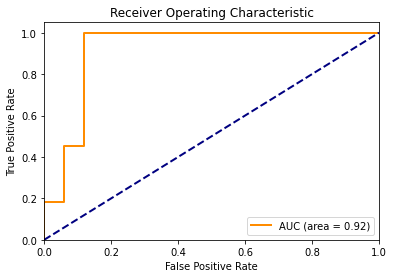

Accuracy for particle (in iteration 5, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 2.79675506e+00]
Accuracy for particle (in iteration 5, in fold 8) - 2 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 5, in fold 8) - 3 is 0.4643 At (gamma, c): [10.          0.27162416]
Accuracy for particle (in iteration 5, in fold 8) - 4 is 0.8929 At (gamma, c): [9.82055724 0.6705539 ]
Accuracy for particle (in iteration 5, in fold 8) - 5 is 0.3929 At (gamma, c): [5.7463655e+00 1.0000000e-03]
Accuracy for particle (in iteration 5, in fold 8) - 6 is 0.3929 At (gamma, c): [4.46713892e+00 1.00000000e-03]
Accuracy for particle (in iteration 5, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 6.43547276e+00]
Accuracy for particle (in iteration 5, in fold 8) - 8 is 0.8929 At (gamma, c): [8.20267324 8.96045432]
Accuracy for particle (in iteration 5, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 5, in fold 8) - 10 is 0

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 5, in fold 8) - 97 is 0.7500 At (gamma, c): [1.00000000e-03 8.76974487e+00]
Accuracy for particle (in iteration 5, in fold 8) - 98 is 0.7500 At (gamma, c): [1.00000000e-03 8.18053203e+00]
Accuracy for particle (in iteration 5, in fold 8) - 99 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 5, in fold 8) - 100 is 0.3929 At (gamma, c): [8.2233025e+00 1.0000000e-03]
The best position in iteration 5, fold 8 is [10. 10.], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 6 - Fold 8:



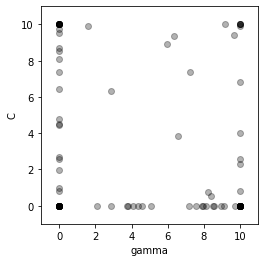

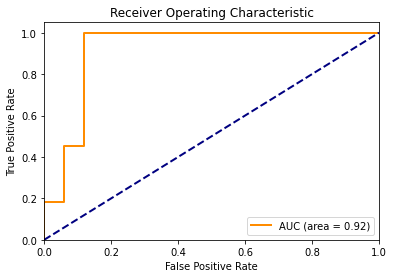

Accuracy for particle (in iteration 6, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 2.70278527e+00]
Accuracy for particle (in iteration 6, in fold 8) - 2 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 6, in fold 8) - 3 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 6, in fold 8) - 4 is 0.8929 At (gamma, c): [8.39493387 0.53163301]
Accuracy for particle (in iteration 6, in fold 8) - 5 is 0.3929 At (gamma, c): [3.82009736e+00 1.00000000e-03]
Accuracy for particle (in iteration 6, in fold 8) - 6 is 0.3929 At (gamma, c): [4.34041269e+00 1.00000000e-03]
Accuracy for particle (in iteration 6, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 7.40257503e+00]
Accuracy for particle (in iteration 6, in fold 8) - 8 is 0.8929 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 6, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 6, in fold 8) - 10 is 0.8929 At (gamma, c): [

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 6, in fold 8) - 95 is 0.7500 At (gamma, c): [1.00000000e-03 8.68041291e+00]
Accuracy for particle (in iteration 6, in fold 8) - 96 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 6, in fold 8) - 97 is 0.7500 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 6, in fold 8) - 98 is 0.7500 At (gamma, c): [1.00000000e-03 9.72518934e+00]
Accuracy for particle (in iteration 6, in fold 8) - 99 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 6, in fold 8) - 100 is 0.3929 At (gamma, c): [7.94867254e+00 1.00000000e-03]
The best position in iteration 6, fold 8 is [10. 10.], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 7 - Fold 8:



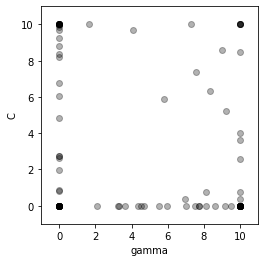

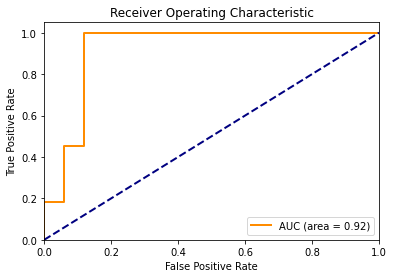

Accuracy for particle (in iteration 7, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 2.72951172e+00]
Accuracy for particle (in iteration 7, in fold 8) - 2 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 7, in fold 8) - 3 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 7, in fold 8) - 4 is 0.7143 At (gamma, c): [10.          0.34232502]
Accuracy for particle (in iteration 7, in fold 8) - 5 is 0.3929 At (gamma, c): [5.53441849e+00 1.00000000e-03]
Accuracy for particle (in iteration 7, in fold 8) - 6 is 0.3929 At (gamma, c): [4.49573597e+00 1.00000000e-03]
Accuracy for particle (in iteration 7, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 8.38733923e+00]
Accuracy for particle (in iteration 7, in fold 8) - 8 is 0.8929 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 7, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 7, in fold 8) - 10 is 0.8929 At (gamma, c):

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 7, in fold 8) - 99 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 7, in fold 8) - 100 is 0.3929 At (gamma, c): [8.61554832e+00 1.00000000e-03]
The best position in iteration 7, fold 8 is [9.45333827 9.7909025 ], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 8 - Fold 8:



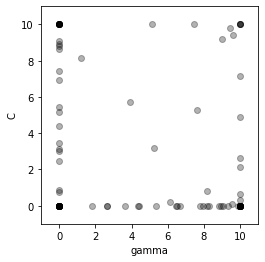

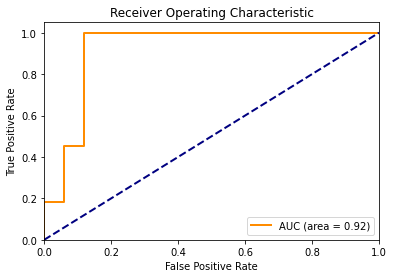

Accuracy for particle (in iteration 8, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 3.43711565e+00]
Accuracy for particle (in iteration 8, in fold 8) - 2 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 8, in fold 8) - 3 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 8, in fold 8) - 4 is 0.5000 At (gamma, c): [10.          0.32145661]
Accuracy for particle (in iteration 8, in fold 8) - 5 is 0.3929 At (gamma, c): [6.68562633e+00 1.00000000e-03]
Accuracy for particle (in iteration 8, in fold 8) - 6 is 0.3929 At (gamma, c): [2.65777102e+00 1.00000000e-03]
Accuracy for particle (in iteration 8, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 6.94975803e+00]
Accuracy for particle (in iteration 8, in fold 8) - 8 is 0.8929 At (gamma, c): [9.45333827 9.7909025 ]
Accuracy for particle (in iteration 8, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 8, in fold 8) - 10 is 0.8929 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 8, in fold 8) - 99 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 8, in fold 8) - 100 is 0.3929 At (gamma, c): [9.87187315e+00 1.00000000e-03]
The best position in iteration 8, fold 8 is [10. 10.], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 9 - Fold 8:



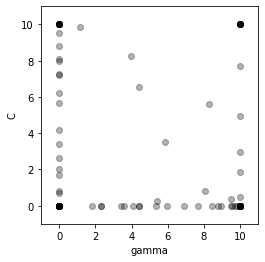

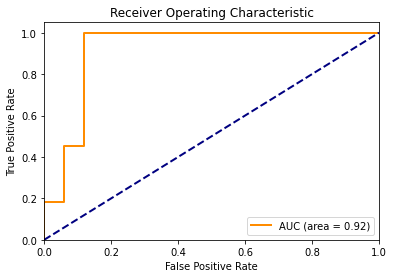

Accuracy for particle (in iteration 9, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 2.03194564e+00]
Accuracy for particle (in iteration 9, in fold 8) - 2 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 9, in fold 8) - 3 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 9, in fold 8) - 4 is 0.7143 At (gamma, c): [9.48904873 0.36481862]
Accuracy for particle (in iteration 9, in fold 8) - 5 is 0.3929 At (gamma, c): [4.41500703e+00 1.00000000e-03]
Accuracy for particle (in iteration 9, in fold 8) - 6 is 0.3929 At (gamma, c): [2.34148807e+00 1.00000000e-03]
Accuracy for particle (in iteration 9, in fold 8) - 7 is 0.7500 At (gamma, c): [1.0000000e-03 8.0087766e+00]
Accuracy for particle (in iteration 9, in fold 8) - 8 is 0.8929 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 9, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 9, in fold 8) - 10 is 0.8929 At (gamma, c): [10

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 9, in fold 8) - 97 is 0.7500 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 9, in fold 8) - 98 is 0.7500 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 9, in fold 8) - 99 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 9, in fold 8) - 100 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 9, fold 8 is [10. 10.], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 10 - Fold 8:



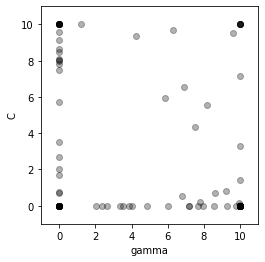

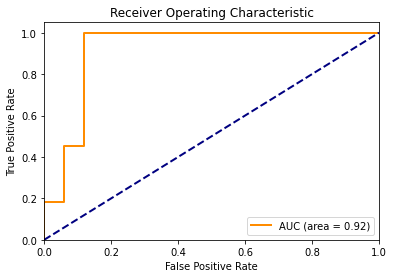

Accuracy for particle (in iteration 10, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 2.00905987e+00]
Accuracy for particle (in iteration 10, in fold 8) - 2 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 10, in fold 8) - 3 is 0.3929 At (gamma, c): [9.93857898 0.1315295 ]
Accuracy for particle (in iteration 10, in fold 8) - 4 is 0.8929 At (gamma, c): [6.79938776 0.54590037]
Accuracy for particle (in iteration 10, in fold 8) - 5 is 0.3929 At (gamma, c): [3.85778019e+00 1.00000000e-03]
Accuracy for particle (in iteration 10, in fold 8) - 6 is 0.3929 At (gamma, c): [2.38115061e+00 1.00000000e-03]
Accuracy for particle (in iteration 10, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 7.98115703e+00]
Accuracy for particle (in iteration 10, in fold 8) - 8 is 0.8929 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 10, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 10, in fold 8) - 10 is 0.892

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 10, in fold 8) - 98 is 0.7500 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 10, in fold 8) - 99 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 10, in fold 8) - 100 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 10, fold 8 is [10. 10.], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 11 - Fold 8:



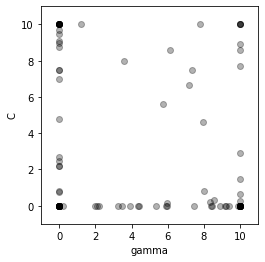

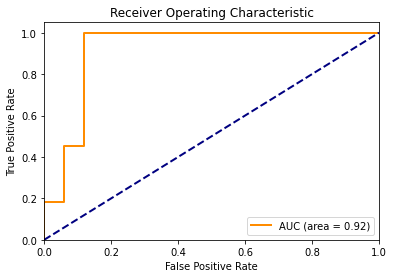

Accuracy for particle (in iteration 11, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 2.18887894e+00]
Accuracy for particle (in iteration 11, in fold 8) - 2 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 11, in fold 8) - 3 is 0.5000 At (gamma, c): [8.54373319 0.3013302 ]
Accuracy for particle (in iteration 11, in fold 8) - 4 is 0.4643 At (gamma, c): [10.          0.24133469]
Accuracy for particle (in iteration 11, in fold 8) - 5 is 0.3929 At (gamma, c): [3.47110201e+00 1.00000000e-03]
Accuracy for particle (in iteration 11, in fold 8) - 6 is 0.3929 At (gamma, c): [2.20346056e+00 1.00000000e-03]
Accuracy for particle (in iteration 11, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 7.47836146e+00]
Accuracy for particle (in iteration 11, in fold 8) - 8 is 0.8929 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 11, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 11, in fold 8) - 10 is 0.8

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 11, in fold 8) - 99 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 11, in fold 8) - 100 is 0.3929 At (gamma, c): [8.40293887e+00 1.00000000e-03]
The best position in iteration 11, fold 8 is [10. 10.], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 12 - Fold 8:



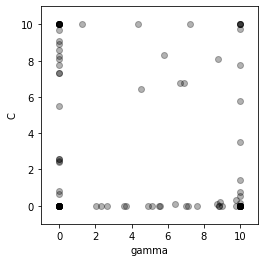

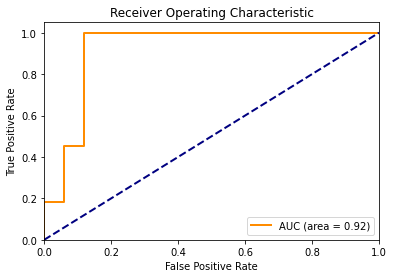

Accuracy for particle (in iteration 12, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 2.59561674e+00]
Accuracy for particle (in iteration 12, in fold 8) - 2 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 12, in fold 8) - 3 is 0.4286 At (gamma, c): [10.          0.14853862]
Accuracy for particle (in iteration 12, in fold 8) - 4 is 0.5000 At (gamma, c): [9.77230202 0.30831536]
Accuracy for particle (in iteration 12, in fold 8) - 5 is 0.3929 At (gamma, c): [4.90888772e+00 1.00000000e-03]
Accuracy for particle (in iteration 12, in fold 8) - 6 is 0.3929 At (gamma, c): [2.65274632e+00 1.00000000e-03]
Accuracy for particle (in iteration 12, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 7.78861064e+00]
Accuracy for particle (in iteration 12, in fold 8) - 8 is 0.8929 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 12, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 12, in fold 8) - 10 is 0.8

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 12, in fold 8) - 92 is 0.8929 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 12, in fold 8) - 93 is 0.7500 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 12, in fold 8) - 94 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 12, in fold 8) - 95 is 0.7500 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 12, in fold 8) - 96 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 12, in fold 8) - 97 is 0.7500 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 12, in fold 8) - 98 is 0.7500 At (gamma, c): [1.00000000e-03 8.94704665e+00]
Accuracy for particle (in iteration 12, in fold 8) - 99 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 12, in fold 8) - 100 is 0.3929 At (gamma, c): [9.75495918e+00 1.00000000e-03]
The best position in iteration 12, fold 8 is [10. 10.], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 

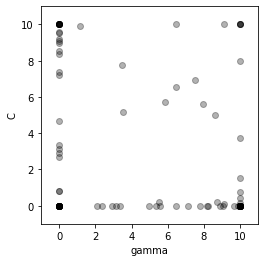

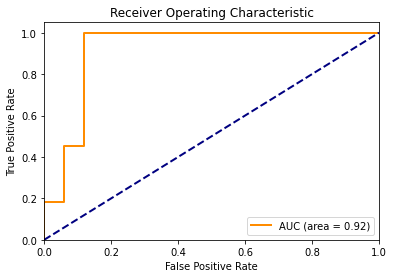

Accuracy for particle (in iteration 13, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 2.70583186e+00]
Accuracy for particle (in iteration 13, in fold 8) - 2 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 13, in fold 8) - 3 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 13, in fold 8) - 4 is 0.3929 At (gamma, c): [10.          0.14038655]
Accuracy for particle (in iteration 13, in fold 8) - 5 is 0.3929 At (gamma, c): [3.384081e+00 1.000000e-03]
Accuracy for particle (in iteration 13, in fold 8) - 6 is 0.3929 At (gamma, c): [3.13528029e+00 1.00000000e-03]
Accuracy for particle (in iteration 13, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 8.37171173e+00]
Accuracy for particle (in iteration 13, in fold 8) - 8 is 0.8929 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 13, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 13, in fold 8) - 10 is 0.8929 At (gamm

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 13, in fold 8) - 95 is 0.7500 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 13, in fold 8) - 96 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 13, in fold 8) - 97 is 0.7500 At (gamma, c): [1.00000000e-03 9.58682489e+00]
Accuracy for particle (in iteration 13, in fold 8) - 98 is 0.7500 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 13, in fold 8) - 99 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 13, in fold 8) - 100 is 0.3929 At (gamma, c): [7.77884259e+00 1.00000000e-03]
The best position in iteration 13, fold 8 is [9.12527799 9.43698625], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 14 - Fold 8:



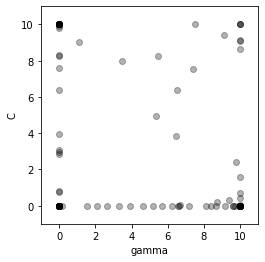

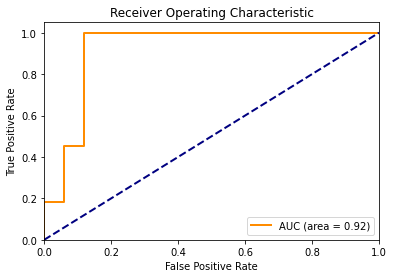

Accuracy for particle (in iteration 14, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 3.08943439e+00]
Accuracy for particle (in iteration 14, in fold 8) - 2 is 0.3929 At (gamma, c): [9.71344208e+00 1.00000000e-03]
Accuracy for particle (in iteration 14, in fold 8) - 3 is 0.3929 At (gamma, c): [10.          0.02964773]
Accuracy for particle (in iteration 14, in fold 8) - 4 is 0.5000 At (gamma, c): [9.38314059 0.29254535]
Accuracy for particle (in iteration 14, in fold 8) - 5 is 0.3929 At (gamma, c): [4.64381509e+00 1.00000000e-03]
Accuracy for particle (in iteration 14, in fold 8) - 6 is 0.3929 At (gamma, c): [2.65324423e+00 1.00000000e-03]
Accuracy for particle (in iteration 14, in fold 8) - 7 is 0.7500 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 14, in fold 8) - 8 is 0.8929 At (gamma, c): [9.12527799 9.43698625]
Accuracy for particle (in iteration 14, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 14, in fold 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 14, in fold 8) - 98 is 0.7500 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 14, in fold 8) - 99 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 14, in fold 8) - 100 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 14, fold 8 is [10. 10.], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 15 - Fold 8:



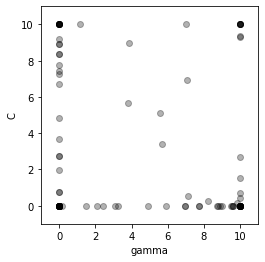

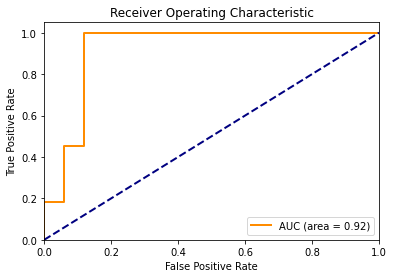

Accuracy for particle (in iteration 15, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 1.96055996e+00]
Accuracy for particle (in iteration 15, in fold 8) - 2 is 0.3929 At (gamma, c): [8.75550837e+00 1.00000000e-03]
Accuracy for particle (in iteration 15, in fold 8) - 3 is 0.4286 At (gamma, c): [9.79208306 0.1498354 ]
Accuracy for particle (in iteration 15, in fold 8) - 4 is 0.7143 At (gamma, c): [7.09319127 0.51018374]
Accuracy for particle (in iteration 15, in fold 8) - 5 is 0.3929 At (gamma, c): [3.06758852e+00 1.00000000e-03]
Accuracy for particle (in iteration 15, in fold 8) - 6 is 0.3929 At (gamma, c): [2.06858133e+00 1.00000000e-03]
Accuracy for particle (in iteration 15, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 8.93938587e+00]
Accuracy for particle (in iteration 15, in fold 8) - 8 is 0.8929 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 15, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 15, in fold 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 15, in fold 8) - 98 is 0.7500 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 15, in fold 8) - 99 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 15, in fold 8) - 100 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 15, fold 8 is [10. 10.], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 16 - Fold 8:



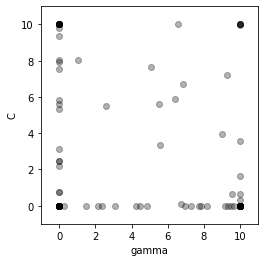

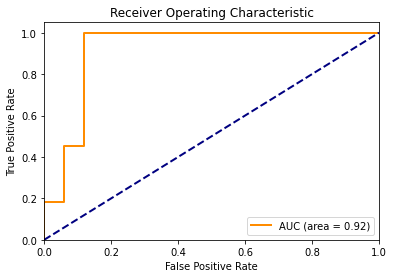

Accuracy for particle (in iteration 16, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 2.20641343e+00]
Accuracy for particle (in iteration 16, in fold 8) - 2 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 16, in fold 8) - 3 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 16, in fold 8) - 4 is 0.5000 At (gamma, c): [10.          0.31133456]
Accuracy for particle (in iteration 16, in fold 8) - 5 is 0.3929 At (gamma, c): [4.25055832e+00 1.00000000e-03]
Accuracy for particle (in iteration 16, in fold 8) - 6 is 0.3929 At (gamma, c): [2.15538083e+00 1.00000000e-03]
Accuracy for particle (in iteration 16, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 5.85183061e+00]
Accuracy for particle (in iteration 16, in fold 8) - 8 is 0.8929 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 16, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 16, in fold 8) - 10 is 0.8929 At (

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 16, in fold 8) - 99 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 16, in fold 8) - 100 is 0.3929 At (gamma, c): [7.82186519e+00 1.00000000e-03]
The best position in iteration 16, fold 8 is [8.64394216 8.94272242], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 17 - Fold 8:



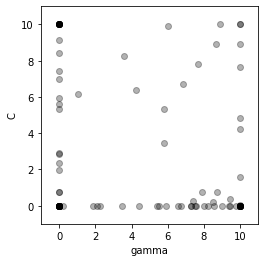

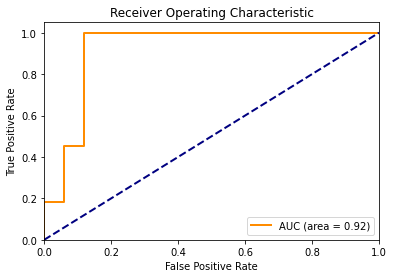

Accuracy for particle (in iteration 17, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 1.97579894e+00]
Accuracy for particle (in iteration 17, in fold 8) - 2 is 0.3929 At (gamma, c): [9.42290761e+00 1.00000000e-03]
Accuracy for particle (in iteration 17, in fold 8) - 3 is 0.3929 At (gamma, c): [10.          0.05297781]
Accuracy for particle (in iteration 17, in fold 8) - 4 is 0.7143 At (gamma, c): [9.43550346 0.36278364]
Accuracy for particle (in iteration 17, in fold 8) - 5 is 0.3929 At (gamma, c): [5.5142374e+00 1.0000000e-03]
Accuracy for particle (in iteration 17, in fold 8) - 6 is 0.3929 At (gamma, c): [2.11176903e+00 1.00000000e-03]
Accuracy for particle (in iteration 17, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 7.01473559e+00]
Accuracy for particle (in iteration 17, in fold 8) - 8 is 0.8929 At (gamma, c): [8.64394216 8.94272242]
Accuracy for particle (in iteration 17, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteratio

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 17, in fold 8) - 100 is 0.3929 At (gamma, c): [9.74645882e+00 1.00000000e-03]
The best position in iteration 17, fold 8 is [10. 10.], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 18 - Fold 8:



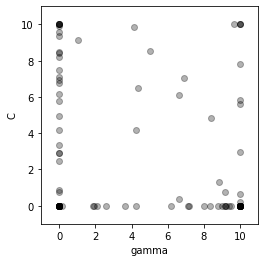

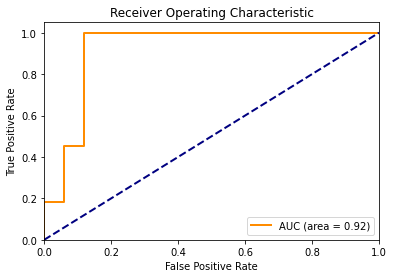

Accuracy for particle (in iteration 18, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 2.46444782e+00]
Accuracy for particle (in iteration 18, in fold 8) - 2 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 18, in fold 8) - 3 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 18, in fold 8) - 4 is 0.4643 At (gamma, c): [10.          0.19203329]
Accuracy for particle (in iteration 18, in fold 8) - 5 is 0.3929 At (gamma, c): [4.25594421e+00 1.00000000e-03]
Accuracy for particle (in iteration 18, in fold 8) - 6 is 0.3929 At (gamma, c): [1.89378874e+00 1.00000000e-03]
Accuracy for particle (in iteration 18, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 4.94952816e+00]
Accuracy for particle (in iteration 18, in fold 8) - 8 is 0.8929 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 18, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 18, in fold 8) - 10 is 0.8929 At (

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 18, in fold 8) - 98 is 0.7500 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 18, in fold 8) - 99 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 18, in fold 8) - 100 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 18, fold 8 is [9.24145124 9.53161284], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 19 - Fold 8:



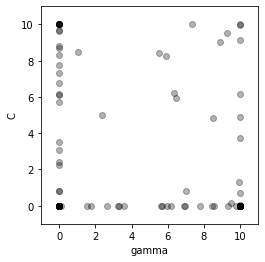

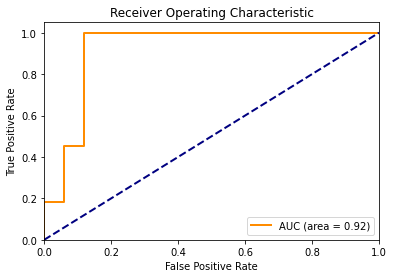

Accuracy for particle (in iteration 19, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 2.27068341e+00]
Accuracy for particle (in iteration 19, in fold 8) - 2 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 19, in fold 8) - 3 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 19, in fold 8) - 4 is 0.3929 At (gamma, c): [10.          0.04149706]
Accuracy for particle (in iteration 19, in fold 8) - 5 is 0.3929 At (gamma, c): [3.31426275e+00 1.00000000e-03]
Accuracy for particle (in iteration 19, in fold 8) - 6 is 0.3929 At (gamma, c): [2.67182424e+00 1.00000000e-03]
Accuracy for particle (in iteration 19, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 7.33715156e+00]
Accuracy for particle (in iteration 19, in fold 8) - 8 is 0.8929 At (gamma, c): [9.24145124 9.53161284]
Accuracy for particle (in iteration 19, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 19, in fold 8) - 10 

Accuracy for particle (in iteration 19, in fold 8) - 81 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 19, in fold 8) - 82 is 0.3929 At (gamma, c): [9.34629314e+00 1.00000000e-03]
Accuracy for particle (in iteration 19, in fold 8) - 83 is 0.8929 At (gamma, c): [10.          0.68132261]
Accuracy for particle (in iteration 19, in fold 8) - 84 is 0.7500 At (gamma, c): [1.00000000e-03 3.04527674e+00]
Accuracy for particle (in iteration 19, in fold 8) - 85 is 0.3929 At (gamma, c): [3.25020726e+00 1.00000000e-03]
Accuracy for particle (in iteration 19, in fold 8) - 86 is 0.3929 At (gamma, c): [1.78100116e+00 1.00000000e-03]
Accuracy for particle (in iteration 19, in fold 8) - 87 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 19, in fold 8) - 88 is 0.3929 At (gamma, c): [7.76929446e+00 1.00000000e-03]
Accuracy for particle (in iteration 19, in fold 8) - 89 is 0.3929 At (gamma, c): [6.20105637e+00 1.00000000e-03]
Accuracy for particle

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 19, in fold 8) - 100 is 0.3929 At (gamma, c): [8.53798974e+00 1.00000000e-03]
The best position in iteration 19, fold 8 is [8.02372874 8.43604013], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 20 - Fold 8:



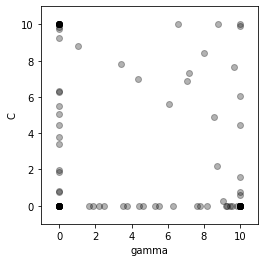

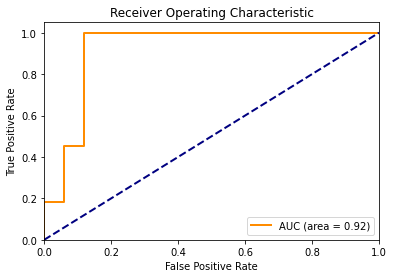

Accuracy for particle (in iteration 20, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 1.97665361e+00]
Accuracy for particle (in iteration 20, in fold 8) - 2 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 20, in fold 8) - 3 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 20, in fold 8) - 4 is 0.4643 At (gamma, c): [9.03909858 0.27091747]
Accuracy for particle (in iteration 20, in fold 8) - 5 is 0.3929 At (gamma, c): [3.53774862e+00 1.00000000e-03]
Accuracy for particle (in iteration 20, in fold 8) - 6 is 0.3929 At (gamma, c): [2.21370485e+00 1.00000000e-03]
Accuracy for particle (in iteration 20, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 6.33469247e+00]
Accuracy for particle (in iteration 20, in fold 8) - 8 is 0.8929 At (gamma, c): [8.02372874 8.43604013]
Accuracy for particle (in iteration 20, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 20, in fold 8) - 10 is

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 20, in fold 8) - 100 is 0.3929 At (gamma, c): [9.26283196e+00 1.00000000e-03]
The best position in iteration 20, fold 8 is [ 9.64913685 10.        ], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 21 - Fold 8:



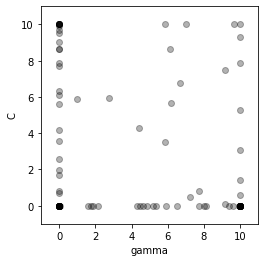

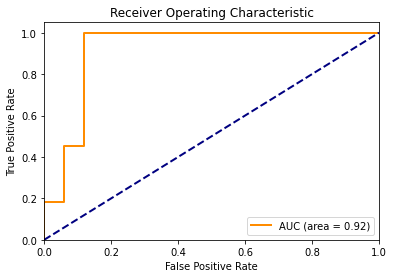

Accuracy for particle (in iteration 21, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 1.96526814e+00]
Accuracy for particle (in iteration 21, in fold 8) - 2 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 21, in fold 8) - 3 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 21, in fold 8) - 4 is 0.7143 At (gamma, c): [7.20856842 0.48475434]
Accuracy for particle (in iteration 21, in fold 8) - 5 is 0.3929 At (gamma, c): [4.46339085e+00 1.00000000e-03]
Accuracy for particle (in iteration 21, in fold 8) - 6 is 0.3929 At (gamma, c): [1.86825862e+00 1.00000000e-03]
Accuracy for particle (in iteration 21, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 5.63744506e+00]
Accuracy for particle (in iteration 21, in fold 8) - 8 is 0.8929 At (gamma, c): [ 9.64913685 10.        ]
Accuracy for particle (in iteration 21, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 21, in fold 8) - 10 

Accuracy for particle (in iteration 21, in fold 8) - 81 is 0.3929 At (gamma, c): [7.74836381e+00 1.00000000e-03]
Accuracy for particle (in iteration 21, in fold 8) - 82 is 0.3929 At (gamma, c): [4.8504626e+00 1.0000000e-03]
Accuracy for particle (in iteration 21, in fold 8) - 83 is 0.8929 At (gamma, c): [10.          0.58177589]
Accuracy for particle (in iteration 21, in fold 8) - 84 is 0.7500 At (gamma, c): [1.00000000e-03 1.71471198e+00]
Accuracy for particle (in iteration 21, in fold 8) - 85 is 0.3929 At (gamma, c): [4.61139153e+00 1.00000000e-03]
Accuracy for particle (in iteration 21, in fold 8) - 86 is 0.3929 At (gamma, c): [1.58600832e+00 1.00000000e-03]
Accuracy for particle (in iteration 21, in fold 8) - 87 is 0.3929 At (gamma, c): [9.58566302e+00 1.00000000e-03]
Accuracy for particle (in iteration 21, in fold 8) - 88 is 0.3929 At (gamma, c): [5.21098689e+00 1.00000000e-03]
Accuracy for particle (in iteration 21, in fold 8) - 89 is 0.3929 At (gamma, c): [4.29989718e+00 1.00000

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


The best position in iteration 21, fold 8 is [10. 10.], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 22 - Fold 8:



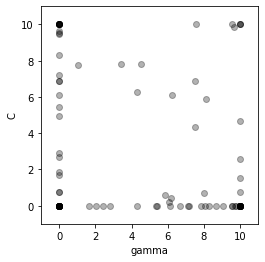

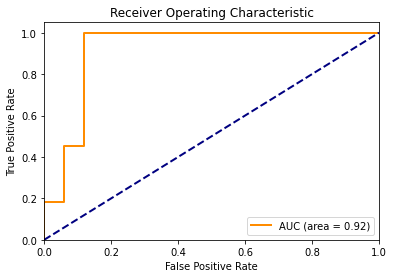

Accuracy for particle (in iteration 22, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 1.70298937e+00]
Accuracy for particle (in iteration 22, in fold 8) - 2 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 22, in fold 8) - 3 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 22, in fold 8) - 4 is 0.8929 At (gamma, c): [5.8498384  0.60342152]
Accuracy for particle (in iteration 22, in fold 8) - 5 is 0.3929 At (gamma, c): [5.3433842e+00 1.0000000e-03]
Accuracy for particle (in iteration 22, in fold 8) - 6 is 0.3929 At (gamma, c): [2.43984519e+00 1.00000000e-03]
Accuracy for particle (in iteration 22, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 5.46104695e+00]
Accuracy for particle (in iteration 22, in fold 8) - 8 is 0.8929 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 22, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 22, in fold 8) - 10 is 0.8929 At (gamm

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 22, in fold 8) - 100 is 0.3929 At (gamma, c): [6.10183955e+00 1.00000000e-03]
The best position in iteration 22, fold 8 is [10. 10.], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 23 - Fold 8:



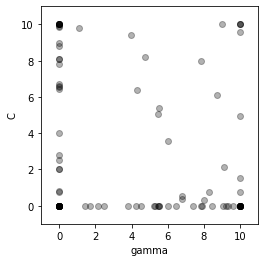

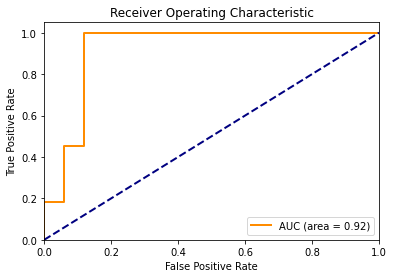

Accuracy for particle (in iteration 23, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 2.00761001e+00]
Accuracy for particle (in iteration 23, in fold 8) - 2 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 23, in fold 8) - 3 is 0.5000 At (gamma, c): [8.01975634 0.30657256]
Accuracy for particle (in iteration 23, in fold 8) - 4 is 0.8929 At (gamma, c): [6.79127862 0.54534921]
Accuracy for particle (in iteration 23, in fold 8) - 5 is 0.3929 At (gamma, c): [5.48048556e+00 1.00000000e-03]
Accuracy for particle (in iteration 23, in fold 8) - 6 is 0.3929 At (gamma, c): [2.48926925e+00 1.00000000e-03]
Accuracy for particle (in iteration 23, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 6.41902999e+00]
Accuracy for particle (in iteration 23, in fold 8) - 8 is 0.8929 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 23, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 23, in fold 8) - 10 is 0.892

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 23, in fold 8) - 95 is 0.7500 At (gamma, c): [1.00000000e-03 8.08598945e+00]
Accuracy for particle (in iteration 23, in fold 8) - 96 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 23, in fold 8) - 97 is 0.7500 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 23, in fold 8) - 98 is 0.7500 At (gamma, c): [1.00000000e-03 7.82863108e+00]
Accuracy for particle (in iteration 23, in fold 8) - 99 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 23, in fold 8) - 100 is 0.3929 At (gamma, c): [9.22294918e+00 1.00000000e-03]
The best position in iteration 23, fold 8 is [9.18808711 9.45670206], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 24 - Fold 8:



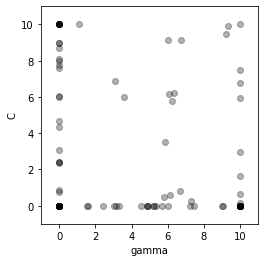

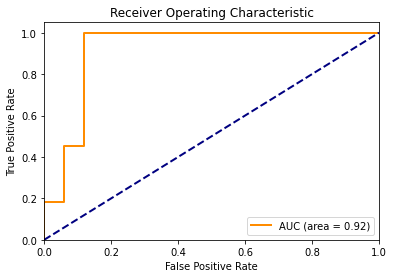

Accuracy for particle (in iteration 24, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 2.42965715e+00]
Accuracy for particle (in iteration 24, in fold 8) - 2 is 0.3929 At (gamma, c): [7.46581592e+00 1.00000000e-03]
Accuracy for particle (in iteration 24, in fold 8) - 3 is 0.4286 At (gamma, c): [10.          0.16164446]
Accuracy for particle (in iteration 24, in fold 8) - 4 is 0.8929 At (gamma, c): [6.094845   0.59219997]
Accuracy for particle (in iteration 24, in fold 8) - 5 is 0.3929 At (gamma, c): [3.16883403e+00 1.00000000e-03]
Accuracy for particle (in iteration 24, in fold 8) - 6 is 0.3929 At (gamma, c): [3.0307421e+00 1.0000000e-03]
Accuracy for particle (in iteration 24, in fold 8) - 7 is 0.7857 At (gamma, c): [1.00000000e-03 4.67993758e+00]
Accuracy for particle (in iteration 24, in fold 8) - 8 is 0.8929 At (gamma, c): [9.18808711 9.45670206]
Accuracy for particle (in iteration 24, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteratio

Accuracy for particle (in iteration 24, in fold 8) - 80 is 0.7500 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 24, in fold 8) - 81 is 0.3929 At (gamma, c): [6.01424048e+00 1.00000000e-03]
Accuracy for particle (in iteration 24, in fold 8) - 82 is 0.3929 At (gamma, c): [4.5413129e+00 1.0000000e-03]
Accuracy for particle (in iteration 24, in fold 8) - 83 is 0.8929 At (gamma, c): [10.          0.62845472]
Accuracy for particle (in iteration 24, in fold 8) - 84 is 0.7500 At (gamma, c): [1.0000000e-03 2.3608524e+00]
Accuracy for particle (in iteration 24, in fold 8) - 85 is 0.3929 At (gamma, c): [3.28951567e+00 1.00000000e-03]
Accuracy for particle (in iteration 24, in fold 8) - 86 is 0.3929 At (gamma, c): [1.55441571e+00 1.00000000e-03]
Accuracy for particle (in iteration 24, in fold 8) - 87 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 24, in fold 8) - 88 is 0.3929 At (gamma, c): [5.2664441e+00 1.0000000e-03]
Accuracy for particle (in i

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 24, in fold 8) - 99 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 24, in fold 8) - 100 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 24, fold 8 is [4.98828941 5.28021359], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 25 - Fold 8:



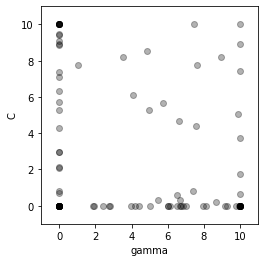

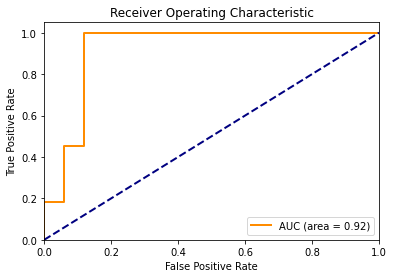

Accuracy for particle (in iteration 25, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 2.95109349e+00]
Accuracy for particle (in iteration 25, in fold 8) - 2 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 25, in fold 8) - 3 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 25, in fold 8) - 4 is 0.8929 At (gamma, c): [6.5089195  0.56556391]
Accuracy for particle (in iteration 25, in fold 8) - 5 is 0.3929 At (gamma, c): [2.83305151e+00 1.00000000e-03]
Accuracy for particle (in iteration 25, in fold 8) - 6 is 0.3929 At (gamma, c): [2.44385275e+00 1.00000000e-03]
Accuracy for particle (in iteration 25, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 5.30153146e+00]
Accuracy for particle (in iteration 25, in fold 8) - 8 is 0.8929 At (gamma, c): [4.98828941 5.28021359]
Accuracy for particle (in iteration 25, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 25, in fold 8) - 10 is

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 25, in fold 8) - 99 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 25, in fold 8) - 100 is 0.3929 At (gamma, c): [9.78728847e+00 1.00000000e-03]
The best position in iteration 25, fold 8 is [6.36987901 6.79405196], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 26 - Fold 8:



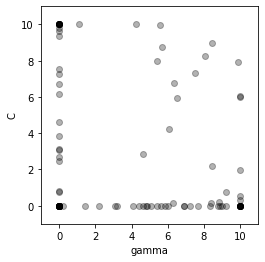

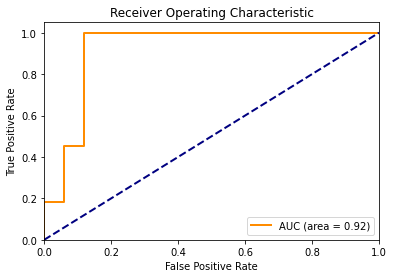

Accuracy for particle (in iteration 26, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 3.07367734e+00]
Accuracy for particle (in iteration 26, in fold 8) - 2 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 26, in fold 8) - 3 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 26, in fold 8) - 4 is 0.5000 At (gamma, c): [10.          0.33681349]
Accuracy for particle (in iteration 26, in fold 8) - 5 is 0.3929 At (gamma, c): [4.07871672e+00 1.00000000e-03]
Accuracy for particle (in iteration 26, in fold 8) - 6 is 0.3929 At (gamma, c): [3.0931192e+00 1.0000000e-03]
Accuracy for particle (in iteration 26, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 7.24588408e+00]
Accuracy for particle (in iteration 26, in fold 8) - 8 is 0.8929 At (gamma, c): [6.36987901 6.79405196]
Accuracy for particle (in iteration 26, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 26, in fold 8) - 10 is

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 26, in fold 8) - 99 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 26, in fold 8) - 100 is 0.3929 At (gamma, c): [5.86548567e+00 1.00000000e-03]
The best position in iteration 26, fold 8 is [4.88858854 5.21086549], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 27 - Fold 8:



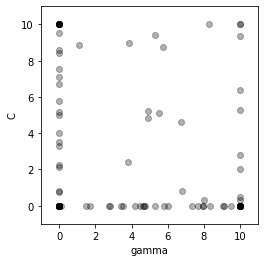

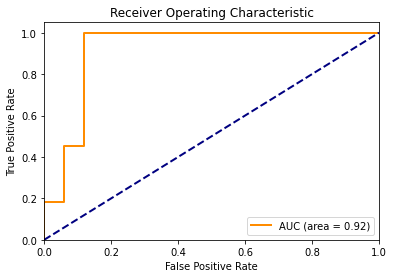

Accuracy for particle (in iteration 27, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 2.22782053e+00]
Accuracy for particle (in iteration 27, in fold 8) - 2 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 27, in fold 8) - 3 is 0.5000 At (gamma, c): [7.99063412 0.3030395 ]
Accuracy for particle (in iteration 27, in fold 8) - 4 is 0.5000 At (gamma, c): [10.          0.29004884]
Accuracy for particle (in iteration 27, in fold 8) - 5 is 0.3929 At (gamma, c): [3.42547254e+00 1.00000000e-03]
Accuracy for particle (in iteration 27, in fold 8) - 6 is 0.3929 At (gamma, c): [2.80244846e+00 1.00000000e-03]
Accuracy for particle (in iteration 27, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 6.69403614e+00]
Accuracy for particle (in iteration 27, in fold 8) - 8 is 0.8929 At (gamma, c): [4.88858854 5.21086549]
Accuracy for particle (in iteration 27, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 27, in fold 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 27, in fold 8) - 99 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 27, in fold 8) - 100 is 0.3929 At (gamma, c): [7.69347353e+00 1.00000000e-03]
The best position in iteration 27, fold 8 is [4.99079326 5.32426722], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 28 - Fold 8:



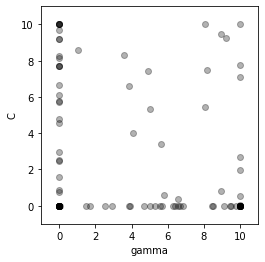

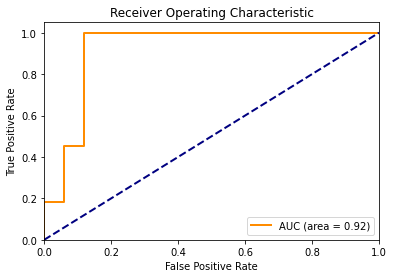

Accuracy for particle (in iteration 28, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 2.54637322e+00]
Accuracy for particle (in iteration 28, in fold 8) - 2 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 28, in fold 8) - 3 is 0.3929 At (gamma, c): [10.         0.0202797]
Accuracy for particle (in iteration 28, in fold 8) - 4 is 0.8929 At (gamma, c): [5.81118228 0.60439471]
Accuracy for particle (in iteration 28, in fold 8) - 5 is 0.3929 At (gamma, c): [4.70350516e+00 1.00000000e-03]
Accuracy for particle (in iteration 28, in fold 8) - 6 is 0.3929 At (gamma, c): [2.53379593e+00 1.00000000e-03]
Accuracy for particle (in iteration 28, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 8.13099222e+00]
Accuracy for particle (in iteration 28, in fold 8) - 8 is 0.8929 At (gamma, c): [4.99079326 5.32426722]
Accuracy for particle (in iteration 28, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 28, in fold 8)

Accuracy for particle (in iteration 28, in fold 8) - 80 is 0.7500 At (gamma, c): [1.00000000e-03 9.21218645e+00]
Accuracy for particle (in iteration 28, in fold 8) - 81 is 0.3929 At (gamma, c): [5.31093448e+00 1.00000000e-03]
Accuracy for particle (in iteration 28, in fold 8) - 82 is 0.3929 At (gamma, c): [6.70067872e+00 1.00000000e-03]
Accuracy for particle (in iteration 28, in fold 8) - 83 is 0.8929 At (gamma, c): [10.          0.54111446]
Accuracy for particle (in iteration 28, in fold 8) - 84 is 0.7500 At (gamma, c): [1.00000000e-03 1.57724945e+00]
Accuracy for particle (in iteration 28, in fold 8) - 85 is 0.3929 At (gamma, c): [6.58403839e+00 1.00000000e-03]
Accuracy for particle (in iteration 28, in fold 8) - 86 is 0.3929 At (gamma, c): [1.7030625e+00 1.0000000e-03]
Accuracy for particle (in iteration 28, in fold 8) - 87 is 0.3929 At (gamma, c): [8.48522197e+00 1.00000000e-03]
Accuracy for particle (in iteration 28, in fold 8) - 88 is 0.3929 At (gamma, c): [3.84450969e+00 1.00000

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 28, in fold 8) - 99 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 28, in fold 8) - 100 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 28, fold 8 is [7.56246619 8.10775545], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 29 - Fold 8:



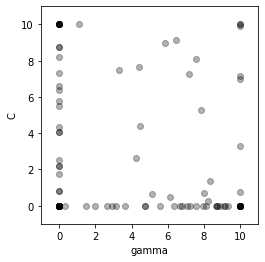

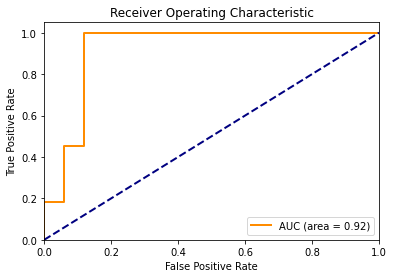

Accuracy for particle (in iteration 29, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 2.19614377e+00]
Accuracy for particle (in iteration 29, in fold 8) - 2 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 29, in fold 8) - 3 is 0.7143 At (gamma, c): [6.14000534 0.49115133]
Accuracy for particle (in iteration 29, in fold 8) - 4 is 0.8929 At (gamma, c): [5.10971522 0.6558628 ]
Accuracy for particle (in iteration 29, in fold 8) - 5 is 0.3929 At (gamma, c): [3.66454858e+00 1.00000000e-03]
Accuracy for particle (in iteration 29, in fold 8) - 6 is 0.3929 At (gamma, c): [3.16011234e+00 1.00000000e-03]
Accuracy for particle (in iteration 29, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 8.76358343e+00]
Accuracy for particle (in iteration 29, in fold 8) - 8 is 0.8929 At (gamma, c): [7.56246619 8.10775545]
Accuracy for particle (in iteration 29, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 29, in fold 8)

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 29, in fold 8) - 98 is 0.7500 At (gamma, c): [1.00000000e-03 6.38101538e+00]
Accuracy for particle (in iteration 29, in fold 8) - 99 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 29, in fold 8) - 100 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 29, fold 8 is [9.16196959 9.83911209], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 30 - Fold 8:



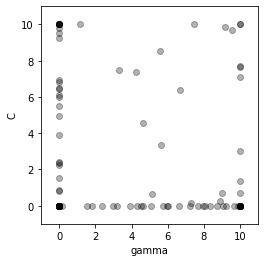

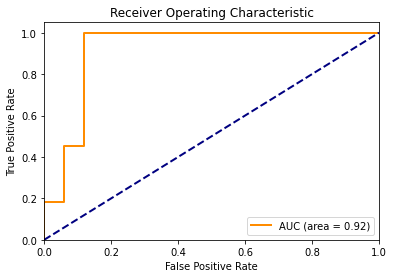

Accuracy for particle (in iteration 30, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 2.43195798e+00]
Accuracy for particle (in iteration 30, in fold 8) - 2 is 0.3929 At (gamma, c): [9.198915e+00 1.000000e-03]
Accuracy for particle (in iteration 30, in fold 8) - 3 is 0.4643 At (gamma, c): [8.89997131 0.27549011]
Accuracy for particle (in iteration 30, in fold 8) - 4 is 0.8929 At (gamma, c): [5.15102443 0.6538675 ]
Accuracy for particle (in iteration 30, in fold 8) - 5 is 0.3929 At (gamma, c): [4.62532534e+00 1.00000000e-03]
Accuracy for particle (in iteration 30, in fold 8) - 6 is 0.3929 At (gamma, c): [2.37816552e+00 1.00000000e-03]
Accuracy for particle (in iteration 30, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 9.77977071e+00]
Accuracy for particle (in iteration 30, in fold 8) - 8 is 0.8929 At (gamma, c): [9.16196959 9.83911209]
Accuracy for particle (in iteration 30, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 30

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 30, in fold 8) - 98 is 0.7500 At (gamma, c): [1.00000000e-03 6.08595124e+00]
Accuracy for particle (in iteration 30, in fold 8) - 99 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 30, in fold 8) - 100 is 0.3929 At (gamma, c): [6.03428369e+00 1.00000000e-03]
The best position in iteration 30, fold 8 is [7.82134822 8.38847188], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 31 - Fold 8:



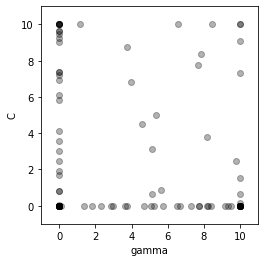

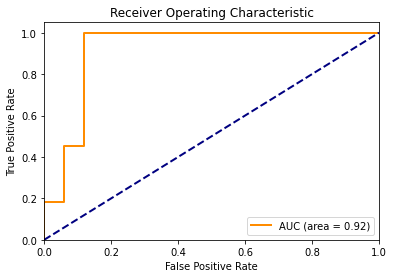

Accuracy for particle (in iteration 31, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 1.66991842e+00]
Accuracy for particle (in iteration 31, in fold 8) - 2 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 31, in fold 8) - 3 is 0.4643 At (gamma, c): [10.          0.16747173]
Accuracy for particle (in iteration 31, in fold 8) - 4 is 0.8929 At (gamma, c): [5.10197557 0.65717419]
Accuracy for particle (in iteration 31, in fold 8) - 5 is 0.3929 At (gamma, c): [3.7296233e+00 1.0000000e-03]
Accuracy for particle (in iteration 31, in fold 8) - 6 is 0.3929 At (gamma, c): [2.86810176e+00 1.00000000e-03]
Accuracy for particle (in iteration 31, in fold 8) - 7 is 0.7500 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 31, in fold 8) - 8 is 0.8929 At (gamma, c): [7.82134822 8.38847188]
Accuracy for particle (in iteration 31, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 31, in fold 8) - 10 is 0.8929 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 31, in fold 8) - 98 is 0.7500 At (gamma, c): [1.00000000e-03 6.08433944e+00]
Accuracy for particle (in iteration 31, in fold 8) - 99 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 31, in fold 8) - 100 is 0.3929 At (gamma, c): [6.70096028e+00 1.00000000e-03]
The best position in iteration 31, fold 8 is [7.70469672 8.26235825], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 32 - Fold 8:



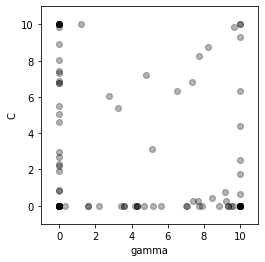

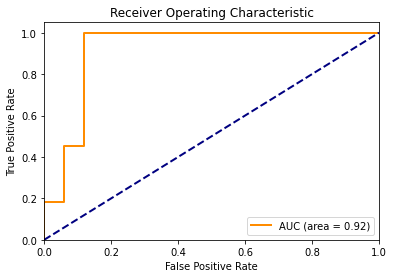

Accuracy for particle (in iteration 32, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 1.89206416e+00]
Accuracy for particle (in iteration 32, in fold 8) - 2 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 32, in fold 8) - 3 is 0.4643 At (gamma, c): [9.23945882 0.24657422]
Accuracy for particle (in iteration 32, in fold 8) - 4 is 0.7143 At (gamma, c): [8.45184436 0.43935132]
Accuracy for particle (in iteration 32, in fold 8) - 5 is 0.3929 At (gamma, c): [4.66089136e+00 1.00000000e-03]
Accuracy for particle (in iteration 32, in fold 8) - 6 is 0.3929 At (gamma, c): [3.3961768e+00 1.0000000e-03]
Accuracy for particle (in iteration 32, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 6.76657983e+00]
Accuracy for particle (in iteration 32, in fold 8) - 8 is 0.8929 At (gamma, c): [7.70469672 8.26235825]
Accuracy for particle (in iteration 32, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 32, in fold 8) -

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 32, in fold 8) - 99 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 32, in fold 8) - 100 is 0.3929 At (gamma, c): [7.71787656e+00 1.00000000e-03]
The best position in iteration 32, fold 8 is [4.49006002 4.7832407 ], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 33 - Fold 8:



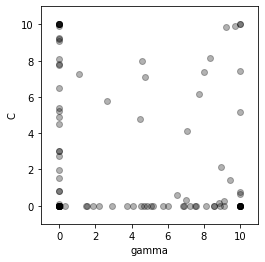

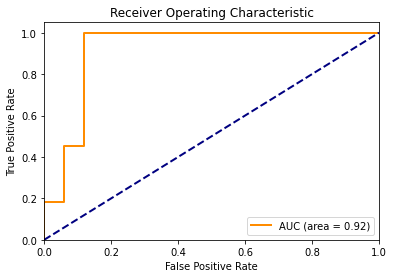

Accuracy for particle (in iteration 33, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 1.53331136e+00]
Accuracy for particle (in iteration 33, in fold 8) - 2 is 0.3929 At (gamma, c): [6.85952583e+00 1.00000000e-03]
Accuracy for particle (in iteration 33, in fold 8) - 3 is 0.4643 At (gamma, c): [9.08795983 0.26681802]
Accuracy for particle (in iteration 33, in fold 8) - 4 is 0.8929 At (gamma, c): [6.50281241 0.56610276]
Accuracy for particle (in iteration 33, in fold 8) - 5 is 0.3929 At (gamma, c): [4.69859744e+00 1.00000000e-03]
Accuracy for particle (in iteration 33, in fold 8) - 6 is 0.3929 At (gamma, c): [1.85733229e+00 1.00000000e-03]
Accuracy for particle (in iteration 33, in fold 8) - 7 is 0.7857 At (gamma, c): [1.00000000e-03 4.53473576e+00]
Accuracy for particle (in iteration 33, in fold 8) - 8 is 0.8929 At (gamma, c): [4.49006002 4.7832407 ]
Accuracy for particle (in iteration 33, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteratio

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 33, in fold 8) - 98 is 0.7500 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 33, in fold 8) - 99 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 33, in fold 8) - 100 is 0.3929 At (gamma, c): [6.88678683e+00 1.00000000e-03]
The best position in iteration 33, fold 8 is [5.51085305 5.8880815 ], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 34 - Fold 8:



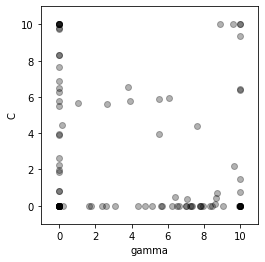

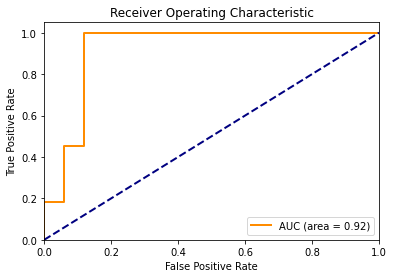

Accuracy for particle (in iteration 34, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 1.86409186e+00]
Accuracy for particle (in iteration 34, in fold 8) - 2 is 0.3929 At (gamma, c): [7.96248688e+00 1.00000000e-03]
Accuracy for particle (in iteration 34, in fold 8) - 3 is 0.7143 At (gamma, c): [6.3755725  0.49079122]
Accuracy for particle (in iteration 34, in fold 8) - 4 is 0.7143 At (gamma, c): [8.64215969 0.42699453]
Accuracy for particle (in iteration 34, in fold 8) - 5 is 0.3929 At (gamma, c): [5.6472656e+00 1.0000000e-03]
Accuracy for particle (in iteration 34, in fold 8) - 6 is 0.3929 At (gamma, c): [2.35368381e+00 1.00000000e-03]
Accuracy for particle (in iteration 34, in fold 8) - 7 is 0.7500 At (gamma, c): [1.0000000e-03 3.8960984e+00]
Accuracy for particle (in iteration 34, in fold 8) - 8 is 0.8929 At (gamma, c): [5.51085305 5.8880815 ]
Accuracy for particle (in iteration 34, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 34

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 34, in fold 8) - 94 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 34, in fold 8) - 95 is 0.7500 At (gamma, c): [1.00000000e-03 6.89301803e+00]
Accuracy for particle (in iteration 34, in fold 8) - 96 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 34, in fold 8) - 97 is 0.7500 At (gamma, c): [1.00000000e-03 8.29251742e+00]
Accuracy for particle (in iteration 34, in fold 8) - 98 is 0.7500 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 34, in fold 8) - 99 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 34, in fold 8) - 100 is 0.3929 At (gamma, c): [8.42537919e+00 1.00000000e-03]
The best position in iteration 34, fold 8 is [4.9901788  5.32455011], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Itera

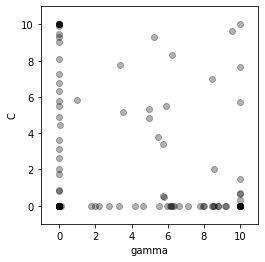

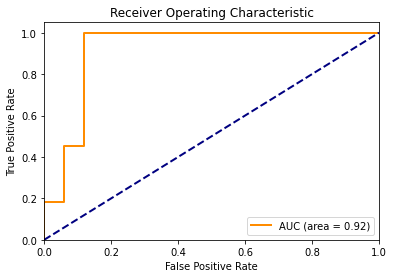

Accuracy for particle (in iteration 35, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 2.02618858e+00]
Accuracy for particle (in iteration 35, in fold 8) - 2 is 0.3929 At (gamma, c): [7.97381307e+00 1.00000000e-03]
Accuracy for particle (in iteration 35, in fold 8) - 3 is 0.8929 At (gamma, c): [5.72505245 0.54422918]
Accuracy for particle (in iteration 35, in fold 8) - 4 is 0.5000 At (gamma, c): [10.          0.31326283]
Accuracy for particle (in iteration 35, in fold 8) - 5 is 0.3929 At (gamma, c): [6.21844624e+00 1.00000000e-03]
Accuracy for particle (in iteration 35, in fold 8) - 6 is 0.3929 At (gamma, c): [2.20445423e+00 1.00000000e-03]
Accuracy for particle (in iteration 35, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 5.52307092e+00]
Accuracy for particle (in iteration 35, in fold 8) - 8 is 0.8929 At (gamma, c): [4.9901788  5.32455011]
Accuracy for particle (in iteration 35, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iterat

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 35, in fold 8) - 98 is 0.7500 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 35, in fold 8) - 99 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 35, in fold 8) - 100 is 0.3929 At (gamma, c): [8.78341682e+00 1.00000000e-03]
The best position in iteration 35, fold 8 is [5.72654103 6.12153541], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 36 - Fold 8:



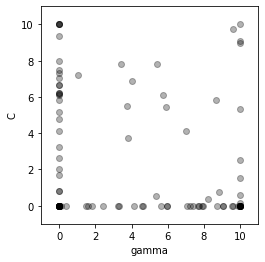

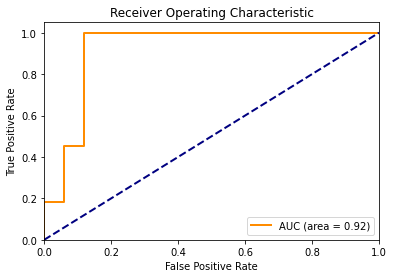

Accuracy for particle (in iteration 36, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 2.05084963e+00]
Accuracy for particle (in iteration 36, in fold 8) - 2 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 36, in fold 8) - 3 is 0.7143 At (gamma, c): [8.2325391  0.34354753]
Accuracy for particle (in iteration 36, in fold 8) - 4 is 0.3929 At (gamma, c): [10.         0.1218426]
Accuracy for particle (in iteration 36, in fold 8) - 5 is 0.3929 At (gamma, c): [3.28908497e+00 1.00000000e-03]
Accuracy for particle (in iteration 36, in fold 8) - 6 is 0.3929 At (gamma, c): [1.82226124e+00 1.00000000e-03]
Accuracy for particle (in iteration 36, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 6.68667986e+00]
Accuracy for particle (in iteration 36, in fold 8) - 8 is 0.8929 At (gamma, c): [5.72654103 6.12153541]
Accuracy for particle (in iteration 36, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 36, in fold 8)

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 36, in fold 8) - 96 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 36, in fold 8) - 97 is 0.7500 At (gamma, c): [1.00000000e-03 6.14781243e+00]
Accuracy for particle (in iteration 36, in fold 8) - 98 is 0.7500 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 36, in fold 8) - 99 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 36, in fold 8) - 100 is 0.3929 At (gamma, c): [9.55028049e+00 1.00000000e-03]
The best position in iteration 36, fold 8 is [7.32120768 7.84748446], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 37 - Fold 8:



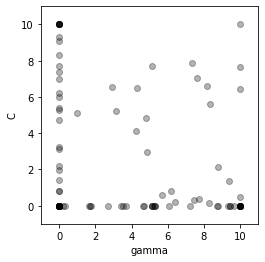

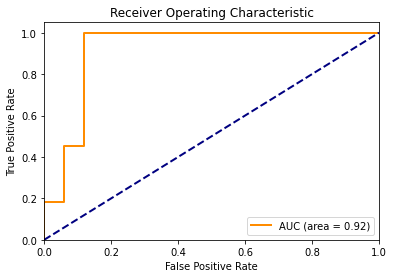

Accuracy for particle (in iteration 37, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 2.18061944e+00]
Accuracy for particle (in iteration 37, in fold 8) - 2 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 37, in fold 8) - 3 is 0.7143 At (gamma, c): [7.73988998 0.38312505]
Accuracy for particle (in iteration 37, in fold 8) - 4 is 0.8929 At (gamma, c): [5.67685505 0.57981067]
Accuracy for particle (in iteration 37, in fold 8) - 5 is 0.3929 At (gamma, c): [3.70823451e+00 1.00000000e-03]
Accuracy for particle (in iteration 37, in fold 8) - 6 is 0.3929 At (gamma, c): [1.65823756e+00 1.00000000e-03]
Accuracy for particle (in iteration 37, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 8.31357853e+00]
Accuracy for particle (in iteration 37, in fold 8) - 8 is 0.8929 At (gamma, c): [7.32120768 7.84748446]
Accuracy for particle (in iteration 37, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 37, in fold 8)

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 37, in fold 8) - 97 is 0.7500 At (gamma, c): [1.00000000e-03 6.97103089e+00]
Accuracy for particle (in iteration 37, in fold 8) - 98 is 0.7500 At (gamma, c): [1.00000000e-03 9.31010694e+00]
Accuracy for particle (in iteration 37, in fold 8) - 99 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 37, in fold 8) - 100 is 0.3929 At (gamma, c): [5.1171425e+00 1.0000000e-03]
The best position in iteration 37, fold 8 is [9.06396878 9.73371974], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 38 - Fold 8:



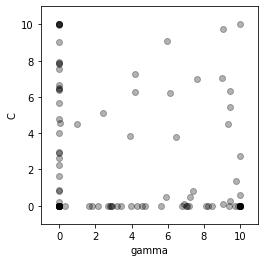

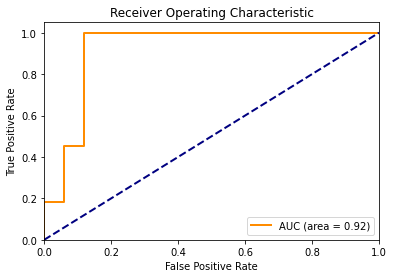

Accuracy for particle (in iteration 38, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 2.23336632e+00]
Accuracy for particle (in iteration 38, in fold 8) - 2 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 38, in fold 8) - 3 is 0.4643 At (gamma, c): [9.44486153 0.24664609]
Accuracy for particle (in iteration 38, in fold 8) - 4 is 0.7143 At (gamma, c): [7.21301494 0.49236163]
Accuracy for particle (in iteration 38, in fold 8) - 5 is 0.3929 At (gamma, c): [2.7253097e+00 1.0000000e-03]
Accuracy for particle (in iteration 38, in fold 8) - 6 is 0.3929 At (gamma, c): [2.13541813e+00 1.00000000e-03]
Accuracy for particle (in iteration 38, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 5.66539554e+00]
Accuracy for particle (in iteration 38, in fold 8) - 8 is 0.8929 At (gamma, c): [9.06396878 9.73371974]
Accuracy for particle (in iteration 38, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 38, in fold 8) -

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 38, in fold 8) - 99 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 38, in fold 8) - 100 is 0.3929 At (gamma, c): [8.23508414e+00 1.00000000e-03]
The best position in iteration 38, fold 8 is [8.34682933 8.95754177], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 39 - Fold 8:



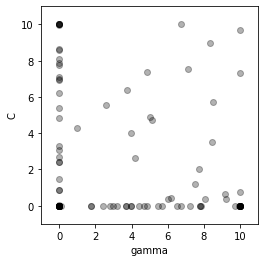

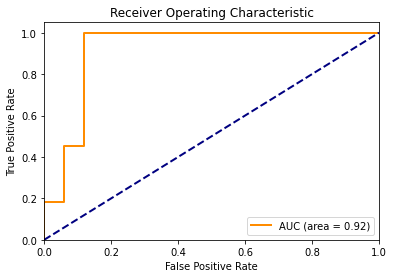

Accuracy for particle (in iteration 39, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 2.39108384e+00]
Accuracy for particle (in iteration 39, in fold 8) - 2 is 0.3929 At (gamma, c): [9.95010645e+00 1.00000000e-03]
Accuracy for particle (in iteration 39, in fold 8) - 3 is 0.7143 At (gamma, c): [8.05577582 0.35790537]
Accuracy for particle (in iteration 39, in fold 8) - 4 is 0.7143 At (gamma, c): [9.20818041 0.36681652]
Accuracy for particle (in iteration 39, in fold 8) - 5 is 0.3929 At (gamma, c): [3.66676645e+00 1.00000000e-03]
Accuracy for particle (in iteration 39, in fold 8) - 6 is 0.3929 At (gamma, c): [2.42528376e+00 1.00000000e-03]
Accuracy for particle (in iteration 39, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 5.38547878e+00]
Accuracy for particle (in iteration 39, in fold 8) - 8 is 0.8929 At (gamma, c): [8.34682933 8.95754177]
Accuracy for particle (in iteration 39, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteratio

Accuracy for particle (in iteration 39, in fold 8) - 79 is 0.7500 At (gamma, c): [1.00000000e-03 2.71411034e+00]
Accuracy for particle (in iteration 39, in fold 8) - 80 is 0.7500 At (gamma, c): [1.00000000e-03 8.65579805e+00]
Accuracy for particle (in iteration 39, in fold 8) - 81 is 0.3929 At (gamma, c): [4.84784691e+00 1.00000000e-03]
Accuracy for particle (in iteration 39, in fold 8) - 82 is 0.3929 At (gamma, c): [3.94594064e+00 1.00000000e-03]
Accuracy for particle (in iteration 39, in fold 8) - 83 is 0.8929 At (gamma, c): [9.1327157  0.65435243]
Accuracy for particle (in iteration 39, in fold 8) - 84 is 0.7500 At (gamma, c): [1.00000000e-03 1.47421706e+00]
Accuracy for particle (in iteration 39, in fold 8) - 85 is 0.3929 At (gamma, c): [2.96826027e+00 1.00000000e-03]
Accuracy for particle (in iteration 39, in fold 8) - 86 is 0.3929 At (gamma, c): [1.78763269e+00 1.00000000e-03]
Accuracy for particle (in iteration 39, in fold 8) - 87 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accurac

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 39, in fold 8) - 99 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 39, in fold 8) - 100 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 39, fold 8 is [7.9904427  8.57181564], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 40 - Fold 8:



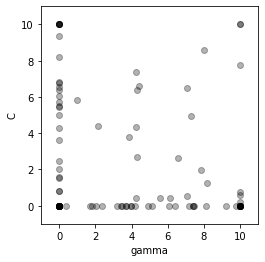

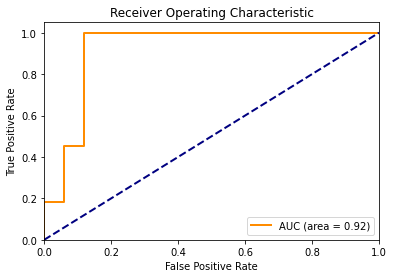

Accuracy for particle (in iteration 40, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 1.59789064e+00]
Accuracy for particle (in iteration 40, in fold 8) - 2 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 40, in fold 8) - 3 is 0.4643 At (gamma, c): [10.          0.18859925]
Accuracy for particle (in iteration 40, in fold 8) - 4 is 0.7143 At (gamma, c): [7.069085   0.52010405]
Accuracy for particle (in iteration 40, in fold 8) - 5 is 0.3929 At (gamma, c): [2.39451617e+00 1.00000000e-03]
Accuracy for particle (in iteration 40, in fold 8) - 6 is 0.3929 At (gamma, c): [2.04141673e+00 1.00000000e-03]
Accuracy for particle (in iteration 40, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 6.80789215e+00]
Accuracy for particle (in iteration 40, in fold 8) - 8 is 0.8929 At (gamma, c): [7.9904427  8.57181564]
Accuracy for particle (in iteration 40, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 40, in fold 

Accuracy for particle (in iteration 40, in fold 8) - 81 is 0.3929 At (gamma, c): [4.17625759e+00 1.00000000e-03]
Accuracy for particle (in iteration 40, in fold 8) - 82 is 0.3929 At (gamma, c): [3.97717907e+00 1.00000000e-03]
Accuracy for particle (in iteration 40, in fold 8) - 83 is 0.8929 At (gamma, c): [10.          0.59410919]
Accuracy for particle (in iteration 40, in fold 8) - 84 is 0.7500 At (gamma, c): [1.00000000e-03 1.53902039e+00]
Accuracy for particle (in iteration 40, in fold 8) - 85 is 0.3929 At (gamma, c): [3.42403326e+00 1.00000000e-03]
Accuracy for particle (in iteration 40, in fold 8) - 86 is 0.3929 At (gamma, c): [1.68845989e+00 1.00000000e-03]
Accuracy for particle (in iteration 40, in fold 8) - 87 is 0.3929 At (gamma, c): [8.12868005e+00 1.00000000e-03]
Accuracy for particle (in iteration 40, in fold 8) - 88 is 0.3929 At (gamma, c): [3.98754071e+00 1.00000000e-03]
Accuracy for particle (in iteration 40, in fold 8) - 89 is 0.3929 At (gamma, c): [3.20846008e+00 1.000

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 40, in fold 8) - 100 is 0.3929 At (gamma, c): [7.39143531e+00 1.00000000e-03]
The best position in iteration 40, fold 8 is [4.97624449 5.30947185], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 41 - Fold 8:



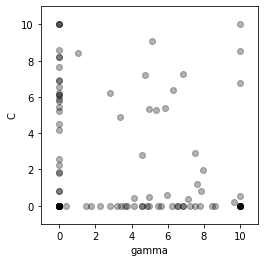

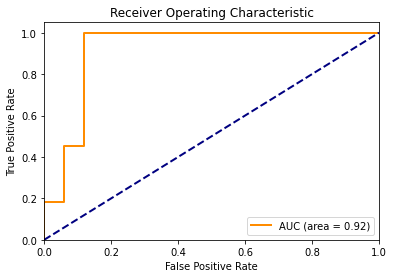

Accuracy for particle (in iteration 41, in fold 8) - 1 is 0.7500 At (gamma, c): [1.0000000e-03 1.8496838e+00]
Accuracy for particle (in iteration 41, in fold 8) - 2 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 41, in fold 8) - 3 is 0.4643 At (gamma, c): [9.63106125 0.22370803]
Accuracy for particle (in iteration 41, in fold 8) - 4 is 0.8929 At (gamma, c): [5.97219067 0.59729566]
Accuracy for particle (in iteration 41, in fold 8) - 5 is 0.3929 At (gamma, c): [3.40115518e+00 1.00000000e-03]
Accuracy for particle (in iteration 41, in fold 8) - 6 is 0.3929 At (gamma, c): [2.23963965e+00 1.00000000e-03]
Accuracy for particle (in iteration 41, in fold 8) - 7 is 0.7500 At (gamma, c): [1.0000000e-03 6.1156334e+00]
Accuracy for particle (in iteration 41, in fold 8) - 8 is 0.8929 At (gamma, c): [4.97624449 5.30947185]
Accuracy for particle (in iteration 41, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 41, in fold 8) - 1

Accuracy for particle (in iteration 41, in fold 8) - 82 is 0.3929 At (gamma, c): [5.4553494e+00 1.0000000e-03]
Accuracy for particle (in iteration 41, in fold 8) - 83 is 0.7143 At (gamma, c): [10.          0.50689124]
Accuracy for particle (in iteration 41, in fold 8) - 84 is 0.7500 At (gamma, c): [1.00000000e-03 1.79537143e+00]
Accuracy for particle (in iteration 41, in fold 8) - 85 is 0.3929 At (gamma, c): [2.80268799e+00 1.00000000e-03]
Accuracy for particle (in iteration 41, in fold 8) - 86 is 0.3929 At (gamma, c): [1.78570414e+00 1.00000000e-03]
Accuracy for particle (in iteration 41, in fold 8) - 87 is 0.3929 At (gamma, c): [7.50752122e+00 1.00000000e-03]
Accuracy for particle (in iteration 41, in fold 8) - 88 is 0.3929 At (gamma, c): [3.74587875e+00 1.00000000e-03]
Accuracy for particle (in iteration 41, in fold 8) - 89 is 0.3929 At (gamma, c): [4.60387419e+00 1.00000000e-03]
Accuracy for particle (in iteration 41, in fold 8) - 90 is 0.3929 At (gamma, c): [6.4827665e+00 1.000000

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


The best position in iteration 41, fold 8 is [6.7638848  7.24428089], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 42 - Fold 8:



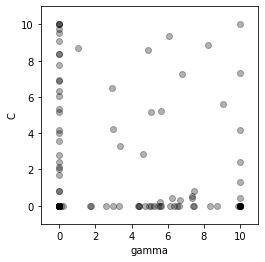

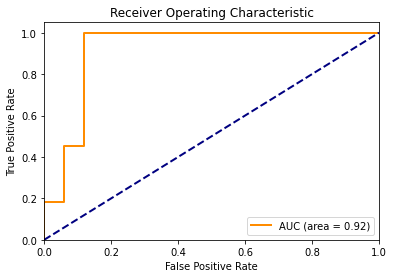

Accuracy for particle (in iteration 42, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 2.15387177e+00]
Accuracy for particle (in iteration 42, in fold 8) - 2 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 42, in fold 8) - 3 is 0.7143 At (gamma, c): [7.33358362 0.41282304]
Accuracy for particle (in iteration 42, in fold 8) - 4 is 0.7143 At (gamma, c): [7.32134342 0.510498  ]
Accuracy for particle (in iteration 42, in fold 8) - 5 is 0.3929 At (gamma, c): [4.38385379e+00 1.00000000e-03]
Accuracy for particle (in iteration 42, in fold 8) - 6 is 0.3929 At (gamma, c): [2.59286076e+00 1.00000000e-03]
Accuracy for particle (in iteration 42, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 4.03322764e+00]
Accuracy for particle (in iteration 42, in fold 8) - 8 is 0.8929 At (gamma, c): [6.7638848  7.24428089]
Accuracy for particle (in iteration 42, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 42, in fold 8)

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 42, in fold 8) - 98 is 0.7500 At (gamma, c): [1.00000000e-03 9.77581068e+00]
Accuracy for particle (in iteration 42, in fold 8) - 99 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 42, in fold 8) - 100 is 0.3929 At (gamma, c): [6.49634334e+00 1.00000000e-03]
The best position in iteration 42, fold 8 is [6.00940599 6.42768914], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 43 - Fold 8:



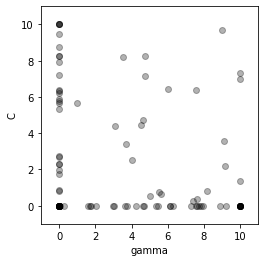

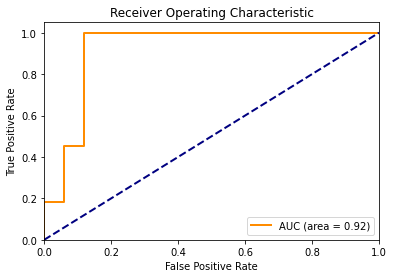

Accuracy for particle (in iteration 43, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 1.98790415e+00]
Accuracy for particle (in iteration 43, in fold 8) - 2 is 0.3929 At (gamma, c): [7.5723394e+00 1.0000000e-03]
Accuracy for particle (in iteration 43, in fold 8) - 3 is 0.7143 At (gamma, c): [7.61741933 0.39142536]
Accuracy for particle (in iteration 43, in fold 8) - 4 is 0.8929 At (gamma, c): [5.6496785  0.62082995]
Accuracy for particle (in iteration 43, in fold 8) - 5 is 0.3929 At (gamma, c): [4.64906725e+00 1.00000000e-03]
Accuracy for particle (in iteration 43, in fold 8) - 6 is 0.3929 At (gamma, c): [1.70224669e+00 1.00000000e-03]
Accuracy for particle (in iteration 43, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 5.68510844e+00]
Accuracy for particle (in iteration 43, in fold 8) - 8 is 0.8929 At (gamma, c): [6.00940599 6.42768914]
Accuracy for particle (in iteration 43, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 43, in fold 8) - 98 is 0.7500 At (gamma, c): [1.00000000e-03 6.38689661e+00]
Accuracy for particle (in iteration 43, in fold 8) - 99 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 43, in fold 8) - 100 is 0.3929 At (gamma, c): [8.90314665e+00 1.00000000e-03]
The best position in iteration 43, fold 8 is [4.49278423 4.78621048], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 44 - Fold 8:



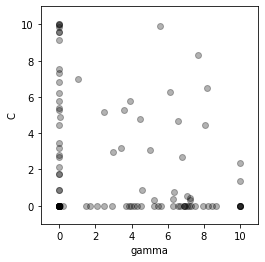

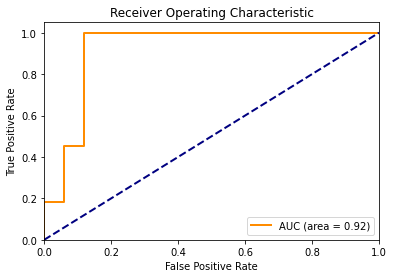

Accuracy for particle (in iteration 44, in fold 8) - 1 is 0.7500 At (gamma, c): [1.000000e-03 1.773886e+00]
Accuracy for particle (in iteration 44, in fold 8) - 2 is 0.3929 At (gamma, c): [7.49368433e+00 1.00000000e-03]
Accuracy for particle (in iteration 44, in fold 8) - 3 is 0.7143 At (gamma, c): [7.2196638  0.42411416]
Accuracy for particle (in iteration 44, in fold 8) - 4 is 0.7857 At (gamma, c): [7.07953454 0.52804764]
Accuracy for particle (in iteration 44, in fold 8) - 5 is 0.3929 At (gamma, c): [5.64061964e+00 1.00000000e-03]
Accuracy for particle (in iteration 44, in fold 8) - 6 is 0.3929 At (gamma, c): [2.11207684e+00 1.00000000e-03]
Accuracy for particle (in iteration 44, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 3.47681735e+00]
Accuracy for particle (in iteration 44, in fold 8) - 8 is 0.8929 At (gamma, c): [4.49278423 4.78621048]
Accuracy for particle (in iteration 44, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 44

Accuracy for particle (in iteration 44, in fold 8) - 80 is 0.7500 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 44, in fold 8) - 81 is 0.3929 At (gamma, c): [3.9521553e+00 1.0000000e-03]
Accuracy for particle (in iteration 44, in fold 8) - 82 is 0.3929 At (gamma, c): [6.8873195e+00 1.0000000e-03]
Accuracy for particle (in iteration 44, in fold 8) - 83 is 0.8929 At (gamma, c): [6.34538876 0.77390323]
Accuracy for particle (in iteration 44, in fold 8) - 84 is 0.7500 At (gamma, c): [1.00000000e-03 1.73766914e+00]
Accuracy for particle (in iteration 44, in fold 8) - 85 is 0.3929 At (gamma, c): [2.93394194e+00 1.00000000e-03]
Accuracy for particle (in iteration 44, in fold 8) - 86 is 0.3929 At (gamma, c): [1.46851769e+00 1.00000000e-03]
Accuracy for particle (in iteration 44, in fold 8) - 87 is 0.3929 At (gamma, c): [6.69515091e+00 1.00000000e-03]
Accuracy for particle (in iteration 44, in fold 8) - 88 is 0.3929 At (gamma, c): [3.67797869e+00 1.00000000e-03]
Accuracy fo

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 44, in fold 8) - 98 is 0.7500 At (gamma, c): [1.0000000e-03 7.3171852e+00]
Accuracy for particle (in iteration 44, in fold 8) - 99 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 44, in fold 8) - 100 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 44, fold 8 is [3.50337013 3.7153422 ], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 45 - Fold 8:



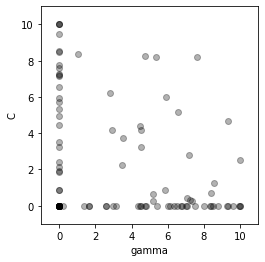

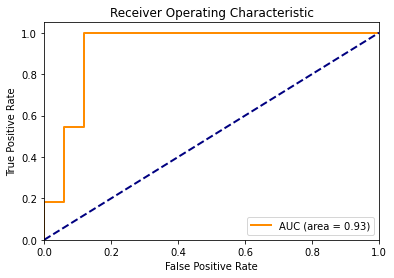

Accuracy for particle (in iteration 45, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 1.94116741e+00]
Accuracy for particle (in iteration 45, in fold 8) - 2 is 0.3929 At (gamma, c): [6.36651188e+00 1.00000000e-03]
Accuracy for particle (in iteration 45, in fold 8) - 3 is 0.7143 At (gamma, c): [7.04972329 0.43811039]
Accuracy for particle (in iteration 45, in fold 8) - 4 is 0.8929 At (gamma, c): [5.1708177  0.65257003]
Accuracy for particle (in iteration 45, in fold 8) - 5 is 0.3929 At (gamma, c): [3.15481257e+00 1.00000000e-03]
Accuracy for particle (in iteration 45, in fold 8) - 6 is 0.3929 At (gamma, c): [1.62882634e+00 1.00000000e-03]
Accuracy for particle (in iteration 45, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 4.93123867e+00]
Accuracy for particle (in iteration 45, in fold 8) - 8 is 0.8929 At (gamma, c): [3.50337013 3.7153422 ]
Accuracy for particle (in iteration 45, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteratio

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 45, in fold 8) - 94 is 0.3929 At (gamma, c): [6.10695255e+00 1.00000000e-03]
Accuracy for particle (in iteration 45, in fold 8) - 95 is 0.7500 At (gamma, c): [1.0000000e-03 5.9535819e+00]
Accuracy for particle (in iteration 45, in fold 8) - 96 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 45, in fold 8) - 97 is 0.7500 At (gamma, c): [1.00000000e-03 9.50050806e+00]
Accuracy for particle (in iteration 45, in fold 8) - 98 is 0.7500 At (gamma, c): [1.00000000e-03 8.55960183e+00]
Accuracy for particle (in iteration 45, in fold 8) - 99 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 45, in fold 8) - 100 is 0.3929 At (gamma, c): [7.98762896e+00 1.00000000e-03]
The best position in iteration 45, fold 8 is [3.5357026  3.75033647], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):

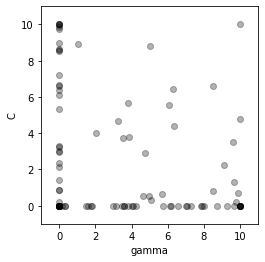

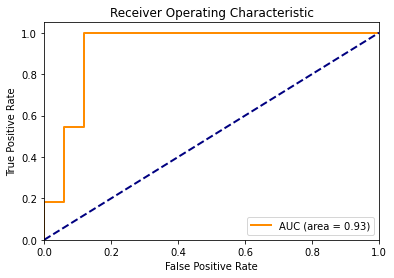

Accuracy for particle (in iteration 46, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 2.12091878e+00]
Accuracy for particle (in iteration 46, in fold 8) - 2 is 0.3929 At (gamma, c): [7.90742586e+00 1.00000000e-03]
Accuracy for particle (in iteration 46, in fold 8) - 3 is 0.4643 At (gamma, c): [9.74773445 0.22211249]
Accuracy for particle (in iteration 46, in fold 8) - 4 is 0.8929 At (gamma, c): [5.69012206 0.61887408]
Accuracy for particle (in iteration 46, in fold 8) - 5 is 0.3929 At (gamma, c): [4.01809146e+00 1.00000000e-03]
Accuracy for particle (in iteration 46, in fold 8) - 6 is 0.3929 At (gamma, c): [1.61270736e+00 1.00000000e-03]
Accuracy for particle (in iteration 46, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 6.35743363e+00]
Accuracy for particle (in iteration 46, in fold 8) - 8 is 0.8929 At (gamma, c): [3.5357026  3.75033647]
Accuracy for particle (in iteration 46, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteratio

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 46, in fold 8) - 92 is 0.8929 At (gamma, c): [10.          4.78771465]
Accuracy for particle (in iteration 46, in fold 8) - 93 is 0.7500 At (gamma, c): [1.00000000e-03 8.52319434e+00]
Accuracy for particle (in iteration 46, in fold 8) - 94 is 0.3929 At (gamma, c): [6.54706729e+00 1.00000000e-03]
Accuracy for particle (in iteration 46, in fold 8) - 95 is 0.7500 At (gamma, c): [1.00000000e-03 3.22949553e+00]
Accuracy for particle (in iteration 46, in fold 8) - 96 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 46, in fold 8) - 97 is 0.7500 At (gamma, c): [1.00000000e-03 6.60192883e+00]
Accuracy for particle (in iteration 46, in fold 8) - 98 is 0.7500 At (gamma, c): [1.00000000e-03 8.62507096e+00]
Accuracy for particle (in iteration 46, in fold 8) - 99 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 46, in fold 8) - 100 is 0.3929 At (gamma, c): [9.63240301e+00 1.00000000e-03]
The best position in ite

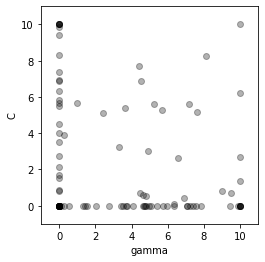

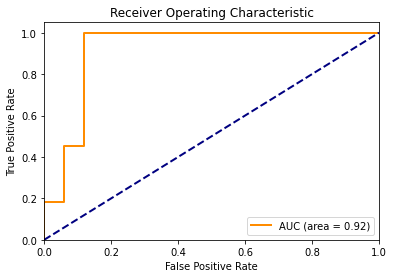

Accuracy for particle (in iteration 47, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 1.51676237e+00]
Accuracy for particle (in iteration 47, in fold 8) - 2 is 0.3929 At (gamma, c): [7.0672326e+00 1.0000000e-03]
Accuracy for particle (in iteration 47, in fold 8) - 3 is 0.7143 At (gamma, c): [6.90997179 0.4495493 ]
Accuracy for particle (in iteration 47, in fold 8) - 4 is 0.8929 At (gamma, c): [4.4836864  0.69738368]
Accuracy for particle (in iteration 47, in fold 8) - 5 is 0.3929 At (gamma, c): [4.65749256e+00 1.00000000e-03]
Accuracy for particle (in iteration 47, in fold 8) - 6 is 0.3929 At (gamma, c): [1.52257457e+00 1.00000000e-03]
Accuracy for particle (in iteration 47, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 5.82158716e+00]
Accuracy for particle (in iteration 47, in fold 8) - 8 is 0.8929 At (gamma, c): [5.25905738 5.61556761]
Accuracy for particle (in iteration 47, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 47, in fold 8) - 100 is 0.3929 At (gamma, c): [4.6814218e+00 1.0000000e-03]
The best position in iteration 47, fold 8 is [4.19478352 4.46367668], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 48 - Fold 8:



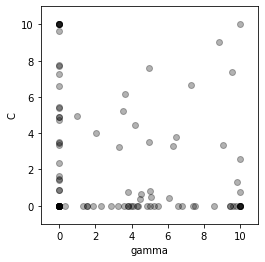

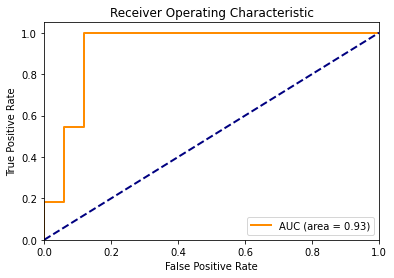

Accuracy for particle (in iteration 48, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 1.49413149e+00]
Accuracy for particle (in iteration 48, in fold 8) - 2 is 0.3929 At (gamma, c): [9.44772708e+00 1.00000000e-03]
Accuracy for particle (in iteration 48, in fold 8) - 3 is 0.8929 At (gamma, c): [4.53277833 0.63998696]
Accuracy for particle (in iteration 48, in fold 8) - 4 is 0.8929 At (gamma, c): [3.78187652 0.74303465]
Accuracy for particle (in iteration 48, in fold 8) - 5 is 0.3929 At (gamma, c): [5.00368719e+00 1.00000000e-03]
Accuracy for particle (in iteration 48, in fold 8) - 6 is 0.3929 At (gamma, c): [1.53596896e+00 1.00000000e-03]
Accuracy for particle (in iteration 48, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 3.48696185e+00]
Accuracy for particle (in iteration 48, in fold 8) - 8 is 0.8929 At (gamma, c): [4.19478352 4.46367668]
Accuracy for particle (in iteration 48, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteratio

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 48, in fold 8) - 97 is 0.7857 At (gamma, c): [1.0000000e-03 4.8753724e+00]
Accuracy for particle (in iteration 48, in fold 8) - 98 is 0.7500 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 48, in fold 8) - 99 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 48, in fold 8) - 100 is 0.3929 At (gamma, c): [5.24102382e+00 1.00000000e-03]
The best position in iteration 48, fold 8 is [6.12192476 6.54947115], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 49 - Fold 8:



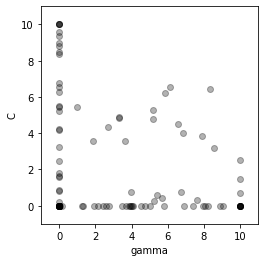

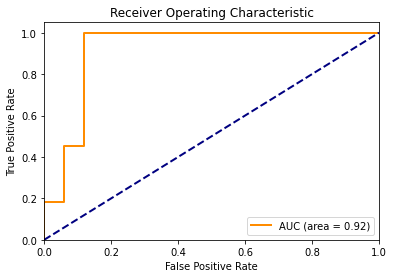

Accuracy for particle (in iteration 49, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 1.80947099e+00]
Accuracy for particle (in iteration 49, in fold 8) - 2 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 49, in fold 8) - 3 is 0.8929 At (gamma, c): [5.38898985 0.57144387]
Accuracy for particle (in iteration 49, in fold 8) - 4 is 0.8929 At (gamma, c): [3.9636091  0.73121944]
Accuracy for particle (in iteration 49, in fold 8) - 5 is 0.3929 At (gamma, c): [4.54370208e+00 1.00000000e-03]
Accuracy for particle (in iteration 49, in fold 8) - 6 is 0.3929 At (gamma, c): [1.95425283e+00 1.00000000e-03]
Accuracy for particle (in iteration 49, in fold 8) - 7 is 0.7500 At (gamma, c): [1.00000000e-03 5.21996074e+00]
Accuracy for particle (in iteration 49, in fold 8) - 8 is 0.8929 At (gamma, c): [6.12192476 6.54947115]
Accuracy for particle (in iteration 49, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 49, in fold 8)

Accuracy for particle (in iteration 49, in fold 8) - 81 is 0.3929 At (gamma, c): [3.90079329e+00 1.00000000e-03]
Accuracy for particle (in iteration 49, in fold 8) - 82 is 0.3929 At (gamma, c): [4.76756174e+00 1.00000000e-03]
Accuracy for particle (in iteration 49, in fold 8) - 83 is 0.8929 At (gamma, c): [6.72773911 0.77898329]
Accuracy for particle (in iteration 49, in fold 8) - 84 is 0.7500 At (gamma, c): [1.00000000e-03 1.65911169e+00]
Accuracy for particle (in iteration 49, in fold 8) - 85 is 0.3929 At (gamma, c): [3.95945282e+00 1.00000000e-03]
Accuracy for particle (in iteration 49, in fold 8) - 86 is 0.3929 At (gamma, c): [1.26568475e+00 1.00000000e-03]
Accuracy for particle (in iteration 49, in fold 8) - 87 is 0.3929 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 49, in fold 8) - 88 is 0.3929 At (gamma, c): [2.42163789e+00 1.00000000e-03]
Accuracy for particle (in iteration 49, in fold 8) - 89 is 0.3929 At (gamma, c): [2.73320268e+00 1.00000000e-03]
Accurac

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


The best position in iteration 49, fold 8 is [4.21526986 4.48584957], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]

Iteration 50 - Fold 8:



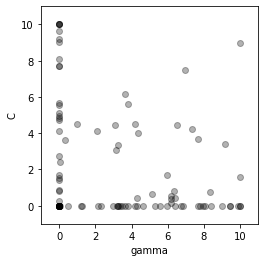

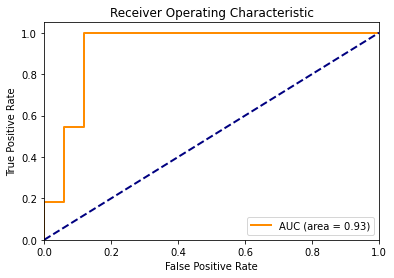

Accuracy for particle (in iteration 50, in fold 8) - 1 is 0.7500 At (gamma, c): [1.00000000e-03 1.69590048e+00]
Accuracy for particle (in iteration 50, in fold 8) - 2 is 0.3929 At (gamma, c): [6.18468937 0.12468498]
Accuracy for particle (in iteration 50, in fold 8) - 3 is 0.7143 At (gamma, c): [6.16406702 0.50939138]
Accuracy for particle (in iteration 50, in fold 8) - 4 is 0.8929 At (gamma, c): [5.11200904 0.65654569]
Accuracy for particle (in iteration 50, in fold 8) - 5 is 0.3929 At (gamma, c): [3.47353496e+00 1.00000000e-03]
Accuracy for particle (in iteration 50, in fold 8) - 6 is 0.3929 At (gamma, c): [2.33688379e+00 1.00000000e-03]
Accuracy for particle (in iteration 50, in fold 8) - 7 is 0.7500 At (gamma, c): [1.0000000e-03 5.6472391e+00]
Accuracy for particle (in iteration 50, in fold 8) - 8 is 0.8929 At (gamma, c): [4.21526986 4.48584957]
Accuracy for particle (in iteration 50, in fold 8) - 9 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 50, in f

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 50, in fold 8) - 95 is 0.7500 At (gamma, c): [1.00000000e-03 4.09934081e+00]
Accuracy for particle (in iteration 50, in fold 8) - 96 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 50, in fold 8) - 97 is 0.7500 At (gamma, c): [1.0000000e-03 7.6816767e+00]
Accuracy for particle (in iteration 50, in fold 8) - 98 is 0.7500 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 50, in fold 8) - 99 is 0.3929 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 50, in fold 8) - 100 is 0.3929 At (gamma, c): [6.82107682e+00 1.00000000e-03]
The best position in iteration 50, fold 8 is [6.0509793  6.47268505], with Accuracy: 0.9286
Accuracy Score: 0.8929
F1 Score: 0.8800
Recall Score: 1.0000
Precision Score: 0.7857
Confusion Matrix (Test):
[[14  3]
 [ 0 11]]
Confusion Matrix (Train):
[[126   0]
 [  0 132]]


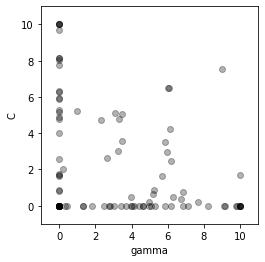

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.



Iteration 1 - Fold 9:



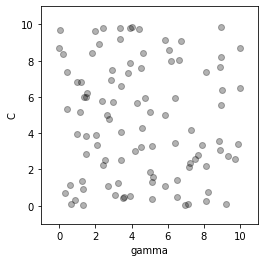

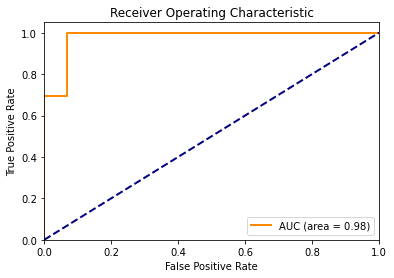

Accuracy for particle (in iteration 1, in fold 9) - 1 is 0.8571 At (gamma, c): [8.83816011 3.5556075 ]
Accuracy for particle (in iteration 1, in fold 9) - 2 is 0.8571 At (gamma, c): [2.71857676 1.0944753 ]
Accuracy for particle (in iteration 1, in fold 9) - 3 is 0.4643 At (gamma, c): [1.30324755 0.02894677]
Accuracy for particle (in iteration 1, in fold 9) - 4 is 0.8571 At (gamma, c): [4.50945964 3.2609858 ]
Accuracy for particle (in iteration 1, in fold 9) - 5 is 0.9286 At (gamma, c): [0.99265426 3.95352003]
Accuracy for particle (in iteration 1, in fold 9) - 6 is 0.8571 At (gamma, c): [3.39451997 2.52283604]
Accuracy for particle (in iteration 1, in fold 9) - 7 is 0.8571 At (gamma, c): [6.38539396 3.48381578]
Accuracy for particle (in iteration 1, in fold 9) - 8 is 0.8214 At (gamma, c): [1.3573842  6.01480871]
Accuracy for particle (in iteration 1, in fold 9) - 9 is 0.8571 At (gamma, c): [6.19240025 7.96501284]
Accuracy for particle (in iteration 1, in fold 9) - 10 is 0.8571 At (gamm

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 1, in fold 9) - 97 is 0.8929 At (gamma, c): [1.16267476 5.14571346]
Accuracy for particle (in iteration 1, in fold 9) - 98 is 0.8571 At (gamma, c): [4.31779225 5.67461954]
Accuracy for particle (in iteration 1, in fold 9) - 99 is 0.8571 At (gamma, c): [8.93700778 9.8880884 ]
Accuracy for particle (in iteration 1, in fold 9) - 100 is 0.8571 At (gamma, c): [2.90149905 7.49696685]
The best position in iteration 1, fold 9 is [0.6094015 0.001    ], with Accuracy: 0.9286
Accuracy Score: 0.8571
F1 Score: 0.8667
Recall Score: 1.0000
Precision Score: 0.7647
Confusion Matrix (Test):
[[11  4]
 [ 0 13]]
Confusion Matrix (Train):
[[128   0]
 [  0 130]]

Iteration 2 - Fold 9:



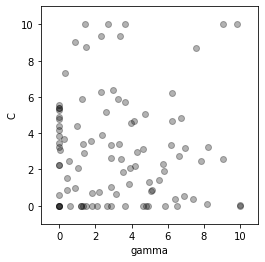

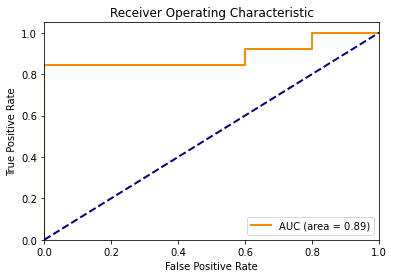

Accuracy for particle (in iteration 2, in fold 9) - 1 is 0.8571 At (gamma, c): [6.18585888 3.35146055]
Accuracy for particle (in iteration 2, in fold 9) - 2 is 0.8571 At (gamma, c): [3.52244329 1.83523265]
Accuracy for particle (in iteration 2, in fold 9) - 3 is 0.8929 At (gamma, c): [0.29455138 3.69605052]
Accuracy for particle (in iteration 2, in fold 9) - 4 is 0.8571 At (gamma, c): [2.57731311 5.15529386]
Accuracy for particle (in iteration 2, in fold 9) - 5 is 0.4643 At (gamma, c): [0.6094015 0.001    ]
Accuracy for particle (in iteration 2, in fold 9) - 6 is 0.8571 At (gamma, c): [6.74036859 4.86056129]
Accuracy for particle (in iteration 2, in fold 9) - 7 is 0.8571 At (gamma, c): [6.94613339 3.20664079]
Accuracy for particle (in iteration 2, in fold 9) - 8 is 0.8929 At (gamma, c): [0.87379404 0.96182022]
Accuracy for particle (in iteration 2, in fold 9) - 9 is 0.8571 At (gamma, c): [2.33815949 6.28934366]
Accuracy for particle (in iteration 2, in fold 9) - 10 is 0.4643 At (gamma,

Accuracy for particle (in iteration 2, in fold 9) - 80 is 0.8214 At (gamma, c): [1.24621923 5.89135501]
Accuracy for particle (in iteration 2, in fold 9) - 81 is 0.7857 At (gamma, c): [1.00000000e-03 4.78819679e+00]
Accuracy for particle (in iteration 2, in fold 9) - 82 is 0.7857 At (gamma, c): [1.00000000e-03 3.84125535e+00]
Accuracy for particle (in iteration 2, in fold 9) - 83 is 0.9286 At (gamma, c): [0.03093915 3.08833487]
Accuracy for particle (in iteration 2, in fold 9) - 84 is 0.8929 At (gamma, c): [0.41457198 1.50288272]
Accuracy for particle (in iteration 2, in fold 9) - 85 is 0.4643 At (gamma, c): [1.48881826e+00 1.00000000e-03]
Accuracy for particle (in iteration 2, in fold 9) - 86 is 0.8571 At (gamma, c): [5.79062598 1.93263721]
Accuracy for particle (in iteration 2, in fold 9) - 87 is 0.8571 At (gamma, c): [2.88077288 2.6372414 ]
Accuracy for particle (in iteration 2, in fold 9) - 88 is 0.8571 At (gamma, c): [3.25305156 5.89207887]
Accuracy for particle (in iteration 2, i

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 2, in fold 9) - 100 is 0.8571 At (gamma, c): [2.95982457 6.36414461]
The best position in iteration 2, fold 9 is [0.001 0.001], with Accuracy: 0.9286
Accuracy Score: 0.4643
F1 Score: 0.6341
Recall Score: 1.0000
Precision Score: 0.4643
Confusion Matrix (Test):
[[ 0 15]
 [ 0 13]]
Confusion Matrix (Train):
[[  0 128]
 [  0 130]]

Iteration 3 - Fold 9:



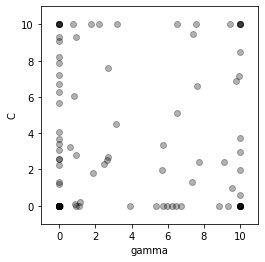

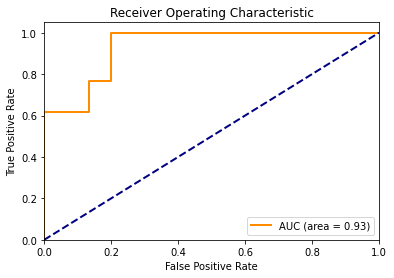

Accuracy for particle (in iteration 3, in fold 9) - 1 is 0.9286 At (gamma, c): [0.91064883 2.81954078]
Accuracy for particle (in iteration 3, in fold 9) - 2 is 0.8571 At (gamma, c): [5.76262205 3.32345526]
Accuracy for particle (in iteration 3, in fold 9) - 3 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 3, in fold 9) - 4 is 0.8571 At (gamma, c): [ 1.7605364 10.       ]
Accuracy for particle (in iteration 3, in fold 9) - 5 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 3, in fold 9) - 6 is 0.8571 At (gamma, c): [10.          8.48142795]
Accuracy for particle (in iteration 3, in fold 9) - 7 is 0.8571 At (gamma, c): [7.72999609 2.40963517]
Accuracy for particle (in iteration 3, in fold 9) - 8 is 0.4643 At (gamma, c): [0.07187185 0.001     ]
Accuracy for particle (in iteration 3, in fold 9) - 9 is 0.8571 At (gamma, c): [ 3.21661257 10.        ]
Accuracy for particle (in iteration 3, in fold 9) - 10 is 0.4643 At (gamma, c): [0.001 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 3, in fold 9) - 97 is 0.9286 At (gamma, c): [0.9615628  9.31080888]
Accuracy for particle (in iteration 3, in fold 9) - 98 is 0.7857 At (gamma, c): [1.00000000e-03 6.72760028e+00]
Accuracy for particle (in iteration 3, in fold 9) - 99 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 3, in fold 9) - 100 is 0.8571 At (gamma, c): [2.64636019 2.5212519 ]
The best position in iteration 3, fold 9 is [0.001 0.001], with Accuracy: 0.9286
Accuracy Score: 0.4643
F1 Score: 0.6341
Recall Score: 1.0000
Precision Score: 0.4643
Confusion Matrix (Test):
[[ 0 15]
 [ 0 13]]
Confusion Matrix (Train):
[[  0 128]
 [  0 130]]

Iteration 4 - Fold 9:



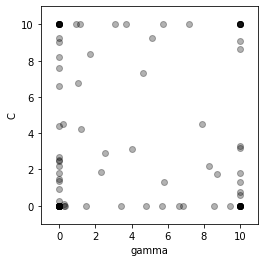

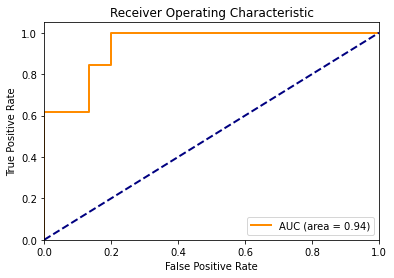

Accuracy for particle (in iteration 4, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 2.19882801e+00]
Accuracy for particle (in iteration 4, in fold 9) - 2 is 0.8571 At (gamma, c): [7.90347284 4.53295432]
Accuracy for particle (in iteration 4, in fold 9) - 3 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 4, in fold 9) - 4 is 0.8214 At (gamma, c): [ 1.17738204 10.        ]
Accuracy for particle (in iteration 4, in fold 9) - 5 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 4, in fold 9) - 6 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 4, in fold 9) - 7 is 0.8571 At (gamma, c): [5.79772041 1.29141845]
Accuracy for particle (in iteration 4, in fold 9) - 8 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 4, in fold 9) - 9 is 0.8571 At (gamma, c): [ 3.67861529 10.        ]
Accuracy for particle (in iteration 4, in fold 9) - 10 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 4, in fold 9) - 98 is 0.7857 At (gamma, c): [1.00000000e-03 8.19528974e+00]
Accuracy for particle (in iteration 4, in fold 9) - 99 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 4, in fold 9) - 100 is 0.4643 At (gamma, c): [1.48457894e+00 1.00000000e-03]
The best position in iteration 4, fold 9 is [0.001 0.001], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 36  94]]

Iteration 5 - Fold 9:



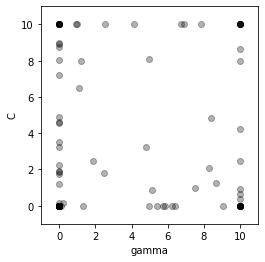

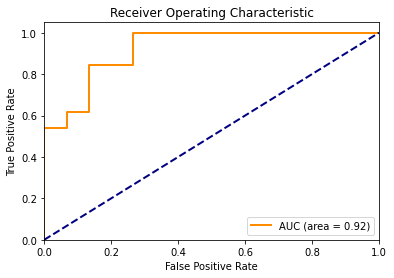

Accuracy for particle (in iteration 5, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 3.22847041e+00]
Accuracy for particle (in iteration 5, in fold 9) - 2 is 0.8571 At (gamma, c): [8.39638015 4.85555539]
Accuracy for particle (in iteration 5, in fold 9) - 3 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 5, in fold 9) - 4 is 0.9286 At (gamma, c): [ 0.96755498 10.        ]
Accuracy for particle (in iteration 5, in fold 9) - 5 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 5, in fold 9) - 6 is 0.8571 At (gamma, c): [10.          8.64566658]
Accuracy for particle (in iteration 5, in fold 9) - 7 is 0.8571 At (gamma, c): [5.12874238 0.8897479 ]
Accuracy for particle (in iteration 5, in fold 9) - 8 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 5, in fold 9) - 9 is 0.8571 At (gamma, c): [ 2.54461183 10.        ]
Accuracy for particle (in iteration 5, in fold 9) - 10 is 0.4643 At (gamma, c): [0.001 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 5, in fold 9) - 97 is 0.9286 At (gamma, c): [ 0.94271342 10.        ]
Accuracy for particle (in iteration 5, in fold 9) - 98 is 0.7857 At (gamma, c): [1.00000000e-03 8.77961818e+00]
Accuracy for particle (in iteration 5, in fold 9) - 99 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 5, in fold 9) - 100 is 0.4643 At (gamma, c): [1.32893444e+00 1.00000000e-03]
The best position in iteration 5, fold 9 is [0.001 0.001], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 38  92]]

Iteration 6 - Fold 9:



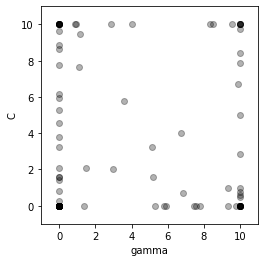

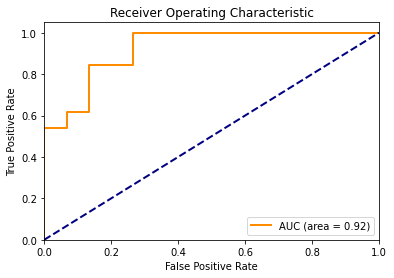

Accuracy for particle (in iteration 6, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 3.77384861e+00]
Accuracy for particle (in iteration 6, in fold 9) - 2 is 0.8571 At (gamma, c): [6.70178876 3.99818664]
Accuracy for particle (in iteration 6, in fold 9) - 3 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 6, in fold 9) - 4 is 0.9286 At (gamma, c): [ 0.90027138 10.        ]
Accuracy for particle (in iteration 6, in fold 9) - 5 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 6, in fold 9) - 6 is 0.8571 At (gamma, c): [10.          7.89288451]
Accuracy for particle (in iteration 6, in fold 9) - 7 is 0.8571 At (gamma, c): [6.83412276 0.72123129]
Accuracy for particle (in iteration 6, in fold 9) - 8 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 6, in fold 9) - 9 is 0.8571 At (gamma, c): [ 2.83846137 10.        ]
Accuracy for particle (in iteration 6, in fold 9) - 10 is 0.4643 At (gamma, c): [0.001 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 6, in fold 9) - 94 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 6, in fold 9) - 95 is 0.7857 At (gamma, c): [0.001      0.79894556]
Accuracy for particle (in iteration 6, in fold 9) - 96 is 0.8571 At (gamma, c): [10.          8.45275565]
Accuracy for particle (in iteration 6, in fold 9) - 97 is 0.9286 At (gamma, c): [ 0.94500425 10.        ]
Accuracy for particle (in iteration 6, in fold 9) - 98 is 0.7857 At (gamma, c): [1.00000000e-03 6.14851454e+00]
Accuracy for particle (in iteration 6, in fold 9) - 99 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 6, in fold 9) - 100 is 0.4643 At (gamma, c): [1.38384168e+00 1.00000000e-03]
The best position in iteration 6, fold 9 is [0.001 0.001], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 34  96]]

Iteration 7 - F

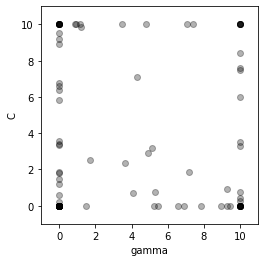

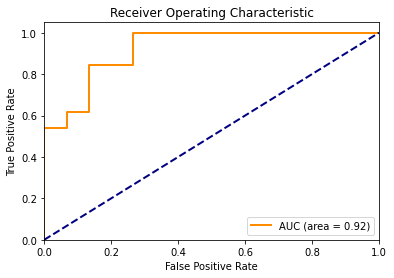

Accuracy for particle (in iteration 7, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 3.57550017e+00]
Accuracy for particle (in iteration 7, in fold 9) - 2 is 0.8571 At (gamma, c): [5.14129441 3.180645  ]
Accuracy for particle (in iteration 7, in fold 9) - 3 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 7, in fold 9) - 4 is 0.9286 At (gamma, c): [ 0.85530907 10.        ]
Accuracy for particle (in iteration 7, in fold 9) - 5 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 7, in fold 9) - 6 is 0.8571 At (gamma, c): [10.          7.58753284]
Accuracy for particle (in iteration 7, in fold 9) - 7 is 0.8571 At (gamma, c): [4.06676694 0.72692681]
Accuracy for particle (in iteration 7, in fold 9) - 8 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 7, in fold 9) - 9 is 0.8571 At (gamma, c): [ 3.45142649 10.        ]
Accuracy for particle (in iteration 7, in fold 9) - 10 is 0.4643 At (gamma, c): [0.001 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 7, in fold 9) - 94 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 7, in fold 9) - 95 is 0.8214 At (gamma, c): [0.001      0.60536099]
Accuracy for particle (in iteration 7, in fold 9) - 96 is 0.8571 At (gamma, c): [10.          5.97698619]
Accuracy for particle (in iteration 7, in fold 9) - 97 is 0.9286 At (gamma, c): [ 0.94742636 10.        ]
Accuracy for particle (in iteration 7, in fold 9) - 98 is 0.7857 At (gamma, c): [1.00000000e-03 6.38051168e+00]
Accuracy for particle (in iteration 7, in fold 9) - 99 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 7, in fold 9) - 100 is 0.4643 At (gamma, c): [1.46062149e+00 1.00000000e-03]
The best position in iteration 7, fold 9 is [0.001 0.001], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 36  94]]

Iteration 8 - F

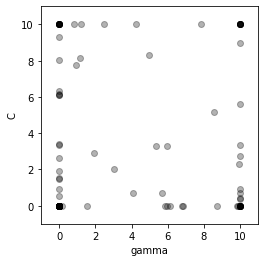

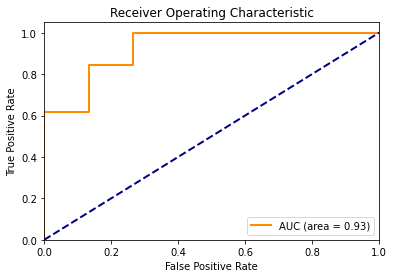

Accuracy for particle (in iteration 8, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 2.64165152e+00]
Accuracy for particle (in iteration 8, in fold 9) - 2 is 0.8571 At (gamma, c): [5.37473754 3.3071359 ]
Accuracy for particle (in iteration 8, in fold 9) - 3 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 8, in fold 9) - 4 is 0.9286 At (gamma, c): [ 0.82398261 10.        ]
Accuracy for particle (in iteration 8, in fold 9) - 5 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 8, in fold 9) - 6 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 8, in fold 9) - 7 is 0.8571 At (gamma, c): [4.05255398 0.70360178]
Accuracy for particle (in iteration 8, in fold 9) - 8 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 8, in fold 9) - 9 is 0.8571 At (gamma, c): [ 2.45296241 10.        ]
Accuracy for particle (in iteration 8, in fold 9) - 10 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 8, in fold 9) - 96 is 0.8571 At (gamma, c): [10.          5.63699871]
Accuracy for particle (in iteration 8, in fold 9) - 97 is 0.9286 At (gamma, c): [0.93372343 7.76023947]
Accuracy for particle (in iteration 8, in fold 9) - 98 is 0.7857 At (gamma, c): [1.00000000e-03 6.31335302e+00]
Accuracy for particle (in iteration 8, in fold 9) - 99 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 8, in fold 9) - 100 is 0.4643 At (gamma, c): [1.54114394e+00 1.00000000e-03]
The best position in iteration 8, fold 9 is [0.001 0.001], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 40  90]]

Iteration 9 - Fold 9:



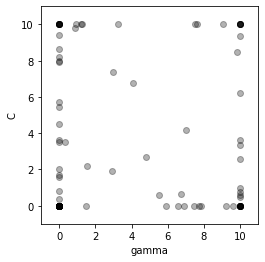

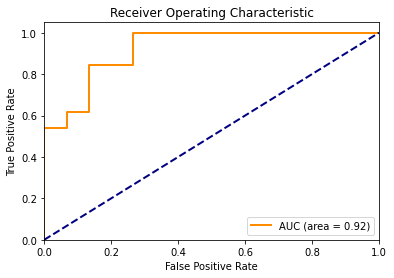

Accuracy for particle (in iteration 9, in fold 9) - 1 is 0.7857 At (gamma, c): [1.0000000e-03 3.4877341e+00]
Accuracy for particle (in iteration 9, in fold 9) - 2 is 0.8571 At (gamma, c): [6.99426066 4.1738604 ]
Accuracy for particle (in iteration 9, in fold 9) - 3 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 9, in fold 9) - 4 is 0.9286 At (gamma, c): [0.85470358 9.79360601]
Accuracy for particle (in iteration 9, in fold 9) - 5 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 9, in fold 9) - 6 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 9, in fold 9) - 7 is 0.8571 At (gamma, c): [5.50533633 0.59241732]
Accuracy for particle (in iteration 9, in fold 9) - 8 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 9, in fold 9) - 9 is 0.8571 At (gamma, c): [ 3.22764463 10.        ]
Accuracy for particle (in iteration 9, in fold 9) - 10 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


The best position in iteration 9, fold 9 is [0.001 0.001], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 37  93]]

Iteration 10 - Fold 9:



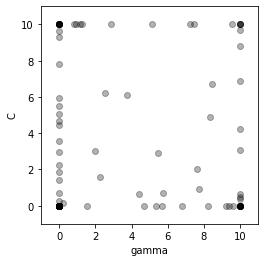

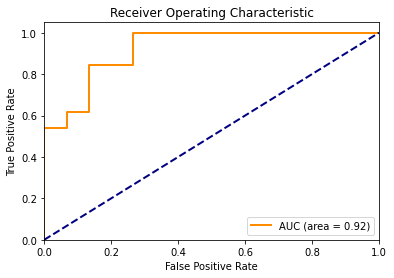

Accuracy for particle (in iteration 10, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 2.94155155e+00]
Accuracy for particle (in iteration 10, in fold 9) - 2 is 0.8571 At (gamma, c): [8.35434831 4.90167559]
Accuracy for particle (in iteration 10, in fold 9) - 3 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 10, in fold 9) - 4 is 0.9286 At (gamma, c): [ 0.81166974 10.        ]
Accuracy for particle (in iteration 10, in fold 9) - 5 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 10, in fold 9) - 6 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 10, in fold 9) - 7 is 0.8571 At (gamma, c): [4.43845907 0.66746642]
Accuracy for particle (in iteration 10, in fold 9) - 8 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 10, in fold 9) - 9 is 0.8571 At (gamma, c): [ 2.84241523 10.        ]
Accuracy for particle (in iteration 10, in fold 9) - 10 is 0.4643 At (gamma, c): [0.001 0.001]

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


The best position in iteration 10, fold 9 is [0.001 0.001], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 37  93]]

Iteration 11 - Fold 9:



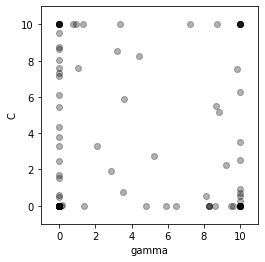

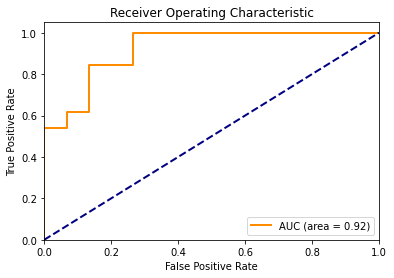

Accuracy for particle (in iteration 11, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 3.28555823e+00]
Accuracy for particle (in iteration 11, in fold 9) - 2 is 0.8571 At (gamma, c): [8.83572937 5.15930592]
Accuracy for particle (in iteration 11, in fold 9) - 3 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 11, in fold 9) - 4 is 0.9286 At (gamma, c): [ 0.77776938 10.        ]
Accuracy for particle (in iteration 11, in fold 9) - 5 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 11, in fold 9) - 6 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 11, in fold 9) - 7 is 0.8571 At (gamma, c): [3.52554594 0.73416826]
Accuracy for particle (in iteration 11, in fold 9) - 8 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 11, in fold 9) - 9 is 0.8571 At (gamma, c): [ 3.38196608 10.        ]
Accuracy for particle (in iteration 11, in fold 9) - 10 is 0.4643 At (gamma, c): [0.001 0.001]

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 11, in fold 9) - 98 is 0.7857 At (gamma, c): [1.00000000e-03 7.16996816e+00]
Accuracy for particle (in iteration 11, in fold 9) - 99 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 11, in fold 9) - 100 is 0.4643 At (gamma, c): [1.38906871e+00 1.00000000e-03]
The best position in iteration 11, fold 9 is [0.001 0.001], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 37  93]]

Iteration 12 - Fold 9:



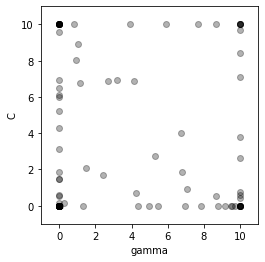

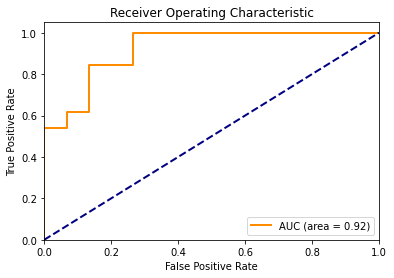

Accuracy for particle (in iteration 12, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 3.10716991e+00]
Accuracy for particle (in iteration 12, in fold 9) - 2 is 0.8571 At (gamma, c): [6.7104028  4.02218704]
Accuracy for particle (in iteration 12, in fold 9) - 3 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 12, in fold 9) - 4 is 0.9286 At (gamma, c): [ 0.81209205 10.        ]
Accuracy for particle (in iteration 12, in fold 9) - 5 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 12, in fold 9) - 6 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 12, in fold 9) - 7 is 0.8571 At (gamma, c): [4.24152763 0.68037986]
Accuracy for particle (in iteration 12, in fold 9) - 8 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 12, in fold 9) - 9 is 0.8571 At (gamma, c): [ 3.89958446 10.        ]
Accuracy for particle (in iteration 12, in fold 9) - 10 is 0.4643 At (gamma, c): [0.001 0.001]

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 12, in fold 9) - 98 is 0.7857 At (gamma, c): [1.00000000e-03 6.12514471e+00]
Accuracy for particle (in iteration 12, in fold 9) - 99 is 0.8571 At (gamma, c): [ 8.67899457 10.        ]
Accuracy for particle (in iteration 12, in fold 9) - 100 is 0.4643 At (gamma, c): [1.32849667e+00 1.00000000e-03]
The best position in iteration 12, fold 9 is [0.02848943 0.001     ], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 37  93]]

Iteration 13 - Fold 9:



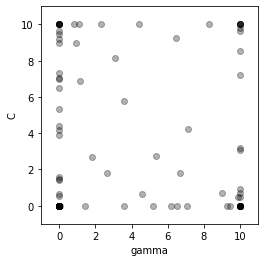

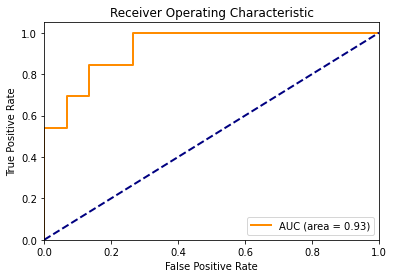

Accuracy for particle (in iteration 13, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 3.90803395e+00]
Accuracy for particle (in iteration 13, in fold 9) - 2 is 0.8571 At (gamma, c): [7.1424736  4.25338621]
Accuracy for particle (in iteration 13, in fold 9) - 3 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 13, in fold 9) - 4 is 0.9286 At (gamma, c): [ 0.84108466 10.        ]
Accuracy for particle (in iteration 13, in fold 9) - 5 is 0.4643 At (gamma, c): [0.02848943 0.001     ]
Accuracy for particle (in iteration 13, in fold 9) - 6 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 13, in fold 9) - 7 is 0.8571 At (gamma, c): [4.58160735 0.6548363 ]
Accuracy for particle (in iteration 13, in fold 9) - 8 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 13, in fold 9) - 9 is 0.8571 At (gamma, c): [ 2.29451496 10.        ]
Accuracy for particle (in iteration 13, in fold 9) - 10 is 0.4643 At (gamma, c): [0.

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 13, in fold 9) - 98 is 0.7857 At (gamma, c): [1.00000000e-03 7.31341416e+00]
Accuracy for particle (in iteration 13, in fold 9) - 99 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 13, in fold 9) - 100 is 0.4643 At (gamma, c): [1.43133566e+00 1.00000000e-03]
The best position in iteration 13, fold 9 is [0.001 0.001], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 33  97]]

Iteration 14 - Fold 9:



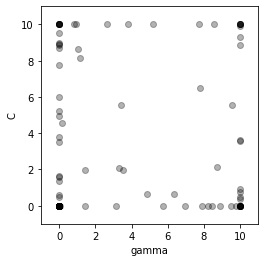

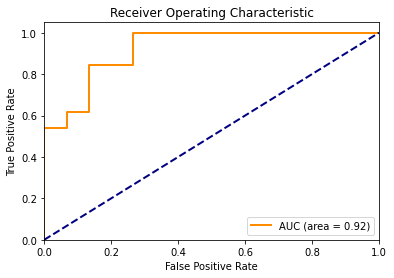

Accuracy for particle (in iteration 14, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 3.51982509e+00]
Accuracy for particle (in iteration 14, in fold 9) - 2 is 0.8571 At (gamma, c): [9.52810401 5.52985064]
Accuracy for particle (in iteration 14, in fold 9) - 3 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 14, in fold 9) - 4 is 0.9286 At (gamma, c): [ 0.79664396 10.        ]
Accuracy for particle (in iteration 14, in fold 9) - 5 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 14, in fold 9) - 6 is 0.8571 At (gamma, c): [10.          8.84432597]
Accuracy for particle (in iteration 14, in fold 9) - 7 is 0.8571 At (gamma, c): [4.83801128 0.63559561]
Accuracy for particle (in iteration 14, in fold 9) - 8 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 14, in fold 9) - 9 is 0.8571 At (gamma, c): [ 2.67013831 10.        ]
Accuracy for particle (in iteration 14, in fold 9) - 10 is 0.4643 At (gamma, c

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 14, in fold 9) - 95 is 0.6786 At (gamma, c): [0.001      0.48773211]
Accuracy for particle (in iteration 14, in fold 9) - 96 is 0.8571 At (gamma, c): [10.          9.31558287]
Accuracy for particle (in iteration 14, in fold 9) - 97 is 0.9286 At (gamma, c): [ 0.93493011 10.        ]
Accuracy for particle (in iteration 14, in fold 9) - 98 is 0.7857 At (gamma, c): [1.00000000e-03 4.96083961e+00]
Accuracy for particle (in iteration 14, in fold 9) - 99 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 14, in fold 9) - 100 is 0.4643 At (gamma, c): [1.42198889e+00 1.00000000e-03]
The best position in iteration 14, fold 9 is [0.06005793 0.001     ], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 36  94]]

Iteration 15 - Fold 9:



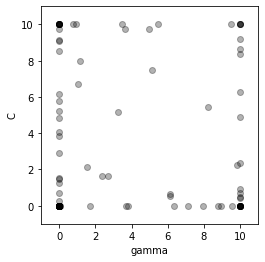

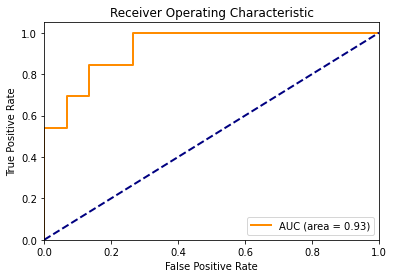

Accuracy for particle (in iteration 15, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 4.05822905e+00]
Accuracy for particle (in iteration 15, in fold 9) - 2 is 0.8571 At (gamma, c): [10.          6.27505058]
Accuracy for particle (in iteration 15, in fold 9) - 3 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 15, in fold 9) - 4 is 0.9286 At (gamma, c): [ 0.79327711 10.        ]
Accuracy for particle (in iteration 15, in fold 9) - 5 is 0.4643 At (gamma, c): [0.06005793 0.001     ]
Accuracy for particle (in iteration 15, in fold 9) - 6 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 15, in fold 9) - 7 is 0.8571 At (gamma, c): [6.1450411  0.53763344]
Accuracy for particle (in iteration 15, in fold 9) - 8 is 0.4643 At (gamma, c): [0.0653714 0.001    ]
Accuracy for particle (in iteration 15, in fold 9) - 9 is 0.8571 At (gamma, c): [ 3.46593392 10.        ]
Accuracy for particle (in iteration 15, in fold 9) - 10 is 0.4643 At (gamm

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 15, in fold 9) - 98 is 0.7857 At (gamma, c): [1.00000000e-03 5.75259665e+00]
Accuracy for particle (in iteration 15, in fold 9) - 99 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 15, in fold 9) - 100 is 0.4643 At (gamma, c): [1.70311654e+00 1.00000000e-03]
The best position in iteration 15, fold 9 is [0.001 0.001], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 33  97]]

Iteration 16 - Fold 9:



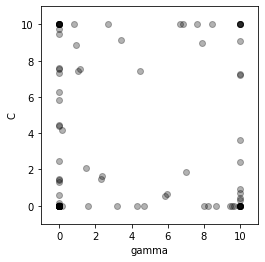

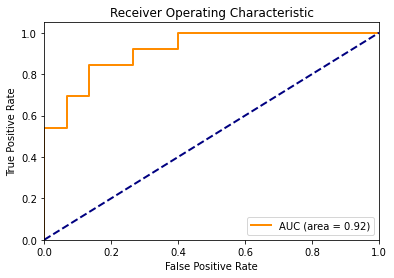

Accuracy for particle (in iteration 16, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 4.42520566e+00]
Accuracy for particle (in iteration 16, in fold 9) - 2 is 0.8571 At (gamma, c): [10.          7.21124649]
Accuracy for particle (in iteration 16, in fold 9) - 3 is 0.8571 At (gamma, c): [1.00000000e-03 9.76231309e+00]
Accuracy for particle (in iteration 16, in fold 9) - 4 is 0.9286 At (gamma, c): [ 0.7967081 10.       ]
Accuracy for particle (in iteration 16, in fold 9) - 5 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 16, in fold 9) - 6 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 16, in fold 9) - 7 is 0.8571 At (gamma, c): [5.8501855  0.55972332]
Accuracy for particle (in iteration 16, in fold 9) - 8 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 16, in fold 9) - 9 is 0.8571 At (gamma, c): [ 2.70354175 10.        ]
Accuracy for particle (in iteration 16, in fold 9) - 10 is 0.4643 At (gamma, c

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 16, in fold 9) - 94 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 16, in fold 9) - 95 is 0.4643 At (gamma, c): [0.001      0.14252906]
Accuracy for particle (in iteration 16, in fold 9) - 96 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 16, in fold 9) - 97 is 0.9286 At (gamma, c): [0.93324848 8.84058423]
Accuracy for particle (in iteration 16, in fold 9) - 98 is 0.7857 At (gamma, c): [1.00000000e-03 5.82794658e+00]
Accuracy for particle (in iteration 16, in fold 9) - 99 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 16, in fold 9) - 100 is 0.4643 At (gamma, c): [1.58497619e+00 1.00000000e-03]
The best position in iteration 16, fold 9 is [0.001 0.001], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 36  94]]

Iteration 17 - Fold 9:



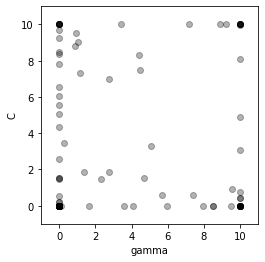

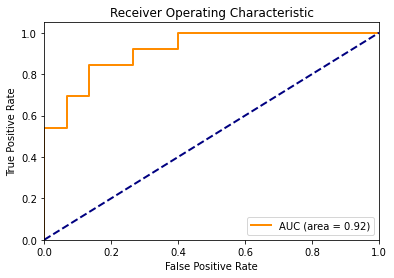

Accuracy for particle (in iteration 17, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 4.35466963e+00]
Accuracy for particle (in iteration 17, in fold 9) - 2 is 0.8571 At (gamma, c): [5.07853515 3.30460232]
Accuracy for particle (in iteration 17, in fold 9) - 3 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 17, in fold 9) - 4 is 0.9286 At (gamma, c): [0.85872566 8.79746848]
Accuracy for particle (in iteration 17, in fold 9) - 5 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 17, in fold 9) - 6 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 17, in fold 9) - 7 is 0.8571 At (gamma, c): [5.66430506 0.57364972]
Accuracy for particle (in iteration 17, in fold 9) - 8 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 17, in fold 9) - 9 is 0.8571 At (gamma, c): [ 3.43581854 10.        ]
Accuracy for particle (in iteration 17, in fold 9) - 10 is 0.4643 At (gamma, c): [0.001 0.001]
A

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 17, in fold 9) - 95 is 0.4643 At (gamma, c): [0.001      0.19731658]
Accuracy for particle (in iteration 17, in fold 9) - 96 is 0.8571 At (gamma, c): [10.          8.08207319]
Accuracy for particle (in iteration 17, in fold 9) - 97 is 0.9286 At (gamma, c): [0.93344295 9.54326364]
Accuracy for particle (in iteration 17, in fold 9) - 98 is 0.7857 At (gamma, c): [1.00000000e-03 6.53189125e+00]
Accuracy for particle (in iteration 17, in fold 9) - 99 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 17, in fold 9) - 100 is 0.4643 At (gamma, c): [1.63740031e+00 1.00000000e-03]
The best position in iteration 17, fold 9 is [0.001 0.001], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 36  94]]

Iteration 18 - Fold 9:



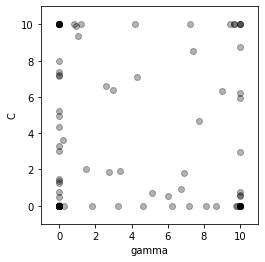

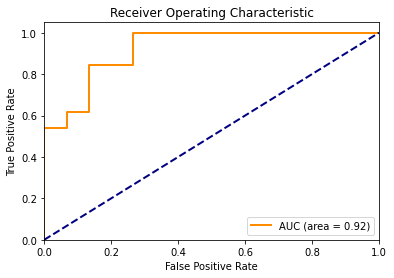

Accuracy for particle (in iteration 18, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 2.99408095e+00]
Accuracy for particle (in iteration 18, in fold 9) - 2 is 0.8571 At (gamma, c): [7.71067351 4.69479339]
Accuracy for particle (in iteration 18, in fold 9) - 3 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 18, in fold 9) - 4 is 0.9286 At (gamma, c): [ 0.84590334 10.        ]
Accuracy for particle (in iteration 18, in fold 9) - 5 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 18, in fold 9) - 6 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 18, in fold 9) - 7 is 0.8571 At (gamma, c): [5.99242269 0.54905634]
Accuracy for particle (in iteration 18, in fold 9) - 8 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 18, in fold 9) - 9 is 0.8571 At (gamma, c): [ 4.17264397 10.        ]
Accuracy for particle (in iteration 18, in fold 9) - 10 is 0.4643 At (gamma, c): [0.001 0.001]

Accuracy for particle (in iteration 18, in fold 9) - 99 is 0.8571 At (gamma, c): [ 9.65426289 10.        ]
Accuracy for particle (in iteration 18, in fold 9) - 100 is 0.4643 At (gamma, c): [1.82806581e+00 1.00000000e-03]
The best position in iteration 18, fold 9 is [0.02037272 0.001     ], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 37  93]]

Iteration 19 - Fold 9:



*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


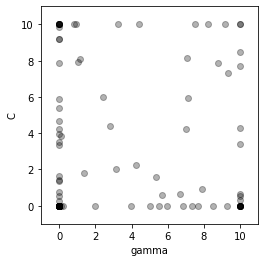

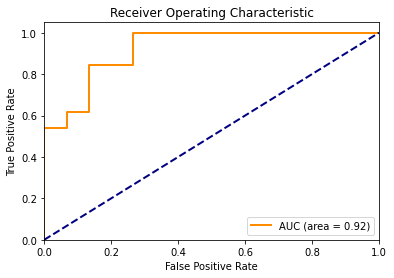

Accuracy for particle (in iteration 19, in fold 9) - 1 is 0.7857 At (gamma, c): [1.0000000e-03 3.3481718e+00]
Accuracy for particle (in iteration 19, in fold 9) - 2 is 0.8571 At (gamma, c): [7.01057316 4.24380676]
Accuracy for particle (in iteration 19, in fold 9) - 3 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 19, in fold 9) - 4 is 0.9286 At (gamma, c): [ 0.82228932 10.        ]
Accuracy for particle (in iteration 19, in fold 9) - 5 is 0.4643 At (gamma, c): [0.02037272 0.001     ]
Accuracy for particle (in iteration 19, in fold 9) - 6 is 0.8571 At (gamma, c): [9.34921074 7.31051867]
Accuracy for particle (in iteration 19, in fold 9) - 7 is 0.8571 At (gamma, c): [5.70800696 0.57037067]
Accuracy for particle (in iteration 19, in fold 9) - 8 is 0.4643 At (gamma, c): [0.13373774 0.001     ]
Accuracy for particle (in iteration 19, in fold 9) - 9 is 0.8571 At (gamma, c): [ 3.24435903 10.        ]
Accuracy for particle (in iteration 19, in fold 9) - 10 is 0.4

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 19, in fold 9) - 98 is 0.8214 At (gamma, c): [1.00000000e-03 9.20925172e+00]
Accuracy for particle (in iteration 19, in fold 9) - 99 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 19, in fold 9) - 100 is 0.4643 At (gamma, c): [1.99287792e+00 1.00000000e-03]
The best position in iteration 19, fold 9 is [0.05291492 0.001     ], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 37  93]]

Iteration 20 - Fold 9:



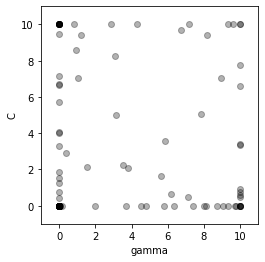

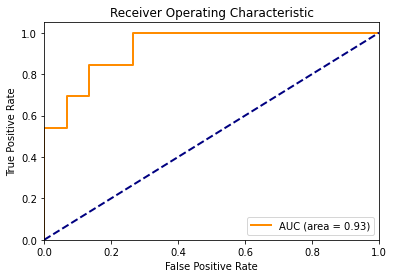

Accuracy for particle (in iteration 20, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 4.03977863e+00]
Accuracy for particle (in iteration 20, in fold 9) - 2 is 0.8571 At (gamma, c): [5.85651688 3.58440565]
Accuracy for particle (in iteration 20, in fold 9) - 3 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 20, in fold 9) - 4 is 0.9286 At (gamma, c): [ 0.82655674 10.        ]
Accuracy for particle (in iteration 20, in fold 9) - 5 is 0.4643 At (gamma, c): [0.05291492 0.001     ]
Accuracy for particle (in iteration 20, in fold 9) - 6 is 0.8571 At (gamma, c): [10.          7.77754375]
Accuracy for particle (in iteration 20, in fold 9) - 7 is 0.6786 At (gamma, c): [7.12577565 0.46411336]
Accuracy for particle (in iteration 20, in fold 9) - 8 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 20, in fold 9) - 9 is 0.8571 At (gamma, c): [ 2.88869032 10.        ]
Accuracy for particle (in iteration 20, in fold 9) - 10 is 0.4643 At

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 20, in fold 9) - 99 is 0.8571 At (gamma, c): [ 9.58239649 10.        ]
Accuracy for particle (in iteration 20, in fold 9) - 100 is 0.4643 At (gamma, c): [1.95880418e+00 1.00000000e-03]
The best position in iteration 20, fold 9 is [0.03999337 0.001     ], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 33  97]]

Iteration 21 - Fold 9:



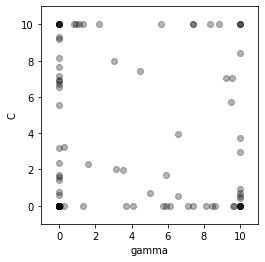

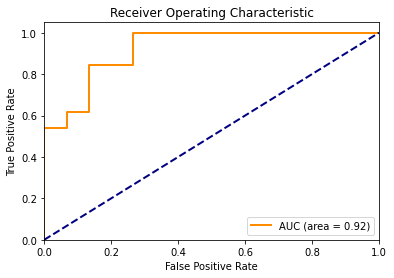

Accuracy for particle (in iteration 21, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 3.16115096e+00]
Accuracy for particle (in iteration 21, in fold 9) - 2 is 0.8571 At (gamma, c): [6.54599156 3.94445243]
Accuracy for particle (in iteration 21, in fold 9) - 3 is 0.8571 At (gamma, c): [1.00000000e-03 9.32116755e+00]
Accuracy for particle (in iteration 21, in fold 9) - 4 is 0.9286 At (gamma, c): [ 0.83685768 10.        ]
Accuracy for particle (in iteration 21, in fold 9) - 5 is 0.4643 At (gamma, c): [0.03999337 0.001     ]
Accuracy for particle (in iteration 21, in fold 9) - 6 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 21, in fold 9) - 7 is 0.6786 At (gamma, c): [6.55298214 0.50704158]
Accuracy for particle (in iteration 21, in fold 9) - 8 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 21, in fold 9) - 9 is 0.8571 At (gamma, c): [ 2.19332401 10.        ]
Accuracy for particle (in iteration 21, in fold 9) - 10 is 0.4643 At

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 21, in fold 9) - 97 is 0.9286 At (gamma, c): [ 0.93592349 10.        ]
Accuracy for particle (in iteration 21, in fold 9) - 98 is 0.7857 At (gamma, c): [1.00000000e-03 7.16595378e+00]
Accuracy for particle (in iteration 21, in fold 9) - 99 is 0.8571 At (gamma, c): [ 8.33677196 10.        ]
Accuracy for particle (in iteration 21, in fold 9) - 100 is 0.4643 At (gamma, c): [1.32269232e+00 1.00000000e-03]
The best position in iteration 21, fold 9 is [0.001 0.001], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 38  92]]

Iteration 22 - Fold 9:



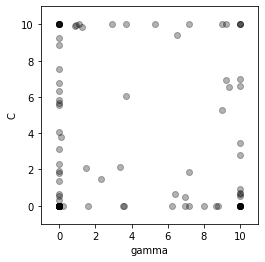

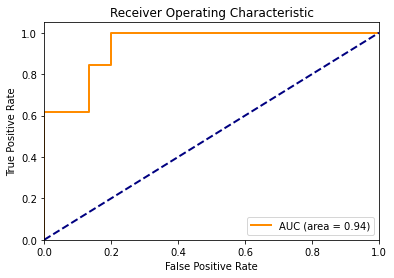

Accuracy for particle (in iteration 22, in fold 9) - 1 is 0.7857 At (gamma, c): [1.0000000e-03 2.2894275e+00]
Accuracy for particle (in iteration 22, in fold 9) - 2 is 0.8571 At (gamma, c): [8.99710308 5.25507303]
Accuracy for particle (in iteration 22, in fold 9) - 3 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 22, in fold 9) - 4 is 0.9286 At (gamma, c): [0.85301535 9.90515806]
Accuracy for particle (in iteration 22, in fold 9) - 5 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 22, in fold 9) - 6 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 22, in fold 9) - 7 is 0.6786 At (gamma, c): [6.94480661 0.47767533]
Accuracy for particle (in iteration 22, in fold 9) - 8 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 22, in fold 9) - 9 is 0.8571 At (gamma, c): [ 2.93874963 10.        ]
Accuracy for particle (in iteration 22, in fold 9) - 10 is 0.4643 At (gamma, c): [0.001 0.001]
Acc

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


The best position in iteration 22, fold 9 is [0.12541762 0.001     ], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 35  95]]

Iteration 23 - Fold 9:



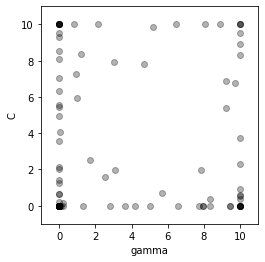

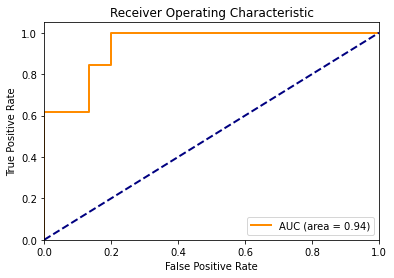

Accuracy for particle (in iteration 23, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 2.10808901e+00]
Accuracy for particle (in iteration 23, in fold 9) - 2 is 0.8571 At (gamma, c): [9.20642775 5.36397665]
Accuracy for particle (in iteration 23, in fold 9) - 3 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 23, in fold 9) - 4 is 0.9286 At (gamma, c): [ 0.82235583 10.        ]
Accuracy for particle (in iteration 23, in fold 9) - 5 is 0.4643 At (gamma, c): [0.12541762 0.001     ]
Accuracy for particle (in iteration 23, in fold 9) - 6 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 23, in fold 9) - 7 is 0.6786 At (gamma, c): [8.33826392 0.37324025]
Accuracy for particle (in iteration 23, in fold 9) - 8 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 23, in fold 9) - 9 is 0.8571 At (gamma, c): [ 2.13681672 10.        ]
Accuracy for particle (in iteration 23, in fold 9) - 10 is 0.4643 At (gamma, c): [0.

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 23, in fold 9) - 96 is 0.8571 At (gamma, c): [10.         8.9383214]
Accuracy for particle (in iteration 23, in fold 9) - 97 is 0.9286 At (gamma, c): [0.93225319 7.2881194 ]
Accuracy for particle (in iteration 23, in fold 9) - 98 is 0.7857 At (gamma, c): [1.00000000e-03 8.52716355e+00]
Accuracy for particle (in iteration 23, in fold 9) - 99 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 23, in fold 9) - 100 is 0.4643 At (gamma, c): [1.29305486e+00 1.00000000e-03]
The best position in iteration 23, fold 9 is [0.07209742 0.001     ], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 34  96]]

Iteration 24 - Fold 9:



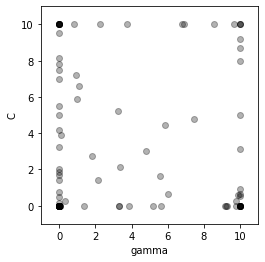

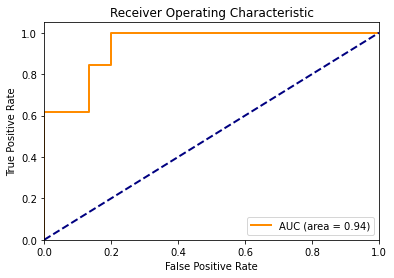

Accuracy for particle (in iteration 24, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 1.88542527e+00]
Accuracy for particle (in iteration 24, in fold 9) - 2 is 0.8571 At (gamma, c): [4.78302999 2.99171052]
Accuracy for particle (in iteration 24, in fold 9) - 3 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 24, in fold 9) - 4 is 0.9286 At (gamma, c): [ 0.79644307 10.        ]
Accuracy for particle (in iteration 24, in fold 9) - 5 is 0.4643 At (gamma, c): [0.07209742 0.001     ]
Accuracy for particle (in iteration 24, in fold 9) - 6 is 0.8571 At (gamma, c): [10.          8.69887717]
Accuracy for particle (in iteration 24, in fold 9) - 7 is 0.5357 At (gamma, c): [9.75616664 0.26697308]
Accuracy for particle (in iteration 24, in fold 9) - 8 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 24, in fold 9) - 9 is 0.8571 At (gamma, c): [ 2.27393455 10.        ]
Accuracy for particle (in iteration 24, in fold 9) - 10 is 0.4643 At

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 24, in fold 9) - 96 is 0.8571 At (gamma, c): [10.          9.19102129]
Accuracy for particle (in iteration 24, in fold 9) - 97 is 0.9286 At (gamma, c): [0.93207757 7.22865061]
Accuracy for particle (in iteration 24, in fold 9) - 98 is 0.7857 At (gamma, c): [1.00000000e-03 4.99244421e+00]
Accuracy for particle (in iteration 24, in fold 9) - 99 is 0.8571 At (gamma, c): [ 8.53264407 10.        ]
Accuracy for particle (in iteration 24, in fold 9) - 100 is 0.4643 At (gamma, c): [1.39915857e+00 1.00000000e-03]
The best position in iteration 24, fold 9 is [0.19663239 0.001     ], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 39  91]]

Iteration 25 - Fold 9:



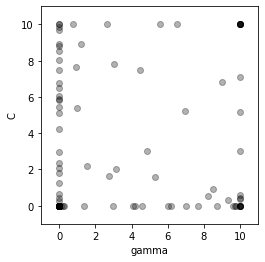

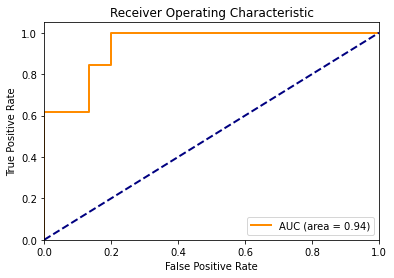

Accuracy for particle (in iteration 25, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 2.33272191e+00]
Accuracy for particle (in iteration 25, in fold 9) - 2 is 0.8571 At (gamma, c): [4.87210449 3.03883607]
Accuracy for particle (in iteration 25, in fold 9) - 3 is 0.7857 At (gamma, c): [1.00000000e-03 8.93916813e+00]
Accuracy for particle (in iteration 25, in fold 9) - 4 is 0.9286 At (gamma, c): [ 0.76374956 10.        ]
Accuracy for particle (in iteration 25, in fold 9) - 5 is 0.4643 At (gamma, c): [0.19663239 0.001     ]
Accuracy for particle (in iteration 25, in fold 9) - 6 is 0.8571 At (gamma, c): [8.97323525 6.84241506]
Accuracy for particle (in iteration 25, in fold 9) - 7 is 0.5357 At (gamma, c): [9.33179369 0.29877825]
Accuracy for particle (in iteration 25, in fold 9) - 8 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 25, in fold 9) - 9 is 0.8571 At (gamma, c): [ 2.63418634 10.        ]
Accuracy for particle (in iteration 25, in fold 9) - 1

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 25, in fold 9) - 99 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 25, in fold 9) - 100 is 0.4643 At (gamma, c): [1.35022865e+00 1.00000000e-03]
The best position in iteration 25, fold 9 is [0.001 0.001], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 35  95]]

Iteration 26 - Fold 9:



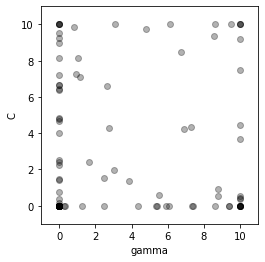

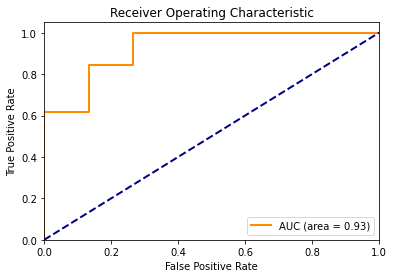

Accuracy for particle (in iteration 26, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 2.50793444e+00]
Accuracy for particle (in iteration 26, in fold 9) - 2 is 0.8571 At (gamma, c): [7.26445687 4.31887449]
Accuracy for particle (in iteration 26, in fold 9) - 3 is 0.7857 At (gamma, c): [1.00000000e-03 8.12879021e+00]
Accuracy for particle (in iteration 26, in fold 9) - 4 is 0.9286 At (gamma, c): [0.82527616 9.85378309]
Accuracy for particle (in iteration 26, in fold 9) - 5 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 26, in fold 9) - 6 is 0.8571 At (gamma, c): [10.          9.20431503]
Accuracy for particle (in iteration 26, in fold 9) - 7 is 0.8571 At (gamma, c): [5.5097463 0.5852277]
Accuracy for particle (in iteration 26, in fold 9) - 8 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 26, in fold 9) - 9 is 0.8571 At (gamma, c): [ 3.1081107 10.       ]
Accuracy for particle (in iteration 26, in fold 9) - 10 is 0.4643 At

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 26, in fold 9) - 97 is 0.9286 At (gamma, c): [0.93206461 7.28440635]
Accuracy for particle (in iteration 26, in fold 9) - 98 is 0.7857 At (gamma, c): [1.00000000e-03 4.66832112e+00]
Accuracy for particle (in iteration 26, in fold 9) - 99 is 0.8571 At (gamma, c): [ 9.47902237 10.        ]
Accuracy for particle (in iteration 26, in fold 9) - 100 is 0.4643 At (gamma, c): [1.2845915e+00 1.0000000e-03]
The best position in iteration 26, fold 9 is [0.001 0.001], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 37  93]]

Iteration 27 - Fold 9:



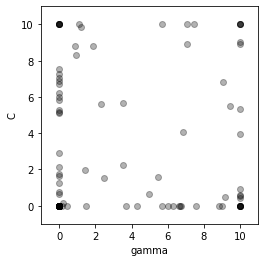

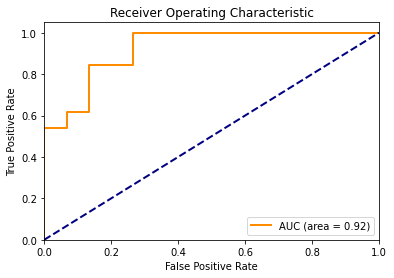

Accuracy for particle (in iteration 27, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 2.90497536e+00]
Accuracy for particle (in iteration 27, in fold 9) - 2 is 0.8571 At (gamma, c): [9.43026567 5.47770094]
Accuracy for particle (in iteration 27, in fold 9) - 3 is 0.7857 At (gamma, c): [1.00000000e-03 7.55826463e+00]
Accuracy for particle (in iteration 27, in fold 9) - 4 is 0.9286 At (gamma, c): [0.85940318 8.80456212]
Accuracy for particle (in iteration 27, in fold 9) - 5 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 27, in fold 9) - 6 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 27, in fold 9) - 7 is 0.8571 At (gamma, c): [4.94256677 0.62773583]
Accuracy for particle (in iteration 27, in fold 9) - 8 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 27, in fold 9) - 9 is 0.8571 At (gamma, c): [1.85499381 8.83932811]
Accuracy for particle (in iteration 27, in fold 9) - 10 is 0.4643 At (gamma, c): [

Accuracy for particle (in iteration 27, in fold 9) - 98 is 0.7857 At (gamma, c): [1.00000000e-03 5.09841463e+00]
Accuracy for particle (in iteration 27, in fold 9) - 99 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 27, in fold 9) - 100 is 0.4643 At (gamma, c): [1.50331359e+00 1.00000000e-03]
The best position in iteration 27, fold 9 is [0.001 0.001], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 38  92]]

Iteration 28 - Fold 9:



*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


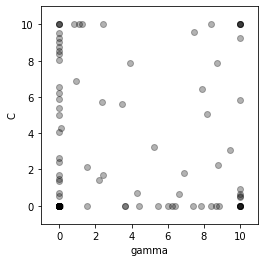

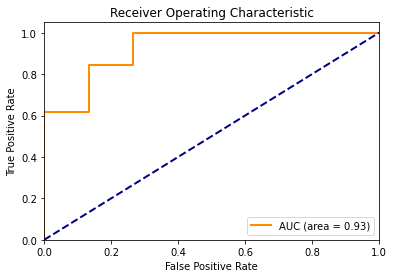

Accuracy for particle (in iteration 28, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 2.65036855e+00]
Accuracy for particle (in iteration 28, in fold 9) - 2 is 0.8571 At (gamma, c): [5.24663121 3.2390418 ]
Accuracy for particle (in iteration 28, in fold 9) - 3 is 0.7857 At (gamma, c): [1.00000000e-03 8.35247566e+00]
Accuracy for particle (in iteration 28, in fold 9) - 4 is 0.9286 At (gamma, c): [ 0.83076548 10.        ]
Accuracy for particle (in iteration 28, in fold 9) - 5 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 28, in fold 9) - 6 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 28, in fold 9) - 7 is 0.8571 At (gamma, c): [4.32218851 0.67423108]
Accuracy for particle (in iteration 28, in fold 9) - 8 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 28, in fold 9) - 9 is 0.8571 At (gamma, c): [ 2.41278803 10.        ]
Accuracy for particle (in iteration 28, in fold 9) - 10 is 0.4643 At (gamma, c

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 28, in fold 9) - 94 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 28, in fold 9) - 95 is 0.7500 At (gamma, c): [0.001      0.54252648]
Accuracy for particle (in iteration 28, in fold 9) - 96 is 0.8571 At (gamma, c): [8.15303417 5.0839784 ]
Accuracy for particle (in iteration 28, in fold 9) - 97 is 0.9286 At (gamma, c): [0.9318373  6.87725435]
Accuracy for particle (in iteration 28, in fold 9) - 98 is 0.7857 At (gamma, c): [1.00000000e-03 6.53773479e+00]
Accuracy for particle (in iteration 28, in fold 9) - 99 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 28, in fold 9) - 100 is 0.4643 At (gamma, c): [1.56886589e+00 1.00000000e-03]
The best position in iteration 28, fold 9 is [0.14730553 0.001     ], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 40  90]]

I

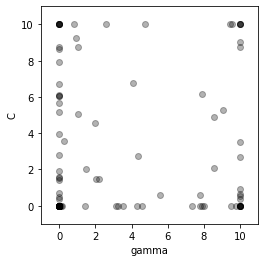

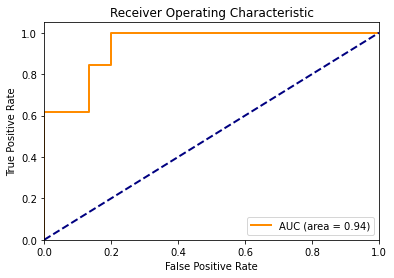

Accuracy for particle (in iteration 29, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 1.90888219e+00]
Accuracy for particle (in iteration 29, in fold 9) - 2 is 0.8571 At (gamma, c): [4.3499638  2.75923849]
Accuracy for particle (in iteration 29, in fold 9) - 3 is 0.7857 At (gamma, c): [1.00000000e-03 8.73413408e+00]
Accuracy for particle (in iteration 29, in fold 9) - 4 is 0.9286 At (gamma, c): [ 0.81628513 10.        ]
Accuracy for particle (in iteration 29, in fold 9) - 5 is 0.4643 At (gamma, c): [0.14730553 0.001     ]
Accuracy for particle (in iteration 29, in fold 9) - 6 is 0.8571 At (gamma, c): [7.91200098 6.17608496]
Accuracy for particle (in iteration 29, in fold 9) - 7 is 0.8571 At (gamma, c): [5.568751   0.58080533]
Accuracy for particle (in iteration 29, in fold 9) - 8 is 0.4643 At (gamma, c): [0.04656116 0.001     ]
Accuracy for particle (in iteration 29, in fold 9) - 9 is 0.8571 At (gamma, c): [ 2.56356613 10.        ]
Accuracy for particle (in iteration 29, in f

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 29, in fold 9) - 98 is 0.7857 At (gamma, c): [1.00000000e-03 7.91720329e+00]
Accuracy for particle (in iteration 29, in fold 9) - 99 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 29, in fold 9) - 100 is 0.4643 At (gamma, c): [1.45652058e+00 1.00000000e-03]
The best position in iteration 29, fold 9 is [0.24563109 0.001     ], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 38  92]]

Iteration 30 - Fold 9:



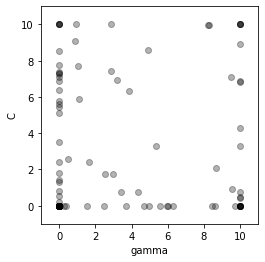

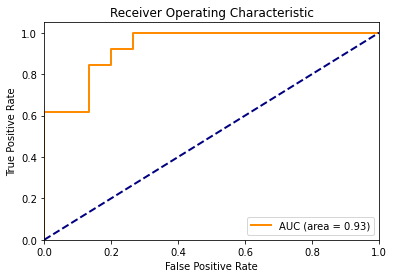

Accuracy for particle (in iteration 30, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 2.43304398e+00]
Accuracy for particle (in iteration 30, in fold 9) - 2 is 0.8571 At (gamma, c): [5.32933948 3.28326292]
Accuracy for particle (in iteration 30, in fold 9) - 3 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 30, in fold 9) - 4 is 0.9286 At (gamma, c): [0.85270873 9.07963967]
Accuracy for particle (in iteration 30, in fold 9) - 5 is 0.4643 At (gamma, c): [0.24563109 0.001     ]
Accuracy for particle (in iteration 30, in fold 9) - 6 is 0.8571 At (gamma, c): [10.          8.90203056]
Accuracy for particle (in iteration 30, in fold 9) - 7 is 0.8571 At (gamma, c): [3.40215525 0.7431845 ]
Accuracy for particle (in iteration 30, in fold 9) - 8 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 30, in fold 9) - 9 is 0.8571 At (gamma, c): [ 2.85436485 10.        ]
Accuracy for particle (in iteration 30, in fold 9) - 10 is 0.4643 At (

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 30, in fold 9) - 96 is 0.8571 At (gamma, c): [10.          6.84934037]
Accuracy for particle (in iteration 30, in fold 9) - 97 is 0.9286 At (gamma, c): [ 0.9337212 10.       ]
Accuracy for particle (in iteration 30, in fold 9) - 98 is 0.7857 At (gamma, c): [1.00000000e-03 5.76868892e+00]
Accuracy for particle (in iteration 30, in fold 9) - 99 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 30, in fold 9) - 100 is 0.4643 At (gamma, c): [1.56820706e+00 1.00000000e-03]
The best position in iteration 30, fold 9 is [0.001 0.001], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 35  95]]

Iteration 31 - Fold 9:



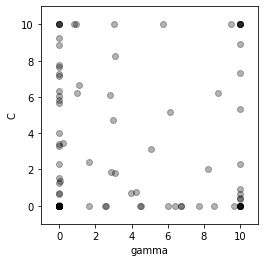

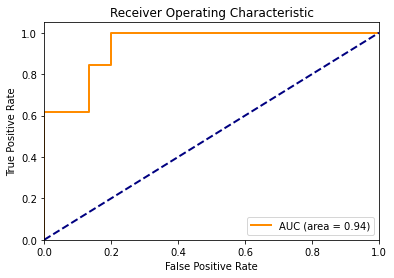

Accuracy for particle (in iteration 31, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 2.30264495e+00]
Accuracy for particle (in iteration 31, in fold 9) - 2 is 0.8571 At (gamma, c): [5.05765858 3.13789421]
Accuracy for particle (in iteration 31, in fold 9) - 3 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 31, in fold 9) - 4 is 0.9286 At (gamma, c): [ 0.82333911 10.        ]
Accuracy for particle (in iteration 31, in fold 9) - 5 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 31, in fold 9) - 6 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 31, in fold 9) - 7 is 0.8571 At (gamma, c): [3.97482892 0.7002645 ]
Accuracy for particle (in iteration 31, in fold 9) - 8 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 31, in fold 9) - 9 is 0.8571 At (gamma, c): [ 3.02343214 10.        ]
Accuracy for particle (in iteration 31, in fold 9) - 10 is 0.4643 At (gamma, c): [0.001 0.001]

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 31, in fold 9) - 99 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 31, in fold 9) - 100 is 0.4643 At (gamma, c): [1.63218044e+00 1.00000000e-03]
The best position in iteration 31, fold 9 is [0.001 0.001], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 35  95]]

Iteration 32 - Fold 9:



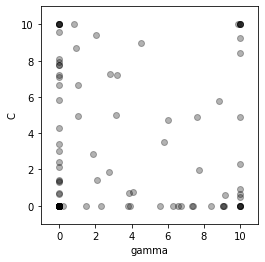

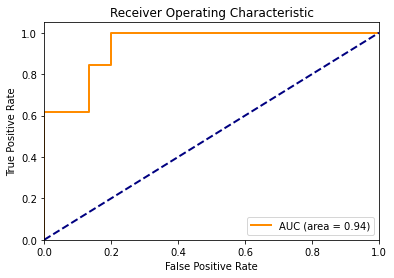

Accuracy for particle (in iteration 32, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 2.41051945e+00]
Accuracy for particle (in iteration 32, in fold 9) - 2 is 0.8571 At (gamma, c): [5.79499735 3.53241629]
Accuracy for particle (in iteration 32, in fold 9) - 3 is 0.7857 At (gamma, c): [1.000000e-03 8.104506e+00]
Accuracy for particle (in iteration 32, in fold 9) - 4 is 0.9286 At (gamma, c): [ 0.83627253 10.        ]
Accuracy for particle (in iteration 32, in fold 9) - 5 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 32, in fold 9) - 6 is 0.8571 At (gamma, c): [10.          9.24524088]
Accuracy for particle (in iteration 32, in fold 9) - 7 is 0.8571 At (gamma, c): [3.86527635 0.7084751 ]
Accuracy for particle (in iteration 32, in fold 9) - 8 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 32, in fold 9) - 9 is 0.8571 At (gamma, c): [2.06064765 9.43753529]
Accuracy for particle (in iteration 32, in fold 9) - 10 is 0.4643 At

Accuracy for particle (in iteration 32, in fold 9) - 80 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 32, in fold 9) - 81 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 32, in fold 9) - 82 is 0.8214 At (gamma, c): [0.001      0.62724408]
Accuracy for particle (in iteration 32, in fold 9) - 83 is 0.7857 At (gamma, c): [1.00000000e-03 5.82757126e+00]
Accuracy for particle (in iteration 32, in fold 9) - 84 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 32, in fold 9) - 85 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 32, in fold 9) - 86 is 0.4643 At (gamma, c): [8.39001966e+00 1.00000000e-03]
Accuracy for particle (in iteration 32, in fold 9) - 87 is 0.8571 At (gamma, c): [4.07128448 0.76462529]
Accuracy for particle (in iteration 32, in fold 9) - 88 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 32, in fold 9) - 89 is 0.4643 At (gamma, c): [0.001 0.0

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 32, in fold 9) - 98 is 0.7857 At (gamma, c): [1.00000000e-03 3.02732301e+00]
Accuracy for particle (in iteration 32, in fold 9) - 99 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 32, in fold 9) - 100 is 0.4643 At (gamma, c): [1.50106235e+00 1.00000000e-03]
The best position in iteration 32, fold 9 is [0.001 0.001], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 35  95]]

Iteration 33 - Fold 9:



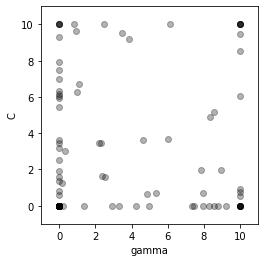

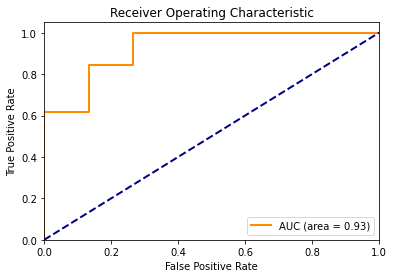

Accuracy for particle (in iteration 33, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 2.51328079e+00]
Accuracy for particle (in iteration 33, in fold 9) - 2 is 0.8571 At (gamma, c): [6.02848351 3.65734573]
Accuracy for particle (in iteration 33, in fold 9) - 3 is 0.7857 At (gamma, c): [1.00000000e-03 7.94453019e+00]
Accuracy for particle (in iteration 33, in fold 9) - 4 is 0.9286 At (gamma, c): [ 0.81625881 10.        ]
Accuracy for particle (in iteration 33, in fold 9) - 5 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 33, in fold 9) - 6 is 0.8571 At (gamma, c): [10.          8.51231065]
Accuracy for particle (in iteration 33, in fold 9) - 7 is 0.8571 At (gamma, c): [4.86653724 0.6334339 ]
Accuracy for particle (in iteration 33, in fold 9) - 8 is 0.4643 At (gamma, c): [0.21683019 0.001     ]
Accuracy for particle (in iteration 33, in fold 9) - 9 is 0.8571 At (gamma, c): [ 2.45217175 10.        ]
Accuracy for particle (in iteration 33, in fold 9) -

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 33, in fold 9) - 99 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 33, in fold 9) - 100 is 0.4643 At (gamma, c): [1.38258295e+00 1.00000000e-03]
The best position in iteration 33, fold 9 is [0.001 0.001], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 37  93]]

Iteration 34 - Fold 9:



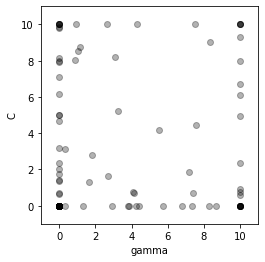

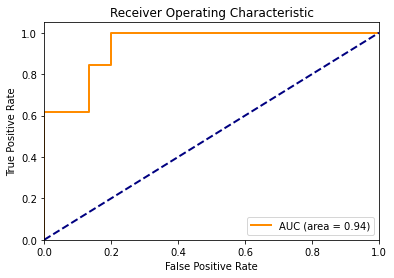

Accuracy for particle (in iteration 34, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 2.36315752e+00]
Accuracy for particle (in iteration 34, in fold 9) - 2 is 0.8571 At (gamma, c): [7.56522309 4.47959803]
Accuracy for particle (in iteration 34, in fold 9) - 3 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 34, in fold 9) - 4 is 0.9286 At (gamma, c): [0.86369432 8.04799653]
Accuracy for particle (in iteration 34, in fold 9) - 5 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 34, in fold 9) - 6 is 0.8571 At (gamma, c): [10.         7.9723364]
Accuracy for particle (in iteration 34, in fold 9) - 7 is 0.8571 At (gamma, c): [4.15264544 0.68693773]
Accuracy for particle (in iteration 34, in fold 9) - 8 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 34, in fold 9) - 9 is 0.8571 At (gamma, c): [ 2.62202092 10.        ]
Accuracy for particle (in iteration 34, in fold 9) - 10 is 0.4643 At (gamma, c): [

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 34, in fold 9) - 96 is 0.8571 At (gamma, c): [10.          6.10882193]
Accuracy for particle (in iteration 34, in fold 9) - 97 is 0.9286 At (gamma, c): [ 0.93442129 10.        ]
Accuracy for particle (in iteration 34, in fold 9) - 98 is 0.7857 At (gamma, c): [1.00000000e-03 4.97835488e+00]
Accuracy for particle (in iteration 34, in fold 9) - 99 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 34, in fold 9) - 100 is 0.4643 At (gamma, c): [1.33101862e+00 1.00000000e-03]
The best position in iteration 34, fold 9 is [0.001 0.001], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 35  95]]

Iteration 35 - Fold 9:



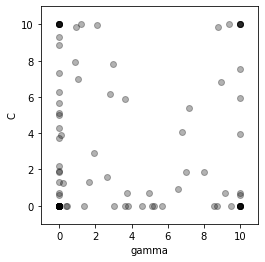

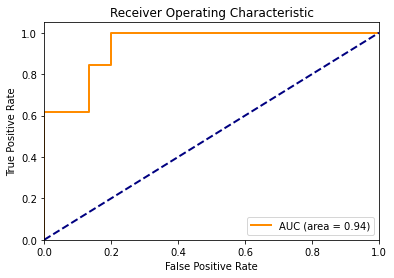

Accuracy for particle (in iteration 35, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 2.18974825e+00]
Accuracy for particle (in iteration 35, in fold 9) - 2 is 0.8571 At (gamma, c): [6.7845836  4.06190662]
Accuracy for particle (in iteration 35, in fold 9) - 3 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 35, in fold 9) - 4 is 0.9286 At (gamma, c): [0.87218411 7.93160262]
Accuracy for particle (in iteration 35, in fold 9) - 5 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 35, in fold 9) - 6 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 35, in fold 9) - 7 is 0.8571 At (gamma, c): [3.76731263 0.71581715]
Accuracy for particle (in iteration 35, in fold 9) - 8 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 35, in fold 9) - 9 is 0.8571 At (gamma, c): [2.09818759 9.98763403]
Accuracy for particle (in iteration 35, in fold 9) - 10 is 0.4643 At (gamma, c): [0.001 0.001]
Acc

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 35, in fold 9) - 95 is 0.8929 At (gamma, c): [0.001      0.56810158]
Accuracy for particle (in iteration 35, in fold 9) - 96 is 0.8571 At (gamma, c): [10.         5.9687582]
Accuracy for particle (in iteration 35, in fold 9) - 97 is 0.9286 At (gamma, c): [0.93395727 9.85706335]
Accuracy for particle (in iteration 35, in fold 9) - 98 is 0.7857 At (gamma, c): [1.00000000e-03 4.98463317e+00]
Accuracy for particle (in iteration 35, in fold 9) - 99 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 35, in fold 9) - 100 is 0.4643 At (gamma, c): [1.36980674e+00 1.00000000e-03]
The best position in iteration 35, fold 9 is [0.001 0.001], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 36  94]]

Iteration 36 - Fold 9:



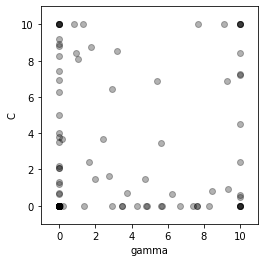

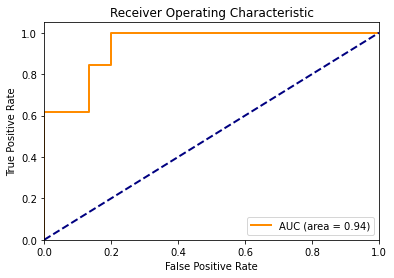

Accuracy for particle (in iteration 36, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 2.07603841e+00]
Accuracy for particle (in iteration 36, in fold 9) - 2 is 0.8571 At (gamma, c): [5.63532037 3.44697836]
Accuracy for particle (in iteration 36, in fold 9) - 3 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 36, in fold 9) - 4 is 0.9286 At (gamma, c): [ 0.84204843 10.        ]
Accuracy for particle (in iteration 36, in fold 9) - 5 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 36, in fold 9) - 6 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 36, in fold 9) - 7 is 0.8571 At (gamma, c): [3.7219065  0.71922019]
Accuracy for particle (in iteration 36, in fold 9) - 8 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 36, in fold 9) - 9 is 0.8571 At (gamma, c): [1.76764707 8.76610512]
Accuracy for particle (in iteration 36, in fold 9) - 10 is 0.4643 At (gamma, c): [0.001 0.001]
A

Accuracy for particle (in iteration 36, in fold 9) - 98 is 0.7857 At (gamma, c): [1.00000000e-03 3.79279088e+00]
Accuracy for particle (in iteration 36, in fold 9) - 99 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 36, in fold 9) - 100 is 0.4643 At (gamma, c): [1.35081019e+00 1.00000000e-03]
The best position in iteration 36, fold 9 is [0.24360132 0.001     ], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 34  96]]

Iteration 37 - Fold 9:



*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


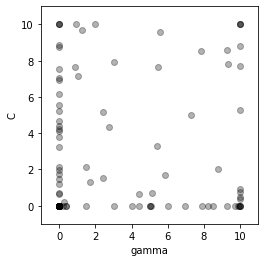

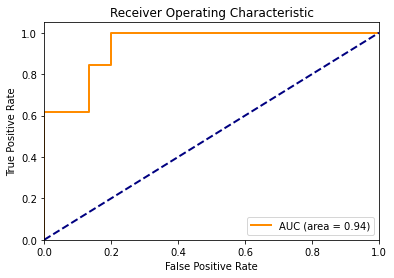

Accuracy for particle (in iteration 37, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 1.94228079e+00]
Accuracy for particle (in iteration 37, in fold 9) - 2 is 0.8571 At (gamma, c): [5.37905864 3.30986217]
Accuracy for particle (in iteration 37, in fold 9) - 3 is 0.7857 At (gamma, c): [1.00000000e-03 6.94486302e+00]
Accuracy for particle (in iteration 37, in fold 9) - 4 is 0.9286 At (gamma, c): [0.87346346 7.65670971]
Accuracy for particle (in iteration 37, in fold 9) - 5 is 0.4643 At (gamma, c): [0.24360132 0.001     ]
Accuracy for particle (in iteration 37, in fold 9) - 6 is 0.8571 At (gamma, c): [9.31844146 7.82474628]
Accuracy for particle (in iteration 37, in fold 9) - 7 is 0.8571 At (gamma, c): [4.42282932 0.66668834]
Accuracy for particle (in iteration 37, in fold 9) - 8 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 37, in fold 9) - 9 is 0.8571 At (gamma, c): [ 1.98677142 10.        ]
Accuracy for particle (in iteration 37, in fold 9) - 10 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 37, in fold 9) - 95 is 0.7857 At (gamma, c): [0.001      0.66205856]
Accuracy for particle (in iteration 37, in fold 9) - 96 is 0.8571 At (gamma, c): [10.          7.70777525]
Accuracy for particle (in iteration 37, in fold 9) - 97 is 0.9286 At (gamma, c): [ 0.93464052 10.        ]
Accuracy for particle (in iteration 37, in fold 9) - 98 is 0.7857 At (gamma, c): [1.00000000e-03 4.21346695e+00]
Accuracy for particle (in iteration 37, in fold 9) - 99 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 37, in fold 9) - 100 is 0.4643 At (gamma, c): [1.50479233e+00 1.00000000e-03]
The best position in iteration 37, fold 9 is [0.001 0.001], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 38  92]]

Iteration 38 - Fold 9:



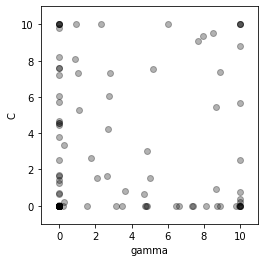

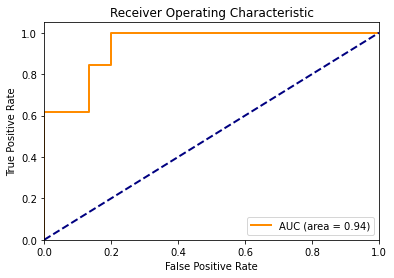

Accuracy for particle (in iteration 38, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 1.66396046e+00]
Accuracy for particle (in iteration 38, in fold 9) - 2 is 0.8571 At (gamma, c): [4.86808864 3.03646105]
Accuracy for particle (in iteration 38, in fold 9) - 3 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 38, in fold 9) - 4 is 0.9286 At (gamma, c): [0.87295032 8.07413238]
Accuracy for particle (in iteration 38, in fold 9) - 5 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 38, in fold 9) - 6 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 38, in fold 9) - 7 is 0.8571 At (gamma, c): [4.71438098 0.64483751]
Accuracy for particle (in iteration 38, in fold 9) - 8 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 38, in fold 9) - 9 is 0.8571 At (gamma, c): [ 2.29834486 10.        ]
Accuracy for particle (in iteration 38, in fold 9) - 10 is 0.4643 At (gamma, c): [0.001 0.001]
A

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 38, in fold 9) - 93 is 0.4643 At (gamma, c): [8.12408612e+00 1.00000000e-03]
Accuracy for particle (in iteration 38, in fold 9) - 94 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 38, in fold 9) - 95 is 0.7857 At (gamma, c): [0.001      0.68563403]
Accuracy for particle (in iteration 38, in fold 9) - 96 is 0.8571 At (gamma, c): [10.          8.80237478]
Accuracy for particle (in iteration 38, in fold 9) - 97 is 0.9286 At (gamma, c): [ 0.93444799 10.        ]
Accuracy for particle (in iteration 38, in fold 9) - 98 is 0.7857 At (gamma, c): [1.00000000e-03 4.56477703e+00]
Accuracy for particle (in iteration 38, in fold 9) - 99 is 0.8571 At (gamma, c): [7.96615127 9.35804123]
Accuracy for particle (in iteration 38, in fold 9) - 100 is 0.4643 At (gamma, c): [1.5628933e+00 1.0000000e-03]
The best position in iteration 38, fold 9 is [0.06469926 0.001     ], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Scor

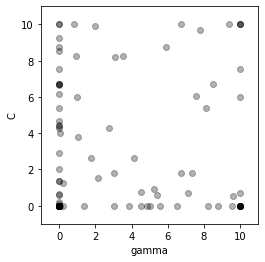

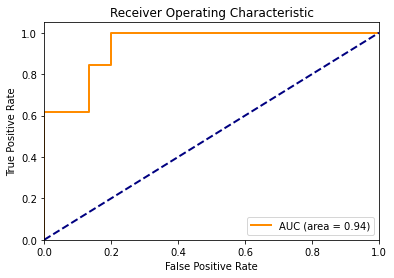

Accuracy for particle (in iteration 39, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 2.00634531e+00]
Accuracy for particle (in iteration 39, in fold 9) - 2 is 0.8571 At (gamma, c): [4.11127219 2.63151661]
Accuracy for particle (in iteration 39, in fold 9) - 3 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 39, in fold 9) - 4 is 0.9286 At (gamma, c): [ 0.84364593 10.        ]
Accuracy for particle (in iteration 39, in fold 9) - 5 is 0.4643 At (gamma, c): [0.06469926 0.001     ]
Accuracy for particle (in iteration 39, in fold 9) - 6 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 39, in fold 9) - 7 is 0.8571 At (gamma, c): [5.40534191 0.59305227]
Accuracy for particle (in iteration 39, in fold 9) - 8 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 39, in fold 9) - 9 is 0.8571 At (gamma, c): [1.99995656 9.90187543]
Accuracy for particle (in iteration 39, in fold 9) - 10 is 0.4643 At (gamma, c): [0.00

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 39, in fold 9) - 93 is 0.4643 At (gamma, c): [9.52543916e+00 1.00000000e-03]
Accuracy for particle (in iteration 39, in fold 9) - 94 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 39, in fold 9) - 95 is 0.8214 At (gamma, c): [0.001      0.61594977]
Accuracy for particle (in iteration 39, in fold 9) - 96 is 0.8571 At (gamma, c): [8.08627051 5.40011964]
Accuracy for particle (in iteration 39, in fold 9) - 97 is 0.9286 At (gamma, c): [0.93295536 8.24140021]
Accuracy for particle (in iteration 39, in fold 9) - 98 is 0.7857 At (gamma, c): [1.00000000e-03 4.40813143e+00]
Accuracy for particle (in iteration 39, in fold 9) - 99 is 0.8571 At (gamma, c): [7.75563484 9.68064542]
Accuracy for particle (in iteration 39, in fold 9) - 100 is 0.4643 At (gamma, c): [1.39350769e+00 1.00000000e-03]
The best position in iteration 39, fold 9 is [0.18879741 0.001     ], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score:

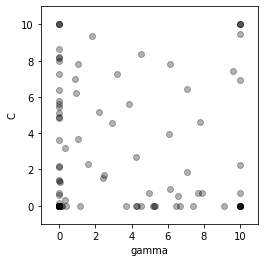

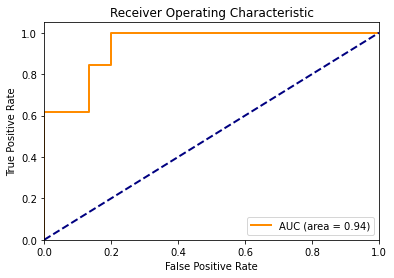

Accuracy for particle (in iteration 40, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 2.20595529e+00]
Accuracy for particle (in iteration 40, in fold 9) - 2 is 0.8571 At (gamma, c): [4.21907933 2.68920021]
Accuracy for particle (in iteration 40, in fold 9) - 3 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 40, in fold 9) - 4 is 0.9286 At (gamma, c): [0.87934567 7.01610091]
Accuracy for particle (in iteration 40, in fold 9) - 5 is 0.4643 At (gamma, c): [0.18879741 0.001     ]
Accuracy for particle (in iteration 40, in fold 9) - 6 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 40, in fold 9) - 7 is 0.6786 At (gamma, c): [6.5494093 0.5073082]
Accuracy for particle (in iteration 40, in fold 9) - 8 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 40, in fold 9) - 9 is 0.8571 At (gamma, c): [1.83191539 9.38657092]
Accuracy for particle (in iteration 40, in fold 9) - 10 is 0.4643 At (gamma, c): [0.001 0.

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 40, in fold 9) - 94 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 40, in fold 9) - 95 is 0.8929 At (gamma, c): [0.001      0.57469485]
Accuracy for particle (in iteration 40, in fold 9) - 96 is 0.8571 At (gamma, c): [7.77462932 4.64279306]
Accuracy for particle (in iteration 40, in fold 9) - 97 is 0.9286 At (gamma, c): [0.93157793 6.23871419]
Accuracy for particle (in iteration 40, in fold 9) - 98 is 0.7857 At (gamma, c): [1.0000000e-03 5.5912073e+00]
Accuracy for particle (in iteration 40, in fold 9) - 99 is 0.8571 At (gamma, c): [6.12286104 7.82161826]
Accuracy for particle (in iteration 40, in fold 9) - 100 is 0.4643 At (gamma, c): [1.1814112e+00 1.0000000e-03]
The best position in iteration 40, fold 9 is [0.001 0.001], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 36  94]]

I

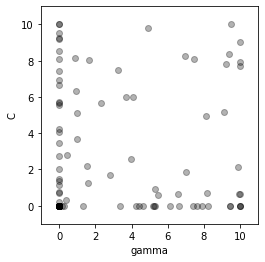

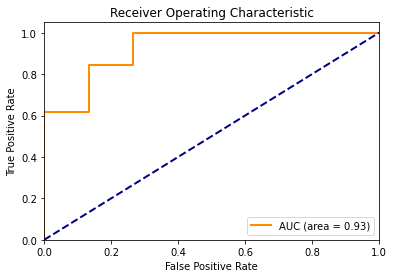

Accuracy for particle (in iteration 41, in fold 9) - 1 is 0.7857 At (gamma, c): [1.0000000e-03 2.7166183e+00]
Accuracy for particle (in iteration 41, in fold 9) - 2 is 0.8571 At (gamma, c): [3.9826959 2.5627202]
Accuracy for particle (in iteration 41, in fold 9) - 3 is 0.7857 At (gamma, c): [1.00000000e-03 8.11875069e+00]
Accuracy for particle (in iteration 41, in fold 9) - 4 is 0.9286 At (gamma, c): [0.87236846 8.16231173]
Accuracy for particle (in iteration 41, in fold 9) - 5 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 41, in fold 9) - 6 is 0.8571 At (gamma, c): [9.20437165 7.83178689]
Accuracy for particle (in iteration 41, in fold 9) - 7 is 0.8571 At (gamma, c): [5.46453348 0.58861606]
Accuracy for particle (in iteration 41, in fold 9) - 8 is 0.4643 At (gamma, c): [0.14124725 0.001     ]
Accuracy for particle (in iteration 41, in fold 9) - 9 is 0.8571 At (gamma, c): [1.65004062 8.03495385]
Accuracy for particle (in iteration 41, in fold 9) - 10 is 0.4

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 41, in fold 9) - 90 is 0.7857 At (gamma, c): [1.00000000e-03 1.49751108e+00]
Accuracy for particle (in iteration 41, in fold 9) - 91 is 0.4643 At (gamma, c): [3.36328282e+00 1.00000000e-03]
Accuracy for particle (in iteration 41, in fold 9) - 92 is 0.4643 At (gamma, c): [4.25847517e+00 1.00000000e-03]
Accuracy for particle (in iteration 41, in fold 9) - 93 is 0.4643 At (gamma, c): [5.18616851e+00 1.00000000e-03]
Accuracy for particle (in iteration 41, in fold 9) - 94 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 41, in fold 9) - 95 is 0.8214 At (gamma, c): [0.001      0.67645956]
Accuracy for particle (in iteration 41, in fold 9) - 96 is 0.8571 At (gamma, c): [9.11030671 5.19436094]
Accuracy for particle (in iteration 41, in fold 9) - 97 is 0.9286 At (gamma, c): [0.93155856 6.30875274]
Accuracy for particle (in iteration 41, in fold 9) - 98 is 0.7857 At (gamma, c): [1.00000000e-03 4.07727745e+00]
Accuracy for particle (in

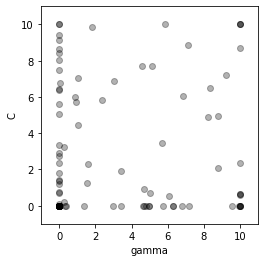

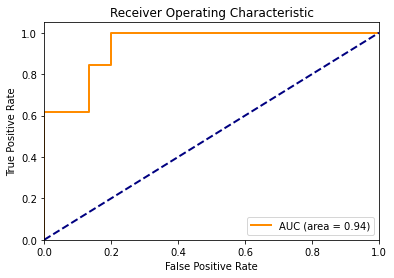

Accuracy for particle (in iteration 42, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 2.34500116e+00]
Accuracy for particle (in iteration 42, in fold 9) - 2 is 0.8571 At (gamma, c): [5.6576577  3.45893016]
Accuracy for particle (in iteration 42, in fold 9) - 3 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 42, in fold 9) - 4 is 0.9286 At (gamma, c): [0.89005942 6.00791969]
Accuracy for particle (in iteration 42, in fold 9) - 5 is 0.4643 At (gamma, c): [0.36723927 0.001     ]
Accuracy for particle (in iteration 42, in fold 9) - 6 is 0.8571 At (gamma, c): [9.21235256 7.23172106]
Accuracy for particle (in iteration 42, in fold 9) - 7 is 0.8571 At (gamma, c): [6.06809794 0.5433809 ]
Accuracy for particle (in iteration 42, in fold 9) - 8 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 42, in fold 9) - 9 is 0.8571 At (gamma, c): [1.82503767 9.85070164]
Accuracy for particle (in iteration 42, in fold 9) - 10 is 0.4643 At (gamm

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 42, in fold 9) - 94 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 42, in fold 9) - 95 is 0.7857 At (gamma, c): [0.001      0.71371533]
Accuracy for particle (in iteration 42, in fold 9) - 96 is 0.8571 At (gamma, c): [8.79099697 4.9536199 ]
Accuracy for particle (in iteration 42, in fold 9) - 97 is 0.9286 At (gamma, c): [0.93121467 5.72717617]
Accuracy for particle (in iteration 42, in fold 9) - 98 is 0.7857 At (gamma, c): [1.00000000e-03 2.74677002e+00]
Accuracy for particle (in iteration 42, in fold 9) - 99 is 0.8571 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 42, in fold 9) - 100 is 0.4643 At (gamma, c): [1.38000374e+00 1.00000000e-03]
The best position in iteration 42, fold 9 is [0.03640386 0.001     ], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 35  95]]

I

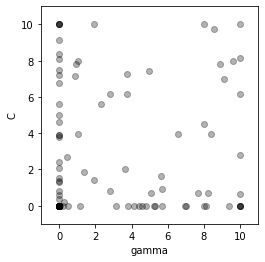

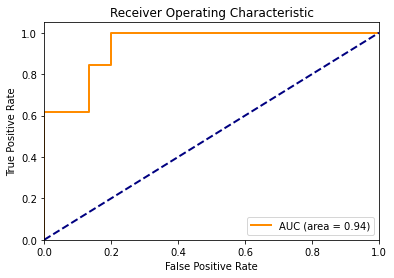

Accuracy for particle (in iteration 43, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 2.10235669e+00]
Accuracy for particle (in iteration 43, in fold 9) - 2 is 0.8571 At (gamma, c): [6.56712683 3.94555338]
Accuracy for particle (in iteration 43, in fold 9) - 3 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 43, in fold 9) - 4 is 0.9286 At (gamma, c): [0.88143732 7.16953225]
Accuracy for particle (in iteration 43, in fold 9) - 5 is 0.4643 At (gamma, c): [0.03640386 0.001     ]
Accuracy for particle (in iteration 43, in fold 9) - 6 is 0.8571 At (gamma, c): [10.          8.14456133]
Accuracy for particle (in iteration 43, in fold 9) - 7 is 0.8571 At (gamma, c): [2.81788039 0.78697396]
Accuracy for particle (in iteration 43, in fold 9) - 8 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 43, in fold 9) - 9 is 0.8571 At (gamma, c): [ 1.90922068 10.        ]
Accuracy for particle (in iteration 43, in fold 9) - 10 is 0.4643 At (

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 43, in fold 9) - 95 is 0.8214 At (gamma, c): [0.001      0.61000737]
Accuracy for particle (in iteration 43, in fold 9) - 96 is 0.8571 At (gamma, c): [7.98688855 4.51084422]
Accuracy for particle (in iteration 43, in fold 9) - 97 is 0.9286 At (gamma, c): [0.9323753  7.84548232]
Accuracy for particle (in iteration 43, in fold 9) - 98 is 0.7857 At (gamma, c): [1.00000000e-03 3.88370928e+00]
Accuracy for particle (in iteration 43, in fold 9) - 99 is 0.8571 At (gamma, c): [8.52529407 9.77319542]
Accuracy for particle (in iteration 43, in fold 9) - 100 is 0.4643 At (gamma, c): [1.1553029e+00 1.0000000e-03]
The best position in iteration 43, fold 9 is [0.001 0.001], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 34  96]]

Iteration 44 - Fold 9:



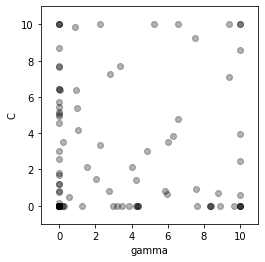

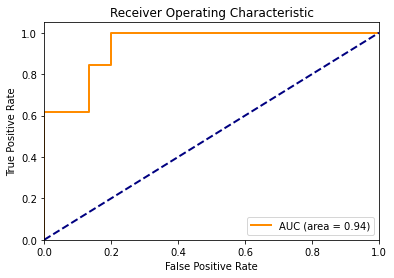

Accuracy for particle (in iteration 44, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 1.78393815e+00]
Accuracy for particle (in iteration 44, in fold 9) - 2 is 0.8571 At (gamma, c): [4.85643631 3.0302263 ]
Accuracy for particle (in iteration 44, in fold 9) - 3 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 44, in fold 9) - 4 is 0.9286 At (gamma, c): [0.86098536 9.88624745]
Accuracy for particle (in iteration 44, in fold 9) - 5 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 44, in fold 9) - 6 is 0.8571 At (gamma, c): [10.          8.57592314]
Accuracy for particle (in iteration 44, in fold 9) - 7 is 0.8571 At (gamma, c): [2.77217315 0.79039957]
Accuracy for particle (in iteration 44, in fold 9) - 8 is 0.4643 At (gamma, c): [0.23549316 0.001     ]
Accuracy for particle (in iteration 44, in fold 9) - 9 is 0.8571 At (gamma, c): [ 2.25359433 10.        ]
Accuracy for particle (in iteration 44, in fold 9) - 10 is 0.4643 At (

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 44, in fold 9) - 97 is 0.9286 At (gamma, c): [0.93157356 6.39341297]
Accuracy for particle (in iteration 44, in fold 9) - 98 is 0.7857 At (gamma, c): [1.00000000e-03 5.04816993e+00]
Accuracy for particle (in iteration 44, in fold 9) - 99 is 0.8571 At (gamma, c): [7.51307999 9.22821296]
Accuracy for particle (in iteration 44, in fold 9) - 100 is 0.4643 At (gamma, c): [1.29207641e+00 1.00000000e-03]
The best position in iteration 44, fold 9 is [0.001 0.001], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 42  88]]

Iteration 45 - Fold 9:



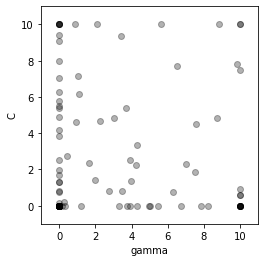

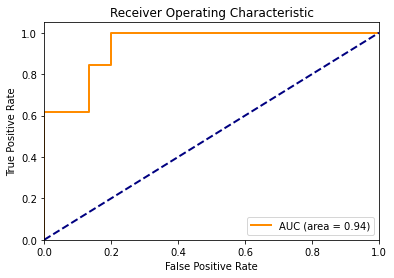

Accuracy for particle (in iteration 45, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 1.98637164e+00]
Accuracy for particle (in iteration 45, in fold 9) - 2 is 0.8571 At (gamma, c): [3.93488033 2.53713587]
Accuracy for particle (in iteration 45, in fold 9) - 3 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 45, in fold 9) - 4 is 0.9286 At (gamma, c): [ 0.85384609 10.        ]
Accuracy for particle (in iteration 45, in fold 9) - 5 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 45, in fold 9) - 6 is 0.8571 At (gamma, c): [9.80626732 7.81025812]
Accuracy for particle (in iteration 45, in fold 9) - 7 is 0.8571 At (gamma, c): [2.7685774  0.79066906]
Accuracy for particle (in iteration 45, in fold 9) - 8 is 0.4643 At (gamma, c): [0.00550751 0.001     ]
Accuracy for particle (in iteration 45, in fold 9) - 9 is 0.8571 At (gamma, c): [ 2.0725595 10.       ]
Accuracy for particle (in iteration 45, in fold 9) - 10 is 0.4643 At (ga

Accuracy for particle (in iteration 45, in fold 9) - 90 is 0.7857 At (gamma, c): [1.00000000e-03 1.68526947e+00]
Accuracy for particle (in iteration 45, in fold 9) - 91 is 0.4643 At (gamma, c): [5.01931916e+00 1.00000000e-03]
Accuracy for particle (in iteration 45, in fold 9) - 92 is 0.4643 At (gamma, c): [5.43344464e+00 1.00000000e-03]
Accuracy for particle (in iteration 45, in fold 9) - 93 is 0.4643 At (gamma, c): [7.84042826e+00 1.00000000e-03]
Accuracy for particle (in iteration 45, in fold 9) - 94 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 45, in fold 9) - 95 is 0.7857 At (gamma, c): [0.001      0.72958264]
Accuracy for particle (in iteration 45, in fold 9) - 96 is 0.8571 At (gamma, c): [8.70939319 4.85819436]
Accuracy for particle (in iteration 45, in fold 9) - 97 is 0.9286 At (gamma, c): [0.93059321 4.61121423]
Accuracy for particle (in iteration 45, in fold 9) - 98 is 0.7857 At (gamma, c): [1.00000000e-03 6.25037418e+00]
Accuracy for particle (in

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


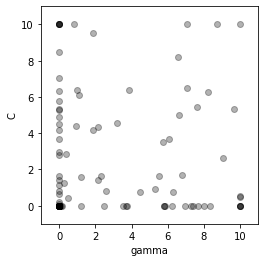

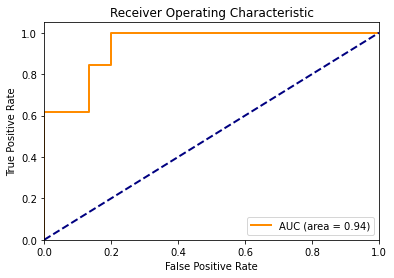

Accuracy for particle (in iteration 46, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 1.63200269e+00]
Accuracy for particle (in iteration 46, in fold 9) - 2 is 0.8571 At (gamma, c): [5.71563195 3.48995003]
Accuracy for particle (in iteration 46, in fold 9) - 3 is 0.7857 At (gamma, c): [1.00000000e-03 8.46831942e+00]
Accuracy for particle (in iteration 46, in fold 9) - 4 is 0.9286 At (gamma, c): [ 0.84121898 10.        ]
Accuracy for particle (in iteration 46, in fold 9) - 5 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 46, in fold 9) - 6 is 0.8571 At (gamma, c): [8.2290172  6.27362285]
Accuracy for particle (in iteration 46, in fold 9) - 7 is 0.8571 At (gamma, c): [2.572889   0.80533526]
Accuracy for particle (in iteration 46, in fold 9) - 8 is 0.4643 At (gamma, c): [0.072315 0.001   ]
Accuracy for particle (in iteration 46, in fold 9) - 9 is 0.8571 At (gamma, c): [1.89002179 9.53859205]
Accuracy for particle (in iteration 46, in fold 9) - 10 is 0

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 46, in fold 9) - 98 is 0.7857 At (gamma, c): [1.00000000e-03 2.77687369e+00]
Accuracy for particle (in iteration 46, in fold 9) - 99 is 0.8571 At (gamma, c): [ 8.72158228 10.        ]
Accuracy for particle (in iteration 46, in fold 9) - 100 is 0.4643 At (gamma, c): [1.21228717e+00 1.00000000e-03]
The best position in iteration 46, fold 9 is [0.001 0.001], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 45  85]]

Iteration 47 - Fold 9:



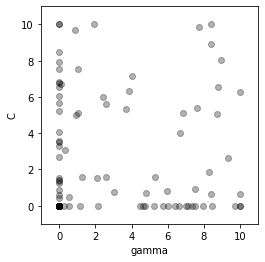

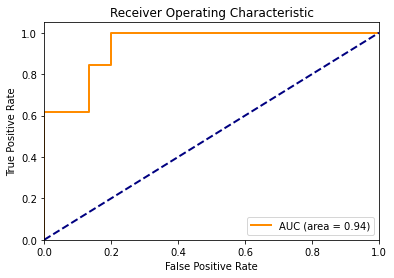

Accuracy for particle (in iteration 47, in fold 9) - 1 is 0.7857 At (gamma, c): [1.0000000e-03 1.5170017e+00]
Accuracy for particle (in iteration 47, in fold 9) - 2 is 0.8571 At (gamma, c): [6.69792216 4.0155371 ]
Accuracy for particle (in iteration 47, in fold 9) - 3 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 47, in fold 9) - 4 is 0.9286 At (gamma, c): [0.85180969 9.6849901 ]
Accuracy for particle (in iteration 47, in fold 9) - 5 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 47, in fold 9) - 6 is 0.8571 At (gamma, c): [6.83580711 5.11660556]
Accuracy for particle (in iteration 47, in fold 9) - 7 is 0.8571 At (gamma, c): [3.00549463 0.7729129 ]
Accuracy for particle (in iteration 47, in fold 9) - 8 is 0.4643 At (gamma, c): [0.26589446 0.001     ]
Accuracy for particle (in iteration 47, in fold 9) - 9 is 0.8571 At (gamma, c): [ 1.92684195 10.        ]
Accuracy for particle (in iteration 47, in fold 9) - 10 is 0.4643 At (gamm

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 47, in fold 9) - 95 is 0.8929 At (gamma, c): [0.001      0.59005749]
Accuracy for particle (in iteration 47, in fold 9) - 96 is 0.8571 At (gamma, c): [10.          6.29858028]
Accuracy for particle (in iteration 47, in fold 9) - 97 is 0.9286 At (gamma, c): [0.93081392 5.01369276]
Accuracy for particle (in iteration 47, in fold 9) - 98 is 0.7857 At (gamma, c): [1.00000000e-03 3.30658405e+00]
Accuracy for particle (in iteration 47, in fold 9) - 99 is 0.8571 At (gamma, c): [ 8.38355574 10.        ]
Accuracy for particle (in iteration 47, in fold 9) - 100 is 0.4643 At (gamma, c): [1.13070793e+00 1.00000000e-03]
The best position in iteration 47, fold 9 is [0.001 0.001], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 44  86]]

Iteration 48 - Fold 9:



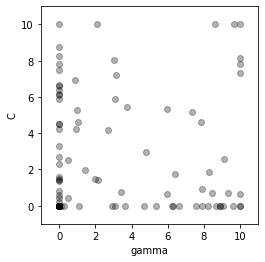

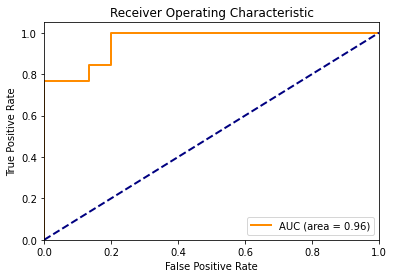

Accuracy for particle (in iteration 48, in fold 9) - 1 is 0.8571 At (gamma, c): [0.01818344 1.48458739]
Accuracy for particle (in iteration 48, in fold 9) - 2 is 0.8571 At (gamma, c): [4.77280247 2.98547694]
Accuracy for particle (in iteration 48, in fold 9) - 3 is 0.7857 At (gamma, c): [1.00000000e-03 8.77029052e+00]
Accuracy for particle (in iteration 48, in fold 9) - 4 is 0.9286 At (gamma, c): [0.88015584 6.94534339]
Accuracy for particle (in iteration 48, in fold 9) - 5 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 48, in fold 9) - 6 is 0.8571 At (gamma, c): [9.97405849 7.29695123]
Accuracy for particle (in iteration 48, in fold 9) - 7 is 0.8571 At (gamma, c): [3.41299543 0.74237206]
Accuracy for particle (in iteration 48, in fold 9) - 8 is 0.4643 At (gamma, c): [0.13285441 0.001     ]
Accuracy for particle (in iteration 48, in fold 9) - 9 is 0.8571 At (gamma, c): [ 2.07239076 10.        ]
Accuracy for particle (in iteration 48, in fold 9) - 10 is 0.464

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 48, in fold 9) - 95 is 0.8929 At (gamma, c): [0.001      0.57335102]
Accuracy for particle (in iteration 48, in fold 9) - 96 is 0.8571 At (gamma, c): [10.          8.17279799]
Accuracy for particle (in iteration 48, in fold 9) - 97 is 0.9286 At (gamma, c): [0.93039447 4.24959987]
Accuracy for particle (in iteration 48, in fold 9) - 98 is 0.7857 At (gamma, c): [1.00000000e-03 2.70157456e+00]
Accuracy for particle (in iteration 48, in fold 9) - 99 is 0.8571 At (gamma, c): [ 8.59355921 10.        ]
Accuracy for particle (in iteration 48, in fold 9) - 100 is 0.4643 At (gamma, c): [1.12596724e+00 1.00000000e-03]
The best position in iteration 48, fold 9 is [0.34183138 0.001     ], with Accuracy: 0.9286
Accuracy Score: 0.8571
F1 Score: 0.8462
Recall Score: 0.8462
Precision Score: 0.8462
Confusion Matrix (Test):
[[13  2]
 [ 2 11]]
Confusion Matrix (Train):
[[123   5]
 [ 15 115]]

Iteration 49 - Fold 9:



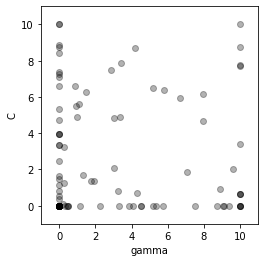

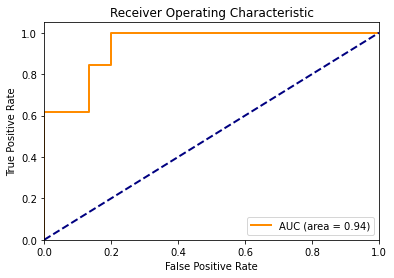

Accuracy for particle (in iteration 49, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 1.64290357e+00]
Accuracy for particle (in iteration 49, in fold 9) - 2 is 0.8571 At (gamma, c): [3.04202968 2.05940458]
Accuracy for particle (in iteration 49, in fold 9) - 3 is 0.7857 At (gamma, c): [1.00000000e-03 8.43521625e+00]
Accuracy for particle (in iteration 49, in fold 9) - 4 is 0.9286 At (gamma, c): [0.8844379  6.63086823]
Accuracy for particle (in iteration 49, in fold 9) - 5 is 0.4643 At (gamma, c): [0.34183138 0.001     ]
Accuracy for particle (in iteration 49, in fold 9) - 6 is 0.8571 At (gamma, c): [10.          7.69530607]
Accuracy for particle (in iteration 49, in fold 9) - 7 is 0.8571 At (gamma, c): [4.285025   0.67701632]
Accuracy for particle (in iteration 49, in fold 9) - 8 is 0.4643 At (gamma, c): [0.46780596 0.001     ]
Accuracy for particle (in iteration 49, in fold 9) - 9 is 0.8571 At (gamma, c): [1.48490034 6.25291876]
Accuracy for particle (in iteration 49, in fol

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 49, in fold 9) - 96 is 0.8571 At (gamma, c): [10.         8.7744855]
Accuracy for particle (in iteration 49, in fold 9) - 97 is 0.9286 At (gamma, c): [0.93107986 5.49816556]
Accuracy for particle (in iteration 49, in fold 9) - 98 is 0.7857 At (gamma, c): [1.00000000e-03 3.36693436e+00]
Accuracy for particle (in iteration 49, in fold 9) - 99 is 0.8571 At (gamma, c): [5.19304805 6.47378899]
Accuracy for particle (in iteration 49, in fold 9) - 100 is 0.4643 At (gamma, c): [1.14074945e+00 1.00000000e-03]
The best position in iteration 49, fold 9 is [0.001 0.001], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 44  86]]

Iteration 50 - Fold 9:



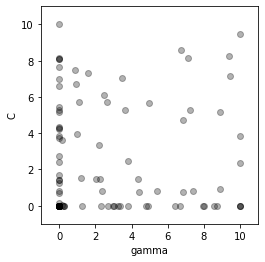

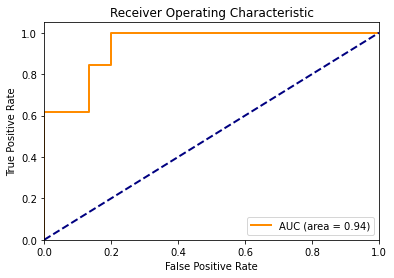

Accuracy for particle (in iteration 50, in fold 9) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 1.68412653e+00]
Accuracy for particle (in iteration 50, in fold 9) - 2 is 0.8571 At (gamma, c): [3.79488275 2.46222835]
Accuracy for particle (in iteration 50, in fold 9) - 3 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 50, in fold 9) - 4 is 0.9286 At (gamma, c): [0.87847585 7.48913358]
Accuracy for particle (in iteration 50, in fold 9) - 5 is 0.4643 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 50, in fold 9) - 6 is 0.8571 At (gamma, c): [10.          9.46328385]
Accuracy for particle (in iteration 50, in fold 9) - 7 is 0.8571 At (gamma, c): [2.3613543  0.82118909]
Accuracy for particle (in iteration 50, in fold 9) - 8 is 0.4643 At (gamma, c): [0.22892786 0.001     ]
Accuracy for particle (in iteration 50, in fold 9) - 9 is 0.8571 At (gamma, c): [1.57795571 7.33720167]
Accuracy for particle (in iteration 50, in fold 9) - 10 is 0.4643 At (ga

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 50, in fold 9) - 96 is 0.8571 At (gamma, c): [6.85867197 4.73231502]
Accuracy for particle (in iteration 50, in fold 9) - 97 is 0.9286 At (gamma, c): [0.9317381  6.69729103]
Accuracy for particle (in iteration 50, in fold 9) - 98 is 0.7857 At (gamma, c): [1.00000000e-03 4.36537415e+00]
Accuracy for particle (in iteration 50, in fold 9) - 99 is 0.8571 At (gamma, c): [6.70365428 8.56549991]
Accuracy for particle (in iteration 50, in fold 9) - 100 is 0.4643 At (gamma, c): [1.25181108e+00 1.00000000e-03]
The best position in iteration 50, fold 9 is [0.30538625 0.001     ], with Accuracy: 0.9286
Accuracy Score: 0.7857
F1 Score: 0.7500
Recall Score: 0.6923
Precision Score: 0.8182
Confusion Matrix (Test):
[[13  2]
 [ 4  9]]
Confusion Matrix (Train):
[[124   4]
 [ 42  88]]


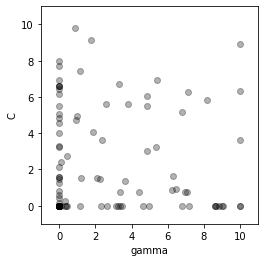

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.



Iteration 1 - Fold 10:



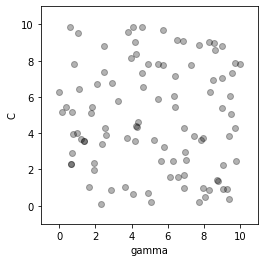

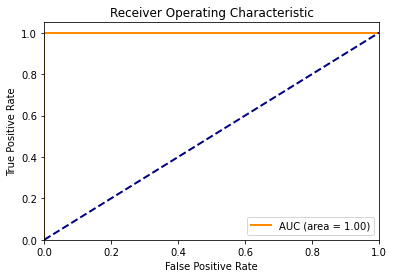

Accuracy for particle (in iteration 1, in fold 10) - 1 is 1.0000 At (gamma, c): [6.90863629 0.94965265]
Accuracy for particle (in iteration 1, in fold 10) - 2 is 1.0000 At (gamma, c): [7.2939993  7.76883668]
Accuracy for particle (in iteration 1, in fold 10) - 3 is 1.0000 At (gamma, c): [4.19508364 3.56699951]
Accuracy for particle (in iteration 1, in fold 10) - 4 is 1.0000 At (gamma, c): [2.86177615 0.85123179]
Accuracy for particle (in iteration 1, in fold 10) - 5 is 0.9643 At (gamma, c): [1.77244866 5.09118052]
Accuracy for particle (in iteration 1, in fold 10) - 6 is 1.0000 At (gamma, c): [7.43599813 3.87127125]
Accuracy for particle (in iteration 1, in fold 10) - 7 is 1.0000 At (gamma, c): [9.27524312 0.91787536]
Accuracy for particle (in iteration 1, in fold 10) - 8 is 1.0000 At (gamma, c): [6.88070202 4.27215531]
Accuracy for particle (in iteration 1, in fold 10) - 9 is 1.0000 At (gamma, c): [8.98238934 5.40473628]
Accuracy for particle (in iteration 1, in fold 10) - 10 is 1.000

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 1, in fold 10) - 100 is 1.0000 At (gamma, c): [7.01321692 2.5451377 ]
The best position in iteration 1, fold 10 is [1.00000000e-03 3.52270629e+00], with Accuracy: 1.0000
Accuracy Score: 1.0000
F1 Score: 1.0000
Recall Score: 1.0000
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 0 21]]
Confusion Matrix (Train):
[[136   0]
 [  0 122]]

Iteration 2 - Fold 10:



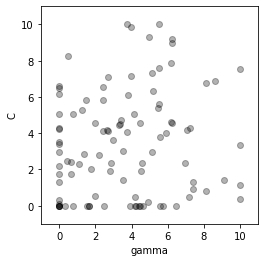

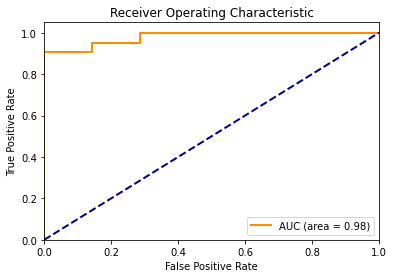

Accuracy for particle (in iteration 2, in fold 10) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 3.52270629e+00]
Accuracy for particle (in iteration 2, in fold 10) - 2 is 1.0000 At (gamma, c): [2.64576053 4.19519974]
Accuracy for particle (in iteration 2, in fold 10) - 3 is 1.0000 At (gamma, c): [5.15297941 2.96962652]
Accuracy for particle (in iteration 2, in fold 10) - 4 is 0.2500 At (gamma, c): [4.41427907e+00 1.00000000e-03]
Accuracy for particle (in iteration 2, in fold 10) - 5 is 0.9643 At (gamma, c): [1.36702351 2.87246779]
Accuracy for particle (in iteration 2, in fold 10) - 6 is 1.0000 At (gamma, c): [5.16839972 6.34147658]
Accuracy for particle (in iteration 2, in fold 10) - 7 is 0.2500 At (gamma, c): [6.42954255e+00 1.00000000e-03]
Accuracy for particle (in iteration 2, in fold 10) - 8 is 1.0000 At (gamma, c): [3.4379782  4.74323149]
Accuracy for particle (in iteration 2, in fold 10) - 9 is 0.7857 At (gamma, c): [1.00000000e-03 4.22215355e+00]
Accuracy for particle (in iterat

Accuracy for particle (in iteration 2, in fold 10) - 79 is 0.2500 At (gamma, c): [2.50651202e+00 1.00000000e-03]
Accuracy for particle (in iteration 2, in fold 10) - 80 is 0.7143 At (gamma, c): [1.00000000e-03 2.93891455e+00]
Accuracy for particle (in iteration 2, in fold 10) - 81 is 0.9643 At (gamma, c): [0.51074849 8.24237959]
Accuracy for particle (in iteration 2, in fold 10) - 82 is 0.9643 At (gamma, c): [1.78057265 2.02009831]
Accuracy for particle (in iteration 2, in fold 10) - 83 is 0.2500 At (gamma, c): [4.48384512e+00 1.00000000e-03]
Accuracy for particle (in iteration 2, in fold 10) - 84 is 1.0000 At (gamma, c): [3.52897556 3.0012703 ]
Accuracy for particle (in iteration 2, in fold 10) - 85 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 2, in fold 10) - 86 is 1.0000 At (gamma, c): [2.41035031 5.83916728]
Accuracy for particle (in iteration 2, in fold 10) - 87 is 0.2500 At (gamma, c): [1.54394576e+00 1.00000000e-03]
Accuracy for particle (in iterati

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 2, in fold 10) - 99 is 0.2500 At (gamma, c): [0.001      0.10337338]
Accuracy for particle (in iteration 2, in fold 10) - 100 is 0.2500 At (gamma, c): [3.9285516e+00 1.0000000e-03]
The best position in iteration 2, fold 10 is [1.00000000e-03 9.53676896e+00], with Accuracy: 1.0000
Accuracy Score: 0.7857
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 6 15]]
Confusion Matrix (Train):
[[130   6]
 [ 40  82]]

Iteration 3 - Fold 10:



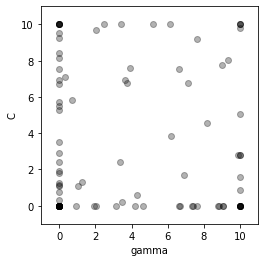

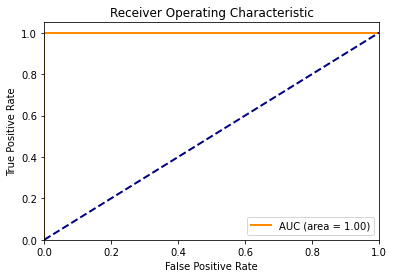

Accuracy for particle (in iteration 3, in fold 10) - 1 is 0.8571 At (gamma, c): [1.00000000e-03 9.53676896e+00]
Accuracy for particle (in iteration 3, in fold 10) - 2 is 0.6071 At (gamma, c): [1.00000000e-03 1.14380211e+00]
Accuracy for particle (in iteration 3, in fold 10) - 3 is 1.0000 At (gamma, c): [10.          5.05397492]
Accuracy for particle (in iteration 3, in fold 10) - 4 is 0.2500 At (gamma, c): [8.75320305e+00 1.00000000e-03]
Accuracy for particle (in iteration 3, in fold 10) - 5 is 0.9643 At (gamma, c): [1.06443139 1.10843133]
Accuracy for particle (in iteration 3, in fold 10) - 6 is 1.0000 At (gamma, c): [ 6.11765953 10.        ]
Accuracy for particle (in iteration 3, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 3, in fold 10) - 8 is 0.7857 At (gamma, c): [1.00000000e-03 5.72419304e+00]
Accuracy for particle (in iteration 3, in fold 10) - 9 is 0.7857 At (gamma, c): [1.00000000e-03 6.71685916e+00]
Accuracy for particle (in iter

Accuracy for particle (in iteration 3, in fold 10) - 80 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 3, in fold 10) - 81 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 3, in fold 10) - 82 is 0.6786 At (gamma, c): [1.00000000e-03 2.38704917e+00]
Accuracy for particle (in iteration 3, in fold 10) - 83 is 0.2500 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 3, in fold 10) - 84 is 0.9643 At (gamma, c): [0.31000093 7.07551993]
Accuracy for particle (in iteration 3, in fold 10) - 85 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 3, in fold 10) - 86 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 3, in fold 10) - 87 is 0.2500 At (gamma, c): [1.91186696e+00 1.00000000e-03]
Accuracy for particle (in iteration 3, in fold 10) - 88 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 3, in fold 10) - 89 is 1.0000 At (gamma, c): [4.3009976

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 3, in fold 10) - 100 is 0.2500 At (gamma, c): [6.66679531e+00 1.00000000e-03]
The best position in iteration 3, fold 10 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8947
Recall Score: 0.8095
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 4 17]]
Confusion Matrix (Train):
[[130   6]
 [ 27  95]]

Iteration 4 - Fold 10:



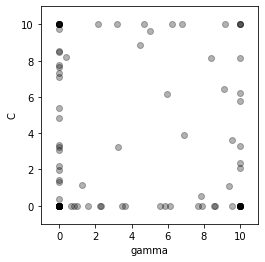

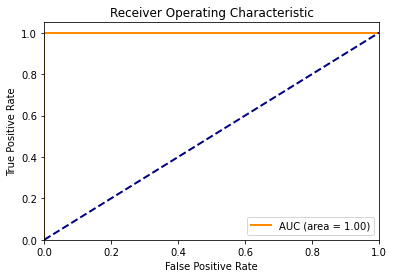

Accuracy for particle (in iteration 4, in fold 10) - 1 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 4, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001      0.37477417]
Accuracy for particle (in iteration 4, in fold 10) - 3 is 1.0000 At (gamma, c): [10.          6.23217999]
Accuracy for particle (in iteration 4, in fold 10) - 4 is 0.2500 At (gamma, c): [8.59727291e+00 1.00000000e-03]
Accuracy for particle (in iteration 4, in fold 10) - 5 is 0.2500 At (gamma, c): [0.81412566 0.001     ]
Accuracy for particle (in iteration 4, in fold 10) - 6 is 1.0000 At (gamma, c): [ 6.22609818 10.        ]
Accuracy for particle (in iteration 4, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 4, in fold 10) - 8 is 0.8214 At (gamma, c): [1.00000000e-03 7.10447206e+00]
Accuracy for particle (in iteration 4, in fold 10) - 9 is 0.8571 At (gamma, c): [1.0000000e-03 7.6529672e+00]
Accuracy for particle (in iteration 4, in fold 10) - 10 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 4, in fold 10) - 99 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 4, in fold 10) - 100 is 0.2500 At (gamma, c): [5.58174325e+00 1.00000000e-03]
The best position in iteration 4, fold 10 is [1.00000000e-03 8.06224766e+00], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8947
Recall Score: 0.8095
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 4 17]]
Confusion Matrix (Train):
[[130   6]
 [ 27  95]]

Iteration 5 - Fold 10:



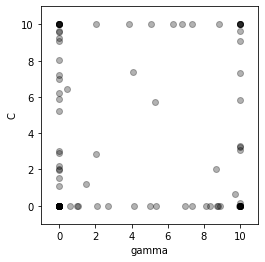

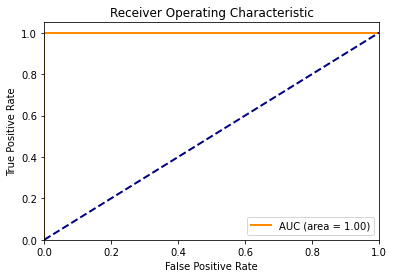

Accuracy for particle (in iteration 5, in fold 10) - 1 is 0.8571 At (gamma, c): [1.00000000e-03 8.06224766e+00]
Accuracy for particle (in iteration 5, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 5, in fold 10) - 3 is 1.0000 At (gamma, c): [10.          9.07790674]
Accuracy for particle (in iteration 5, in fold 10) - 4 is 0.2500 At (gamma, c): [6.95161257e+00 1.00000000e-03]
Accuracy for particle (in iteration 5, in fold 10) - 5 is 0.2500 At (gamma, c): [0.62139032 0.001     ]
Accuracy for particle (in iteration 5, in fold 10) - 6 is 1.0000 At (gamma, c): [ 7.32362644 10.        ]
Accuracy for particle (in iteration 5, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 5, in fold 10) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 9.64779687e+00]
Accuracy for particle (in iteration 5, in fold 10) - 9 is 0.8214 At (gamma, c): [1.00000000e-03 7.23018775e+00]
Accuracy for particle (in iteration 5, in fold 1

Accuracy for particle (in iteration 5, in fold 10) - 82 is 0.6429 At (gamma, c): [1.00000000e-03 1.94973069e+00]
Accuracy for particle (in iteration 5, in fold 10) - 83 is 0.2500 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 5, in fold 10) - 84 is 0.8571 At (gamma, c): [1.00000000e-03 9.27694208e+00]
Accuracy for particle (in iteration 5, in fold 10) - 85 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 5, in fold 10) - 86 is 0.8571 At (gamma, c): [1.00000000e-03 9.08079476e+00]
Accuracy for particle (in iteration 5, in fold 10) - 87 is 0.2500 At (gamma, c): [2.69007846e+00 1.00000000e-03]
Accuracy for particle (in iteration 5, in fold 10) - 88 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 5, in fold 10) - 89 is 0.2500 At (gamma, c): [0.9757477 0.001    ]
Accuracy for particle (in iteration 5, in fold 10) - 90 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 5, in fold 10) - 91 is 1.

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


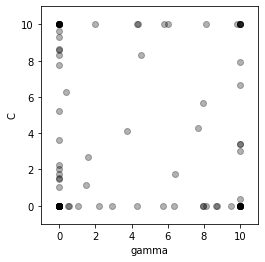

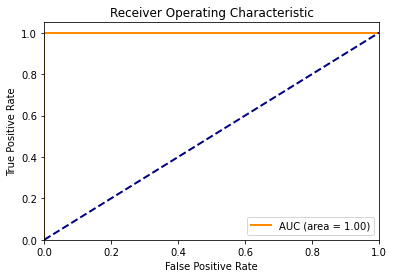

Accuracy for particle (in iteration 6, in fold 10) - 1 is 0.8571 At (gamma, c): [1.00000000e-03 8.32009928e+00]
Accuracy for particle (in iteration 6, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 6, in fold 10) - 3 is 1.0000 At (gamma, c): [10.          6.64803278]
Accuracy for particle (in iteration 6, in fold 10) - 4 is 0.2500 At (gamma, c): [7.94797916e+00 1.00000000e-03]
Accuracy for particle (in iteration 6, in fold 10) - 5 is 0.2500 At (gamma, c): [0.48136096 0.001     ]
Accuracy for particle (in iteration 6, in fold 10) - 6 is 1.0000 At (gamma, c): [ 8.08643891 10.        ]
Accuracy for particle (in iteration 6, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 6, in fold 10) - 8 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 6, in fold 10) - 9 is 0.8571 At (gamma, c): [1.00000000e-03 8.57604884e+00]
Accuracy for particle (in iteration 6, in fold 10) - 10 is 1.000

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 6, in fold 10) - 98 is 0.2500 At (gamma, c): [1.04819656e+00 1.00000000e-03]
Accuracy for particle (in iteration 6, in fold 10) - 99 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 6, in fold 10) - 100 is 0.2500 At (gamma, c): [9.49733082e+00 1.00000000e-03]
The best position in iteration 6, fold 10 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8947
Recall Score: 0.8095
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 4 17]]
Confusion Matrix (Train):
[[130   6]
 [ 27  95]]

Iteration 7 - Fold 10:



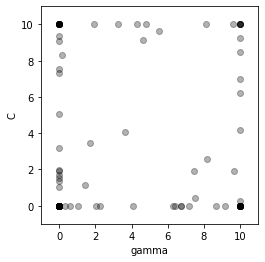

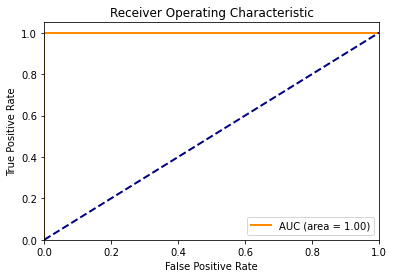

Accuracy for particle (in iteration 7, in fold 10) - 1 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 7, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 7, in fold 10) - 3 is 1.0000 At (gamma, c): [10.          9.23348018]
Accuracy for particle (in iteration 7, in fold 10) - 4 is 0.2500 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 7, in fold 10) - 5 is 0.2500 At (gamma, c): [0.62877082 0.001     ]
Accuracy for particle (in iteration 7, in fold 10) - 6 is 1.0000 At (gamma, c): [ 8.0837385 10.       ]
Accuracy for particle (in iteration 7, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 7, in fold 10) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 7.51578223e+00]
Accuracy for particle (in iteration 7, in fold 10) - 9 is 0.8214 At (gamma, c): [1.00000000e-03 7.31295186e+00]
Accuracy for particle (in iteration 7, in fold 10) - 10 is 1.0000 At (gamma, c): [

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 7, in fold 10) - 100 is 0.2500 At (gamma, c): [6.7326319e+00 1.0000000e-03]
The best position in iteration 7, fold 10 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8947
Recall Score: 0.8095
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 4 17]]
Confusion Matrix (Train):
[[130   6]
 [ 27  95]]

Iteration 8 - Fold 10:



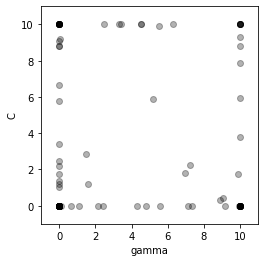

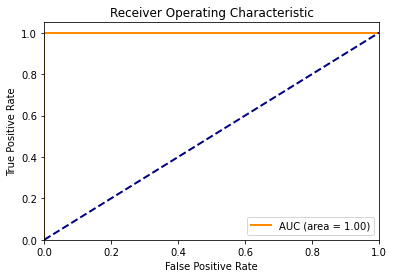

Accuracy for particle (in iteration 8, in fold 10) - 1 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 8, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 8, in fold 10) - 3 is 1.0000 At (gamma, c): [10.          5.94663205]
Accuracy for particle (in iteration 8, in fold 10) - 4 is 0.2500 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 8, in fold 10) - 5 is 0.2500 At (gamma, c): [0.6647544 0.001    ]
Accuracy for particle (in iteration 8, in fold 10) - 6 is 1.0000 At (gamma, c): [ 4.49893561 10.        ]
Accuracy for particle (in iteration 8, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 8, in fold 10) - 8 is 0.7857 At (gamma, c): [1.00000000e-03 6.64181906e+00]
Accuracy for particle (in iteration 8, in fold 10) - 9 is 0.8571 At (gamma, c): [1.00000000e-03 8.78546663e+00]
Accuracy for particle (in iteration 8, in fold 10) - 10 is 1.0000 At (gamma, c): [

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 8, in fold 10) - 100 is 0.2500 At (gamma, c): [7.09737758e+00 1.00000000e-03]
The best position in iteration 8, fold 10 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8947
Recall Score: 0.8095
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 4 17]]
Confusion Matrix (Train):
[[130   6]
 [ 27  95]]

Iteration 9 - Fold 10:



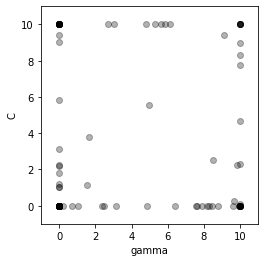

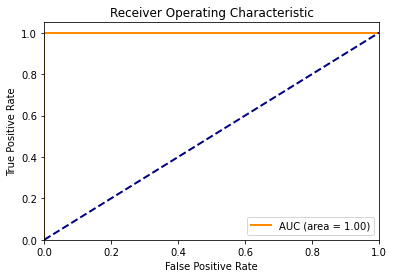

Accuracy for particle (in iteration 9, in fold 10) - 1 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 9, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 9, in fold 10) - 3 is 1.0000 At (gamma, c): [10.          7.78572607]
Accuracy for particle (in iteration 9, in fold 10) - 4 is 0.2500 At (gamma, c): [7.88040259e+00 1.00000000e-03]
Accuracy for particle (in iteration 9, in fold 10) - 5 is 0.2500 At (gamma, c): [0.69797917 0.001     ]
Accuracy for particle (in iteration 9, in fold 10) - 6 is 1.0000 At (gamma, c): [ 6.10391872 10.        ]
Accuracy for particle (in iteration 9, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 9, in fold 10) - 8 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 9, in fold 10) - 9 is 0.8571 At (gamma, c): [1.00000000e-03 9.01307339e+00]
Accuracy for particle (in iteration 9, in fold 10) - 10 is 1.0000 At (gamma, c):

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 9, in fold 10) - 98 is 0.2500 At (gamma, c): [1.0440321e+00 1.0000000e-03]
Accuracy for particle (in iteration 9, in fold 10) - 99 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 9, in fold 10) - 100 is 0.2500 At (gamma, c): [8.42726668e+00 1.00000000e-03]
The best position in iteration 9, fold 10 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8947
Recall Score: 0.8095
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 4 17]]
Confusion Matrix (Train):
[[130   6]
 [ 27  95]]

Iteration 10 - Fold 10:



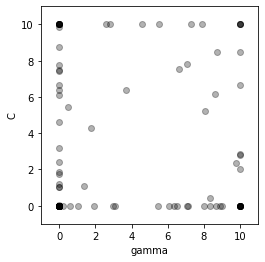

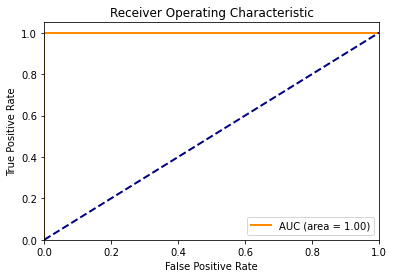

Accuracy for particle (in iteration 10, in fold 10) - 1 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 10, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001      0.01786173]
Accuracy for particle (in iteration 10, in fold 10) - 3 is 1.0000 At (gamma, c): [10.          8.45684716]
Accuracy for particle (in iteration 10, in fold 10) - 4 is 0.2500 At (gamma, c): [8.31945978e+00 1.00000000e-03]
Accuracy for particle (in iteration 10, in fold 10) - 5 is 0.2500 At (gamma, c): [0.62753489 0.001     ]
Accuracy for particle (in iteration 10, in fold 10) - 6 is 1.0000 At (gamma, c): [ 7.86794173 10.        ]
Accuracy for particle (in iteration 10, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 10, in fold 10) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 7.44165683e+00]
Accuracy for particle (in iteration 10, in fold 10) - 9 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 10, in fold 10) - 10 is 1

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 10, in fold 10) - 99 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 10, in fold 10) - 100 is 0.2500 At (gamma, c): [5.47755109e+00 1.00000000e-03]
The best position in iteration 10, fold 10 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8947
Recall Score: 0.8095
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 4 17]]
Confusion Matrix (Train):
[[130   6]
 [ 27  95]]

Iteration 11 - Fold 10:



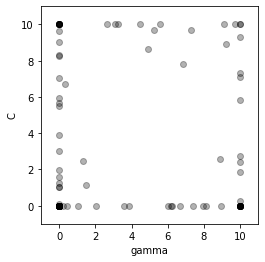

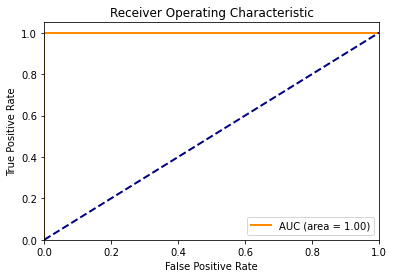

Accuracy for particle (in iteration 11, in fold 10) - 1 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 11, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001      0.09810924]
Accuracy for particle (in iteration 11, in fold 10) - 3 is 1.0000 At (gamma, c): [10.          7.32169459]
Accuracy for particle (in iteration 11, in fold 10) - 4 is 0.2500 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 11, in fold 10) - 5 is 0.2500 At (gamma, c): [0.43082346 0.001     ]
Accuracy for particle (in iteration 11, in fold 10) - 6 is 1.0000 At (gamma, c): [ 5.59073048 10.        ]
Accuracy for particle (in iteration 11, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 11, in fold 10) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 9.01932644e+00]
Accuracy for particle (in iteration 11, in fold 10) - 9 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 11, in fold 10) - 10 is 1.0000 At (gamma,

Accuracy for particle (in iteration 11, in fold 10) - 81 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 11, in fold 10) - 82 is 0.7143 At (gamma, c): [1.00000000e-03 3.00841299e+00]
Accuracy for particle (in iteration 11, in fold 10) - 83 is 0.2500 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 11, in fold 10) - 84 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 11, in fold 10) - 85 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 11, in fold 10) - 86 is 0.8571 At (gamma, c): [1.00000000e-03 9.65684642e+00]
Accuracy for particle (in iteration 11, in fold 10) - 87 is 0.2500 At (gamma, c): [2.01998966e+00 1.00000000e-03]
Accuracy for particle (in iteration 11, in fold 10) - 88 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 11, in fold 10) - 89 is 0.2500 At (gamma, c): [0.19921422 0.001     ]
Accuracy for particle (in iteration 11, in fold 10) - 90 is 0.25

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


The best position in iteration 11, fold 10 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8947
Recall Score: 0.8095
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 4 17]]
Confusion Matrix (Train):
[[130   6]
 [ 27  95]]

Iteration 12 - Fold 10:



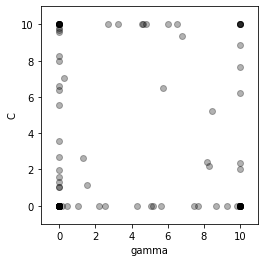

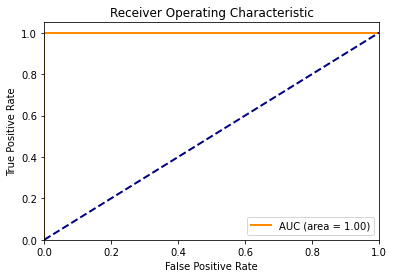

Accuracy for particle (in iteration 12, in fold 10) - 1 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 12, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 12, in fold 10) - 3 is 1.0000 At (gamma, c): [10.          6.24112086]
Accuracy for particle (in iteration 12, in fold 10) - 4 is 0.2500 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 12, in fold 10) - 5 is 0.2500 At (gamma, c): [0.43279145 0.001     ]
Accuracy for particle (in iteration 12, in fold 10) - 6 is 1.0000 At (gamma, c): [ 4.56246991 10.        ]
Accuracy for particle (in iteration 12, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 12, in fold 10) - 8 is 0.8571 At (gamma, c): [1.000000e-03 7.992596e+00]
Accuracy for particle (in iteration 12, in fold 10) - 9 is 0.8571 At (gamma, c): [1.0000000e-03 8.2839174e+00]
Accuracy for particle (in iteration 12, in fold 10) - 10 is 1.0000 At (gamma,

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 12, in fold 10) - 98 is 0.2500 At (gamma, c): [1.03974471e+00 1.00000000e-03]
Accuracy for particle (in iteration 12, in fold 10) - 99 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 12, in fold 10) - 100 is 0.2500 At (gamma, c): [8.64170695e+00 1.00000000e-03]
The best position in iteration 12, fold 10 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8947
Recall Score: 0.8095
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 4 17]]
Confusion Matrix (Train):
[[130   6]
 [ 27  95]]

Iteration 13 - Fold 10:



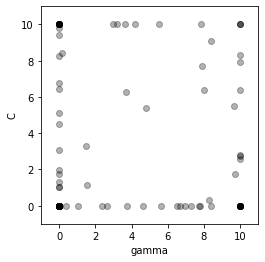

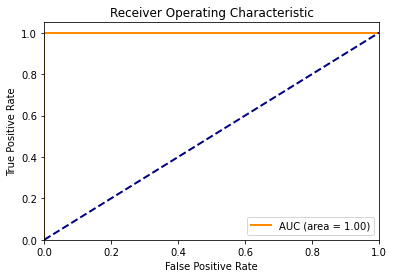

Accuracy for particle (in iteration 13, in fold 10) - 1 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 13, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 13, in fold 10) - 3 is 1.0000 At (gamma, c): [10.          7.91521763]
Accuracy for particle (in iteration 13, in fold 10) - 4 is 0.2500 At (gamma, c): [7.74779624e+00 1.00000000e-03]
Accuracy for particle (in iteration 13, in fold 10) - 5 is 0.2500 At (gamma, c): [0.35785476 0.001     ]
Accuracy for particle (in iteration 13, in fold 10) - 6 is 1.0000 At (gamma, c): [ 5.51888835 10.        ]
Accuracy for particle (in iteration 13, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 13, in fold 10) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 9.43564211e+00]
Accuracy for particle (in iteration 13, in fold 10) - 9 is 0.8571 At (gamma, c): [1.00000000e-03 9.80946444e+00]
Accuracy for particle (in iteration 13, in fold 10) - 1

Accuracy for particle (in iteration 13, in fold 10) - 80 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 13, in fold 10) - 81 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 13, in fold 10) - 82 is 0.7143 At (gamma, c): [1.00000000e-03 3.07249581e+00]
Accuracy for particle (in iteration 13, in fold 10) - 83 is 0.2500 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 13, in fold 10) - 84 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 13, in fold 10) - 85 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 13, in fold 10) - 86 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 13, in fold 10) - 87 is 0.2500 At (gamma, c): [2.64816579e+00 1.00000000e-03]
Accuracy for particle (in iteration 13, in fold 10) - 88 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 13, in fold 10) - 89 is 0.2500 At (gamma, c): [0.04673

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 13, in fold 10) - 98 is 0.2500 At (gamma, c): [1.03893758e+00 1.00000000e-03]
Accuracy for particle (in iteration 13, in fold 10) - 99 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 13, in fold 10) - 100 is 0.2500 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 13, fold 10 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8947
Recall Score: 0.8095
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 4 17]]
Confusion Matrix (Train):
[[130   6]
 [ 27  95]]

Iteration 14 - Fold 10:



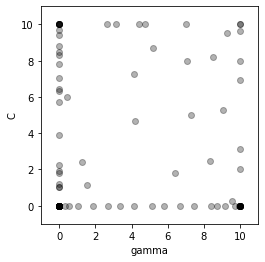

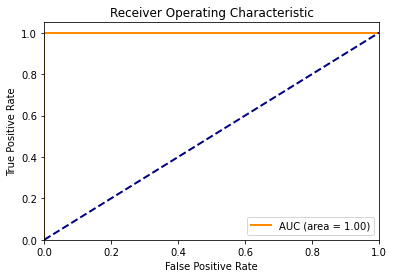

Accuracy for particle (in iteration 14, in fold 10) - 1 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 14, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 14, in fold 10) - 3 is 1.0000 At (gamma, c): [10.          6.94053566]
Accuracy for particle (in iteration 14, in fold 10) - 4 is 0.2500 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 14, in fold 10) - 5 is 0.2500 At (gamma, c): [0.54090447 0.001     ]
Accuracy for particle (in iteration 14, in fold 10) - 6 is 1.0000 At (gamma, c): [ 6.99150399 10.        ]
Accuracy for particle (in iteration 14, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 14, in fold 10) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 9.68199533e+00]
Accuracy for particle (in iteration 14, in fold 10) - 9 is 0.7857 At (gamma, c): [1.00000000e-03 6.34922254e+00]
Accuracy for particle (in iteration 14, in fold 10) - 10 is 1.0000 At (

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 14, in fold 10) - 96 is 1.0000 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 14, in fold 10) - 97 is 0.5714 At (gamma, c): [1.00000000e-03 1.04020526e+00]
Accuracy for particle (in iteration 14, in fold 10) - 98 is 0.2500 At (gamma, c): [1.04941815e+00 1.00000000e-03]
Accuracy for particle (in iteration 14, in fold 10) - 99 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 14, in fold 10) - 100 is 0.2500 At (gamma, c): [7.42911607e+00 1.00000000e-03]
The best position in iteration 14, fold 10 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8947
Recall Score: 0.8095
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 4 17]]
Confusion Matrix (Train):
[[130   6]
 [ 27  95]]

Iteration 15 - Fold 10:



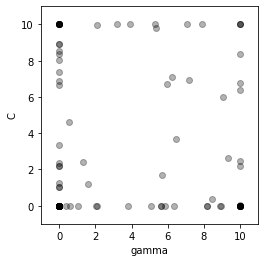

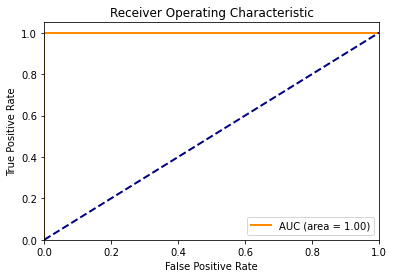

Accuracy for particle (in iteration 15, in fold 10) - 1 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 15, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 15, in fold 10) - 3 is 1.0000 At (gamma, c): [10.          6.37308168]
Accuracy for particle (in iteration 15, in fold 10) - 4 is 0.2500 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 15, in fold 10) - 5 is 0.2500 At (gamma, c): [0.60364423 0.001     ]
Accuracy for particle (in iteration 15, in fold 10) - 6 is 1.0000 At (gamma, c): [ 7.89629146 10.        ]
Accuracy for particle (in iteration 15, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 15, in fold 10) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 8.91249333e+00]
Accuracy for particle (in iteration 15, in fold 10) - 9 is 0.8571 At (gamma, c): [1.00000000e-03 8.90268752e+00]
Accuracy for particle (in iteration 15, in fold 10) - 10 is 1.0000 At (

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 15, in fold 10) - 95 is 0.9643 At (gamma, c): [2.10118838 9.95774537]
Accuracy for particle (in iteration 15, in fold 10) - 96 is 1.0000 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 15, in fold 10) - 97 is 0.5714 At (gamma, c): [1.00000000e-03 1.03798695e+00]
Accuracy for particle (in iteration 15, in fold 10) - 98 is 0.2500 At (gamma, c): [1.03879972e+00 1.00000000e-03]
Accuracy for particle (in iteration 15, in fold 10) - 99 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 15, in fold 10) - 100 is 0.2500 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 15, fold 10 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8947
Recall Score: 0.8095
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 4 17]]
Confusion Matrix (Train):
[[130   6]
 [ 27  95]]

Iteration 16 - Fold 10:



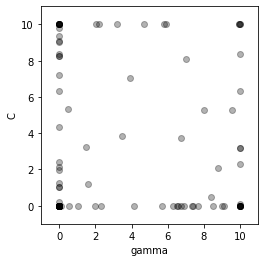

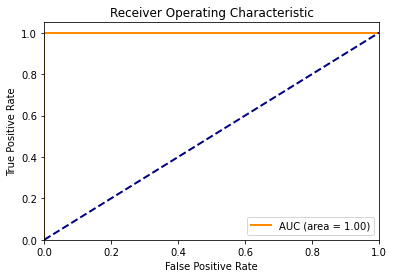

Accuracy for particle (in iteration 16, in fold 10) - 1 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 16, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001      0.22264218]
Accuracy for particle (in iteration 16, in fold 10) - 3 is 1.0000 At (gamma, c): [10.          6.31285063]
Accuracy for particle (in iteration 16, in fold 10) - 4 is 0.2500 At (gamma, c): [6.28954625e+00 1.00000000e-03]
Accuracy for particle (in iteration 16, in fold 10) - 5 is 0.2500 At (gamma, c): [0.55672374 0.001     ]
Accuracy for particle (in iteration 16, in fold 10) - 6 is 1.0000 At (gamma, c): [ 4.66263596 10.        ]
Accuracy for particle (in iteration 16, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 16, in fold 10) - 8 is 0.7857 At (gamma, c): [1.0000000e-03 6.3224455e+00]
Accuracy for particle (in iteration 16, in fold 10) - 9 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 16, in fold 10) - 10 is 1.0

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 16, in fold 10) - 98 is 0.2500 At (gamma, c): [1.03825441e+00 1.00000000e-03]
Accuracy for particle (in iteration 16, in fold 10) - 99 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 16, in fold 10) - 100 is 0.2500 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 16, fold 10 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8947
Recall Score: 0.8095
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 4 17]]
Confusion Matrix (Train):
[[130   6]
 [ 27  95]]

Iteration 17 - Fold 10:



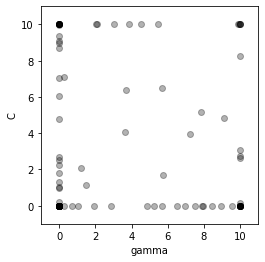

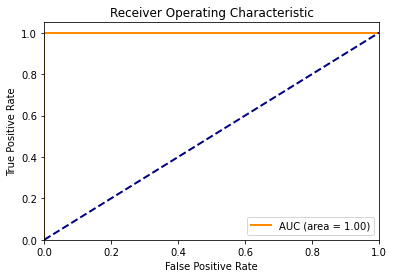

Accuracy for particle (in iteration 17, in fold 10) - 1 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 17, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001     0.2125194]
Accuracy for particle (in iteration 17, in fold 10) - 3 is 1.0000 At (gamma, c): [10.          8.24594809]
Accuracy for particle (in iteration 17, in fold 10) - 4 is 0.2500 At (gamma, c): [7.49658062e+00 1.00000000e-03]
Accuracy for particle (in iteration 17, in fold 10) - 5 is 0.2500 At (gamma, c): [0.69517974 0.001     ]
Accuracy for particle (in iteration 17, in fold 10) - 6 is 1.0000 At (gamma, c): [ 3.88226658 10.        ]
Accuracy for particle (in iteration 17, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 17, in fold 10) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 8.70510033e+00]
Accuracy for particle (in iteration 17, in fold 10) - 9 is 0.8571 At (gamma, c): [1.00000000e-03 9.07839117e+00]
Accuracy for particle (in iteration 17, in fold

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 17, in fold 10) - 97 is 0.5714 At (gamma, c): [1.0000000e-03 1.0182641e+00]
Accuracy for particle (in iteration 17, in fold 10) - 98 is 0.2500 At (gamma, c): [1.0404346e+00 1.0000000e-03]
Accuracy for particle (in iteration 17, in fold 10) - 99 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 17, in fold 10) - 100 is 0.2500 At (gamma, c): [7.97023959e+00 1.00000000e-03]
The best position in iteration 17, fold 10 is [1.00000000e-03 9.81487951e+00], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8947
Recall Score: 0.8095
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 4 17]]
Confusion Matrix (Train):
[[130   6]
 [ 27  95]]

Iteration 18 - Fold 10:



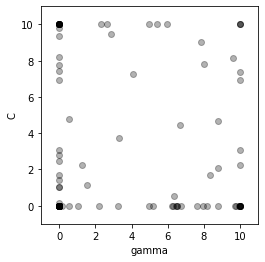

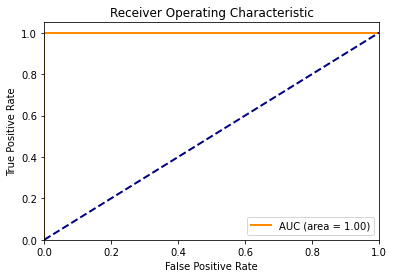

Accuracy for particle (in iteration 18, in fold 10) - 1 is 0.8571 At (gamma, c): [1.00000000e-03 9.81487951e+00]
Accuracy for particle (in iteration 18, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001      0.13242556]
Accuracy for particle (in iteration 18, in fold 10) - 3 is 1.0000 At (gamma, c): [10.          6.94319393]
Accuracy for particle (in iteration 18, in fold 10) - 4 is 0.2500 At (gamma, c): [6.29487343e+00 1.00000000e-03]
Accuracy for particle (in iteration 18, in fold 10) - 5 is 0.2500 At (gamma, c): [0.54301578 0.001     ]
Accuracy for particle (in iteration 18, in fold 10) - 6 is 1.0000 At (gamma, c): [ 4.97078186 10.        ]
Accuracy for particle (in iteration 18, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 18, in fold 10) - 8 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 18, in fold 10) - 9 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 18, in fold 10) - 10 is 1

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 18, in fold 10) - 98 is 0.2500 At (gamma, c): [1.04322126e+00 1.00000000e-03]
Accuracy for particle (in iteration 18, in fold 10) - 99 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 18, in fold 10) - 100 is 0.2500 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 18, fold 10 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8947
Recall Score: 0.8095
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 4 17]]
Confusion Matrix (Train):
[[130   6]
 [ 27  95]]

Iteration 19 - Fold 10:



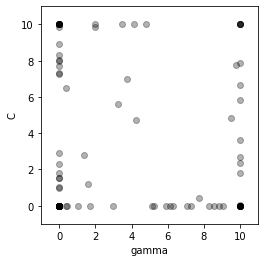

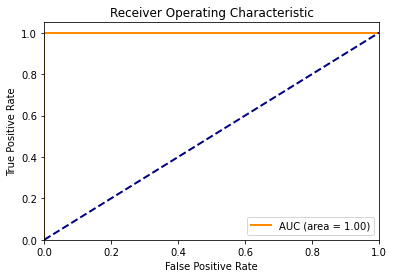

Accuracy for particle (in iteration 19, in fold 10) - 1 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 19, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 19, in fold 10) - 3 is 1.0000 At (gamma, c): [9.46488507 4.84502335]
Accuracy for particle (in iteration 19, in fold 10) - 4 is 0.2500 At (gamma, c): [8.27644766e+00 1.00000000e-03]
Accuracy for particle (in iteration 19, in fold 10) - 5 is 0.2500 At (gamma, c): [0.39700735 0.001     ]
Accuracy for particle (in iteration 19, in fold 10) - 6 is 1.0000 At (gamma, c): [ 4.82332798 10.        ]
Accuracy for particle (in iteration 19, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 19, in fold 10) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 7.68992112e+00]
Accuracy for particle (in iteration 19, in fold 10) - 9 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 19, in fold 10) - 10 is 1.0000 At (ga

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 19, in fold 10) - 96 is 1.0000 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 19, in fold 10) - 97 is 0.5714 At (gamma, c): [1.00000000e-03 1.02102986e+00]
Accuracy for particle (in iteration 19, in fold 10) - 98 is 0.2500 At (gamma, c): [1.05359842e+00 1.00000000e-03]
Accuracy for particle (in iteration 19, in fold 10) - 99 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 19, in fold 10) - 100 is 0.2500 At (gamma, c): [1.e+01 1.e-03]
The best position in iteration 19, fold 10 is [1.00000000e-03 8.91028583e+00], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8947
Recall Score: 0.8095
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 4 17]]
Confusion Matrix (Train):
[[130   6]
 [ 27  95]]

Iteration 20 - Fold 10:



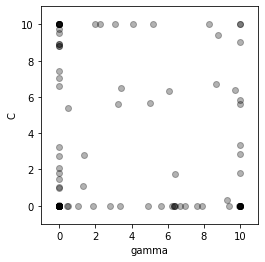

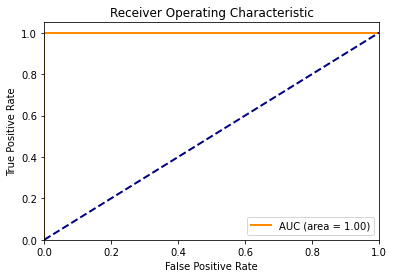

Accuracy for particle (in iteration 20, in fold 10) - 1 is 0.8571 At (gamma, c): [1.00000000e-03 8.91028583e+00]
Accuracy for particle (in iteration 20, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 20, in fold 10) - 3 is 1.0000 At (gamma, c): [10.          5.62552339]
Accuracy for particle (in iteration 20, in fold 10) - 4 is 0.2500 At (gamma, c): [6.41547803e+00 1.00000000e-03]
Accuracy for particle (in iteration 20, in fold 10) - 5 is 0.2500 At (gamma, c): [0.42594874 0.001     ]
Accuracy for particle (in iteration 20, in fold 10) - 6 is 1.0000 At (gamma, c): [ 5.18867989 10.        ]
Accuracy for particle (in iteration 20, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 20, in fold 10) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 8.81177066e+00]
Accuracy for particle (in iteration 20, in fold 10) - 9 is 0.8571 At (gamma, c): [1.0000000e-03 7.4134054e+00]
Accuracy for particle (in iteration 20, i

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 20, in fold 10) - 91 is 1.0000 At (gamma, c): [10.          3.33540517]
Accuracy for particle (in iteration 20, in fold 10) - 92 is 0.2500 At (gamma, c): [6.67928905e+00 1.00000000e-03]
Accuracy for particle (in iteration 20, in fold 10) - 93 is 0.9643 At (gamma, c): [ 1.99345562 10.        ]
Accuracy for particle (in iteration 20, in fold 10) - 94 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 20, in fold 10) - 95 is 0.9643 At (gamma, c): [ 2.27136381 10.        ]
Accuracy for particle (in iteration 20, in fold 10) - 96 is 1.0000 At (gamma, c): [ 8.26105592 10.        ]
Accuracy for particle (in iteration 20, in fold 10) - 97 is 0.5714 At (gamma, c): [1.00000000e-03 1.02277901e+00]
Accuracy for particle (in iteration 20, in fold 10) - 98 is 0.2500 At (gamma, c): [1.03855982e+00 1.00000000e-03]
Accuracy for particle (in iteration 20, in fold 10) - 99 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteratio

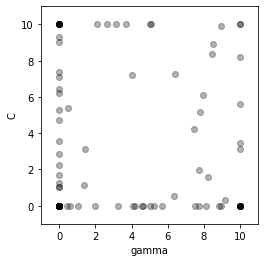

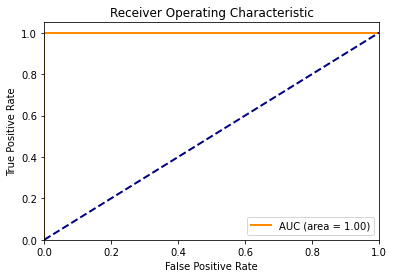

Accuracy for particle (in iteration 21, in fold 10) - 1 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 21, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 21, in fold 10) - 3 is 1.0000 At (gamma, c): [10.          5.58707039]
Accuracy for particle (in iteration 21, in fold 10) - 4 is 0.2500 At (gamma, c): [7.74603132e+00 1.00000000e-03]
Accuracy for particle (in iteration 21, in fold 10) - 5 is 0.2500 At (gamma, c): [0.62690242 0.001     ]
Accuracy for particle (in iteration 21, in fold 10) - 6 is 1.0000 At (gamma, c): [ 5.06151939 10.        ]
Accuracy for particle (in iteration 21, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 21, in fold 10) - 8 is 0.7857 At (gamma, c): [1.00000000e-03 5.25628383e+00]
Accuracy for particle (in iteration 21, in fold 10) - 9 is 0.7857 At (gamma, c): [1.00000000e-03 6.21531599e+00]
Accuracy for particle (in iteration 21, in fold 10) - 1

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 21, in fold 10) - 92 is 0.2500 At (gamma, c): [4.1715648e+00 1.0000000e-03]
Accuracy for particle (in iteration 21, in fold 10) - 93 is 1.0000 At (gamma, c): [ 2.65347841 10.        ]
Accuracy for particle (in iteration 21, in fold 10) - 94 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 21, in fold 10) - 95 is 0.9643 At (gamma, c): [ 2.06630765 10.        ]
Accuracy for particle (in iteration 21, in fold 10) - 96 is 1.0000 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 21, in fold 10) - 97 is 0.5714 At (gamma, c): [1.00000000e-03 1.02624569e+00]
Accuracy for particle (in iteration 21, in fold 10) - 98 is 0.2500 At (gamma, c): [1.04469414e+00 1.00000000e-03]
Accuracy for particle (in iteration 21, in fold 10) - 99 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 21, in fold 10) - 100 is 0.2500 At (gamma, c): [5.22191518e+00 1.00000000e-03]
The best position in iteration 21, fold 10 is

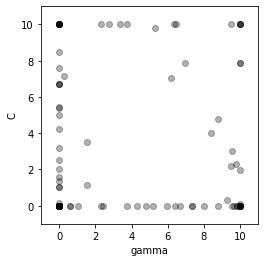

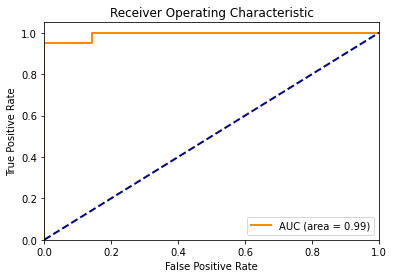

Accuracy for particle (in iteration 22, in fold 10) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 6.72187906e+00]
Accuracy for particle (in iteration 22, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 22, in fold 10) - 3 is 1.0000 At (gamma, c): [8.36551409 4.02888122]
Accuracy for particle (in iteration 22, in fold 10) - 4 is 0.2500 At (gamma, c): [9.80561247e+00 1.00000000e-03]
Accuracy for particle (in iteration 22, in fold 10) - 5 is 0.2500 At (gamma, c): [0.58647556 0.001     ]
Accuracy for particle (in iteration 22, in fold 10) - 6 is 1.0000 At (gamma, c): [ 6.33211248 10.        ]
Accuracy for particle (in iteration 22, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 22, in fold 10) - 8 is 0.7857 At (gamma, c): [1.00000000e-03 5.01369758e+00]
Accuracy for particle (in iteration 22, in fold 10) - 9 is 0.7857 At (gamma, c): [1.00000000e-03 6.72562222e+00]
Accuracy for particle (in iteration 22, i

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 22, in fold 10) - 97 is 0.5714 At (gamma, c): [1.00000000e-03 1.01196082e+00]
Accuracy for particle (in iteration 22, in fold 10) - 98 is 0.2500 At (gamma, c): [1.06766448e+00 1.00000000e-03]
Accuracy for particle (in iteration 22, in fold 10) - 99 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 22, in fold 10) - 100 is 0.2500 At (gamma, c): [6.40026991e+00 1.00000000e-03]
The best position in iteration 22, fold 10 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.7857
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 6 15]]
Confusion Matrix (Train):
[[130   6]
 [ 31  91]]

Iteration 23 - Fold 10:



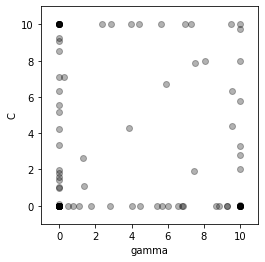

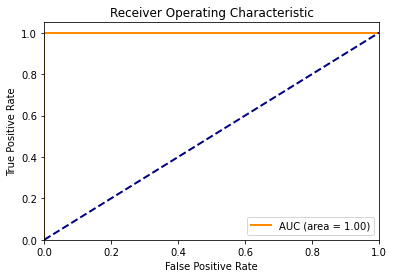

Accuracy for particle (in iteration 23, in fold 10) - 1 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 23, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001      0.08026347]
Accuracy for particle (in iteration 23, in fold 10) - 3 is 1.0000 At (gamma, c): [9.55831854 4.41139267]
Accuracy for particle (in iteration 23, in fold 10) - 4 is 0.2500 At (gamma, c): [6.58534616e+00 1.00000000e-03]
Accuracy for particle (in iteration 23, in fold 10) - 5 is 0.2500 At (gamma, c): [0.77214359 0.001     ]
Accuracy for particle (in iteration 23, in fold 10) - 6 is 1.0000 At (gamma, c): [ 5.60000693 10.        ]
Accuracy for particle (in iteration 23, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 23, in fold 10) - 8 is 0.7857 At (gamma, c): [1.00000000e-03 5.57208355e+00]
Accuracy for particle (in iteration 23, in fold 10) - 9 is 0.8214 At (gamma, c): [1.00000000e-03 7.07843561e+00]
Accuracy for particle (in iteration 23, in fold

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 23, in fold 10) - 98 is 0.2500 At (gamma, c): [1.07376949e+00 1.00000000e-03]
Accuracy for particle (in iteration 23, in fold 10) - 99 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 23, in fold 10) - 100 is 0.2500 At (gamma, c): [8.68014184e+00 1.00000000e-03]
The best position in iteration 23, fold 10 is [1.00000000e-03 9.81067171e+00], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8947
Recall Score: 0.8095
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 4 17]]
Confusion Matrix (Train):
[[130   6]
 [ 27  95]]

Iteration 24 - Fold 10:



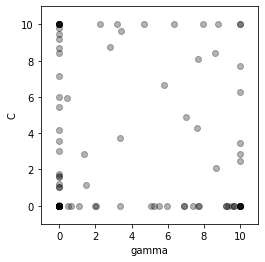

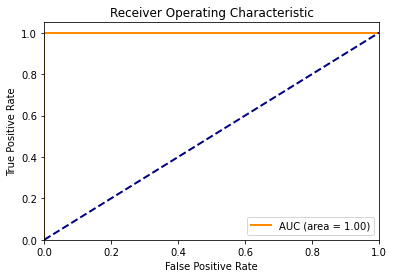

Accuracy for particle (in iteration 24, in fold 10) - 1 is 0.8571 At (gamma, c): [1.00000000e-03 9.81067171e+00]
Accuracy for particle (in iteration 24, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 24, in fold 10) - 3 is 1.0000 At (gamma, c): [10.          6.29991935]
Accuracy for particle (in iteration 24, in fold 10) - 4 is 0.2500 At (gamma, c): [5.5204204e+00 1.0000000e-03]
Accuracy for particle (in iteration 24, in fold 10) - 5 is 0.2500 At (gamma, c): [0.66954204 0.001     ]
Accuracy for particle (in iteration 24, in fold 10) - 6 is 1.0000 At (gamma, c): [3.40970531 9.64817675]
Accuracy for particle (in iteration 24, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 24, in fold 10) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 8.44311564e+00]
Accuracy for particle (in iteration 24, in fold 10) - 9 is 0.7857 At (gamma, c): [1.0000000e-03 5.9786878e+00]
Accuracy for particle (in iteration 24, in fo

Accuracy for particle (in iteration 24, in fold 10) - 80 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 24, in fold 10) - 81 is 0.8571 At (gamma, c): [1.00000000e-03 8.71374973e+00]
Accuracy for particle (in iteration 24, in fold 10) - 82 is 0.6429 At (gamma, c): [1.00000000e-03 1.76536585e+00]
Accuracy for particle (in iteration 24, in fold 10) - 83 is 0.2500 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 24, in fold 10) - 84 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 24, in fold 10) - 85 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 24, in fold 10) - 86 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 24, in fold 10) - 87 is 0.2500 At (gamma, c): [2.01760064e+00 1.00000000e-03]
Accuracy for particle (in iteration 24, in fold 10) - 88 is 0.8571 At (gamma, c): [1.00000000e-03 9.45632184e+00]
Accuracy for particle (in iteration 24, in fold 10) - 89 i

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 24, in fold 10) - 100 is 0.2500 At (gamma, c): [6.92095384e+00 1.00000000e-03]
The best position in iteration 24, fold 10 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8947
Recall Score: 0.8095
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 4 17]]
Confusion Matrix (Train):
[[130   6]
 [ 27  95]]

Iteration 25 - Fold 10:



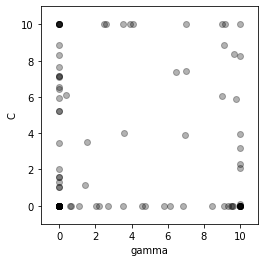

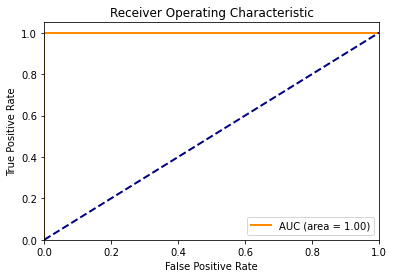

Accuracy for particle (in iteration 25, in fold 10) - 1 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 25, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 25, in fold 10) - 3 is 1.0000 At (gamma, c): [10.          8.26829093]
Accuracy for particle (in iteration 25, in fold 10) - 4 is 0.2500 At (gamma, c): [6.12415381e+00 1.00000000e-03]
Accuracy for particle (in iteration 25, in fold 10) - 5 is 0.2500 At (gamma, c): [0.67584495 0.001     ]
Accuracy for particle (in iteration 25, in fold 10) - 6 is 1.0000 At (gamma, c): [ 4.09602214 10.        ]
Accuracy for particle (in iteration 25, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 25, in fold 10) - 8 is 0.8214 At (gamma, c): [1.00000000e-03 7.13358562e+00]
Accuracy for particle (in iteration 25, in fold 10) - 9 is 0.8571 At (gamma, c): [1.00000000e-03 8.84228037e+00]
Accuracy for particle (in iteration 25, in fold 10) - 1

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 25, in fold 10) - 96 is 1.0000 At (gamma, c): [ 9.01635893 10.        ]
Accuracy for particle (in iteration 25, in fold 10) - 97 is 0.5714 At (gamma, c): [1.00000000e-03 1.01825879e+00]
Accuracy for particle (in iteration 25, in fold 10) - 98 is 0.2500 At (gamma, c): [1.09578901e+00 1.00000000e-03]
Accuracy for particle (in iteration 25, in fold 10) - 99 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 25, in fold 10) - 100 is 0.2500 At (gamma, c): [6.86270084e+00 1.00000000e-03]
The best position in iteration 25, fold 10 is [1.00000000e-03 7.79557336e+00], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8947
Recall Score: 0.8095
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 4 17]]
Confusion Matrix (Train):
[[130   6]
 [ 27  95]]

Iteration 26 - Fold 10:



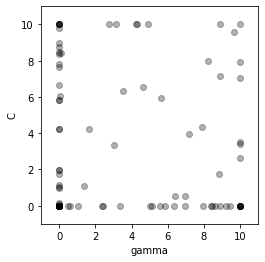

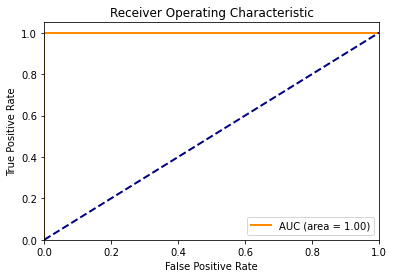

Accuracy for particle (in iteration 26, in fold 10) - 1 is 0.8571 At (gamma, c): [1.00000000e-03 7.79557336e+00]
Accuracy for particle (in iteration 26, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 26, in fold 10) - 3 is 1.0000 At (gamma, c): [10.          7.91525191]
Accuracy for particle (in iteration 26, in fold 10) - 4 is 0.2500 At (gamma, c): [8.42043324e+00 1.00000000e-03]
Accuracy for particle (in iteration 26, in fold 10) - 5 is 0.2500 At (gamma, c): [0.51069705 0.001     ]
Accuracy for particle (in iteration 26, in fold 10) - 6 is 1.0000 At (gamma, c): [ 4.91253218 10.        ]
Accuracy for particle (in iteration 26, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 26, in fold 10) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 8.78028966e+00]
Accuracy for particle (in iteration 26, in fold 10) - 9 is 0.8571 At (gamma, c): [1.00000000e-03 8.35901272e+00]
Accuracy for particle (in iteration 26,

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 26, in fold 10) - 92 is 0.2500 At (gamma, c): [5.5752328e+00 1.0000000e-03]
Accuracy for particle (in iteration 26, in fold 10) - 93 is 1.0000 At (gamma, c): [ 3.11817278 10.        ]
Accuracy for particle (in iteration 26, in fold 10) - 94 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 26, in fold 10) - 95 is 1.0000 At (gamma, c): [ 2.74965131 10.        ]
Accuracy for particle (in iteration 26, in fold 10) - 96 is 1.0000 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 26, in fold 10) - 97 is 0.5714 At (gamma, c): [1.00000000e-03 1.01664756e+00]
Accuracy for particle (in iteration 26, in fold 10) - 98 is 0.2500 At (gamma, c): [1.0567239e+00 1.0000000e-03]
Accuracy for particle (in iteration 26, in fold 10) - 99 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 26, in fold 10) - 100 is 0.2500 At (gamma, c): [6.96244031e+00 1.00000000e-03]
The best position in iteration 26, fold 10 is [

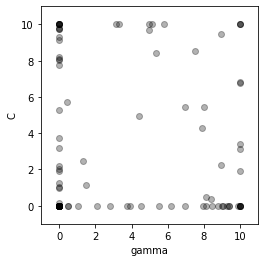

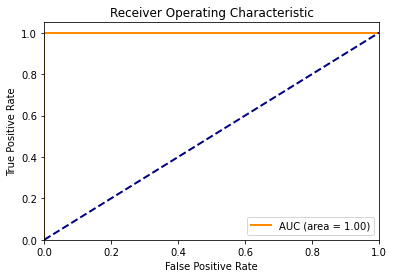

Accuracy for particle (in iteration 27, in fold 10) - 1 is 0.8571 At (gamma, c): [1.00000000e-03 9.13349721e+00]
Accuracy for particle (in iteration 27, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 27, in fold 10) - 3 is 1.0000 At (gamma, c): [10.          6.83053431]
Accuracy for particle (in iteration 27, in fold 10) - 4 is 0.2500 At (gamma, c): [7.94890792e+00 1.00000000e-03]
Accuracy for particle (in iteration 27, in fold 10) - 5 is 0.2500 At (gamma, c): [0.48024002 0.001     ]
Accuracy for particle (in iteration 27, in fold 10) - 6 is 1.0000 At (gamma, c): [ 5.78413585 10.        ]
Accuracy for particle (in iteration 27, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 27, in fold 10) - 8 is 0.7857 At (gamma, c): [1.00000000e-03 5.30616557e+00]
Accuracy for particle (in iteration 27, in fold 10) - 9 is 0.8571 At (gamma, c): [1.00000000e-03 9.33427549e+00]
Accuracy for particle (in iteration 27,

Accuracy for particle (in iteration 27, in fold 10) - 79 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 27, in fold 10) - 80 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 27, in fold 10) - 81 is 0.8571 At (gamma, c): [1.00000000e-03 9.77195198e+00]
Accuracy for particle (in iteration 27, in fold 10) - 82 is 0.6429 At (gamma, c): [1.00000000e-03 2.04744502e+00]
Accuracy for particle (in iteration 27, in fold 10) - 83 is 0.2500 At (gamma, c): [9.39897555e+00 1.00000000e-03]
Accuracy for particle (in iteration 27, in fold 10) - 84 is 0.8571 At (gamma, c): [1.00000000e-03 8.02300132e+00]
Accuracy for particle (in iteration 27, in fold 10) - 85 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 27, in fold 10) - 86 is 0.8571 At (gamma, c): [1.00000000e-03 9.73371667e+00]
Accuracy for particle (in iteration 27, in fold 10) - 87 is 0.2500 At (gamma, c): [2.10161072e+00 1.00000000e-03]
Accuracy for particle (in it

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 27, in fold 10) - 100 is 0.2500 At (gamma, c): [6.97537618e+00 1.00000000e-03]
The best position in iteration 27, fold 10 is [1.00000000e-03 8.50399383e+00], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8947
Recall Score: 0.8095
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 4 17]]
Confusion Matrix (Train):
[[130   6]
 [ 27  95]]

Iteration 28 - Fold 10:



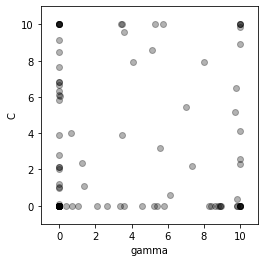

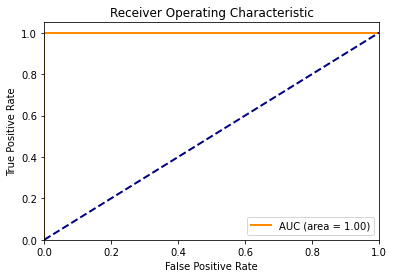

Accuracy for particle (in iteration 28, in fold 10) - 1 is 0.8571 At (gamma, c): [1.00000000e-03 8.50399383e+00]
Accuracy for particle (in iteration 28, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 28, in fold 10) - 3 is 1.0000 At (gamma, c): [9.69393426 5.19161802]
Accuracy for particle (in iteration 28, in fold 10) - 4 is 0.2500 At (gamma, c): [9.81447651e+00 1.00000000e-03]
Accuracy for particle (in iteration 28, in fold 10) - 5 is 0.2500 At (gamma, c): [0.7140069 0.001    ]
Accuracy for particle (in iteration 28, in fold 10) - 6 is 1.0000 At (gamma, c): [3.55610764 9.60112595]
Accuracy for particle (in iteration 28, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 28, in fold 10) - 8 is 0.7857 At (gamma, c): [1.00000000e-03 6.33838753e+00]
Accuracy for particle (in iteration 28, in fold 10) - 9 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 28, in fold 10) - 10 is 1

Accuracy for particle (in iteration 28, in fold 10) - 82 is 0.6429 At (gamma, c): [1.00000000e-03 2.11404107e+00]
Accuracy for particle (in iteration 28, in fold 10) - 83 is 0.2500 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 28, in fold 10) - 84 is 1.0000 At (gamma, c): [0.03784568 6.06082825]
Accuracy for particle (in iteration 28, in fold 10) - 85 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 28, in fold 10) - 86 is 0.7857 At (gamma, c): [1.00000000e-03 6.82175423e+00]
Accuracy for particle (in iteration 28, in fold 10) - 87 is 0.2500 At (gamma, c): [2.09055722e+00 1.00000000e-03]
Accuracy for particle (in iteration 28, in fold 10) - 88 is 0.8571 At (gamma, c): [1.00000000e-03 9.15052127e+00]
Accuracy for particle (in iteration 28, in fold 10) - 89 is 0.2500 At (gamma, c): [0.3859367 0.001    ]
Accuracy for particle (in iteration 28, in fold 10) - 90 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 28, in f

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


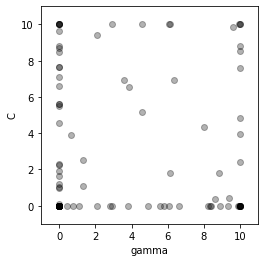

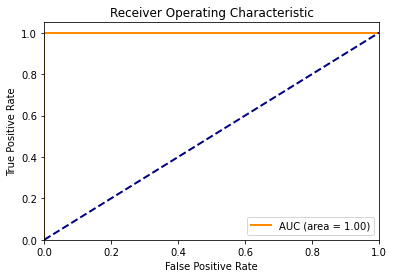

Accuracy for particle (in iteration 29, in fold 10) - 1 is 0.8214 At (gamma, c): [1.00000000e-03 7.09057134e+00]
Accuracy for particle (in iteration 29, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 29, in fold 10) - 3 is 1.0000 At (gamma, c): [10.          4.85880686]
Accuracy for particle (in iteration 29, in fold 10) - 4 is 0.2500 At (gamma, c): [8.20069089e+00 1.00000000e-03]
Accuracy for particle (in iteration 29, in fold 10) - 5 is 0.2500 At (gamma, c): [0.78991254 0.001     ]
Accuracy for particle (in iteration 29, in fold 10) - 6 is 1.0000 At (gamma, c): [ 4.58237622 10.        ]
Accuracy for particle (in iteration 29, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 29, in fold 10) - 8 is 0.7857 At (gamma, c): [1.00000000e-03 5.61126971e+00]
Accuracy for particle (in iteration 29, in fold 10) - 9 is 0.7857 At (gamma, c): [1.00000000e-03 5.60102089e+00]
Accuracy for particle (in iteration 29,

Accuracy for particle (in iteration 29, in fold 10) - 81 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 29, in fold 10) - 82 is 0.6429 At (gamma, c): [1.00000000e-03 1.89438729e+00]
Accuracy for particle (in iteration 29, in fold 10) - 83 is 0.2500 At (gamma, c): [9.30993137e+00 1.00000000e-03]
Accuracy for particle (in iteration 29, in fold 10) - 84 is 0.8571 At (gamma, c): [1.00000000e-03 7.65441002e+00]
Accuracy for particle (in iteration 29, in fold 10) - 85 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 29, in fold 10) - 86 is 0.8571 At (gamma, c): [1.00000000e-03 8.48544814e+00]
Accuracy for particle (in iteration 29, in fold 10) - 87 is 0.2500 At (gamma, c): [2.11680031e+00 1.00000000e-03]
Accuracy for particle (in iteration 29, in fold 10) - 88 is 0.8571 At (gamma, c): [1.00000000e-03 9.61786228e+00]
Accuracy for particle (in iteration 29, in fold 10) - 89 is 0.2500 At (gamma, c): [0.4355842 0.001    ]
Accuracy for parti

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


The best position in iteration 29, fold 10 is [1.00000000e-03 9.22419882e+00], with Accuracy: 1.0000
Accuracy Score: 0.8214
F1 Score: 0.8649
Recall Score: 0.7619
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 5 16]]
Confusion Matrix (Train):
[[130   6]
 [ 30  92]]

Iteration 30 - Fold 10:



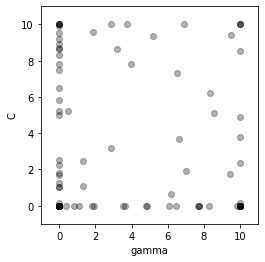

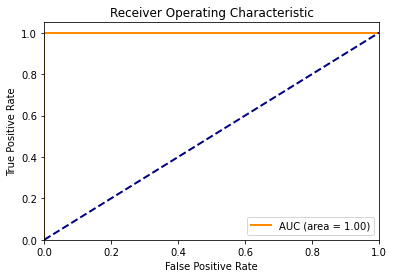

Accuracy for particle (in iteration 30, in fold 10) - 1 is 0.8571 At (gamma, c): [1.00000000e-03 9.22419882e+00]
Accuracy for particle (in iteration 30, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 30, in fold 10) - 3 is 1.0000 At (gamma, c): [10.          4.91832179]
Accuracy for particle (in iteration 30, in fold 10) - 4 is 0.2500 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 30, in fold 10) - 5 is 0.2500 At (gamma, c): [0.79763735 0.001     ]
Accuracy for particle (in iteration 30, in fold 10) - 6 is 1.0000 At (gamma, c): [ 3.75962971 10.        ]
Accuracy for particle (in iteration 30, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 30, in fold 10) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 7.80153107e+00]
Accuracy for particle (in iteration 30, in fold 10) - 9 is 0.7857 At (gamma, c): [1.00000000e-03 6.47185614e+00]
Accuracy for particle (in iteration 30, in fold 10) - 1

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 30, in fold 10) - 96 is 1.0000 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 30, in fold 10) - 97 is 0.5714 At (gamma, c): [1.00000000e-03 1.01695579e+00]
Accuracy for particle (in iteration 30, in fold 10) - 98 is 0.2500 At (gamma, c): [1.09184484e+00 1.00000000e-03]
Accuracy for particle (in iteration 30, in fold 10) - 99 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 30, in fold 10) - 100 is 0.2500 At (gamma, c): [4.80789484e+00 1.00000000e-03]
The best position in iteration 30, fold 10 is [1.00000000e-03 7.61171737e+00], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8947
Recall Score: 0.8095
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 4 17]]
Confusion Matrix (Train):
[[130   6]
 [ 27  95]]

Iteration 31 - Fold 10:



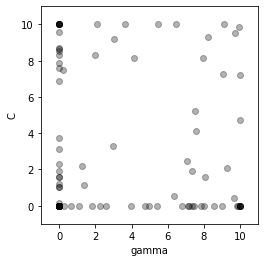

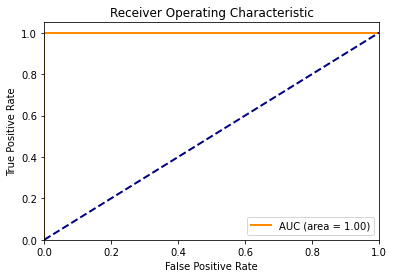

Accuracy for particle (in iteration 31, in fold 10) - 1 is 0.8571 At (gamma, c): [1.00000000e-03 7.61171737e+00]
Accuracy for particle (in iteration 31, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 31, in fold 10) - 3 is 1.0000 At (gamma, c): [10.          4.72123857]
Accuracy for particle (in iteration 31, in fold 10) - 4 is 0.2500 At (gamma, c): [7.34383099e+00 1.00000000e-03]
Accuracy for particle (in iteration 31, in fold 10) - 5 is 0.2500 At (gamma, c): [0.63800532 0.001     ]
Accuracy for particle (in iteration 31, in fold 10) - 6 is 1.0000 At (gamma, c): [3.01001185 9.21591735]
Accuracy for particle (in iteration 31, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 31, in fold 10) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 8.71025795e+00]
Accuracy for particle (in iteration 31, in fold 10) - 9 is 0.8571 At (gamma, c): [1.00000000e-03 9.56921818e+00]
Accuracy for particle (in iteration 31, i

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 31, in fold 10) - 97 is 0.5714 At (gamma, c): [1.00000000e-03 1.01454931e+00]
Accuracy for particle (in iteration 31, in fold 10) - 98 is 0.2500 At (gamma, c): [1.08395947e+00 1.00000000e-03]
Accuracy for particle (in iteration 31, in fold 10) - 99 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 31, in fold 10) - 100 is 0.2500 At (gamma, c): [4.93933358e+00 1.00000000e-03]
The best position in iteration 31, fold 10 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8947
Recall Score: 0.8095
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 4 17]]
Confusion Matrix (Train):
[[130   6]
 [ 28  94]]

Iteration 32 - Fold 10:



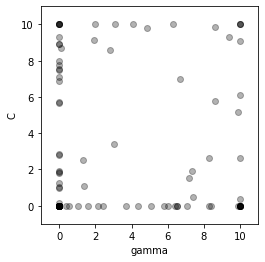

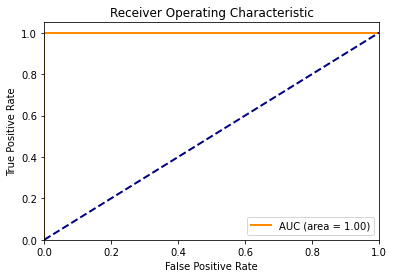

Accuracy for particle (in iteration 32, in fold 10) - 1 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 32, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001      0.16908607]
Accuracy for particle (in iteration 32, in fold 10) - 3 is 1.0000 At (gamma, c): [10.          6.10472832]
Accuracy for particle (in iteration 32, in fold 10) - 4 is 0.2500 At (gamma, c): [8.25631809e+00 1.00000000e-03]
Accuracy for particle (in iteration 32, in fold 10) - 5 is 0.2500 At (gamma, c): [0.52243919 0.001     ]
Accuracy for particle (in iteration 32, in fold 10) - 6 is 1.0000 At (gamma, c): [ 3.09405665 10.        ]
Accuracy for particle (in iteration 32, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 32, in fold 10) - 8 is 0.7857 At (gamma, c): [1.00000000e-03 6.88779606e+00]
Accuracy for particle (in iteration 32, in fold 10) - 9 is 0.7857 At (gamma, c): [1.00000000e-03 5.66463511e+00]
Accuracy for particle (in iteration 32, in fo

Accuracy for particle (in iteration 32, in fold 10) - 80 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 32, in fold 10) - 81 is 0.8571 At (gamma, c): [1.00000000e-03 8.00489099e+00]
Accuracy for particle (in iteration 32, in fold 10) - 82 is 0.6429 At (gamma, c): [1.00000000e-03 1.91100754e+00]
Accuracy for particle (in iteration 32, in fold 10) - 83 is 0.2500 At (gamma, c): [9.89726017e+00 1.00000000e-03]
Accuracy for particle (in iteration 32, in fold 10) - 84 is 0.8571 At (gamma, c): [1.0000000e-03 8.8998564e+00]
Accuracy for particle (in iteration 32, in fold 10) - 85 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 32, in fold 10) - 86 is 0.8571 At (gamma, c): [1.00000000e-03 7.53548162e+00]
Accuracy for particle (in iteration 32, in fold 10) - 87 is 0.2500 At (gamma, c): [2.17194901e+00 1.00000000e-03]
Accuracy for particle (in iteration 32, in fold 10) - 88 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in it

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 32, in fold 10) - 100 is 0.2500 At (gamma, c): [5.0710113e+00 1.0000000e-03]
The best position in iteration 32, fold 10 is [1.e-03 1.e+01], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8947
Recall Score: 0.8095
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 4 17]]
Confusion Matrix (Train):
[[130   6]
 [ 27  95]]

Iteration 33 - Fold 10:



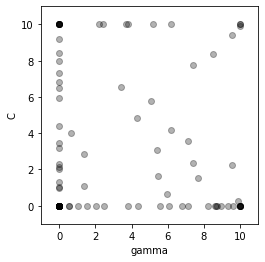

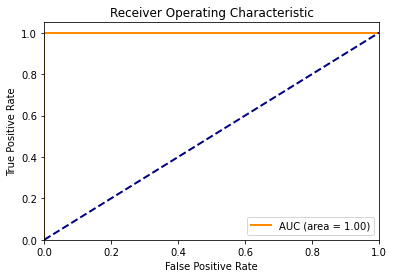

Accuracy for particle (in iteration 33, in fold 10) - 1 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 33, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 33, in fold 10) - 3 is 1.0000 At (gamma, c): [7.10026789 3.56080111]
Accuracy for particle (in iteration 33, in fold 10) - 4 is 0.2500 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 33, in fold 10) - 5 is 0.2500 At (gamma, c): [0.55018997 0.001     ]
Accuracy for particle (in iteration 33, in fold 10) - 6 is 1.0000 At (gamma, c): [ 3.80912125 10.        ]
Accuracy for particle (in iteration 33, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 33, in fold 10) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 8.41769616e+00]
Accuracy for particle (in iteration 33, in fold 10) - 9 is 0.7857 At (gamma, c): [1.0000000e-03 5.9156969e+00]
Accuracy for particle (in iteration 33, in fold 10) - 10 is 1.0000 At (gamm

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 33, in fold 10) - 98 is 0.2500 At (gamma, c): [1.04611613e+00 1.00000000e-03]
Accuracy for particle (in iteration 33, in fold 10) - 99 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 33, in fold 10) - 100 is 0.2500 At (gamma, c): [4.34169014e+00 1.00000000e-03]
The best position in iteration 33, fold 10 is [1.000000e-03 8.951501e+00], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8947
Recall Score: 0.8095
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 4 17]]
Confusion Matrix (Train):
[[130   6]
 [ 27  95]]

Iteration 34 - Fold 10:



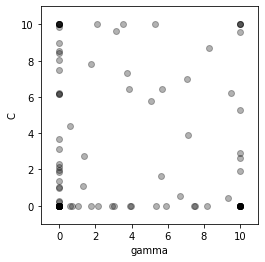

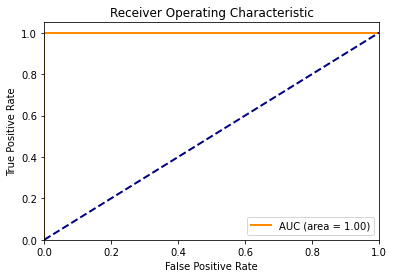

Accuracy for particle (in iteration 34, in fold 10) - 1 is 0.8571 At (gamma, c): [1.000000e-03 8.951501e+00]
Accuracy for particle (in iteration 34, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001      0.20926989]
Accuracy for particle (in iteration 34, in fold 10) - 3 is 1.0000 At (gamma, c): [10.          5.25818489]
Accuracy for particle (in iteration 34, in fold 10) - 4 is 0.2500 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 34, in fold 10) - 5 is 0.2500 At (gamma, c): [0.70619872 0.001     ]
Accuracy for particle (in iteration 34, in fold 10) - 6 is 1.0000 At (gamma, c): [ 3.50191902 10.        ]
Accuracy for particle (in iteration 34, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 34, in fold 10) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 8.42367058e+00]
Accuracy for particle (in iteration 34, in fold 10) - 9 is 0.7857 At (gamma, c): [1.0000000e-03 6.1388117e+00]
Accuracy for particle (in iteration 34, in fold 10)

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 34, in fold 10) - 99 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 34, in fold 10) - 100 is 0.2500 At (gamma, c): [5.88768125e+00 1.00000000e-03]
The best position in iteration 34, fold 10 is [1.00000000e-03 6.29975111e+00], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8947
Recall Score: 0.8095
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 4 17]]
Confusion Matrix (Train):
[[130   6]
 [ 27  95]]

Iteration 35 - Fold 10:



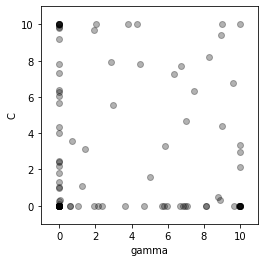

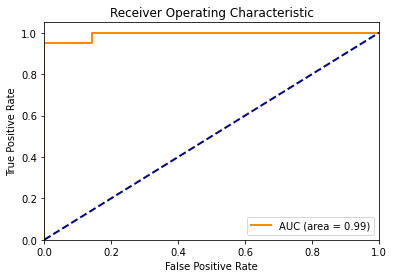

Accuracy for particle (in iteration 35, in fold 10) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 6.29975111e+00]
Accuracy for particle (in iteration 35, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001      0.23923852]
Accuracy for particle (in iteration 35, in fold 10) - 3 is 1.0000 At (gamma, c): [8.98360912 4.38097001]
Accuracy for particle (in iteration 35, in fold 10) - 4 is 0.2500 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 35, in fold 10) - 5 is 0.2500 At (gamma, c): [0.63024155 0.001     ]
Accuracy for particle (in iteration 35, in fold 10) - 6 is 1.0000 At (gamma, c): [ 4.29686652 10.        ]
Accuracy for particle (in iteration 35, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 35, in fold 10) - 8 is 0.8571 At (gamma, c): [1.00000000e-03 9.81368212e+00]
Accuracy for particle (in iteration 35, in fold 10) - 9 is 0.7857 At (gamma, c): [1.00000000e-03 5.67537856e+00]
Accuracy for particle (in iteration 35, in fold

Accuracy for particle (in iteration 35, in fold 10) - 80 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 35, in fold 10) - 81 is 0.8571 At (gamma, c): [1.00000000e-03 9.97200367e+00]
Accuracy for particle (in iteration 35, in fold 10) - 82 is 0.6786 At (gamma, c): [1.00000000e-03 2.16903392e+00]
Accuracy for particle (in iteration 35, in fold 10) - 83 is 0.2500 At (gamma, c): [8.11412352e+00 1.00000000e-03]
Accuracy for particle (in iteration 35, in fold 10) - 84 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 35, in fold 10) - 85 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 35, in fold 10) - 86 is 0.8571 At (gamma, c): [1.00000000e-03 7.83835174e+00]
Accuracy for particle (in iteration 35, in fold 10) - 87 is 0.2500 At (gamma, c): [2.16935765e+00 1.00000000e-03]
Accuracy for particle (in iteration 35, in fold 10) - 88 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 35, in

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


The best position in iteration 35, fold 10 is [1.00000000e-03 6.18108427e+00], with Accuracy: 1.0000
Accuracy Score: 0.7857
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 6 15]]
Confusion Matrix (Train):
[[130   6]
 [ 31  91]]

Iteration 36 - Fold 10:



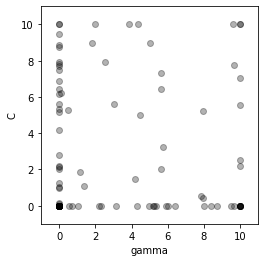

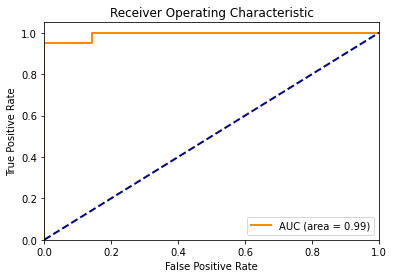

Accuracy for particle (in iteration 36, in fold 10) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 6.18108427e+00]
Accuracy for particle (in iteration 36, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 36, in fold 10) - 3 is 1.0000 At (gamma, c): [10.         5.5668595]
Accuracy for particle (in iteration 36, in fold 10) - 4 is 0.2500 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 36, in fold 10) - 5 is 0.2500 At (gamma, c): [0.72595629 0.001     ]
Accuracy for particle (in iteration 36, in fold 10) - 6 is 1.0000 At (gamma, c): [ 3.87356465 10.        ]
Accuracy for particle (in iteration 36, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 36, in fold 10) - 8 is 0.7857 At (gamma, c): [1.00000000e-03 5.34204746e+00]
Accuracy for particle (in iteration 36, in fold 10) - 9 is 0.8571 At (gamma, c): [1.00000000e-03 7.71080953e+00]
Accuracy for particle (in iteration 36, in fold 10) - 10 

Accuracy for particle (in iteration 36, in fold 10) - 82 is 0.6786 At (gamma, c): [1.0000000e-03 2.1661553e+00]
Accuracy for particle (in iteration 36, in fold 10) - 83 is 0.2500 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 36, in fold 10) - 84 is 1.0000 At (gamma, c): [0.1045701  6.21359088]
Accuracy for particle (in iteration 36, in fold 10) - 85 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 36, in fold 10) - 86 is 0.7857 At (gamma, c): [1.00000000e-03 6.86018877e+00]
Accuracy for particle (in iteration 36, in fold 10) - 87 is 0.2500 At (gamma, c): [2.30280549e+00 1.00000000e-03]
Accuracy for particle (in iteration 36, in fold 10) - 88 is 0.8571 At (gamma, c): [1.00000000e-03 8.86392127e+00]
Accuracy for particle (in iteration 36, in fold 10) - 89 is 0.2500 At (gamma, c): [0.53306095 0.001     ]
Accuracy for particle (in iteration 36, in fold 10) - 90 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 36, in f

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


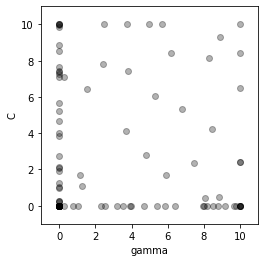

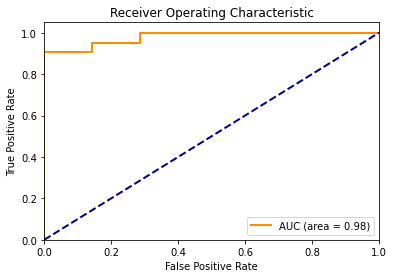

Accuracy for particle (in iteration 37, in fold 10) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 5.22225213e+00]
Accuracy for particle (in iteration 37, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001      0.20343811]
Accuracy for particle (in iteration 37, in fold 10) - 3 is 1.0000 At (gamma, c): [8.43356108 4.22670729]
Accuracy for particle (in iteration 37, in fold 10) - 4 is 0.2500 At (gamma, c): [5.39316231e+00 1.00000000e-03]
Accuracy for particle (in iteration 37, in fold 10) - 5 is 0.2500 At (gamma, c): [0.76922063 0.001     ]
Accuracy for particle (in iteration 37, in fold 10) - 6 is 1.0000 At (gamma, c): [ 3.76321274 10.        ]
Accuracy for particle (in iteration 37, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 37, in fold 10) - 8 is 0.7857 At (gamma, c): [1.00000000e-03 5.65794026e+00]
Accuracy for particle (in iteration 37, in fold 10) - 9 is 0.8571 At (gamma, c): [1.00000000e-03 8.86275809e+00]
Accuracy for particle (in itera

Accuracy for particle (in iteration 37, in fold 10) - 82 is 0.6429 At (gamma, c): [1.00000000e-03 2.14493128e+00]
Accuracy for particle (in iteration 37, in fold 10) - 83 is 0.2500 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 37, in fold 10) - 84 is 0.8571 At (gamma, c): [1.00000000e-03 7.40686428e+00]
Accuracy for particle (in iteration 37, in fold 10) - 85 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 37, in fold 10) - 86 is 0.8214 At (gamma, c): [1.00000000e-03 7.36789883e+00]
Accuracy for particle (in iteration 37, in fold 10) - 87 is 0.2500 At (gamma, c): [2.30071672e+00 1.00000000e-03]
Accuracy for particle (in iteration 37, in fold 10) - 88 is 0.8571 At (gamma, c): [1.0000000e-03 9.8446604e+00]
Accuracy for particle (in iteration 37, in fold 10) - 89 is 0.2500 At (gamma, c): [0.2814294 0.001    ]
Accuracy for particle (in iteration 37, in fold 10) - 90 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 37

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


The best position in iteration 37, fold 10 is [1.00000000e-03 5.90821249e+00], with Accuracy: 1.0000
Accuracy Score: 0.7857
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 6 15]]
Confusion Matrix (Train):
[[130   6]
 [ 32  90]]

Iteration 38 - Fold 10:



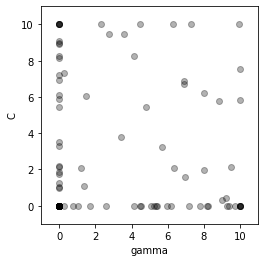

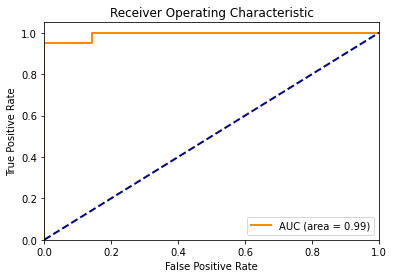

Accuracy for particle (in iteration 38, in fold 10) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 5.90821249e+00]
Accuracy for particle (in iteration 38, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 38, in fold 10) - 3 is 1.0000 At (gamma, c): [10.          5.82381101]
Accuracy for particle (in iteration 38, in fold 10) - 4 is 0.2500 At (gamma, c): [5.35380777e+00 1.00000000e-03]
Accuracy for particle (in iteration 38, in fold 10) - 5 is 0.2500 At (gamma, c): [0.74896141 0.001     ]
Accuracy for particle (in iteration 38, in fold 10) - 6 is 1.0000 At (gamma, c): [ 4.46357205 10.        ]
Accuracy for particle (in iteration 38, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 38, in fold 10) - 8 is 0.8214 At (gamma, c): [1.00000000e-03 7.20367579e+00]
Accuracy for particle (in iteration 38, in fold 10) - 9 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 38, in fold 10) - 1

Accuracy for particle (in iteration 38, in fold 10) - 79 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 38, in fold 10) - 80 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 38, in fold 10) - 81 is 0.8214 At (gamma, c): [1.00000000e-03 6.94037579e+00]
Accuracy for particle (in iteration 38, in fold 10) - 82 is 0.6429 At (gamma, c): [1.00000000e-03 1.88440936e+00]
Accuracy for particle (in iteration 38, in fold 10) - 83 is 0.2500 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 38, in fold 10) - 84 is 0.8571 At (gamma, c): [1.00000000e-03 9.07968961e+00]
Accuracy for particle (in iteration 38, in fold 10) - 85 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 38, in fold 10) - 86 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 38, in fold 10) - 87 is 0.2500 At (gamma, c): [2.58062936e+00 1.00000000e-03]
Accuracy for particle (in iteration 38, in fold 10) - 88 is 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 38, in fold 10) - 98 is 0.2500 At (gamma, c): [1.0327311e+00 1.0000000e-03]
Accuracy for particle (in iteration 38, in fold 10) - 99 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 38, in fold 10) - 100 is 0.2500 At (gamma, c): [8.15820185e+00 1.00000000e-03]
The best position in iteration 38, fold 10 is [1.00000000e-03 5.43690992e+00], with Accuracy: 1.0000
Accuracy Score: 0.7857
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 6 15]]
Confusion Matrix (Train):
[[130   6]
 [ 31  91]]

Iteration 39 - Fold 10:



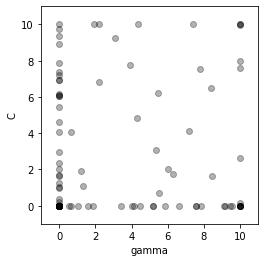

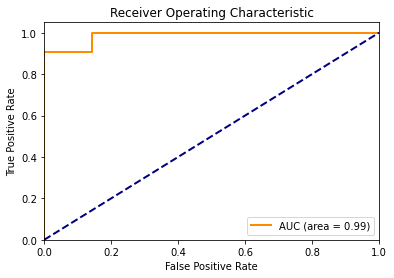

Accuracy for particle (in iteration 39, in fold 10) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 5.43690992e+00]
Accuracy for particle (in iteration 39, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001      0.37932324]
Accuracy for particle (in iteration 39, in fold 10) - 3 is 1.0000 At (gamma, c): [10.          7.58539943]
Accuracy for particle (in iteration 39, in fold 10) - 4 is 0.2500 At (gamma, c): [7.80534557e+00 1.00000000e-03]
Accuracy for particle (in iteration 39, in fold 10) - 5 is 0.2500 At (gamma, c): [0.6430498 0.001    ]
Accuracy for particle (in iteration 39, in fold 10) - 6 is 1.0000 At (gamma, c): [ 4.36831989 10.        ]
Accuracy for particle (in iteration 39, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 39, in fold 10) - 8 is 0.7857 At (gamma, c): [1.00000000e-03 4.61763787e+00]
Accuracy for particle (in iteration 39, in fold 10) - 9 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 39, in fold

Accuracy for particle (in iteration 39, in fold 10) - 80 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 39, in fold 10) - 81 is 0.7857 At (gamma, c): [1.00000000e-03 6.05488661e+00]
Accuracy for particle (in iteration 39, in fold 10) - 82 is 0.6429 At (gamma, c): [1.00000000e-03 2.03414462e+00]
Accuracy for particle (in iteration 39, in fold 10) - 83 is 0.2500 At (gamma, c): [9.51761574e+00 1.00000000e-03]
Accuracy for particle (in iteration 39, in fold 10) - 84 is 0.9286 At (gamma, c): [0.01091137 6.92201538]
Accuracy for particle (in iteration 39, in fold 10) - 85 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 39, in fold 10) - 86 is 0.8214 At (gamma, c): [1.00000000e-03 7.18433307e+00]
Accuracy for particle (in iteration 39, in fold 10) - 87 is 0.2500 At (gamma, c): [1.85956182e+00 1.00000000e-03]
Accuracy for particle (in iteration 39, in fold 10) - 88 is 0.8571 At (gamma, c): [1.00000000e-03 9.77087582e+00]
Accuracy for parti

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 39, in fold 10) - 100 is 0.2500 At (gamma, c): [4.1443023e+00 1.0000000e-03]
The best position in iteration 39, fold 10 is [1.00000000e-03 6.55421303e+00], with Accuracy: 1.0000
Accuracy Score: 0.7857
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 6 15]]
Confusion Matrix (Train):
[[130   6]
 [ 31  91]]

Iteration 40 - Fold 10:



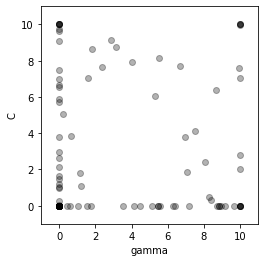

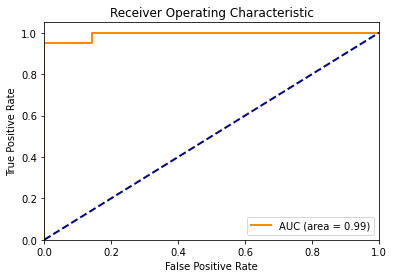

Accuracy for particle (in iteration 40, in fold 10) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 6.55421303e+00]
Accuracy for particle (in iteration 40, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001      0.26473106]
Accuracy for particle (in iteration 40, in fold 10) - 3 is 1.0000 At (gamma, c): [10.         7.0296044]
Accuracy for particle (in iteration 40, in fold 10) - 4 is 0.2500 At (gamma, c): [6.38165741e+00 1.00000000e-03]
Accuracy for particle (in iteration 40, in fold 10) - 5 is 0.2500 At (gamma, c): [0.59196217 0.001     ]
Accuracy for particle (in iteration 40, in fold 10) - 6 is 1.0000 At (gamma, c): [3.13325335 8.78307801]
Accuracy for particle (in iteration 40, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 40, in fold 10) - 8 is 0.7857 At (gamma, c): [1.00000000e-03 3.77209963e+00]
Accuracy for particle (in iteration 40, in fold 10) - 9 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 40, in fold 1

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 40, in fold 10) - 97 is 0.5714 At (gamma, c): [1.00000000e-03 1.00844922e+00]
Accuracy for particle (in iteration 40, in fold 10) - 98 is 0.2500 At (gamma, c): [1.02704091e+00 1.00000000e-03]
Accuracy for particle (in iteration 40, in fold 10) - 99 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 40, in fold 10) - 100 is 0.2500 At (gamma, c): [5.43826556e+00 1.00000000e-03]
The best position in iteration 40, fold 10 is [1.00000000e-03 6.07240622e+00], with Accuracy: 1.0000
Accuracy Score: 0.7857
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 6 15]]
Confusion Matrix (Train):
[[130   6]
 [ 31  91]]

Iteration 41 - Fold 10:



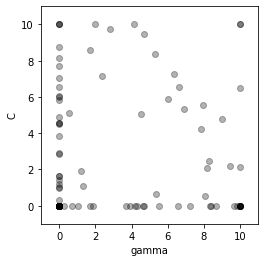

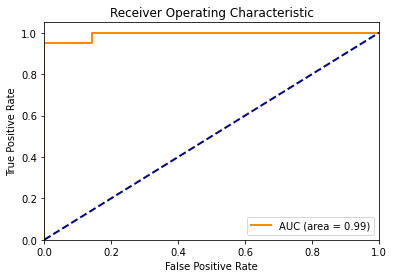

Accuracy for particle (in iteration 41, in fold 10) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 6.07240622e+00]
Accuracy for particle (in iteration 41, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001      0.29291155]
Accuracy for particle (in iteration 41, in fold 10) - 3 is 1.0000 At (gamma, c): [10.          6.47517346]
Accuracy for particle (in iteration 41, in fold 10) - 4 is 0.2500 At (gamma, c): [4.17012487e+00 1.00000000e-03]
Accuracy for particle (in iteration 41, in fold 10) - 5 is 0.2500 At (gamma, c): [0.71320872 0.001     ]
Accuracy for particle (in iteration 41, in fold 10) - 6 is 1.0000 At (gamma, c): [ 4.15236417 10.        ]
Accuracy for particle (in iteration 41, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 41, in fold 10) - 8 is 0.7857 At (gamma, c): [1.00000000e-03 3.84476733e+00]
Accuracy for particle (in iteration 41, in fold 10) - 9 is 0.7857 At (gamma, c): [1.00000000e-03 5.83407424e+00]
Accuracy for particle (in ite

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 41, in fold 10) - 91 is 1.0000 At (gamma, c): [8.26899553 2.44907151]
Accuracy for particle (in iteration 41, in fold 10) - 92 is 0.2500 At (gamma, c): [3.89183028 0.00722168]
Accuracy for particle (in iteration 41, in fold 10) - 93 is 0.9643 At (gamma, c): [1.73250318 8.61456025]
Accuracy for particle (in iteration 41, in fold 10) - 94 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 41, in fold 10) - 95 is 0.9643 At (gamma, c): [ 2.0039196 10.       ]
Accuracy for particle (in iteration 41, in fold 10) - 96 is 1.0000 At (gamma, c): [10. 10.]
Accuracy for particle (in iteration 41, in fold 10) - 97 is 0.5714 At (gamma, c): [1.00000000e-03 1.01352984e+00]
Accuracy for particle (in iteration 41, in fold 10) - 98 is 0.2500 At (gamma, c): [1.02725738e+00 1.00000000e-03]
Accuracy for particle (in iteration 41, in fold 10) - 99 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 41, in fold 10) - 100 is 0.2

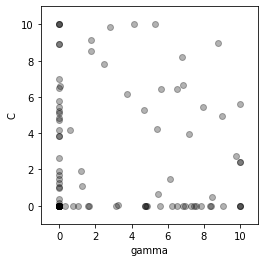

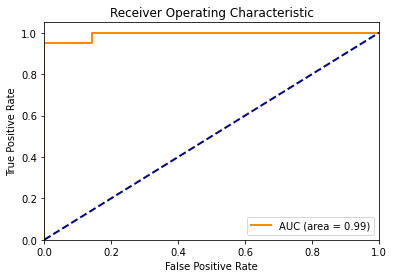

Accuracy for particle (in iteration 42, in fold 10) - 1 is 0.8214 At (gamma, c): [1.00000000e-03 6.99892286e+00]
Accuracy for particle (in iteration 42, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001      0.37230514]
Accuracy for particle (in iteration 42, in fold 10) - 3 is 1.0000 At (gamma, c): [9.01327299 4.95010474]
Accuracy for particle (in iteration 42, in fold 10) - 4 is 0.2500 At (gamma, c): [4.73233497e+00 1.00000000e-03]
Accuracy for particle (in iteration 42, in fold 10) - 5 is 0.2500 At (gamma, c): [0.78466038 0.001     ]
Accuracy for particle (in iteration 42, in fold 10) - 6 is 1.0000 At (gamma, c): [ 4.14008893 10.        ]
Accuracy for particle (in iteration 42, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 42, in fold 10) - 8 is 0.7857 At (gamma, c): [1.00000000e-03 4.18013949e+00]
Accuracy for particle (in iteration 42, in fold 10) - 9 is 0.7857 At (gamma, c): [1.00000000e-03 4.81998265e+00]
Accuracy for particle (in itera

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 42, in fold 10) - 95 is 0.9643 At (gamma, c): [1.78832381 8.51273501]
Accuracy for particle (in iteration 42, in fold 10) - 96 is 1.0000 At (gamma, c): [6.78549883 8.18483932]
Accuracy for particle (in iteration 42, in fold 10) - 97 is 0.5714 At (gamma, c): [1.00000000e-03 1.01528509e+00]
Accuracy for particle (in iteration 42, in fold 10) - 98 is 0.2500 At (gamma, c): [1.03769267e+00 1.00000000e-03]
Accuracy for particle (in iteration 42, in fold 10) - 99 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 42, in fold 10) - 100 is 0.2500 At (gamma, c): [4.72773404e+00 1.00000000e-03]
The best position in iteration 42, fold 10 is [1.00000000e-03 5.86373905e+00], with Accuracy: 1.0000
Accuracy Score: 0.8214
F1 Score: 0.8649
Recall Score: 0.7619
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 5 16]]
Confusion Matrix (Train):
[[130   6]
 [ 30  92]]

Iteration 43 - Fold 10:



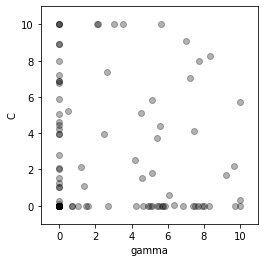

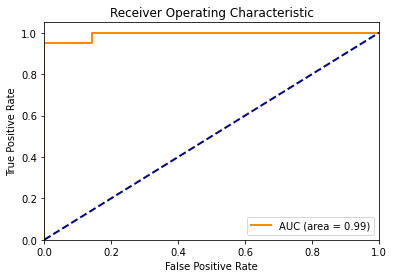

Accuracy for particle (in iteration 43, in fold 10) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 5.86373905e+00]
Accuracy for particle (in iteration 43, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001      0.25238898]
Accuracy for particle (in iteration 43, in fold 10) - 3 is 1.0000 At (gamma, c): [10.          5.69954198]
Accuracy for particle (in iteration 43, in fold 10) - 4 is 0.2500 At (gamma, c): [5.681149e+00 1.000000e-03]
Accuracy for particle (in iteration 43, in fold 10) - 5 is 0.2500 At (gamma, c): [0.71582749 0.001     ]
Accuracy for particle (in iteration 43, in fold 10) - 6 is 1.0000 At (gamma, c): [2.62225611 7.38444589]
Accuracy for particle (in iteration 43, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 43, in fold 10) - 8 is 0.7857 At (gamma, c): [1.00000000e-03 3.94068302e+00]
Accuracy for particle (in iteration 43, in fold 10) - 9 is 0.8214 At (gamma, c): [1.00000000e-03 7.21035619e+00]
Accuracy for particle (in iteration

Accuracy for particle (in iteration 43, in fold 10) - 80 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 43, in fold 10) - 81 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 43, in fold 10) - 82 is 0.6429 At (gamma, c): [1.00000000e-03 2.01717534e+00]
Accuracy for particle (in iteration 43, in fold 10) - 83 is 0.2500 At (gamma, c): [1.e+01 1.e-03]
Accuracy for particle (in iteration 43, in fold 10) - 84 is 0.7857 At (gamma, c): [1.00000000e-03 6.74385113e+00]
Accuracy for particle (in iteration 43, in fold 10) - 85 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 43, in fold 10) - 86 is 0.8571 At (gamma, c): [1.00000000e-03 8.91603965e+00]
Accuracy for particle (in iteration 43, in fold 10) - 87 is 0.2500 At (gamma, c): [1.60837822e+00 1.00000000e-03]
Accuracy for particle (in iteration 43, in fold 10) - 88 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 43, in fold 10) - 89 i

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 43, in fold 10) - 99 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 43, in fold 10) - 100 is 0.2500 At (gamma, c): [5.72307747e+00 1.00000000e-03]
The best position in iteration 43, fold 10 is [1.00000000e-03 5.61666303e+00], with Accuracy: 1.0000
Accuracy Score: 0.7857
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 6 15]]
Confusion Matrix (Train):
[[130   6]
 [ 31  91]]

Iteration 44 - Fold 10:



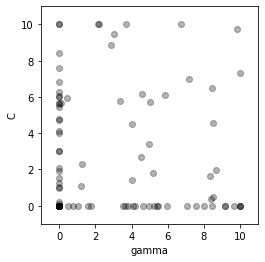

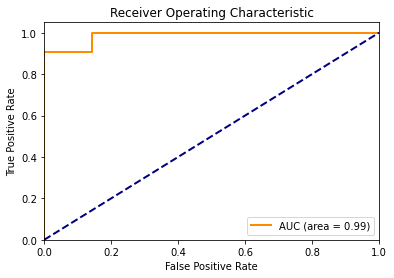

Accuracy for particle (in iteration 44, in fold 10) - 1 is 0.7857 At (gamma, c): [1.00000000e-03 5.61666303e+00]
Accuracy for particle (in iteration 44, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001      0.10236519]
Accuracy for particle (in iteration 44, in fold 10) - 3 is 1.0000 At (gamma, c): [10.          7.29740063]
Accuracy for particle (in iteration 44, in fold 10) - 4 is 0.2500 At (gamma, c): [7.996124e+00 1.000000e-03]
Accuracy for particle (in iteration 44, in fold 10) - 5 is 0.2500 At (gamma, c): [0.77870667 0.001     ]
Accuracy for particle (in iteration 44, in fold 10) - 6 is 1.0000 At (gamma, c): [2.85783694 8.85816532]
Accuracy for particle (in iteration 44, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 44, in fold 10) - 8 is 0.7857 At (gamma, c): [1.00000000e-03 4.75386355e+00]
Accuracy for particle (in iteration 44, in fold 10) - 9 is 0.7857 At (gamma, c): [1.00000000e-03 5.66140484e+00]
Accuracy for particle (in iteration

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 44, in fold 10) - 97 is 0.5714 At (gamma, c): [1.00000000e-03 1.00787225e+00]
Accuracy for particle (in iteration 44, in fold 10) - 98 is 0.2500 At (gamma, c): [1.05962333e+00 1.00000000e-03]
Accuracy for particle (in iteration 44, in fold 10) - 99 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 44, in fold 10) - 100 is 0.2500 At (gamma, c): [7.04867353e+00 1.00000000e-03]
The best position in iteration 44, fold 10 is [1.00000000e-03 7.31314666e+00], with Accuracy: 1.0000
Accuracy Score: 0.7857
F1 Score: 0.8333
Recall Score: 0.7143
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 6 15]]
Confusion Matrix (Train):
[[130   6]
 [ 31  91]]

Iteration 45 - Fold 10:



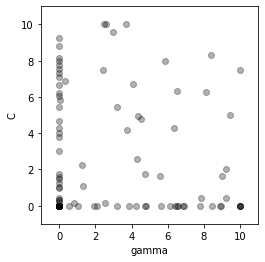

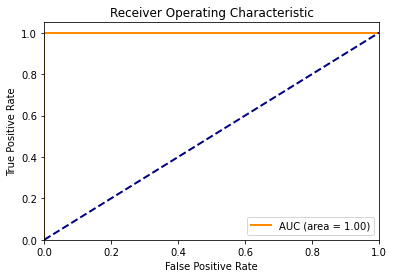

Accuracy for particle (in iteration 45, in fold 10) - 1 is 0.8214 At (gamma, c): [1.00000000e-03 7.31314666e+00]
Accuracy for particle (in iteration 45, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001      0.28837279]
Accuracy for particle (in iteration 45, in fold 10) - 3 is 1.0000 At (gamma, c): [10.          7.47573971]
Accuracy for particle (in iteration 45, in fold 10) - 4 is 0.2500 At (gamma, c): [8.86744184e+00 1.00000000e-03]
Accuracy for particle (in iteration 45, in fold 10) - 5 is 0.2500 At (gamma, c): [0.84684708 0.12911723]
Accuracy for particle (in iteration 45, in fold 10) - 6 is 1.0000 At (gamma, c): [2.98187966 9.60808158]
Accuracy for particle (in iteration 45, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 45, in fold 10) - 8 is 0.7857 At (gamma, c): [1.00000000e-03 4.26199734e+00]
Accuracy for particle (in iteration 45, in fold 10) - 9 is 0.8214 At (gamma, c): [1.00000000e-03 7.07470243e+00]
Accuracy for particle (in itera

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 45, in fold 10) - 95 is 1.0000 At (gamma, c): [ 2.45598054 10.        ]
Accuracy for particle (in iteration 45, in fold 10) - 96 is 1.0000 At (gamma, c): [5.83093115 7.98925804]
Accuracy for particle (in iteration 45, in fold 10) - 97 is 0.5714 At (gamma, c): [1.00000000e-03 1.01042301e+00]
Accuracy for particle (in iteration 45, in fold 10) - 98 is 0.2500 At (gamma, c): [1.02991141e+00 1.00000000e-03]
Accuracy for particle (in iteration 45, in fold 10) - 99 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 45, in fold 10) - 100 is 0.2500 At (gamma, c): [3.84333208e+00 1.00000000e-03]
The best position in iteration 45, fold 10 is [1.00000000e-03 9.55780921e+00], with Accuracy: 1.0000
Accuracy Score: 0.8214
F1 Score: 0.8649
Recall Score: 0.7619
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 5 16]]
Confusion Matrix (Train):
[[130   6]
 [ 29  93]]

Iteration 46 - Fold 10:



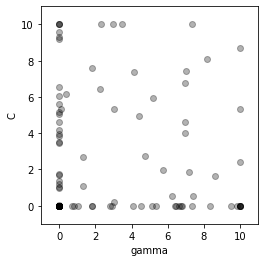

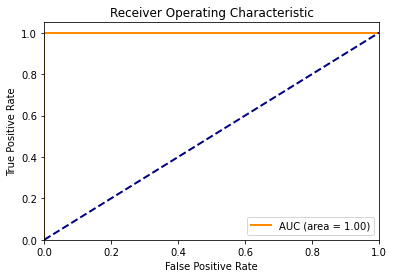

Accuracy for particle (in iteration 46, in fold 10) - 1 is 0.8571 At (gamma, c): [1.00000000e-03 9.55780921e+00]
Accuracy for particle (in iteration 46, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001      0.02890241]
Accuracy for particle (in iteration 46, in fold 10) - 3 is 1.0000 At (gamma, c): [6.96287183 4.01338715]
Accuracy for particle (in iteration 46, in fold 10) - 4 is 0.2500 At (gamma, c): [9.48610633e+00 1.00000000e-03]
Accuracy for particle (in iteration 46, in fold 10) - 5 is 0.2500 At (gamma, c): [0.82869508 0.001     ]
Accuracy for particle (in iteration 46, in fold 10) - 6 is 1.0000 At (gamma, c): [ 3.45809097 10.        ]
Accuracy for particle (in iteration 46, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 46, in fold 10) - 8 is 0.7857 At (gamma, c): [1.00000000e-03 3.96296113e+00]
Accuracy for particle (in iteration 46, in fold 10) - 9 is 0.7857 At (gamma, c): [1.00000000e-03 6.57116519e+00]
Accuracy for particle (in itera

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 46, in fold 10) - 95 is 0.9643 At (gamma, c): [1.84313165 7.61717942]
Accuracy for particle (in iteration 46, in fold 10) - 96 is 1.0000 At (gamma, c): [ 7.36282946 10.        ]
Accuracy for particle (in iteration 46, in fold 10) - 97 is 0.5714 At (gamma, c): [1.00000000e-03 1.00624262e+00]
Accuracy for particle (in iteration 46, in fold 10) - 98 is 0.2500 At (gamma, c): [1.02781388e+00 1.00000000e-03]
Accuracy for particle (in iteration 46, in fold 10) - 99 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 46, in fold 10) - 100 is 0.2500 At (gamma, c): [5.14519722e+00 1.00000000e-03]
The best position in iteration 46, fold 10 is [1.00000000e-03 9.75027339e+00], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8947
Recall Score: 0.8095
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 4 17]]
Confusion Matrix (Train):
[[130   6]
 [ 27  95]]

Iteration 47 - Fold 10:



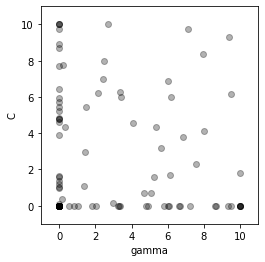

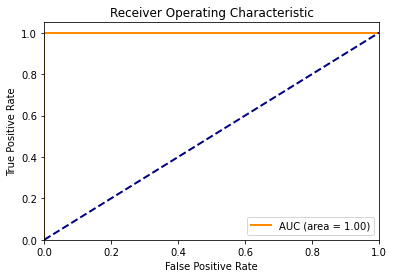

Accuracy for particle (in iteration 47, in fold 10) - 1 is 0.8571 At (gamma, c): [1.00000000e-03 9.75027339e+00]
Accuracy for particle (in iteration 47, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001      0.07070445]
Accuracy for particle (in iteration 47, in fold 10) - 3 is 1.0000 At (gamma, c): [7.98922145 4.10521182]
Accuracy for particle (in iteration 47, in fold 10) - 4 is 0.2500 At (gamma, c): [9.30499813e+00 1.00000000e-03]
Accuracy for particle (in iteration 47, in fold 10) - 5 is 0.2500 At (gamma, c): [0.79845037 0.001     ]
Accuracy for particle (in iteration 47, in fold 10) - 6 is 1.0000 At (gamma, c): [2.42743128 7.00771505]
Accuracy for particle (in iteration 47, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 47, in fold 10) - 8 is 0.7857 At (gamma, c): [1.0000000e-03 5.7477833e+00]
Accuracy for particle (in iteration 47, in fold 10) - 9 is 0.8571 At (gamma, c): [1.00000000e-03 8.90468367e+00]
Accuracy for particle (in iteration

Accuracy for particle (in iteration 47, in fold 10) - 82 is 0.6429 At (gamma, c): [1.00000000e-03 1.60224186e+00]
Accuracy for particle (in iteration 47, in fold 10) - 83 is 0.2500 At (gamma, c): [7.25200766e+00 1.00000000e-03]
Accuracy for particle (in iteration 47, in fold 10) - 84 is 0.9643 At (gamma, c): [0.32652671 4.32430168]
Accuracy for particle (in iteration 47, in fold 10) - 85 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 47, in fold 10) - 86 is 0.7857 At (gamma, c): [1.00000000e-03 6.42088909e+00]
Accuracy for particle (in iteration 47, in fold 10) - 87 is 0.2500 At (gamma, c): [1.82038044e+00 1.00000000e-03]
Accuracy for particle (in iteration 47, in fold 10) - 88 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 47, in fold 10) - 89 is 0.2500 At (gamma, c): [0.53085774 0.001     ]
Accuracy for particle (in iteration 47, in fold 10) - 90 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 47, in

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


The best position in iteration 47, fold 10 is [1.00000000e-03 8.17148072e+00], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8947
Recall Score: 0.8095
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 4 17]]
Confusion Matrix (Train):
[[130   6]
 [ 27  95]]

Iteration 48 - Fold 10:



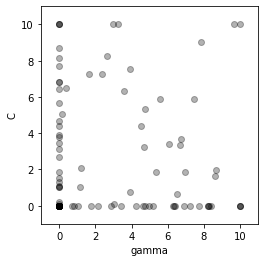

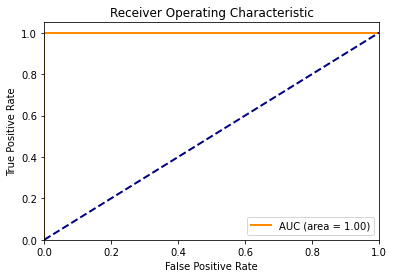

Accuracy for particle (in iteration 48, in fold 10) - 1 is 0.8571 At (gamma, c): [1.00000000e-03 8.17148072e+00]
Accuracy for particle (in iteration 48, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 48, in fold 10) - 3 is 1.0000 At (gamma, c): [6.6914115  3.34009915]
Accuracy for particle (in iteration 48, in fold 10) - 4 is 0.2500 At (gamma, c): [7.74535849e+00 1.00000000e-03]
Accuracy for particle (in iteration 48, in fold 10) - 5 is 0.2500 At (gamma, c): [0.80309486 0.001     ]
Accuracy for particle (in iteration 48, in fold 10) - 6 is 1.0000 At (gamma, c): [2.66428095 8.23385473]
Accuracy for particle (in iteration 48, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 48, in fold 10) - 8 is 0.7857 At (gamma, c): [1.00000000e-03 4.65154077e+00]
Accuracy for particle (in iteration 48, in fold 10) - 9 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 48, in fold 10) - 10 is

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 48, in fold 10) - 95 is 0.9643 At (gamma, c): [1.63703277 7.26581169]
Accuracy for particle (in iteration 48, in fold 10) - 96 is 1.0000 At (gamma, c): [ 9.63439406 10.        ]
Accuracy for particle (in iteration 48, in fold 10) - 97 is 0.5714 At (gamma, c): [1.0000000e-03 1.0091768e+00]
Accuracy for particle (in iteration 48, in fold 10) - 98 is 0.2500 At (gamma, c): [1.03539441e+00 1.00000000e-03]
Accuracy for particle (in iteration 48, in fold 10) - 99 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 48, in fold 10) - 100 is 0.2500 At (gamma, c): [6.40985308e+00 1.00000000e-03]
The best position in iteration 48, fold 10 is [1.00000000e-03 7.26944693e+00], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8947
Recall Score: 0.8095
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 4 17]]
Confusion Matrix (Train):
[[130   6]
 [ 28  94]]

Iteration 49 - Fold 10:



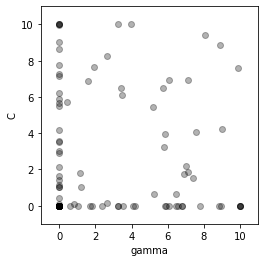

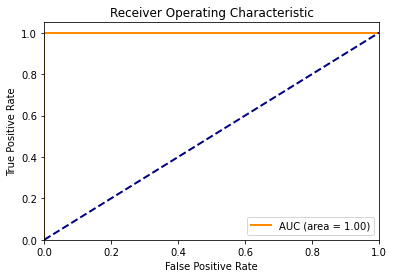

Accuracy for particle (in iteration 49, in fold 10) - 1 is 0.8214 At (gamma, c): [1.00000000e-03 7.26944693e+00]
Accuracy for particle (in iteration 49, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 49, in fold 10) - 3 is 1.0000 At (gamma, c): [9.01766755 4.23313036]
Accuracy for particle (in iteration 49, in fold 10) - 4 is 0.2500 At (gamma, c): [5.86779076e+00 1.00000000e-03]
Accuracy for particle (in iteration 49, in fold 10) - 5 is 0.2500 At (gamma, c): [0.842853   0.10097512]
Accuracy for particle (in iteration 49, in fold 10) - 6 is 1.0000 At (gamma, c): [2.64865386 8.25878924]
Accuracy for particle (in iteration 49, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 49, in fold 10) - 8 is 0.7857 At (gamma, c): [1.00000000e-03 3.58616498e+00]
Accuracy for particle (in iteration 49, in fold 10) - 9 is 0.8571 At (gamma, c): [1.e-03 1.e+01]
Accuracy for particle (in iteration 49, in fold 10) - 10 is

Accuracy for particle (in iteration 49, in fold 10) - 80 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 49, in fold 10) - 81 is 0.7857 At (gamma, c): [1.00000000e-03 4.19019549e+00]
Accuracy for particle (in iteration 49, in fold 10) - 82 is 0.6786 At (gamma, c): [1.0000000e-03 2.1602372e+00]
Accuracy for particle (in iteration 49, in fold 10) - 83 is 0.2500 At (gamma, c): [5.90384509e+00 1.00000000e-03]
Accuracy for particle (in iteration 49, in fold 10) - 84 is 0.7857 At (gamma, c): [1.00000000e-03 6.24239326e+00]
Accuracy for particle (in iteration 49, in fold 10) - 85 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 49, in fold 10) - 86 is 0.8571 At (gamma, c): [1.0000000e-03 9.9778811e+00]
Accuracy for particle (in iteration 49, in fold 10) - 87 is 0.2500 At (gamma, c): [1.69366054e+00 1.00000000e-03]
Accuracy for particle (in iteration 49, in fold 10) - 88 is 0.8571 At (gamma, c): [1.0000000e-03 7.7857301e+00]
Accuracy for par

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 49, in fold 10) - 100 is 0.2500 At (gamma, c): [3.22972208e+00 1.00000000e-03]
The best position in iteration 49, fold 10 is [1.00000000e-03 8.24102937e+00], with Accuracy: 1.0000
Accuracy Score: 0.8214
F1 Score: 0.8649
Recall Score: 0.7619
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 5 16]]
Confusion Matrix (Train):
[[130   6]
 [ 29  93]]

Iteration 50 - Fold 10:



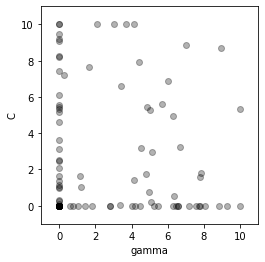

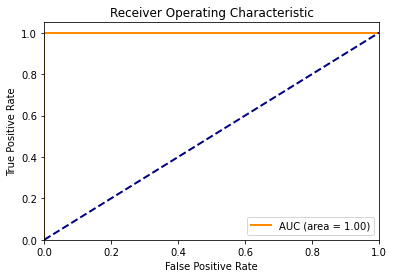

Accuracy for particle (in iteration 50, in fold 10) - 1 is 0.8571 At (gamma, c): [1.00000000e-03 8.24102937e+00]
Accuracy for particle (in iteration 50, in fold 10) - 2 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 50, in fold 10) - 3 is 1.0000 At (gamma, c): [6.68196063 3.25744916]
Accuracy for particle (in iteration 50, in fold 10) - 4 is 0.2500 At (gamma, c): [5.45256412e+00 1.00000000e-03]
Accuracy for particle (in iteration 50, in fold 10) - 5 is 0.2500 At (gamma, c): [0.77402482 0.001     ]
Accuracy for particle (in iteration 50, in fold 10) - 6 is 1.0000 At (gamma, c): [ 3.05261831 10.        ]
Accuracy for particle (in iteration 50, in fold 10) - 7 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 50, in fold 10) - 8 is 0.7500 At (gamma, c): [1.00000000e-03 3.13543395e+00]
Accuracy for particle (in iteration 50, in fold 10) - 9 is 0.8571 At (gamma, c): [1.00000000e-03 9.21384172e+00]
Accuracy for particle (in iteration 50, i

Accuracy for particle (in iteration 50, in fold 10) - 79 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 50, in fold 10) - 80 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 50, in fold 10) - 81 is 0.7857 At (gamma, c): [1.0000000e-03 5.3264016e+00]
Accuracy for particle (in iteration 50, in fold 10) - 82 is 0.6429 At (gamma, c): [1.0000000e-03 2.1017094e+00]
Accuracy for particle (in iteration 50, in fold 10) - 83 is 0.2500 At (gamma, c): [8.07909075e+00 1.00000000e-03]
Accuracy for particle (in iteration 50, in fold 10) - 84 is 0.8571 At (gamma, c): [1.00000000e-03 8.21455544e+00]
Accuracy for particle (in iteration 50, in fold 10) - 85 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 50, in fold 10) - 86 is 0.7857 At (gamma, c): [1.00000000e-03 5.55318192e+00]
Accuracy for particle (in iteration 50, in fold 10) - 87 is 0.2500 At (gamma, c): [1.44081441e+00 1.00000000e-03]
Accuracy for particle (in iterat

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.


Accuracy for particle (in iteration 50, in fold 10) - 98 is 0.2500 At (gamma, c): [1.04356515e+00 1.00000000e-03]
Accuracy for particle (in iteration 50, in fold 10) - 99 is 0.2500 At (gamma, c): [0.001 0.001]
Accuracy for particle (in iteration 50, in fold 10) - 100 is 0.2500 At (gamma, c): [4.02162162e+00 1.00000000e-03]
The best position in iteration 50, fold 10 is [1.00000000e-03 9.33295135e+00], with Accuracy: 1.0000
Accuracy Score: 0.8571
F1 Score: 0.8947
Recall Score: 0.8095
Precision Score: 1.0000
Confusion Matrix (Test):
[[ 7  0]
 [ 4 17]]
Confusion Matrix (Train):
[[130   6]
 [ 28  94]]


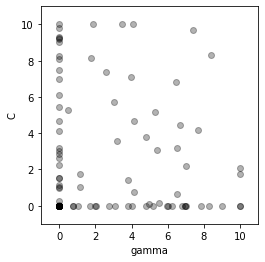


Best Iteration: 1
Best Accuracy Score: 1.0000
Mean Accuracy across folds: 0.9823
Mean F1 Score across folds: 0.7980
Mean Recall Score across folds: 0.7713
Mean Precision Score across folds: 0.8387
Mean ROC AUC across folds: 0.9693
Minimum Accuracy: 0.9286
Maximum Accuracy: 1.0000

Best Confusion Matrix (Test) - Fold 1:
[[17  0]
 [ 1 11]]

Best Confusion Matrix (Train) - Fold 1:
[[126   0]
 [  1 130]]
Total Time: 754.52 seconds


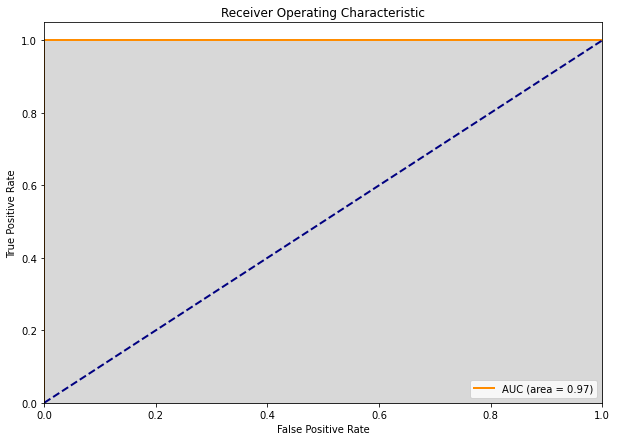

In [10]:
start = time()

X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42)

kf = KFold(n_splits=n_splits, shuffle=True, random_state=42)

# Initialize lists to store metrics for each fold
accuracy_scores = []
roc_auc_scores = []
f1_scores = []
recall_scores = []
precision_scores = []
confusion_matrices = []
confusion_matrices_train = []  # New variable for train confusion matrices

# Initialize variables for min and max accuracy
min_accuracy = 1.0
max_accuracy = 0.0

for fold_idx, (train_index, test_index) in enumerate(kf.split(X_scaled)):
    X_train_fold, X_test_fold = X_scaled[train_index], X_scaled[test_index]
    y_train_fold, y_test_fold = y[train_index], y[test_index]

    max_velocity = np.array([10, 10])
    min_velocity = np.array([-10, -10])
    max_position = np.array([10, 10])
    min_position = np.array([0.001, 0.001])

    particle_position_vector = np.random.uniform(min_position, max_position, (n_particles, 2))
    velocity_vector = np.random.uniform(min_velocity, max_velocity, (n_particles, 2))

    pbest_position = particle_position_vector
    pbest_fitness_value = np.zeros(n_particles)

    gbest_fitness_value = 0.0
    best_accuracy = 0.0
    best_iteration = 0
    best_position_iteration = None  

    for fold_iteration in range(n_iterations):  
        print(f"\nIteration {fold_iteration + 1} - Fold {fold_idx + 1}:\n")

        plot(particle_position_vector)

        best_position = pbest_position[np.argmax(pbest_fitness_value)]
        svclassifier = SVC(kernel='rbf', gamma=best_position[0], C=best_position[1])
        svclassifier.fit(X_train_fold, y_train_fold)

        fpr, tpr, _ = roc_curve(y_test_fold, svclassifier.decision_function(X_test_fold))
        roc_auc = auc(fpr, tpr)

        plt.figure()
        lw = 2
        plt.plot(fpr, tpr, color='darkorange',
                 lw=lw, label='AUC (area = %0.2f)' % roc_auc)
        plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
        plt.xlim([0.0, 1.0])
        plt.ylim([0.0, 1.05])
        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.title('Receiver Operating Characteristic')
        plt.legend(loc="lower right")
        plt.show()

        for i in range(n_particles):
            accuracy = fitness_function(particle_position_vector[i], X_train_fold, X_test_fold, y_train_fold, y_test_fold)

            if pbest_fitness_value[i] < accuracy:
                pbest_fitness_value[i] = accuracy
                pbest_position[i] = particle_position_vector[i]

            if gbest_fitness_value < accuracy:
                gbest_fitness_value = accuracy
                best_accuracy = accuracy
                best_iteration = fold_iteration + 1
                best_position_iteration = particle_position_vector[i]  

            print(f"Accuracy for particle (in iteration {fold_iteration + 1}, in fold {fold_idx + 1}) - {i + 1} is {accuracy:.4f} At (gamma, c): {particle_position_vector[i]}")

            new_velocity = w * velocity_vector[i] + (c1 * random.random()) * (
                        pbest_position[i] - particle_position_vector[i]) + (c2 * random.random()) * (
                                       gbest_fitness_value - particle_position_vector[i])
            new_velocity = eval_velocity(new_velocity, max_velocity, min_velocity)

            particle_position_vector[i] = new_velocity + particle_position_vector[i]
            particle_position_vector[i] = eval_position(particle_position_vector[i], max_position, min_position)

        w = (wmax - wmin) * (n_iterations - fold_iteration) / n_iterations + wmin
        
        best_position = pbest_position[np.argmax(pbest_fitness_value)]
        best_svclassifier = SVC(kernel='rbf', gamma=best_position[0], C=best_position[1])
        best_svclassifier.fit(X_train_fold, y_train_fold)
        y_test_pred = svclassifier.predict(X_test_fold)
        y_train_pred = svclassifier.predict(X_train_fold)

        accuracy = accuracy_score(y_test_fold, y_test_pred)
        f1 = f1_score(y_test_fold, y_test_pred)
        recall = recall_score(y_test_fold, y_test_pred)
        precision = precision_score(y_test_fold, y_test_pred)
        cm = confusion_matrix(y_test_fold, y_test_pred)
        cmt = confusion_matrix(y_train_fold, y_train_pred)

        print(f"The best position in iteration {fold_iteration + 1}, fold {fold_idx + 1} is {best_position_iteration}, with Accuracy: {best_accuracy:.4f}")
    
        print(f"Accuracy Score: {accuracy:.4f}")
        print(f"F1 Score: {f1:.4f}")
        print(f"Recall Score: {recall:.4f}")
        print(f"Precision Score: {precision:.4f}")
        print("Confusion Matrix (Test):")
        print(cm)
        print("Confusion Matrix (Train):")
        print(cmt)

        confusion_matrices_train.append(cmt)  

    plot(particle_position_vector)

    # Calculate ROC curve and AUC
    fpr, tpr, _ = roc_curve(y_test_fold, best_svclassifier.decision_function(X_test_fold))
    roc_auc = auc(fpr, tpr)

    # Append metrics to lists
    accuracy_scores.append(best_accuracy)
    roc_auc_scores.append(roc_auc)
    f1_scores.append(f1)
    recall_scores.append(recall)
    precision_scores.append(precision)
    confusion_matrices.append(cm)
    
    # Update min and max accuracy
    min_accuracy = min(min_accuracy, best_accuracy)
    max_accuracy = max(max_accuracy, best_accuracy)
        
print(f"\nBest Iteration: {best_iteration}")
print(f"Best Accuracy Score: {best_accuracy:.4f}")

# Calculate mean accuracy and ROC AUC
mean_accuracy = np.mean(accuracy_scores)
mean_roc_auc = np.mean(roc_auc_scores)

# Calculate mean metrics
mean_f1 = np.mean(f1_scores)
mean_recall = np.mean(recall_scores)
mean_precision = np.mean(precision_scores)

# Initialize variables for best confusion matrices
best_confusion_matrix_test = None
best_confusion_matrix_train = None

# Initialize variable for best fold index
best_fold_idx = None

# Iterate through folds to find best confusion matrices
for fold_idx, cm_test in enumerate(confusion_matrices):
    cm_train = confusion_matrices_train[fold_idx]

    if best_confusion_matrix_test is None or accuracy_scores[fold_idx] > best_accuracy:
        best_accuracy = accuracy_scores[fold_idx]
        best_fold_idx = fold_idx
        best_confusion_matrix_test = cm_test
        best_confusion_matrix_train = cm_train


stop = time()
total_time = stop - start

# Print the results
print(f"Mean Accuracy across folds: {mean_accuracy:.4f}")
print(f"Mean F1 Score across folds: {mean_f1:.4f}")
print(f"Mean Recall Score across folds: {mean_recall:.4f}")
print(f"Mean Precision Score across folds: {mean_precision:.4f}")
print(f"Mean ROC AUC across folds: {mean_roc_auc:.4f}")
print(f"Minimum Accuracy: {min_accuracy:.4f}")
print(f"Maximum Accuracy: {max_accuracy:.4f}")
# Print best confusion matrix for test and train
print(f"\nBest Confusion Matrix (Test) - Fold {best_fold_idx + 1}:")
print(best_confusion_matrix_test)
print(f"\nBest Confusion Matrix (Train) - Fold {best_fold_idx + 1}:")
print(best_confusion_matrix_train)
print(f"Total Time: {total_time:.2f} seconds")

# Menghitung rata-rata dari fpr dan tpr
mean_fpr, mean_tpr, _ = roc_curve(y_test_fold, best_svclassifier.decision_function(X_test_fold))

# Menghitung rata-rata AUC
mean_auc = np.mean(roc_auc_scores)

# Menampilkan kurva ROC rata-rata
plt.figure(figsize=(10, 7))
plt.plot(mean_fpr, mean_tpr, color='darkorange',
         lw=2, label='AUC (area = %0.2f)' % mean_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.fill_between(mean_fpr, 0, mean_tpr, color='grey', alpha=0.3)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic')
plt.legend(loc="lower right")
plt.show()

In [11]:
print("Confusion Matrix (Test):")
print(cm)
print("Confusion Matrix (Train):")
print(cmt)

Confusion Matrix (Test):
[[ 7  0]
 [ 4 17]]
Confusion Matrix (Train):
[[130   6]
 [ 28  94]]


In [12]:
print(f"Accuracy Score: {accuracy:.4f}")
print(f"F1 Score: {f1:.4f}")
print(f"Recall Score: {recall:.4f}")
print(f"Precision Score: {precision:.4f}")

Accuracy Score: 0.8571
F1 Score: 0.8947
Recall Score: 0.8095
Precision Score: 1.0000


In [13]:
y_test_pred = svclassifier.predict(X_test)

false_positives = (y_test_pred == 1) & (y_test == 0)

print("Indeks False Positives:")
print(np.where(false_positives)[0])

Indeks False Positives:
[]


In [14]:
print("Data tes:")
for i in range(len(y_test_pred)):
    print(f"Data ke-{i+1}: Prediksi = {y_test_pred[i]}, Aktual = {y_test.iloc[i]}")

Data tes:
Data ke-1: Prediksi = 0, Aktual = 0
Data ke-2: Prediksi = 0, Aktual = 0
Data ke-3: Prediksi = 1, Aktual = 1
Data ke-4: Prediksi = 0, Aktual = 0
Data ke-5: Prediksi = 0, Aktual = 0
Data ke-6: Prediksi = 0, Aktual = 0
Data ke-7: Prediksi = 0, Aktual = 0
Data ke-8: Prediksi = 0, Aktual = 0
Data ke-9: Prediksi = 1, Aktual = 1
Data ke-10: Prediksi = 1, Aktual = 1
Data ke-11: Prediksi = 1, Aktual = 1
Data ke-12: Prediksi = 1, Aktual = 1
Data ke-13: Prediksi = 1, Aktual = 1
Data ke-14: Prediksi = 0, Aktual = 0
Data ke-15: Prediksi = 0, Aktual = 1
Data ke-16: Prediksi = 0, Aktual = 0
Data ke-17: Prediksi = 0, Aktual = 0
Data ke-18: Prediksi = 0, Aktual = 0
Data ke-19: Prediksi = 0, Aktual = 0
Data ke-20: Prediksi = 0, Aktual = 0
Data ke-21: Prediksi = 1, Aktual = 1
Data ke-22: Prediksi = 1, Aktual = 1
Data ke-23: Prediksi = 0, Aktual = 0
Data ke-24: Prediksi = 1, Aktual = 1
Data ke-25: Prediksi = 1, Aktual = 1
Data ke-26: Prediksi = 0, Aktual = 0
Data ke-27: Prediksi = 0, Aktual = 0


In [15]:
print("Data tes:")
for i in range(len(y_train_pred)):
    print(f"Data ke-{i+1}: Prediksi = {y_train_pred[i]}, Aktual = {y_train_fold.iloc[i]}")

Data tes:
Data ke-1: Prediksi = 1, Aktual = 1
Data ke-2: Prediksi = 0, Aktual = 0
Data ke-3: Prediksi = 0, Aktual = 1
Data ke-4: Prediksi = 0, Aktual = 1
Data ke-5: Prediksi = 0, Aktual = 0
Data ke-6: Prediksi = 0, Aktual = 1
Data ke-7: Prediksi = 1, Aktual = 1
Data ke-8: Prediksi = 1, Aktual = 1
Data ke-9: Prediksi = 0, Aktual = 0
Data ke-10: Prediksi = 0, Aktual = 0
Data ke-11: Prediksi = 0, Aktual = 1
Data ke-12: Prediksi = 1, Aktual = 1
Data ke-13: Prediksi = 1, Aktual = 1
Data ke-14: Prediksi = 0, Aktual = 0
Data ke-15: Prediksi = 1, Aktual = 1
Data ke-16: Prediksi = 0, Aktual = 0
Data ke-17: Prediksi = 1, Aktual = 1
Data ke-18: Prediksi = 0, Aktual = 1
Data ke-19: Prediksi = 0, Aktual = 1
Data ke-20: Prediksi = 1, Aktual = 1
Data ke-21: Prediksi = 1, Aktual = 1
Data ke-22: Prediksi = 0, Aktual = 0
Data ke-23: Prediksi = 0, Aktual = 1
Data ke-24: Prediksi = 0, Aktual = 0
Data ke-25: Prediksi = 0, Aktual = 0
Data ke-26: Prediksi = 1, Aktual = 1
Data ke-27: Prediksi = 1, Aktual = 1


In [17]:
# Inside the loop where you make predictions

# Assuming y_test_fold and y_train_fold are the actual labels
y_test_pred = svclassifier.predict(X_test_fold)
y_train_pred = svclassifier.predict(X_train_fold)

# Printing predictions for test set
print("\nTest set predictions:")
for i in range(len(y_test_fold)):
    print(f"Data tes {i+1}: Prediksi = {y_test_pred[i]}, Aktual = {y_test_fold.iloc[i]}")

# Printing predictions for train set
print("\nTrain set predictions:")
for i in range(len(y_train_fold)):
    print(f"Data train {i+1}: Prediksi = {y_train_pred[i]}, Aktual = {y_train_fold.iloc[i]}")


Test set predictions:
Data tes 1: Prediksi = 1, Aktual = 1
Data tes 2: Prediksi = 0, Aktual = 1
Data tes 3: Prediksi = 1, Aktual = 1
Data tes 4: Prediksi = 1, Aktual = 1
Data tes 5: Prediksi = 1, Aktual = 1
Data tes 6: Prediksi = 1, Aktual = 1
Data tes 7: Prediksi = 1, Aktual = 1
Data tes 8: Prediksi = 1, Aktual = 1
Data tes 9: Prediksi = 1, Aktual = 1
Data tes 10: Prediksi = 1, Aktual = 1
Data tes 11: Prediksi = 1, Aktual = 1
Data tes 12: Prediksi = 1, Aktual = 1
Data tes 13: Prediksi = 1, Aktual = 1
Data tes 14: Prediksi = 0, Aktual = 1
Data tes 15: Prediksi = 1, Aktual = 1
Data tes 16: Prediksi = 0, Aktual = 0
Data tes 17: Prediksi = 0, Aktual = 1
Data tes 18: Prediksi = 1, Aktual = 1
Data tes 19: Prediksi = 1, Aktual = 1
Data tes 20: Prediksi = 1, Aktual = 1
Data tes 21: Prediksi = 0, Aktual = 1
Data tes 22: Prediksi = 1, Aktual = 1
Data tes 23: Prediksi = 0, Aktual = 0
Data tes 24: Prediksi = 0, Aktual = 0
Data tes 25: Prediksi = 0, Aktual = 0
Data tes 26: Prediksi = 0, Aktual = 